In [1]:
import pandas as pd

# Load the CSV file
file_path = '/home/kinkini/Downloads/DB for chromophore_Sci_Data_rev02.csv'  
data = pd.read_csv(file_path)

# Display the data
print(data)


         Tag                                        Chromophore    Solvent  \
0          1                             N#Cc1cc2ccc(O)cc2oc1=O          O   
1          2                          N#Cc1cc2ccc([O-])cc2oc1=O          O   
2          3  CCCCCCCCCCCC#CC#CCCCCCCCCCN1C(=O)c2ccc3c4ccc5c...  ClC(Cl)Cl   
3          4       [O-]c1c(-c2nc3ccccc3s2)cc2ccc3cccc4ccc1c2c34       CC#N   
4          5       [O-]c1c(-c2nc3ccccc3s2)cc2ccc3cccc4ccc1c2c34    CS(C)=O   
...      ...                                                ...        ...   
20231  20232    N#Cc1c(N2CCCC2)cc(-c2ccccc2)c2c1C(=O)c1ccccc1-2    C1CCOC1   
20232  20233   N#Cc1c(N2CCCCC2)cc(-c2ccccc2)c2c1C(=O)c1ccccc1-2    C1CCOC1   
20233  20234  N#Cc1c(N2CCCCC2)cc(-c2cccc3ccccc23)c2c1C(=O)c1...    C1CCOC1   
20234  20235  N#Cc1c(N2CCCCC2)cc(-c2ccc3ccccc3c2)c2c1C(=O)c1...    C1CCOC1   
20235  20236  N#Cc1c(N2CCCCC2)cc(-c2ccc3ccc4cccc5ccc2c3c45)c...    C1CCOC1   

       Absorption max (nm)  Emission max (nm)  Lifetime (ns)  Q

In [2]:
import pandas as pd

# Remove all rows where the column 'quantum yield' is NaN
data_cleaned = data.dropna(subset=['Quantum yield'])

# Display the cleaned data
print(data_cleaned)


         Tag                                        Chromophore  \
34        35  O=C([O-])c1ccccc1-c1c2ccc(=O)cc-2oc2cc([O-])ccc12   
43        44  O=C([O-])c1ccccc1C1=c2cc3c4c(c2Oc2c1cc1c5c2CCC...   
71        72  O=C([O-])c1ccccc1-c1c2cc(Br)c(=O)c(Br)c-2oc2c(...   
72        73  O=C([O-])c1ccccc1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)...   
73        74  O=C([O-])c1c(Cl)c(Cl)c(Cl)c(Cl)c1-c1c2cc(I)c(=...   
...      ...                                                ...   
20211  20212  Cc1cc(C)c(-c2cc(-c3c(C)cc(C)cc3C)c3ccc4c(-c5c(...   
20212  20213  Cc1cc(C)c(C)c(-c2cc(-c3c(C)c(C)cc(C)c3C)c3ccc4...   
20213  20214  COc1cc(C)c(-c2cc(-c3c(C)cc(OC)cc3C)c3ccc4c(-c5...   
20214  20215    c1cc2c3c(c1)-c1cccc4cccc(c14)B3c1cccc3cccc-2c13   
20215  20216  c1cc2c3c(c1)-c1ccc4c5c(ccc(c15)B3c1ccc3c5c(ccc...   

                                                 Solvent  Absorption max (nm)  \
34                                                     O                  NaN   
43                               

In [3]:

# Extract the "Chromophore" column
Solvent_data_all = data_cleaned['Solvent']

# Display the extracted column
print(Solvent_data_all)

34                                                       O
43                                                      CO
71                                                       O
72                                                       O
73                                                       O
                               ...                        
20211    Cc1cc(C)c(-c2cc(-c3c(C)cc(C)cc3C)c3ccc4c(-c5c(...
20212    Cc1cc(C)c(C)c(-c2cc(-c3c(C)c(C)cc(C)c3C)c3ccc4...
20213    COc1cc(C)c(-c2cc(-c3c(C)cc(OC)cc3C)c3ccc4c(-c5...
20214                                            Cc1ccccc1
20215                                            Cc1ccccc1
Name: Solvent, Length: 13837, dtype: object


In [4]:

# Extract the "Chromophore" column
chromophore_data_all = data_cleaned['Chromophore']

# Display the extracted column
print(chromophore_data_all)

34       O=C([O-])c1ccccc1-c1c2ccc(=O)cc-2oc2cc([O-])ccc12
43       O=C([O-])c1ccccc1C1=c2cc3c4c(c2Oc2c1cc1c5c2CCC...
71       O=C([O-])c1ccccc1-c1c2cc(Br)c(=O)c(Br)c-2oc2c(...
72       O=C([O-])c1ccccc1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)...
73       O=C([O-])c1c(Cl)c(Cl)c(Cl)c(Cl)c1-c1c2cc(I)c(=...
                               ...                        
20211    Cc1cc(C)c(-c2cc(-c3c(C)cc(C)cc3C)c3ccc4c(-c5c(...
20212    Cc1cc(C)c(C)c(-c2cc(-c3c(C)c(C)cc(C)c3C)c3ccc4...
20213    COc1cc(C)c(-c2cc(-c3c(C)cc(OC)cc3C)c3ccc4c(-c5...
20214      c1cc2c3c(c1)-c1cccc4cccc(c14)B3c1cccc3cccc-2c13
20215    c1cc2c3c(c1)-c1ccc4c5c(ccc(c15)B3c1ccc3c5c(ccc...
Name: Chromophore, Length: 13837, dtype: object


In [5]:
from rdkit.Chem.rdmolfiles import MolFromSmarts, MolFromMol2File
from rdkit.Chem.Draw import MolToImageFile

In [6]:
import os
import string
import random
import numpy as np
from rdkit.Chem.rdDistGeom import EmbedMolecule
from rdkit.Geometry.rdGeometry import Point3D
from ase import Atoms
from ase.optimize import BFGS

def rdkit2ase(mol_rdkit, conformation_index, charge, uhf):
    '''Convert an RDKit molecule to an ASE Atoms object'''
    elements = [atom.GetSymbol() for atom in mol_rdkit.GetAtoms()]
    positions = mol_rdkit.GetConformer(conformation_index).GetPositions()
    mol_ase = Atoms(elements, positions)
    # XTB uses total charge and total magnetic moment to decide charge and multiplicity
    # Assign initial charges to have the right sum
    dummy_charges = \
            np.array([float(charge)] +
                     [0.0 for i in range(mol_ase.get_global_number_of_atoms() - 1)])
    mol_ase.set_initial_charges(dummy_charges)
    dummy_moments = \
            np.array([float(uhf)] +
                     [0.0 for i in range(mol_ase.get_global_number_of_atoms() - 1)])
    mol_ase.set_initial_magnetic_moments(dummy_moments)
    return mol_ase

def annotate_molecule_property(property_name, property_function, ase_calculator, mol_rdkit,
        conformation_index = 0, charge = 0, uhf = 0):
    '''Given a property function (ASE to number), and an ASE calculator, and an
    RDKit molecule, calculate the property with the given calculator, and add
    it to the RDKit molecule as a molecule property, with the given name'''
    ase_molecule = rdkit2ase(mol_rdkit, conformation_index, charge, uhf)
    ase_molecule.calc = ase_calculator
    property_value = property_function(ase_molecule)
    mol_rdkit.SetDoubleProp(property_name, property_value)

def annotate_atom_property(property_name, property_function, ase_calculator, mol_rdkit,
        conformation_index = 0, charge = 0, uhf = 0):
    '''Given an atom property function (ASE to iterable of numbers, one for
    each atom, in order), and an ASE calculator, and an RDKit molecule,
    annotate the RDKit molecule with the atom property'''
    ase_molecule = rdkit2ase(mol_rdkit, conformation_index, charge, uhf)
    ase_molecule.calc = ase_calculator
    property_values = property_function(ase_molecule)
    for atom, property_value in zip(mol_rdkit.GetAtoms(), property_values):
        atom.SetDoubleProp(property_name, property_value)

def overwrite_conformer(mol_rdkit, conformation_index, mol_ase):
    '''Overwrite a given conformer of an RDKit molecule with the positions from
    an ASE molecule'''
    positions = mol_ase.get_positions()
    target_conformer = mol_rdkit.GetConformer(conformation_index)
    for i, row in enumerate(positions):
        x = row[0]
        y = row[1]
        z = row[2]
        rdkit_point = Point3D(x, y, z)
        target_conformer.SetAtomPosition(i, rdkit_point)

def optimize_geometry(ase_calculator, mol_rdkit, conformation_index = None, constraints = None, charge = 0, uhf = 0):
    '''Given an ASE calculator and an RDKit molecule, optimize the geometry
    using that calculator'''
    
    if conformation_index is None:
        # Generate initial conformer
        mol_rdkit.RemoveAllConformers()
        # Added ignoreSmoothingFailures so I could generate geometries for the
        # boron subpc paper, https://doi.org/10.1021/acs.jcim.1c01048
        # Inspired by the settings from here:
        # https://sourceforge.net/p/rdkit/mailman/rdkit-discuss/thread/C761AFBF8DEB604DB8D72CB1B301A1EB21C651DB%40MBX07.ad.oak.ox.ac.uk/#msg32082674
        conformation_index = EmbedMolecule(mol_rdkit, ignoreSmoothingFailures=True)

    if conformation_index != -1:
        # Create a random sequence of characters for the temp files. This way, jobs
        # running on different threads don't try to access the same file
        noise = "".join(random.choices(string.ascii_uppercase + string.digits, k=20))
        # Name of the trajectory file
        traj_filename = f"tmp_opt_{noise}.traj"

        # Optimize the geometry
        mol_opt_ase = rdkit2ase(mol_rdkit, conformation_index, charge, uhf)
        if constraints is not None:
            for constraint in constraints:
                mol_opt_ase.set_constraint(constraint)
        mol_opt_ase.calc = ase_calculator
        opt = BFGS(mol_opt_ase, trajectory = traj_filename, logfile = None)
        opt.run(fmax=0.05)
        os.remove(traj_filename)

        # Set the optimized geometry as the conformer
        overwrite_conformer(mol_rdkit, conformation_index, mol_opt_ase)
    
    else:
        raise ValueError("Failed to generate conformation")

    return conformation_index

In [7]:
from glob import glob
from os.path import basename, splitext
import csv
from rdkit.Chem.rdmolfiles import MolFromSmarts, MolFromMol2File
from rdkit.Chem.Draw import MolToImageFile
from ase import Atoms
from ase.optimize import BFGS
from ase.units import Bohr
from xtb.ase.calculator import XTB
from xtb.interface import Calculator, Param
#from annotate_rdkit_with_ase import rdkit2ase

In [8]:
path = "/media/kinkini/ADATA HD650/molecule11.mol2"

In [9]:
from rdkit import Chem
from rdkit.Chem import AllChem, Draw
import subprocess

def save_mol_to_mol2(rdkit_mol, file_name):
    # Save temporary .sdf file
    tmp_sdf = 'temp.sdf'
    with Chem.SDWriter(tmp_sdf) as writer:
        writer.write(rdkit_mol)

    # Convert .sdf to .mol2 with Open Babel
    subprocess.run(['obabel', tmp_sdf, '-O', file_name, '-mol2'], check=True)

# Assume chromophore_data is a list of SMILES strings
chromophore_data = chromophore_data_all[0:200] # Example SMILES
#chromophore_data = ['C1=CC=CC=C1', 'CCN(CC)CC', 'C(C(=O)O)N']  # Sample chromophore data


successful_smiles = 0
failed_smiles = 0

for smiles in chromophore_data:
    mol = Chem.MolFromSmiles(smiles)
    if mol is not None:
        # Multiple embedding attempts if needed
        for attempt in range(5):  # Try up to 5 times to embed
            if AllChem.EmbedMolecule(mol, AllChem.ETKDG()) == 0:
                try:
                    AllChem.UFFOptimizeMolecule(mol)
                    save_mol_to_mol2(mol, f'/home/kinkini/tridentate_carbene/{smiles}.mol2')
                    successful_smiles += 1
                    print(f"Successfully processed {smiles}")
                    break
                except Exception as e:
                    print(f"Optimization failed for {smiles}: {str(e)}")
                    break
            else:
                print(f"Embedding attempt {attempt+1} failed for {smiles}.")
        else:
            print(f"All embedding attempts failed for {smiles}.")
            failed_smiles += 1

print(f"Processed {successful_smiles} successfully, {failed_smiles} failed.")


[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24]

Successfully processed O=C([O-])c1ccccc1-c1c2ccc(=O)cc-2oc2cc([O-])ccc12
Successfully processed O=C([O-])c1ccccc1C1=c2cc3c4c(c2Oc2c1cc1c5c2CCCN5CCC1)CCC[N+]=4CCC3
Successfully processed O=C([O-])c1ccccc1-c1c2cc(Br)c(=O)c(Br)c-2oc2c(Br)c([O-])c(Br)cc12
Successfully processed O=C([O-])c1ccccc1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)c([O-])c(I)cc12
Successfully processed O=C([O-])c1c(Cl)c(Cl)c(Cl)c(Cl)c1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)c([O-])c(I)cc12
Successfully processed O=C([O-])c1ccccc1-c1c2cc(Br)c(=O)c(Br)c-2oc2c(Br)c([O-])c(Br)cc12
Successfully processed O=C([O-])c1ccccc1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)c([O-])c(I)cc12
Successfully processed O=C([O-])c1c(Cl)c(Cl)c(Cl)c(Cl)c1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)c([O-])c(I)cc12
Successfully processed O=C([O-])c1ccccc1-c1c2cc(Br)c(=O)c(Br)c-2oc2c(Br)c([O-])c(Br)cc12


1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed O=C([O-])c1ccccc1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)c([O-])c(I)cc12
Successfully processed O=C([O-])c1c(Cl)c(Cl)c(Cl)c(Cl)c1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)c([O-])c(I)cc12
Successfully processed O=C([O-])c1ccccc1-c1c2cc(Br)c(=O)c(Br)c-2oc2c(Br)c([O-])c(Br)cc12
Successfully processed O=C([O-])c1ccccc1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)c([O-])c(I)cc12
Successfully processed O=C([O-])c1c(Cl)c(Cl)c(Cl)c(Cl)c1-c1c2cc(I)c(=O)c(I)c-2oc2c(I)c([O-])c(I)cc12
Successfully processed c1ccc2ccccc2c1
Successfully processed C[Si](C)(C)c1cccc2ccccc12
Successfully processed C[Si](C)(C)c1ccc([Si](C)(C)C)c2ccccc12
Successfully processed COc1ccc([Si](C)(C)C)c2ccccc12
Successfully processed C[Si](C)(C)c1ccc(C#N)c2ccccc12
Successfully processed C[Si](C)(C)C#Cc1ccc(C#C[Si](C)(C)C)c2ccccc12


1 molecule converted
[11:52:24] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:25] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/CCCCCCCCCCCCn1cccc1/C=C/c1cc(OCCCC)c(/C=C/c2cccn2CCCCCCCCCCCC)cc1OCCCC1.mol2
1 molecule converted
[11:52:25] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:25] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/CCCCCCCCCCCCn1cccc1/C=C/c1ccc(OCCCC)c2c(/C=C/c3cccn3CCCCCCCCCCCC)ccc(OCCCC)c121.mol2
1 molecule converted
[11:52:25] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:25] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/CCCCCCCCCCCCn1cccc1/C=C/c1ccc(/C=C/c2cccn2CCCCCCCCCCCC)cc11.mol2
1 molecule con

Successfully processed CCCCCCCCCCCCn1cccc1/C=C/c1cc(OCCCC)c(/C=C/c2cccn2CCCCCCCCCCCC)cc1OCCCC
Successfully processed CCCCCCCCCCCCn1cccc1/C=C/c1ccc(OCCCC)c2c(/C=C/c3cccn3CCCCCCCCCCCC)ccc(OCCCC)c12
Successfully processed CCCCCCCCCCCCn1cccc1/C=C/c1ccc(/C=C/c2cccn2CCCCCCCCCCCC)cc1


[11:52:25] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:25] Molecule does not have explicit Hs. Consider calling AddHs()


Successfully processed N#Cc1cc2ccc(cc2)c2cccc3cccc(c4ccc(cc4)cc(C#N)c4ccc(cc4)c4cccc5cccc(c6ccc1cc6)c54)c32


[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/CCCCCCCCc1ccc(-c2ccc(/C=C(\C#N)c3ccc(-c4cccc5cccc(-c6ccc(/C(C#N)=C/c7ccc(-c8ccc(CCCCCCCC)cc8)cc7)cc6)c45)cc3)cc2)cc11.mol2
1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()


Successfully processed CCCCCCCCc1ccc(-c2ccc(/C=C(\C#N)c3ccc(-c4cccc5cccc(-c6ccc(/C(C#N)=C/c7ccc(-c8ccc(CCCCCCCC)cc8)cc7)cc6)c45)cc3)cc2)cc1
Successfully processed CCC12C(=C3C(=C4c5ccc(-c6ccc(C)s6)cc5S(=O)(=O)C41CC)C(F)(F)C(F)(F)C3(F)F)c1ccc(-c3ccc(C)s3)cc1S2(=O)=O
Successfully processed CCC12C(=C3C(=C4c5ccc(-c6ccc(C)s6)cc5S(=O)(=O)C41CC)C(F)(F)C(F)(F)C3(F)F)c1ccc(-c3ccc(C)s3)cc1S2(=O)=O
Successfully processed CCC12C(=C3C(=C4c5ccc(-c6ccc(C)s6)cc5S(=O)(=O)C41CC)C(F)(F)C(F)(F)C3(F)F)c1ccc(-c3ccc(C)s3)cc1S2(=O)=O


1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()


Successfully processed CCC12C(=C3C(=C4c5ccc(-c6ccc(C)s6)cc5S(=O)(=O)C41CC)C(F)(F)C(F)(F)C3(F)F)c1ccc(-c3ccc(C)s3)cc1S2(=O)=O
Successfully processed ClP1(Cl)=NP(Cl)(Cl)=NP(Cl)(Oc2ccc3ccc4cccc5ccc2c3c45)=N1
Successfully processed ClP1(Cl)=N[P@@](Cl)(Oc2ccc3ccc4cccc5ccc2c3c45)=N[P@@](Cl)(Oc2ccc3ccc4cccc5ccc2c3c45)=N1
Successfully processed ClP1(Cl)=N[P@](Cl)(Oc2ccc3ccc4cccc5ccc2c3c45)=N[P@@](Cl)(Oc2ccc3ccc4cccc5ccc2c3c45)=N1


[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted


Successfully processed c1ccc2c(c1)OP1(=NP3(=NP(Oc4ccc5ccc6cccc7ccc4c5c67)(Oc4ccc5ccc6cccc7ccc4c5c67)=N1)Oc1ccccc1-c1ccccc1O3)Oc1ccccc1-2
Successfully processed c1ccc2c(c1)OP1(=NP(Oc3ccc4ccc5cccc6ccc3c4c56)(Oc3ccc4ccc5cccc6ccc3c4c56)=NP(Oc3ccc4ccc5cccc6ccc3c4c56)(Oc3ccc4ccc5cccc6ccc3c4c56)=N1)Oc1ccccc1-2


[11:52:26] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()


Embedding attempt 1 failed for c1cc2ccc3ccc(OP4(Oc5ccc6ccc7cccc8ccc5c6c78)=NP(Oc5ccc6ccc7cccc8ccc5c6c78)(Oc5ccc6ccc7cccc8ccc5c6c78)=NP(Oc5ccc6ccc7cccc8ccc5c6c78)(Oc5ccc6ccc7cccc8ccc5c6c78)=N4)c4ccc(c1)c2c34.


[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()


Successfully processed c1cc2ccc3ccc(OP4(Oc5ccc6ccc7cccc8ccc5c6c78)=NP(Oc5ccc6ccc7cccc8ccc5c6c78)(Oc5ccc6ccc7cccc8ccc5c6c78)=NP(Oc5ccc6ccc7cccc8ccc5c6c78)(Oc5ccc6ccc7cccc8ccc5c6c78)=N4)c4ccc(c1)c2c34
Successfully processed CCCCC(CC)CN1C(=O)C2=C(c3ccc(-c4ccc(C5=C6C(C)=CC(C)=[N+]6[B-](F)(F)n6c(C)cc(C)c65)cc4)s3)N(CC(CC)CCCC)C(=O)C2=C1c1cccs1


[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27]

Successfully processed CCCCC(CC)CN1C(=O)C2=C(c3ccc(-c4ccc(C5=C6C(C)=CC(C)=[N+]6[B-](F)(F)n6c(C)cc(C)c65)cc4)s3)N(CC(CC)CCCC)C(=O)C2=C1c1ccc(-c2ccc(C3=C4C(C)=CC(C)=[N+]4[B-](F)(F)n4c(C)cc(C)c43)cc2)s1
Successfully processed CN(C)c1ccc2nc3ccc(N(C)C)cc3[s+]c2c1
Successfully processed CN(C)c1ccc2nc3ccc(N(C)C)cc3[s+]c2c1
Successfully processed CN(C)c1ccc2nc3ccc(N(C)C)cc3[s+]c2c1
Successfully processed CN(C)c1ccc2nc3ccc(N(C)C)cc3[s+]c2c1
Successfully processed COc1ccccc1-c1nc(-c2ccccc2)c2ccccn12
Successfully processed C(=C/c1nc(-c2ccccc2)c2ccccn12)\c1nc(-c2ccccc2)c2ccccn12
Successfully processed O=C(O)c1ccccc1-c1nc(-c2ccccc2)c2ccccn12
Successfully processed O=C(O)c1ccc(-c2nc(-c3ccccc3)c3ccccn23)cc1
Successfully processed O=C(O)c1ccc(-c2nc(-c3ccccc3)c3c4ccccc4ccn23)cc1
Successfully processed O=C(O)c1ccc(-c2ccc(-c3nc(-c4ccccc4)c4ccccn34)cc2)s1


1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed O=C1c2cccc3cc4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed O=C1c2cccc3c(NCc4ccccn4)c4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed CCCCCCCCCCCCN1C(=O)c2cccc3c(N(Cc4ccccn4)Cc4ccccn4)c4ccccc4c(c23)C1=O
Successfully processed CC(=O)N(Cc1ccccn1)c1c2ccccc2c2c3c(cccc13)C(=O)N(Cc1ccccn1)C2=O
Successfully processed O=C1c2cccc3cc4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed O=C1c2cccc3cc4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed O=C1c2cccc3cc4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed O=C1c2cccc3cc4ccccc4c(c23)C(=O)N1Cc1ccccn1


1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:27] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed O=C1c2cccc3c(NCc4ccccn4)c4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed O=C1c2cccc3c(NCc4ccccn4)c4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed O=C1c2cccc3c(NCc4ccccn4)c4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed O=C1c2cccc3c(NCc4ccccn4)c4ccccc4c(c23)C(=O)N1Cc1ccccn1
Successfully processed CCCCCCCCCCCCN1C(=O)c2cccc3c(N(Cc4ccccn4)Cc4ccccn4)c4ccccc4c(c23)C1=O
Successfully processed CCCCCCCCCCCCN1C(=O)c2cccc3c(N(Cc4ccccn4)Cc4ccccn4)c4ccccc4c(c23)C1=O


1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()


Successfully processed CCCCCCCCCCCCN1C(=O)c2cccc3c(N(Cc4ccccn4)Cc4ccccn4)c4ccccc4c(c23)C1=O
Successfully processed CCCCCCCCCCCCN1C(=O)c2cccc3c(N(Cc4ccccn4)Cc4ccccn4)c4ccccc4c(c23)C1=O
Successfully processed CC(=O)N(Cc1ccccn1)c1c2ccccc2c2c3c(cccc13)C(=O)N(Cc1ccccn1)C2=O
Successfully processed CC(=O)N(Cc1ccccn1)c1c2ccccc2c2c3c(cccc13)C(=O)N(Cc1ccccn1)C2=O
Successfully processed CC(=O)N(Cc1ccccn1)c1c2ccccc2c2c3c(cccc13)C(=O)N(Cc1ccccn1)C2=O
Successfully processed CC(=O)N(Cc1ccccn1)c1c2ccccc2c2c3c(cccc13)C(=O)N(Cc1ccccn1)C2=O


[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()


Successfully processed O=C(O)CCCc1cc(C#Cc2ccccc2)c2ccc3c(C#Cc4ccccc4)cc(C#Cc4ccccc4)c4ccc1c2c34
Successfully processed O=C(O)CCCc1cc(C#Cc2ccccc2)c2ccc3c(C#Cc4ccccc4)cc(C#Cc4ccccc4)c4ccc1c2c34
Successfully processed CN1/C(=C/C=C/C2=[N+](CCCCCC(=O)O)c3ccc(S(=O)(=O)[O-])cc3C2(C)C)C(C)(C)c2cc(S(=O)(=O)[O-])ccc21
Successfully processed c1ccc(-c2c3ccccc3c(-c3ccccc3)c3ccccc23)cc1
Successfully processed CCN(CC)c1ccc2c(-c3ccccc3C(=O)[O-])c3ccc(=[N+](CC)CC)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2c(-c3ccccc3C(=O)[O-])c3ccc(=[N+](CC)CC)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1


*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/CN1/C(=C/C=C/C2=[N+](CCCCCC(=O)O)c3ccc(S(=O)(=O)[O-])cc3C2(C)C)C(C)(C)c2cc(S(=O)(=O)[O-])ccc211.mol2
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider ca

Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1


[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28]

Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed CCN(CC)c1ccc2nc3c4ccccc4c(=O)cc-3oc2c1
Successfully processed O=c1c2ccccc2sc2ccccc12
Successfully processed O=c1c2ccccc2sc2ccccc12
Successfully processed O=c1c2ccccc2sc2ccccc12
Successfully processed O=c1c2ccccc2sc2ccccc12
Successfully processed O=c1c2ccccc2sc2ccccc12
Successfully processed O=c1c2ccccc2sc2ccccc12
Successfully processed O=c1c2ccccc2sc2ccccc12
Successfully processed O=c1c2ccccc2sc2ccccc12
Successfully processed O=c1c2ccccc2sc2ccccc12


1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:28] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed Cc1ccc2sc3cc(CCC(=O)O)ccc3c(=O)c2c1
Successfully processed Cc1ccc2sc3cc(CCC(=O)O)ccc3c(=O)c2c1
Successfully processed Cc1ccc2sc3cc(CCC(=O)O)ccc3c(=O)c2c1
Successfully processed Cc1ccc2sc3cc(CCC(=O)O)ccc3c(=O)c2c1
Successfully processed Cc1ccc2sc3cc(CCC(=O)O)ccc3c(=O)c2c1
Successfully processed COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O
Successfully processed COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O
Successfully processed COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O
Successfully processed COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O
Successfully processed COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O
Successfully processed COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O


[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O1.mol2
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O1.mol2
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O1.mol2
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[

Successfully processed Nc1ccccn1
Successfully processed Nc1ccccn1
Successfully processed Nc1ccccn1
Successfully processed Nc1ccccn1
Successfully processed Nc1cccnc1
Successfully processed Nc1cccnc1
Successfully processed Nc1cccnc1
Successfully processed Nc1cccnc1
Successfully processed Nc1ccncc1
Successfully processed Nc1ccncc1
Successfully processed Nc1ccncc1
Successfully processed Nc1ccccn1
Successfully processed Nc1cccnc1
Successfully processed Nc1ccncc1
Successfully processed Nc1cccc[nH+]1


1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1


[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29]

Successfully processed O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed Nc1ccc(-c2ccc3c(c2)C(=O)c2ccccc2C3=O)cc1
Successfully processed Nc1ccc(-c2ccc3c(c2)C(=O)c2ccccc2C3=O)cc1
Successfully processed Nc1ccc(-c2ccc3c(c2)C(=O)c2ccccc2C3=O)cc1
Successfully processed Nc1ccc(-c2ccc3c(c2)C(=O)c2ccccc2C3=O)cc1
Successfully processed Nc1ccc(-c2ccc3c(c2)C(=O)c2ccccc2C3=O)cc1
Successfully processed Nc1ccc(-c2ccc3c(c2)C(=O)c2ccccc2C3=O)cc1
Successfully processed Nc1ccc(-c2ccc3c(c2)C(=O)c2ccccc2C3=O)cc1
Successfully processed O=C1c2ccccc2C(=O)c2cc(-c3ccc(N(c4ccccc4)c4ccccc4)cc3)ccc21
Successfully processed O=C1c2ccccc2C(=O)c2cc(-c3ccc(N(c4ccccc4)c4ccccc4)cc3)ccc21


1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed O=C1c2ccccc2C(=O)c2cc(-c3ccc(N(c4ccccc4)c4ccccc4)cc3)ccc21
Successfully processed O=C1c2ccccc2C(=O)c2cc(-c3ccc(N(c4ccccc4)c4ccccc4)cc3)ccc21
Successfully processed O=C1c2ccccc2C(=O)c2cc(-c3ccc(N(c4ccccc4)c4ccccc4)cc3)ccc21
Successfully processed O=C1c2ccccc2C(=O)c2cc(-c3ccc(N(c4ccccc4)c4ccccc4)cc3)ccc21
Successfully processed Cc1ccc(N(c2ccc(C)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed Cc1ccc(N(c2ccc(C)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed Cc1ccc(N(c2ccc(C)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1


1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:29] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed Cc1ccc(N(c2ccc(C)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed Cc1ccc(N(c2ccc(C)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed Cc1ccc(N(c2ccc(C)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed Cc1ccc(N(c2ccc(C)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed COc1ccc(N(c2ccc(OC)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed COc1ccc(N(c2ccc(OC)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1


1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()


Successfully processed COc1ccc(N(c2ccc(OC)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed COc1ccc(N(c2ccc(OC)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed COc1ccc(N(c2ccc(OC)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed COc1ccc(N(c2ccc(OC)cc2)c2ccc(-c3ccc4c(c3)C(=O)c3ccccc3C4=O)cc2)cc1
Successfully processed CC1=CC(C)=[N+]2C1=C(c1ccccc1)c1c(C)cc(C)n1[B-]2(F)F
Successfully processed CC1=CC(C)=[N+]2C1=C(c1ccccc1)c1c(C)cc(C)n1[B-]2(F)F
Successfully processed CC1=CC(C)=[N+]2C1=C(c1ccccc1)c1c(C)cc(C)n1[B-]2(F)F
Successfully processed CC1=CC(C)=[N+]2C1=C(c1ccccc1)c1c(C)cc(C)n1[B-]2(F)F
Successfully processed CC1=CC(C)=[N+]2C1=C(c1ccccc1)c1c(C)cc(C)n1[B-]2(F)F


1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed CC1=CC(C)=[N+]2C1=C(c1ccccc1)c1c(C)cc(C)n1[B-]2(F)F
Successfully processed CC1=CC(C)=[N+]2C1=C(c1ccccc1)c1c(C)cc(C)n1[B-]2(F)F
Successfully processed COc1ccccc1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1ccccc1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1ccccc1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1ccccc1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1ccccc1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1ccccc1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1ccccc1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1cccc(OC)c1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21


1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed COc1cccc(OC)c1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1cccc(OC)c1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1cccc(OC)c1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1cccc(OC)c1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1cccc(OC)c1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1cccc(OC)c1C1=C2C(C)=CC(C)=[N+]2[B-](F)(F)n2c(C)cc(C)c21
Successfully processed COc1cc(OC)c(C2=C3C(C)=CC(C)=[N+]3[B-](F)(F)n3c(C)cc(C)c32)c(OC)c1
Successfully processed COc1cc(OC)c(C2=C3C(C)=CC(C)=[N+]3[B-](F)(F)n3c(C)cc(C)c32)c(OC)c1
Successfully processed COc1cc(OC)c(C2=C3C(C)=CC(C)=[N+]3[B-](F)(F)n3c(C)cc(C)c32)c(OC)c1


1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed COc1cc(OC)c(C2=C3C(C)=CC(C)=[N+]3[B-](F)(F)n3c(C)cc(C)c32)c(OC)c1
Successfully processed COc1cc(OC)c(C2=C3C(C)=CC(C)=[N+]3[B-](F)(F)n3c(C)cc(C)c32)c(OC)c1
Successfully processed COc1cc(OC)c(C2=C3C(C)=CC(C)=[N+]3[B-](F)(F)n3c(C)cc(C)c32)c(OC)c1
Successfully processed COc1cc(OC)c(C2=C3C(C)=CC(C)=[N+]3[B-](F)(F)n3c(C)cc(C)c32)c(OC)c1
Successfully processed C(/C=C/c1ccc(-n2c3ccccc3c3ccccc32)cc1)=C\c1ccncc1
Successfully processed C(/C=C/c1ccc(-n2c3ccccc3c3ccccc32)cc1)=C\c1ccncc1
Successfully processed C(/C=C/c1ccc(-n2c3ccccc3c3ccccc32)cc1)=C\c1ccncc1
Successfully processed C(/C=C/c1ccc(-n2c3ccccc3c3ccccc32)cc1)=C\c1ccncc1
Successfully processed CN(C)c1ccc(/C=C/C=C/c2ccncc2)cc1
Successfully processed CN(C)c1ccc(/C=C/C=C/c2ccncc2)cc1


1 molecule converted
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:30] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/C(/C=C/c1ccc(-n2c3ccccc3c3ccccc32)cc1)=C\c1ccncc11.mol2
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/C(/C=C/c1ccc(-n2c3ccccc3c3ccccc32)cc1)=C\c1ccncc11.mol2
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write 

Successfully processed CN(C)c1ccc(/C=C/C=C/c2ccncc2)cc1
Successfully processed CN(C)c1ccc(/C=C/C=C/c2ccncc2)cc1
Successfully processed C(/C=C/c1ccc(N(c2ccccc2)c2ccccc2)cc1)=C\c1ccncc1
Successfully processed C(/C=C/c1ccc(N(c2ccccc2)c2ccccc2)cc1)=C\c1ccncc1
Successfully processed C(/C=C/c1ccc(N(c2ccccc2)c2ccccc2)cc1)=C\c1ccncc1
Successfully processed C(/C=C/c1ccc(N(c2ccccc2)c2ccccc2)cc1)=C\c1ccncc1
Successfully processed C(/C=C/c1cc2c3c(c1)CCCN3CCC2)=C\c1ccncc1
Successfully processed C(/C=C/c1cc2c3c(c1)CCCN3CCC2)=C\c1ccncc1
Successfully processed C(/C=C/c1cc2c3c(c1)CCCN3CCC2)=C\c1ccncc1
Processed 200 successfully, 0 failed.


*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/C(/C=C/c1ccc(N(c2ccccc2)c2ccccc2)cc1)=C\c1ccncc11.mol2
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/C(/C=C/c1ccc(N(c2ccccc2)c2ccccc2)cc1)=C\c1ccncc11.mol2
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/tridentate_carbene/C(/C=C/c1ccc(N(c2ccccc2)c2ccccc2)cc1)=C\c1ccncc11.mol2
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
*** Open Babel Error  in FullConvert
  Cannot write to /home/kinkini/trident

In [10]:
Solvent_data_all

34                                                       O
43                                                      CO
71                                                       O
72                                                       O
73                                                       O
                               ...                        
20211    Cc1cc(C)c(-c2cc(-c3c(C)cc(C)cc3C)c3ccc4c(-c5c(...
20212    Cc1cc(C)c(C)c(-c2cc(-c3c(C)c(C)cc(C)c3C)c3ccc4...
20213    COc1cc(C)c(-c2cc(-c3c(C)cc(OC)cc3C)c3ccc4c(-c5...
20214                                            Cc1ccccc1
20215                                            Cc1ccccc1
Name: Solvent, Length: 13837, dtype: object

In [11]:
from rdkit import Chem
from rdkit.Chem import AllChem, Draw
import subprocess

def save_mol_to_mol2(rdkit_mol, file_name):
    # Save temporary .sdf file
    tmp_sdf = 'temp.sdf'
    with Chem.SDWriter(tmp_sdf) as writer:
        writer.write(rdkit_mol)

    # Convert .sdf to .mol2 with Open Babel
    subprocess.run(['obabel', tmp_sdf, '-O', file_name, '-mol2'], check=True)

# Assume chromophore_data is a list of SMILES strings
Solvent_data = Solvent_data_all[0:200] # Example SMILES
#chromophore_data = ['C1=CC=CC=C1', 'CCN(CC)CC', 'C(C(=O)O)N']  # Sample chromophore data


successful_smiles = 0
failed_smiles = 0

for smiles in Solvent_data:
    mol = Chem.MolFromSmiles(smiles)
    if mol is not None:
        # Multiple embedding attempts if needed
        for attempt in range(5):  # Try up to 5 times to embed
            if AllChem.EmbedMolecule(mol, AllChem.ETKDG()) == 0:
                try:
                    AllChem.UFFOptimizeMolecule(mol)
                    save_mol_to_mol2(mol, f'/home/kinkini/tridentate_carbene_solvent/{smiles}.mol2')
                    successful_smiles += 1
                    print(f"Successfully processed {smiles}")
                    break
                except Exception as e:
                    print(f"Optimization failed for {smiles}: {str(e)}")
                    break
            else:
                print(f"Embedding attempt {attempt+1} failed for {smiles}.")
        else:
            print(f"All embedding attempts failed for {smiles}.")
            failed_smiles += 1

print(f"Processed {successful_smiles} successfully, {failed_smiles} failed.")


[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31]

Successfully processed O
Successfully processed CO
Successfully processed O
Successfully processed O
Successfully processed O
Successfully processed CO
Successfully processed CO
Successfully processed CO
Successfully processed CCO
Successfully processed CCO
Successfully processed CCO
Successfully processed CC(C)O
Successfully processed CC(C)O
Successfully processed CC(C)O


1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed C1CCCCC1
Successfully processed C1CCCCC1
Successfully processed C1CCCCC1
Successfully processed C1CCCCC1
Successfully processed C1CCCCC1
Successfully processed C1CCCCC1
Successfully processed Cc1ccccc1
Successfully processed Cc1ccccc1
Successfully processed Cc1ccccc1
Successfully processed Cc1ccccc1
Successfully processed Cc1ccccc1
Successfully processed CCCCCC
Successfully processed C1COCCO1
Successfully processed CCO
Successfully processed CC#N


1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed ClCCl
Successfully processed ClCCl
Successfully processed ClCCl
Successfully processed ClCCl
Successfully processed ClCCl
Successfully processed ClCCl
Successfully processed Cc1ccccc1
Successfully processed Cc1ccccc1
Successfully processed O
Successfully processed CC#N
Successfully processed CCO
Successfully processed OCC(O)CO
Successfully processed CC#N
Successfully processed CC#N
Successfully processed CC#N
Successfully processed CC#N


1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:31] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed CC#N
Successfully processed CC#N
Successfully processed CCO
Successfully processed CCO
Successfully processed CCO
Successfully processed CCO
Successfully processed CCCCCC
Successfully processed Cc1ccccc1
Successfully processed ClCCl
Successfully processed C1CCOC1
Successfully processed CCCCCC
Successfully processed Cc1ccccc1
Successfully processed ClCCl
Successfully processed C1CCOC1


[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32]

Successfully processed CCCCCC
Successfully processed Cc1ccccc1
Successfully processed ClCCl
Successfully processed C1CCOC1
Successfully processed CCCCCC
Successfully processed Cc1ccccc1
Successfully processed ClCCl
Successfully processed C1CCOC1
Successfully processed ClC(Cl)(Cl)Cl
Successfully processed CS(C)=O
Successfully processed O
Successfully processed C1CCCCC1
Successfully processed O
Successfully processed CO


1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calli

Successfully processed C1CCCCC1
Successfully processed ClC(Cl)(Cl)Cl
Successfully processed CCCCOCCCC
Successfully processed CCOCC
Successfully processed CCCC#N
Successfully processed CN(C)C=O
Successfully processed CC1COC(=O)O1
Successfully processed CCCCCCCCCCO
Successfully processed CC(C)O
Successfully processed CCCCCO
Successfully processed CCCCO
Successfully processed CCCO
Successfully processed OCCO
Successfully processed OCC(O)CO


1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed OCC(F)(F)F
Successfully processed OC(C(F)(F)F)C(F)(F)F
Successfully processed CCCCOC(C)=O
Successfully processed c1ccccc1
Successfully processed C1COCCO1
Successfully processed C1CCOC1
Successfully processed CC(C)=O
Successfully processed CC#N
Successfully processed CC(C)O
Successfully processed CO
Successfully processed OCCO
Successfully processed CC#N
Successfully processed CC(C)O
Successfully processed CCO


1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed CO
Successfully processed OCCO
Successfully processed C1CCCCC1
Successfully processed c1ccccc1
Successfully processed CC#N
Successfully processed CO
Successfully processed CN(C)C=O
Successfully processed CS(C)=O
Successfully processed C1CCCCC1
Successfully processed CCOCC
Successfully processed CCO
Successfully processed CC#N
Successfully processed C1CCCCC1
Successfully processed CCOCC
Successfully processed CCO


[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:32] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33]

Successfully processed CC#N
Successfully processed CCOCC
Successfully processed CCO
Successfully processed CC#N
Successfully processed O
Successfully processed O
Successfully processed O
Successfully processed O
Successfully processed CCCCCC
Successfully processed ClC(Cl)(Cl)Cl
Successfully processed Cc1ccccc1
Successfully processed CCOCC
Successfully processed C1CCOC1
Successfully processed CCOC(C)=O


1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calli

Successfully processed ClCCl
Successfully processed CCCCCC
Successfully processed ClC(Cl)(Cl)Cl
Successfully processed Cc1ccccc1
Successfully processed CCOCC
Successfully processed C1CCOC1
Successfully processed CCOC(C)=O
Successfully processed ClCCl
Successfully processed CCCCCC
Successfully processed ClC(Cl)(Cl)Cl
Successfully processed Cc1ccccc1
Successfully processed CCOCC
Successfully processed CCOC(C)=O
Successfully processed ClCCl


1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calli

Successfully processed CCCCCC
Successfully processed ClC(Cl)(Cl)Cl
Successfully processed Cc1ccccc1
Successfully processed CCOCC
Successfully processed C1CCOC1
Successfully processed CCOC(C)=O
Successfully processed ClCCl
Successfully processed CCCCCC
Successfully processed ClC(Cl)(Cl)Cl
Successfully processed Cc1ccccc1
Successfully processed C1CCOC1
Successfully processed CCOC(C)=O
Successfully processed ClCCl
Successfully processed CC#N
Successfully processed CC(C)=O


1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed CC(=O)C(C)(C)C
Successfully processed CCOC(C)=O
Successfully processed C1CCOC1
Successfully processed CCCCCC
Successfully processed CO
Successfully processed CC#N
Successfully processed CC(C)=O
Successfully processed CC(=O)C(C)(C)C
Successfully processed CCOC(C)=O
Successfully processed C1CCOC1
Successfully processed CCCCCC
Successfully processed CO
Successfully processed CC#N
Successfully processed CC(C)=O
Successfully processed CC(=O)C(C)(C)C
Successfully processed CCOC(C)=O


1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:33] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

Successfully processed C1CCOC1
Successfully processed CCCCCC
Successfully processed CO
Successfully processed CC#N
Successfully processed CC(C)=O
Successfully processed CC(=O)C(C)(C)C
Successfully processed CCOC(C)=O
Successfully processed C1CCOC1
Successfully processed CCCCCC
Successfully processed CO
Successfully processed CCCCCCC
Successfully processed C1COCCO1
Successfully processed CC#N
Successfully processed CO
Successfully processed CCCCCCC
Successfully processed C1COCCO1


1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()


Successfully processed CC#N
Successfully processed CO
Successfully processed CCCCCCC
Successfully processed C1COCCO1
Successfully processed CC#N
Successfully processed CO
Successfully processed CCCCCCC
Successfully processed C1COCCO1
Successfully processed CC#N
Processed 200 successfully, 0 failed.


1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule converted
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()
1 molecule

In [12]:
import glob
import numpy as np
from os.path import basename, splitext
import csv
from rdkit import Chem
from rdkit.Chem import MolFromMol2File
from ase import Atoms
from ase.optimize import BFGS
from xtb.ase.calculator import XTB

from rdkit.Chem import AllChem

def rdkit2ase(mol_rdkit, conformation_index, charge, uhf):
    '''Convert an RDKit molecule to an ASE Atoms object'''
    if mol_rdkit.GetNumConformers() == 0:
        AllChem.EmbedMolecule(mol_rdkit, AllChem.ETKDG())
    elements = [atom.GetSymbol() for atom in mol_rdkit.GetAtoms()]
    positions = mol_rdkit.GetConformer(conformation_index).GetPositions()
    mol_ase = Atoms(elements, positions)
    dummy_charges = np.array([float(charge)] + [0.0] * (mol_ase.get_global_number_of_atoms() - 1))
    mol_ase.set_initial_charges(dummy_charges)
    dummy_moments = np.array([float(uhf)] + [0.0] * (mol_ase.get_global_number_of_atoms() - 1))
    mol_ase.set_initial_magnetic_moments(dummy_moments)
    return mol_ase


tridentate_carbene_paths = glob.glob("/home/kinkini/tridentate_carbene/*.mol2")
output_featurization_path = 'featurization.csv'

energies = []  # Array to store energies

# Initialize file with header
header = ['smiles', 'final_energy']
with open(output_featurization_path, 'w', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(header)

for smiles in chromophore_data:
    rdkit_mol = Chem.MolFromSmiles(smiles)
    if rdkit_mol is None:
        print(f"Invalid SMILES: {smiles}")
        continue
    
    try:
        ase_atoms = rdkit2ase(rdkit_mol, conformation_index=0, charge=0, uhf=2)
        ase_atoms.set_calculator(XTB(method='GFN2-xTB'))
        opt = BFGS(ase_atoms)
        opt.run(fmax=0.05)
        final_energy = ase_atoms.get_potential_energy()
        energies.append((smiles, final_energy))  # Save energy with SMILES
        writer.writerow([smiles, final_energy])
    except Exception as e:
        print(f"Failed to process {smiles}: {str(e)}")

print("Energies collected:", energies)


[11:52:34] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:52:34    -1691.595071        9.0761
BFGS:    1 11:52:34    -1694.972347        4.5614
BFGS:    2 11:52:34    -1695.339751        2.7955
BFGS:    3 11:52:34    -1695.536530        2.2666
BFGS:    4 11:52:34    -1695.706937        1.5386
BFGS:    5 11:52:34    -1695.824698        1.1667
BFGS:    6 11:52:34    -1695.956929        1.7885
BFGS:    7 11:52:34    -1696.147394        1.4816
BFGS:    8 11:52:34    -1696.358626        5.0192
BFGS:    9 11:52:34    -1696.669144        4.3378
BFGS:   10 11:52:34    -1697.090097        2.8163
BFGS:   11 11:52:35    -1697.237362        1.8515
BFGS:   12 11:52:35    -1697.441105        0.9133
BFGS:   13 11:52:35    -1697.587107        1.6260
BFGS:   14 11:52:35    -1697.696058        0.8206
BFGS:   15 11:52:35    -1697.840628        0.6986
BFGS:   16 11:52:35    -1697.897659        1.2698
BFGS:   17 11:52:35    -1697.967790        0.6152
BFGS:   18 11:52:35    -1698.060458        0.6478
B

[11:52:36] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:52:36    -2309.332131        7.4451
BFGS:    1 11:52:36    -2317.135375        4.2456
BFGS:    2 11:52:36    -2317.823107        5.3408
BFGS:    3 11:52:36    -2318.729378        1.5012
BFGS:    4 11:52:36    -2318.953513        1.2568
BFGS:    5 11:52:36    -2319.305433        1.5172
BFGS:    6 11:52:37    -2319.556246        1.7739
BFGS:    7 11:52:37    -2320.132391        3.8052
BFGS:    8 11:52:37    -2320.473116        4.1287
BFGS:    9 11:52:37    -2320.963929        1.7436
BFGS:   10 11:52:37    -2321.210073        1.0622
BFGS:   11 11:52:37    -2321.373521        0.6780
BFGS:   12 11:52:37    -2321.433495        0.6592
BFGS:   13 11:52:37    -2321.491250        0.5121
BFGS:   14 11:52:37    -2321.531320        0.4555
BFGS:   15 11:52:37    -2321.566610        0.4107
BFGS:   16 11:52:37    -2321.597674        0.3315
BFGS:   17 11:52:37    -2321.619644        0.3724
BFGS:   18 11:52:38    -2321.636660        0.2541
B

[11:52:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 11:52:41    -2147.745183        4.1561
BFGS:    2 11:52:42    -2148.004025        3.1517
BFGS:    3 11:52:42    -2148.164007        1.2714
BFGS:    4 11:52:42    -2148.257855        1.5617
BFGS:    5 11:52:42    -2148.307066        0.6474
BFGS:    6 11:52:42    -2148.356251        0.6031
BFGS:    7 11:52:42    -2148.387097        0.5986
BFGS:    8 11:52:42    -2148.408434        0.3149
BFGS:    9 11:52:42    -2148.420256        0.3098
BFGS:   10 11:52:42    -2148.429096        0.2369
BFGS:   11 11:52:42    -2148.434266        0.2003
BFGS:   12 11:52:42    -2148.437746        0.1525
BFGS:   13 11:52:42    -2148.441721        0.1682
BFGS:   14 11:52:43    -2148.446306        0.2147
BFGS:   15 11:52:43    -2148.450820        0.1700
BFGS:   16 11:52:43    -2148.455455        0.1931
BFGS:   17 11:52:43    -2148.460270        0.1712
BFGS:   18 11:52:43    -2148.465014        0.1741
BFGS:   19 11:52:43    -2148.469284        0.1575
BFGS:   20 11:52:43    -2148.475231        0.2702


[11:52:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 11:52:47    -2118.690616        2.9715
BFGS:    2 11:52:47    -2118.902752        2.4060
BFGS:    3 11:52:47    -2119.036206        0.9409
BFGS:    4 11:52:48    -2119.115419        0.8483
BFGS:    5 11:52:48    -2119.138484        0.6302
BFGS:    6 11:52:48    -2119.152323        0.3773
BFGS:    7 11:52:48    -2119.164589        0.3263
BFGS:    8 11:52:48    -2119.176167        0.2459
BFGS:    9 11:52:48    -2119.184075        0.2403
BFGS:   10 11:52:48    -2119.191039        0.2379
BFGS:   11 11:52:48    -2119.196538        0.2068
BFGS:   12 11:52:48    -2119.201367        0.2170
BFGS:   13 11:52:48    -2119.205669        0.1965
BFGS:   14 11:52:48    -2119.209704        0.1730
BFGS:   15 11:52:48    -2119.213807        0.1743
BFGS:   16 11:52:48    -2119.218791        0.1786
BFGS:   17 11:52:49    -2119.225760        0.2168
BFGS:   18 11:52:49    -2119.238125        0.4487
BFGS:   19 11:52:49    -2119.318715        3.9570
BFGS:   20 11:52:49    -2118.856222        7.5643


[11:52:51] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:52:52    -2618.825378        7.7926
BFGS:    1 11:52:52    -2621.334063        4.2962
BFGS:    2 11:52:52    -2621.638279        3.1308
BFGS:    3 11:52:52    -2621.825997        1.4227
BFGS:    4 11:52:52    -2621.933672        1.0893
BFGS:    5 11:52:52    -2621.973685        0.7099
BFGS:    6 11:52:52    -2622.002695        0.7872
BFGS:    7 11:52:52    -2622.023570        0.6092
BFGS:    8 11:52:52    -2622.050857        0.4974
BFGS:    9 11:52:53    -2622.066678        0.2879
BFGS:   10 11:52:53    -2622.075776        0.2031
BFGS:   11 11:52:53    -2622.082108        0.1983
BFGS:   12 11:52:53    -2622.087019        0.2258
BFGS:   13 11:52:53    -2622.092856        0.2572
BFGS:   14 11:52:53    -2622.099721        0.1945
BFGS:   15 11:52:53    -2622.105201        0.1750
BFGS:   16 11:52:53    -2622.109100        0.1187
BFGS:   17 11:52:53    -2622.112612        0.1181
BFGS:   18 11:52:53    -2622.115724        0.1154
B

[11:52:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 11:52:55    -2147.816169        3.6465
BFGS:    2 11:52:55    -2148.054226        2.9418
BFGS:    3 11:52:55    -2148.208988        1.2545
BFGS:    4 11:52:55    -2148.312592        1.1315
BFGS:    5 11:52:55    -2148.352796        0.7320
BFGS:    6 11:52:56    -2148.388436        0.5047
BFGS:    7 11:52:56    -2148.414193        0.5330
BFGS:    8 11:52:56    -2148.431140        0.2995
BFGS:    9 11:52:56    -2148.440875        0.2673
BFGS:   10 11:52:56    -2148.446854        0.2049
BFGS:   11 11:52:56    -2148.450746        0.1397
BFGS:   12 11:52:56    -2148.454073        0.1292
BFGS:   13 11:52:56    -2148.457326        0.1485
BFGS:   14 11:52:56    -2148.460950        0.1514
BFGS:   15 11:52:56    -2148.464622        0.1806
BFGS:   16 11:52:56    -2148.469444        0.1933
BFGS:   17 11:52:56    -2148.476963        0.2063
BFGS:   18 11:52:56    -2148.505742        0.8065
BFGS:   19 11:52:57    -2148.660767        4.5817
BFGS:   20 11:52:57    -2148.677259        7.6884


[11:52:59] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:52:59    -2115.748929        8.6869
BFGS:    1 11:52:59    -2118.651735        3.5732
BFGS:    2 11:53:00    -2118.869915        2.7441
BFGS:    3 11:53:00    -2119.007286        1.0910
BFGS:    4 11:53:00    -2119.085563        1.0236
BFGS:    5 11:53:00    -2119.114669        0.4971
BFGS:    6 11:53:00    -2119.135955        0.5253
BFGS:    7 11:53:00    -2119.156064        0.5699
BFGS:    8 11:53:00    -2119.175898        0.4948
BFGS:    9 11:53:00    -2119.185715        0.2427
BFGS:   10 11:53:00    -2119.191716        0.1836
BFGS:   11 11:53:00    -2119.196610        0.1799
BFGS:   12 11:53:00    -2119.202706        0.1842
BFGS:   13 11:53:00    -2119.208931        0.2589
BFGS:   14 11:53:01    -2119.214798        0.1901
BFGS:   15 11:53:01    -2119.220689        0.2151
BFGS:   16 11:53:01    -2119.227549        0.2539
BFGS:   17 11:53:01    -2119.239697        0.2882
BFGS:   18 11:53:01    -2119.317665        1.8943
B

[11:53:05] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:53:05    -2618.835510        8.5928
BFGS:    1 11:53:05    -2621.412832        4.2266
BFGS:    2 11:53:05    -2621.723396        3.1003
BFGS:    3 11:53:05    -2621.881988        1.5102
BFGS:    4 11:53:06    -2621.982655        1.2744
BFGS:    5 11:53:06    -2622.029503        0.6321
BFGS:    6 11:53:06    -2622.063211        0.7277
BFGS:    7 11:53:06    -2622.085760        0.6063
BFGS:    8 11:53:06    -2622.108560        0.4256
BFGS:    9 11:53:06    -2622.119438        0.2959
BFGS:   10 11:53:06    -2622.124623        0.1325
BFGS:   11 11:53:06    -2622.126916        0.0989
BFGS:   12 11:53:06    -2622.128057        0.0810
BFGS:   13 11:53:07    -2622.129301        0.1111
BFGS:   14 11:53:07    -2622.130640        0.0984
BFGS:   15 11:53:07    -2622.131630        0.0658
BFGS:   16 11:53:07    -2622.132520        0.0512
BFGS:   17 11:53:07    -2622.133493        0.0683
BFGS:   18 11:53:07    -2622.134408        0.0737
B

[11:53:07] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:53:07    -2144.957770        9.2813
BFGS:    1 11:53:07    -2147.829144        3.9800
BFGS:    2 11:53:08    -2148.057444        3.1300
BFGS:    3 11:53:08    -2148.213778        1.1829
BFGS:    4 11:53:08    -2148.314837        1.0253
BFGS:    5 11:53:08    -2148.354223        0.7134
BFGS:    6 11:53:08    -2148.392904        0.5410
BFGS:    7 11:53:08    -2148.418461        0.5893
BFGS:    8 11:53:08    -2148.432900        0.3341
BFGS:    9 11:53:08    -2148.442985        0.2554
BFGS:   10 11:53:08    -2148.449104        0.2329
BFGS:   11 11:53:08    -2148.452874        0.1671
BFGS:   12 11:53:08    -2148.456094        0.1289
BFGS:   13 11:53:09    -2148.459214        0.1458
BFGS:   14 11:53:09    -2148.462247        0.1468
BFGS:   15 11:53:09    -2148.465195        0.1674
BFGS:   16 11:53:09    -2148.468806        0.1572
BFGS:   17 11:53:09    -2148.473083        0.1451
BFGS:   18 11:53:09    -2148.477990        0.1632
B

[11:53:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 11:53:12    -2118.614266        3.9993
BFGS:    2 11:53:12    -2118.835125        2.9098
BFGS:    3 11:53:12    -2118.988290        1.2120
BFGS:    4 11:53:12    -2119.073338        1.1375
BFGS:    5 11:53:12    -2119.110924        0.5178
BFGS:    6 11:53:12    -2119.134314        0.6139
BFGS:    7 11:53:13    -2119.152506        0.4371
BFGS:    8 11:53:13    -2119.176066        0.5211
BFGS:    9 11:53:13    -2119.187977        0.3763
BFGS:   10 11:53:13    -2119.195368        0.1599
BFGS:   11 11:53:13    -2119.200753        0.1905
BFGS:   12 11:53:13    -2119.205605        0.2015
BFGS:   13 11:53:13    -2119.210212        0.2519
BFGS:   14 11:53:13    -2119.215953        0.2085
BFGS:   15 11:53:13    -2119.221431        0.2267
BFGS:   16 11:53:13    -2119.227528        0.2188
BFGS:   17 11:53:13    -2119.236737        0.2917
BFGS:   18 11:53:13    -2119.282136        1.0296
BFGS:   19 11:53:13    -2118.592207       13.6909
BFGS:   20 11:53:14    -2119.401199        1.0895


[11:53:19] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:53:20    -2618.671333        8.7218
BFGS:    1 11:53:20    -2621.293917        4.3608
BFGS:    2 11:53:20    -2621.601643        3.5725
BFGS:    3 11:53:20    -2621.808088        1.6451
BFGS:    4 11:53:20    -2621.919254        1.3314
BFGS:    5 11:53:20    -2621.969737        0.7704
BFGS:    6 11:53:20    -2622.012127        0.8432
BFGS:    7 11:53:20    -2622.038011        0.6139
BFGS:    8 11:53:21    -2622.065177        0.4799
BFGS:    9 11:53:21    -2622.078099        0.2874
BFGS:   10 11:53:21    -2622.085549        0.1705
BFGS:   11 11:53:21    -2622.089288        0.1319
BFGS:   12 11:53:21    -2622.091867        0.1242
BFGS:   13 11:53:21    -2622.095021        0.1813
BFGS:   14 11:53:21    -2622.098849        0.1803
BFGS:   15 11:53:21    -2622.102677        0.1523
BFGS:   16 11:53:21    -2622.106755        0.1471
BFGS:   17 11:53:21    -2622.111551        0.1695
BFGS:   18 11:53:22    -2622.116878        0.1571
B

[11:53:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 11:53:23    -2147.940938        4.2632
BFGS:    2 11:53:23    -2148.146515        3.1918
BFGS:    3 11:53:23    -2148.295063        1.1914
BFGS:    4 11:53:23    -2148.370540        1.1861
BFGS:    5 11:53:23    -2148.396757        0.4031
BFGS:    6 11:53:23    -2148.413142        0.3369
BFGS:    7 11:53:23    -2148.425093        0.3997
BFGS:    8 11:53:23    -2148.436279        0.2364
BFGS:    9 11:53:24    -2148.442602        0.2507
BFGS:   10 11:53:24    -2148.448627        0.2296
BFGS:   11 11:53:24    -2148.453605        0.1914
BFGS:   12 11:53:24    -2148.457093        0.1393
BFGS:   13 11:53:24    -2148.460563        0.1452
BFGS:   14 11:53:24    -2148.464029        0.1669
BFGS:   15 11:53:24    -2148.468187        0.1898
BFGS:   16 11:53:24    -2148.475216        0.2487
BFGS:   17 11:53:24    -2148.504046        0.8955
BFGS:   18 11:53:24    -2147.817365       13.2616
BFGS:   19 11:53:24    -2148.618714        1.1317
BFGS:   20 11:53:24    -2148.736645        1.2968


[11:53:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 11:53:31    -2118.451088        4.3834
BFGS:    2 11:53:31    -2118.722317        3.2633
BFGS:    3 11:53:31    -2118.916276        1.5129
BFGS:    4 11:53:31    -2119.049598        1.1895
BFGS:    5 11:53:31    -2119.085051        0.8605
BFGS:    6 11:53:31    -2119.114699        0.4607
BFGS:    7 11:53:31    -2119.137960        0.5511
BFGS:    8 11:53:31    -2119.155304        0.3487
BFGS:    9 11:53:31    -2119.169328        0.2633
BFGS:   10 11:53:32    -2119.177479        0.2405
BFGS:   11 11:53:32    -2119.182798        0.1846
BFGS:   12 11:53:32    -2119.187942        0.1894
BFGS:   13 11:53:32    -2119.193282        0.2019
BFGS:   14 11:53:32    -2119.198401        0.2206
BFGS:   15 11:53:32    -2119.204347        0.2336
BFGS:   16 11:53:32    -2119.212516        0.2505
BFGS:   17 11:53:32    -2119.224922        0.2872
BFGS:   18 11:53:32    -2119.259304        0.9274
BFGS:   19 11:53:32    -2119.344637        1.1390
BFGS:   20 11:53:32    -2119.263216        7.2153


[11:53:39] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:53:39    -2618.789334        8.3969
BFGS:    1 11:53:40    -2621.252108        3.8727
BFGS:    2 11:53:40    -2621.619084        3.7599
BFGS:    3 11:53:40    -2621.828434        1.5139
BFGS:    4 11:53:40    -2621.951533        1.1150
BFGS:    5 11:53:40    -2622.003594        0.7361
BFGS:    6 11:53:40    -2622.042977        0.7321
BFGS:    7 11:53:40    -2622.068983        0.6167
BFGS:    8 11:53:40    -2622.092846        0.4160
BFGS:    9 11:53:40    -2622.104406        0.3104
BFGS:   10 11:53:41    -2622.110201        0.1552
BFGS:   11 11:53:41    -2622.113118        0.1057
BFGS:   12 11:53:41    -2622.115281        0.1228
BFGS:   13 11:53:41    -2622.117860        0.1273
BFGS:   14 11:53:41    -2622.119881        0.1154
BFGS:   15 11:53:41    -2622.121640        0.0908
BFGS:   16 11:53:41    -2622.123750        0.1043
BFGS:   17 11:53:41    -2622.126501        0.1224
BFGS:   18 11:53:41    -2622.129453        0.1206
B

[11:53:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 11:53:42     -568.727097        0.4277
BFGS:   24 11:53:42     -568.742863        0.4046
BFGS:   25 11:53:42     -568.761033        0.4402
BFGS:   26 11:53:42     -568.779509        0.4606
BFGS:   27 11:53:42     -568.800690        0.5929
BFGS:   28 11:53:42     -568.816172        0.4696
BFGS:   29 11:53:42     -568.828000        0.3410
BFGS:   30 11:53:42     -568.839689        0.3949
BFGS:   31 11:53:42     -568.855268        0.4944
BFGS:   32 11:53:42     -568.872518        0.5448
BFGS:   33 11:53:42     -568.883719        0.2117
BFGS:   34 11:53:42     -568.885505        0.1016
BFGS:   35 11:53:42     -568.885733        0.0631
BFGS:   36 11:53:42     -568.885860        0.0514
BFGS:   37 11:53:42     -568.886128        0.0416
Failed to process c1ccc2ccccc2c1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 11:53:42     -772.213011        4.5548
BFGS:    1 11:53:42     -773.545989        1.4453
BFGS:    2 11:53:42     -773.657785  

[11:53:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 11:53:42     -776.509917        3.3947
BFGS:   11 11:53:42     -777.396248        2.7507
BFGS:   12 11:53:42     -777.714125        2.1842
BFGS:   13 11:53:42     -777.967189        1.7963
BFGS:   14 11:53:42     -778.173749        1.8554
BFGS:   15 11:53:42     -778.366635        2.2917
BFGS:   16 11:53:42     -778.502093        1.9536
BFGS:   17 11:53:42     -778.619948        4.0701
BFGS:   18 11:53:42     -778.890214        2.0016
BFGS:   19 11:53:42     -779.210886        2.1192
BFGS:   20 11:53:43     -779.346165        3.3281
BFGS:   21 11:53:43     -779.526183        2.3470
BFGS:   22 11:53:43     -779.639981        1.8503
BFGS:   23 11:53:43     -779.726250        1.6167
BFGS:   24 11:53:43     -779.779970        1.2136
BFGS:   25 11:53:43     -779.828568        1.2223
BFGS:   26 11:53:43     -779.865532        1.3308
BFGS:   27 11:53:43     -779.908606        1.6615
BFGS:   28 11:53:43     -779.972961        2.0523
BFGS:   29 11:53:43     -780.047756        2.0313


[11:53:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 11:53:44     -979.184837        0.9381
BFGS:    3 11:53:44     -979.299343        1.1140
BFGS:    4 11:53:44     -979.379407        1.4241
BFGS:    5 11:53:44     -979.869143        3.1181
BFGS:    6 11:53:44     -980.613003        4.4229
BFGS:    7 11:53:45     -980.453674       11.0230
BFGS:    8 11:53:45     -982.893281        3.1887
BFGS:    9 11:53:45     -982.739166       12.1765
BFGS:   10 11:53:45     -983.437227        2.8497
BFGS:   11 11:53:45     -983.879506        2.5554
BFGS:   12 11:53:45     -984.281620        2.6040
BFGS:   13 11:53:45     -985.018202        4.3342
BFGS:   14 11:53:45     -985.724915        6.9371
BFGS:   15 11:53:45     -986.520111        8.3382
BFGS:   16 11:53:45     -987.281076        9.6391
BFGS:   17 11:53:45     -987.816295        9.4069
BFGS:   18 11:53:45     -988.309523        5.7949
BFGS:   19 11:53:45     -989.078842        3.3693
BFGS:   20 11:53:45     -990.128262        4.7702
BFGS:   21 11:53:45     -990.976422        7.0548


[11:53:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 11:53:48     -941.367084        4.4496
BFGS:    6 11:53:48     -941.993480        6.3260
BFGS:    7 11:53:48     -942.190434        7.3739
BFGS:    8 11:53:48     -942.668058        5.6556
BFGS:    9 11:53:48     -943.208203        3.9836
BFGS:   10 11:53:48     -943.842455        5.0521
BFGS:   11 11:53:48     -944.036908        1.7375
BFGS:   12 11:53:48     -944.226601        1.2932
BFGS:   13 11:53:48     -944.370518        1.8848
BFGS:   14 11:53:48     -944.445345        1.1121
BFGS:   15 11:53:48     -944.498575        0.5553
BFGS:   16 11:53:48     -944.528111        0.5687
BFGS:   17 11:53:48     -944.566393        0.5587
BFGS:   18 11:53:48     -944.604304        0.6635
BFGS:   19 11:53:48     -944.656848        0.8986
BFGS:   20 11:53:48     -944.719598        1.2297
BFGS:   21 11:53:48     -944.811845        1.4055
BFGS:   22 11:53:48     -944.970382        1.8480
BFGS:   23 11:53:48     -945.238526        3.0080
BFGS:   24 11:53:48     -945.558041        4.5884


[11:53:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 11:53:50     -911.981962        0.6020
BFGS:    8 11:53:50     -912.016261        0.6688
BFGS:    9 11:53:50     -912.075134        1.1936
BFGS:   10 11:53:50     -912.209088        2.7809
BFGS:   11 11:53:50     -912.424650        4.2206
BFGS:   12 11:53:50     -912.660216        5.4870
BFGS:   13 11:53:50     -913.101211        6.6176
BFGS:   14 11:53:50     -913.662131        7.0108
BFGS:   15 11:53:50     -914.281726        7.7808
BFGS:   16 11:53:50     -914.597612        5.4602
BFGS:   17 11:53:51     -915.144224        5.1965
BFGS:   18 11:53:51     -916.204340        3.2431
BFGS:   19 11:53:51     -916.240062       12.2493
BFGS:   20 11:53:51     -917.137047        2.8909
BFGS:   21 11:53:51     -917.615161        2.7545
BFGS:   22 11:53:51     -918.198496        5.4644
BFGS:   23 11:53:51     -918.610792        3.8858
BFGS:   24 11:53:51     -918.949245        2.4226
BFGS:   25 11:53:51     -919.128094        1.5817
BFGS:   26 11:53:51     -919.250825        2.3280


[11:53:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 11:53:55    -1207.779358        4.3652
BFGS:    2 11:53:55    -1207.773236        6.7440
BFGS:    3 11:53:55    -1208.034526        1.5622
BFGS:    4 11:53:55    -1208.101199        1.0466
BFGS:    5 11:53:55    -1208.168008        1.0148
BFGS:    6 11:53:55    -1208.256360        3.2532
BFGS:    7 11:53:55    -1208.353715        2.2114
BFGS:    8 11:53:55    -1208.552323        3.3189
BFGS:    9 11:53:55    -1209.206585        6.9595
BFGS:   10 11:53:55    -1209.791528       10.7863
BFGS:   11 11:53:55    -1210.414421       14.0841
BFGS:   12 11:53:56    -1211.116987       16.1622
BFGS:   13 11:53:56    -1212.241387       17.1252
BFGS:   14 11:53:56    -1214.092763       17.7790
BFGS:   15 11:53:56    -1216.504292       14.6380
BFGS:   16 11:53:56    -1219.221917       10.4595
BFGS:   17 11:53:56    -1221.793431        7.9378
BFGS:   18 11:53:56    -1223.439913        7.2289
BFGS:   19 11:53:56    -1224.472516        3.2435
BFGS:   20 11:53:56    -1225.211035        2.9578


[11:53:59] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:54:00    -3176.212339       10.0710
BFGS:    1 11:54:00    -3200.925703        6.4432
BFGS:    2 11:54:00    -3203.482322       20.2834
BFGS:    3 11:54:00    -3209.669144       10.3349
BFGS:    4 11:54:01    -3211.244740        8.7114
BFGS:    5 11:54:01    -3213.167566        3.5301
BFGS:    6 11:54:01    -3215.120018        5.0531
BFGS:    7 11:54:02    -3217.017653        2.7366
BFGS:    8 11:54:02    -3217.820419        4.4641
BFGS:    9 11:54:02    -3218.479790        2.4449
BFGS:   10 11:54:03    -3219.125282        2.9416
BFGS:   11 11:54:03    -3220.103408        2.4330
BFGS:   12 11:54:03    -3220.624256        4.2736
BFGS:   13 11:54:03    -3221.263818        1.7812
BFGS:   14 11:54:04    -3221.750496        2.1595
BFGS:   15 11:54:04    -3222.188225        1.4428
BFGS:   16 11:54:04    -3222.478878        1.5360
BFGS:   17 11:54:04    -3222.809216        1.9308
BFGS:   18 11:54:05    -3223.143347        2.0655
B

[11:55:00] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:55:01    -3405.930676       10.0361
BFGS:    1 11:55:02    -3431.124848        6.8305
BFGS:    2 11:55:02    -3434.147279       22.0692
BFGS:    3 11:55:03    -3439.738503        9.8304
BFGS:    4 11:55:03    -3441.292324        5.8625
BFGS:    5 11:55:03    -3442.910175        3.2112
BFGS:    6 11:55:04    -3444.413176        6.4341
BFGS:    7 11:55:04    -3446.130135        3.2279
BFGS:    8 11:55:04    -3447.400254        3.4301
BFGS:    9 11:55:05    -3447.979302        1.6616
BFGS:   10 11:55:05    -3448.577095        2.4114
BFGS:   11 11:55:05    -3449.684858        3.7318
BFGS:   12 11:55:06    -3450.282080        3.3465
BFGS:   13 11:55:06    -3451.048852        2.7453
BFGS:   14 11:55:06    -3451.652371        3.5817
BFGS:   15 11:55:06    -3452.183024        2.6497
BFGS:   16 11:55:07    -3452.622194        2.4425
BFGS:   17 11:55:07    -3453.389250        2.5735
BFGS:   18 11:55:07    -3454.052758        2.9176
B

[11:55:58] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:55:58    -2508.504850       10.4341
BFGS:    1 11:55:59    -2528.605366        6.8340
BFGS:    2 11:55:59    -2532.261251       22.5749
BFGS:    3 11:55:59    -2536.225228        9.0094
BFGS:    4 11:55:59    -2537.810353        6.3369
BFGS:    5 11:55:59    -2539.111598        2.8045
BFGS:    6 11:56:00    -2540.560693        5.1014
BFGS:    7 11:56:00    -2542.289008        4.7532
BFGS:    8 11:56:00    -2543.153356        3.1406
BFGS:    9 11:56:00    -2543.787454        2.3954
BFGS:   10 11:56:00    -2544.359788        2.5647
BFGS:   11 11:56:00    -2545.041529        2.0087
BFGS:   12 11:56:01    -2545.512181        2.4155
BFGS:   13 11:56:01    -2546.085235        1.7632
BFGS:   14 11:56:01    -2546.608119        1.7068
BFGS:   15 11:56:01    -2546.874681        2.2107
BFGS:   16 11:56:01    -2547.327986        2.0915
BFGS:   17 11:56:01    -2547.846505        2.7129
BFGS:   18 11:56:02    -2548.385075        2.5339
B

[11:56:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:56:30    -3001.611680       10.7615
BFGS:    1 11:56:30    -3003.639546       29.4793
BFGS:    2 11:56:30    -3005.402561       11.3705
BFGS:    3 11:56:30    -3007.097674        6.2195
BFGS:    4 11:56:31    -3008.416440        1.7997
BFGS:    5 11:56:31    -3009.006859        3.0796
BFGS:    6 11:56:31    -3009.568344        3.7994
BFGS:    7 11:56:31    -3010.093163        5.0498
BFGS:    8 11:56:31    -3010.081220        6.9433
BFGS:    9 11:56:32    -3010.502889        1.8216
BFGS:   10 11:56:32    -3010.729263        1.5405
BFGS:   11 11:56:32    -3011.684042        7.5377
BFGS:   12 11:56:32    -3012.162505       14.2711
BFGS:   13 11:56:32    -3012.794552        9.9159
BFGS:   14 11:56:33    -3013.641818        5.6499
BFGS:   15 11:56:33    -3014.712393        2.8018
BFGS:   16 11:56:33    -3014.941663        3.3654
BFGS:   17 11:56:33    -3015.282583        2.7673
BFGS:   18 11:56:33    -3015.524697        1.1890
B

[11:56:55] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:56:56    -4002.490487       10.7893
BFGS:    1 11:56:57    -4019.040133       10.6410
BFGS:    2 11:56:58    -4017.349252       18.4799
BFGS:    3 11:56:58    -4023.857877        9.4154
BFGS:    4 11:56:59    -4023.372924       28.7687
BFGS:    5 11:56:59    -4025.465820        5.1730
BFGS:    6 11:56:59    -4025.743980        7.9490
BFGS:    7 11:57:00    -4026.692052        2.0728
BFGS:    8 11:57:00    -4027.553207        3.6010
BFGS:    9 11:57:00    -4028.225321        4.6249
BFGS:   10 11:57:01    -4028.828279        1.7094
BFGS:   11 11:57:01    -4029.261420        1.8804
BFGS:   12 11:57:02    -4029.747998        2.8223
BFGS:   13 11:57:02    -4030.269776        2.2415
BFGS:   14 11:57:03    -4030.767681        1.6551
BFGS:   15 11:57:03    -4031.273778        3.6650
BFGS:   16 11:57:04    -4031.641201        2.3078
BFGS:   17 11:57:04    -4031.908324        1.2970
BFGS:   18 11:57:04    -4032.102514        1.6441
B

[11:59:01] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:59:01    -3555.420412       16.5280
BFGS:    1 11:59:01    -3562.226970        7.7169
BFGS:    2 11:59:02    -3563.090133        6.4750
BFGS:    3 11:59:02    -3563.997734        2.6211
BFGS:    4 11:59:02    -3564.423742        2.4654
BFGS:    5 11:59:03    -3564.816394        2.1304
BFGS:    6 11:59:03    -3565.174126        1.9906
BFGS:    7 11:59:03    -3565.508121        1.4480
BFGS:    8 11:59:03    -3565.759567        2.0781
BFGS:    9 11:59:04    -3565.987473        1.5315
BFGS:   10 11:59:04    -3566.271318        1.5516
BFGS:   11 11:59:04    -3566.509612        1.8343
BFGS:   12 11:59:04    -3566.688114        1.7129
BFGS:   13 11:59:04    -3566.956649        1.5906
BFGS:   14 11:59:05    -3567.051854        3.2585
BFGS:   15 11:59:05    -3567.286024        1.4511
BFGS:   16 11:59:05    -3567.517660        1.5208
BFGS:   17 11:59:05    -3567.811279        2.3291
BFGS:   18 11:59:06    -3568.065257        2.2052
B

[11:59:24] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:59:24    -3555.745212        8.9792
BFGS:    1 11:59:24    -3562.982084        5.5066
BFGS:    2 11:59:25    -3563.202642       10.3822
BFGS:    3 11:59:25    -3564.308429        3.0660
BFGS:    4 11:59:25    -3564.706198        1.4833
BFGS:    5 11:59:25    -3565.035244        1.2938
BFGS:    6 11:59:26    -3565.463600        1.6627
BFGS:    7 11:59:26    -3565.631930        1.6610
BFGS:    8 11:59:26    -3565.839480        1.2935
BFGS:    9 11:59:26    -3566.041457        1.4028
BFGS:   10 11:59:26    -3566.290240        1.3977
BFGS:   11 11:59:27    -3566.459777        2.4082
BFGS:   12 11:59:27    -3566.604996        2.3391
BFGS:   13 11:59:27    -3566.842373        1.1164
BFGS:   14 11:59:27    -3567.152768        1.5871
BFGS:   15 11:59:27    -3567.435083        1.5350
BFGS:   16 11:59:28    -3567.680655        1.3655
BFGS:   17 11:59:28    -3567.911253        4.0958
BFGS:   18 11:59:28    -3567.867689        5.8210
B

[11:59:46] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 11:59:47    -3552.992540       15.7848
BFGS:    1 11:59:47    -3561.849558       10.6057
BFGS:    2 11:59:47    -3562.775397        7.0154
BFGS:    3 11:59:47    -3564.120967        3.6570
BFGS:    4 11:59:48    -3564.782310        2.1691
BFGS:    5 11:59:48    -3565.150125        1.5500
BFGS:    6 11:59:48    -3565.469473        1.3614
BFGS:    7 11:59:48    -3565.661588        1.3581
BFGS:    8 11:59:48    -3565.864390        1.3343
BFGS:    9 11:59:49    -3565.983884        0.9198
BFGS:   10 11:59:49    -3566.182866        1.5957
BFGS:   11 11:59:49    -3566.389401        3.3064
BFGS:   12 11:59:49    -3566.551950        3.0182
BFGS:   13 11:59:49    -3566.807167        1.6164
BFGS:   14 11:59:50    -3567.120735        1.6433
BFGS:   15 11:59:50    -3567.415496        1.7875
BFGS:   16 11:59:50    -3567.747505        2.9225
BFGS:   17 11:59:50    -3567.915932        2.6992
BFGS:   18 11:59:51    -3568.403879        2.5277
B

[12:00:08] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:00:08    -3554.136872       14.8751
BFGS:    1 12:00:09    -3560.807939       10.7904
BFGS:    2 12:00:09    -3562.267973        4.7998
BFGS:    3 12:00:09    -3563.330514        2.9300
BFGS:    4 12:00:10    -3563.953051        1.9679
BFGS:    5 12:00:10    -3564.460186        2.1505
BFGS:    6 12:00:10    -3564.933444        2.1459
BFGS:    7 12:00:10    -3565.264729        2.0507
BFGS:    8 12:00:11    -3565.450304        1.4730
BFGS:    9 12:00:11    -3565.573882        0.8595
BFGS:   10 12:00:11    -3565.683463        2.0639
BFGS:   11 12:00:11    -3565.775353        1.2864
BFGS:   12 12:00:11    -3565.852143        0.4898
BFGS:   13 12:00:12    -3565.919156        0.9335
BFGS:   14 12:00:12    -3565.964421        0.6457
BFGS:   15 12:00:12    -3566.032916        0.6136
BFGS:   16 12:00:12    -3566.097160        0.5277
BFGS:   17 12:00:12    -3566.186836        0.8191
BFGS:   18 12:00:12    -3566.304903        1.0335
B

[12:00:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:00:46    -2099.029008        2.6193
BFGS:    3 12:00:46    -2099.548797        1.5281
BFGS:    4 12:00:46    -2100.011311        1.1931
BFGS:    5 12:00:46    -2100.102504        0.8998
BFGS:    6 12:00:46    -2100.133166        0.3691
BFGS:    7 12:00:46    -2100.147796        0.3037
BFGS:    8 12:00:46    -2100.163477        0.2796
BFGS:    9 12:00:46    -2100.177117        0.5178
BFGS:   10 12:00:46    -2100.187776        0.2961
BFGS:   11 12:00:46    -2100.198737        0.2527
BFGS:   12 12:00:47    -2100.214468        0.2856
BFGS:   13 12:00:47    -2100.224804        0.3000
BFGS:   14 12:00:47    -2100.238349        0.2499
BFGS:   15 12:00:47    -2100.248803        0.2232
BFGS:   16 12:00:47    -2100.258760        0.2206
BFGS:   17 12:00:47    -2100.267327        0.2388
BFGS:   18 12:00:47    -2100.274764        0.1819
BFGS:   19 12:00:47    -2100.280265        0.1516
BFGS:   20 12:00:47    -2100.284410        0.1740
BFGS:   21 12:00:47    -2100.288294        0.1794


[12:00:48] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:00:49    -2996.381286        6.7700
BFGS:    1 12:00:49    -3000.336575        7.5644
BFGS:    2 12:00:49    -3002.160243        2.7544
BFGS:    3 12:00:49    -3002.812040        1.6678
BFGS:    4 12:00:49    -3003.438240        1.4897
BFGS:    5 12:00:49    -3003.612875        1.0455
BFGS:    6 12:00:49    -3003.683346        0.5902
BFGS:    7 12:00:49    -3003.724411        0.5180
BFGS:    8 12:00:50    -3003.766062        0.4177
BFGS:    9 12:00:50    -3003.788002        0.4301
BFGS:   10 12:00:50    -3003.802950        0.2532
BFGS:   11 12:00:50    -3003.819610        0.3400
BFGS:   12 12:00:50    -3003.834955        0.3083
BFGS:   13 12:00:50    -3003.848722        0.3099
BFGS:   14 12:00:50    -3003.862859        0.2653
BFGS:   15 12:00:50    -3003.879063        0.2476
BFGS:   16 12:00:50    -3003.898735        0.3582
BFGS:   17 12:00:50    -3003.917162        0.4601
BFGS:   18 12:00:51    -3003.934195        0.4032
B

[12:00:56] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:00:56    -2996.002884        8.2757
BFGS:    1 12:00:56    -3000.433513        9.0024
BFGS:    2 12:00:56    -3002.337246        3.2200
BFGS:    3 12:00:56    -3002.976387        1.5939
BFGS:    4 12:00:57    -3003.536649        1.5308
BFGS:    5 12:00:57    -3003.683958        1.0397
BFGS:    6 12:00:57    -3003.737508        0.3814
BFGS:    7 12:00:57    -3003.757069        0.3884
BFGS:    8 12:00:57    -3003.775492        0.3032
BFGS:    9 12:00:57    -3003.787489        0.5800
BFGS:   10 12:00:57    -3003.795668        0.1765
BFGS:   11 12:00:57    -3003.802267        0.1741
BFGS:   12 12:00:57    -3003.809327        0.1989
BFGS:   13 12:00:57    -3003.815842        0.1744
BFGS:   14 12:00:58    -3003.822440        0.2355
BFGS:   15 12:00:58    -3003.828099        0.2174
BFGS:   16 12:00:58    -3003.834736        0.1720
BFGS:   17 12:00:58    -3003.844199        0.2077
BFGS:   18 12:00:58    -3003.851481        0.3271
B

[12:01:01] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:01:01    -4309.444952        6.9615
BFGS:    1 12:01:02    -4316.317627        8.4620
BFGS:    2 12:01:02    -4318.210634        4.4832
BFGS:    3 12:01:02    -4319.015134        1.8769
BFGS:    4 12:01:02    -4319.591409        1.6654
BFGS:    5 12:01:03    -4319.829215        2.0600
BFGS:    6 12:01:03    -4319.984573        0.8496
BFGS:    7 12:01:03    -4320.090661        1.0068
BFGS:    8 12:01:03    -4320.194264        0.6422
BFGS:    9 12:01:03    -4320.252372        0.4658
BFGS:   10 12:01:03    -4320.307873        0.4137
BFGS:   11 12:01:03    -4320.379202        0.7905
BFGS:   12 12:01:04    -4320.420726        0.8117
BFGS:   13 12:01:04    -4320.462710        0.4745
BFGS:   14 12:01:04    -4320.506593        0.4437
BFGS:   15 12:01:04    -4320.559300        0.4652
BFGS:   16 12:01:04    -4320.598431        0.5898
BFGS:   17 12:01:04    -4320.639644        0.5330
BFGS:   18 12:01:05    -4320.673924        0.3930
B

[12:01:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:01:31    -5454.115809        7.3543
BFGS:    1 12:01:31    -5463.206050        8.0727
BFGS:    2 12:01:32    -5466.617248        3.0185
BFGS:    3 12:01:32    -5467.696630        1.7211
BFGS:    4 12:01:33    -5468.609689        1.4632
BFGS:    5 12:01:33    -5468.923068        1.3611
BFGS:    6 12:01:34    -5469.075460        0.8503
BFGS:    7 12:01:34    -5469.164232        0.7615
BFGS:    8 12:01:34    -5469.244995        0.5180
BFGS:    9 12:01:35    -5469.284303        0.4290
BFGS:   10 12:01:35    -5469.310265        0.2993
BFGS:   11 12:01:35    -5469.341709        0.3666
BFGS:   12 12:01:36    -5469.358070        0.3286
BFGS:   13 12:01:36    -5469.377284        0.2912
BFGS:   14 12:01:36    -5469.398350        0.2687
BFGS:   15 12:01:37    -5469.425890        0.2824
BFGS:   16 12:01:37    -5469.450363        0.4221
BFGS:   17 12:01:37    -5469.482356        0.4859
BFGS:   18 12:01:37    -5469.515885        0.3752
B

[12:04:24] Molecule does not have explicit Hs. Consider calling AddHs()
[12:04:24] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:04:25    -3770.874620        9.7975
BFGS:    1 12:04:25    -3784.886146        5.2524
BFGS:    2 12:04:26    -3786.405243       16.8330
BFGS:    3 12:04:26    -3789.371785        5.3487
BFGS:    4 12:04:26    -3790.624872        3.0131
BFGS:    5 12:04:27    -3791.693484        2.0541
BFGS:    6 12:04:27    -3793.036361        1.9518
BFGS:    7 12:04:28    -3793.632968        3.0769
BFGS:    8 12:04:28    -3794.053651        2.5487
BFGS:    9 12:04:28    -3794.549797        2.0326
BFGS:   10 12:04:29    -3795.010906        2.4221
BFGS:   11 12:04:29    -3795.628481        1.6696
BFGS:   12 12:04:30    -3796.866548        4.0521
BFGS:   13 12:04:30    -3797.785091        5.1789
BFGS:   14 12:04:31    -3798.858437        6.6841
BFGS:   15 12:04:31    -3800.561392        8.2336
BFGS:   16 12:04:31    -3802.058041        3.9966
BFGS:   17 12:04:32    -3802.548574        4.8792
BFGS:   18 12:04:32    -3802.883564        4.8413
B

[12:05:42] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:05:43    -5300.525133       10.4258
BFGS:    1 12:05:45    -5318.732406        6.9596
BFGS:    2 12:05:45    -5320.559729       13.9560
BFGS:    3 12:05:46    -5324.126903        4.7820
BFGS:    4 12:05:46    -5325.400405        3.1338
BFGS:    5 12:05:47    -5326.559757        3.1911
BFGS:    6 12:05:48    -5327.785184        2.2826
BFGS:    7 12:05:48    -5328.341684        1.7223
BFGS:    8 12:05:49    -5328.851496        2.0323
BFGS:    9 12:05:50    -5329.976281        2.3009
BFGS:   10 12:05:51    -5331.327799        3.0439
BFGS:   11 12:05:52    -5333.086554        4.8353
BFGS:   12 12:05:53    -5333.617328        6.7725
BFGS:   13 12:05:54    -5335.288298       13.9289
BFGS:   14 12:05:55    -5337.501597        7.4600
BFGS:   15 12:05:56    -5340.728153        6.1865
BFGS:   16 12:05:56    -5340.727965       11.7345
BFGS:   17 12:05:57    -5344.028995        2.1298
BFGS:   18 12:05:58    -5345.037647        2.2918
B

[12:07:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:07:19    -1229.547004        0.7246
BFGS:    4 12:07:19    -1229.585938        0.4207
BFGS:    5 12:07:20    -1229.638336        0.4282
BFGS:    6 12:07:20    -1229.677025        0.6468
BFGS:    7 12:07:20    -1229.718720        0.7147
BFGS:    8 12:07:20    -1229.754272        0.4796
BFGS:    9 12:07:20    -1229.787535        0.4847
BFGS:   10 12:07:20    -1229.828364        0.5656
BFGS:   11 12:07:20    -1229.892478        0.7623
BFGS:   12 12:07:20    -1230.010427        1.4006
BFGS:   13 12:07:20    -1230.211749        2.1118
BFGS:   14 12:07:20    -1230.413327        3.1663
BFGS:   15 12:07:20    -1230.589732        3.1824
BFGS:   16 12:07:20    -1231.022529        2.1307
BFGS:   17 12:07:20    -1231.136175        1.6592
BFGS:   18 12:07:20    -1231.387978        0.9596
BFGS:   19 12:07:20    -1231.536402        1.4906
BFGS:   20 12:07:20    -1231.670037        1.2371
BFGS:   21 12:07:20    -1231.920894        1.1246
BFGS:   22 12:07:20    -1231.990835        0.9075


[12:07:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:07:23    -1229.359244        0.8298
BFGS:    4 12:07:23    -1229.397783        0.5264
BFGS:    5 12:07:23    -1229.448734        0.6790
BFGS:    6 12:07:23    -1229.501522        0.7316
BFGS:    7 12:07:23    -1229.572562        0.9172
BFGS:    8 12:07:23    -1229.663152        1.1855
BFGS:    9 12:07:23    -1229.781573        1.5442
BFGS:   10 12:07:23    -1229.969498        1.7821
BFGS:   11 12:07:23    -1230.286915        1.9608
BFGS:   12 12:07:23    -1230.633826        2.3037
BFGS:   13 12:07:23    -1231.081152        2.8656
BFGS:   14 12:07:23    -1231.460770        3.6113
BFGS:   15 12:07:23    -1231.601494        4.3283
BFGS:   16 12:07:23    -1231.828459        4.2345
BFGS:   17 12:07:23    -1232.025892        3.8756
BFGS:   18 12:07:23    -1232.242130        3.4443
BFGS:   19 12:07:23    -1232.381331        3.1475
BFGS:   20 12:07:23    -1232.460427        3.1836
BFGS:   21 12:07:23    -1232.571265        3.2563
BFGS:   22 12:07:23    -1232.725901        3.3375


[12:07:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:07:27    -1229.401522        2.7998
BFGS:    4 12:07:27    -1229.133139        9.4899
BFGS:    5 12:07:27    -1229.890959        3.2670
BFGS:    6 12:07:27    -1230.008820        3.3894
BFGS:    7 12:07:27    -1230.572695        4.1569
BFGS:    8 12:07:28    -1230.980659        4.2523
BFGS:    9 12:07:28    -1231.741015        2.8794
BFGS:   10 12:07:28    -1232.202928        1.7818
BFGS:   11 12:07:28    -1232.441502        2.1741
BFGS:   12 12:07:28    -1232.688769        1.8153
BFGS:   13 12:07:28    -1233.145454        1.9805
BFGS:   14 12:07:28    -1233.421640        1.9640
BFGS:   15 12:07:28    -1233.855908        2.5390
BFGS:   16 12:07:28    -1234.129011        2.7775
BFGS:   17 12:07:28    -1234.489714        2.0591
BFGS:   18 12:07:28    -1234.775913        1.4370
BFGS:   19 12:07:28    -1234.981029        1.1950
BFGS:   20 12:07:28    -1235.133644        1.4274
BFGS:   21 12:07:28    -1235.292611        1.1700
BFGS:   22 12:07:28    -1235.358697        2.7874


[12:07:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:07:29    -1229.499959        3.1403
BFGS:    4 12:07:29    -1228.759775        9.4999
BFGS:    5 12:07:29    -1230.548275        3.2272
BFGS:    6 12:07:30    -1230.955872        3.3270
BFGS:    7 12:07:30    -1231.972141        4.8856
BFGS:    8 12:07:30    -1232.466745        5.6744
BFGS:    9 12:07:30    -1233.257582        3.7247
BFGS:   10 12:07:30    -1233.705007        3.3353
BFGS:   11 12:07:30    -1233.866524        3.4196
BFGS:   12 12:07:30    -1234.023238        3.3377
BFGS:   13 12:07:30    -1234.201010        3.1442
BFGS:   14 12:07:30    -1234.399588        2.9041
BFGS:   15 12:07:30    -1234.537162        2.6586
BFGS:   16 12:07:30    -1234.709745        2.0979
BFGS:   17 12:07:30    -1234.813840        1.7412
BFGS:   18 12:07:30    -1234.888612        1.5603
BFGS:   19 12:07:30    -1234.943522        1.4206
BFGS:   20 12:07:30    -1234.991970        1.3125
BFGS:   21 12:07:30    -1235.025197        1.1912
BFGS:   22 12:07:30    -1235.051451        1.0590


[12:07:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:07:32    -1407.171865        0.7834
BFGS:    5 12:07:32    -1407.232316        0.8499
BFGS:    6 12:07:32    -1407.282776        0.4309
BFGS:    7 12:07:32    -1407.314678        0.3897
BFGS:    8 12:07:32    -1407.336301        0.4622
BFGS:    9 12:07:32    -1407.354469        0.3490
BFGS:   10 12:07:32    -1407.369820        0.3335
BFGS:   11 12:07:32    -1407.381310        0.2538
BFGS:   12 12:07:32    -1407.389434        0.2542
BFGS:   13 12:07:32    -1407.396337        0.2250
BFGS:   14 12:07:32    -1407.401926        0.1751
BFGS:   15 12:07:32    -1407.405282        0.1052
BFGS:   16 12:07:32    -1407.407307        0.1006
BFGS:   17 12:07:32    -1407.409238        0.1080
BFGS:   18 12:07:32    -1407.411948        0.1444
BFGS:   19 12:07:32    -1407.414788        0.1406
BFGS:   20 12:07:32    -1407.416904        0.1369
BFGS:   21 12:07:32    -1407.418635        0.1430
BFGS:   22 12:07:32    -1407.420554        0.1173
BFGS:   23 12:07:32    -1407.422718        0.1484


[12:07:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:07:34    -1914.288103        4.5035
BFGS:    2 12:07:34    -1914.695875        5.0864
BFGS:    3 12:07:34    -1915.124126        1.2684
BFGS:    4 12:07:34    -1915.380895        1.0669
BFGS:    5 12:07:34    -1915.493547        0.6161
BFGS:    6 12:07:34    -1915.555448        0.4860
BFGS:    7 12:07:34    -1915.615138        0.3342
BFGS:    8 12:07:34    -1915.649448        0.3312
BFGS:    9 12:07:34    -1915.669897        0.2782
BFGS:   10 12:07:34    -1915.688353        0.2639
BFGS:   11 12:07:34    -1915.704416        0.2520
BFGS:   12 12:07:34    -1915.722150        0.2789
BFGS:   13 12:07:34    -1915.745129        0.3205
BFGS:   14 12:07:34    -1915.774767        0.4315
BFGS:   15 12:07:34    -1915.805273        0.4107
BFGS:   16 12:07:35    -1915.830608        0.3604
BFGS:   17 12:07:35    -1915.850304        0.3299
BFGS:   18 12:07:35    -1915.866951        0.2654
BFGS:   19 12:07:35    -1915.881044        0.2653
BFGS:   20 12:07:35    -1915.892940        0.2377


[12:07:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 12:07:37    -1520.524968        0.4690
BFGS:    6 12:07:37    -1520.557828        0.4275
BFGS:    7 12:07:37    -1520.585416        0.3881
BFGS:    8 12:07:37    -1520.604295        0.3516
BFGS:    9 12:07:37    -1520.618255        0.3233
BFGS:   10 12:07:37    -1520.631519        0.2713
BFGS:   11 12:07:37    -1520.645224        0.3150
BFGS:   12 12:07:37    -1520.668104        0.4869
BFGS:   13 12:07:38    -1520.728857        1.0094
BFGS:   14 12:07:38    -1520.868886        5.0198
BFGS:   15 12:07:38    -1520.888709        9.1296
BFGS:   16 12:07:38    -1521.326163        4.2666
BFGS:   17 12:07:38    -1522.205911        3.3429
BFGS:   18 12:07:38    -1521.812729       19.8183
BFGS:   19 12:07:38    -1523.120967        1.8786
BFGS:   20 12:07:38    -1523.329629        1.4562
BFGS:   21 12:07:38    -1523.669586        2.0968
BFGS:   22 12:07:38    -1523.964132        1.6394
BFGS:   23 12:07:38    -1524.178115        1.1055
BFGS:   24 12:07:38    -1524.430232        1.3204


[12:07:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:07:39    -1519.849747        4.8917
BFGS:    3 12:07:39    -1520.154722        4.6958
BFGS:    4 12:07:39    -1520.456081        1.9516
BFGS:    5 12:07:39    -1520.728017        1.1317
BFGS:    6 12:07:39    -1520.955399        1.1040
BFGS:    7 12:07:39    -1521.010920        1.1062
BFGS:    8 12:07:39    -1521.068218        0.7827
BFGS:    9 12:07:39    -1521.119212        0.6181
BFGS:   10 12:07:39    -1521.141591        0.4075
BFGS:   11 12:07:39    -1521.161396        0.3824
BFGS:   12 12:07:39    -1521.178480        0.3887
BFGS:   13 12:07:40    -1521.195669        0.3586
BFGS:   14 12:07:40    -1521.219751        0.3575
BFGS:   15 12:07:40    -1521.250301        0.3739
BFGS:   16 12:07:40    -1521.277921        0.3001
BFGS:   17 12:07:40    -1521.296946        0.3112
BFGS:   18 12:07:40    -1521.310828        0.3037
BFGS:   19 12:07:40    -1521.321676        0.2254
BFGS:   20 12:07:40    -1521.329156        0.1665
BFGS:   21 12:07:40    -1521.334861        0.1693


[12:07:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:07:42    -1749.141911        4.8126
BFGS:    2 12:07:42    -1749.670429        4.7176
BFGS:    3 12:07:42    -1750.045656        4.9444
BFGS:    4 12:07:42    -1750.422433        2.5413
BFGS:    5 12:07:42    -1750.724863        1.6635
BFGS:    6 12:07:42    -1750.924273        0.9113
BFGS:    7 12:07:42    -1751.015072        0.8261
BFGS:    8 12:07:42    -1751.089151        0.9625
BFGS:    9 12:07:42    -1751.145614        0.5797
BFGS:   10 12:07:42    -1751.183011        0.5681
BFGS:   11 12:07:42    -1751.212088        0.4475
BFGS:   12 12:07:42    -1751.242968        0.3841
BFGS:   13 12:07:42    -1751.270364        0.3809
BFGS:   14 12:07:42    -1751.301069        0.3260
BFGS:   15 12:07:42    -1751.334570        0.4445
BFGS:   16 12:07:43    -1751.369352        0.4647
BFGS:   17 12:07:43    -1751.406130        0.5233
BFGS:   18 12:07:43    -1751.446783        0.4515
BFGS:   19 12:07:43    -1751.484336        0.4235
BFGS:   20 12:07:43    -1751.512841        0.4521


[12:07:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:07:44    -1835.195551        6.8633
BFGS:    2 12:07:44    -1835.916983        3.2379
BFGS:    3 12:07:44    -1836.366344        2.7141
BFGS:    4 12:07:45    -1836.620716        1.2304
BFGS:    5 12:07:45    -1836.724145        1.1637
BFGS:    6 12:07:45    -1836.766630        1.2794
BFGS:    7 12:07:45    -1836.815167        0.5825
BFGS:    8 12:07:45    -1836.863515        0.7277
BFGS:    9 12:07:45    -1836.897481        0.4908
BFGS:   10 12:07:45    -1836.917383        0.3604
BFGS:   11 12:07:45    -1836.933483        0.3703
BFGS:   12 12:07:45    -1836.946945        0.3329
BFGS:   13 12:07:45    -1836.961972        0.3551
BFGS:   14 12:07:45    -1836.978485        0.2550
BFGS:   15 12:07:45    -1836.992682        0.2389
BFGS:   16 12:07:45    -1837.003434        0.2461
BFGS:   17 12:07:45    -1837.012978        0.2397
BFGS:   18 12:07:45    -1837.026812        0.2853
BFGS:   19 12:07:45    -1837.043171        0.3564
BFGS:   20 12:07:45    -1837.064424        0.3878


[12:07:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:07:55    -1636.855279        1.1821
BFGS:    4 12:07:55    -1636.970952        1.1256
BFGS:    5 12:07:55    -1637.059731        0.9915
BFGS:    6 12:07:55    -1637.124415        0.5172
BFGS:    7 12:07:55    -1637.160102        0.4777
BFGS:    8 12:07:56    -1637.202902        0.5488
BFGS:    9 12:07:56    -1637.220646        0.4315
BFGS:   10 12:07:56    -1637.229137        0.2355
BFGS:   11 12:07:56    -1637.236038        0.2148
BFGS:   12 12:07:56    -1637.243350        0.2269
BFGS:   13 12:07:56    -1637.250286        0.1629
BFGS:   14 12:07:56    -1637.256172        0.1461
BFGS:   15 12:07:56    -1637.261713        0.2091
BFGS:   16 12:07:56    -1637.267943        0.2392
BFGS:   17 12:07:56    -1637.274893        0.1853
BFGS:   18 12:07:56    -1637.283460        0.2019
BFGS:   19 12:07:56    -1637.294740        0.2427
BFGS:   20 12:07:56    -1637.307550        0.2916
BFGS:   21 12:07:56    -1637.318405        0.2409
BFGS:   22 12:07:56    -1637.325512        0.1562


[12:08:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:08:00    -2138.845123        3.9087
BFGS:    2 12:08:00    -2139.187527        3.1075
BFGS:    3 12:08:00    -2139.468394        1.2523
BFGS:    4 12:08:00    -2139.653886        1.7499
BFGS:    5 12:08:00    -2139.724114        1.1551
BFGS:    6 12:08:00    -2139.766719        0.3366
BFGS:    7 12:08:00    -2139.785520        0.2965
BFGS:    8 12:08:00    -2139.813406        0.4457
BFGS:    9 12:08:00    -2139.832351        0.4172
BFGS:   10 12:08:01    -2139.848470        0.2123
BFGS:   11 12:08:01    -2139.859475        0.2389
BFGS:   12 12:08:01    -2139.868329        0.2090
BFGS:   13 12:08:01    -2139.875516        0.1961
BFGS:   14 12:08:01    -2139.881372        0.1758
BFGS:   15 12:08:01    -2139.887337        0.1822
BFGS:   16 12:08:01    -2139.894926        0.1953
BFGS:   17 12:08:01    -2139.904034        0.2267
BFGS:   18 12:08:01    -2139.915026        0.2883
BFGS:   19 12:08:01    -2139.932463        0.4135
BFGS:   20 12:08:01    -2139.957916        0.6493


[12:08:08] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:08:08    -2803.520193        8.3410
BFGS:    1 12:08:08    -2813.796999        5.9502
BFGS:    2 12:08:08    -2812.519800       27.7387
BFGS:    3 12:08:09    -2817.091161        8.5659
BFGS:    4 12:08:09    -2817.782862        5.0487
BFGS:    5 12:08:09    -2818.709903        2.1603
BFGS:    6 12:08:09    -2819.716391        2.9902
BFGS:    7 12:08:09    -2820.502550        3.8976
BFGS:    8 12:08:09    -2821.152585        3.0261
BFGS:    9 12:08:09    -2821.825095        2.8052
BFGS:   10 12:08:10    -2823.003885        7.0322
BFGS:   11 12:08:10    -2823.868530        4.7500
BFGS:   12 12:08:10    -2824.896103        5.8466
BFGS:   13 12:08:10    -2825.359051        6.0045
BFGS:   14 12:08:10    -2826.094293        2.1127
BFGS:   15 12:08:10    -2826.669300        3.0077
BFGS:   16 12:08:10    -2827.274462        2.3114
BFGS:   17 12:08:11    -2827.676104        3.1128
BFGS:   18 12:08:11    -2828.039525        1.6162
B

[12:08:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:08:42    -2359.444411        3.8896
BFGS:    2 12:08:42    -2359.907815        2.5908
BFGS:    3 12:08:43    -2360.197406        1.9730
BFGS:    4 12:08:43    -2360.514511        1.3552
BFGS:    5 12:08:43    -2360.698878        0.9572
BFGS:    6 12:08:43    -2360.862131        0.8201
BFGS:    7 12:08:43    -2360.985203        1.0718
BFGS:    8 12:08:43    -2361.129019        0.8797
BFGS:    9 12:08:43    -2361.342898        0.8788
BFGS:   10 12:08:43    -2361.650987        1.7857
BFGS:   11 12:08:43    -2361.989610        2.3564
BFGS:   12 12:08:44    -2362.054970        2.4667
BFGS:   13 12:08:44    -2362.299689        2.8660
BFGS:   14 12:08:44    -2362.479477        2.4175
BFGS:   15 12:08:44    -2363.047670        2.6757
BFGS:   16 12:08:44    -2363.402974        2.5437
BFGS:   17 12:08:44    -2364.025756        1.7568
BFGS:   18 12:08:44    -2364.421267        1.7109
BFGS:   19 12:08:44    -2364.849656        1.8065
BFGS:   20 12:08:44    -2365.086972        4.9008


[12:08:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:08:52    -1637.180734        2.7809
BFGS:    3 12:08:52    -1637.405336        1.7296
BFGS:    4 12:08:52    -1637.615020        1.3155
BFGS:    5 12:08:52    -1637.674917        0.7431
BFGS:    6 12:08:52    -1637.714644        0.3524
BFGS:    7 12:08:52    -1637.731286        0.3216
BFGS:    8 12:08:52    -1637.742853        0.3139
BFGS:    9 12:08:52    -1637.749363        0.2750
BFGS:   10 12:08:52    -1637.755444        0.1903
BFGS:   11 12:08:52    -1637.759861        0.1724
BFGS:   12 12:08:52    -1637.762721        0.1500
BFGS:   13 12:08:52    -1637.764765        0.0980
BFGS:   14 12:08:52    -1637.766220        0.1029
BFGS:   15 12:08:52    -1637.767304        0.0824
BFGS:   16 12:08:52    -1637.768241        0.0869
BFGS:   17 12:08:52    -1637.769072        0.0747
BFGS:   18 12:08:53    -1637.770040        0.0709
BFGS:   19 12:08:53    -1637.771261        0.0857
BFGS:   20 12:08:53    -1637.772622        0.0835
BFGS:   21 12:08:53    -1637.773850        0.0767


[12:08:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:08:53    -1636.849767        1.2023
BFGS:    4 12:08:53    -1636.989439        1.1752
BFGS:    5 12:08:53    -1637.079143        0.7999
BFGS:    6 12:08:54    -1637.134758        0.4390
BFGS:    7 12:08:54    -1637.163173        0.4043
BFGS:    8 12:08:54    -1637.195011        0.3802
BFGS:    9 12:08:54    -1637.209747        0.3191
BFGS:   10 12:08:54    -1637.218701        0.2088
BFGS:   11 12:08:54    -1637.226803        0.2270
BFGS:   12 12:08:54    -1637.233490        0.2228
BFGS:   13 12:08:54    -1637.238857        0.1905
BFGS:   14 12:08:54    -1637.243662        0.1464
BFGS:   15 12:08:54    -1637.249442        0.2442
BFGS:   16 12:08:54    -1637.256875        0.2648
BFGS:   17 12:08:54    -1637.266639        0.2810
BFGS:   18 12:08:54    -1637.280513        0.2607
BFGS:   19 12:08:54    -1637.301274        0.3595
BFGS:   20 12:08:54    -1637.329027        0.4547
BFGS:   21 12:08:54    -1637.357370        0.4799
BFGS:   22 12:08:54    -1637.378779        0.3003


[12:08:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:08:59    -1636.673960        2.8075
BFGS:    3 12:08:59    -1636.831528        1.2555
BFGS:    4 12:08:59    -1636.947843        1.1539
BFGS:    5 12:08:59    -1637.047205        0.9889
BFGS:    6 12:08:59    -1637.121330        0.5580
BFGS:    7 12:08:59    -1637.155701        0.5504
BFGS:    8 12:08:59    -1637.198754        0.5920
BFGS:    9 12:08:59    -1637.225080        0.5881
BFGS:   10 12:08:59    -1637.235785        0.2152
BFGS:   11 12:08:59    -1637.246404        0.3351
BFGS:   12 12:08:59    -1637.253979        0.3223
BFGS:   13 12:08:59    -1637.260279        0.1817
BFGS:   14 12:09:00    -1637.265592        0.1548
BFGS:   15 12:09:00    -1637.271506        0.2628
BFGS:   16 12:09:00    -1637.278404        0.3123
BFGS:   17 12:09:00    -1637.287264        0.2283
BFGS:   18 12:09:00    -1637.299938        0.2988
BFGS:   19 12:09:00    -1637.316772        0.3888
BFGS:   20 12:09:00    -1637.337640        0.4051
BFGS:   21 12:09:00    -1637.364996        0.3661


[12:09:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:09:05    -1636.861151        1.1482
BFGS:    4 12:09:05    -1636.978449        1.0871
BFGS:    5 12:09:05    -1637.062717        0.8341
BFGS:    6 12:09:05    -1637.113731        0.5581
BFGS:    7 12:09:05    -1637.139285        0.4394
BFGS:    8 12:09:05    -1637.169379        0.4690
BFGS:    9 12:09:05    -1637.190305        0.4700
BFGS:   10 12:09:05    -1637.198968        0.2286
BFGS:   11 12:09:05    -1637.207044        0.2709
BFGS:   12 12:09:05    -1637.215252        0.2930
BFGS:   13 12:09:05    -1637.222100        0.1785
BFGS:   14 12:09:05    -1637.227505        0.1538
BFGS:   15 12:09:05    -1637.233114        0.2666
BFGS:   16 12:09:05    -1637.239216        0.3093
BFGS:   17 12:09:05    -1637.246933        0.2262
BFGS:   18 12:09:05    -1637.258381        0.2383
BFGS:   19 12:09:06    -1637.275832        0.3439
BFGS:   20 12:09:06    -1637.299400        0.5690
BFGS:   21 12:09:06    -1637.324057        0.5601
BFGS:   22 12:09:06    -1637.343124        0.3152


[12:09:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:09:10    -2138.708475        3.6558
BFGS:    2 12:09:10    -2139.004148        2.5588
BFGS:    3 12:09:10    -2139.222161        1.6757
BFGS:    4 12:09:11    -2139.398154        1.4773
BFGS:    5 12:09:11    -2139.503497        1.5647
BFGS:    6 12:09:11    -2139.593503        0.6478
BFGS:    7 12:09:11    -2139.639306        0.5919
BFGS:    8 12:09:11    -2139.702941        0.5865
BFGS:    9 12:09:11    -2139.744358        0.6209
BFGS:   10 12:09:11    -2139.789271        0.5397
BFGS:   11 12:09:11    -2139.828490        0.4928
BFGS:   12 12:09:11    -2139.860855        0.5610
BFGS:   13 12:09:11    -2139.892608        0.5189
BFGS:   14 12:09:11    -2139.923283        0.4770
BFGS:   15 12:09:11    -2139.954950        0.4892
BFGS:   16 12:09:11    -2140.000649        0.7554
BFGS:   17 12:09:11    -2140.072603        0.9823
BFGS:   18 12:09:12    -2140.180269        1.9223
BFGS:   19 12:09:12    -2140.325784        3.3839
BFGS:   20 12:09:12    -2140.542205        3.7943


[12:09:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:09:17    -2138.790715        4.7654
BFGS:    2 12:09:17    -2139.256663        5.1232
BFGS:    3 12:09:17    -2139.629007        4.0694
BFGS:    4 12:09:17    -2139.914259        2.1095
BFGS:    5 12:09:17    -2140.050384        0.8180
BFGS:    6 12:09:18    -2140.127450        0.4264
BFGS:    7 12:09:18    -2140.156379        0.3622
BFGS:    8 12:09:18    -2140.191631        0.3738
BFGS:    9 12:09:18    -2140.224215        0.3935
BFGS:   10 12:09:18    -2140.248379        0.2823
BFGS:   11 12:09:18    -2140.269074        0.3330
BFGS:   12 12:09:18    -2140.288012        0.4374
BFGS:   13 12:09:18    -2140.305008        0.3019
BFGS:   14 12:09:18    -2140.318355        0.2130
BFGS:   15 12:09:18    -2140.328621        0.2220
BFGS:   16 12:09:18    -2140.341540        0.2773
BFGS:   17 12:09:18    -2140.360258        0.3912
BFGS:   18 12:09:18    -2140.385310        0.4603
BFGS:   19 12:09:18    -2140.415641        0.4565
BFGS:   20 12:09:19    -2140.448627        0.4507


[12:09:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:09:24    -2138.796161        3.7821
BFGS:    2 12:09:24    -2139.266337        6.0918
BFGS:    3 12:09:24    -2139.676827        3.8503
BFGS:    4 12:09:24    -2139.959490        2.0380
BFGS:    5 12:09:24    -2140.095740        0.8706
BFGS:    6 12:09:24    -2140.177841        0.4819
BFGS:    7 12:09:24    -2140.212491        0.4134
BFGS:    8 12:09:24    -2140.252874        0.4576
BFGS:    9 12:09:25    -2140.294069        0.5147
BFGS:   10 12:09:25    -2140.336293        0.6296
BFGS:   11 12:09:25    -2140.382505        0.5603
BFGS:   12 12:09:25    -2140.429924        0.5376
BFGS:   13 12:09:25    -2140.496848        0.6634
BFGS:   14 12:09:25    -2140.527860        0.4946
BFGS:   15 12:09:25    -2140.560169        0.4483
BFGS:   16 12:09:25    -2140.587289        0.4020
BFGS:   17 12:09:25    -2140.611193        0.4277
BFGS:   18 12:09:25    -2140.634259        0.3205
BFGS:   19 12:09:25    -2140.652704        0.3094
BFGS:   20 12:09:25    -2140.669094        0.3189


[12:09:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:09:30    -2138.973761        3.2085
BFGS:    2 12:09:30    -2139.448275        3.3764
BFGS:    3 12:09:30    -2139.733447        3.5110
BFGS:    4 12:09:30    -2139.971788        1.5465
BFGS:    5 12:09:30    -2140.076614        0.9799
BFGS:    6 12:09:31    -2140.140433        0.4367
BFGS:    7 12:09:31    -2140.174589        0.4207
BFGS:    8 12:09:31    -2140.213140        0.4562
BFGS:    9 12:09:31    -2140.248012        0.4203
BFGS:   10 12:09:31    -2140.277633        0.4546
BFGS:   11 12:09:31    -2140.307092        0.5147
BFGS:   12 12:09:31    -2140.343819        0.5456
BFGS:   13 12:09:31    -2140.385447        0.5875
BFGS:   14 12:09:31    -2140.423100        0.5074
BFGS:   15 12:09:31    -2140.457477        0.7198
BFGS:   16 12:09:31    -2140.487043        0.3959
BFGS:   17 12:09:31    -2140.526415        0.5584
BFGS:   18 12:09:31    -2140.564926        0.4303
BFGS:   19 12:09:31    -2140.590031        0.3430
BFGS:   20 12:09:31    -2140.612454        0.3380


[12:09:36] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:09:36    -2803.640894        8.3951
BFGS:    1 12:09:36    -2814.432916        6.0798
BFGS:    2 12:09:36    -2814.506575       20.5544
BFGS:    3 12:09:36    -2817.936370        9.5690
BFGS:    4 12:09:37    -2818.718367        5.2889
BFGS:    5 12:09:37    -2819.838020        2.2534
BFGS:    6 12:09:37    -2820.803742        2.4817
BFGS:    7 12:09:37    -2822.173664        2.8721
BFGS:    8 12:09:37    -2822.999384        3.3138
BFGS:    9 12:09:37    -2823.737304        2.8193
BFGS:   10 12:09:38    -2824.549067        3.4546
BFGS:   11 12:09:38    -2825.133541        3.5619
BFGS:   12 12:09:38    -2825.602937        2.7163
BFGS:   13 12:09:38    -2825.690805        5.7241
BFGS:   14 12:09:38    -2826.241877        1.7978
BFGS:   15 12:09:38    -2826.556535        2.2958
BFGS:   16 12:09:38    -2826.985521        1.9147
BFGS:   17 12:09:38    -2827.275745        1.5951
BFGS:   18 12:09:38    -2827.723341        2.0030
B

[12:10:25] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:10:25    -2804.249153       10.0401
BFGS:    1 12:10:26    -2814.863797        5.7646
BFGS:    2 12:10:26    -2817.185845        9.8278
BFGS:    3 12:10:26    -2818.962108        7.5687
BFGS:    4 12:10:26    -2819.679041        3.1184
BFGS:    5 12:10:26    -2820.751573        2.2509
BFGS:    6 12:10:26    -2822.872266        2.2106
BFGS:    7 12:10:27    -2823.771565        2.7200
BFGS:    8 12:10:27    -2824.447803        2.0206
BFGS:    9 12:10:27    -2825.346594        2.4789
BFGS:   10 12:10:27    -2825.977741        2.4409
BFGS:   11 12:10:27    -2826.472001        2.3431
BFGS:   12 12:10:27    -2826.759188        2.7032
BFGS:   13 12:10:27    -2827.025332        1.7000
BFGS:   14 12:10:27    -2827.321021        1.1765
BFGS:   15 12:10:28    -2827.467567        1.7715
BFGS:   16 12:10:28    -2827.614623        1.7056
BFGS:   17 12:10:28    -2827.730530        0.9195
BFGS:   18 12:10:28    -2827.854619        1.2931
B

[12:10:53] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:10:54    -2805.617979       10.4132
BFGS:    1 12:10:54    -2816.846410        6.3562
BFGS:    2 12:10:54    -2819.497492        5.6815
BFGS:    3 12:10:54    -2820.807387        2.6181
BFGS:    4 12:10:54    -2821.243593        2.0766
BFGS:    5 12:10:54    -2822.305452        2.2426
BFGS:    6 12:10:55    -2823.235624        4.0184
BFGS:    7 12:10:55    -2823.963782        2.5561
BFGS:    8 12:10:55    -2824.950931        2.3281
BFGS:    9 12:10:55    -2825.629039        2.2670
BFGS:   10 12:10:55    -2825.855844        6.2799
BFGS:   11 12:10:55    -2826.126562        3.0597
BFGS:   12 12:10:55    -2826.413366        3.5778
BFGS:   13 12:10:56    -2826.678848        1.4565
BFGS:   14 12:10:56    -2826.915409        1.8137
BFGS:   15 12:10:56    -2827.238516        2.1227
BFGS:   16 12:10:56    -2827.498931        2.9810
BFGS:   17 12:10:56    -2827.719988        1.3119
BFGS:   18 12:10:56    -2827.939083        1.1183
B

[12:11:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:11:30    -2805.207842        9.4739
BFGS:    1 12:11:30    -2814.514193        5.4313
BFGS:    2 12:11:30    -2815.965732       12.9625
BFGS:    3 12:11:30    -2817.610102        7.4417
BFGS:    4 12:11:30    -2818.271990        2.2902
BFGS:    5 12:11:31    -2819.012811        1.9978
BFGS:    6 12:11:31    -2820.150754        3.1631
BFGS:    7 12:11:31    -2820.419679        3.2541
BFGS:    8 12:11:31    -2820.662197        2.2342
BFGS:    9 12:11:31    -2820.863988        2.9174
BFGS:   10 12:11:31    -2821.047268        1.3532
BFGS:   11 12:11:32    -2821.214093        1.2040
BFGS:   12 12:11:32    -2821.379053        1.4816
BFGS:   13 12:11:32    -2821.577979        1.1754
BFGS:   14 12:11:32    -2821.749773        1.1173
BFGS:   15 12:11:32    -2821.912826        1.7710
BFGS:   16 12:11:32    -2822.037860        2.1572
BFGS:   17 12:11:32    -2822.202810        1.1381
BFGS:   18 12:11:33    -2822.353402        1.5234
B

[12:11:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:11:52    -2359.065962        3.8791
BFGS:    2 12:11:52    -2359.550683        2.8659
BFGS:    3 12:11:52    -2359.908624        2.3420
BFGS:    4 12:11:52    -2360.277619        1.8284
BFGS:    5 12:11:52    -2360.493049        1.3158
BFGS:    6 12:11:52    -2360.713398        1.0226
BFGS:    7 12:11:53    -2360.855018        1.1051
BFGS:    8 12:11:53    -2361.129008        1.4823
BFGS:    9 12:11:53    -2361.361614        1.4447
BFGS:   10 12:11:53    -2361.765646        1.3038
BFGS:   11 12:11:53    -2362.094794        1.8131
BFGS:   12 12:11:53    -2362.450433        1.9432
BFGS:   13 12:11:53    -2362.279733        7.2326
BFGS:   14 12:11:53    -2363.003777        2.2674
BFGS:   15 12:11:53    -2363.032636        2.7592
BFGS:   16 12:11:53    -2363.552308        1.5529
BFGS:   17 12:11:53    -2363.553349        6.7921
BFGS:   18 12:11:54    -2364.159465        2.6127
BFGS:   19 12:11:54    -2364.375131        1.3343
BFGS:   20 12:11:54    -2364.687310        3.2451


[12:12:08] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:12:09    -2355.772638        5.0257
BFGS:    1 12:12:09    -2358.679276        4.0289
BFGS:    2 12:12:09    -2359.103180        3.0774
BFGS:    3 12:12:09    -2359.470497        2.2142
BFGS:    4 12:12:09    -2359.885034        1.7338
BFGS:    5 12:12:09    -2360.107803        1.3239
BFGS:    6 12:12:09    -2360.363893        1.2448
BFGS:    7 12:12:10    -2360.505569        1.1666
BFGS:    8 12:12:10    -2360.839380        2.0098
BFGS:    9 12:12:10    -2361.225245        2.4865
BFGS:   10 12:12:10    -2361.857148        4.0171
BFGS:   11 12:12:10    -2362.419478        5.9547
BFGS:   12 12:12:10    -2363.400813        3.6178
BFGS:   13 12:12:10    -2364.602860        4.0676
BFGS:   14 12:12:10    -2364.892022       10.9951
BFGS:   15 12:12:10    -2365.605599        3.0834
BFGS:   16 12:12:10    -2365.884539        3.4837
BFGS:   17 12:12:11    -2366.201081        1.4092
BFGS:   18 12:12:11    -2366.435886        1.7226
B

[12:12:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:12:21    -2359.103063        3.9721
BFGS:    2 12:12:21    -2359.507079        2.6390
BFGS:    3 12:12:21    -2359.783944        1.6968
BFGS:    4 12:12:21    -2360.075614        1.6322
BFGS:    5 12:12:22    -2360.325839        1.2694
BFGS:    6 12:12:22    -2360.543726        1.0128
BFGS:    7 12:12:22    -2360.702843        0.8778
BFGS:    8 12:12:22    -2360.907900        1.1051
BFGS:    9 12:12:22    -2361.050242        1.3173
BFGS:   10 12:12:22    -2361.243965        1.1880
BFGS:   11 12:12:22    -2361.434517        1.3854
BFGS:   12 12:12:22    -2361.787792        2.4177
BFGS:   13 12:12:22    -2362.201213        4.1084
BFGS:   14 12:12:23    -2362.511867        5.6162
BFGS:   15 12:12:23    -2362.810177        5.5580
BFGS:   16 12:12:23    -2363.396756        5.8273
BFGS:   17 12:12:23    -2364.016883        8.0473
BFGS:   18 12:12:23    -2364.595524        5.1756
BFGS:   19 12:12:23    -2365.473023        6.1992
BFGS:   20 12:12:23    -2366.270398        3.5524


[12:12:42] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:12:42    -2355.837321        5.4131
BFGS:    1 12:12:42    -2358.583511        4.2687
BFGS:    2 12:12:42    -2359.039241        2.8919
BFGS:    3 12:12:43    -2359.411707        2.2955
BFGS:    4 12:12:43    -2359.794816        2.6503
BFGS:    5 12:12:43    -2359.973006        1.6791
BFGS:    6 12:12:43    -2360.157411        1.1914
BFGS:    7 12:12:43    -2360.271510        1.2515
BFGS:    8 12:12:43    -2360.424223        1.4522
BFGS:    9 12:12:43    -2360.593421        1.5563
BFGS:   10 12:12:44    -2360.800048        1.2495
BFGS:   11 12:12:44    -2360.964307        1.7815
BFGS:   12 12:12:44    -2361.083133        1.5297
BFGS:   13 12:12:44    -2361.204772        0.9646
BFGS:   14 12:12:44    -2361.282909        0.6146
BFGS:   15 12:12:44    -2361.301762        1.2449
BFGS:   16 12:12:44    -2361.353754        0.5748
BFGS:   17 12:12:44    -2361.393702        0.4720
BFGS:   18 12:12:44    -2361.447614        0.5981
B

[12:13:06] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:13:06    -2716.246785       18.9828
BFGS:    1 12:13:06    -2728.131445       17.5952
BFGS:    2 12:13:06    -2728.035956       15.6626
BFGS:    3 12:13:06    -2731.912096        7.0734
BFGS:    4 12:13:07    -2732.684835        6.4720
BFGS:    5 12:13:07    -2733.509184        1.7188
BFGS:    6 12:13:07    -2733.794229        2.8757
BFGS:    7 12:13:07    -2734.091340        2.2165
BFGS:    8 12:13:07    -2734.290410        2.0507
BFGS:    9 12:13:07    -2734.456757        1.3603
BFGS:   10 12:13:07    -2734.566336        0.8689
BFGS:   11 12:13:08    -2734.667325        0.8611
BFGS:   12 12:13:08    -2734.704085        1.4996
BFGS:   13 12:13:08    -2734.767160        0.7078
BFGS:   14 12:13:08    -2734.871107        0.9912
BFGS:   15 12:13:08    -2734.945712        1.2214
BFGS:   16 12:13:08    -2735.079197        1.2675
BFGS:   17 12:13:08    -2735.279826        2.4512
BFGS:   18 12:13:09    -2735.528946        1.7842
B

[12:13:31] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:13:31    -2724.246252       19.9494
BFGS:    1 12:13:32    -2728.560689       18.4182
BFGS:    2 12:13:32    -2732.148024        6.7754
BFGS:    3 12:13:32    -2732.990549       10.0082
BFGS:    4 12:13:32    -2733.587820        5.5654
BFGS:    5 12:13:32    -2733.974805        3.3110
BFGS:    6 12:13:32    -2734.263888        1.6977
BFGS:    7 12:13:33    -2734.446498        2.7573
BFGS:    8 12:13:33    -2734.658466        1.5465
BFGS:    9 12:13:33    -2734.803133        1.0492
BFGS:   10 12:13:33    -2734.906893        0.9340
BFGS:   11 12:13:33    -2735.005523        1.8593
BFGS:   12 12:13:33    -2735.072280        2.0341
BFGS:   13 12:13:33    -2735.161941        0.7966
BFGS:   14 12:13:34    -2735.275202        1.0366
BFGS:   15 12:13:34    -2735.374350        1.5445
BFGS:   16 12:13:34    -2735.479233        0.9663
BFGS:   17 12:13:34    -2735.570806        0.6010
BFGS:   18 12:13:34    -2735.660988        1.3288
B

[12:13:46] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:13:46    -2901.632848       10.1394
BFGS:    1 12:13:47    -2912.109726        6.7003
BFGS:    2 12:13:47    -2914.266106       15.2056
BFGS:    3 12:13:47    -2915.524485       14.2968
BFGS:    4 12:13:47    -2916.355160        4.9501
BFGS:    5 12:13:47    -2917.340579        3.2002
BFGS:    6 12:13:47    -2918.185257        3.2453
BFGS:    7 12:13:48    -2919.343774        4.5544
BFGS:    8 12:13:48    -2921.037448        5.1494
BFGS:    9 12:13:48    -2918.597161       27.2300
BFGS:   10 12:13:48    -2922.388314        4.7221
BFGS:   11 12:13:48    -2923.141321        4.3069
BFGS:   12 12:13:48    -2925.395615        5.6562
BFGS:   13 12:13:49    -2925.825134        4.4764
BFGS:   14 12:13:49    -2926.375690        2.8433
BFGS:   15 12:13:49    -2927.037959        2.9127
BFGS:   16 12:13:49    -2927.825362        3.3357
BFGS:   17 12:13:49    -2928.514039        3.8575
BFGS:   18 12:13:49    -2929.298705        2.7883
B

[12:14:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:03    -1482.101896        1.2004
BFGS:    4 12:14:03    -1482.239981        0.6268
BFGS:    5 12:14:03    -1482.299157        0.5594
BFGS:    6 12:14:03    -1482.337679        0.4696
BFGS:    7 12:14:03    -1482.369778        0.3083
BFGS:    8 12:14:03    -1482.385175        0.2514
BFGS:    9 12:14:03    -1482.390235        0.1322
BFGS:   10 12:14:03    -1482.392688        0.1320
BFGS:   11 12:14:03    -1482.395512        0.1596
BFGS:   12 12:14:03    -1482.399887        0.1482
BFGS:   13 12:14:03    -1482.404279        0.1624
BFGS:   14 12:14:03    -1482.407601        0.1016
BFGS:   15 12:14:04    -1482.409999        0.0938
BFGS:   16 12:14:04    -1482.411859        0.0930
BFGS:   17 12:14:04    -1482.413367        0.0883
BFGS:   18 12:14:04    -1482.414591        0.0708
BFGS:   19 12:14:04    -1482.415694        0.0858
BFGS:   20 12:14:04    -1482.417093        0.0811
BFGS:   21 12:14:04    -1482.418989        0.1101
BFGS:   22 12:14:04    -1482.421121        0.1055


[12:14:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:14:06    -2080.738897        4.9134
BFGS:    2 12:14:06    -2080.787720       11.2108
BFGS:    3 12:14:07    -2082.384525        2.8517
BFGS:    4 12:14:07    -2082.760278        2.4463
BFGS:    5 12:14:07    -2083.134789        1.5474
BFGS:    6 12:14:07    -2083.662956        1.5487
BFGS:    7 12:14:07    -2083.902841        1.8491
BFGS:    8 12:14:07    -2084.099939        1.0190
BFGS:    9 12:14:07    -2084.209759        0.9530
BFGS:   10 12:14:07    -2084.395460        1.2203
BFGS:   11 12:14:07    -2084.627528        3.1430
BFGS:   12 12:14:08    -2085.005112        1.9948
BFGS:   13 12:14:08    -2085.567798        1.6919
BFGS:   14 12:14:08    -2085.714847        5.1176
BFGS:   15 12:14:08    -2086.154314        1.6925
BFGS:   16 12:14:08    -2086.312562        1.0150
BFGS:   17 12:14:08    -2086.426097        0.8706
BFGS:   18 12:14:08    -2086.523361        0.5004
BFGS:   19 12:14:08    -2086.595248        0.6587
BFGS:   20 12:14:08    -2086.656097        0.9553


[12:14:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:14:13    -2080.384316        4.8846
BFGS:    2 12:14:13    -2080.085312       12.3740
BFGS:    3 12:14:13    -2082.138410        2.5004
BFGS:    4 12:14:13    -2082.512827        1.5197
BFGS:    5 12:14:13    -2082.904379        1.4201
BFGS:    6 12:14:13    -2083.266412        2.1014
BFGS:    7 12:14:14    -2083.531386        2.1414
BFGS:    8 12:14:14    -2083.753503        1.4352
BFGS:    9 12:14:14    -2083.887913        0.9853
BFGS:   10 12:14:14    -2084.004651        0.6970
BFGS:   11 12:14:14    -2084.091431        0.6085
BFGS:   12 12:14:14    -2084.164893        0.6570
BFGS:   13 12:14:14    -2084.236665        0.7295
BFGS:   14 12:14:14    -2084.346539        0.8944
BFGS:   15 12:14:14    -2084.557706        2.4455
BFGS:   16 12:14:15    -2084.517702        2.4769
BFGS:   17 12:14:15    -2084.738632        4.1950
BFGS:   18 12:14:15    -2084.949921        2.2520
BFGS:   19 12:14:15    -2085.250340        1.5014
BFGS:   20 12:14:15    -2085.240299        3.4438


[12:14:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:14:21    -1519.889209        2.2215
BFGS:    5 12:14:21    -1520.112679        1.0508
BFGS:    6 12:14:21    -1520.372111        1.1457
BFGS:    7 12:14:21    -1520.481967        0.9919
BFGS:    8 12:14:21    -1520.568116        0.8244
BFGS:    9 12:14:21    -1520.616713        0.6087
BFGS:   10 12:14:21    -1520.651183        0.5741
BFGS:   11 12:14:21    -1520.676536        0.4028
BFGS:   12 12:14:21    -1520.691917        0.3276
BFGS:   13 12:14:21    -1520.706799        0.3312
BFGS:   14 12:14:21    -1520.723029        0.3841
BFGS:   15 12:14:21    -1520.753740        0.5783
BFGS:   16 12:14:21    -1520.861669        2.0492
BFGS:   17 12:14:21    -1520.750377        4.3340
BFGS:   18 12:14:21    -1520.928191        2.2896
BFGS:   19 12:14:21    -1520.985979        2.3000
BFGS:   20 12:14:21    -1521.442969        3.0768
BFGS:   21 12:14:22    -1521.584967        2.7873
BFGS:   22 12:14:22    -1521.686359        2.6896
BFGS:   23 12:14:22    -1521.803441        0.7698


[12:14:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:14:23    -1518.586572        7.2460
BFGS:    3 12:14:23    -1519.253662        3.2842
BFGS:    4 12:14:23    -1519.530032        2.3111
BFGS:    5 12:14:23    -1519.754734        1.3405
BFGS:    6 12:14:23    -1519.993066        1.5258
BFGS:    7 12:14:23    -1520.108743        1.0560
BFGS:    8 12:14:23    -1520.208426        0.8297
BFGS:    9 12:14:23    -1520.264276        0.6342
BFGS:   10 12:14:23    -1520.303390        0.5793
BFGS:   11 12:14:23    -1520.334914        0.5373
BFGS:   12 12:14:23    -1520.362137        0.3923
BFGS:   13 12:14:23    -1520.383303        0.4528
BFGS:   14 12:14:23    -1520.407861        0.4495
BFGS:   15 12:14:23    -1520.427265        0.3619
BFGS:   16 12:14:23    -1520.442507        0.3072
BFGS:   17 12:14:23    -1520.454027        0.2371
BFGS:   18 12:14:23    -1520.463896        0.3949
BFGS:   19 12:14:23    -1520.472616        0.2356
BFGS:   20 12:14:23    -1520.482772        0.2022
BFGS:   21 12:14:23    -1520.490602        0.2307


[12:14:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:14:27    -1519.879995        2.2889
BFGS:    5 12:14:27    -1520.119528        1.6410
BFGS:    6 12:14:27    -1520.428622        1.5715
BFGS:    7 12:14:27    -1520.592581        1.0488
BFGS:    8 12:14:27    -1520.693766        0.8643
BFGS:    9 12:14:27    -1520.728758        0.5253
BFGS:   10 12:14:27    -1520.744684        0.3267
BFGS:   11 12:14:28    -1520.754123        0.1895
BFGS:   12 12:14:28    -1520.759782        0.1968
BFGS:   13 12:14:28    -1520.766685        0.1809
BFGS:   14 12:14:28    -1520.775146        0.2171
BFGS:   15 12:14:28    -1520.788664        0.3279
BFGS:   16 12:14:28    -1520.797789        0.6234
BFGS:   17 12:14:28    -1520.812243        0.2825
BFGS:   18 12:14:28    -1520.828396        0.2940
BFGS:   19 12:14:28    -1520.838360        0.2273
BFGS:   20 12:14:28    -1520.844466        0.2231
BFGS:   21 12:14:28    -1520.851152        0.2129
BFGS:   22 12:14:28    -1520.857216        0.2537
BFGS:   23 12:14:28    -1520.863547        0.2341


[12:14:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:14:29    -1519.835440        1.7907
BFGS:    5 12:14:29    -1519.957714        1.0335
BFGS:    6 12:14:29    -1520.017899        1.0076
BFGS:    7 12:14:29    -1520.083239        0.7554
BFGS:    8 12:14:29    -1520.145601        0.8023
BFGS:    9 12:14:29    -1520.185813        0.8272
BFGS:   10 12:14:29    -1520.223620        0.7195
BFGS:   11 12:14:29    -1520.272994        0.7492
BFGS:   12 12:14:29    -1520.344954        0.7949
BFGS:   13 12:14:29    -1520.426035        0.8061
BFGS:   14 12:14:29    -1520.525924        0.8567
BFGS:   15 12:14:29    -1520.598761        1.3714
BFGS:   16 12:14:29    -1520.650551        1.9648
BFGS:   17 12:14:30    -1520.726990        0.5349
BFGS:   18 12:14:30    -1520.765323        0.3619
BFGS:   19 12:14:30    -1520.799347        0.4664
BFGS:   20 12:14:30    -1520.823320        0.4699
BFGS:   21 12:14:30    -1520.847434        0.3744
BFGS:   22 12:14:30    -1520.864015        0.2762
BFGS:   23 12:14:30    -1520.872412        0.2589


[12:14:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:30    -1519.642021        1.8651
BFGS:    4 12:14:31    -1519.818405        1.7502
BFGS:    5 12:14:31    -1519.954818        1.0810
BFGS:    6 12:14:31    -1520.026361        1.1031
BFGS:    7 12:14:31    -1520.115034        0.8477
BFGS:    8 12:14:31    -1520.170768        0.7193
BFGS:    9 12:14:31    -1520.200342        0.6927
BFGS:   10 12:14:31    -1520.229463        0.6576
BFGS:   11 12:14:31    -1520.266550        0.7269
BFGS:   12 12:14:31    -1520.314316        0.6895
BFGS:   13 12:14:31    -1520.379145        1.1074
BFGS:   14 12:14:31    -1520.457672        0.8016
BFGS:   15 12:14:31    -1520.545050        1.1218
BFGS:   16 12:14:31    -1520.578438        2.0287
BFGS:   17 12:14:31    -1520.614451        2.0459
BFGS:   18 12:14:31    -1520.673473        0.6339
BFGS:   19 12:14:31    -1520.700393        0.3578
BFGS:   20 12:14:31    -1520.762463        0.4471
BFGS:   21 12:14:31    -1520.777953        0.4058
BFGS:   22 12:14:31    -1520.797978        0.2382


[12:14:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:33    -1519.450063        3.5603
BFGS:    4 12:14:33    -1519.763665        2.2203
BFGS:    5 12:14:33    -1519.980747        1.3722
BFGS:    6 12:14:33    -1520.299119        1.5257
BFGS:    7 12:14:33    -1520.445636        1.0490
BFGS:    8 12:14:33    -1520.542544        0.8322
BFGS:    9 12:14:33    -1520.573881        0.5157
BFGS:   10 12:14:33    -1520.588024        0.3300
BFGS:   11 12:14:33    -1520.598514        0.1891
BFGS:   12 12:14:33    -1520.604409        0.2167
BFGS:   13 12:14:33    -1520.612087        0.1885
BFGS:   14 12:14:33    -1520.619801        0.1812
BFGS:   15 12:14:33    -1520.628961        0.2472
BFGS:   16 12:14:33    -1520.644042        0.4842
BFGS:   17 12:14:33    -1520.657683        0.4444
BFGS:   18 12:14:33    -1520.683402        0.5178
BFGS:   19 12:14:33    -1520.698149        0.7410
BFGS:   20 12:14:33    -1520.717022        0.6363
BFGS:   21 12:14:33    -1520.730180        0.4473
BFGS:   22 12:14:33    -1520.745604        0.4255


[12:14:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:36    -1519.466150        3.6105
BFGS:    4 12:14:36    -1519.736512        2.2881
BFGS:    5 12:14:36    -1519.919429        1.2448
BFGS:    6 12:14:36    -1520.141924        1.0233
BFGS:    7 12:14:36    -1520.250927        1.2100
BFGS:    8 12:14:36    -1520.381329        1.3919
BFGS:    9 12:14:36    -1520.492248        1.2278
BFGS:   10 12:14:36    -1520.568284        0.9050
BFGS:   11 12:14:36    -1520.632269        0.6459
BFGS:   12 12:14:36    -1520.680255        0.9081
BFGS:   13 12:14:36    -1520.713404        0.3883
BFGS:   14 12:14:36    -1520.740188        1.0348
BFGS:   15 12:14:36    -1520.768871        0.4679
BFGS:   16 12:14:36    -1520.792786        0.3293
BFGS:   17 12:14:36    -1520.813221        0.3152
BFGS:   18 12:14:36    -1520.831491        0.3017
BFGS:   19 12:14:36    -1520.846697        0.2865
BFGS:   20 12:14:36    -1520.855930        0.4540
BFGS:   21 12:14:36    -1520.865095        0.2140
BFGS:   22 12:14:36    -1520.872060        0.1984


[12:14:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:37    -1519.703919        3.5418
BFGS:    4 12:14:37    -1519.951335        2.0606
BFGS:    5 12:14:37    -1520.124960        1.0921
BFGS:    6 12:14:37    -1520.341337        1.0639
BFGS:    7 12:14:37    -1520.453548        0.8449
BFGS:    8 12:14:37    -1520.548008        0.9150
BFGS:    9 12:14:37    -1520.597385        0.7106
BFGS:   10 12:14:38    -1520.633844        0.4969
BFGS:   11 12:14:38    -1520.656246        0.4015
BFGS:   12 12:14:38    -1520.671232        0.2778
BFGS:   13 12:14:38    -1520.682390        0.3146
BFGS:   14 12:14:38    -1520.693528        0.2488
BFGS:   15 12:14:38    -1520.705379        0.2450
BFGS:   16 12:14:38    -1520.715492        0.2291
BFGS:   17 12:14:38    -1520.724918        0.3263
BFGS:   18 12:14:38    -1520.735930        0.3373
BFGS:   19 12:14:38    -1520.746825        0.3406
BFGS:   20 12:14:38    -1520.754705        0.2671
BFGS:   21 12:14:38    -1520.761248        0.1862
BFGS:   22 12:14:38    -1520.767090        0.2032


[12:14:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:40    -1519.664291        1.7838
BFGS:    4 12:14:40    -1519.838162        1.7432
BFGS:    5 12:14:40    -1519.959506        1.0558
BFGS:    6 12:14:40    -1520.019209        1.0394
BFGS:    7 12:14:40    -1520.098675        0.8134
BFGS:    8 12:14:40    -1520.161194        0.7169
BFGS:    9 12:14:40    -1520.201657        0.6568
BFGS:   10 12:14:40    -1520.248100        0.8022
BFGS:   11 12:14:40    -1520.311946        1.0166
BFGS:   12 12:14:40    -1520.428642        1.5996
BFGS:   13 12:14:40    -1520.594699        2.3137
BFGS:   14 12:14:40    -1520.693120        3.7990
BFGS:   15 12:14:40    -1521.067571        2.9196
BFGS:   16 12:14:40    -1521.698845        1.7786
BFGS:   17 12:14:40    -1522.071579        2.7195
BFGS:   18 12:14:40    -1522.260553        1.2924
BFGS:   19 12:14:40    -1522.302447        1.6251
BFGS:   20 12:14:40    -1522.302931        2.8403
BFGS:   21 12:14:40    -1522.432676        0.6760
BFGS:   22 12:14:40    -1522.461053        0.4391


[12:14:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:14:42    -1519.906610        2.1950
BFGS:    5 12:14:42    -1520.092732        1.1733
BFGS:    6 12:14:42    -1520.309711        1.2536
BFGS:    7 12:14:42    -1520.431662        1.0161
BFGS:    8 12:14:42    -1520.542847        0.8487
BFGS:    9 12:14:42    -1520.595175        0.6372
BFGS:   10 12:14:42    -1520.631065        0.5166
BFGS:   11 12:14:42    -1520.651672        0.3665
BFGS:   12 12:14:42    -1520.668371        0.2844
BFGS:   13 12:14:42    -1520.683164        0.3704
BFGS:   14 12:14:42    -1520.699803        0.2961
BFGS:   15 12:14:42    -1520.718785        0.2908
BFGS:   16 12:14:42    -1520.736681        0.3481
BFGS:   17 12:14:42    -1520.751545        0.2949
BFGS:   18 12:14:42    -1520.768465        0.3842
BFGS:   19 12:14:42    -1520.784506        0.3698
BFGS:   20 12:14:42    -1520.796632        0.3452
BFGS:   21 12:14:42    -1520.806657        0.2296
BFGS:   22 12:14:42    -1520.816132        0.3105
BFGS:   23 12:14:42    -1520.823526        0.2904


[12:14:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:14:44    -1519.826282        1.7304
BFGS:    5 12:14:44    -1519.942347        1.0086
BFGS:    6 12:14:44    -1520.001683        1.0280
BFGS:    7 12:14:44    -1520.070292        0.7773
BFGS:    8 12:14:44    -1520.121792        0.6904
BFGS:    9 12:14:44    -1520.152001        0.6546
BFGS:   10 12:14:44    -1520.177419        0.6151
BFGS:   11 12:14:44    -1520.210568        0.6691
BFGS:   12 12:14:44    -1520.249382        0.6147
BFGS:   13 12:14:44    -1520.299164        0.8422
BFGS:   14 12:14:44    -1520.367923        0.7661
BFGS:   15 12:14:44    -1520.445401        0.9496
BFGS:   16 12:14:44    -1520.520008        1.0320
BFGS:   17 12:14:44    -1520.524864        2.3553
BFGS:   18 12:14:44    -1520.599795        0.6127
BFGS:   19 12:14:44    -1520.639103        0.4749
BFGS:   20 12:14:44    -1520.701122        0.4419
BFGS:   21 12:14:44    -1520.728564        0.6926
BFGS:   22 12:14:44    -1520.755611        0.4576
BFGS:   23 12:14:44    -1520.775823        0.3743


[12:14:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:14:46    -1519.831471        1.5361
BFGS:    5 12:14:46    -1519.951883        1.2878
BFGS:    6 12:14:46    -1520.007653        1.1188
BFGS:    7 12:14:46    -1520.082800        0.7746
BFGS:    8 12:14:46    -1520.144521        0.8373
BFGS:    9 12:14:46    -1520.191203        0.8152
BFGS:   10 12:14:46    -1520.221472        0.6394
BFGS:   11 12:14:46    -1520.254464        0.5958
BFGS:   12 12:14:46    -1520.295799        0.6462
BFGS:   13 12:14:46    -1520.346241        0.7052
BFGS:   14 12:14:46    -1520.423712        0.7820
BFGS:   15 12:14:46    -1520.529593        1.4712
BFGS:   16 12:14:46    -1520.689045        1.4321
BFGS:   17 12:14:46    -1520.787153        2.5845
BFGS:   18 12:14:46    -1521.017890        2.1047
BFGS:   19 12:14:46    -1521.278266        2.5438
BFGS:   20 12:14:46    -1521.541740        2.3399
BFGS:   21 12:14:46    -1521.687075        3.9506
BFGS:   22 12:14:46    -1522.097923        2.1558
BFGS:   23 12:14:46    -1522.124573        3.4409


[12:14:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:48    -1519.401190        3.4949
BFGS:    4 12:14:48    -1519.658770        2.1621
BFGS:    5 12:14:48    -1519.844718        1.1717
BFGS:    6 12:14:48    -1520.056322        1.2367
BFGS:    7 12:14:48    -1520.146233        0.8382
BFGS:    8 12:14:48    -1520.232049        0.7926
BFGS:    9 12:14:48    -1520.281383        0.6539
BFGS:   10 12:14:48    -1520.320521        0.5081
BFGS:   11 12:14:48    -1520.352464        0.3877
BFGS:   12 12:14:48    -1520.377078        0.3661
BFGS:   13 12:14:48    -1520.398422        0.4662
BFGS:   14 12:14:48    -1520.417843        0.4172
BFGS:   15 12:14:48    -1520.435886        0.4391
BFGS:   16 12:14:48    -1520.451673        0.2841
BFGS:   17 12:14:48    -1520.464014        0.2771
BFGS:   18 12:14:48    -1520.474927        0.3894
BFGS:   19 12:14:48    -1520.484953        0.2658
BFGS:   20 12:14:48    -1520.495297        0.2706
BFGS:   21 12:14:48    -1520.504267        0.2660
BFGS:   22 12:14:48    -1520.512328        0.2186


[12:14:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:52    -1519.646045        2.1923
BFGS:    4 12:14:52    -1519.814006        1.7845
BFGS:    5 12:14:52    -1519.923371        0.9197
BFGS:    6 12:14:52    -1519.976283        0.9573
BFGS:    7 12:14:52    -1520.037529        0.7344
BFGS:    8 12:14:52    -1520.091314        0.7031
BFGS:    9 12:14:53    -1520.122189        0.7014
BFGS:   10 12:14:53    -1520.149879        0.6681
BFGS:   11 12:14:53    -1520.186990        0.7280
BFGS:   12 12:14:53    -1520.240973        0.7468
BFGS:   13 12:14:53    -1520.310083        1.0114
BFGS:   14 12:14:53    -1520.406954        0.7940
BFGS:   15 12:14:53    -1520.521492        1.3533
BFGS:   16 12:14:53    -1520.549410        2.5056
BFGS:   17 12:14:53    -1520.636986        1.9907
BFGS:   18 12:14:53    -1520.700472        0.5198
BFGS:   19 12:14:53    -1520.730781        0.3529
BFGS:   20 12:14:53    -1520.792417        0.5107
BFGS:   21 12:14:53    -1520.814464        0.5025
BFGS:   22 12:14:53    -1520.843927        0.2780


[12:14:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:14:54    -1519.537290        2.2004
BFGS:    5 12:14:54    -1519.704203        1.2967
BFGS:    6 12:14:54    -1519.902391        1.0604
BFGS:    7 12:14:54    -1520.002313        1.1778
BFGS:    8 12:14:54    -1520.139797        1.2271
BFGS:    9 12:14:54    -1520.241884        1.0965
BFGS:   10 12:14:54    -1520.303744        0.8603
BFGS:   11 12:14:54    -1520.348972        0.4518
BFGS:   12 12:14:54    -1520.380323        0.7905
BFGS:   13 12:14:54    -1520.402548        0.3566
BFGS:   14 12:14:54    -1520.420874        0.4298
BFGS:   15 12:14:54    -1520.446210        0.4195
BFGS:   16 12:14:54    -1520.466315        0.3609
BFGS:   17 12:14:54    -1520.485232        0.2557
BFGS:   18 12:14:54    -1520.494509        0.3489
BFGS:   19 12:14:55    -1520.501040        0.4365
BFGS:   20 12:14:55    -1520.506591        0.2429
BFGS:   21 12:14:55    -1520.515428        0.2344
BFGS:   22 12:14:55    -1520.522462        0.2955
BFGS:   23 12:14:55    -1520.532041        0.2765


[12:14:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:14:56    -1519.147881        2.3769
BFGS:    4 12:14:56    -1519.334779        1.9281
BFGS:    5 12:14:56    -1519.502707        1.1210
BFGS:    6 12:14:56    -1519.653818        1.1966
BFGS:    7 12:14:56    -1519.732300        0.7054
BFGS:    8 12:14:56    -1519.823363        0.9763
BFGS:    9 12:14:56    -1519.878577        0.7055
BFGS:   10 12:14:56    -1519.947425        0.8301
BFGS:   11 12:14:56    -1520.029342        0.9560
BFGS:   12 12:14:56    -1520.118685        1.0278
BFGS:   13 12:14:56    -1520.217877        0.8606
BFGS:   14 12:14:56    -1520.314159        0.7695
BFGS:   15 12:14:56    -1520.341015        2.5842
BFGS:   16 12:14:56    -1520.399696        1.6207
BFGS:   17 12:14:56    -1520.475545        0.4514
BFGS:   18 12:14:56    -1520.498645        0.4231
BFGS:   19 12:14:56    -1520.530344        0.3648
BFGS:   20 12:14:56    -1520.542872        0.2645
BFGS:   21 12:14:56    -1520.556720        0.2491
BFGS:   22 12:14:56    -1520.562181        0.2645


[12:14:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 12:14:57     -940.209522        0.2638
BFGS:   13 12:14:57     -940.218985        0.4007
BFGS:   14 12:14:57     -940.226135        0.6874
BFGS:   15 12:14:57     -940.242803        0.5208
BFGS:   16 12:14:57     -940.260462        0.4476
BFGS:   17 12:14:57     -940.281729        0.3537
BFGS:   18 12:14:57     -940.286317        0.2685
BFGS:   19 12:14:57     -940.289914        0.2705
BFGS:   20 12:14:57     -940.309212        0.3456
BFGS:   21 12:14:57     -940.317229        0.3064
BFGS:   22 12:14:57     -940.326109        0.1275
BFGS:   23 12:14:57     -940.327269        0.1091
BFGS:   24 12:14:57     -940.328834        0.0761
BFGS:   25 12:14:57     -940.329503        0.0639
BFGS:   26 12:14:57     -940.329890        0.0482
Failed to process O=c1c2ccccc2sc2ccccc12: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:14:57     -938.597337        6.4083
BFGS:    1 12:14:57     -939.744577        5.2162
BFGS:    2 12:14:57     -939.

[12:14:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 12:14:57     -940.195473        0.2152
BFGS:   12 12:14:57     -940.198733        0.1186
BFGS:   13 12:14:57     -940.200317        0.1295
BFGS:   14 12:14:57     -940.202835        0.1890
BFGS:   15 12:14:57     -940.212405        0.5091
BFGS:   16 12:14:57     -940.217605        0.6733
BFGS:   17 12:14:57     -940.234703        0.4243
BFGS:   18 12:14:57     -940.250437        0.2743
BFGS:   19 12:14:57     -940.253532        0.2232
BFGS:   20 12:14:57     -940.257703        0.2034
BFGS:   21 12:14:57     -940.264837        0.2841
BFGS:   22 12:14:57     -940.269408        0.3718
BFGS:   23 12:14:57     -940.276909        0.3577
BFGS:   24 12:14:58     -940.287112        0.4130
BFGS:   25 12:14:58     -940.300944        0.4576
BFGS:   26 12:14:58     -940.315152        0.4231
BFGS:   27 12:14:58     -940.323663        0.2148
BFGS:   28 12:14:58     -940.326221        0.1739
BFGS:   29 12:14:58     -940.328559        0.1186
BFGS:   30 12:14:58     -940.329760        0.0761


[12:14:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 12:14:58     -940.232681        0.4817
BFGS:   11 12:14:58     -940.245440        0.2661
BFGS:   12 12:14:58     -940.250575        0.1472
BFGS:   13 12:14:58     -940.252235        0.1116
BFGS:   14 12:14:58     -940.253419        0.1046
BFGS:   15 12:14:58     -940.255161        0.1475
BFGS:   16 12:14:58     -940.257115        0.1735
BFGS:   17 12:14:58     -940.259368        0.2228
BFGS:   18 12:14:58     -940.263047        0.3101
BFGS:   19 12:14:58     -940.268782        0.4130
BFGS:   20 12:14:58     -940.277788        0.4408
BFGS:   21 12:14:58     -940.295022        0.3439
BFGS:   22 12:14:58     -940.303536        0.4290
BFGS:   23 12:14:58     -940.310363        0.2505
BFGS:   24 12:14:58     -940.314558        0.2362
BFGS:   25 12:14:58     -940.321100        0.2025
BFGS:   26 12:14:58     -940.325362        0.1565
BFGS:   27 12:14:58     -940.327532        0.1110
BFGS:   28 12:14:58     -940.328611        0.1040
BFGS:   29 12:14:58     -940.329545        0.0672


[12:14:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 12:14:58     -940.216893        0.5173
BFGS:   11 12:14:58     -940.234432        0.3507
BFGS:   12 12:14:58     -940.247052        0.2633
BFGS:   13 12:14:58     -940.255294        0.2858
BFGS:   14 12:14:58     -940.260363        0.2317
BFGS:   15 12:14:58     -940.266909        0.2350
BFGS:   16 12:14:58     -940.273190        0.3042
BFGS:   17 12:14:58     -940.279858        0.3528
BFGS:   18 12:14:58     -940.288154        0.3844
BFGS:   19 12:14:58     -940.299965        0.3925
BFGS:   20 12:14:59     -940.311056        0.4499
BFGS:   21 12:14:59     -940.319464        0.3030
BFGS:   22 12:14:59     -940.323928        0.1571
BFGS:   23 12:14:59     -940.325382        0.1009
BFGS:   24 12:14:59     -940.326861        0.1304
BFGS:   25 12:14:59     -940.328520        0.1330
BFGS:   26 12:14:59     -940.329539        0.0991
BFGS:   27 12:14:59     -940.330082        0.0637
BFGS:   28 12:14:59     -940.330318        0.0467
Failed to process O=c1c2ccccc2sc2ccccc12: I/O oper

[12:14:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 12:14:59     -940.193558        0.2669
BFGS:   11 12:14:59     -940.200128        0.1880
BFGS:   12 12:14:59     -940.204049        0.1641
BFGS:   13 12:14:59     -940.207179        0.2117
BFGS:   14 12:14:59     -940.214673        0.4009
BFGS:   15 12:14:59     -940.203046        0.7359
BFGS:   16 12:14:59     -940.227950        0.4672
BFGS:   17 12:14:59     -940.236439        0.4335
BFGS:   18 12:14:59     -940.227284        0.6418
BFGS:   19 12:14:59     -940.256680        0.2081
BFGS:   20 12:14:59     -940.259055        0.1547
BFGS:   21 12:14:59     -940.261857        0.2485
BFGS:   22 12:14:59     -940.265198        0.3141
BFGS:   23 12:14:59     -940.276816        0.5827
BFGS:   24 12:14:59     -940.287676        0.4469
BFGS:   25 12:14:59     -940.306766        0.2984
BFGS:   26 12:14:59     -940.314039        0.3583
BFGS:   27 12:14:59     -940.323366        0.2190
BFGS:   28 12:14:59     -940.327261        0.1305
BFGS:   29 12:14:59     -940.328498        0.1256


[12:14:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 12:14:59     -940.185546        0.3667
BFGS:   10 12:14:59     -940.196390        0.3553
BFGS:   11 12:14:59     -940.206838        0.2997
BFGS:   12 12:14:59     -940.217694        0.3224
BFGS:   13 12:14:59     -940.229287        0.4614
BFGS:   14 12:14:59     -940.241439        0.5154
BFGS:   15 12:15:00     -940.259431        0.3970
BFGS:   16 12:15:00     -940.272820        0.3652
BFGS:   17 12:15:00     -940.280137        0.2581
BFGS:   18 12:15:00     -940.284052        0.3727
BFGS:   19 12:15:00     -940.289613        0.3582
BFGS:   20 12:15:00     -940.308247        0.5492
BFGS:   21 12:15:00     -940.318324        0.3882
BFGS:   22 12:15:00     -940.325488        0.1481
BFGS:   23 12:15:00     -940.326712        0.1155
BFGS:   24 12:15:00     -940.327812        0.1395
BFGS:   25 12:15:00     -940.328859        0.0858
BFGS:   26 12:15:00     -940.329602        0.0547
BFGS:   27 12:15:00     -940.329992        0.0587
BFGS:   28 12:15:00     -940.330252        0.0522


[12:15:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 12:15:00     -940.186901        0.5588
BFGS:   10 12:15:00     -940.211997        0.5769
BFGS:   11 12:15:00     -940.236305        0.4391
BFGS:   12 12:15:00     -940.254945        0.3358
BFGS:   13 12:15:00     -940.271698        0.4324
BFGS:   14 12:15:00     -940.281128        0.3276
BFGS:   15 12:15:00     -940.292980        0.2616
BFGS:   16 12:15:00     -940.300320        0.3314
BFGS:   17 12:15:00     -940.305901        0.2828
BFGS:   18 12:15:00     -940.310356        0.2754
BFGS:   19 12:15:00     -940.318988        0.2386
BFGS:   20 12:15:00     -940.325298        0.2200
BFGS:   21 12:15:00     -940.327606        0.1045
BFGS:   22 12:15:00     -940.328482        0.0637
BFGS:   23 12:15:00     -940.328987        0.0836
BFGS:   24 12:15:00     -940.329733        0.0680
BFGS:   25 12:15:00     -940.330133        0.0500
BFGS:   26 12:15:00     -940.330316        0.0358
Failed to process O=c1c2ccccc2sc2ccccc12: I/O operation on closed file.
      Step     Time         

[12:15:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 12:15:00     -940.248376        0.4988
BFGS:   12 12:15:00     -940.268527        0.3815
BFGS:   13 12:15:00     -940.280082        0.2691
BFGS:   14 12:15:00     -940.287157        0.2915
BFGS:   15 12:15:00     -940.296143        0.2654
BFGS:   16 12:15:00     -940.304309        0.2312
BFGS:   17 12:15:00     -940.310604        0.2791
BFGS:   18 12:15:01     -940.315599        0.2412
BFGS:   19 12:15:01     -940.320452        0.2069
BFGS:   20 12:15:01     -940.326156        0.1617
BFGS:   21 12:15:01     -940.328260        0.0814
BFGS:   22 12:15:01     -940.329026        0.0554
BFGS:   23 12:15:01     -940.329414        0.0637
BFGS:   24 12:15:01     -940.329895        0.0533
BFGS:   25 12:15:01     -940.330258        0.0500
BFGS:   26 12:15:01     -940.330432        0.0273
Failed to process O=c1c2ccccc2sc2ccccc12: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:01     -938.690715        6.1240
BFGS:    1 12:15:01     -939.

[12:15:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 12:15:01     -940.219273        0.3178
BFGS:   12 12:15:01     -940.230322        0.3792
BFGS:   13 12:15:01     -940.239203        0.3357
BFGS:   14 12:15:01     -940.247830        0.2945
BFGS:   15 12:15:01     -940.254371        0.2250
BFGS:   16 12:15:01     -940.258487        0.1627
BFGS:   17 12:15:01     -940.260328        0.2114
BFGS:   18 12:15:01     -940.262281        0.2215
BFGS:   19 12:15:01     -940.267592        0.3183
BFGS:   20 12:15:01     -940.263161        0.9671
BFGS:   21 12:15:01     -940.286570        0.4730
BFGS:   22 12:15:01     -940.297454        0.3434
BFGS:   23 12:15:01     -940.306601        0.6798
BFGS:   24 12:15:01     -940.321546        0.2271
BFGS:   25 12:15:01     -940.323703        0.1261
BFGS:   26 12:15:01     -940.326002        0.1278
BFGS:   27 12:15:01     -940.327643        0.1043
BFGS:   28 12:15:01     -940.329116        0.0623
BFGS:   29 12:15:01     -940.329573        0.0586
BFGS:   30 12:15:01     -940.330134        0.0339


[12:15:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:15:01    -1388.904305        1.7827
BFGS:    5 12:15:01    -1389.085205        1.2087
BFGS:    6 12:15:01    -1389.268869        1.3058
BFGS:    7 12:15:01    -1389.423591        1.9530
BFGS:    8 12:15:01    -1389.629901        1.7693
BFGS:    9 12:15:01    -1389.926431        2.5747
BFGS:   10 12:15:02    -1390.302477        3.7522
BFGS:   11 12:15:02    -1390.876451        3.6049
BFGS:   12 12:15:02    -1391.319980        3.4543
BFGS:   13 12:15:02    -1391.795829        2.1101
BFGS:   14 12:15:02    -1392.091923        1.8420
BFGS:   15 12:15:02    -1392.191996        0.9671
BFGS:   16 12:15:02    -1392.265312        0.7936
BFGS:   17 12:15:02    -1392.325898        0.6017
BFGS:   18 12:15:02    -1392.358287        0.5393
BFGS:   19 12:15:02    -1392.380385        0.4981
BFGS:   20 12:15:02    -1392.401673        0.4457
BFGS:   21 12:15:02    -1392.424514        0.4425
BFGS:   22 12:15:02    -1392.441897        0.3736
BFGS:   23 12:15:02    -1392.454579        0.2738


[12:15:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:15:02    -1388.187778        1.7775
BFGS:    5 12:15:02    -1388.411362        1.7063
BFGS:    6 12:15:02    -1388.659795        3.5813
BFGS:    7 12:15:02    -1388.972087        2.1122
BFGS:    8 12:15:02    -1389.450142        2.9086
BFGS:    9 12:15:02    -1390.066421        4.1080
BFGS:   10 12:15:02    -1390.567987        5.6525
BFGS:   11 12:15:02    -1391.245220        2.2117
BFGS:   12 12:15:02    -1391.448008        2.8101
BFGS:   13 12:15:02    -1391.586079        1.3658
BFGS:   14 12:15:03    -1391.674161        0.7891
BFGS:   15 12:15:03    -1391.725399        0.5467
BFGS:   16 12:15:03    -1391.813165        0.8430
BFGS:   17 12:15:03    -1391.870457        0.7896
BFGS:   18 12:15:03    -1391.908581        0.3978
BFGS:   19 12:15:03    -1391.933915        0.3255
BFGS:   20 12:15:03    -1391.956369        0.3194
BFGS:   21 12:15:03    -1391.970212        0.2837
BFGS:   22 12:15:03    -1391.979102        0.2200
BFGS:   23 12:15:03    -1391.985316        0.2258


[12:15:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:15:04    -1388.869443        1.9044
BFGS:    5 12:15:04    -1389.056184        1.2964
BFGS:    6 12:15:04    -1389.255610        1.1814
BFGS:    7 12:15:04    -1389.398231        2.3425
BFGS:    8 12:15:04    -1389.703268        2.2662
BFGS:    9 12:15:04    -1390.262447        4.5546
BFGS:   10 12:15:04    -1390.799121        5.0354
BFGS:   11 12:15:04    -1391.353258        3.5383
BFGS:   12 12:15:04    -1391.773537        1.8904
BFGS:   13 12:15:04    -1391.952249        1.0884
BFGS:   14 12:15:04    -1391.889433        3.0670
BFGS:   15 12:15:04    -1392.048668        1.7846
BFGS:   16 12:15:04    -1392.125894        0.7723
BFGS:   17 12:15:04    -1392.156438        0.4149
BFGS:   18 12:15:04    -1392.195510        0.5135
BFGS:   19 12:15:04    -1392.226037        0.6220
BFGS:   20 12:15:04    -1392.248938        0.4397
BFGS:   21 12:15:04    -1392.264933        0.3210
BFGS:   22 12:15:04    -1392.277413        0.2569
BFGS:   23 12:15:04    -1392.285120        0.2254


[12:15:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:15:06    -1388.977691        1.7694
BFGS:    5 12:15:06    -1389.137900        1.1743
BFGS:    6 12:15:06    -1389.282802        0.9798
BFGS:    7 12:15:06    -1389.427014        2.1320
BFGS:    8 12:15:06    -1389.625851        1.6505
BFGS:    9 12:15:06    -1389.865757        2.3789
BFGS:   10 12:15:06    -1390.267851        2.8797
BFGS:   11 12:15:06    -1390.828182        3.8250
BFGS:   12 12:15:06    -1391.106218        4.7583
BFGS:   13 12:15:06    -1391.654453        2.9865
BFGS:   14 12:15:06    -1391.660320        6.2081
BFGS:   15 12:15:06    -1392.073488        2.2088
BFGS:   16 12:15:06    -1392.180895        1.4421
BFGS:   17 12:15:06    -1392.239016        0.7473
BFGS:   18 12:15:06    -1392.297488        0.8606
BFGS:   19 12:15:06    -1392.348348        1.0479
BFGS:   20 12:15:06    -1392.375768        0.5526
BFGS:   21 12:15:06    -1392.397166        0.4182
BFGS:   22 12:15:06    -1392.417508        0.5745
BFGS:   23 12:15:06    -1392.439551        0.6098


[12:15:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:15:07    -1387.733664        3.1108
BFGS:    4 12:15:07    -1388.027552        2.0990
BFGS:    5 12:15:07    -1388.221575        2.1179
BFGS:    6 12:15:07    -1388.432546        2.0296
BFGS:    7 12:15:07    -1388.612029        1.6567
BFGS:    8 12:15:07    -1388.843240        1.5096
BFGS:    9 12:15:07    -1389.052250        1.8569
BFGS:   10 12:15:07    -1389.354882        2.0213
BFGS:   11 12:15:07    -1389.636215        3.4254
BFGS:   12 12:15:07    -1389.947699        2.5758
BFGS:   13 12:15:07    -1390.431468        4.5234
BFGS:   14 12:15:07    -1390.926402        6.6728
BFGS:   15 12:15:07    -1391.113699        9.9994
BFGS:   16 12:15:07    -1391.544156        6.1794
BFGS:   17 12:15:07    -1391.623256        5.0187
BFGS:   18 12:15:07    -1391.982244        1.2879
BFGS:   19 12:15:07    -1392.078151        1.1134
BFGS:   20 12:15:07    -1392.126443        0.7687
BFGS:   21 12:15:07    -1392.175947        0.6491
BFGS:   22 12:15:07    -1392.195652        0.3630


[12:15:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:15:08    -1855.067019        5.7084
BFGS:    3 12:15:09    -1855.863915        3.0692
BFGS:    4 12:15:09    -1856.414272        2.5132
BFGS:    5 12:15:09    -1856.947034        2.3261
BFGS:    6 12:15:09    -1857.370321        1.4235
BFGS:    7 12:15:09    -1857.655503        1.5173
BFGS:    8 12:15:09    -1858.178279        4.7441
BFGS:    9 12:15:09    -1858.495053        3.5964
BFGS:   10 12:15:09    -1858.857636        2.2669
BFGS:   11 12:15:09    -1859.315118        2.1521
BFGS:   12 12:15:09    -1859.685123        3.0865
BFGS:   13 12:15:09    -1860.074245        2.3449
BFGS:   14 12:15:09    -1860.517823        3.2072
BFGS:   15 12:15:09    -1860.741232        5.3016
BFGS:   16 12:15:09    -1861.235856        2.6413
BFGS:   17 12:15:09    -1861.471771        1.5825
BFGS:   18 12:15:09    -1861.747386        1.6716
BFGS:   19 12:15:09    -1862.114002        1.5697
BFGS:   20 12:15:09    -1862.271390        1.2233
BFGS:   21 12:15:09    -1862.361445        1.3967


[12:15:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:15:17    -1854.649074        7.6024
BFGS:    2 12:15:17    -1855.144176        6.7993
BFGS:    3 12:15:17    -1856.232374        3.9176
BFGS:    4 12:15:17    -1856.934723        4.3280
BFGS:    5 12:15:17    -1857.606044        2.7741
BFGS:    6 12:15:17    -1858.163670        3.4477
BFGS:    7 12:15:18    -1858.445829        3.9464
BFGS:    8 12:15:18    -1858.978829        2.4048
BFGS:    9 12:15:18    -1859.568358        2.5464
BFGS:   10 12:15:18    -1859.908596        3.0665
BFGS:   11 12:15:18    -1860.401065        2.8537
BFGS:   12 12:15:18    -1860.418936        9.5856
BFGS:   13 12:15:18    -1860.981603        3.8309
BFGS:   14 12:15:18    -1861.214452        4.2256
BFGS:   15 12:15:18    -1861.521649        1.0656
BFGS:   16 12:15:18    -1861.700079        1.5357
BFGS:   17 12:15:18    -1861.866168        1.1246
BFGS:   18 12:15:18    -1862.006886        0.8859
BFGS:   19 12:15:18    -1862.089355        1.1530
BFGS:   20 12:15:18    -1862.190588        1.4109


[12:15:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:15:24    -1855.641784        6.1995
BFGS:    3 12:15:24    -1856.808988        3.5428
BFGS:    4 12:15:24    -1857.708641        3.6156
BFGS:    5 12:15:24    -1858.422772        3.3777
BFGS:    6 12:15:24    -1859.137808        2.7429
BFGS:    7 12:15:24    -1859.878904        4.2818
BFGS:    8 12:15:25    -1860.234140        6.4447
BFGS:    9 12:15:25    -1859.436362       16.5570
BFGS:   10 12:15:25    -1860.832832        5.1515
BFGS:   11 12:15:25    -1860.980661        5.5479
BFGS:   12 12:15:25    -1861.357637        1.4709
BFGS:   13 12:15:25    -1861.487921        1.3807
BFGS:   14 12:15:25    -1861.647548        1.9862
BFGS:   15 12:15:25    -1861.799139        1.0420
BFGS:   16 12:15:25    -1861.889195        1.3956
BFGS:   17 12:15:25    -1862.045040        1.5895
BFGS:   18 12:15:25    -1862.147433        1.0992
BFGS:   19 12:15:25    -1862.249888        1.4718
BFGS:   20 12:15:25    -1862.375737        1.2621
BFGS:   21 12:15:25    -1862.494864        1.3255


[12:15:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:15:29    -1854.633493        8.2662
BFGS:    2 12:15:29    -1855.136605        6.8576
BFGS:    3 12:15:29    -1856.301948        3.8567
BFGS:    4 12:15:29    -1857.106950        3.6234
BFGS:    5 12:15:29    -1857.948855        3.5666
BFGS:    6 12:15:29    -1858.795916        3.0790
BFGS:    7 12:15:29    -1859.328972        2.8690
BFGS:    8 12:15:29    -1860.291030        3.8431
BFGS:    9 12:15:29    -1860.641606        4.8441
BFGS:   10 12:15:29    -1861.067900        4.2431
BFGS:   11 12:15:29    -1861.063210        6.9084
BFGS:   12 12:15:29    -1861.569965        1.9327
BFGS:   13 12:15:29    -1861.736630        2.2447
BFGS:   14 12:15:29    -1861.919335        1.3594
BFGS:   15 12:15:29    -1862.128666        2.3968
BFGS:   16 12:15:29    -1862.266642        1.6511
BFGS:   17 12:15:29    -1862.371879        1.4027
BFGS:   18 12:15:29    -1862.444247        1.3756
BFGS:   19 12:15:30    -1862.507899        0.9705
BFGS:   20 12:15:30    -1862.591555        0.9131


[12:15:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:15:31    -1855.009989        6.0838
BFGS:    2 12:15:31    -1855.652507        5.9850
BFGS:    3 12:15:31    -1856.660451        2.9932
BFGS:    4 12:15:32    -1857.410404        3.4040
BFGS:    5 12:15:32    -1858.124501        3.0685
BFGS:    6 12:15:32    -1858.764135        2.3367
BFGS:    7 12:15:32    -1859.209392        2.8493
BFGS:    8 12:15:32    -1859.395478        6.3123
BFGS:    9 12:15:32    -1859.854788        4.2166
BFGS:   10 12:15:32    -1860.144359        4.7367
BFGS:   11 12:15:32    -1860.498281        2.0798
BFGS:   12 12:15:32    -1860.708962        3.2530
BFGS:   13 12:15:32    -1860.848150        1.5343
BFGS:   14 12:15:32    -1860.933717        0.9350
BFGS:   15 12:15:32    -1861.031079        1.4570
BFGS:   16 12:15:32    -1861.152541        1.9217
BFGS:   17 12:15:32    -1861.238980        2.2643
BFGS:   18 12:15:32    -1861.357476        1.0374
BFGS:   19 12:15:32    -1861.487093        1.3437
BFGS:   20 12:15:32    -1861.621791        1.6580


[12:15:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:15:35    -1855.504984        6.5282
BFGS:    3 12:15:35    -1856.465961        3.7895
BFGS:    4 12:15:35    -1857.282629        3.3137
BFGS:    5 12:15:35    -1858.034082        2.6872
BFGS:    6 12:15:35    -1858.694870        2.1861
BFGS:    7 12:15:35    -1859.089294        2.3177
BFGS:    8 12:15:35    -1859.614475        3.3909
BFGS:    9 12:15:35    -1859.830598        4.4007
BFGS:   10 12:15:35    -1860.188008        1.8225
BFGS:   11 12:15:35    -1860.552419        2.7328
BFGS:   12 12:15:35    -1860.578685        8.5051
BFGS:   13 12:15:35    -1861.001953        2.3035
BFGS:   14 12:15:35    -1861.243492        2.5767
BFGS:   15 12:15:35    -1861.569756        5.3658
BFGS:   16 12:15:35    -1861.840433        2.8939
BFGS:   17 12:15:35    -1862.084685        2.2535
BFGS:   18 12:15:35    -1862.288059        3.0176
BFGS:   19 12:15:35    -1862.458742        0.7566
BFGS:   20 12:15:35    -1862.545522        0.7842
BFGS:   21 12:15:35    -1862.614718        1.0039


[12:15:38] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:38] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 12:15:38     -439.299060        0.0363
Failed to process Nc1ccccn1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:38     -438.172439        4.9559
BFGS:    1 12:15:38     -439.151493        2.1409
BFGS:    2 12:15:38     -439.209876        2.2949
BFGS:    3 12:15:38     -439.266017        0.7221
BFGS:    4 12:15:38     -439.290877        0.2676
BFGS:    5 12:15:38     -439.295985        0.2042
BFGS:    6 12:15:38     -439.297648        0.0930
BFGS:    7 12:15:38     -439.298056        0.0659
BFGS:    8 12:15:38     -439.298448        0.0811
BFGS:    9 12:15:38     -439.298768        0.0767
BFGS:   10 12:15:38     -439.298942        0.0388
Failed to process Nc1ccccn1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:38     -437.921822        6.6167
BFGS:    1 12:15:38     -439.053479        1.9948
BFGS:    2 12:15:38     -439.139941        1.3980
BFGS:    3 12:15:38     -439.25604

[12:15:38] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 12:15:38     -439.460303        0.0347
Failed to process Nc1cccnc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:38     -437.867437        6.8708
BFGS:    1 12:15:38     -439.057066        2.1072
BFGS:    2 12:15:38     -439.139430        2.6984
BFGS:    3 12:15:38     -439.246830        1.0843
BFGS:    4 12:15:38     -439.363155        0.7949
BFGS:    5 12:15:38     -439.404841        0.9589
BFGS:    6 12:15:38     -439.430920        0.4851
BFGS:    7 12:15:38     -439.442706        0.3421
BFGS:    8 12:15:38     -439.449657        0.3064
BFGS:    9 12:15:38     -439.454742        0.2197
BFGS:   10 12:15:38     -439.458880        0.1383
BFGS:   11 12:15:38     -439.459799        0.0764
BFGS:   12 12:15:38     -439.460064        0.0477
Failed to process Nc1cccnc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:38     -437.880113        5.5010
BFGS:    1 12:15:38     -438.97013

[12:15:38] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:38] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:15:39     -438.986492        2.1655
BFGS:    2 12:15:39     -439.094921        1.7961
BFGS:    3 12:15:39     -439.255425        1.2693
BFGS:    4 12:15:39     -439.392449        0.7666
BFGS:    5 12:15:39     -439.408922        0.5422
BFGS:    6 12:15:39     -439.430638        0.4384
BFGS:    7 12:15:39     -439.444297        0.3590
BFGS:    8 12:15:39     -439.452785        0.3846
BFGS:    9 12:15:39     -439.457817        0.1625
BFGS:   10 12:15:39     -439.459242        0.0772
BFGS:   11 12:15:39     -439.459653        0.0685
BFGS:   12 12:15:39     -439.460024        0.0620
BFGS:   13 12:15:39     -439.460221        0.0426
Failed to process Nc1cccnc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:39     -437.410160        5.0571
BFGS:    1 12:15:39     -438.360186        2.0401
BFGS:    2 12:15:39     -438.445642        1.5346
BFGS:    3 12:15:39     -438.536407        0.7182
BFGS:    4 12:15:39     -438.558644       

[12:15:39] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:39] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:39] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process Nc1ccncc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:39     -438.236431        5.2155
BFGS:    1 12:15:39     -439.162602        2.3405
BFGS:    2 12:15:39     -439.206834        2.6984
BFGS:    3 12:15:39     -439.264556        0.6089
BFGS:    4 12:15:39     -439.285525        0.3575
BFGS:    5 12:15:39     -439.295359        0.2584
BFGS:    6 12:15:39     -439.297427        0.1148
BFGS:    7 12:15:39     -439.298035        0.0855
BFGS:    8 12:15:39     -439.298408        0.0746
BFGS:    9 12:15:39     -439.298828        0.0840
BFGS:   10 12:15:39     -439.299028        0.0487
Failed to process Nc1ccccn1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:39     -437.800900        5.8211
BFGS:    1 12:15:39     -438.943452        2.3457
BFGS:    2 12:15:39     -439.064946        2.4217
BFGS:    3 12:15:39     -439.216478        1.4224
BFGS:    4 12:15:39     -439.38866

[12:15:39] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:39] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:39] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process Nc1ccncc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 12:15:39     -438.192284        5.1184
BFGS:    1 12:15:39     -439.184595        1.9113
BFGS:    2 12:15:39     -439.228045        2.0416
BFGS:    3 12:15:39     -439.271163        0.6035
BFGS:    4 12:15:39     -439.290079        0.2718
BFGS:    5 12:15:39     -439.295563        0.2220
BFGS:    6 12:15:39     -439.297312        0.1026
BFGS:    7 12:15:39     -439.297867        0.0808
BFGS:    8 12:15:39     -439.298377        0.0938
BFGS:    9 12:15:39     -439.298809        0.0890
BFGS:   10 12:15:39     -439.299012        0.0433
Failed to process Nc1cccc[nH+]1: I/O operation on closed file.


[12:15:39] Molecule does not have explicit Hs. Consider calling AddHs()
[12:15:39] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:15:39    -2457.714787        9.1000
BFGS:    1 12:15:39    -2460.142983       15.2578
BFGS:    2 12:15:40    -2461.763017        6.3196
BFGS:    3 12:15:40    -2462.511145        4.8747
BFGS:    4 12:15:40    -2463.316310        2.1949
BFGS:    5 12:15:40    -2463.862710        2.0930
BFGS:    6 12:15:40    -2463.961991        3.5854
BFGS:    7 12:15:40    -2464.111759        1.0417
BFGS:    8 12:15:40    -2464.164871        1.0450
BFGS:    9 12:15:40    -2464.203218        0.5598
BFGS:   10 12:15:40    -2464.243512        0.4354
BFGS:   11 12:15:40    -2464.283388        0.5540
BFGS:   12 12:15:41    -2464.362086        0.8577
BFGS:   13 12:15:41    -2464.456527        0.8079
BFGS:   14 12:15:41    -2464.566173        0.5464
BFGS:   15 12:15:41    -2464.682933        0.8344
BFGS:   16 12:15:41    -2464.853337        1.3194
BFGS:   17 12:15:41    -2465.109428        2.1428
BFGS:   18 12:15:41    -2465.521268        2.7150
B

[12:15:51] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:15:51    -2456.743627        9.0591
BFGS:    1 12:15:51    -2459.703065       16.0456
BFGS:    2 12:15:51    -2461.272807        6.6852
BFGS:    3 12:15:51    -2462.010230        5.3553
BFGS:    4 12:15:51    -2462.917749        2.3444
BFGS:    5 12:15:51    -2463.456110        1.8794
BFGS:    6 12:15:52    -2463.704857        1.3670
BFGS:    7 12:15:52    -2463.838878        0.5134
BFGS:    8 12:15:52    -2463.890002        0.6467
BFGS:    9 12:15:52    -2463.918647        1.0138
BFGS:   10 12:15:52    -2463.941357        1.0618
BFGS:   11 12:15:52    -2463.977273        0.6877
BFGS:   12 12:15:52    -2464.036723        0.7801
BFGS:   13 12:15:52    -2464.077125        0.7066
BFGS:   14 12:15:53    -2464.119548        0.5330
BFGS:   15 12:15:53    -2464.153142        0.6385
BFGS:   16 12:15:53    -2464.185945        0.5806
BFGS:   17 12:15:53    -2464.225512        0.5032
BFGS:   18 12:15:53    -2464.256852        0.3612
B

[12:16:00] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:16:00    -2458.002631        8.3941
BFGS:    1 12:16:00    -2460.260206       14.9172
BFGS:    2 12:16:00    -2461.804937        6.4773
BFGS:    3 12:16:00    -2462.478956        5.0066
BFGS:    4 12:16:00    -2463.252391        2.3333
BFGS:    5 12:16:01    -2463.765729        1.7332
BFGS:    6 12:16:01    -2463.926968        2.3231
BFGS:    7 12:16:01    -2464.013635        1.9583
BFGS:    8 12:16:01    -2464.080175        0.8966
BFGS:    9 12:16:01    -2464.115971        0.4382
BFGS:   10 12:16:01    -2464.153137        0.4733
BFGS:   11 12:16:01    -2464.212313        0.8496
BFGS:   12 12:16:01    -2464.269968        0.7523
BFGS:   13 12:16:01    -2464.348319        0.5258
BFGS:   14 12:16:01    -2464.426161        0.6951
BFGS:   15 12:16:02    -2464.486659        0.6499
BFGS:   16 12:16:02    -2464.563867        0.6445
BFGS:   17 12:16:02    -2464.658530        0.7512
BFGS:   18 12:16:02    -2464.766075        0.8199
B

[12:16:16] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:16:17    -2457.640086        8.3202
BFGS:    1 12:16:17    -2460.117964       14.5049
BFGS:    2 12:16:17    -2461.618679        6.9569
BFGS:    3 12:16:17    -2462.335387        5.0728
BFGS:    4 12:16:17    -2463.155098        2.3124
BFGS:    5 12:16:17    -2463.705109        1.8404
BFGS:    6 12:16:17    -2463.883084        2.7203
BFGS:    7 12:16:18    -2463.983356        2.0313
BFGS:    8 12:16:18    -2464.060168        0.8095
BFGS:    9 12:16:18    -2464.096640        0.4293
BFGS:   10 12:16:18    -2464.126566        0.3483
BFGS:   11 12:16:18    -2464.163039        0.5742
BFGS:   12 12:16:18    -2464.210773        0.5369
BFGS:   13 12:16:18    -2464.274110        0.4344
BFGS:   14 12:16:18    -2464.341591        0.4786
BFGS:   15 12:16:18    -2464.404323        0.4758
BFGS:   16 12:16:18    -2464.468451        0.4855
BFGS:   17 12:16:19    -2464.556988        0.6137
BFGS:   18 12:16:19    -2464.682223        0.8736
B

[12:16:23] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:16:23    -2457.363958        8.0533
BFGS:    1 12:16:23    -2460.042521       14.5680
BFGS:    2 12:16:24    -2461.454847        6.5258
BFGS:    3 12:16:24    -2462.168081        5.0607
BFGS:    4 12:16:24    -2463.037636        2.1564
BFGS:    5 12:16:24    -2463.509139        1.9198
BFGS:    6 12:16:24    -2463.737863        1.6121
BFGS:    7 12:16:24    -2463.867464        0.6427
BFGS:    8 12:16:24    -2463.917971        0.8154
BFGS:    9 12:16:25    -2463.938129        1.7430
BFGS:   10 12:16:25    -2463.970305        0.3983
BFGS:   11 12:16:25    -2463.995398        0.6215
BFGS:   12 12:16:25    -2464.041639        0.8097
BFGS:   13 12:16:25    -2464.095923        0.5607
BFGS:   14 12:16:25    -2464.130270        0.4841
BFGS:   15 12:16:25    -2464.166790        0.6056
BFGS:   16 12:16:25    -2464.200989        0.5093
BFGS:   17 12:16:25    -2464.237573        0.4156
BFGS:   18 12:16:26    -2464.266722        0.4686
B

[12:16:38] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:16:38    -2457.782594        8.4483
BFGS:    1 12:16:38    -2460.106849       14.9179
BFGS:    2 12:16:38    -2461.636027        6.0492
BFGS:    3 12:16:38    -2462.356742        4.9968
BFGS:    4 12:16:39    -2463.140307        2.4672
BFGS:    5 12:16:39    -2463.689203        1.4334
BFGS:    6 12:16:39    -2463.879816        1.3427
BFGS:    7 12:16:39    -2463.975273        0.8780
BFGS:    8 12:16:39    -2464.011728        1.7086
BFGS:    9 12:16:39    -2464.057843        0.8392
BFGS:   10 12:16:39    -2464.094453        0.4845
BFGS:   11 12:16:39    -2464.163186        0.7979
BFGS:   12 12:16:39    -2464.241117        1.0826
BFGS:   13 12:16:40    -2464.354302        0.8426
BFGS:   14 12:16:40    -2464.494659        1.1541
BFGS:   15 12:16:40    -2464.730606        1.4892
BFGS:   16 12:16:40    -2464.985867        1.9361
BFGS:   17 12:16:40    -2465.314099        2.4227
BFGS:   18 12:16:40    -2466.014848        2.2639
B

[12:16:45] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:16:45    -2457.692557        8.3692
BFGS:    1 12:16:45    -2460.122870       13.8192
BFGS:    2 12:16:45    -2461.572479        6.4589
BFGS:    3 12:16:45    -2462.350449        5.3619
BFGS:    4 12:16:46    -2463.209087        2.5605
BFGS:    5 12:16:46    -2463.833917        1.5067
BFGS:    6 12:16:46    -2464.044012        1.2783
BFGS:    7 12:16:46    -2464.156255        1.5226
BFGS:    8 12:16:46    -2464.202444        1.9649
BFGS:    9 12:16:46    -2464.260729        0.8968
BFGS:   10 12:16:46    -2464.306589        0.5196
BFGS:   11 12:16:46    -2464.403875        1.0277
BFGS:   12 12:16:46    -2464.558761        1.3183
BFGS:   13 12:16:46    -2464.886206        2.1241
BFGS:   14 12:16:47    -2465.149550        2.7958
BFGS:   15 12:16:47    -2465.666572        2.5012
BFGS:   16 12:16:47    -2467.015978        2.2244
BFGS:   17 12:16:47    -2467.785164        5.3107
BFGS:   18 12:16:47    -2468.138144        4.7759
B

[12:16:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:16:51    -1440.062141        6.1174
BFGS:    3 12:16:51    -1440.410448        2.1618
BFGS:    4 12:16:51    -1440.556463        1.1425
BFGS:    5 12:16:51    -1440.670885        1.1594
BFGS:    6 12:16:51    -1440.783576        1.4639
BFGS:    7 12:16:51    -1440.830157        1.0358
BFGS:    8 12:16:51    -1440.874740        0.5361
BFGS:    9 12:16:51    -1440.898418        0.5656
BFGS:   10 12:16:51    -1440.917567        0.4949
BFGS:   11 12:16:51    -1440.951710        0.4644
BFGS:   12 12:16:51    -1440.973793        0.4622
BFGS:   13 12:16:51    -1440.988314        0.2997
BFGS:   14 12:16:51    -1440.995866        0.2473
BFGS:   15 12:16:51    -1441.002021        0.2140
BFGS:   16 12:16:51    -1441.007593        0.2520
BFGS:   17 12:16:51    -1441.012520        0.2329
BFGS:   18 12:16:52    -1441.016005        0.1590
BFGS:   19 12:16:52    -1441.018825        0.1670
BFGS:   20 12:16:52    -1441.021921        0.1506
BFGS:   21 12:16:52    -1441.026014        0.1696


[12:16:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:16:55    -1440.430062        2.2441
BFGS:    4 12:16:55    -1440.583941        1.1721
BFGS:    5 12:16:55    -1440.698590        1.1116
BFGS:    6 12:16:55    -1440.818829        1.0966
BFGS:    7 12:16:55    -1440.863006        0.7499
BFGS:    8 12:16:55    -1440.910675        0.6318
BFGS:    9 12:16:55    -1440.928740        0.5430
BFGS:   10 12:16:55    -1440.946474        0.4179
BFGS:   11 12:16:55    -1440.970938        0.3810
BFGS:   12 12:16:55    -1440.992577        0.4748
BFGS:   13 12:16:55    -1441.007051        0.3967
BFGS:   14 12:16:55    -1441.017089        0.3105
BFGS:   15 12:16:55    -1441.026518        0.2820
BFGS:   16 12:16:55    -1441.036197        0.3452
BFGS:   17 12:16:55    -1441.042744        0.2416
BFGS:   18 12:16:55    -1441.046956        0.1868
BFGS:   19 12:16:55    -1441.049547        0.1882
BFGS:   20 12:16:55    -1441.051655        0.1434
BFGS:   21 12:16:55    -1441.053611        0.0970
BFGS:   22 12:16:55    -1441.055209        0.1103


[12:16:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:16:58    -1440.447643        2.1394
BFGS:    4 12:16:58    -1440.604597        1.3775
BFGS:    5 12:16:58    -1440.735287        1.0830
BFGS:    6 12:16:58    -1440.847388        1.5919
BFGS:    7 12:16:58    -1440.894208        1.0866
BFGS:    8 12:16:58    -1440.933856        0.6520
BFGS:    9 12:16:58    -1440.954550        0.4879
BFGS:   10 12:16:58    -1440.964886        0.3835
BFGS:   11 12:16:58    -1440.982416        0.3671
BFGS:   12 12:16:58    -1440.994582        0.4261
BFGS:   13 12:16:58    -1441.006195        0.2859
BFGS:   14 12:16:58    -1441.014569        0.2759
BFGS:   15 12:16:59    -1441.022168        0.2819
BFGS:   16 12:16:59    -1441.029343        0.3483
BFGS:   17 12:16:59    -1441.036399        0.2728
BFGS:   18 12:16:59    -1441.042341        0.1619
BFGS:   19 12:16:59    -1441.046359        0.1478
BFGS:   20 12:16:59    -1441.049673        0.1446
BFGS:   21 12:16:59    -1441.052537        0.1030
BFGS:   22 12:16:59    -1441.055130        0.1619


[12:17:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:17:02    -1440.461348        2.4379
BFGS:    4 12:17:02    -1440.615990        1.1942
BFGS:    5 12:17:02    -1440.723434        1.1351
BFGS:    6 12:17:02    -1440.832126        1.2960
BFGS:    7 12:17:02    -1440.876646        1.0008
BFGS:    8 12:17:02    -1440.919198        0.6259
BFGS:    9 12:17:02    -1440.940052        0.5185
BFGS:   10 12:17:02    -1440.952765        0.3834
BFGS:   11 12:17:02    -1440.973841        0.3915
BFGS:   12 12:17:02    -1440.989442        0.3442
BFGS:   13 12:17:02    -1441.002448        0.2980
BFGS:   14 12:17:02    -1441.011788        0.3160
BFGS:   15 12:17:02    -1441.020764        0.2967
BFGS:   16 12:17:02    -1441.028920        0.2879
BFGS:   17 12:17:02    -1441.036134        0.1929
BFGS:   18 12:17:02    -1441.041166        0.1706
BFGS:   19 12:17:02    -1441.044897        0.1744
BFGS:   20 12:17:02    -1441.048089        0.1694
BFGS:   21 12:17:02    -1441.051241        0.1404
BFGS:   22 12:17:02    -1441.054616        0.1599


[12:17:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:17:05    -1440.436053        2.5435
BFGS:    4 12:17:05    -1440.589829        1.1216
BFGS:    5 12:17:05    -1440.695742        0.9623
BFGS:    6 12:17:05    -1440.791565        1.6937
BFGS:    7 12:17:05    -1440.844676        0.9767
BFGS:    8 12:17:06    -1440.895328        0.7697
BFGS:    9 12:17:06    -1440.921119        0.5255
BFGS:   10 12:17:06    -1440.937424        0.4199
BFGS:   11 12:17:06    -1440.964863        0.4679
BFGS:   12 12:17:06    -1440.985386        0.5472
BFGS:   13 12:17:06    -1440.998972        0.2654
BFGS:   14 12:17:06    -1441.007289        0.2165
BFGS:   15 12:17:06    -1441.018429        0.2693
BFGS:   16 12:17:06    -1441.028347        0.2909
BFGS:   17 12:17:06    -1441.036172        0.2816
BFGS:   18 12:17:06    -1441.040600        0.1682
BFGS:   19 12:17:06    -1441.043501        0.1270
BFGS:   20 12:17:06    -1441.046542        0.1433
BFGS:   21 12:17:06    -1441.050735        0.1963
BFGS:   22 12:17:06    -1441.055024        0.1525


[12:17:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:17:09    -1440.541208        2.0522
BFGS:    4 12:17:09    -1440.669948        1.0177
BFGS:    5 12:17:09    -1440.741329        0.7125
BFGS:    6 12:17:09    -1440.825480        0.9373
BFGS:    7 12:17:09    -1440.863475        0.7275
BFGS:    8 12:17:09    -1440.904860        0.4300
BFGS:    9 12:17:09    -1440.924157        0.5732
BFGS:   10 12:17:09    -1440.942263        0.4827
BFGS:   11 12:17:09    -1440.963782        0.3836
BFGS:   12 12:17:09    -1440.991832        0.3334
BFGS:   13 12:17:09    -1441.003189        0.2477
BFGS:   14 12:17:09    -1441.009753        0.2200
BFGS:   15 12:17:09    -1441.014338        0.2263
BFGS:   16 12:17:09    -1441.019444        0.2153
BFGS:   17 12:17:10    -1441.025102        0.1861
BFGS:   18 12:17:10    -1441.028331        0.1776
BFGS:   19 12:17:10    -1441.031595        0.1672
BFGS:   20 12:17:10    -1441.035540        0.1598
BFGS:   21 12:17:10    -1441.040754        0.1907
BFGS:   22 12:17:10    -1441.046104        0.1812


[12:17:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:17:12    -1440.478685        2.1915
BFGS:    4 12:17:12    -1440.617259        1.2573
BFGS:    5 12:17:12    -1440.718313        1.0160
BFGS:    6 12:17:13    -1440.830818        1.2054
BFGS:    7 12:17:13    -1440.874430        0.9777
BFGS:    8 12:17:13    -1440.914838        0.6014
BFGS:    9 12:17:13    -1440.934792        0.4952
BFGS:   10 12:17:13    -1440.948137        0.3874
BFGS:   11 12:17:13    -1440.973571        0.3458
BFGS:   12 12:17:13    -1440.989476        0.3566
BFGS:   13 12:17:13    -1441.000742        0.3040
BFGS:   14 12:17:13    -1441.006927        0.3185
BFGS:   15 12:17:13    -1441.012285        0.2655
BFGS:   16 12:17:13    -1441.018590        0.2163
BFGS:   17 12:17:13    -1441.022699        0.1604
BFGS:   18 12:17:13    -1441.027086        0.1966
BFGS:   19 12:17:13    -1441.030890        0.1843
BFGS:   20 12:17:13    -1441.034392        0.1653
BFGS:   21 12:17:13    -1441.038124        0.2011
BFGS:   22 12:17:13    -1441.043443        0.2151


[12:17:16] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:17:16    -2121.467886        4.8177
BFGS:    1 12:17:16    -2124.045367        5.0699
BFGS:    2 12:17:16    -2124.395337        3.2544
BFGS:    3 12:17:16    -2124.713326        1.7495
BFGS:    4 12:17:16    -2125.016118        1.4042
BFGS:    5 12:17:16    -2125.154737        0.9471
BFGS:    6 12:17:17    -2125.310089        1.0355
BFGS:    7 12:17:17    -2125.427656        0.9624
BFGS:    8 12:17:17    -2125.549554        0.8501
BFGS:    9 12:17:17    -2125.730564        0.9999
BFGS:   10 12:17:17    -2126.095003        2.1218
BFGS:   11 12:17:17    -2126.309915        3.4841
BFGS:   12 12:17:17    -2126.835710        2.7902
BFGS:   13 12:17:17    -2128.337082        3.9526
BFGS:   14 12:17:17    -2128.345252        3.5846
BFGS:   15 12:17:18    -2129.093950        1.8814
BFGS:   16 12:17:18    -2129.298200        2.6951
BFGS:   17 12:17:18    -2129.573687        1.5507
BFGS:   18 12:17:18    -2129.861976        1.2181
B

[12:17:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:17:22    -2124.218574        4.6598
BFGS:    2 12:17:22    -2124.590112        2.6862
BFGS:    3 12:17:22    -2124.865636        1.2676
BFGS:    4 12:17:22    -2125.051651        0.9998
BFGS:    5 12:17:22    -2125.134431        0.7455
BFGS:    6 12:17:23    -2125.232891        0.5481
BFGS:    7 12:17:23    -2125.302713        0.5896
BFGS:    8 12:17:23    -2125.358176        0.4131
BFGS:    9 12:17:23    -2125.412422        0.4835
BFGS:   10 12:17:23    -2125.489486        0.7071
BFGS:   11 12:17:23    -2125.606762        0.9116
BFGS:   12 12:17:23    -2125.812273        1.0090
BFGS:   13 12:17:23    -2126.203183        1.6615
BFGS:   14 12:17:23    -2126.569273        2.5281
BFGS:   15 12:17:23    -2126.869511        3.7672
BFGS:   16 12:17:23    -2127.751475        2.8731
BFGS:   17 12:17:24    -2128.892321        2.0342
BFGS:   18 12:17:24    -2129.426119        1.7454
BFGS:   19 12:17:24    -2129.811197        1.4864
BFGS:   20 12:17:24    -2129.864937        3.1041


[12:17:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:17:31    -2123.776783        4.1588
BFGS:    2 12:17:31    -2124.205982        2.3113
BFGS:    3 12:17:31    -2124.497467        1.2580
BFGS:    4 12:17:32    -2124.771103        1.3684
BFGS:    5 12:17:32    -2124.855242        0.9371
BFGS:    6 12:17:32    -2124.964480        0.5591
BFGS:    7 12:17:32    -2125.016064        0.4307
BFGS:    8 12:17:32    -2125.046916        0.4280
BFGS:    9 12:17:32    -2125.095430        0.4838
BFGS:   10 12:17:32    -2125.137963        0.6086
BFGS:   11 12:17:32    -2125.178459        0.4874
BFGS:   12 12:17:32    -2125.231563        0.4474
BFGS:   13 12:17:33    -2125.277760        0.5638
BFGS:   14 12:17:33    -2125.343582        0.5900
BFGS:   15 12:17:33    -2125.394633        0.4702
BFGS:   16 12:17:33    -2125.426341        0.3622
BFGS:   17 12:17:33    -2125.447453        0.2990
BFGS:   18 12:17:33    -2125.466018        0.2948
BFGS:   19 12:17:33    -2125.482438        0.2349
BFGS:   20 12:17:33    -2125.497100        0.2350


[12:17:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:17:37    -2124.140458        4.5163
BFGS:    2 12:17:37    -2124.443854        2.7649
BFGS:    3 12:17:37    -2124.740119        1.5314
BFGS:    4 12:17:37    -2124.989288        1.3359
BFGS:    5 12:17:38    -2125.120743        0.8086
BFGS:    6 12:17:38    -2125.234238        0.7777
BFGS:    7 12:17:38    -2125.305818        0.8313
BFGS:    8 12:17:38    -2125.357989        0.6668
BFGS:    9 12:17:38    -2125.397138        0.5047
BFGS:   10 12:17:38    -2125.457389        0.5023
BFGS:   11 12:17:38    -2125.544399        0.9524
BFGS:   12 12:17:38    -2125.709096        1.4345
BFGS:   13 12:17:38    -2126.056178        2.2399
BFGS:   14 12:17:38    -2126.286424        3.3911
BFGS:   15 12:17:39    -2126.892915        2.7331
BFGS:   16 12:17:39    -2128.110374        2.4092
BFGS:   17 12:17:39    -2127.024041        7.5561
BFGS:   18 12:17:39    -2128.870462        2.6017
BFGS:   19 12:17:39    -2129.041742        1.8461
BFGS:   20 12:17:39    -2129.277752        0.9959


[12:17:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:17:41    -2124.113830        3.9398
BFGS:    2 12:17:42    -2124.398389        2.8538
BFGS:    3 12:17:42    -2124.724030        1.4870
BFGS:    4 12:17:42    -2124.972042        1.4592
BFGS:    5 12:17:42    -2125.090516        0.7916
BFGS:    6 12:17:42    -2125.192691        0.7191
BFGS:    7 12:17:42    -2125.259645        0.7557
BFGS:    8 12:17:42    -2125.303034        0.6254
BFGS:    9 12:17:42    -2125.339550        0.4641
BFGS:   10 12:17:42    -2125.389860        0.4361
BFGS:   11 12:17:42    -2125.450240        0.7452
BFGS:   12 12:17:42    -2125.533932        0.8508
BFGS:   13 12:17:43    -2125.680571        0.8306
BFGS:   14 12:17:43    -2125.975108        1.8068
BFGS:   15 12:17:43    -2126.123910        2.6778
BFGS:   16 12:17:43    -2126.746494        2.6264
BFGS:   17 12:17:43    -2127.882532        3.1401
BFGS:   18 12:17:43    -2128.537439        2.7935
BFGS:   19 12:17:43    -2129.056540        4.6375
BFGS:   20 12:17:43    -2129.698849        2.0436


[12:17:45] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:17:46    -2121.111560        4.8305
BFGS:    1 12:17:46    -2123.862449        4.7851
BFGS:    2 12:17:46    -2124.310040        2.5569
BFGS:    3 12:17:46    -2124.608603        1.3669
BFGS:    4 12:17:46    -2124.848019        1.0154
BFGS:    5 12:17:46    -2124.927877        0.8147
BFGS:    6 12:17:46    -2125.018791        0.5728
BFGS:    7 12:17:46    -2125.074646        0.6624
BFGS:    8 12:17:47    -2125.108647        0.3948
BFGS:    9 12:17:47    -2125.137323        0.4116
BFGS:   10 12:17:47    -2125.164725        0.4858
BFGS:   11 12:17:47    -2125.189393        0.3987
BFGS:   12 12:17:47    -2125.212970        0.3243
BFGS:   13 12:17:47    -2125.242115        0.4132
BFGS:   14 12:17:47    -2125.277968        0.5367
BFGS:   15 12:17:47    -2125.309972        0.3731
BFGS:   16 12:17:47    -2125.328449        0.2722
BFGS:   17 12:17:47    -2125.337951        0.1728
BFGS:   18 12:17:47    -2125.344896        0.1597
B

[12:17:57] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:17:57    -2230.050844        6.0972
BFGS:    1 12:17:57    -2233.490771        4.5967
BFGS:    2 12:17:58    -2233.838424        3.0032
BFGS:    3 12:17:58    -2234.147037        1.4989
BFGS:    4 12:17:58    -2234.330057        1.2375
BFGS:    5 12:17:58    -2234.425736        0.8310
BFGS:    6 12:17:58    -2234.558551        0.8044
BFGS:    7 12:17:58    -2234.666806        0.6568
BFGS:    8 12:17:58    -2234.767532        0.6063
BFGS:    9 12:17:58    -2234.837706        0.5600
BFGS:   10 12:17:58    -2234.977151        0.9290
BFGS:   11 12:17:59    -2235.299290        2.4737
BFGS:   12 12:17:59    -2235.701891        4.1121
BFGS:   13 12:17:59    -2236.875311        4.9262
BFGS:   14 12:17:59    -2238.718862        5.1565
BFGS:   15 12:17:59    -2240.166320        5.4173
BFGS:   16 12:17:59    -2241.114614        2.9059
BFGS:   17 12:17:59    -2241.839286        4.2901
BFGS:   18 12:17:59    -2242.913662        3.1534
B

[12:18:09] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:18:10    -2229.167933        6.3243
BFGS:    1 12:18:10    -2233.107715        4.8919
BFGS:    2 12:18:10    -2233.569647        2.9174
BFGS:    3 12:18:10    -2233.905010        1.4137
BFGS:    4 12:18:10    -2234.119295        1.2157
BFGS:    5 12:18:10    -2234.233660        0.8963
BFGS:    6 12:18:11    -2234.374155        0.8423
BFGS:    7 12:18:11    -2234.543236        0.7715
BFGS:    8 12:18:11    -2234.704961        1.0651
BFGS:    9 12:18:11    -2234.819293        1.2553
BFGS:   10 12:18:11    -2235.057301        2.3336
BFGS:   11 12:18:11    -2235.517593        4.4251
BFGS:   12 12:18:11    -2235.782593        4.5348
BFGS:   13 12:18:12    -2236.274390        3.2548
BFGS:   14 12:18:12    -2237.253075        1.9404
BFGS:   15 12:18:12    -2237.797860        2.0789
BFGS:   16 12:18:12    -2238.162241        2.7345
BFGS:   17 12:18:12    -2238.467688        4.0313
BFGS:   18 12:18:12    -2239.100604        3.4344
B

[12:18:18] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:18:19    -2229.757095        6.3663
BFGS:    1 12:18:19    -2233.329091        4.8557
BFGS:    2 12:18:19    -2233.658171        3.0857
BFGS:    3 12:18:19    -2233.954058        1.4624
BFGS:    4 12:18:19    -2234.116116        1.2440
BFGS:    5 12:18:19    -2234.203571        0.6586
BFGS:    6 12:18:20    -2234.296826        0.7856
BFGS:    7 12:18:20    -2234.388137        0.6887
BFGS:    8 12:18:20    -2234.487131        0.6332
BFGS:    9 12:18:20    -2234.544526        0.4791
BFGS:   10 12:18:20    -2234.604477        0.6506
BFGS:   11 12:18:20    -2234.724490        1.2310
BFGS:   12 12:18:21    -2234.944465        2.5744
BFGS:   13 12:18:21    -2235.320372        3.8820
BFGS:   14 12:18:21    -2235.851928        5.5015
BFGS:   15 12:18:21    -2236.249837        3.9144
BFGS:   16 12:18:21    -2236.915865        2.4722
BFGS:   17 12:18:21    -2237.500092        1.7903
BFGS:   18 12:18:22    -2238.079377        2.0117
B

[12:18:26] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:18:26    -2229.874587        6.5720
BFGS:    1 12:18:26    -2233.384834        4.9118
BFGS:    2 12:18:26    -2233.810638        2.7705
BFGS:    3 12:18:26    -2234.085854        1.1554
BFGS:    4 12:18:27    -2234.242491        0.9810
BFGS:    5 12:18:27    -2234.328057        0.6201
BFGS:    6 12:18:27    -2234.402941        0.6800
BFGS:    7 12:18:27    -2234.477499        0.6672
BFGS:    8 12:18:27    -2234.561987        0.5763
BFGS:    9 12:18:27    -2234.618599        0.4214
BFGS:   10 12:18:27    -2234.673955        0.5737
BFGS:   11 12:18:27    -2234.793419        1.1474
BFGS:   12 12:18:28    -2235.035058        2.8833
BFGS:   13 12:18:28    -2235.418917        5.0828
BFGS:   14 12:18:28    -2236.110779        6.5990
BFGS:   15 12:18:28    -2237.118738        3.8300
BFGS:   16 12:18:28    -2238.210042        3.6891
BFGS:   17 12:18:28    -2238.923551        2.5091
BFGS:   18 12:18:28    -2239.519494        2.5800
B

[12:18:31] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:18:32    -2230.140936        6.3372
BFGS:    1 12:18:32    -2233.302438        4.8992
BFGS:    2 12:18:32    -2233.686232        2.7685
BFGS:    3 12:18:32    -2233.940543        1.1517
BFGS:    4 12:18:32    -2234.117063        1.0129
BFGS:    5 12:18:32    -2234.244523        0.8227
BFGS:    6 12:18:32    -2234.413905        0.9252
BFGS:    7 12:18:32    -2234.637125        1.4342
BFGS:    8 12:18:33    -2234.974968        2.9420
BFGS:    9 12:18:33    -2235.540795        4.8020
BFGS:   10 12:18:33    -2236.123102        5.1416
BFGS:   11 12:18:33    -2236.874422        4.3476
BFGS:   12 12:18:33    -2237.232952        5.2819
BFGS:   13 12:18:33    -2238.309177        4.3296
BFGS:   14 12:18:33    -2238.984201        4.1224
BFGS:   15 12:18:33    -2239.733780        2.7410
BFGS:   16 12:18:33    -2241.034299        3.6706
BFGS:   17 12:18:34    -2241.900664        3.7118
BFGS:   18 12:18:34    -2242.845539        3.5585
B

[12:18:36] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:18:36    -2230.120904        6.0998
BFGS:    1 12:18:36    -2233.485127        4.8097
BFGS:    2 12:18:37    -2233.891388        2.6464
BFGS:    3 12:18:37    -2234.146160        1.1673
BFGS:    4 12:18:37    -2234.324878        1.1233
BFGS:    5 12:18:37    -2234.414658        0.7374
BFGS:    6 12:18:37    -2234.569045        0.9402
BFGS:    7 12:18:37    -2234.755452        1.2456
BFGS:    8 12:18:37    -2235.034189        2.0867
BFGS:    9 12:18:37    -2235.386168        2.5574
BFGS:   10 12:18:38    -2236.132654        4.5191
BFGS:   11 12:18:38    -2236.853132        5.0908
BFGS:   12 12:18:38    -2237.413730        6.0974
BFGS:   13 12:18:38    -2238.231680        3.5470
BFGS:   14 12:18:38    -2239.303377        4.9803
BFGS:   15 12:18:38    -2240.155015        3.5024
BFGS:   16 12:18:38    -2240.475744        1.5850
BFGS:   17 12:18:38    -2240.640181        1.3112
BFGS:   18 12:18:39    -2240.823750        1.0192
B

[12:18:46] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:18:46    -2230.093598        6.9853
BFGS:    1 12:18:47    -2233.427408        4.9815
BFGS:    2 12:18:47    -2233.811885        3.1488
BFGS:    3 12:18:47    -2234.112273        1.5056
BFGS:    4 12:18:47    -2234.322268        1.2370
BFGS:    5 12:18:47    -2234.447114        1.1595
BFGS:    6 12:18:47    -2234.702230        1.6937
BFGS:    7 12:18:47    -2234.989091        2.1641
BFGS:    8 12:18:48    -2235.491714        3.9053
BFGS:    9 12:18:48    -2235.978287        4.5905
BFGS:   10 12:18:48    -2236.397201        3.9275
BFGS:   11 12:18:48    -2236.704757        5.5519
BFGS:   12 12:18:48    -2237.172503        5.1388
BFGS:   13 12:18:48    -2237.589528        1.4518
BFGS:   14 12:18:48    -2237.750330        1.5638
BFGS:   15 12:18:48    -2237.831620        0.9271
BFGS:   16 12:18:49    -2237.890569        0.6557
BFGS:   17 12:18:49    -2238.001688        0.6505
BFGS:   18 12:18:49    -2238.085338        0.8604
B

[12:19:00] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:19:00    -2452.232291        7.4259
BFGS:    1 12:19:00    -2456.582090        4.9162
BFGS:    2 12:19:00    -2456.731620        6.9197
BFGS:    3 12:19:00    -2457.391652        2.7426
BFGS:    4 12:19:00    -2457.663681        1.4937
BFGS:    5 12:19:01    -2457.853355        1.1026
BFGS:    6 12:19:01    -2458.186517        1.0201
BFGS:    7 12:19:01    -2458.362397        1.0987
BFGS:    8 12:19:01    -2458.567280        0.7986
BFGS:    9 12:19:01    -2458.653170        0.9149
BFGS:   10 12:19:01    -2458.757342        0.8788
BFGS:   11 12:19:01    -2458.904224        0.7807
BFGS:   12 12:19:01    -2459.094210        1.6241
BFGS:   13 12:19:01    -2459.296891        1.3801
BFGS:   14 12:19:02    -2459.513396        2.1147
BFGS:   15 12:19:02    -2459.856254        2.7863
BFGS:   16 12:19:02    -2459.798966        5.9233
BFGS:   17 12:19:02    -2460.434926        3.1954
BFGS:   18 12:19:02    -2460.908001        4.0332
B

[12:19:27] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:19:28    -2452.437632        7.4052
BFGS:    1 12:19:28    -2456.879698        4.7711
BFGS:    2 12:19:28    -2456.981702        6.8953
BFGS:    3 12:19:28    -2457.634755        2.5619
BFGS:    4 12:19:28    -2457.873728        1.3737
BFGS:    5 12:19:29    -2458.029568        0.9199
BFGS:    6 12:19:29    -2458.291364        0.9935
BFGS:    7 12:19:29    -2458.439413        1.1325
BFGS:    8 12:19:29    -2458.635768        0.8132
BFGS:    9 12:19:29    -2458.711770        1.0862
BFGS:   10 12:19:29    -2458.813189        0.9441
BFGS:   11 12:19:29    -2458.993195        1.0579
BFGS:   12 12:19:29    -2459.267270        2.2478
BFGS:   13 12:19:29    -2459.782585        4.4180
BFGS:   14 12:19:30    -2460.167447        4.6734
BFGS:   15 12:19:30    -2460.750414        3.5744
BFGS:   16 12:19:30    -2461.110761        7.1298
BFGS:   17 12:19:30    -2461.207021        8.4238
BFGS:   18 12:19:30    -2462.191208        2.1847
B

[12:19:46] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:19:46    -2452.353500        7.1511
BFGS:    1 12:19:46    -2456.602868        4.9542
BFGS:    2 12:19:46    -2456.592950        8.0958
BFGS:    3 12:19:46    -2457.418858        2.5188
BFGS:    4 12:19:46    -2457.666723        1.2246
BFGS:    5 12:19:47    -2457.837368        0.9335
BFGS:    6 12:19:47    -2458.070466        0.9970
BFGS:    7 12:19:47    -2458.269863        1.3309
BFGS:    8 12:19:47    -2458.505892        1.7877
BFGS:    9 12:19:47    -2458.698259        0.9260
BFGS:   10 12:19:47    -2458.837451        0.8886
BFGS:   11 12:19:47    -2459.070094        1.5247
BFGS:   12 12:19:48    -2459.471488        3.9446
BFGS:   13 12:19:48    -2459.971411        4.3479
BFGS:   14 12:19:48    -2460.493663        3.9503
BFGS:   15 12:19:48    -2461.577306        3.3347
BFGS:   16 12:19:48    -2461.688225        2.9058
BFGS:   17 12:19:48    -2462.336268        2.5173
BFGS:   18 12:19:48    -2462.629615        1.4360
B

[12:20:01] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:20:01    -2452.602295        7.2809
BFGS:    1 12:20:01    -2456.715977        5.0558
BFGS:    2 12:20:02    -2456.762224        7.0910
BFGS:    3 12:20:02    -2457.480292        2.6904
BFGS:    4 12:20:02    -2457.709043        1.5003
BFGS:    5 12:20:02    -2457.871357        1.1714
BFGS:    6 12:20:02    -2458.117708        0.9657
BFGS:    7 12:20:02    -2458.327483        1.1121
BFGS:    8 12:20:02    -2458.598934        2.6258
BFGS:    9 12:20:02    -2458.813933        0.9836
BFGS:   10 12:20:03    -2459.004007        1.0110
BFGS:   11 12:20:03    -2459.342981        3.3161
BFGS:   12 12:20:03    -2459.805226        3.1206
BFGS:   13 12:20:03    -2460.702655        2.9140
BFGS:   14 12:20:03    -2461.493564        5.0817
BFGS:   15 12:20:03    -2462.139508        3.3671
BFGS:   16 12:20:03    -2460.943323        8.7353
BFGS:   17 12:20:03    -2462.565818        4.2645
BFGS:   18 12:20:04    -2462.771351        2.9890
B

[12:20:08] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:20:08    -2452.291979        7.1473
BFGS:    1 12:20:08    -2456.695550        4.9977
BFGS:    2 12:20:09    -2456.597825        8.7026
BFGS:    3 12:20:09    -2457.494886        2.8360
BFGS:    4 12:20:09    -2457.725227        1.8010
BFGS:    5 12:20:09    -2457.917967        1.3124
BFGS:    6 12:20:09    -2458.231822        1.0282
BFGS:    7 12:20:09    -2458.410537        1.1187
BFGS:    8 12:20:09    -2458.642060        1.0206
BFGS:    9 12:20:10    -2458.709272        1.8603
BFGS:   10 12:20:10    -2458.799890        0.6423
BFGS:   11 12:20:10    -2458.906183        0.9550
BFGS:   12 12:20:10    -2459.113782        1.7599
BFGS:   13 12:20:10    -2459.325725        2.5225
BFGS:   14 12:20:10    -2459.640458        1.5962
BFGS:   15 12:20:10    -2459.995000        3.3874
BFGS:   16 12:20:10    -2460.573484        2.9492
BFGS:   17 12:20:10    -2461.086453        2.9378
BFGS:   18 12:20:11    -2461.264384        3.5894
B

[12:20:15] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:20:15    -2452.769745        7.2887
BFGS:    1 12:20:16    -2456.845526        4.3085
BFGS:    2 12:20:16    -2456.902808        7.2997
BFGS:    3 12:20:16    -2457.626592        2.5604
BFGS:    4 12:20:16    -2457.869388        1.6186
BFGS:    5 12:20:16    -2458.060852        1.1280
BFGS:    6 12:20:16    -2458.343776        1.3878
BFGS:    7 12:20:16    -2458.511129        1.1100
BFGS:    8 12:20:17    -2458.694895        1.0794
BFGS:    9 12:20:17    -2458.758390        0.8775
BFGS:   10 12:20:17    -2458.832865        0.7995
BFGS:   11 12:20:17    -2458.980987        0.8592
BFGS:   12 12:20:17    -2459.110892        2.1348
BFGS:   13 12:20:17    -2459.229107        2.2400
BFGS:   14 12:20:17    -2459.364289        2.4407
BFGS:   15 12:20:17    -2459.512973        1.7986
BFGS:   16 12:20:17    -2459.792059        1.8108
BFGS:   17 12:20:17    -2460.125910        2.5119
BFGS:   18 12:20:18    -2460.283621        6.1283
B

[12:20:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:20:26    -1528.475626        0.9788
BFGS:    4 12:20:26    -1528.610467        1.1352
BFGS:    5 12:20:26    -1528.805839        0.7523
BFGS:    6 12:20:26    -1528.867931        0.8945
BFGS:    7 12:20:26    -1529.089330        1.2150
BFGS:    8 12:20:26    -1529.491010        2.7859
BFGS:    9 12:20:26    -1529.754259        5.8708
BFGS:   10 12:20:26    -1532.600454        7.3504
BFGS:   11 12:20:26    -1533.793046        9.0069
BFGS:   12 12:20:26    -1535.208065        4.4708
BFGS:   13 12:20:26    -1536.189731        2.8657
BFGS:   14 12:20:26    -1536.773455        2.8729
BFGS:   15 12:20:26    -1537.170635        2.5863
BFGS:   16 12:20:26    -1537.866325        2.8312
BFGS:   17 12:20:26    -1538.372669        3.6568
BFGS:   18 12:20:26    -1538.817205        3.9376
BFGS:   19 12:20:26    -1539.243149        1.7605
BFGS:   20 12:20:26    -1539.446934        1.2251
BFGS:   21 12:20:26    -1539.606164        1.4060
BFGS:   22 12:20:26    -1539.863518        2.0564


[12:20:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:20:28    -1528.450819        1.0864
BFGS:    4 12:20:28    -1528.608855        1.1311
BFGS:    5 12:20:28    -1528.778832        0.8159
BFGS:    6 12:20:28    -1528.846550        0.8996
BFGS:    7 12:20:28    -1529.079650        1.3563
BFGS:    8 12:20:28    -1529.434722        2.8079
BFGS:    9 12:20:28    -1529.838147        5.2842
BFGS:   10 12:20:28    -1529.982333        6.1006
BFGS:   11 12:20:28    -1530.177572        6.7318
BFGS:   12 12:20:28    -1530.391321        7.2176
BFGS:   13 12:20:28    -1531.147903        8.2877
BFGS:   14 12:20:28    -1531.391352        8.5595
BFGS:   15 12:20:28    -1531.838335        7.3715
BFGS:   16 12:20:28    -1532.337305        6.7736
BFGS:   17 12:20:28    -1532.930655        6.9937
BFGS:   18 12:20:28    -1533.223206        5.9114
BFGS:   19 12:20:28    -1533.487853        5.4355
BFGS:   20 12:20:28    -1533.725172        4.6553
BFGS:   21 12:20:28    -1533.832385        4.7868
BFGS:   22 12:20:29    -1533.986806        4.7652


[12:20:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:20:37    -1528.413762        1.1222
BFGS:    4 12:20:37    -1528.552944        1.1496
BFGS:    5 12:20:37    -1528.737934        0.8154
BFGS:    6 12:20:37    -1528.797641        0.8899
BFGS:    7 12:20:37    -1529.000034        1.3697
BFGS:    8 12:20:37    -1529.304341        2.5240
BFGS:    9 12:20:37    -1529.685087        4.9625
BFGS:   10 12:20:37    -1529.890772        7.1317
BFGS:   11 12:20:37    -1530.890596        5.6498
BFGS:   12 12:20:37    -1532.667793        4.2304
BFGS:   13 12:20:37    -1533.477227        6.4534
BFGS:   14 12:20:37    -1534.109935        4.4963
BFGS:   15 12:20:37    -1534.994924        4.8924
BFGS:   16 12:20:37    -1535.405598        4.9499
BFGS:   17 12:20:38    -1535.899624        5.0564
BFGS:   18 12:20:38    -1536.198037        4.3927
BFGS:   19 12:20:38    -1536.507530        4.0416
BFGS:   20 12:20:38    -1536.810348        3.1632
BFGS:   21 12:20:38    -1537.056722        2.0006
BFGS:   22 12:20:38    -1537.384934        2.3755


[12:20:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:20:39    -1528.500474        1.0732
BFGS:    4 12:20:39    -1528.614155        1.1207
BFGS:    5 12:20:39    -1528.815721        0.7589
BFGS:    6 12:20:39    -1528.877119        0.8579
BFGS:    7 12:20:39    -1529.144534        1.4922
BFGS:    8 12:20:39    -1529.524009        3.3777
BFGS:    9 12:20:39    -1529.787059        6.5321
BFGS:   10 12:20:39    -1531.453281       13.8918
BFGS:   11 12:20:39    -1534.707429        4.9884
BFGS:   12 12:20:39    -1535.973228        2.9782
BFGS:   13 12:20:39    -1536.395219        2.0203
BFGS:   14 12:20:40    -1536.703466        4.3582
BFGS:   15 12:20:40    -1537.126324        2.1630
BFGS:   16 12:20:40    -1537.567565        2.5006
BFGS:   17 12:20:40    -1538.130050        2.8941
BFGS:   18 12:20:40    -1538.611175        2.8415
BFGS:   19 12:20:40    -1538.979732        2.4606
BFGS:   20 12:20:40    -1539.292649        1.9132
BFGS:   21 12:20:40    -1539.612511        1.3088
BFGS:   22 12:20:40    -1539.783329        1.5792


[12:20:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:20:41    -1528.220262        1.4197
BFGS:    3 12:20:41    -1528.446932        1.1664
BFGS:    4 12:20:41    -1528.607008        1.1837
BFGS:    5 12:20:41    -1528.794086        0.7472
BFGS:    6 12:20:41    -1528.856135        0.8701
BFGS:    7 12:20:41    -1529.138601        1.3677
BFGS:    8 12:20:42    -1529.534699        3.0345
BFGS:    9 12:20:42    -1529.954604        5.8678
BFGS:   10 12:20:42    -1530.177591        7.6013
BFGS:   11 12:20:42    -1530.746183        7.1610
BFGS:   12 12:20:42    -1531.797316        6.9810
BFGS:   13 12:20:42    -1532.786677        4.1984
BFGS:   14 12:20:42    -1533.557891        3.3874
BFGS:   15 12:20:42    -1534.368836        4.1107
BFGS:   16 12:20:42    -1534.511701        3.6088
BFGS:   17 12:20:42    -1535.042373        2.7668
BFGS:   18 12:20:42    -1535.288928        2.2049
BFGS:   19 12:20:42    -1535.498439        2.2425
BFGS:   20 12:20:42    -1535.807461        2.1988
BFGS:   21 12:20:42    -1536.106420        2.3526


[12:20:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:20:46    -1528.466118        1.3821
BFGS:    4 12:20:46    -1528.634956        1.0651
BFGS:    5 12:20:46    -1528.812797        0.8535
BFGS:    6 12:20:46    -1528.879248        0.9865
BFGS:    7 12:20:47    -1529.257442        1.6831
BFGS:    8 12:20:47    -1529.684838        3.7041
BFGS:    9 12:20:47    -1530.032469        6.4907
BFGS:   10 12:20:47    -1531.054948        6.0851
BFGS:   11 12:20:47    -1532.621535        5.1448
BFGS:   12 12:20:47    -1533.258487       17.4689
BFGS:   13 12:20:47    -1534.163200        4.7829
BFGS:   14 12:20:47    -1535.039796        3.3600
BFGS:   15 12:20:47    -1535.401359        2.9453
BFGS:   16 12:20:47    -1536.077226        3.2679
BFGS:   17 12:20:47    -1536.494845        2.2178
BFGS:   18 12:20:47    -1536.798133        1.7562
BFGS:   19 12:20:47    -1537.110978        1.7312
BFGS:   20 12:20:47    -1537.296614        1.2682
BFGS:   21 12:20:47    -1537.812516        2.2442
BFGS:   22 12:20:47    -1538.349005        3.5877


[12:20:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:20:49    -1528.452447        0.9755
BFGS:    4 12:20:49    -1528.589045        1.1414
BFGS:    5 12:20:49    -1528.784880        0.6542
BFGS:    6 12:20:49    -1528.848151        0.7405
BFGS:    7 12:20:49    -1529.026631        1.0475
BFGS:    8 12:20:49    -1529.426622        2.6411
BFGS:    9 12:20:49    -1529.887035        5.7766
BFGS:   10 12:20:49    -1530.020642        7.2475
BFGS:   11 12:20:49    -1530.563998        7.0936
BFGS:   12 12:20:49    -1531.376803        7.6743
BFGS:   13 12:20:49    -1532.795166        8.7870
BFGS:   14 12:20:49    -1533.198628        6.4925
BFGS:   15 12:20:49    -1533.537243        5.0972
BFGS:   16 12:20:49    -1533.981268        5.3559
BFGS:   17 12:20:49    -1534.247462        5.9374
BFGS:   18 12:20:49    -1534.517506        6.6385
BFGS:   19 12:20:49    -1534.728905        6.5301
BFGS:   20 12:20:49    -1534.944528        5.6474
BFGS:   21 12:20:49    -1535.089610        5.1368
BFGS:   22 12:20:49    -1535.461118        4.1351


[12:20:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:20:54    -1694.522799        1.9450
BFGS:    2 12:20:54    -1694.860830        2.2073
BFGS:    3 12:20:54    -1695.112778        0.9193
BFGS:    4 12:20:54    -1695.268534        1.0525
BFGS:    5 12:20:54    -1695.390664        0.7924
BFGS:    6 12:20:54    -1695.420843        0.4638
BFGS:    7 12:20:54    -1695.471358        0.6265
BFGS:    8 12:20:54    -1695.563391        0.9295
BFGS:    9 12:20:54    -1695.712039        1.7182
BFGS:   10 12:20:54    -1695.861784        2.1580
BFGS:   11 12:20:54    -1696.210533        2.2621
BFGS:   12 12:20:55    -1696.663517        4.7010
BFGS:   13 12:20:55    -1696.851293        6.7840
BFGS:   14 12:20:55    -1697.402406        4.8142
BFGS:   15 12:20:55    -1698.627657        4.5496
BFGS:   16 12:20:55    -1700.178865        3.6648
BFGS:   17 12:20:55    -1701.265201        3.3513
BFGS:   18 12:20:55    -1702.100264        2.2409
BFGS:   19 12:20:55    -1702.734039        2.1272
BFGS:   20 12:20:55    -1702.992769        2.1117


[12:20:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:20:58    -1694.878676        1.9810
BFGS:    3 12:20:58    -1695.098876        1.0398
BFGS:    4 12:20:58    -1695.244731        0.8969
BFGS:    5 12:20:58    -1695.352764        0.8412
BFGS:    6 12:20:58    -1695.389748        0.5506
BFGS:    7 12:20:58    -1695.447935        0.5208
BFGS:    8 12:20:58    -1695.537713        0.7511
BFGS:    9 12:20:58    -1695.669893        1.8528
BFGS:   10 12:20:58    -1695.805740        1.7347
BFGS:   11 12:20:58    -1696.003065        1.3957
BFGS:   12 12:20:58    -1696.107728        4.9944
BFGS:   13 12:20:58    -1697.008937        4.7080
BFGS:   14 12:20:59    -1697.659025        5.5863
BFGS:   15 12:20:59    -1696.007762       31.2965
BFGS:   16 12:20:59    -1699.050083        6.1469
BFGS:   17 12:20:59    -1699.208472        3.7727
BFGS:   18 12:20:59    -1700.427358        3.3263
BFGS:   19 12:20:59    -1701.295627        2.7195
BFGS:   20 12:20:59    -1702.020243        2.6362
BFGS:   21 12:20:59    -1702.526899        3.0932


[12:21:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:21:01    -1694.532190        2.2506
BFGS:    2 12:21:01    -1694.871822        2.3149
BFGS:    3 12:21:02    -1695.114551        1.1149
BFGS:    4 12:21:02    -1695.280676        0.9693
BFGS:    5 12:21:02    -1695.389591        0.8943
BFGS:    6 12:21:02    -1695.428699        0.4841
BFGS:    7 12:21:02    -1695.474554        0.5101
BFGS:    8 12:21:02    -1695.550465        0.7822
BFGS:    9 12:21:02    -1695.695598        1.5689
BFGS:   10 12:21:02    -1695.805147        3.4714
BFGS:   11 12:21:02    -1695.959022        1.3062
BFGS:   12 12:21:02    -1696.217866        2.0978
BFGS:   13 12:21:02    -1696.511939        5.1586
BFGS:   14 12:21:02    -1696.919822        6.6517
BFGS:   15 12:21:02    -1697.680207        5.0535
BFGS:   16 12:21:02    -1698.611360        7.0256
BFGS:   17 12:21:02    -1697.797505       26.2668
BFGS:   18 12:21:02    -1700.096677        3.8868
BFGS:   19 12:21:02    -1700.696135        2.3670
BFGS:   20 12:21:02    -1701.568707        4.4169


[12:21:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:21:06    -1694.829324        2.1648
BFGS:    3 12:21:06    -1695.086029        1.2076
BFGS:    4 12:21:06    -1695.257292        1.0894
BFGS:    5 12:21:06    -1695.388229        0.7962
BFGS:    6 12:21:06    -1695.428302        0.5254
BFGS:    7 12:21:06    -1695.491234        0.6094
BFGS:    8 12:21:06    -1695.589954        1.0061
BFGS:    9 12:21:06    -1695.732200        1.6567
BFGS:   10 12:21:06    -1695.859303        1.1466
BFGS:   11 12:21:06    -1696.055185        1.5806
BFGS:   12 12:21:06    -1696.409619        3.3065
BFGS:   13 12:21:06    -1696.862746        5.3830
BFGS:   14 12:21:06    -1697.078985        6.0930
BFGS:   15 12:21:06    -1697.588033       14.8170
BFGS:   16 12:21:06    -1699.961865        4.6182
BFGS:   17 12:21:06    -1700.982176        3.2504
BFGS:   18 12:21:07    -1701.384941        5.2062
BFGS:   19 12:21:07    -1702.023652        6.7356
BFGS:   20 12:21:07    -1702.566166        3.3273
BFGS:   21 12:21:07    -1702.943922        1.3562


[12:21:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:21:09    -1694.858298        1.8986
BFGS:    3 12:21:09    -1695.064807        1.0674
BFGS:    4 12:21:09    -1695.211148        0.9835
BFGS:    5 12:21:09    -1695.330638        0.8109
BFGS:    6 12:21:09    -1695.372472        0.5992
BFGS:    7 12:21:09    -1695.438528        0.5866
BFGS:    8 12:21:10    -1695.550916        1.0018
BFGS:    9 12:21:10    -1695.711972        2.2233
BFGS:   10 12:21:10    -1695.893174        2.0220
BFGS:   11 12:21:10    -1696.286741        3.3407
BFGS:   12 12:21:10    -1696.751421        3.7372
BFGS:   13 12:21:10    -1697.148286        4.9234
BFGS:   14 12:21:10    -1696.438346       19.4852
BFGS:   15 12:21:10    -1699.621248        4.0432
BFGS:   16 12:21:10    -1700.454430        4.5766
BFGS:   17 12:21:10    -1701.273357        6.3915
BFGS:   18 12:21:10    -1702.181198        2.9857
BFGS:   19 12:21:10    -1702.605301        2.1589
BFGS:   20 12:21:10    -1702.983701        2.4904
BFGS:   21 12:21:10    -1703.158035        1.3249


[12:21:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:21:13    -1694.640131        2.0084
BFGS:    2 12:21:13    -1694.938505        1.7244
BFGS:    3 12:21:13    -1695.137262        1.1294
BFGS:    4 12:21:13    -1695.255449        0.9550
BFGS:    5 12:21:13    -1695.373430        0.7045
BFGS:    6 12:21:13    -1695.403686        0.5376
BFGS:    7 12:21:13    -1695.465684        0.5907
BFGS:    8 12:21:13    -1695.557829        0.7745
BFGS:    9 12:21:13    -1695.672579        1.5151
BFGS:   10 12:21:13    -1695.779868        0.9707
BFGS:   11 12:21:13    -1695.965964        2.5883
BFGS:   12 12:21:13    -1696.291514        3.1002
BFGS:   13 12:21:13    -1696.899687        4.4349
BFGS:   14 12:21:14    -1697.349249        5.6917
BFGS:   15 12:21:14    -1694.951109       31.0689
BFGS:   16 12:21:14    -1698.779782        4.4319
BFGS:   17 12:21:14    -1699.710418        4.4133
BFGS:   18 12:21:14    -1701.086255        5.0525
BFGS:   19 12:21:14    -1701.833978        5.4620
BFGS:   20 12:21:14    -1702.617298        2.9375


[12:21:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:21:16    -1694.917228        2.0214
BFGS:    3 12:21:16    -1695.089417        0.9592
BFGS:    4 12:21:16    -1695.212164        0.8374
BFGS:    5 12:21:16    -1695.307021        0.8813
BFGS:    6 12:21:16    -1695.347284        0.5818
BFGS:    7 12:21:16    -1695.401360        0.4763
BFGS:    8 12:21:16    -1695.489386        0.7784
BFGS:    9 12:21:17    -1695.627789        2.0875
BFGS:   10 12:21:17    -1695.788844        2.7714
BFGS:   11 12:21:17    -1696.017920        1.9041
BFGS:   12 12:21:17    -1696.278223        3.6386
BFGS:   13 12:21:17    -1696.869556        6.5247
BFGS:   14 12:21:17    -1697.359961        8.0147
BFGS:   15 12:21:17    -1698.357414        8.1668
BFGS:   16 12:21:17    -1699.726296        6.6607
BFGS:   17 12:21:17    -1700.668331        5.4388
BFGS:   18 12:21:17    -1700.896038       16.3611
BFGS:   19 12:21:17    -1702.217352        3.2004
BFGS:   20 12:21:17    -1702.634593        1.8547
BFGS:   21 12:21:17    -1702.952801        1.2115


[12:21:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:21:20    -1860.508112        2.5417
BFGS:    2 12:21:20    -1860.882655        3.0962
BFGS:    3 12:21:20    -1861.159913        1.2326
BFGS:    4 12:21:20    -1861.362889        0.9039
BFGS:    5 12:21:21    -1861.533840        1.1021
BFGS:    6 12:21:21    -1861.600097        0.6441
BFGS:    7 12:21:21    -1861.663797        0.7857
BFGS:    8 12:21:21    -1861.749120        0.7622
BFGS:    9 12:21:21    -1861.868411        1.2628
BFGS:   10 12:21:21    -1861.973036        1.5719
BFGS:   11 12:21:21    -1862.050813        2.3710
BFGS:   12 12:21:21    -1862.093759        2.8367
BFGS:   13 12:21:21    -1862.322995        1.5426
BFGS:   14 12:21:21    -1862.568353        2.6451
BFGS:   15 12:21:21    -1862.870182        5.0678
BFGS:   16 12:21:21    -1863.254986        6.6716
BFGS:   17 12:21:21    -1863.928882        3.6291
BFGS:   18 12:21:21    -1864.583528        3.6082
BFGS:   19 12:21:22    -1865.029430        2.7299
BFGS:   20 12:21:22    -1865.272026        2.8738


[12:21:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:21:33    -1860.237471        2.3706
BFGS:    2 12:21:33    -1860.599447        2.0399
BFGS:    3 12:21:33    -1860.870982        1.2947
BFGS:    4 12:21:33    -1861.143748        1.2459
BFGS:    5 12:21:33    -1861.336146        1.3450
BFGS:    6 12:21:33    -1861.458156        0.9307
BFGS:    7 12:21:33    -1861.569279        0.7240
BFGS:    8 12:21:33    -1861.684604        0.9420
BFGS:    9 12:21:33    -1861.805274        0.8884
BFGS:   10 12:21:33    -1861.893463        0.7629
BFGS:   11 12:21:33    -1861.981369        1.6123
BFGS:   12 12:21:33    -1862.041804        3.2248
BFGS:   13 12:21:33    -1862.168490        2.1580
BFGS:   14 12:21:33    -1862.399788        1.2898
BFGS:   15 12:21:34    -1862.837012        3.8303
BFGS:   16 12:21:34    -1863.151997        6.2993
BFGS:   17 12:21:34    -1863.737659        5.3327
BFGS:   18 12:21:34    -1864.618211        3.3063
BFGS:   19 12:21:34    -1865.120234        2.5252
BFGS:   20 12:21:34    -1865.328131        2.0886


[12:21:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:21:43    -1860.426169        2.5190
BFGS:    2 12:21:43    -1860.815961        3.1126
BFGS:    3 12:21:43    -1861.111352        1.2803
BFGS:    4 12:21:43    -1861.318289        1.0864
BFGS:    5 12:21:43    -1861.472577        1.1470
BFGS:    6 12:21:43    -1861.533594        0.6091
BFGS:    7 12:21:43    -1861.581985        0.6123
BFGS:    8 12:21:43    -1861.653731        0.8362
BFGS:    9 12:21:43    -1861.743891        0.7527
BFGS:   10 12:21:43    -1861.825152        0.9775
BFGS:   11 12:21:43    -1861.879981        3.7134
BFGS:   12 12:21:43    -1862.000784        2.0451
BFGS:   13 12:21:44    -1862.135338        1.0308
BFGS:   14 12:21:44    -1862.272941        2.9458
BFGS:   15 12:21:44    -1862.463477        2.6112
BFGS:   16 12:21:44    -1863.000399        2.7330
BFGS:   17 12:21:44    -1863.434948        4.0458
BFGS:   18 12:21:44    -1863.744053        5.6581
BFGS:   19 12:21:44    -1864.048543        3.5025
BFGS:   20 12:21:44    -1864.571017        3.1471


[12:21:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:21:53    -1860.795794        2.9242
BFGS:    3 12:21:53    -1861.078640        1.3055
BFGS:    4 12:21:53    -1861.302932        1.0644
BFGS:    5 12:21:53    -1861.467349        1.1992
BFGS:    6 12:21:54    -1861.535600        0.6476
BFGS:    7 12:21:54    -1861.586402        0.5535
BFGS:    8 12:21:54    -1861.645678        0.8315
BFGS:    9 12:21:54    -1861.727633        0.7197
BFGS:   10 12:21:54    -1861.802563        0.9968
BFGS:   11 12:21:54    -1861.906624        2.1455
BFGS:   12 12:21:54    -1862.040676        1.7289
BFGS:   13 12:21:54    -1862.258267        3.9017
BFGS:   14 12:21:54    -1862.950115        3.3245
BFGS:   15 12:21:54    -1863.526078        3.7722
BFGS:   16 12:21:54    -1863.697415       10.9509
BFGS:   17 12:21:54    -1865.001692        2.2986
BFGS:   18 12:21:54    -1865.157906        2.2312
BFGS:   19 12:21:54    -1865.527784        1.4439
BFGS:   20 12:21:54    -1865.697727        1.6217
BFGS:   21 12:21:54    -1865.864493        1.1530


[12:22:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:22:07    -1860.417782        2.3542
BFGS:    2 12:22:07    -1860.814994        2.8754
BFGS:    3 12:22:07    -1861.102751        1.3501
BFGS:    4 12:22:07    -1861.315983        1.1462
BFGS:    5 12:22:07    -1861.479892        1.1124
BFGS:    6 12:22:07    -1861.547691        0.6468
BFGS:    7 12:22:07    -1861.603121        0.5997
BFGS:    8 12:22:08    -1861.670678        0.8054
BFGS:    9 12:22:08    -1861.747368        0.6982
BFGS:   10 12:22:08    -1861.819903        0.9622
BFGS:   11 12:22:08    -1861.943360        2.0309
BFGS:   12 12:22:08    -1862.061694        2.2971
BFGS:   13 12:22:08    -1862.145359        3.3695
BFGS:   14 12:22:08    -1862.570459        2.4059
BFGS:   15 12:22:08    -1862.887817        4.7798
BFGS:   16 12:22:08    -1863.460165        5.9239
BFGS:   17 12:22:08    -1864.184333        4.3136
BFGS:   18 12:22:08    -1864.777813        4.0148
BFGS:   19 12:22:08    -1865.088074        8.5804
BFGS:   20 12:22:08    -1865.533553        2.7163


[12:22:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:22:21    -1860.403583        2.3659
BFGS:    2 12:22:21    -1860.808865        2.9164
BFGS:    3 12:22:21    -1861.109418        1.4444
BFGS:    4 12:22:21    -1861.334620        1.0931
BFGS:    5 12:22:21    -1861.500417        1.0976
BFGS:    6 12:22:21    -1861.559119        0.6404
BFGS:    7 12:22:21    -1861.610709        0.6039
BFGS:    8 12:22:21    -1861.683160        0.7921
BFGS:    9 12:22:21    -1861.764807        0.7919
BFGS:   10 12:22:21    -1861.845620        0.9232
BFGS:   11 12:22:21    -1861.945250        3.0728
BFGS:   12 12:22:21    -1862.056407        1.2482
BFGS:   13 12:22:22    -1862.201214        0.9209
BFGS:   14 12:22:22    -1862.436488        4.0495
BFGS:   15 12:22:22    -1862.747142        2.6496
BFGS:   16 12:22:22    -1863.259131        3.1471
BFGS:   17 12:22:22    -1863.650228        4.2787
BFGS:   18 12:22:22    -1863.996250        9.4185
BFGS:   19 12:22:22    -1864.885886        2.2828
BFGS:   20 12:22:22    -1865.289047        2.0445


[12:22:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:22:35    -1860.370963        2.5740
BFGS:    2 12:22:35    -1860.767832        2.9254
BFGS:    3 12:22:35    -1861.044655        1.2925
BFGS:    4 12:22:35    -1861.261054        1.2074
BFGS:    5 12:22:35    -1861.453587        1.1182
BFGS:    6 12:22:35    -1861.529968        0.6325
BFGS:    7 12:22:35    -1861.594139        0.7436
BFGS:    8 12:22:35    -1861.660786        0.7341
BFGS:    9 12:22:35    -1861.752961        0.9378
BFGS:   10 12:22:35    -1861.834772        0.9086
BFGS:   11 12:22:35    -1861.956796        2.1416
BFGS:   12 12:22:35    -1862.099295        1.8084
BFGS:   13 12:22:36    -1862.337421        3.8011
BFGS:   14 12:22:36    -1862.861579        4.4453
BFGS:   15 12:22:36    -1863.433623        2.8743
BFGS:   16 12:22:36    -1863.898192        4.6464
BFGS:   17 12:22:36    -1864.533714        3.2455
BFGS:   18 12:22:36    -1864.955512        3.3484
BFGS:   19 12:22:36    -1865.385543        1.7325
BFGS:   20 12:22:36    -1865.691232        1.6223


[12:22:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:22:51    -2027.185900        2.3732
BFGS:    2 12:22:51    -2027.517344        3.5874
BFGS:    3 12:22:51    -2027.841675        1.1832
BFGS:    4 12:22:51    -2028.023565        1.0111
BFGS:    5 12:22:51    -2028.191022        1.2837
BFGS:    6 12:22:51    -2028.273583        0.7056
BFGS:    7 12:22:51    -2028.362841        0.6228
BFGS:    8 12:22:51    -2028.460855        0.9592
BFGS:    9 12:22:52    -2028.599539        2.4808
BFGS:   10 12:22:52    -2028.759391        1.6834
BFGS:   11 12:22:52    -2028.884064        3.1555
BFGS:   12 12:22:52    -2029.054642        2.8370
BFGS:   13 12:22:52    -2029.258034        1.2483
BFGS:   14 12:22:52    -2029.631840        1.6076
BFGS:   15 12:22:52    -2030.172845        3.0561
BFGS:   16 12:22:52    -2030.577619        5.2497
BFGS:   17 12:22:52    -2031.135985        4.2060
BFGS:   18 12:22:52    -2032.195596        1.9950
BFGS:   19 12:22:52    -2032.595391        3.1802
BFGS:   20 12:22:52    -2032.603870        3.7064


[12:23:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:23:00    -2026.797304        2.8293
BFGS:    2 12:23:00    -2027.189082        4.7570
BFGS:    3 12:23:00    -2027.617253        1.2562
BFGS:    4 12:23:00    -2027.827599        1.1171
BFGS:    5 12:23:00    -2028.015889        1.3696
BFGS:    6 12:23:01    -2028.107886        1.0367
BFGS:    7 12:23:01    -2028.202000        0.8255
BFGS:    8 12:23:01    -2028.310390        1.0357
BFGS:    9 12:23:01    -2028.440736        0.9462
BFGS:   10 12:23:01    -2028.597642        2.0272
BFGS:   11 12:23:01    -2028.763606        2.6871
BFGS:   12 12:23:01    -2028.860801        3.2469
BFGS:   13 12:23:01    -2029.150273        1.4413
BFGS:   14 12:23:01    -2029.434916        2.1467
BFGS:   15 12:23:01    -2029.953883        4.2920
BFGS:   16 12:23:01    -2030.431853        4.9011
BFGS:   17 12:23:01    -2031.185562        3.8529
BFGS:   18 12:23:01    -2032.176910        3.1630
BFGS:   19 12:23:01    -2031.101071        9.7395
BFGS:   20 12:23:01    -2032.635085        1.8818


[12:23:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:23:14    -2026.948285        2.2493
BFGS:    2 12:23:14    -2027.336336        2.8203
BFGS:    3 12:23:14    -2027.673490        1.2819
BFGS:    4 12:23:14    -2027.908563        1.0281
BFGS:    5 12:23:14    -2028.064124        1.4533
BFGS:    6 12:23:14    -2028.166020        0.9407
BFGS:    7 12:23:14    -2028.262077        0.7460
BFGS:    8 12:23:14    -2028.374416        1.0124
BFGS:    9 12:23:14    -2028.530321        1.2749
BFGS:   10 12:23:15    -2028.690098        2.2817
BFGS:   11 12:23:15    -2028.870756        1.8768
BFGS:   12 12:23:15    -2029.055118        3.6371
BFGS:   13 12:23:15    -2028.874961        8.4692
BFGS:   14 12:23:15    -2029.737465        2.0274
BFGS:   15 12:23:15    -2030.349426        2.9857
BFGS:   16 12:23:15    -2031.023747        4.7915
BFGS:   17 12:23:15    -2031.419282        6.5594
BFGS:   18 12:23:15    -2032.227424        3.5997
BFGS:   19 12:23:15    -2032.477241        2.0018
BFGS:   20 12:23:15    -2032.769725        1.8053


[12:23:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:23:25    -2026.976551        2.6575
BFGS:    2 12:23:25    -2027.329138        4.3768
BFGS:    3 12:23:25    -2027.693477        1.1476
BFGS:    4 12:23:25    -2027.894915        1.1245
BFGS:    5 12:23:25    -2028.094399        1.5953
BFGS:    6 12:23:25    -2028.199284        1.0398
BFGS:    7 12:23:25    -2028.312060        0.7410
BFGS:    8 12:23:25    -2028.423683        1.0279
BFGS:    9 12:23:25    -2028.563717        1.3448
BFGS:   10 12:23:25    -2028.705133        2.3463
BFGS:   11 12:23:25    -2028.825845        1.7664
BFGS:   12 12:23:25    -2029.007270        2.0099
BFGS:   13 12:23:26    -2029.237933        1.4316
BFGS:   14 12:23:26    -2029.492223        2.3196
BFGS:   15 12:23:26    -2029.877095        2.2057
BFGS:   16 12:23:26    -2030.429335        3.8658
BFGS:   17 12:23:26    -2030.822212        5.8699
BFGS:   18 12:23:26    -2031.701031        3.5249
BFGS:   19 12:23:26    -2032.521733        2.5969
BFGS:   20 12:23:26    -2032.753253        1.5531


[12:23:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:23:35    -2026.709854        2.7814
BFGS:    2 12:23:35    -2027.116525        4.1064
BFGS:    3 12:23:35    -2027.541170        1.3225
BFGS:    4 12:23:35    -2027.813648        1.1365
BFGS:    5 12:23:35    -2028.032189        1.7276
BFGS:    6 12:23:35    -2028.144524        1.2500
BFGS:    7 12:23:35    -2028.253612        0.8591
BFGS:    8 12:23:35    -2028.370860        1.1600
BFGS:    9 12:23:35    -2028.541307        1.6217
BFGS:   10 12:23:35    -2028.650989        3.0996
BFGS:   11 12:23:35    -2028.779122        1.5275
BFGS:   12 12:23:36    -2028.927872        1.3170
BFGS:   13 12:23:36    -2029.156857        3.0309
BFGS:   14 12:23:36    -2029.412762        2.2935
BFGS:   15 12:23:36    -2029.836096        6.2727
BFGS:   16 12:23:36    -2030.719326        4.5232
BFGS:   17 12:23:36    -2031.430349        4.0114
BFGS:   18 12:23:36    -2032.192052        3.5186
BFGS:   19 12:23:36    -2032.510022        2.1013
BFGS:   20 12:23:36    -2032.751227        1.0662


[12:23:44] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 12:23:45    -2021.624319        7.9862
BFGS:    1 12:23:45    -2026.985306        2.7919
BFGS:    2 12:23:45    -2027.339201        4.3241
BFGS:    3 12:23:45    -2027.700274        1.1268
BFGS:    4 12:23:45    -2027.885566        0.9747
BFGS:    5 12:23:45    -2028.075924        1.3838
BFGS:    6 12:23:45    -2028.171958        0.9097
BFGS:    7 12:23:45    -2028.275062        0.6349
BFGS:    8 12:23:45    -2028.380763        0.9497
BFGS:    9 12:23:45    -2028.543815        1.6437
BFGS:   10 12:23:45    -2028.578899        4.7375
BFGS:   11 12:23:46    -2028.805907        1.8352
BFGS:   12 12:23:46    -2028.988555        1.1466
BFGS:   13 12:23:46    -2029.222745        2.9338
BFGS:   14 12:23:46    -2029.464549        2.3353
BFGS:   15 12:23:46    -2030.184513        2.7323
BFGS:   16 12:23:46    -2030.743175        4.2657
BFGS:   17 12:23:46    -2031.085047        5.0459
BFGS:   18 12:23:46    -2031.714527        4.3908
B

[12:23:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:23:55    -2026.900464        3.3026
BFGS:    2 12:23:56    -2027.254654        4.1488
BFGS:    3 12:23:56    -2027.672868        1.3263
BFGS:    4 12:23:56    -2027.883739        1.1242
BFGS:    5 12:23:56    -2028.126090        1.3281
BFGS:    6 12:23:56    -2028.236210        1.2646
BFGS:    7 12:23:56    -2028.359166        0.6259
BFGS:    8 12:23:56    -2028.484846        0.7765
BFGS:    9 12:23:56    -2028.445222        4.7867
BFGS:   10 12:23:56    -2028.738463        1.7815
BFGS:   11 12:23:56    -2028.863885        1.1821
BFGS:   12 12:23:56    -2028.582103        5.7272
BFGS:   13 12:23:56    -2029.106905        1.2867
BFGS:   14 12:23:56    -2029.216769        1.4580
BFGS:   15 12:23:56    -2029.488370        4.7536
BFGS:   16 12:23:57    -2029.861228        3.8207
BFGS:   17 12:23:57    -2030.601836        3.6992
BFGS:   18 12:23:57    -2031.233937        3.6603
BFGS:   19 12:23:57    -2031.597508        6.9459
BFGS:   20 12:23:57    -2032.161189        3.0438


[12:24:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:24:06    -1697.864107        9.3624
BFGS:    3 12:24:06    -1698.635350        1.4637
BFGS:    4 12:24:06    -1698.863060        1.4485
BFGS:    5 12:24:06    -1699.018353        1.3253
BFGS:    6 12:24:07    -1699.085292        0.7525
BFGS:    7 12:24:07    -1699.119356        2.2183
BFGS:    8 12:24:07    -1699.189342        0.9966
BFGS:    9 12:24:07    -1699.259509        0.9723
BFGS:   10 12:24:07    -1699.341715        1.1124
BFGS:   11 12:24:07    -1699.374564        0.6092
BFGS:   12 12:24:07    -1699.399526        0.3890
BFGS:   13 12:24:07    -1699.422577        0.7434
BFGS:   14 12:24:07    -1699.449356        0.9867
BFGS:   15 12:24:07    -1699.476114        0.6697
BFGS:   16 12:24:07    -1699.499848        0.2714
BFGS:   17 12:24:07    -1699.520393        0.5215
BFGS:   18 12:24:07    -1699.542736        0.5970
BFGS:   19 12:24:07    -1699.571146        0.5540
BFGS:   20 12:24:07    -1699.609013        0.4698
BFGS:   21 12:24:07    -1699.655426        0.7013


[12:24:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:24:12    -1698.094821        8.9752
BFGS:    3 12:24:12    -1698.806397        1.4765
BFGS:    4 12:24:12    -1698.995289        1.2412
BFGS:    5 12:24:12    -1699.135665        0.9593
BFGS:    6 12:24:12    -1699.202424        0.6229
BFGS:    7 12:24:12    -1699.242370        1.6566
BFGS:    8 12:24:12    -1699.301505        0.9743
BFGS:    9 12:24:12    -1699.357349        0.8829
BFGS:   10 12:24:12    -1699.436048        0.7488
BFGS:   11 12:24:12    -1699.459346        0.3889
BFGS:   12 12:24:12    -1699.484894        0.5586
BFGS:   13 12:24:12    -1699.509067        0.6918
BFGS:   14 12:24:12    -1699.537964        0.5745
BFGS:   15 12:24:12    -1699.563892        0.3451
BFGS:   16 12:24:13    -1699.586999        0.3286
BFGS:   17 12:24:13    -1699.606009        0.3904
BFGS:   18 12:24:13    -1699.624722        0.3253
BFGS:   19 12:24:13    -1699.653086        0.4197
BFGS:   20 12:24:13    -1699.695157        0.5482
BFGS:   21 12:24:13    -1699.745594        0.8126


[12:24:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:24:15    -1698.100626        9.2087
BFGS:    3 12:24:16    -1698.878241        1.5427
BFGS:    4 12:24:16    -1699.103949        1.5151
BFGS:    5 12:24:16    -1699.262681        1.4225
BFGS:    6 12:24:16    -1699.329836        1.1060
BFGS:    7 12:24:16    -1699.365577        2.2147
BFGS:    8 12:24:16    -1699.436073        0.9693
BFGS:    9 12:24:16    -1699.517101        1.0837
BFGS:   10 12:24:16    -1699.587728        1.2559
BFGS:   11 12:24:16    -1699.623628        0.7225
BFGS:   12 12:24:16    -1699.643099        0.2895
BFGS:   13 12:24:16    -1699.659281        0.6347
BFGS:   14 12:24:16    -1699.676737        0.8276
BFGS:   15 12:24:16    -1699.694581        0.5412
BFGS:   16 12:24:16    -1699.709076        0.2453
BFGS:   17 12:24:16    -1699.721108        0.4310
BFGS:   18 12:24:16    -1699.733841        0.4403
BFGS:   19 12:24:16    -1699.750568        0.3876
BFGS:   20 12:24:16    -1699.776125        0.3821
BFGS:   21 12:24:16    -1699.812088        0.6793


[12:24:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:24:21    -1697.769980        8.9217
BFGS:    3 12:24:21    -1698.484173        1.5402
BFGS:    4 12:24:21    -1698.704705        1.3098
BFGS:    5 12:24:21    -1698.860995        0.9453
BFGS:    6 12:24:22    -1698.937851        0.8478
BFGS:    7 12:24:22    -1698.974490        1.9007
BFGS:    8 12:24:22    -1699.039677        0.9620
BFGS:    9 12:24:22    -1699.101413        0.8927
BFGS:   10 12:24:22    -1699.167402        0.8931
BFGS:   11 12:24:22    -1699.196365        0.4497
BFGS:   12 12:24:22    -1699.221337        0.4625
BFGS:   13 12:24:22    -1699.243721        0.7707
BFGS:   14 12:24:22    -1699.268990        0.7549
BFGS:   15 12:24:22    -1699.294982        0.3924
BFGS:   16 12:24:22    -1699.318702        0.3476
BFGS:   17 12:24:22    -1699.339129        0.3845
BFGS:   18 12:24:22    -1699.359193        0.3926
BFGS:   19 12:24:22    -1699.385815        0.3565
BFGS:   20 12:24:22    -1699.426064        0.5176
BFGS:   21 12:24:22    -1699.475134        0.8227


[12:24:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 12:24:27    -1121.151980        1.3387
BFGS:   10 12:24:27    -1121.327711        2.1623
BFGS:   11 12:24:27    -1121.603478        3.6822
BFGS:   12 12:24:27    -1121.782555        3.4846
BFGS:   13 12:24:27    -1122.484960        2.9836
BFGS:   14 12:24:27    -1123.354089        2.1239
BFGS:   15 12:24:27    -1123.545308        1.7017
BFGS:   16 12:24:27    -1123.680675        1.6093
BFGS:   17 12:24:27    -1123.774716        0.9693
BFGS:   18 12:24:27    -1123.816991        0.4418
BFGS:   19 12:24:27    -1123.832950        0.4286
BFGS:   20 12:24:27    -1123.849847        0.3426
BFGS:   21 12:24:27    -1123.867332        0.3930
BFGS:   22 12:24:27    -1123.882110        0.3682
BFGS:   23 12:24:27    -1123.893432        0.2581
BFGS:   24 12:24:27    -1123.902538        0.3544
BFGS:   25 12:24:27    -1123.915663        0.3746
BFGS:   26 12:24:27    -1123.935310        0.4747
BFGS:   27 12:24:27    -1123.961289        0.5059
BFGS:   28 12:24:27    -1123.991642        0.4853


[12:24:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 12:24:27    -1121.171869        0.5301
BFGS:   10 12:24:27    -1121.197623        0.4306
BFGS:   11 12:24:27    -1121.214301        0.3180
BFGS:   12 12:24:28    -1121.233527        0.3686
BFGS:   13 12:24:28    -1121.268801        0.6780
BFGS:   14 12:24:28    -1121.333872        1.2785
BFGS:   15 12:24:28    -1121.369910        0.9307
BFGS:   16 12:24:28    -1121.437779        0.5868
BFGS:   17 12:24:28    -1121.474224        0.7081
BFGS:   18 12:24:28    -1121.545292        1.3662
BFGS:   19 12:24:28    -1121.640622        1.6856
BFGS:   20 12:24:28    -1121.770403        2.1753
BFGS:   21 12:24:28    -1121.834242        1.5590
BFGS:   22 12:24:28    -1122.050698        0.9325
BFGS:   23 12:24:28    -1122.153906        1.0968
BFGS:   24 12:24:28    -1122.227337        0.7058
BFGS:   25 12:24:28    -1122.264561        0.7780
BFGS:   26 12:24:28    -1122.300085        0.6887
BFGS:   27 12:24:28    -1122.321382        0.6170
BFGS:   28 12:24:28    -1122.339602        0.4803


[12:24:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 12:24:29    -1121.124575        1.0248
BFGS:    9 12:24:29    -1121.493052        4.2812
BFGS:   10 12:24:29    -1121.585280        9.0521
BFGS:   11 12:24:29    -1121.861774        4.6003
BFGS:   12 12:24:29    -1121.956304        3.7224
BFGS:   13 12:24:30    -1122.205319        5.1245
BFGS:   14 12:24:30    -1122.437163        5.1105
BFGS:   15 12:24:30    -1122.648948        3.1986
BFGS:   16 12:24:30    -1122.793970        3.3076
BFGS:   17 12:24:30    -1122.915898        3.0387
BFGS:   18 12:24:30    -1123.034823        2.8117
BFGS:   19 12:24:30    -1123.133687        2.7890
BFGS:   20 12:24:30    -1123.198826        2.7404
BFGS:   21 12:24:30    -1123.263606        2.6637
BFGS:   22 12:24:30    -1123.320958        2.6180
BFGS:   23 12:24:30    -1123.412697        2.5659
BFGS:   24 12:24:30    -1123.550040        2.2957
BFGS:   25 12:24:30    -1123.679209        1.8036
BFGS:   26 12:24:30    -1123.752465        1.8170
BFGS:   27 12:24:30    -1123.793985        1.7642


[12:24:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 12:24:31    -1121.290467        1.7596
BFGS:   10 12:24:31    -1121.378555        1.5102
BFGS:   11 12:24:31    -1121.493661        1.4663
BFGS:   12 12:24:31    -1121.750090        3.6329
BFGS:   13 12:24:31    -1121.801880        4.1522
BFGS:   14 12:24:31    -1122.340704        3.2686
BFGS:   15 12:24:31    -1123.226388        4.6932
BFGS:   16 12:24:31    -1123.677382        2.6571
BFGS:   17 12:24:31    -1123.856270        1.0879
BFGS:   18 12:24:31    -1123.862802        1.9905
BFGS:   19 12:24:31    -1123.955513        0.7272
BFGS:   20 12:24:31    -1123.972397        0.3313
BFGS:   21 12:24:31    -1123.991022        0.3217
BFGS:   22 12:24:31    -1124.007542        0.4708
BFGS:   23 12:24:31    -1124.019752        0.4232
BFGS:   24 12:24:31    -1124.027986        0.2023
BFGS:   25 12:24:31    -1124.031309        0.1257
BFGS:   26 12:24:31    -1124.034662        0.2266
BFGS:   27 12:24:31    -1124.040695        0.3789
BFGS:   28 12:24:31    -1124.051248        0.4335


[12:24:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:24:32    -1692.798198       10.4203
BFGS:    3 12:24:32    -1693.710396        1.5623
BFGS:    4 12:24:32    -1693.967448        1.8000
BFGS:    5 12:24:32    -1694.186165        1.3468
BFGS:    6 12:24:32    -1694.288719        1.0527
BFGS:    7 12:24:32    -1694.346097        2.0180
BFGS:    8 12:24:32    -1694.420634        1.0042
BFGS:    9 12:24:33    -1694.480865        0.8397
BFGS:   10 12:24:33    -1694.551941        0.7242
BFGS:   11 12:24:33    -1694.593631        0.5023
BFGS:   12 12:24:33    -1694.648455        0.7272
BFGS:   13 12:24:33    -1694.736506        0.9724
BFGS:   14 12:24:33    -1694.909733        1.6486
BFGS:   15 12:24:33    -1695.182791        2.4741
BFGS:   16 12:24:33    -1695.378620        3.1035
BFGS:   17 12:24:33    -1695.802697        2.7221
BFGS:   18 12:24:33    -1696.580584        3.1457
BFGS:   19 12:24:33    -1696.830112        2.0188
BFGS:   20 12:24:33    -1696.788794        3.8928
BFGS:   21 12:24:33    -1697.425267        1.1253


[12:24:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:24:36    -1692.755428        9.3526
BFGS:    3 12:24:37    -1693.595573        1.5943
BFGS:    4 12:24:37    -1693.866948        2.6234
BFGS:    5 12:24:37    -1694.045097        2.6679
BFGS:    6 12:24:37    -1694.098313        3.8318
BFGS:    7 12:24:37    -1694.224130        0.9297
BFGS:    8 12:24:37    -1694.294960        0.9939
BFGS:    9 12:24:37    -1694.391505        1.4510
BFGS:   10 12:24:37    -1694.457109        0.8590
BFGS:   11 12:24:37    -1694.500707        0.4257
BFGS:   12 12:24:37    -1694.543756        0.7191
BFGS:   13 12:24:37    -1694.583982        0.9049
BFGS:   14 12:24:37    -1694.635858        0.8969
BFGS:   15 12:24:37    -1694.690197        0.5515
BFGS:   16 12:24:37    -1694.732094        0.5388
BFGS:   17 12:24:37    -1694.765134        0.5508
BFGS:   18 12:24:37    -1694.796933        0.5133
BFGS:   19 12:24:37    -1694.839330        0.5931
BFGS:   20 12:24:37    -1694.919876        1.0988
BFGS:   21 12:24:37    -1695.060690        1.9021


[12:24:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 12:24:41    -1692.706216        9.3432
BFGS:    3 12:24:41    -1693.536056        1.8414
BFGS:    4 12:24:41    -1693.805206        2.2244
BFGS:    5 12:24:41    -1694.010719        2.6779
BFGS:    6 12:24:41    -1694.071467        3.9892
BFGS:    7 12:24:42    -1694.221073        0.9117
BFGS:    8 12:24:42    -1694.305934        0.9608
BFGS:    9 12:24:42    -1694.404103        1.2252
BFGS:   10 12:24:42    -1694.472092        0.7445
BFGS:   11 12:24:42    -1694.531557        0.5807
BFGS:   12 12:24:42    -1694.601926        0.8882
BFGS:   13 12:24:42    -1694.685771        1.1238
BFGS:   14 12:24:42    -1694.830736        1.3725
BFGS:   15 12:24:42    -1695.134447        2.1025
BFGS:   16 12:24:42    -1695.351491        2.8124
BFGS:   17 12:24:42    -1695.781154        2.6573
BFGS:   18 12:24:42    -1696.356045        4.6611
BFGS:   19 12:24:42    -1696.368036        6.1494
BFGS:   20 12:24:42    -1697.037300        2.5979
BFGS:   21 12:24:42    -1697.351954        1.1564


[12:24:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 12:24:46    -1692.414048        5.6676
BFGS:    2 12:24:46    -1692.614541       10.5698
BFGS:    3 12:24:46    -1693.614935        1.5253
BFGS:    4 12:24:46    -1693.894920        1.6321
BFGS:    5 12:24:46    -1694.136953        1.1459
BFGS:    6 12:24:46    -1694.244321        0.9578
BFGS:    7 12:24:46    -1694.339387        0.9996
BFGS:    8 12:24:46    -1694.418713        0.9623
BFGS:    9 12:24:46    -1694.495557        0.9203
BFGS:   10 12:24:46    -1694.543878        1.5101
BFGS:   11 12:24:46    -1694.603974        0.6276
BFGS:   12 12:24:46    -1694.657394        0.6807
BFGS:   13 12:24:46    -1694.756213        0.6934
BFGS:   14 12:24:47    -1694.870748        0.9168
BFGS:   15 12:24:47    -1695.066917        1.5952
BFGS:   16 12:24:47    -1695.280379        2.2112
BFGS:   17 12:24:47    -1695.620790        2.6034
BFGS:   18 12:24:47    -1695.976217        2.3194
BFGS:   19 12:24:47    -1696.231608        3.4426
BFGS:   20 12:24:47    -1696.874904        2.4141


[12:24:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 12:24:50    -1354.534702        3.5421
BFGS:    6 12:24:50    -1354.668470        1.7144
BFGS:    7 12:24:50    -1354.756860        1.1326
BFGS:    8 12:24:50    -1354.885673        1.0684
BFGS:    9 12:24:50    -1354.984159        1.1120
BFGS:   10 12:24:50    -1355.122352        1.5966
BFGS:   11 12:24:50    -1355.251255        1.2342
BFGS:   12 12:24:50    -1355.478135        1.2739
BFGS:   13 12:24:50    -1355.724725        1.3976
BFGS:   14 12:24:50    -1355.833202        0.9966
BFGS:   15 12:24:50    -1355.934267        1.0268
BFGS:   16 12:24:50    -1355.929290        1.9744
BFGS:   17 12:24:50    -1356.025570        0.5000
BFGS:   18 12:24:50    -1356.046299        0.3396
BFGS:   19 12:24:50    -1356.073815        0.2780
BFGS:   20 12:24:50    -1356.090254        0.3178
BFGS:   21 12:24:50    -1356.106931        0.2814
BFGS:   22 12:24:50    -1356.119449        0.2721
BFGS:   23 12:24:50    -1356.134160        0.2979
BFGS:   24 12:24:50    -1356.148749        0.2924


[12:24:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 12:24:51    -1354.042423        2.6371
BFGS:    5 12:24:51    -1354.275436        3.0107
BFGS:    6 12:24:51    -1354.404733        1.2385
BFGS:    7 12:24:51    -1354.495151        1.1283
BFGS:    8 12:24:51    -1354.653414        1.0974
BFGS:    9 12:24:51    -1354.723451        1.1690
BFGS:   10 12:24:51    -1354.845323        0.8534
BFGS:   11 12:24:51    -1354.944393        1.1399
BFGS:   12 12:24:51    -1355.036346        1.0874
BFGS:   13 12:24:51    -1355.136609        0.8726
BFGS:   14 12:24:51    -1355.214983        0.7598
BFGS:   15 12:24:52    -1355.287658        1.0883
BFGS:   16 12:24:52    -1355.370531        0.9847
BFGS:   17 12:24:52    -1355.435596        1.2104
BFGS:   18 12:24:52    -1355.539569        1.3037
BFGS:   19 12:24:52    -1355.629710        1.2075
BFGS:   20 12:24:52    -1355.751821        1.1410
BFGS:   21 12:24:52    -1355.835322        0.8095
BFGS:   22 12:24:52    -1355.900863        0.9565
BFGS:   23 12:24:52    -1355.918084        0.7875


[12:24:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 12:24:53    -1354.032740        2.0483
BFGS:    4 12:24:53    -1354.285478        2.1201
BFGS:    5 12:24:53    -1354.458504        3.6148
BFGS:    6 12:24:53    -1354.624931        1.8613
BFGS:    7 12:24:53    -1354.709930        1.2702
BFGS:    8 12:24:53    -1354.820761        1.0904
BFGS:    9 12:24:53    -1354.880260        0.8626
BFGS:   10 12:24:53    -1354.972993        0.5933
BFGS:   11 12:24:53    -1355.053742        0.8180
BFGS:   12 12:24:53    -1355.113443        1.2820
BFGS:   13 12:24:53    -1355.217105        1.3859
BFGS:   14 12:24:53    -1355.421069        1.7836
BFGS:   15 12:24:53    -1355.519893        2.5180
BFGS:   16 12:24:53    -1355.677722        1.0568
BFGS:   17 12:24:53    -1355.825823        1.0080
BFGS:   18 12:24:53    -1355.873505        1.0317
BFGS:   19 12:24:53    -1355.942741        0.7345
BFGS:   20 12:24:53    -1355.992854        0.4069
BFGS:   21 12:24:53    -1356.012575        0.4380
BFGS:   22 12:24:53    -1356.031105        0.3182


In [ ]:
import glob
import numpy as np
from os.path import basename, splitext
import csv
from rdkit import Chem
from rdkit.Chem import MolFromMol2File
from ase import Atoms
from ase.optimize import BFGS
from xtb.ase.calculator import XTB

from rdkit.Chem import AllChem

def rdkit2ase(mol_rdkit, conformation_index, charge, uhf):
    '''Convert an RDKit molecule to an ASE Atoms object'''
    if mol_rdkit.GetNumConformers() == 0:
        AllChem.EmbedMolecule(mol_rdkit, AllChem.ETKDG())
    elements = [atom.GetSymbol() for atom in mol_rdkit.GetAtoms()]
    positions = mol_rdkit.GetConformer(conformation_index).GetPositions()
    mol_ase = Atoms(elements, positions)
    dummy_charges = np.array([float(charge)] + [0.0] * (mol_ase.get_global_number_of_atoms() - 1))
    mol_ase.set_initial_charges(dummy_charges)
    dummy_moments = np.array([float(uhf)] + [0.0] * (mol_ase.get_global_number_of_atoms() - 1))
    mol_ase.set_initial_magnetic_moments(dummy_moments)
    return mol_ase


tridentate_carbene_paths = glob.glob("/home/kinkini/tridentate_carbene_solvent/*.mol2")
output_featurization_path = 'featurization.csv'

energies_solvent = []  # Array to store energies

# Initialize file with header
header = ['smiles', 'final_energy']
with open(output_featurization_path, 'w', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(header)

for smiles in Solvent_data:
    rdkit_mol = Chem.MolFromSmiles(smiles)
    if rdkit_mol is None:
        print(f"Invalid SMILES: {smiles}")
        continue
    
    try:
        ase_atoms = rdkit2ase(rdkit_mol, conformation_index=0, charge=0, uhf=2)
        ase_atoms.set_calculator(XTB(method='GFN2-xTB'))
        opt = BFGS(ase_atoms)
        opt.run(fmax=0.05)
        final_energy = ase_atoms.get_potential_energy()
        energies_solvent.append((smiles, final_energy))  # Save energy with SMILES
        writer.writerow([smiles, final_energy])
    except Exception as e:
        print(f"Failed to process {smiles}: {str(e)}")

print("Energies collected:", energies_solvent)


      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -160.479666       10.3659
BFGS:    1 22:15:45     -161.060317       14.4693
BFGS:    2 22:15:45     -161.509964        5.5140
BFGS:    3 22:15:45     -161.695074        2.0708
BFGS:    4 22:15:45     -161.717177        0.6137
BFGS:    5 22:15:45     -161.719018        0.0466
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -102.521807        0.0000
Failed to process O: I/O operation on closed file.

[22:15:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:15:45     -220.986967        0.0004
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -217.577071       11.6040
BFGS:    1 22:15:45     -219.921749        5.1924
BFGS:    2 22:15:45     -220.306478        4.9931
BFGS:    3 22:15:45     -220.669941        2.0239
BFGS:    4 22:15:45     -220.931170        1.1461
BFGS:    5 22:15:45     -220.960515        0.7662
BFGS:    6 22:15:45     -220.979845        0.4992
BFGS:    7 22:15:45     -220.985850        0.0982
BFGS:    8 22:15:45     -220.986861        0.1232
BFGS:    9 22:15:45     -220.986964        0.0103
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -217.647151       11.4083
BFGS:    1 22:15:45     -220.062633        5.3464
BFGS:    2 22:15:45     -220.392592        4.6849
BFGS:    3 22:15:45     -220.666789        1.7228
BFGS:    4 22:15:45     -220.914748        0.9

[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:15:45     -272.568930        3.0079
BFGS:    2 22:15:45     -273.003021        4.2741
BFGS:    3 22:15:45     -273.426333        3.4117
BFGS:    4 22:15:45     -274.774648        7.6538
BFGS:    5 22:15:45     -275.417190        9.2371
BFGS:    6 22:15:45     -276.562680        5.9377
BFGS:    7 22:15:45     -277.347846        3.9427
BFGS:    8 22:15:45     -277.302033        5.3877
BFGS:    9 22:15:45     -277.537231        1.3371
BFGS:   10 22:15:45     -277.551467        0.4903
BFGS:   11 22:15:45     -277.553406        0.2075
BFGS:   12 22:15:45     -277.553790        0.1008
BFGS:   13 22:15:45     -277.553965        0.1090
BFGS:   14 22:15:45     -277.554094        0.1129
BFGS:   15 22:15:45     -277.554251        0.0830
BFGS:   16 22:15:45     -277.554320        0.0401
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -271.226964        6.8111
BFGS:    1 22:15:45     -272.524585        3.

[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:15:45     -335.800971        4.5552
BFGS:    2 22:15:45     -335.806955        6.8350
BFGS:    3 22:15:45     -336.833830        1.6375
BFGS:    4 22:15:45     -336.939550        1.3409
BFGS:    5 22:15:45     -337.165608        0.6638
BFGS:    6 22:15:45     -337.182762        0.2504
BFGS:    7 22:15:45     -337.186443        0.1716
BFGS:    8 22:15:45     -337.187815        0.1379
BFGS:    9 22:15:45     -337.189024        0.1147
BFGS:   10 22:15:45     -337.189804        0.0847
BFGS:   11 22:15:45     -337.190132        0.0354
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:45     -333.698710        6.3248
BFGS:    1 22:15:45     -336.095735        3.4623
BFGS:    2 22:15:45     -336.609099        3.1320
BFGS:    3 22:15:45     -336.936010        1.2712
BFGS:    4 22:15:45     -337.035567        0.9701
BFGS:    5 22:15:45     -337.179203        0.4814
BFGS:    6 22:15:45     -337.187934        

[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:15:45     -392.351454        2.1150
BFGS:    2 22:15:45     -392.440276        1.3458
BFGS:    3 22:15:45     -392.494375        0.8560
BFGS:    4 22:15:45     -392.563709        0.4699
BFGS:    5 22:15:45     -392.573495        0.3406
BFGS:    6 22:15:45     -392.587209        0.2765
BFGS:    7 22:15:45     -392.590699        0.2898
BFGS:    8 22:15:45     -392.597478        0.1968
BFGS:    9 22:15:46     -392.599525        0.0794
BFGS:   10 22:15:46     -392.599876        0.0359
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:46     -391.679578        5.1686
BFGS:    1 22:15:46     -392.442822        1.6999
BFGS:    2 22:15:46     -392.497943        1.1894
BFGS:    3 22:15:46     -392.528362        0.5268
BFGS:    4 22:15:46     -392.553147        0.5634
BFGS:    5 22:15:46     -392.573048        0.5640
BFGS:    6 22:15:46     -392.585868        0.3988
BFGS:    7 22:15:46     -392.594293       

[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:15:46     -391.611615        4.5990
BFGS:    1 22:15:46     -392.409579        1.6735
BFGS:    2 22:15:46     -392.469858        1.0943
BFGS:    3 22:15:46     -392.504239        0.6252
BFGS:    4 22:15:46     -392.554837        0.5252
BFGS:    5 22:15:46     -392.571118        0.5236
BFGS:    6 22:15:46     -392.588040        0.2955
BFGS:    7 22:15:46     -392.593452        0.1830
BFGS:    8 22:15:46     -392.596379        0.1827
BFGS:    9 22:15:46     -392.598650        0.1328
BFGS:   10 22:15:46     -392.599714        0.0653
BFGS:   11 22:15:46     -392.599887        0.0213
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:46     -391.567421        4.9668
BFGS:    1 22:15:46     -392.411168        1.6243
BFGS:    2 22:15:46     -392.470871        1.0039
BFGS:    3 22:15:46     -392.510546        0.7468
BFGS:    4 22:15:46     -392.568744        

[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:15:46     -337.632339        0.0814
BFGS:   22 22:15:46     -337.632619        0.0815
BFGS:   23 22:15:46     -337.632921        0.0630
BFGS:   24 22:15:46     -337.633111        0.0228
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:46     -441.087118        5.0364
BFGS:    1 22:15:46     -442.630867        3.5138
BFGS:    2 22:15:46     -442.904822       10.3326
BFGS:    3 22:15:46     -444.026266        2.2888
BFGS:    4 22:15:46     -444.304676        1.0737
BFGS:    5 22:15:46     -444.432911        0.5453
BFGS:    6 22:15:46     -444.439579        0.2319
BFGS:    7 22:15:46     -444.441495        0.0296
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:46     -217.765108       11.3177
BFGS:    1 22:15:46     -220.053292        5.3578
BFGS:    2 22:15:46     -220.373329        4.8183
BFGS:    3 22:15:46     -220.660970   

[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:15:46     -301.304082        1.3718
BFGS:    3 22:15:46     -301.336267        0.6712
BFGS:    4 22:15:46     -301.360517        0.4521
BFGS:    5 22:15:46     -301.387842        0.3014
BFGS:    6 22:15:46     -301.391254        0.1191
BFGS:    7 22:15:46     -301.391782        0.0171
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:46     -300.948478        3.3438
BFGS:    1 22:15:46     -301.189851        2.2365
BFGS:    2 22:15:46     -301.317424        1.2379
BFGS:    3 22:15:46     -301.344089        0.6071
BFGS:    4 22:15:46     -301.364193        0.4324
BFGS:    5 22:15:46     -301.388194        0.2888
BFGS:    6 22:15:46     -301.391305        0.1131
BFGS:    7 22:15:46     -301.391783        0.0158
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:46     -300.893995        3.5297
BFGS:    1 22:15:46     -301.155501       

[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:15:46     -301.391217        0.1230
BFGS:    7 22:15:46     -301.391780        0.0187
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:46     -391.532029        4.7947
BFGS:    1 22:15:46     -392.413746        1.8939
BFGS:    2 22:15:46     -392.483370        1.1374
BFGS:    3 22:15:47     -392.518171        0.6197
BFGS:    4 22:15:47     -392.561927        0.4683
BFGS:    5 22:15:47     -392.573641        0.3921
BFGS:    6 22:15:47     -392.589708        0.2424
BFGS:    7 22:15:47     -392.593084        0.2109
BFGS:    8 22:15:47     -392.596412        0.1999
BFGS:    9 22:15:47     -392.598864        0.1208
BFGS:   10 22:15:47     -392.599791        0.0590
BFGS:   11 22:15:47     -392.599894        0.0225
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:47     -391.664836        4.6755
BFGS:    1 22:15:47     -392.394867   

[22:15:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:15:47     -188.579397        1.0972
BFGS:    3 22:15:47     -188.585388        0.3608
BFGS:    4 22:15:47     -188.586045        0.0246
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:47     -217.542487       11.6433
BFGS:    1 22:15:47     -219.908715        5.3126
BFGS:    2 22:15:47     -220.300481        5.1237
BFGS:    3 22:15:47     -220.661838        2.0044
BFGS:    4 22:15:47     -220.927790        1.0445
BFGS:    5 22:15:47     -220.958699        0.7617
BFGS:    6 22:15:47     -220.979192        0.5719
BFGS:    7 22:15:47     -220.985657        0.1120
BFGS:    8 22:15:47     -220.986862        0.1222
BFGS:    9 22:15:47     -220.986961        0.0186
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:47     -496.258510       10.0353
BFGS:    1 22:15:47     -499.136160        9.2214
BFGS:    2 22:15:47     -499.572419        4.

[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:15:47     -501.982505        0.3139
BFGS:   32 22:15:47     -501.984495        0.2675
BFGS:   33 22:15:47     -501.986406        0.2282
BFGS:   34 22:15:47     -501.987802        0.1519
BFGS:   35 22:15:47     -501.988531        0.1147
BFGS:   36 22:15:47     -501.988811        0.1230
BFGS:   37 22:15:47     -501.989089        0.1445
BFGS:   38 22:15:47     -501.989402        0.1175
BFGS:   39 22:15:47     -501.989556        0.0603
BFGS:   40 22:15:47     -501.989609        0.0279
Failed to process OCC(O)CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:47     -188.361351        4.0572
BFGS:    1 22:15:47     -188.484825        3.9519
BFGS:    2 22:15:47     -188.583103        0.5369
BFGS:    3 22:15:47     -188.585235        0.3638
BFGS:    4 22:15:47     -188.586052        0.0260
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:47     -188.365983     

[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:15:47     -220.908377        1.0272
BFGS:    5 22:15:47     -220.950231        0.8726
BFGS:    6 22:15:47     -220.977453        0.4396
BFGS:    7 22:15:47     -220.984828        0.3268
BFGS:    8 22:15:47     -220.986707        0.1280
BFGS:    9 22:15:47     -220.986927        0.0601
BFGS:   10 22:15:47     -220.986967        0.0011
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:47     -217.523562       11.6011
BFGS:    1 22:15:47     -220.000969        4.9109
BFGS:    2 22:15:47     -220.364031        4.5712
BFGS:    3 22:15:47     -220.693861        1.9526
BFGS:    4 22:15:47     -220.928667        1.7686
BFGS:    5 22:15:47     -220.962547        0.9240
BFGS:    6 22:15:47     -220.978339        0.4559
BFGS:    7 22:15:47     -220.985875        0.1807
BFGS:    8 22:15:47     -220.986825        0.1034
BFGS:    9 22:15:47     -220.986956        0.0280
Failed to process CCO: I/O operation on closed f

[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:15:47     -337.395111        1.8424
BFGS:   19 22:15:47     -337.433086        0.2935
BFGS:   20 22:15:47     -337.440225        0.3285
BFGS:   21 22:15:47     -337.458377        0.6125
BFGS:   22 22:15:47     -337.472063        0.3812
BFGS:   23 22:15:47     -337.513404        0.3845
BFGS:   24 22:15:47     -337.556088        0.7118
BFGS:   25 22:15:47     -337.470348        2.1624
BFGS:   26 22:15:47     -337.571823        0.3649
BFGS:   27 22:15:47     -337.578564        0.2816
BFGS:   28 22:15:47     -337.580869        0.6204
BFGS:   29 22:15:47     -337.587506        0.1647
BFGS:   30 22:15:47     -337.589395        0.1574
BFGS:   31 22:15:47     -337.595048        0.2697
BFGS:   32 22:15:47     -337.599344        0.2253
BFGS:   33 22:15:47     -337.612127        0.2594
BFGS:   34 22:15:47     -337.620507        0.3863
BFGS:   35 22:15:47     -337.607597        1.0286
BFGS:   36 22:15:47     -337.625000        0.2076
BFGS:   37 22:15:47     -337.626900        0.1442


[22:15:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:15:48     -332.564319        0.1498
BFGS:   13 22:15:48     -332.565501        0.1289
BFGS:   14 22:15:48     -332.566001        0.0604
BFGS:   15 22:15:48     -332.566142        0.0228
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:48     -329.537809        8.4826
BFGS:    1 22:15:48     -333.417808        4.2365
BFGS:    2 22:15:48     -333.660317        7.6895
BFGS:    3 22:15:48     -334.255140        2.6318
BFGS:    4 22:15:48     -334.480247        1.8292
BFGS:    5 22:15:48     -335.061143        2.1396
BFGS:    6 22:15:48     -335.403221        2.8389
BFGS:    7 22:15:48     -335.654666        1.8367
BFGS:    8 22:15:48     -335.983026        1.4415
BFGS:    9 22:15:48     -336.099862        1.0921
BFGS:   10 22:15:48     -336.255456        1.3333
BFGS:   11 22:15:48     -336.407383        2.0291
BFGS:   12 22:15:48     -336.439906        1.9552
BFGS:   13 22:15:48     -336.582612        1

[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:15:48     -337.617737        0.3009
BFGS:   40 22:15:48     -337.619257        0.2971
BFGS:   41 22:15:48     -337.622157        0.2491
BFGS:   42 22:15:48     -337.624494        0.1323
BFGS:   43 22:15:48     -337.626843        0.1314
BFGS:   44 22:15:48     -337.629142        0.0912
BFGS:   45 22:15:48     -337.630863        0.1266
BFGS:   46 22:15:48     -337.631916        0.1492
BFGS:   47 22:15:48     -337.621485        0.8490
BFGS:   48 22:15:48     -337.632394        0.0874
BFGS:   49 22:15:48     -337.632659        0.0735
BFGS:   50 22:15:48     -337.632801        0.1782
BFGS:   51 22:15:48     -337.633107        0.0155
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:48     -391.597247        4.8737
BFGS:    1 22:15:48     -392.375272        1.8032
BFGS:    2 22:15:48     -392.449551        1.1843
BFGS:    3 22:15:48     -392.499369        0.8452
BFGS:    4 22:15:48     -392.564455        0.

[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:15:48     -332.528769       16.3345
BFGS:    3 22:15:48     -334.285436        3.3478
BFGS:    4 22:15:48     -334.559894        2.2723
BFGS:    5 22:15:48     -335.311262        3.2110
BFGS:    6 22:15:48     -335.799194        2.5987
BFGS:    7 22:15:48     -336.024440        2.2423
BFGS:    8 22:15:48     -336.188790        2.7628
BFGS:    9 22:15:48     -336.282379        1.3615
BFGS:   10 22:15:48     -336.430158        1.2191
BFGS:   11 22:15:48     -336.582840        1.2066
BFGS:   12 22:15:48     -336.669575        1.2788
BFGS:   13 22:15:48     -336.767539        2.4683
BFGS:   14 22:15:48     -336.850491        1.6498
BFGS:   15 22:15:48     -336.922175        1.3856
BFGS:   16 22:15:48     -336.964077        1.1201
BFGS:   17 22:15:48     -336.993618        0.6507
BFGS:   18 22:15:48     -337.027380        0.9393
BFGS:   19 22:15:48     -337.096479        1.7676
BFGS:   20 22:15:48     -337.190835        2.0489
BFGS:   21 22:15:48     -337.237254        1.0542


[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:15:49     -332.565864        0.0737
BFGS:   20 22:15:49     -332.566100        0.0510
BFGS:   21 22:15:49     -332.566176        0.0179
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:49     -329.196617       10.2050
BFGS:    1 22:15:49     -333.707965        5.4769
BFGS:    2 22:15:49     -334.343621       11.3892
BFGS:    3 22:15:49     -335.105697        4.9066
BFGS:    4 22:15:49     -335.450524        2.2111
BFGS:    5 22:15:49     -335.925597        1.6977
BFGS:    6 22:15:49     -336.371692        2.1699
BFGS:    7 22:15:49     -336.532808        1.5412
BFGS:    8 22:15:49     -336.764874        2.1436
BFGS:    9 22:15:49     -336.850044        1.2608
BFGS:   10 22:15:49     -336.921905        0.8610
BFGS:   11 22:15:49     -336.927489        1.6450
BFGS:   12 22:15:49     -336.964005        1.2550
BFGS:   13 22:15:49     -337.003196        0.6443
BFGS:   14 22:15:49     -337.078513        1

[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:15:49     -337.629540        0.1665
BFGS:   39 22:15:49     -337.630203        0.1130
BFGS:   40 22:15:49     -337.630689        0.0956
BFGS:   41 22:15:49     -337.631333        0.1093
BFGS:   42 22:15:49     -337.632043        0.1151
BFGS:   43 22:15:49     -337.632457        0.0637
BFGS:   44 22:15:49     -337.632530        0.0548
BFGS:   45 22:15:49     -337.632574        0.0282
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:49     -391.673288        5.0163
BFGS:    1 22:15:49     -392.437336        1.4614
BFGS:    2 22:15:49     -392.482402        0.9983
BFGS:    3 22:15:49     -392.510271        0.6075
BFGS:    4 22:15:49     -392.562290        0.5315
BFGS:    5 22:15:49     -392.578121        0.5352
BFGS:    6 22:15:49     -392.589575        0.3031
BFGS:    7 22:15:49     -392.594620        0.1983
BFGS:    8 22:15:49     -392.597258        0.1588
BFGS:    9 22:15:49     -392.599038        0.

[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:15:49     -332.565807        0.0532
BFGS:   21 22:15:49     -332.565916        0.0505
BFGS:   22 22:15:49     -332.565988        0.0340
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:49     -547.965962        2.6305
BFGS:    1 22:15:49     -548.273142        1.9602
BFGS:    2 22:15:49     -548.615959        0.5617
BFGS:    3 22:15:49     -548.633094        0.6726
BFGS:    4 22:15:49     -548.718309        1.9021
BFGS:    5 22:15:49     -548.805966        2.0372
BFGS:    6 22:15:49     -548.926671        2.9016
BFGS:    7 22:15:49     -549.154856        1.8418
BFGS:    8 22:15:49     -549.301281        1.7697
BFGS:    9 22:15:49     -549.422468        2.1933
BFGS:   10 22:15:49     -549.575434        1.6875
BFGS:   11 22:15:49     -549.662368        1.2037
BFGS:   12 22:15:49     -549.758732        1.0420
BFGS:   13 22:15:49     -549.795771        0.2471
BFGS:   14 22:15:49     -549.808879        0

[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:49] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:15:50     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:50     -160.412297       10.5045
BFGS:    1 22:15:50     -161.095804       13.9907
BFGS:    2 22:15:50     -161.502382        5.5967
BFGS:    3 22:15:50     -161.695080        2.0706
BFGS:    4 22:15:50     -161.717097        0.6271
BFGS:    5 22:15:50     -161.719017        0.0475
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:50     -332.027833        7.7401
BFGS:    1 22:15:50     -334.968144        5.0481
BFGS:    2 22:15:50     -335.915547        5.7702
BFGS:    3 22:15:50     -336.664367        2.1633
BFGS:    4 22:15:50     -336.975514        1.3450
BFGS:    5 22:15:50     -337.130344        1.1602
BFGS:    6 22:15:50     -337.165050        0.6731
BFGS:    7 22:15:50     -337.183632        0.1304


[22:15:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:15:50     -549.633100        1.9656
BFGS:   10 22:15:50     -549.782739        0.4327
BFGS:   11 22:15:50     -549.804463        0.2942
BFGS:   12 22:15:50     -549.816253        0.1842
BFGS:   13 22:15:50     -549.819023        0.2314
BFGS:   14 22:15:50     -549.822711        0.2171
BFGS:   15 22:15:50     -549.825400        0.1978
BFGS:   16 22:15:50     -549.827836        0.2060
BFGS:   17 22:15:50     -549.830050        0.1930
BFGS:   18 22:15:50     -549.831356        0.1276
BFGS:   19 22:15:50     -549.831950        0.0651
BFGS:   20 22:15:50     -549.832232        0.0473
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:50     -551.642778        9.8373
BFGS:    1 22:15:50     -558.119846        6.6781
BFGS:    2 22:15:50     -557.236177       18.4255
BFGS:    3 22:15:50     -560.181199        6.6423
BFGS:    4 22:15:50     -560.695405        2.4389
BFGS:    5 22:15:50     -561.073143   

[22:15:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:15:50     -562.074213        1.5289
BFGS:   15 22:15:50     -562.136645        1.0180
BFGS:   16 22:15:50     -562.169013        0.4431
BFGS:   17 22:15:50     -562.191617        0.8034
BFGS:   18 22:15:50     -562.208308        0.9579
BFGS:   19 22:15:50     -562.238543        0.8623
BFGS:   20 22:15:50     -562.278227        0.5081
BFGS:   21 22:15:50     -562.288082        0.4400
BFGS:   22 22:15:50     -562.297545        0.4134
BFGS:   23 22:15:50     -562.309192        0.5933
BFGS:   24 22:15:50     -562.326060        0.7219
BFGS:   25 22:15:50     -562.354605        0.4742
BFGS:   26 22:15:50     -562.371127        0.3071
BFGS:   27 22:15:50     -562.380837        0.4667
BFGS:   28 22:15:50     -562.387380        0.4166
BFGS:   29 22:15:50     -562.396383        0.3245
BFGS:   30 22:15:50     -562.404481        0.3728
BFGS:   31 22:15:50     -562.411488        0.4173
BFGS:   32 22:15:50     -562.423684        0.4503
BFGS:   33 22:15:50     -562.438952        0.4691


[22:15:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:15:51     -304.261469        0.6138
BFGS:   22 22:15:51     -304.263193        1.0835
BFGS:   23 22:15:51     -304.280554        0.4053
BFGS:   24 22:15:51     -304.285608        0.4162
BFGS:   25 22:15:51     -304.293874        0.3114
BFGS:   26 22:15:51     -304.296682        0.2370
BFGS:   27 22:15:51     -304.298716        0.2418
BFGS:   28 22:15:51     -304.299987        0.2013
BFGS:   29 22:15:51     -304.301217        0.2714
BFGS:   30 22:15:51     -304.304423        0.3967
BFGS:   31 22:15:51     -304.306823        0.3318
BFGS:   32 22:15:51     -304.308992        0.1202
BFGS:   33 22:15:51     -304.309507        0.0434
Failed to process CCCC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:51     -352.694761        8.9420
BFGS:    1 22:15:51     -353.303989       17.0233
BFGS:    2 22:15:51     -354.160172        4.2150
BFGS:    3 22:15:51     -354.293116        2.5312
BFGS:    4 22:15:51     -354.395481        1.

[22:15:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:15:51     -558.237669        0.6252
BFGS:   18 22:15:51     -558.287546        0.6968
BFGS:   19 22:15:51     -558.300962        0.3904
BFGS:   20 22:15:51     -558.305313        0.2980
BFGS:   21 22:15:51     -558.311489        0.2750
BFGS:   22 22:15:51     -558.317536        0.2395
BFGS:   23 22:15:51     -558.321357        0.2159
BFGS:   24 22:15:51     -558.326763        0.2392
BFGS:   25 22:15:51     -558.329577        0.2055
BFGS:   26 22:15:51     -558.330940        0.0959
BFGS:   27 22:15:51     -558.331353        0.0658
BFGS:   28 22:15:51     -558.331528        0.0610
BFGS:   29 22:15:51     -558.331738        0.0496
Failed to process CC1COC(=O)O1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:51     -662.766444       10.8854
BFGS:    1 22:15:51     -672.959283        6.9459
BFGS:    2 22:15:51     -676.183196       12.8435
BFGS:    3 22:15:51     -676.837153       12.0045
BFGS:    4 22:15:51     -677.686402    

[22:15:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:15:51     -681.117403        0.9840
BFGS:   23 22:15:52     -681.137067        0.8976
BFGS:   24 22:15:52     -681.158304        0.8589
BFGS:   25 22:15:52     -681.229781        1.0035
BFGS:   26 22:15:52     -681.265649        1.3840
BFGS:   27 22:15:52     -681.303102        0.7086
BFGS:   28 22:15:52     -681.339283        0.6590
BFGS:   29 22:15:52     -681.361345        0.8325
BFGS:   30 22:15:52     -681.388558        0.6099
BFGS:   31 22:15:52     -681.404698        0.6349
BFGS:   32 22:15:52     -681.420565        0.8210
BFGS:   33 22:15:52     -681.432390        0.6548
BFGS:   34 22:15:52     -681.448279        0.4937
BFGS:   35 22:15:52     -681.463494        0.3472
BFGS:   36 22:15:52     -681.472527        0.6861
BFGS:   37 22:15:52     -681.486273        0.5687
BFGS:   38 22:15:52     -681.506183        0.4216
BFGS:   39 22:15:52     -681.523215        0.3247
BFGS:   40 22:15:52     -681.532404        0.3631
BFGS:   41 22:15:52     -681.541674        0.8436


[22:15:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:15:52     -393.234294        0.1153
BFGS:   33 22:15:52     -393.234693        0.0826
BFGS:   34 22:15:52     -393.235297        0.0780
BFGS:   35 22:15:52     -393.235780        0.0677
BFGS:   36 22:15:52     -393.235988        0.0418
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:52     -329.352027        9.8940
BFGS:    1 22:15:52     -332.712340        6.2188
BFGS:    2 22:15:52     -333.281469        5.6102
BFGS:    3 22:15:52     -333.719364        4.0287
BFGS:    4 22:15:52     -334.434211        3.1294
BFGS:    5 22:15:52     -334.702552        3.9370
BFGS:    6 22:15:52     -334.895418        1.8463
BFGS:    7 22:15:52     -334.951572        2.5690
BFGS:    8 22:15:52     -335.018593        0.9029
BFGS:    9 22:15:52     -335.069382        1.0605
BFGS:   10 22:15:52     -335.298884        2.8491
BFGS:   11 22:15:52     -335.492732        3.9422
BFGS:   12 22:15:52     -335.695305        4.

[22:15:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:15:53     -277.175475        1.9823
BFGS:    8 22:15:53     -277.307512        1.0949
BFGS:    9 22:15:53     -277.383685        2.9423
BFGS:   10 22:15:53     -277.455843        2.0007
BFGS:   11 22:15:53     -277.507567        1.6119
BFGS:   12 22:15:53     -277.569515        3.5054
BFGS:   13 22:15:53     -277.673341        1.0119
BFGS:   14 22:15:53     -277.720047        0.4354
BFGS:   15 22:15:53     -277.716745        1.9124
BFGS:   16 22:15:53     -277.748564        0.3980
BFGS:   17 22:15:53     -277.754666        0.3107
BFGS:   18 22:15:53     -277.761523        0.2809
BFGS:   19 22:15:53     -277.763198        0.1682
BFGS:   20 22:15:53     -277.765502        0.2164
BFGS:   21 22:15:53     -277.768260        0.2165
BFGS:   22 22:15:53     -277.770081        0.1515
BFGS:   23 22:15:53     -277.770757        0.0904
BFGS:   24 22:15:53     -277.771104        0.0503
BFGS:   25 22:15:53     -277.771155        0.0412
Failed to process CCCO: I/O operation on closed fi

[22:15:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:15:53     -501.988870        0.1464
BFGS:   39 22:15:53     -501.989223        0.0728
BFGS:   40 22:15:53     -501.989386        0.0679
BFGS:   41 22:15:53     -501.989457        0.0507
BFGS:   42 22:15:53     -501.989511        0.0497
Failed to process OCC(O)CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:53     -608.759537       11.1781
BFGS:    1 22:15:53     -609.859471       12.1162
BFGS:    2 22:15:53     -610.167126        5.5110
BFGS:    3 22:15:53     -610.356516        2.0443
BFGS:    4 22:15:53     -610.387053        0.9477
BFGS:    5 22:15:53     -610.394310        0.5539
BFGS:    6 22:15:53     -610.407112        0.3854
BFGS:    7 22:15:53     -610.410254        0.2931
BFGS:    8 22:15:53     -610.413843        0.1713
BFGS:    9 22:15:53     -610.415065        0.1578
BFGS:   10 22:15:53     -610.416773        0.1850
BFGS:   11 22:15:53     -610.418274        0.1586
BFGS:   12 22:15:53     -610.419318        

[22:15:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:15:53     -554.592104       13.3184
BFGS:    3 22:15:53     -555.464431        6.9497
BFGS:    4 22:15:53     -555.747815        2.6795
BFGS:    5 22:15:53     -556.094253        1.8463
BFGS:    6 22:15:53     -556.631542        1.2355
BFGS:    7 22:15:53     -556.786317        1.5503
BFGS:    8 22:15:53     -556.922167        3.7060
BFGS:    9 22:15:53     -557.128255        2.0323
BFGS:   10 22:15:53     -557.402735        1.5705
BFGS:   11 22:15:53     -557.448342        3.1294
BFGS:   12 22:15:53     -557.596116        0.8317
BFGS:   13 22:15:53     -557.638859        0.6883
BFGS:   14 22:15:53     -557.756507        1.3365
BFGS:   15 22:15:53     -557.797918        0.7474
BFGS:   16 22:15:53     -557.826123        0.5847
BFGS:   17 22:15:53     -557.846658        0.4735
BFGS:   18 22:15:53     -557.875919        0.5919
BFGS:   19 22:15:53     -557.902426        0.6770
BFGS:   20 22:15:53     -557.942518        0.8056
BFGS:   21 22:15:53     -557.983897        1.0798


[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:15:54     -277.554357        0.0101
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:54     -188.298038        6.3120
BFGS:    1 22:15:54     -188.265269        6.2577
BFGS:    2 22:15:54     -188.569834        1.6200
BFGS:    3 22:15:54     -188.583261        0.7508
BFGS:    4 22:15:54     -188.586059        0.0641
BFGS:    5 22:15:54     -188.586078        0.0058
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:54     -271.198240        6.9365
BFGS:    1 22:15:54     -272.561379        3.1332
BFGS:    2 22:15:54     -273.015901        4.7407
BFGS:    3 22:15:54     -273.403761        3.4838
BFGS:    4 22:15:54     -274.729803        7.4508
BFGS:    5 22:15:54     -275.732774        8.8918
BFGS:    6 22:15:54     -275.941096        9.4313
BFGS:    7 22:15:54     -276.154622        9.2021
BFGS:    8 22:15:54     -276.235710      

[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:15:54     -332.871862        2.6889
BFGS:    5 22:15:54     -333.691225        5.5006
BFGS:    6 22:15:54     -333.899408        5.1815
BFGS:    7 22:15:54     -334.019180        4.8954
BFGS:    8 22:15:54     -334.216914        1.5331
BFGS:    9 22:15:54     -334.313443        2.0758
BFGS:   10 22:15:54     -334.446450        2.6509
BFGS:   11 22:15:54     -334.538036        1.4559
BFGS:   12 22:15:54     -334.579718        0.5484
BFGS:   13 22:15:54     -334.585369        0.6764
BFGS:   14 22:15:54     -334.587775        0.0889
BFGS:   15 22:15:54     -334.588028        0.1248
BFGS:   16 22:15:54     -334.588249        0.0933
BFGS:   17 22:15:54     -334.588731        0.1151
BFGS:   18 22:15:54     -334.589135        0.0736
BFGS:   19 22:15:54     -334.589176        0.0178
Failed to process OCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:54     -188.292256        4.7102
BFGS:    1 22:15:54     -188.439658        4.62

[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:15:54     -337.187725        0.0492
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:54     -336.800432        2.7566
BFGS:    1 22:15:54     -337.173813        0.6675
BFGS:    2 22:15:54     -337.189039        0.1266
BFGS:    3 22:15:54     -337.189496        0.0347
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:54     -188.286059        4.3416
BFGS:    1 22:15:54     -188.466615        4.1857
BFGS:    2 22:15:54     -188.576218        0.9998
BFGS:    3 22:15:54     -188.583302        0.7430
BFGS:    4 22:15:54     -188.586015        0.0877
BFGS:    5 22:15:54     -188.586069        0.0144
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:54     -160.371965       10.5825
BFGS:    1 22:15:54     -161.117890       13.6885
BFGS:    2 22:15:54     -161.4984

[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:15:55     -355.298489        1.3305
BFGS:   25 22:15:55     -355.302358        0.1322
BFGS:   26 22:15:55     -355.303828        0.2024
BFGS:   27 22:15:55     -355.301547        1.0753
BFGS:   28 22:15:55     -355.305532        0.1812
BFGS:   29 22:15:55     -355.306273        0.2011
BFGS:   30 22:15:55     -355.306346        0.8178
BFGS:   31 22:15:55     -355.308890        0.1941
BFGS:   32 22:15:55     -355.310464        0.1748
BFGS:   33 22:15:55     -355.306083        2.1802
BFGS:   34 22:15:55     -355.306552        0.9967
BFGS:   35 22:15:55     -355.324729        0.4855
BFGS:   36 22:15:55     -355.259131        5.7627
BFGS:   37 22:15:55     -355.347707        0.4180
BFGS:   38 22:15:55     -355.369681        1.0055
BFGS:   39 22:15:55     -355.357494        6.2749
BFGS:   40 22:15:55     -355.412782        2.9382
BFGS:   41 22:15:55     -355.455259        3.6059
BFGS:   42 22:15:55     -356.201385        3.9598
BFGS:   43 22:15:55     -358.107675        5.6887


[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:15:55     -337.185413        0.1213
BFGS:    9 22:15:55     -337.188311        0.0945
BFGS:   10 22:15:55     -337.189185        0.0736
BFGS:   11 22:15:55     -337.189526        0.0389
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:55     -327.737370        8.4183
BFGS:    1 22:15:55     -330.827804        5.1283
BFGS:    2 22:15:55     -327.945467       29.1419
BFGS:    3 22:15:55     -331.605254        2.7907
BFGS:    4 22:15:55     -331.793365        1.3419
BFGS:    5 22:15:55     -332.023426        2.0834
BFGS:    6 22:15:55     -332.086746        1.6856
BFGS:    7 22:15:55     -332.136202        0.8603
BFGS:    8 22:15:55     -332.191978        0.8005
BFGS:    9 22:15:55     -332.212258        1.2031
BFGS:   10 22:15:55     -332.236714        1.2023
BFGS:   11 22:15:55     -332.512114        2.6619
BFGS:   12 22:15:55     -332.740560        2.9498
BFGS:   13 22:15:55     -331.205870       1

[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:15:55     -337.169587        0.5183
BFGS:    7 22:15:55     -337.181316        0.1431
BFGS:    8 22:15:55     -337.183025        0.1516
BFGS:    9 22:15:55     -337.186460        0.1333
BFGS:   10 22:15:55     -337.188295        0.0751
BFGS:   11 22:15:55     -337.189118        0.0519
BFGS:   12 22:15:55     -337.189254        0.0325
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:55     -327.801387        9.0935
BFGS:    1 22:15:55     -331.178564        4.9214
BFGS:    2 22:15:55     -330.911870       14.3239
BFGS:    3 22:15:55     -332.021395        2.0452
BFGS:    4 22:15:55     -332.278615        1.9593
BFGS:    5 22:15:55     -332.609986        3.6402
BFGS:    6 22:15:55     -332.745093        1.8348
BFGS:    7 22:15:55     -332.897659        1.7287
BFGS:    8 22:15:55     -332.986754        0.7839
BFGS:    9 22:15:55     -333.029077        0.5523
BFGS:   10 22:15:55     -333.041925        

[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:15:55     -331.165358        5.1022
BFGS:    2 22:15:55     -329.921055       19.6388
BFGS:    3 22:15:55     -332.112870        2.7282
BFGS:    4 22:15:55     -332.363956        2.1117
BFGS:    5 22:15:55     -332.905272        2.7956
BFGS:    6 22:15:55     -332.985957        1.4817
BFGS:    7 22:15:55     -333.035237        0.9473
BFGS:    8 22:15:55     -333.119666        1.0616
BFGS:    9 22:15:55     -333.118235        2.1174
BFGS:   10 22:15:55     -333.173228        0.9912
BFGS:   11 22:15:55     -333.179267        0.5310
BFGS:   12 22:15:55     -333.185998        0.1350
BFGS:   13 22:15:55     -333.186753        0.1006
BFGS:   14 22:15:55     -333.187706        0.0753
BFGS:   15 22:15:55     -333.187921        0.0370
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:55     -217.537530       11.6242
BFGS:    1 22:15:56     -219.946106        4.8835
BFGS:    2 22:15:56     -220.328957        4.6

[22:15:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:15:56     -337.270221        1.4304
BFGS:   22 22:15:56     -337.298954        1.0912
BFGS:   23 22:15:56     -337.377079        0.9181
BFGS:   24 22:15:56     -337.438026        1.4301
BFGS:   25 22:15:56     -337.503970        0.9583
BFGS:   26 22:15:56     -337.555713        1.1615
BFGS:   27 22:15:56     -337.588859        0.5843
BFGS:   28 22:15:56     -337.599770        0.6302
BFGS:   29 22:15:56     -337.599569        0.7229
BFGS:   30 22:15:56     -337.605545        0.3407
BFGS:   31 22:15:56     -337.608286        0.4272
BFGS:   32 22:15:56     -337.614892        0.5013
BFGS:   33 22:15:56     -337.622272        0.4115
BFGS:   34 22:15:56     -337.626284        0.1796
BFGS:   35 22:15:56     -337.627704        0.1788
BFGS:   36 22:15:56     -337.628341        0.1270
BFGS:   37 22:15:56     -337.628987        0.1339
BFGS:   38 22:15:56     -337.629411        0.1210
BFGS:   39 22:15:56     -337.630162        0.0877
BFGS:   40 22:15:56     -337.630694        0.0665


[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:15:56     -333.189181        0.0524
BFGS:   26 22:15:56     -333.189261        0.0317
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:56     -330.565581        5.5556
BFGS:    1 22:15:56     -331.827130        2.9869
BFGS:    2 22:15:56     -332.119662        4.8743
BFGS:    3 22:15:56     -332.341562        1.0223
BFGS:    4 22:15:56     -332.398040        0.4916
BFGS:    5 22:15:56     -332.422989        0.7047
BFGS:    6 22:15:56     -332.451968        1.0344
BFGS:    7 22:15:56     -332.480030        1.4097
BFGS:    8 22:15:56     -332.514235        0.8080
BFGS:    9 22:15:56     -332.544557        0.3801
BFGS:   10 22:15:56     -332.551850        0.2568
BFGS:   11 22:15:56     -332.555859        0.1489
BFGS:   12 22:15:56     -332.557352        0.1437
BFGS:   13 22:15:56     -332.559909        0.1571
BFGS:   14 22:15:56     -332.562270        0.1894
BFGS:   15 22:15:56     -332.564206        0.1

[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:15:56     -443.715339        0.1410
BFGS:   28 22:15:56     -443.716174        0.0879
BFGS:   29 22:15:56     -443.716479        0.0540
BFGS:   30 22:15:56     -443.716592        0.0402
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:56     -300.923135        3.4353
BFGS:    1 22:15:56     -301.169555        2.3081
BFGS:    2 22:15:56     -301.305859        1.3117
BFGS:    3 22:15:56     -301.336067        0.6859
BFGS:    4 22:15:56     -301.363141        0.4535
BFGS:    5 22:15:56     -301.387645        0.3086
BFGS:    6 22:15:56     -301.391225        0.1221
BFGS:    7 22:15:56     -301.391780        0.0180
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:56     -329.212466        9.9067
BFGS:    1 22:15:56     -334.046975        6.1836
BFGS:    2 22:15:56     -334.629194       11.0262
BFGS:    3 22:15:56     -335.640971   

[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:15:57     -337.626146        0.1573
BFGS:   29 22:15:57     -337.627435        0.1030
BFGS:   30 22:15:57     -337.629067        0.1278
BFGS:   31 22:15:57     -337.629456        0.0513
BFGS:   32 22:15:57     -337.629685        0.0372
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:57     -547.953430        2.5900
BFGS:    1 22:15:57     -548.264944        1.8870
BFGS:    2 22:15:57     -548.603689        0.4261
BFGS:    3 22:15:57     -548.611763        0.4188
BFGS:    4 22:15:57     -548.628645        0.7695
BFGS:    5 22:15:57     -548.512525        2.5707
BFGS:    6 22:15:57     -548.714933        1.5343
BFGS:    7 22:15:57     -548.750059        1.7084
BFGS:    8 22:15:57     -548.889494        2.6748
BFGS:    9 22:15:57     -548.972366        2.5779
BFGS:   10 22:15:57     -549.625655        1.6464
BFGS:   11 22:15:57     -549.725699        1.0926
BFGS:   12 22:15:57     -549.814150        0.

[22:15:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:15:57     -333.132154        0.9518
BFGS:   21 22:15:57     -333.141597        0.6288
BFGS:   22 22:15:57     -333.149298        0.6479
BFGS:   23 22:15:57     -333.156727        0.4038
BFGS:   24 22:15:57     -333.163403        0.3166
BFGS:   25 22:15:57     -333.165923        0.3658
BFGS:   26 22:15:57     -333.169199        0.3960
BFGS:   27 22:15:57     -333.174001        0.3338
BFGS:   28 22:15:57     -333.180628        0.3644
BFGS:   29 22:15:57     -333.184865        0.2497
BFGS:   30 22:15:57     -333.188030        0.1216
BFGS:   31 22:15:57     -333.188385        0.1349
BFGS:   32 22:15:57     -333.188664        0.0999
BFGS:   33 22:15:57     -333.188844        0.0738
BFGS:   34 22:15:57     -333.188984        0.0495
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:57     -330.713612        5.5740
BFGS:    1 22:15:57     -331.970961        2.6048
BFGS:    2 22:15:57     -332.193044        3.6

[22:15:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:15:57     -301.130781        2.4839
BFGS:    2 22:15:57     -301.287541        1.4969
BFGS:    3 22:15:57     -301.326419        0.7529
BFGS:    4 22:15:57     -301.357294        0.4713
BFGS:    5 22:15:57     -301.387373        0.3169
BFGS:    6 22:15:57     -301.391183        0.1266
BFGS:    7 22:15:57     -301.391779        0.0183
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:57     -329.398066        9.4184
BFGS:    1 22:15:57     -333.654799        5.0581
BFGS:    2 22:15:57     -333.955796       12.2704
BFGS:    3 22:15:57     -334.878144        2.7602
BFGS:    4 22:15:57     -335.109857        2.3250
BFGS:    5 22:15:57     -335.567956        2.1543
BFGS:    6 22:15:57     -336.004311        2.3673
BFGS:    7 22:15:57     -336.192024        1.7187
BFGS:    8 22:15:57     -336.394935        1.2975
BFGS:    9 22:15:57     -336.466112        1.2200
BFGS:   10 22:15:57     -336.567543        0.9

[22:15:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:15:58     -337.623885        0.2162
BFGS:   35 22:15:58     -337.628069        0.1037
BFGS:   36 22:15:58     -337.628569        0.0861
BFGS:   37 22:15:58     -337.628856        0.0867
BFGS:   38 22:15:58     -337.629426        0.0794
BFGS:   39 22:15:58     -337.629986        0.0725
BFGS:   40 22:15:58     -337.630419        0.1042
BFGS:   41 22:15:58     -337.630437        0.0946
BFGS:   42 22:15:58     -337.630782        0.0638
BFGS:   43 22:15:58     -337.630990        0.0821
BFGS:   44 22:15:58     -337.631682        0.0466
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:58     -547.895822        2.7430
BFGS:    1 22:15:58     -548.237534        2.0056
BFGS:    2 22:15:58     -548.605528        0.4668
BFGS:    3 22:15:58     -548.614774        0.3988
BFGS:    4 22:15:58     -548.633618        0.7766
BFGS:    5 22:15:58     -548.586763        2.4279
BFGS:    6 22:15:58     -548.670665        1.

[22:15:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:15:58     -333.061284        0.5089
BFGS:   26 22:15:58     -333.063134        0.3596
BFGS:   27 22:15:58     -333.064380        0.2802
BFGS:   28 22:15:58     -333.065918        0.2100
BFGS:   29 22:15:58     -333.067008        0.2914
BFGS:   30 22:15:58     -333.068483        0.3769
BFGS:   31 22:15:58     -333.070811        0.3992
BFGS:   32 22:15:58     -333.074198        0.2163
BFGS:   33 22:15:58     -333.075639        0.1935
BFGS:   34 22:15:58     -333.076516        0.1797
BFGS:   35 22:15:58     -333.076811        0.1859
BFGS:   36 22:15:58     -333.076967        0.1868
BFGS:   37 22:15:58     -333.077221        0.1935
BFGS:   38 22:15:58     -333.078544        0.2910
BFGS:   39 22:15:58     -333.081677        0.7375
BFGS:   40 22:15:58     -333.083022        1.6338
BFGS:   41 22:15:58     -333.095078        0.8988
BFGS:   42 22:15:58     -333.116775        1.2521
BFGS:   43 22:15:58     -333.132370        1.2754
BFGS:   44 22:15:58     -333.118127        2.1937


[22:15:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:15:59     -301.387807        0.3032
BFGS:    6 22:15:59     -301.391257        0.1185
BFGS:    7 22:15:59     -301.391780        0.0177
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:59     -329.614868        9.7716
BFGS:    1 22:15:59     -334.152191        5.2377
BFGS:    2 22:15:59     -334.142225       18.8906
BFGS:    3 22:15:59     -335.442197        6.1518
BFGS:    4 22:15:59     -335.757099        2.6520
BFGS:    5 22:15:59     -336.050336        1.5017
BFGS:    6 22:15:59     -336.556771        3.3272
BFGS:    7 22:15:59     -336.764701        2.0614
BFGS:    8 22:15:59     -336.825781        2.1151
BFGS:    9 22:15:59     -336.895909        1.1268
BFGS:   10 22:15:59     -336.944661        0.9272
BFGS:   11 22:15:59     -337.024852        1.0105
BFGS:   12 22:15:59     -337.068754        0.8541
BFGS:   13 22:15:59     -337.108829        0.8896
BFGS:   14 22:15:59     -337.161502        0.7

[22:15:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   46 22:15:59     -337.631884        0.0611
BFGS:   47 22:15:59     -337.632213        0.0903
BFGS:   48 22:15:59     -337.632641        0.0979
BFGS:   49 22:15:59     -337.632931        0.0510
BFGS:   50 22:15:59     -337.633050        0.0459
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:59     -547.899022        2.8609
BFGS:    1 22:15:59     -548.242201        2.2025
BFGS:    2 22:15:59     -548.634282        0.9107
BFGS:    3 22:15:59     -548.672164        1.1236
BFGS:    4 22:15:59     -548.775140        2.3783
BFGS:    5 22:15:59     -548.839064        2.0401
BFGS:    6 22:15:59     -548.974974        1.8788
BFGS:    7 22:15:59     -549.352191        2.0914
BFGS:    8 22:15:59     -549.518247        1.6560
BFGS:    9 22:15:59     -549.689210        1.0966
BFGS:   10 22:15:59     -549.798805        0.3359
BFGS:   11 22:15:59     -549.810535        0.2492
BFGS:   12 22:15:59     -549.820979        0.

[22:15:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:15:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:15:59     -333.186445        0.1022
BFGS:   21 22:15:59     -333.186675        0.1328
BFGS:   22 22:15:59     -333.187176        0.1621
BFGS:   23 22:15:59     -333.187890        0.1390
BFGS:   24 22:15:59     -333.188549        0.0690
BFGS:   25 22:15:59     -333.188818        0.0582
BFGS:   26 22:15:59     -333.189032        0.0582
BFGS:   27 22:15:59     -333.189232        0.0649
BFGS:   28 22:15:59     -333.189310        0.0439
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:15:59     -330.210485        5.5166
BFGS:    1 22:15:59     -331.569712        3.5489
BFGS:    2 22:15:59     -331.935245        6.9642
BFGS:    3 22:15:59     -332.311931        1.1750
BFGS:    4 22:15:59     -332.372153        0.6478
BFGS:    5 22:15:59     -332.404436        0.6668
BFGS:    6 22:15:59     -332.429919        0.9468
BFGS:    7 22:15:59     -332.449465        1.9992
BFGS:    8 22:15:59     -332.504967        0.9

[22:15:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:16:00     -443.703862        0.2021
BFGS:   24 22:16:00     -443.707474        0.2740
BFGS:   25 22:16:00     -443.709690        0.3138
BFGS:   26 22:16:00     -443.710981        0.1554
BFGS:   27 22:16:00     -443.711918        0.1234
BFGS:   28 22:16:00     -443.712895        0.1117
BFGS:   29 22:16:00     -443.714586        0.1349
BFGS:   30 22:16:00     -443.715983        0.1024
BFGS:   31 22:16:00     -443.716532        0.0565
BFGS:   32 22:16:00     -443.716645        0.0341
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:00     -300.910232        3.4713
BFGS:    1 22:16:00     -301.169085        2.3461
BFGS:    2 22:16:00     -301.308141        1.3588
BFGS:    3 22:16:00     -301.339638        0.6348
BFGS:    4 22:16:00     -301.360538        0.4416
BFGS:    5 22:16:00     -301.388357        0.2824
BFGS:    6 22:16:00     -301.391342        0.1089
BFGS:    7 22:16:00     -301.391784       

[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:16:00     -337.622098        0.2224
BFGS:   36 22:16:00     -337.625771        0.1435
BFGS:   37 22:16:00     -337.514970        2.6201
BFGS:   38 22:16:00     -337.627878        0.1651
BFGS:   39 22:16:00     -337.628992        0.1334
BFGS:   40 22:16:00     -337.628995        0.4687
BFGS:   41 22:16:00     -337.631261        0.0655
BFGS:   42 22:16:00     -337.631809        0.0331
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:00     -547.999825        2.5976
BFGS:    1 22:16:00     -548.289672        1.9687
BFGS:    2 22:16:00     -548.613295        0.7033
BFGS:    3 22:16:00     -548.631016        0.7896
BFGS:    4 22:16:00     -548.712013        2.3666
BFGS:    5 22:16:00     -548.801260        2.0715
BFGS:    6 22:16:00     -549.382349        1.7971
BFGS:    7 22:16:00     -548.948991        5.3225
BFGS:    8 22:16:00     -549.730320        0.7551
BFGS:    9 22:16:00     -549.771009        0.

[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:00     -442.848654        3.6661
BFGS:    8 22:16:00     -443.056617        4.4578
BFGS:    9 22:16:00     -443.332414        5.6434
BFGS:   10 22:16:00     -443.489084        1.3839
BFGS:   11 22:16:00     -443.550636        0.8696
BFGS:   12 22:16:00     -443.566654        0.5292
BFGS:   13 22:16:00     -443.601231        0.8297
BFGS:   14 22:16:00     -443.625702        0.9205
BFGS:   15 22:16:00     -443.652776        0.8231
BFGS:   16 22:16:00     -443.668197        0.4669
BFGS:   17 22:16:00     -443.674817        0.3810
BFGS:   18 22:16:00     -443.678807        0.2931
BFGS:   19 22:16:00     -443.687206        0.3724
BFGS:   20 22:16:00     -443.696252        0.5382
BFGS:   21 22:16:00     -443.703779        0.4188
BFGS:   22 22:16:00     -443.707003        0.1923
BFGS:   23 22:16:00     -443.709054        0.3333
BFGS:   24 22:16:00     -443.711037        0.3495
BFGS:   25 22:16:00     -443.713075        0.2362
BFGS:   26 22:16:00     -443.714155        0.1071


[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:16:01     -440.012701        4.5040
BFGS:    7 22:16:01     -440.362396        3.9620
BFGS:    8 22:16:01     -441.496256        4.8962
BFGS:    9 22:16:01     -442.639620        7.0482
BFGS:   10 22:16:01     -442.353599       11.0768
BFGS:   11 22:16:01     -442.757464       11.3747
BFGS:   12 22:16:01     -442.666364        5.6008
BFGS:   13 22:16:01     -443.541109        5.7750
BFGS:   14 22:16:01     -443.835774        5.7698
BFGS:   15 22:16:01     -444.155914        5.1755
BFGS:   16 22:16:01     -444.731603        2.7558
BFGS:   17 22:16:01     -445.194244        3.7543
BFGS:   18 22:16:01     -445.472040        4.2693
BFGS:   19 22:16:01     -446.015021        5.1669
BFGS:   20 22:16:01     -446.495382        4.6340
BFGS:   21 22:16:01     -447.000076        9.5986
BFGS:   22 22:16:01     -447.115129        6.9589
BFGS:   23 22:16:01     -448.091015        3.2234
BFGS:   24 22:16:01     -448.311485        1.5803
BFGS:   25 22:16:01     -448.415500        1.7452


[22:16:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:16:01     -332.561743        0.0978
BFGS:   12 22:16:01     -332.562526        0.0969
BFGS:   13 22:16:01     -332.563875        0.1262
BFGS:   14 22:16:01     -332.564986        0.1265
BFGS:   15 22:16:01     -332.565735        0.0753
BFGS:   16 22:16:01     -332.566010        0.0405
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:01     -329.005007        9.2719
BFGS:    1 22:16:01     -334.362132        5.7029
BFGS:    2 22:16:01     -333.445103       19.3191
BFGS:    3 22:16:01     -335.653816        4.1164
BFGS:    4 22:16:01     -335.932878        1.5714
BFGS:    5 22:16:01     -336.241322        1.7690
BFGS:    6 22:16:01     -336.581291        2.6121
BFGS:    7 22:16:01     -336.741706        2.2081
BFGS:    8 22:16:01     -336.877322        1.1457
BFGS:    9 22:16:01     -336.938738        1.7296
BFGS:   10 22:16:01     -337.003580        1.7313
BFGS:   11 22:16:01     -337.184875        1

[22:16:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:16:02     -337.631518        0.1613
BFGS:   39 22:16:02     -337.632231        0.1007
BFGS:   40 22:16:02     -337.632820        0.0457
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:02     -160.362392       10.6005
BFGS:    1 22:16:02     -161.123209       13.6152
BFGS:    2 22:16:02     -161.497591        5.6478
BFGS:    3 22:16:02     -161.695278        2.0624
BFGS:    4 22:16:02     -161.717063        0.6326
BFGS:    5 22:16:02     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:02     -188.298963        3.9169
BFGS:    1 22:16:02     -188.542589        1.7649
BFGS:    2 22:16:02     -188.530955        2.9052
BFGS:    3 22:16:02     -188.585201        0.4035
BFGS:    4 22:16:02     -188.585775        0.2259
BFGS:    5 22:16:02     -188.586061        0.0117
Failed to process CC#N: I/O operation on clo

[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:16:02     -446.759817        3.8841
BFGS:   17 22:16:02     -446.975289        2.2089
BFGS:   18 22:16:02     -447.125824        1.3491
BFGS:   19 22:16:02     -447.288777        2.1201
BFGS:   20 22:16:02     -447.357132        1.0873
BFGS:   21 22:16:02     -447.446816        1.0311
BFGS:   22 22:16:02     -447.535809        1.5243
BFGS:   23 22:16:02     -447.614449        1.4503
BFGS:   24 22:16:02     -447.762660        1.9968
BFGS:   25 22:16:02     -447.923978        1.5024
BFGS:   26 22:16:02     -448.049425        1.3393
BFGS:   27 22:16:02     -448.129337        1.7901
BFGS:   28 22:16:02     -448.234891        1.4441
BFGS:   29 22:16:02     -448.342195        1.2271
BFGS:   30 22:16:02     -448.354299        4.1238
BFGS:   31 22:16:02     -448.479116        0.9393
BFGS:   32 22:16:02     -448.541591        0.7188
BFGS:   33 22:16:02     -448.675262        1.2427
BFGS:   34 22:16:02     -448.747882        1.2479
BFGS:   35 22:16:02     -448.772129        0.5910


[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:16:02     -332.557725        0.1738
BFGS:   12 22:16:02     -332.559960        0.1135
BFGS:   13 22:16:02     -332.561113        0.1366
BFGS:   14 22:16:02     -332.563491        0.1837
BFGS:   15 22:16:02     -332.564928        0.1482
BFGS:   16 22:16:02     -332.565788        0.0574
BFGS:   17 22:16:02     -332.565990        0.0437
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:02     -329.107354       10.6801
BFGS:    1 22:16:02     -334.692418        6.4036
BFGS:    2 22:16:02     -335.050372       15.0313
BFGS:    3 22:16:02     -336.141335        5.2368
BFGS:    4 22:16:02     -336.434887        2.6370
BFGS:    5 22:16:02     -336.672103        1.6915
BFGS:    6 22:16:02     -336.942169        2.1001
BFGS:    7 22:16:02     -337.086360        1.3661
BFGS:    8 22:16:02     -337.160499        0.9323
BFGS:    9 22:16:02     -337.189573        0.9852
BFGS:   10 22:16:02     -337.219200        0

[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:16:02     -337.631430        0.0617
BFGS:   39 22:16:02     -337.631698        0.0608
BFGS:   40 22:16:02     -337.631844        0.0608
BFGS:   41 22:16:02     -337.631961        0.0480
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:02     -160.341872       10.6384
BFGS:    1 22:16:02     -161.134700       13.4561
BFGS:    2 22:16:02     -161.495835        5.6664
BFGS:    3 22:16:02     -161.695406        2.0571
BFGS:    4 22:16:02     -161.717056        0.6338
BFGS:    5 22:16:02     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:02     -188.303077        5.2485
BFGS:    1 22:16:02     -188.390568        5.2314
BFGS:    2 22:16:02     -188.581306        0.9379
BFGS:    3 22:16:02     -188.585572        0.3165
BFGS:    4 22:16:02     -188.586047        0.0299
Failed to process CC#N: I/O operation on clo

[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:03     -445.698146        7.5031
BFGS:   15 22:16:03     -446.670726        6.4319
BFGS:   16 22:16:03     -445.482427       19.0358
BFGS:   17 22:16:03     -446.984348        3.0351
BFGS:   18 22:16:03     -447.156712        1.7278
BFGS:   19 22:16:03     -447.231800        1.3031
BFGS:   20 22:16:03     -447.312241        1.2941
BFGS:   21 22:16:03     -447.387157        1.5172
BFGS:   22 22:16:03     -447.607078        1.3638
BFGS:   23 22:16:03     -447.688803        1.7100
BFGS:   24 22:16:03     -447.764709        1.3056
BFGS:   25 22:16:03     -447.987482        2.1978
BFGS:   26 22:16:03     -448.172319        2.5033
BFGS:   27 22:16:03     -448.397543        1.8500
BFGS:   28 22:16:03     -448.293322        5.1136
BFGS:   29 22:16:03     -448.503205        1.4936
BFGS:   30 22:16:03     -448.536989        0.7652
BFGS:   31 22:16:03     -448.584165        0.5484
BFGS:   32 22:16:03     -448.663028        1.1916
BFGS:   33 22:16:03     -448.714106        1.8363


[22:16:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:03     -332.562994        0.1601
BFGS:   15 22:16:03     -332.564371        0.1333
BFGS:   16 22:16:03     -332.565279        0.0754
BFGS:   17 22:16:03     -332.565638        0.0680
BFGS:   18 22:16:03     -332.565844        0.0483
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:03     -328.842156       10.7792
BFGS:    1 22:16:03     -334.492866        6.5348
BFGS:    2 22:16:03     -334.597098       18.4712
BFGS:    3 22:16:03     -335.964948        5.6988
BFGS:    4 22:16:03     -336.299158        3.1762
BFGS:    5 22:16:03     -336.568063        1.7759
BFGS:    6 22:16:03     -336.857907        2.5017
BFGS:    7 22:16:03     -337.037067        1.4081
BFGS:    8 22:16:03     -337.109786        1.1962
BFGS:    9 22:16:03     -337.144792        1.1175
BFGS:   10 22:16:03     -337.172745        0.9962
BFGS:   11 22:16:03     -337.239015        0.5976
BFGS:   12 22:16:03     -337.287969        0

[22:16:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:16:04     -337.631844        0.0749
BFGS:   41 22:16:04     -337.632377        0.0731
BFGS:   42 22:16:04     -337.632726        0.0383
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:04     -160.398949       10.5307
BFGS:    1 22:16:04     -161.103051       13.8920
BFGS:    2 22:16:04     -161.501030        5.6112
BFGS:    3 22:16:04     -161.695117        2.0691
BFGS:    4 22:16:04     -161.717086        0.6289
BFGS:    5 22:16:04     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:04     -188.316979        3.8456
BFGS:    1 22:16:04     -188.498531        3.6099
BFGS:    2 22:16:04     -188.568671        1.3190
BFGS:    3 22:16:04     -188.584409        0.5383
BFGS:    4 22:16:04     -188.585960        0.1387
BFGS:    5 22:16:04     -188.586059        0.0147
Failed to process CC#N: I/O operation on clo

[22:16:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:16:04     -446.238134        5.4500
BFGS:   14 22:16:04     -446.416675        4.5093
BFGS:   15 22:16:04     -446.612347        5.0965
BFGS:   16 22:16:04     -446.902480        4.9350
BFGS:   17 22:16:04     -447.008617        2.6789
BFGS:   18 22:16:04     -447.061106        2.6011
BFGS:   19 22:16:04     -447.102417        2.2837
BFGS:   20 22:16:04     -447.147938        2.2216
BFGS:   21 22:16:04     -447.185622        1.9357
BFGS:   22 22:16:04     -447.223074        2.1154
BFGS:   23 22:16:04     -447.320478        2.4731
BFGS:   24 22:16:04     -447.465230        2.6703
BFGS:   25 22:16:04     -447.511162        3.1414
BFGS:   26 22:16:04     -447.648943        3.2356
BFGS:   27 22:16:04     -447.851911        2.8036
BFGS:   28 22:16:04     -447.975330        4.2300
BFGS:   29 22:16:04     -448.095572        2.6808
BFGS:   30 22:16:04     -448.256891        2.1339
BFGS:   31 22:16:04     -448.384208        1.8582
BFGS:   32 22:16:04     -448.414581        3.8817


[22:16:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:16:05     -332.558759        0.2085
BFGS:   10 22:16:05     -332.560186        0.1460
BFGS:   11 22:16:05     -332.561533        0.1078
BFGS:   12 22:16:05     -332.562518        0.1179
BFGS:   13 22:16:05     -332.564146        0.1488
BFGS:   14 22:16:05     -332.565388        0.1284
BFGS:   15 22:16:05     -332.566021        0.0552
BFGS:   16 22:16:05     -332.566151        0.0206
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:05     -328.955193        8.5555
BFGS:    1 22:16:05     -332.862160        5.0005
BFGS:    2 22:16:05     -331.819477       22.0887
BFGS:    3 22:16:05     -333.779724        3.9402
BFGS:    4 22:16:05     -334.025734        2.2507
BFGS:    5 22:16:05     -334.487450        2.3873
BFGS:    6 22:16:05     -335.158637        2.5511
BFGS:    7 22:16:05     -335.416986        3.1502
BFGS:    8 22:16:05     -335.656434        1.7405
BFGS:    9 22:16:05     -335.845499        1

[22:16:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:16:05     -337.622540        0.2504
BFGS:   36 22:16:05     -337.624562        0.1804
BFGS:   37 22:16:05     -337.625131        0.1538
BFGS:   38 22:16:05     -337.625730        0.0935
BFGS:   39 22:16:05     -337.626413        0.0859
BFGS:   40 22:16:05     -337.627274        0.0774
BFGS:   41 22:16:05     -337.627618        0.0575
BFGS:   42 22:16:05     -337.627827        0.0705
BFGS:   43 22:16:05     -337.628221        0.1095
BFGS:   44 22:16:05     -337.628764        0.1422
BFGS:   45 22:16:05     -337.629489        0.1329
BFGS:   46 22:16:05     -337.630072        0.0879
BFGS:   47 22:16:05     -337.630398        0.0674
BFGS:   48 22:16:05     -337.630664        0.0603
BFGS:   49 22:16:05     -337.631024        0.0657
BFGS:   50 22:16:05     -337.631473        0.0562
BFGS:   51 22:16:05     -337.631734        0.1075
BFGS:   52 22:16:05     -337.632228        0.1000
BFGS:   53 22:16:05     -337.632539        0.0534
BFGS:   54 22:16:05     -337.633036        0.0474


[22:16:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:16:06     -394.482368        0.5413
BFGS:   28 22:16:06     -394.502531        0.5699
BFGS:   29 22:16:06     -394.533642        1.0834
BFGS:   30 22:16:06     -394.561328        0.3900
BFGS:   31 22:16:06     -394.572580        0.9758
BFGS:   32 22:16:06     -394.588943        0.3615
BFGS:   33 22:16:06     -394.597997        0.2776
BFGS:   34 22:16:06     -394.603487        0.4151
BFGS:   35 22:16:06     -394.610904        0.3452
BFGS:   36 22:16:06     -394.630454        0.5252
BFGS:   37 22:16:06     -394.639294        0.2368
BFGS:   38 22:16:06     -394.630655        1.0610
BFGS:   39 22:16:06     -394.645547        0.2060
BFGS:   40 22:16:06     -394.647642        0.1811
BFGS:   41 22:16:06     -394.651602        0.2381
BFGS:   42 22:16:06     -394.653955        0.2390
BFGS:   43 22:16:06     -394.659067        0.2035
BFGS:   44 22:16:06     -394.663723        0.1975
BFGS:   45 22:16:06     -394.667718        0.4039
BFGS:   46 22:16:06     -394.669830        0.2467


[22:16:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:16:06     -393.054548        0.7820
BFGS:   14 22:16:06     -393.119709        1.0160
BFGS:   15 22:16:06     -393.143957        0.7215
BFGS:   16 22:16:06     -393.174683        0.7149
BFGS:   17 22:16:06     -393.220593        0.7347
BFGS:   18 22:16:06     -393.312191        1.1048
BFGS:   19 22:16:06     -393.374974        1.5778
BFGS:   20 22:16:06     -393.496546        1.6373
BFGS:   21 22:16:06     -393.606695        1.1624
BFGS:   22 22:16:06     -393.676023        1.4869
BFGS:   23 22:16:06     -393.776312        1.2077
BFGS:   24 22:16:06     -393.889748        1.1165
BFGS:   25 22:16:06     -394.012296        1.1016
BFGS:   26 22:16:06     -394.054647        1.1610
BFGS:   27 22:16:06     -394.088184        1.4326
BFGS:   28 22:16:06     -394.142446        1.2122
BFGS:   29 22:16:06     -394.215271        1.3443
BFGS:   30 22:16:06     -394.290719        1.0322
BFGS:   31 22:16:06     -394.328070        1.6084
BFGS:   32 22:16:06     -394.364019        1.0998


[22:16:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:16:07     -394.014004        1.6943
BFGS:   16 22:16:07     -394.075970        0.7789
BFGS:   17 22:16:07     -394.133164        0.4229
BFGS:   18 22:16:07     -394.115740        1.9237
BFGS:   19 22:16:07     -394.168391        0.6939
BFGS:   20 22:16:07     -394.188981        0.5068
BFGS:   21 22:16:07     -394.282983        1.0263
BFGS:   22 22:16:07     -394.354113        1.9113
BFGS:   23 22:16:07     -394.414469        2.7823
BFGS:   24 22:16:07     -394.479975        1.0205
BFGS:   25 22:16:07     -394.521228        0.9245
BFGS:   26 22:16:07     -394.555134        1.0613
BFGS:   27 22:16:07     -394.557711        1.0397
BFGS:   28 22:16:07     -394.586178        0.3873
BFGS:   29 22:16:07     -394.592876        0.3797
BFGS:   30 22:16:07     -394.610232        0.7076
BFGS:   31 22:16:07     -394.615676        0.4399
BFGS:   32 22:16:07     -394.626540        0.2250
BFGS:   33 22:16:07     -394.640502        0.2348
BFGS:   34 22:16:07     -394.651809        0.4541


[22:16:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:07     -390.702533        1.5984
BFGS:    5 22:16:07     -391.202276        2.1788
BFGS:    6 22:16:07     -391.480199        2.5272
BFGS:    7 22:16:07     -391.707752        1.7215
BFGS:    8 22:16:07     -392.000972        1.7489
BFGS:    9 22:16:07     -392.171177        1.9705
BFGS:   10 22:16:07     -392.343767        2.8705
BFGS:   11 22:16:07     -392.584654        2.3787
BFGS:   12 22:16:07     -392.863278        1.1396
BFGS:   13 22:16:07     -393.038403        1.2373
BFGS:   14 22:16:07     -393.084258        2.2537
BFGS:   15 22:16:07     -393.306432        1.7698
BFGS:   16 22:16:07     -393.360024        0.7417
BFGS:   17 22:16:07     -393.398096        1.0072
BFGS:   18 22:16:07     -393.443415        2.2205
BFGS:   19 22:16:07     -393.504725        1.5802
BFGS:   20 22:16:07     -393.591498        0.7677
BFGS:   21 22:16:07     -393.635203        0.6161
BFGS:   22 22:16:07     -393.663283        0.5358
BFGS:   23 22:16:07     -393.685373        0.5426


[22:16:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:16:08     -561.094808        1.7097
BFGS:   10 22:16:08     -561.197272        1.7964
BFGS:   11 22:16:08     -561.360154        1.3513
BFGS:   12 22:16:08     -561.535837        1.4688
BFGS:   13 22:16:08     -561.634768        1.3177
BFGS:   14 22:16:08     -561.830486        1.6297
BFGS:   15 22:16:08     -562.043135        1.8001
BFGS:   16 22:16:08     -562.100566        2.3731
BFGS:   17 22:16:08     -562.194483        1.4555
BFGS:   18 22:16:08     -562.264002        1.0240
BFGS:   19 22:16:08     -562.352611        1.2289
BFGS:   20 22:16:08     -562.419214        1.5332
BFGS:   21 22:16:08     -562.464476        1.2115
BFGS:   22 22:16:08     -562.521741        0.9681
BFGS:   23 22:16:08     -562.599706        0.5684
BFGS:   24 22:16:08     -562.638153        1.1160
BFGS:   25 22:16:08     -562.651559        1.2492
BFGS:   26 22:16:08     -562.675786        0.5559
BFGS:   27 22:16:08     -562.685737        0.3249
BFGS:   28 22:16:08     -562.693906        0.3761


[22:16:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:16:08     -562.139022        0.4648
BFGS:   23 22:16:08     -562.162224        0.4909
BFGS:   24 22:16:08     -562.190434        0.5112
BFGS:   25 22:16:08     -562.208566        0.4459
BFGS:   26 22:16:08     -562.231757        0.6985
BFGS:   27 22:16:08     -562.240509        1.4779
BFGS:   28 22:16:08     -562.258352        0.2729
BFGS:   29 22:16:08     -562.264703        0.2702
BFGS:   30 22:16:08     -562.273859        0.3226
BFGS:   31 22:16:08     -562.299440        0.9274
BFGS:   32 22:16:08     -562.318402        0.8722
BFGS:   33 22:16:08     -562.345476        0.3960
BFGS:   34 22:16:08     -562.351787        0.3966
BFGS:   35 22:16:08     -562.359628        0.4507
BFGS:   36 22:16:08     -562.368796        0.5441
BFGS:   37 22:16:08     -562.366754        1.4681
BFGS:   38 22:16:08     -562.391974        0.5553
BFGS:   39 22:16:08     -562.404926        0.2599
BFGS:   40 22:16:08     -562.429936        0.5325
BFGS:   41 22:16:08     -562.442263        0.3672


[22:16:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:16:09     -562.650368        0.4467
BFGS:   24 22:16:09     -562.657756        0.4059
BFGS:   25 22:16:09     -562.667099        0.3607
BFGS:   26 22:16:09     -562.680340        0.2848
BFGS:   27 22:16:09     -562.686692        0.2907
BFGS:   28 22:16:09     -562.693719        0.2379
BFGS:   29 22:16:09     -562.697791        0.1751
BFGS:   30 22:16:09     -562.699282        0.1784
BFGS:   31 22:16:09     -562.701079        0.1685
BFGS:   32 22:16:09     -562.704242        0.1367
BFGS:   33 22:16:09     -562.707941        0.1256
BFGS:   34 22:16:09     -562.710447        0.1223
BFGS:   35 22:16:09     -562.711997        0.1221
BFGS:   36 22:16:09     -562.713137        0.1103
BFGS:   37 22:16:09     -562.714555        0.1168
BFGS:   38 22:16:09     -562.715799        0.1109
BFGS:   39 22:16:09     -562.716768        0.1705
BFGS:   40 22:16:09     -562.717464        0.0735
BFGS:   41 22:16:09     -562.717959        0.0463
Failed to process CCCCOCCCC: I/O operation on clos

[22:16:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:16:09     -562.521868        0.6843
BFGS:   24 22:16:09     -562.547498        0.5779
BFGS:   25 22:16:09     -562.575677        0.4722
BFGS:   26 22:16:09     -562.591149        0.8962
BFGS:   27 22:16:09     -562.617434        0.7369
BFGS:   28 22:16:09     -562.633657        0.4088
BFGS:   29 22:16:09     -562.645269        0.3917
BFGS:   30 22:16:09     -562.651162        0.2549
BFGS:   31 22:16:09     -562.660813        0.3803
BFGS:   32 22:16:09     -562.669723        0.4846
BFGS:   33 22:16:09     -562.675890        0.3734
BFGS:   34 22:16:09     -562.681960        0.2194
BFGS:   35 22:16:09     -562.685851        0.2128
BFGS:   36 22:16:09     -562.692804        0.1895
BFGS:   37 22:16:09     -562.699095        0.3561
BFGS:   38 22:16:09     -562.702307        0.2094
BFGS:   39 22:16:09     -562.703352        0.3412
BFGS:   40 22:16:09     -562.704371        0.1060
BFGS:   41 22:16:09     -562.705024        0.0867
BFGS:   42 22:16:09     -562.705992        0.1458


[22:16:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:16:10     -561.864810        2.3110
BFGS:   21 22:16:10     -561.974775        1.8332
BFGS:   22 22:16:10     -562.133015        1.0573
BFGS:   23 22:16:10     -562.253504        2.2035
BFGS:   24 22:16:10     -562.365713        0.9053
BFGS:   25 22:16:10     -562.432653        0.8860
BFGS:   26 22:16:10     -562.496168        0.6291
BFGS:   27 22:16:10     -562.525024        0.6803
BFGS:   28 22:16:10     -562.552463        0.5176
BFGS:   29 22:16:10     -562.575475        0.4460
BFGS:   30 22:16:10     -562.587630        0.7935
BFGS:   31 22:16:10     -562.604646        0.3295
BFGS:   32 22:16:10     -562.612551        0.4386
BFGS:   33 22:16:10     -562.623387        0.3290
BFGS:   34 22:16:10     -562.637147        0.2734
BFGS:   35 22:16:10     -562.659445        0.5367
BFGS:   36 22:16:10     -562.677526        0.6635
BFGS:   37 22:16:10     -562.691558        0.4157
BFGS:   38 22:16:10     -562.695866        0.2592
BFGS:   39 22:16:10     -562.697768        0.2553


[22:16:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:16:10     -562.472451        1.0883
BFGS:   21 22:16:10     -562.512452        0.9484
BFGS:   22 22:16:10     -562.547095        0.6448
BFGS:   23 22:16:10     -562.570814        0.5780
BFGS:   24 22:16:10     -562.589794        0.6518
BFGS:   25 22:16:10     -562.602556        0.4182
BFGS:   26 22:16:10     -562.618111        0.5505
BFGS:   27 22:16:10     -562.630125        0.2404
BFGS:   28 22:16:10     -562.632104        0.1540
BFGS:   29 22:16:10     -562.633362        0.1980
BFGS:   30 22:16:10     -562.635707        0.3198
BFGS:   31 22:16:10     -562.638809        0.2809
BFGS:   32 22:16:10     -562.640496        0.1301
BFGS:   33 22:16:10     -562.641472        0.1199
BFGS:   34 22:16:10     -562.642497        0.1250
BFGS:   35 22:16:10     -562.643140        0.1332
BFGS:   36 22:16:10     -562.644448        0.1159
BFGS:   37 22:16:10     -562.645662        0.1812
BFGS:   38 22:16:10     -562.647458        0.2293
BFGS:   39 22:16:10     -562.649538        0.2709


[22:16:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:16:11     -562.539522        0.6029
BFGS:   25 22:16:11     -562.582816        0.8652
BFGS:   26 22:16:11     -562.625288        0.9721
BFGS:   27 22:16:11     -562.643262        0.8275
BFGS:   28 22:16:11     -562.619242        1.6864
BFGS:   29 22:16:11     -562.661617        0.3730
BFGS:   30 22:16:11     -562.665332        0.2455
BFGS:   31 22:16:11     -562.671617        0.3087
BFGS:   32 22:16:11     -562.675235        0.3703
BFGS:   33 22:16:11     -562.677519        0.2222
BFGS:   34 22:16:11     -562.679062        0.1060
BFGS:   35 22:16:11     -562.679972        0.1069
BFGS:   36 22:16:11     -562.681082        0.1065
BFGS:   37 22:16:11     -562.682232        0.1270
BFGS:   38 22:16:11     -562.683052        0.0828
BFGS:   39 22:16:11     -562.683446        0.0534
BFGS:   40 22:16:11     -562.683735        0.0564
BFGS:   41 22:16:11     -562.684159        0.0891
BFGS:   42 22:16:11     -562.684838        0.1460
BFGS:   43 22:16:11     -562.685901        0.1904


[22:16:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:11     -444.211071        1.7913
BFGS:    8 22:16:11     -444.387013        0.7718
BFGS:    9 22:16:11     -444.413744        0.5163
BFGS:   10 22:16:11     -444.433219        0.3065
BFGS:   11 22:16:11     -444.436039        0.1540
BFGS:   12 22:16:11     -444.436898        0.1040
BFGS:   13 22:16:11     -444.437909        0.0406
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:11     -441.481559        4.9876
BFGS:    1 22:16:11     -442.942940        3.5523
BFGS:    2 22:16:11     -442.449073       13.2192
BFGS:    3 22:16:11     -443.971407        2.4559
BFGS:    4 22:16:11     -444.223548        1.2790
BFGS:    5 22:16:11     -444.424696        0.9511
BFGS:    6 22:16:11     -444.437766        0.3202
BFGS:    7 22:16:11     -444.440982        0.0869
BFGS:    8 22:16:11     -444.441324        0.0602
BFGS:    9 22:16:11     -444.441570        0.0179
Failed to process C1COCCO1: I/O operation o

[22:16:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:16:12     -443.949861        0.6139
BFGS:    9 22:16:12     -443.751567        2.7034
BFGS:   10 22:16:12     -444.004859        0.5885
BFGS:   11 22:16:12     -444.047081        0.6976
BFGS:   12 22:16:12     -443.872325        2.7797
BFGS:   13 22:16:12     -444.120843        0.7314
BFGS:   14 22:16:12     -444.152947        0.6891
BFGS:   15 22:16:12     -444.178584        0.5856
BFGS:   16 22:16:12     -444.192827        0.4037
BFGS:   17 22:16:12     -444.200442        0.2498
BFGS:   18 22:16:12     -444.207336        0.2209
BFGS:   19 22:16:12     -444.208256        0.0963
BFGS:   20 22:16:12     -444.208534        0.0353
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:12     -442.456281        4.9804
BFGS:    1 22:16:12     -443.581787        1.9679
BFGS:    2 22:16:12     -443.703309        1.7880
BFGS:    3 22:16:12     -443.771076        0.6744
BFGS:    4 22:16:12     -443.791967        

[22:16:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:12     -443.623765        0.7334
BFGS:   15 22:16:12     -443.639632        0.6919
BFGS:   16 22:16:12     -443.657906        0.3554
BFGS:   17 22:16:12     -443.670374        0.4022
BFGS:   18 22:16:12     -443.680658        0.4113
BFGS:   19 22:16:12     -443.686995        0.2553
BFGS:   20 22:16:12     -443.691066        0.1684
BFGS:   21 22:16:12     -443.694576        0.2599
BFGS:   22 22:16:12     -443.700721        0.4070
BFGS:   23 22:16:12     -443.707807        0.4687
BFGS:   24 22:16:12     -443.712763        0.2903
BFGS:   25 22:16:12     -443.714787        0.1007
BFGS:   26 22:16:12     -443.715127        0.1054
BFGS:   27 22:16:12     -443.715538        0.1136
BFGS:   28 22:16:12     -443.716067        0.0902
BFGS:   29 22:16:12     -443.716592        0.0480
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:12     -439.626585        9.6667
BFGS:    1 22:16:12     -441.657779       

[22:16:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:16:12     -443.091011        4.3970
BFGS:   10 22:16:12     -443.272041        6.9359
BFGS:   11 22:16:12     -443.464312        1.4277
BFGS:   12 22:16:12     -443.546665        0.6263
BFGS:   13 22:16:12     -443.578118        0.6909
BFGS:   14 22:16:12     -443.596896        0.6061
BFGS:   15 22:16:12     -443.625213        0.5243
BFGS:   16 22:16:12     -443.635915        0.6090
BFGS:   17 22:16:12     -443.653399        0.5394
BFGS:   18 22:16:12     -443.672747        0.7050
BFGS:   19 22:16:12     -443.681269        0.3611
BFGS:   20 22:16:12     -443.688353        0.3260
BFGS:   21 22:16:12     -443.694191        0.2868
BFGS:   22 22:16:12     -443.700415        0.2524
BFGS:   23 22:16:12     -443.704898        0.2069
BFGS:   24 22:16:12     -443.708176        0.2139
BFGS:   25 22:16:12     -443.710208        0.2638
BFGS:   26 22:16:12     -443.711287        0.1757
BFGS:   27 22:16:12     -443.712007        0.1203
BFGS:   28 22:16:12     -443.712638        0.0914


[22:16:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:16:12     -443.383600        3.7834
BFGS:   10 22:16:12     -443.517258        1.2852
BFGS:   11 22:16:12     -443.562349        1.2261
BFGS:   12 22:16:12     -443.590883        0.6610
BFGS:   13 22:16:12     -443.614828        0.4436
BFGS:   14 22:16:12     -443.632408        0.4395
BFGS:   15 22:16:12     -443.644583        0.5266
BFGS:   16 22:16:12     -443.658494        0.4717
BFGS:   17 22:16:12     -443.672792        0.4143
BFGS:   18 22:16:12     -443.682491        0.2924
BFGS:   19 22:16:12     -443.687736        0.3228
BFGS:   20 22:16:12     -443.692968        0.2877
BFGS:   21 22:16:12     -443.699838        0.2467
BFGS:   22 22:16:12     -443.705978        0.2640
BFGS:   23 22:16:12     -443.709724        0.1957
BFGS:   24 22:16:12     -443.711354        0.1691
BFGS:   25 22:16:12     -443.712220        0.1657
BFGS:   26 22:16:12     -443.713041        0.1104
BFGS:   27 22:16:12     -443.713950        0.1304
BFGS:   28 22:16:12     -443.715056        0.1380


[22:16:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:13     -442.356389        1.4145
BFGS:    5 22:16:13     -442.475140        1.4669
BFGS:    6 22:16:13     -442.606541        1.5099
BFGS:    7 22:16:13     -442.895141        3.3207
BFGS:    8 22:16:13     -442.993429        6.5072
BFGS:    9 22:16:13     -443.380245        2.2196
BFGS:   10 22:16:13     -443.507870        1.2690
BFGS:   11 22:16:13     -443.558786        0.7298
BFGS:   12 22:16:13     -443.581160        0.7545
BFGS:   13 22:16:13     -443.611063        0.7282
BFGS:   14 22:16:13     -443.628183        0.7563
BFGS:   15 22:16:13     -443.646145        0.6229
BFGS:   16 22:16:13     -443.662977        0.3544
BFGS:   17 22:16:13     -443.675160        0.3527
BFGS:   18 22:16:13     -443.683768        0.3421
BFGS:   19 22:16:13     -443.689855        0.2575
BFGS:   20 22:16:13     -443.693388        0.1769
BFGS:   21 22:16:13     -443.696958        0.2464
BFGS:   22 22:16:13     -443.702528        0.3341
BFGS:   23 22:16:13     -443.708676        0.3481


[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:16:13     -303.251083        0.6096
BFGS:    9 22:16:13     -303.194491        6.6900
BFGS:   10 22:16:13     -304.292581        5.2729
BFGS:   11 22:16:13     -304.529875        6.2879
BFGS:   12 22:16:13     -304.759561        4.6721
BFGS:   13 22:16:13     -305.785571        6.4174
BFGS:   14 22:16:13     -306.035565        9.6556
BFGS:   15 22:16:13     -306.557463        4.6702
BFGS:   16 22:16:13     -306.934932        1.5511
BFGS:   17 22:16:13     -307.003244        1.9184
BFGS:   18 22:16:13     -307.079468        1.7625
BFGS:   19 22:16:13     -307.114892        1.2455
BFGS:   20 22:16:13     -307.145736        0.8962
BFGS:   21 22:16:13     -307.183564        1.1069
BFGS:   22 22:16:13     -307.249283        2.7928
BFGS:   23 22:16:13     -307.449199        1.2393
BFGS:   24 22:16:13     -307.698534        2.9200
BFGS:   25 22:16:13     -307.942287        4.4799
BFGS:   26 22:16:13     -308.309611        3.6879
BFGS:   27 22:16:13     -308.573223        6.0907


[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:13     -305.956999        4.3386
BFGS:   15 22:16:13     -306.422683        6.6175
BFGS:   16 22:16:13     -306.559657        6.3932
BFGS:   17 22:16:13     -307.144282        4.9602
BFGS:   18 22:16:13     -307.580943        4.6334
BFGS:   19 22:16:13     -307.739500        2.3642
BFGS:   20 22:16:13     -307.806501        1.4839
BFGS:   21 22:16:13     -307.849314        0.6212
BFGS:   22 22:16:13     -307.853545        0.5031
BFGS:   23 22:16:13     -307.857557        0.5109
BFGS:   24 22:16:13     -307.862738        0.3922
BFGS:   25 22:16:13     -307.865278        0.3865
BFGS:   26 22:16:13     -307.867966        0.4120
BFGS:   27 22:16:13     -307.871873        0.4570
BFGS:   28 22:16:13     -307.876141        0.3662
BFGS:   29 22:16:13     -307.878832        0.1643
BFGS:   30 22:16:13     -307.879492        0.0332
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:13     -302.410554        2

[22:16:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:16:14     -305.056577        4.5865
BFGS:   13 22:16:14     -305.567751        3.9776
BFGS:   14 22:16:14     -306.187777        3.8991
BFGS:   15 22:16:14     -306.670228        7.6418
BFGS:   16 22:16:14     -307.530684        4.9494
BFGS:   17 22:16:14     -303.720019       36.5712
BFGS:   18 22:16:14     -307.771834        2.8794
BFGS:   19 22:16:14     -307.838696        1.5502
BFGS:   20 22:16:14     -307.867865        0.5881
BFGS:   21 22:16:14     -307.872526        0.3178
BFGS:   22 22:16:14     -307.874797        0.1815
BFGS:   23 22:16:14     -307.877479        0.2109
BFGS:   24 22:16:14     -307.877732        0.1658
BFGS:   25 22:16:14     -307.878265        0.1047
BFGS:   26 22:16:14     -307.878720        0.1232
BFGS:   27 22:16:14     -307.879246        0.1088
BFGS:   28 22:16:14     -307.879403        0.0435
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:14     -302.397206        2

[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:16:14     -188.311338        4.2227
BFGS:    1 22:16:14     -188.475266        4.0724
BFGS:    2 22:16:14     -188.578535        0.8708
BFGS:    3 22:16:14     -188.584035        0.6130
BFGS:    4 22:16:14     -188.585998        0.0702
BFGS:    5 22:16:14     -188.586033        0.0139
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:14     -188.306353        4.2042
BFGS:    1 22:16:14     -188.476426        4.0437
BFGS:    2 22:16:14     -188.577204        0.9531
BFGS:    3 22:16:14     -188.583935        0.6393
BFGS:    4 22:16:14     -188.586036        0.0844
BFGS:    5 22:16:14     -188.586080        0.0138
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:14     -188.309001        4.1403
BFGS:    1 22:16:14     -188.480611        3.9680
BFGS:    2 22:16:14     -188.576135        1.

[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:14     -392.404109        1.7102
BFGS:    2 22:16:14     -392.465046        0.8656
BFGS:    3 22:16:14     -392.514180        0.8006
BFGS:    4 22:16:14     -392.566123        0.5468
BFGS:    5 22:16:14     -392.576040        0.3759
BFGS:    6 22:16:14     -392.586145        0.2445
BFGS:    7 22:16:14     -392.591333        0.3131
BFGS:    8 22:16:14     -392.595738        0.2642
BFGS:    9 22:16:14     -392.598905        0.1272
BFGS:   10 22:16:14     -392.599752        0.0594
BFGS:   11 22:16:14     -392.599843        0.0268
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:14     -391.491328        5.0965
BFGS:    1 22:16:14     -392.427295        1.5878
BFGS:    2 22:16:14     -392.484479        1.0701
BFGS:    3 22:16:14     -392.514323        0.5446
BFGS:    4 22:16:14     -392.549669        0.5130
BFGS:    5 22:16:14     -392.569364        0.6254
BFGS:    6 22:16:14     -392.586577       

[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:16:14     -392.588917        0.2456
BFGS:    7 22:16:14     -392.592659        0.2243
BFGS:    8 22:16:14     -392.595984        0.2032
BFGS:    9 22:16:14     -392.598258        0.1220
BFGS:   10 22:16:14     -392.599046        0.0539
BFGS:   11 22:16:14     -392.599142        0.0231
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:14     -427.540645        2.2084
BFGS:    1 22:16:14     -427.649268        1.6320
BFGS:    2 22:16:14     -427.749569        0.5898
BFGS:    3 22:16:14     -427.762964        0.4852
BFGS:    4 22:16:14     -427.793242        0.0517
BFGS:    5 22:16:14     -427.793455        0.0152
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:14     -427.514636        2.3195
BFGS:    1 22:16:14     -427.635214        1.7116
BFGS:    2 22:16:14     -427.746039        0.6337
BFGS:    3 22:16:14     -427.76052

[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:16:15     -160.402790       10.5232
BFGS:    1 22:16:15     -161.100960       13.9205
BFGS:    2 22:16:15     -161.501413        5.6071
BFGS:    3 22:16:15     -161.695105        2.0696
BFGS:    4 22:16:15     -161.717089        0.6284
BFGS:    5 22:16:15     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:15     -160.443423       10.4418
BFGS:    1 22:16:15     -161.079168       14.2161
BFGS:    2 22:16:15     -161.505731        5.5604
BFGS:    3 22:16:15     -161.695040        2.0722
BFGS:    4 22:16:15     -161.717129        0.6217
BFGS:    5 22:16:15     -161.719018        0.0472
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:15     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax

[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:15     -301.360263        0.4427
BFGS:    5 22:16:15     -301.388365        0.2819
BFGS:    6 22:16:15     -301.391346        0.1082
BFGS:    7 22:16:15     -301.391784        0.0135
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:15     -608.782882       10.8231
BFGS:    1 22:16:15     -609.775286       12.6284
BFGS:    2 22:16:15     -610.151451        5.2897
BFGS:    3 22:16:15     -610.336301        2.0497
BFGS:    4 22:16:15     -610.376031        1.0834
BFGS:    5 22:16:15     -610.385969        0.6939
BFGS:    6 22:16:15     -610.401470        0.3138
BFGS:    7 22:16:15     -610.405179        0.2630
BFGS:    8 22:16:15     -610.410649        0.2118
BFGS:    9 22:16:15     -610.412576        0.1956
BFGS:   10 22:16:15     -610.415686        0.2475
BFGS:   11 22:16:15     -610.418107        0.1875
BFGS:   12 22:16:15     -610.419293        0.0718
BFGS:   13 22:16:15     -610.419562        0.0

[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:15     -301.391785        0.0141
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:15     -608.827573       11.0141
BFGS:    1 22:16:15     -609.844502       12.5957
BFGS:    2 22:16:15     -610.192483        5.4263
BFGS:    3 22:16:15     -610.374113        2.0419
BFGS:    4 22:16:15     -610.401636        0.8227
BFGS:    5 22:16:15     -610.406362        0.3990
BFGS:    6 22:16:15     -610.411321        0.2665
BFGS:    7 22:16:15     -610.413077        0.2421
BFGS:    8 22:16:15     -610.415403        0.1225
BFGS:    9 22:16:15     -610.416711        0.1357
BFGS:   10 22:16:15     -610.417778        0.1312
BFGS:   11 22:16:15     -610.418569        0.1222
BFGS:   12 22:16:15     -610.419187        0.0822
BFGS:   13 22:16:15     -610.419569        0.0525
BFGS:   14 22:16:15     -610.419760        0.0386
Failed to process OCC(F)(F)F: I/O operation on closed file.
      Step     Time          Energy 

[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:15     -427.648020        1.6084
BFGS:    2 22:16:15     -427.747580        0.6311
BFGS:    3 22:16:15     -427.762495        0.5343
BFGS:    4 22:16:15     -427.793285        0.0458
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:15     -427.441818        2.6849
BFGS:    1 22:16:15     -427.576492        2.0017
BFGS:    2 22:16:15     -427.728480        0.7408
BFGS:    3 22:16:15     -427.754013        0.6212
BFGS:    4 22:16:15     -427.793324        0.0309
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:15     -427.485740        2.4833
BFGS:    1 22:16:15     -427.608075        1.8455
BFGS:    2 22:16:15     -427.736375        0.7172
BFGS:    3 22:16:15     -427.756692        0.6016
BFGS:    4 22:16:15     -427.793298        0.0393
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time      

[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:16     -427.763740        0.4803
BFGS:    4 22:16:16     -427.793297        0.0445
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:16     -427.521453        2.3141
BFGS:    1 22:16:16     -427.629419        1.7206
BFGS:    2 22:16:16     -427.742075        0.6619
BFGS:    3 22:16:16     -427.760061        0.5647
BFGS:    4 22:16:16     -427.793317        0.0366
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:16     -550.883597       10.7863
BFGS:    1 22:16:16     -557.172355        6.8905
BFGS:    2 22:16:16     -557.048861       15.4667
BFGS:    3 22:16:16     -558.856756        6.4914
BFGS:    4 22:16:16     -559.197120        2.1210
BFGS:    5 22:16:16     -559.435632        1.8800
BFGS:    6 22:16:16     -559.701950        2.4045
BFGS:    7 22:16:16     -560.015781        1.8840
BFGS:    8 22:16:16     -560.07165

[22:16:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:16:16     -561.823158        5.0635
BFGS:   20 22:16:16     -562.169401        1.7735
BFGS:   21 22:16:16     -562.236406        1.3131
BFGS:   22 22:16:16     -562.353246        0.9700
BFGS:   23 22:16:16     -562.402376        0.7510
BFGS:   24 22:16:16     -562.434679        0.5488
BFGS:   25 22:16:16     -562.471488        0.6492
BFGS:   26 22:16:16     -562.519176        0.6730
BFGS:   27 22:16:16     -562.447177        2.7520
BFGS:   28 22:16:16     -562.567439        0.4523
BFGS:   29 22:16:16     -562.582957        0.3378
BFGS:   30 22:16:16     -562.595153        0.2974
BFGS:   31 22:16:16     -562.597615        0.1756
BFGS:   32 22:16:16     -562.599840        0.1574
BFGS:   33 22:16:16     -562.604782        0.2329
BFGS:   34 22:16:16     -562.609735        0.2024
BFGS:   35 22:16:16     -562.613096        0.2544
BFGS:   36 22:16:16     -562.615992        0.2056
BFGS:   37 22:16:16     -562.618506        0.1903
BFGS:   38 22:16:16     -562.620001        0.1338


[22:16:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:16:16     -562.621460        0.9214
BFGS:   24 22:16:16     -562.643513        0.5255
BFGS:   25 22:16:16     -562.650211        0.4169
BFGS:   26 22:16:16     -562.662267        0.4384
BFGS:   27 22:16:16     -562.682028        0.4935
BFGS:   28 22:16:16     -562.691811        0.3911
BFGS:   29 22:16:16     -562.695251        0.3269
BFGS:   30 22:16:16     -562.697996        0.1361
BFGS:   31 22:16:16     -562.699299        0.1284
BFGS:   32 22:16:16     -562.700819        0.1119
BFGS:   33 22:16:16     -562.701575        0.1396
BFGS:   34 22:16:16     -562.704033        0.1634
BFGS:   35 22:16:16     -562.704852        0.1150
BFGS:   36 22:16:17     -562.705373        0.0685
BFGS:   37 22:16:17     -562.705689        0.0769
BFGS:   38 22:16:17     -562.706099        0.0746
BFGS:   39 22:16:17     -562.706504        0.0913
BFGS:   40 22:16:17     -562.706947        0.0877
BFGS:   41 22:16:17     -562.707396        0.0747
BFGS:   42 22:16:17     -562.707831        0.0809


[22:16:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:17     -561.876332        0.8209
BFGS:   15 22:16:17     -561.945158        0.7998
BFGS:   16 22:16:17     -561.993350        0.9721
BFGS:   17 22:16:17     -562.060371        1.3361
BFGS:   18 22:16:17     -562.146838        1.3843
BFGS:   19 22:16:17     -562.253144        1.2772
BFGS:   20 22:16:17     -562.312782        0.8790
BFGS:   21 22:16:17     -562.375538        1.2927
BFGS:   22 22:16:17     -562.417368        1.0825
BFGS:   23 22:16:17     -562.492017        1.4887
BFGS:   24 22:16:17     -562.562260        1.6615
BFGS:   25 22:16:17     -562.607227        0.9317
BFGS:   26 22:16:17     -562.628830        0.5805
BFGS:   27 22:16:17     -562.641458        0.4154
BFGS:   28 22:16:17     -562.648624        0.3660
BFGS:   29 22:16:17     -562.653826        0.2601
BFGS:   30 22:16:17     -562.659441        0.1962
BFGS:   31 22:16:17     -562.666090        0.1930
BFGS:   32 22:16:17     -562.668607        0.1128
BFGS:   33 22:16:17     -562.669713        0.1634


[22:16:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:16:18     -562.060029        2.0819
BFGS:   21 22:16:18     -562.139713        1.0056
BFGS:   22 22:16:18     -562.194515        0.8303
BFGS:   23 22:16:18     -562.273401        1.1245
BFGS:   24 22:16:18     -562.313561        1.5722
BFGS:   25 22:16:18     -562.375506        1.3696
BFGS:   26 22:16:18     -562.404268        0.7787
BFGS:   27 22:16:18     -562.453757        0.9507
BFGS:   28 22:16:18     -562.492851        0.7976
BFGS:   29 22:16:18     -562.512181        0.7881
BFGS:   30 22:16:18     -562.530499        0.3521
BFGS:   31 22:16:18     -562.543525        0.6195
BFGS:   32 22:16:18     -562.563437        0.6747
BFGS:   33 22:16:18     -562.582924        0.6605
BFGS:   34 22:16:18     -562.595491        0.4280
BFGS:   35 22:16:18     -562.601650        0.4709
BFGS:   36 22:16:18     -562.607710        0.2341
BFGS:   37 22:16:18     -562.613615        0.3371
BFGS:   38 22:16:18     -562.617745        0.1776
BFGS:   39 22:16:18     -562.620687        0.1509


[22:16:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:16:18     -562.549783        1.1368
BFGS:   22 22:16:18     -562.581038        0.4140
BFGS:   23 22:16:18     -562.595243        1.2542
BFGS:   24 22:16:18     -562.609197        0.5922
BFGS:   25 22:16:18     -562.621300        0.9201
BFGS:   26 22:16:18     -562.635870        0.4604
BFGS:   27 22:16:18     -562.647531        0.2869
BFGS:   28 22:16:18     -562.658516        0.4521
BFGS:   29 22:16:18     -562.664560        0.2821
BFGS:   30 22:16:18     -562.668099        0.1956
BFGS:   31 22:16:18     -562.670209        0.1692
BFGS:   32 22:16:18     -562.671715        0.2095
BFGS:   33 22:16:18     -562.673399        0.1476
BFGS:   34 22:16:18     -562.675100        0.1151
BFGS:   35 22:16:18     -562.676404        0.0832
BFGS:   36 22:16:18     -562.676916        0.0670
BFGS:   37 22:16:19     -562.677183        0.0678
BFGS:   38 22:16:19     -562.677489        0.0723
BFGS:   39 22:16:19     -562.677977        0.0853
BFGS:   40 22:16:19     -562.678736        0.0904


[22:16:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:16:19     -443.860798        0.8256
BFGS:    6 22:16:19     -443.972665        2.3697
BFGS:    7 22:16:19     -443.788195        3.6271
BFGS:    8 22:16:19     -444.171393        1.9757
BFGS:    9 22:16:19     -444.281594        1.3720
BFGS:   10 22:16:19     -444.394110        0.8873
BFGS:   11 22:16:19     -444.420992        0.4901
BFGS:   12 22:16:19     -444.433265        0.2234
BFGS:   13 22:16:19     -444.435907        0.1341
BFGS:   14 22:16:19     -444.437234        0.1064
BFGS:   15 22:16:19     -444.437787        0.0780
BFGS:   16 22:16:19     -444.438105        0.0373
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:19     -442.326428        5.2067
BFGS:    1 22:16:19     -443.467121        3.7372
BFGS:    2 22:16:19     -443.593660        7.7055
BFGS:    3 22:16:19     -444.249885        1.6674
BFGS:    4 22:16:19     -444.369643        0.9042
BFGS:    5 22:16:19     -444.428793        

[22:16:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:19     -443.623001        1.1039
BFGS:   15 22:16:19     -443.663183        0.6558
BFGS:   16 22:16:19     -443.675648        0.4710
BFGS:   17 22:16:19     -443.681727        0.3751
BFGS:   18 22:16:19     -443.686804        0.3422
BFGS:   19 22:16:19     -443.691655        0.3860
BFGS:   20 22:16:19     -443.696670        0.4735
BFGS:   21 22:16:19     -443.702732        0.4412
BFGS:   22 22:16:19     -443.705712        0.1961
BFGS:   23 22:16:19     -443.707128        0.1392
BFGS:   24 22:16:19     -443.708603        0.2135
BFGS:   25 22:16:19     -443.710469        0.2622
BFGS:   26 22:16:19     -443.713208        0.2855
BFGS:   27 22:16:19     -443.715486        0.1895
BFGS:   28 22:16:19     -443.716518        0.0860
BFGS:   29 22:16:19     -443.716718        0.0412
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:19     -439.672828        9.4610
BFGS:    1 22:16:19     -441.698826       

[22:16:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:16:20     -442.537627        1.4581
BFGS:    7 22:16:20     -442.759842        2.1732
BFGS:    8 22:16:20     -442.986796        6.6425
BFGS:    9 22:16:20     -443.388248        1.9672
BFGS:   10 22:16:20     -443.411320        1.7886
BFGS:   11 22:16:20     -443.516158        2.6032
BFGS:   12 22:16:20     -443.545934        0.6820
BFGS:   13 22:16:20     -443.566084        0.5409
BFGS:   14 22:16:20     -443.594929        0.4342
BFGS:   15 22:16:20     -443.630945        0.4831
BFGS:   16 22:16:20     -443.657917        0.4348
BFGS:   17 22:16:20     -443.667260        0.3447
BFGS:   18 22:16:20     -443.678506        0.2197
BFGS:   19 22:16:20     -443.684409        0.1903
BFGS:   20 22:16:20     -443.689596        0.2062
BFGS:   21 22:16:20     -443.693476        0.2088
BFGS:   22 22:16:20     -443.698384        0.2865
BFGS:   23 22:16:20     -443.705407        0.3079
BFGS:   24 22:16:20     -443.711070        0.2552
BFGS:   25 22:16:20     -443.713771        0.1556


[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:20     -441.615167        4.3934
BFGS:    2 22:16:20     -441.722932        9.4228
BFGS:    3 22:16:20     -442.155593        3.2556
BFGS:    4 22:16:20     -442.322156        1.5671
BFGS:    5 22:16:20     -442.428208        1.5888
BFGS:    6 22:16:20     -442.562224        1.4356
BFGS:    7 22:16:20     -442.785197        2.5441
BFGS:    8 22:16:20     -443.028677        6.2247
BFGS:    9 22:16:20     -443.408188        2.1429
BFGS:   10 22:16:20     -443.460110        1.3296
BFGS:   11 22:16:20     -443.516150        1.4339
BFGS:   12 22:16:20     -443.552302        1.0375
BFGS:   13 22:16:20     -443.572805        0.5090
BFGS:   14 22:16:20     -443.615594        0.7900
BFGS:   15 22:16:20     -443.640438        0.8060
BFGS:   16 22:16:20     -443.659348        0.5765
BFGS:   17 22:16:20     -443.673458        0.3441
BFGS:   18 22:16:20     -443.682294        0.2703
BFGS:   19 22:16:20     -443.687228        0.2232
BFGS:   20 22:16:20     -443.691739        0.2101


[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:16:20     -560.889909        3.8663
BFGS:    7 22:16:20     -561.274121        4.0142
BFGS:    8 22:16:20     -561.559445        1.6712
BFGS:    9 22:16:20     -561.678059        1.4988
BFGS:   10 22:16:20     -561.843446        1.6516
BFGS:   11 22:16:20     -561.959423        1.9668
BFGS:   12 22:16:20     -562.095746        0.6172
BFGS:   13 22:16:20     -562.130510        0.5881
BFGS:   14 22:16:20     -562.178208        0.5787
BFGS:   15 22:16:20     -562.221968        0.6552
BFGS:   16 22:16:20     -562.277777        0.9245
BFGS:   17 22:16:20     -562.307858        0.5283
BFGS:   18 22:16:20     -562.330505        0.4245
BFGS:   19 22:16:20     -562.348220        0.4994
BFGS:   20 22:16:20     -562.370301        0.4517
BFGS:   21 22:16:20     -562.396378        0.5725
BFGS:   22 22:16:20     -562.414532        0.5245
BFGS:   23 22:16:20     -562.431421        0.4420
BFGS:   24 22:16:20     -562.442108        0.5464
BFGS:   25 22:16:20     -562.451971        0.5105


[22:16:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:16:21     -562.223996        0.6065
BFGS:   14 22:16:21     -562.270979        1.3993
BFGS:   15 22:16:21     -562.300361        1.0118
BFGS:   16 22:16:21     -562.337107        1.3159
BFGS:   17 22:16:21     -562.373644        1.0209
BFGS:   18 22:16:21     -562.442505        0.8336
BFGS:   19 22:16:21     -562.470652        0.6792
BFGS:   20 22:16:21     -562.496740        0.5040
BFGS:   21 22:16:21     -562.512326        0.4511
BFGS:   22 22:16:21     -562.535165        0.5982
BFGS:   23 22:16:21     -562.547460        0.6587
BFGS:   24 22:16:21     -562.563750        0.3402
BFGS:   25 22:16:21     -562.571566        0.3757
BFGS:   26 22:16:21     -562.583031        0.3682
BFGS:   27 22:16:21     -562.590239        0.3832
BFGS:   28 22:16:21     -562.598048        0.3796
BFGS:   29 22:16:21     -562.602982        0.2015
BFGS:   30 22:16:21     -562.607144        0.1928
BFGS:   31 22:16:21     -562.609587        0.2069
BFGS:   32 22:16:21     -562.613205        0.1459


[22:16:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:16:22     -562.395965        1.7853
BFGS:   20 22:16:22     -562.468304        1.8520
BFGS:   21 22:16:22     -562.516848        0.9110
BFGS:   22 22:16:22     -562.534066        0.7394
BFGS:   23 22:16:22     -562.546823        0.4860
BFGS:   24 22:16:22     -562.557652        0.3276
BFGS:   25 22:16:22     -562.572685        0.4432
BFGS:   26 22:16:22     -562.587523        0.4170
BFGS:   27 22:16:22     -562.601181        0.3172
BFGS:   28 22:16:22     -562.607808        0.4058
BFGS:   29 22:16:22     -562.612135        0.1942
BFGS:   30 22:16:22     -562.614837        0.1863
BFGS:   31 22:16:22     -562.617932        0.1738
BFGS:   32 22:16:22     -562.624073        0.1982
BFGS:   33 22:16:22     -562.629031        0.1601
BFGS:   34 22:16:22     -562.631997        0.1534
BFGS:   35 22:16:22     -562.633215        0.1753
BFGS:   36 22:16:22     -562.634545        0.2164
BFGS:   37 22:16:22     -562.636511        0.1672
BFGS:   38 22:16:22     -562.639247        0.1718


[22:16:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:16:22     -562.173959        1.2480
BFGS:   19 22:16:22     -562.257047        1.0059
BFGS:   20 22:16:22     -562.324125        0.9165
BFGS:   21 22:16:22     -562.374022        1.8471
BFGS:   22 22:16:23     -562.417058        1.0550
BFGS:   23 22:16:23     -562.487941        0.6566
BFGS:   24 22:16:23     -562.557037        1.4464
BFGS:   25 22:16:23     -562.596428        0.4702
BFGS:   26 22:16:23     -562.617941        0.3123
BFGS:   27 22:16:23     -562.634886        0.6148
BFGS:   28 22:16:23     -562.643491        0.3115
BFGS:   29 22:16:23     -562.648276        0.2786
BFGS:   30 22:16:23     -562.659603        0.2477
BFGS:   31 22:16:23     -562.665474        0.2054
BFGS:   32 22:16:23     -562.668666        0.2167
BFGS:   33 22:16:23     -562.669778        0.1678
BFGS:   34 22:16:23     -562.670664        0.1097
BFGS:   35 22:16:23     -562.671756        0.1395
BFGS:   36 22:16:23     -562.672889        0.1507
BFGS:   37 22:16:23     -562.674280        0.1328


[22:16:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:16:23     -562.596383        0.4156
BFGS:   21 22:16:23     -562.609266        0.3430
BFGS:   22 22:16:23     -562.617131        0.1901
BFGS:   23 22:16:23     -562.619615        0.1127
BFGS:   24 22:16:23     -562.620774        0.1301
BFGS:   25 22:16:23     -562.622096        0.1770
BFGS:   26 22:16:23     -562.624026        0.1630
BFGS:   27 22:16:23     -562.626223        0.1246
BFGS:   28 22:16:23     -562.627732        0.1004
BFGS:   29 22:16:23     -562.628671        0.1025
BFGS:   30 22:16:23     -562.629647        0.1226
BFGS:   31 22:16:23     -562.630742        0.1201
BFGS:   32 22:16:23     -562.632274        0.1374
BFGS:   33 22:16:23     -562.634533        0.1780
BFGS:   34 22:16:23     -562.637838        0.2535
BFGS:   35 22:16:23     -562.641478        0.2997
BFGS:   36 22:16:23     -562.644952        0.1797
BFGS:   37 22:16:23     -562.647159        0.1229
BFGS:   38 22:16:23     -562.648401        0.1228
BFGS:   39 22:16:23     -562.649910        0.1440


[22:16:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:16:23     -562.132061        0.8639
BFGS:   20 22:16:23     -562.251461        1.3954
BFGS:   21 22:16:24     -562.299075        1.3229
BFGS:   22 22:16:24     -562.398458        1.4697
BFGS:   23 22:16:24     -562.436715        1.4582
BFGS:   24 22:16:24     -562.483714        0.5261
BFGS:   25 22:16:24     -562.512514        0.6160
BFGS:   26 22:16:24     -562.531319        0.5003
BFGS:   27 22:16:24     -562.544906        0.7037
BFGS:   28 22:16:24     -562.562622        0.8869
BFGS:   29 22:16:24     -562.585624        0.5759
BFGS:   30 22:16:24     -562.608075        0.4173
BFGS:   31 22:16:24     -562.617626        0.5881
BFGS:   32 22:16:24     -562.635576        0.4074
BFGS:   33 22:16:24     -562.642354        0.3543
BFGS:   34 22:16:24     -562.646895        0.3770
BFGS:   35 22:16:24     -562.650007        0.3054
BFGS:   36 22:16:24     -562.651861        0.1464
BFGS:   37 22:16:24     -562.654260        0.1889
BFGS:   38 22:16:24     -562.656223        0.1864


[22:16:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:16:24     -562.470156        0.6397
BFGS:   19 22:16:24     -562.506456        0.6481
BFGS:   20 22:16:24     -562.518903        0.4881
BFGS:   21 22:16:24     -562.535430        0.4868
BFGS:   22 22:16:24     -562.567388        0.7864
BFGS:   23 22:16:24     -562.578917        0.3632
BFGS:   24 22:16:24     -562.587704        0.4065
BFGS:   25 22:16:24     -562.594192        0.2700
BFGS:   26 22:16:24     -562.598765        0.2146
BFGS:   27 22:16:24     -562.601013        0.2658
BFGS:   28 22:16:24     -562.603074        0.2058
BFGS:   29 22:16:24     -562.605803        0.2970
BFGS:   30 22:16:24     -562.609547        0.2516
BFGS:   31 22:16:24     -562.611497        0.1311
BFGS:   32 22:16:24     -562.612652        0.1178
BFGS:   33 22:16:24     -562.613876        0.1752
BFGS:   34 22:16:24     -562.615786        0.2131
BFGS:   35 22:16:24     -562.618934        0.3141
BFGS:   36 22:16:24     -562.623354        0.4526
BFGS:   37 22:16:24     -562.628641        0.4319


[22:16:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:16:25     -562.084564        1.1681
BFGS:   21 22:16:25     -562.207180        2.2899
BFGS:   22 22:16:25     -562.286589        1.9464
BFGS:   23 22:16:25     -562.388476        1.1957
BFGS:   24 22:16:25     -562.414831        0.8267
BFGS:   25 22:16:25     -562.441526        0.6606
BFGS:   26 22:16:25     -562.472202        0.8653
BFGS:   27 22:16:25     -562.515578        1.1798
BFGS:   28 22:16:25     -562.550798        0.8741
BFGS:   29 22:16:25     -562.570315        0.4575
BFGS:   30 22:16:25     -562.579653        0.2865
BFGS:   31 22:16:25     -562.586182        0.2604
BFGS:   32 22:16:25     -562.591414        0.4526
BFGS:   33 22:16:25     -562.597466        0.2636
BFGS:   34 22:16:25     -562.604624        0.2764
BFGS:   35 22:16:25     -562.608574        0.2026
BFGS:   36 22:16:25     -562.611041        0.1172
BFGS:   37 22:16:25     -562.612567        0.1418
BFGS:   38 22:16:25     -562.614717        0.1842
BFGS:   39 22:16:25     -562.617429        0.1575


[22:16:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:16:25     -562.546902        0.3675
BFGS:   19 22:16:25     -562.557084        0.4049
BFGS:   20 22:16:25     -562.562697        0.2962
BFGS:   21 22:16:25     -562.570087        0.3178
BFGS:   22 22:16:25     -562.578158        0.3042
BFGS:   23 22:16:25     -562.584938        0.2381
BFGS:   24 22:16:25     -562.588463        0.1907
BFGS:   25 22:16:25     -562.591181        0.2744
BFGS:   26 22:16:25     -562.593203        0.4117
BFGS:   27 22:16:25     -562.595938        0.3098
BFGS:   28 22:16:25     -562.600094        0.1795
BFGS:   29 22:16:25     -562.602851        0.1160
BFGS:   30 22:16:25     -562.603873        0.1012
BFGS:   31 22:16:25     -562.604860        0.1077
BFGS:   32 22:16:26     -562.606946        0.1161
BFGS:   33 22:16:26     -562.611049        0.1605
BFGS:   34 22:16:26     -562.616451        0.1791
BFGS:   35 22:16:26     -562.619261        0.4445
BFGS:   36 22:16:26     -562.621995        0.2608
BFGS:   37 22:16:26     -562.625220        0.1993


[22:16:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:16:26     -562.380444        0.3604
BFGS:   22 22:16:26     -562.393512        0.3045
BFGS:   23 22:16:26     -562.398657        0.1986
BFGS:   24 22:16:26     -562.402087        0.3256
BFGS:   25 22:16:26     -562.407290        0.3347
BFGS:   26 22:16:26     -562.415509        0.2990
BFGS:   27 22:16:26     -562.426302        0.2636
BFGS:   28 22:16:26     -562.430180        0.2846
BFGS:   29 22:16:26     -562.437037        0.2580
BFGS:   30 22:16:26     -562.448637        0.4150
BFGS:   31 22:16:26     -562.464447        0.5843
BFGS:   32 22:16:26     -562.482735        0.7871
BFGS:   33 22:16:26     -562.497162        0.5281
BFGS:   34 22:16:26     -562.505733        0.2746
BFGS:   35 22:16:26     -562.509407        0.4367
BFGS:   36 22:16:26     -562.514200        0.3391
BFGS:   37 22:16:26     -562.525725        0.3129
BFGS:   38 22:16:26     -562.533561        0.2741
BFGS:   39 22:16:26     -562.545599        0.3046
BFGS:   40 22:16:26     -562.554781        0.4178


[22:16:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:16:26     -392.597738        0.1746
BFGS:    9 22:16:27     -392.599392        0.1036
BFGS:   10 22:16:27     -392.599776        0.0362
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:27     -300.884094        3.5577
BFGS:    1 22:16:27     -301.141750        2.4124
BFGS:    2 22:16:27     -301.291678        1.4615
BFGS:    3 22:16:27     -301.327549        0.7627
BFGS:    4 22:16:27     -301.361092        0.4670
BFGS:    5 22:16:27     -301.387414        0.3160
BFGS:    6 22:16:27     -301.391196        0.1253
BFGS:    7 22:16:27     -301.391779        0.0197
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:27     -329.907795        5.4706
BFGS:    1 22:16:27     -331.373339        3.7040
BFGS:    2 22:16:27     -331.738992        8.2754
BFGS:    3 22:16:27     -332.262337        1.4105
BFGS:    4 22:16:27     -332.332499   

[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:27     -392.593703        0.2252
BFGS:    8 22:16:27     -392.596990        0.2019
BFGS:    9 22:16:27     -392.599192        0.1014
BFGS:   10 22:16:27     -392.599769        0.0453
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:27     -300.915299        3.4522
BFGS:    1 22:16:27     -301.152918        2.3179
BFGS:    2 22:16:27     -301.294676        1.3583
BFGS:    3 22:16:27     -301.327600        0.7942
BFGS:    4 22:16:27     -301.369166        0.4453
BFGS:    5 22:16:27     -301.388403        0.2814
BFGS:    6 22:16:27     -301.391398        0.1011
BFGS:    7 22:16:27     -301.391783        0.0146
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:27     -330.199859        5.7447
BFGS:    1 22:16:27     -331.681875        3.2451
BFGS:    2 22:16:27     -331.865712        8.0961
BFGS:    3 22:16:27     -332.323599   

[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:16:27     -392.597331        0.1288
BFGS:    9 22:16:27     -392.598550        0.1217
BFGS:   10 22:16:27     -392.599543        0.0825
BFGS:   11 22:16:27     -392.599856        0.0286
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:27     -300.841193        3.6929
BFGS:    1 22:16:27     -301.125169        2.5318
BFGS:    2 22:16:27     -301.285797        1.5443
BFGS:    3 22:16:27     -301.327083        0.7290
BFGS:    4 22:16:27     -301.354549        0.4683
BFGS:    5 22:16:27     -301.387841        0.3004
BFGS:    6 22:16:27     -301.391269        0.1174
BFGS:    7 22:16:27     -301.391782        0.0154
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:27     -330.143738        5.9930
BFGS:    1 22:16:27     -331.649425        3.6448
BFGS:    2 22:16:27     -331.843087        8.8393
BFGS:    3 22:16:27     -332.347194   

[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:27     -301.355243        0.4800
BFGS:    5 22:16:27     -301.387158        0.3232
BFGS:    6 22:16:27     -301.391151        0.1300
BFGS:    7 22:16:27     -301.391778        0.0196
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:27     -330.293337        5.6551
BFGS:    1 22:16:27     -331.700526        3.4429
BFGS:    2 22:16:27     -332.023944        6.2476
BFGS:    3 22:16:27     -332.332745        1.1856
BFGS:    4 22:16:27     -332.400188        0.7063
BFGS:    5 22:16:27     -332.446649        0.8651
BFGS:    6 22:16:27     -332.476553        1.0235
BFGS:    7 22:16:27     -332.518549        1.0457
BFGS:    8 22:16:27     -332.542745        0.4453
BFGS:    9 22:16:27     -332.557129        0.2599
BFGS:   10 22:16:27     -332.559632        0.1744
BFGS:   11 22:16:27     -332.561048        0.1039
BFGS:   12 22:16:27     -332.561979        0.1027
BFGS:   13 22:16:27     -332.563469        0.1

[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:27     -301.324650        0.7660
BFGS:    4 22:16:27     -301.356379        0.4739
BFGS:    5 22:16:27     -301.387334        0.3179
BFGS:    6 22:16:27     -301.391178        0.1272
BFGS:    7 22:16:27     -301.391779        0.0185
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:27     -330.571570        5.6922
BFGS:    1 22:16:27     -331.851516        3.0938
BFGS:    2 22:16:27     -332.141991        4.6290
BFGS:    3 22:16:27     -332.349154        1.1893
BFGS:    4 22:16:27     -332.419508        0.6088
BFGS:    5 22:16:27     -332.454309        0.9243
BFGS:    6 22:16:27     -332.490386        1.0978
BFGS:    7 22:16:27     -332.521801        0.8406
BFGS:    8 22:16:27     -332.544592        0.3727
BFGS:    9 22:16:27     -332.554327        0.2385
BFGS:   10 22:16:27     -332.557391        0.1538
BFGS:   11 22:16:27     -332.558892        0.1326
BFGS:   12 22:16:27     -332.560442        0.1

[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:16:28     -337.188588        0.1075
BFGS:    9 22:16:28     -337.189326        0.0920
BFGS:   10 22:16:28     -337.189745        0.0766
BFGS:   11 22:16:28     -337.190071        0.0432
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:28     -391.549265        4.8246
BFGS:    1 22:16:28     -392.421838        1.5169
BFGS:    2 22:16:28     -392.477678        1.1206
BFGS:    3 22:16:28     -392.509743        0.6728
BFGS:    4 22:16:28     -392.549049        0.5115
BFGS:    5 22:16:28     -392.570125        0.6444
BFGS:    6 22:16:28     -392.585797        0.3874
BFGS:    7 22:16:28     -392.593374        0.2317
BFGS:    8 22:16:28     -392.595938        0.1440
BFGS:    9 22:16:28     -392.597525        0.1369
BFGS:   10 22:16:28     -392.598677        0.0844
BFGS:   11 22:16:28     -392.599016        0.0387
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energ

[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:16:28     -337.190026        0.0481
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:28     -391.563771        4.8492
BFGS:    1 22:16:28     -392.452289        1.4867
BFGS:    2 22:16:28     -392.505457        0.8888
BFGS:    3 22:16:28     -392.531895        0.5784
BFGS:    4 22:16:28     -392.567279        0.4838
BFGS:    5 22:16:28     -392.577444        0.3666
BFGS:    6 22:16:28     -392.591968        0.2133
BFGS:    7 22:16:28     -392.594785        0.1850
BFGS:    8 22:16:28     -392.597337        0.1656
BFGS:    9 22:16:28     -392.599065        0.1062
BFGS:   10 22:16:28     -392.599721        0.0570
BFGS:   11 22:16:28     -392.599798        0.0122
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:28     -300.851577        3.6621
BFGS:    1 22:16:28     -301.128180        2.5024
BFGS:    2 22:16:28     -301.286594

[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:28     -392.456167        1.3897
BFGS:    3 22:16:28     -392.500375        0.6818
BFGS:    4 22:16:28     -392.548868        0.6461
BFGS:    5 22:16:28     -392.568339        0.5252
BFGS:    6 22:16:28     -392.582979        0.3512
BFGS:    7 22:16:28     -392.590704        0.2318
BFGS:    8 22:16:28     -392.594444        0.2070
BFGS:    9 22:16:28     -392.597478        0.1825
BFGS:   10 22:16:28     -392.599388        0.0996
BFGS:   11 22:16:28     -392.599868        0.0283
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:28     -300.894742        3.5192
BFGS:    1 22:16:28     -301.163683        2.3874
BFGS:    2 22:16:28     -301.306655        1.3730
BFGS:    3 22:16:28     -301.340049        0.6157
BFGS:    4 22:16:28     -301.359313        0.4374
BFGS:    5 22:16:28     -301.388950        0.2579
BFGS:    6 22:16:28     -301.391451        0.0946
BFGS:    7 22:16:28     -301.391787       

[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:16:28     -301.391231        0.1213
BFGS:    7 22:16:28     -301.391779        0.0184
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:28     -333.403829        7.3263
BFGS:    1 22:16:28     -335.828238        4.3423
BFGS:    2 22:16:28     -335.881205        6.5049
BFGS:    3 22:16:28     -336.835018        1.6026
BFGS:    4 22:16:28     -336.939864        1.3291
BFGS:    5 22:16:28     -337.160656        0.8418
BFGS:    6 22:16:28     -337.181903        0.3163
BFGS:    7 22:16:28     -337.186849        0.1628
BFGS:    8 22:16:28     -337.187945        0.1329
BFGS:    9 22:16:28     -337.189135        0.1047
BFGS:   10 22:16:28     -337.189815        0.0799
BFGS:   11 22:16:28     -337.190124        0.0314
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:28     -391.767583        4.3387
BFGS:    1 22:16:28     -392.394163    

[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:29     -301.391785        0.0137
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:29     -300.931893        3.3854
BFGS:    1 22:16:29     -301.188677        2.2775
BFGS:    2 22:16:29     -301.320240        1.2574
BFGS:    3 22:16:29     -301.348599        0.5427
BFGS:    4 22:16:29     -301.363426        0.4099
BFGS:    5 22:16:29     -301.389720        0.2222
BFGS:    6 22:16:29     -301.391568        0.0766
BFGS:    7 22:16:29     -301.391789        0.0073
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:29     -300.893454        3.5268
BFGS:    1 22:16:29     -301.160731        2.3918
BFGS:    2 22:16:29     -301.304498        1.3805
BFGS:    3 22:16:29     -301.338070        0.6382
BFGS:    4 22:16:29     -301.359085        0.4445
BFGS:    5 22:16:29     -301.388511        0.2761
BFGS:    6 22:16:29     -301.391375       

[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:16:29     -331.880722        7.4447
BFGS:    1 22:16:29     -334.943389        4.5242
BFGS:    2 22:16:29     -335.970872        4.8305
BFGS:    3 22:16:29     -336.660966        1.9489
BFGS:    4 22:16:29     -337.037582        0.9934
BFGS:    5 22:16:29     -337.151827        0.8896
BFGS:    6 22:16:29     -337.179867        0.4421
BFGS:    7 22:16:29     -337.188058        0.0645
BFGS:    8 22:16:29     -337.188231        0.0505
BFGS:    9 22:16:29     -337.188700        0.0522
BFGS:   10 22:16:29     -337.189178        0.0563
BFGS:   11 22:16:29     -337.189543        0.0493
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:29     -391.694458        4.5600
BFGS:    1 22:16:29     -392.407376        1.7214
BFGS:    2 22:16:29     -392.478648        1.0934
BFGS:    3 22:16:29     -392.520844        0.7164
BFGS:    4 22:16:29     -392.573694        0

[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:16:29     -337.179754        0.1570
BFGS:    9 22:16:29     -337.182502        0.1362
BFGS:   10 22:16:29     -337.185800        0.0938
BFGS:   11 22:16:29     -337.187543        0.0672
BFGS:   12 22:16:29     -337.187960        0.0514
BFGS:   13 22:16:29     -337.188219        0.0596
BFGS:   14 22:16:29     -337.188787        0.0641
BFGS:   15 22:16:29     -337.189473        0.0616
BFGS:   16 22:16:29     -337.189944        0.0400
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:29     -391.662357        5.1152
BFGS:    1 22:16:29     -392.427373        1.5315
BFGS:    2 22:16:29     -392.478952        1.0478
BFGS:    3 22:16:29     -392.510563        0.6276
BFGS:    4 22:16:29     -392.564817        0.5040
BFGS:    5 22:16:29     -392.576630        0.4315
BFGS:    6 22:16:29     -392.589231        0.2732
BFGS:    7 22:16:29     -392.593483        0.2099
BFGS:    8 22:16:29     -392.596870        

[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:16:29     -442.514154        1.5351
BFGS:    7 22:16:29     -442.850047        4.0970
BFGS:    8 22:16:29     -443.061592        6.6564
BFGS:    9 22:16:29     -443.480216        2.1026
BFGS:   10 22:16:29     -443.517359        0.9994
BFGS:   11 22:16:29     -443.549607        0.7282
BFGS:   12 22:16:29     -443.571136        0.8092
BFGS:   13 22:16:29     -443.602498        1.0855
BFGS:   14 22:16:29     -443.646191        1.1937
BFGS:   15 22:16:29     -443.665573        0.7484
BFGS:   16 22:16:29     -443.675798        0.2961
BFGS:   17 22:16:29     -443.679595        0.2530
BFGS:   18 22:16:29     -443.683463        0.3379
BFGS:   19 22:16:29     -443.691842        0.3942
BFGS:   20 22:16:29     -443.701390        0.4590
BFGS:   21 22:16:29     -443.707932        0.3545
BFGS:   22 22:16:29     -443.710801        0.1550
BFGS:   23 22:16:29     -443.712307        0.1358
BFGS:   24 22:16:29     -443.713439        0.2083
BFGS:   25 22:16:29     -443.714540        0.1699


[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:30     -354.369937        1.3504
BFGS:    5 22:16:30     -354.502305        2.3697
BFGS:    6 22:16:30     -354.683357        1.6325
BFGS:    7 22:16:30     -354.788843        2.1617
BFGS:    8 22:16:30     -354.859654        1.2341
BFGS:    9 22:16:30     -355.105761        1.8027
BFGS:   10 22:16:30     -355.183797        1.7958
BFGS:   11 22:16:30     -355.224228        0.4745
BFGS:   12 22:16:30     -355.260224        1.0496
BFGS:   13 22:16:30     -355.282130        0.6379
BFGS:   14 22:16:30     -355.283971        0.7465
BFGS:   15 22:16:30     -355.290765        0.1341
BFGS:   16 22:16:30     -355.290991        0.0967
BFGS:   17 22:16:30     -355.291113        0.0934
BFGS:   18 22:16:30     -355.291192        0.0822
BFGS:   19 22:16:30     -355.291556        0.1167
BFGS:   20 22:16:30     -355.292418        0.2175
BFGS:   21 22:16:30     -355.294255        0.3857
BFGS:   22 22:16:30     -355.296168        0.6011
BFGS:   23 22:16:30     -355.300769        1.1572


[22:16:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   51 22:16:30     -358.872274        5.7161
BFGS:   52 22:16:30     -359.039399        5.4345
BFGS:   53 22:16:30     -359.027379        2.3380
BFGS:   54 22:16:30     -359.131901        3.1449
BFGS:   55 22:16:30     -359.157256        2.9057
BFGS:   56 22:16:30     -359.332562        1.6953
BFGS:   57 22:16:30     -359.344563        3.8615
BFGS:   58 22:16:30     -359.410013        2.6958
BFGS:   59 22:16:30     -359.456455        1.6903
BFGS:   60 22:16:30     -359.637411        1.3227
BFGS:   61 22:16:30     -359.714155        2.9108
BFGS:   62 22:16:30     -359.773071        1.4020
BFGS:   63 22:16:30     -359.816152        1.4686
BFGS:   64 22:16:30     -359.842722        1.1594
BFGS:   65 22:16:30     -359.875413        1.3250
BFGS:   66 22:16:30     -359.928005        0.8112
BFGS:   67 22:16:30     -359.889347        3.3410
BFGS:   68 22:16:30     -359.957494        0.7348
BFGS:   69 22:16:30     -359.964634        0.2360
BFGS:   70 22:16:30     -359.967162        0.3257


[22:16:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:16:30     -355.306413        0.1393
BFGS:   33 22:16:30     -355.307545        0.1752
BFGS:   34 22:16:30     -355.291106        2.2987
BFGS:   35 22:16:30     -355.309769        0.1934
BFGS:   36 22:16:30     -355.311620        0.2490
BFGS:   37 22:16:30     -355.290176        3.0913
BFGS:   38 22:16:30     -355.315532        0.3275
BFGS:   39 22:16:30     -355.318930        0.4715
BFGS:   40 22:16:30     -355.281891        4.5114
BFGS:   41 22:16:30     -355.324585        0.7619
BFGS:   42 22:16:30     -355.328782        1.0674
BFGS:   43 22:16:30     -355.249559        6.2575
BFGS:   44 22:16:30     -355.335703        1.4586
BFGS:   45 22:16:30     -355.341216        1.7659
BFGS:   46 22:16:30     -355.271895        7.1276
BFGS:   47 22:16:30     -355.357871        2.4137
BFGS:   48 22:16:31     -355.372004        2.9355
BFGS:   49 22:16:31     -355.358927        8.0567
BFGS:   50 22:16:31     -355.404331        4.8565
BFGS:   51 22:16:31     -355.413823        4.8787


[22:16:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   50 22:16:31     -359.058662        4.3861
BFGS:   51 22:16:31     -359.117782        4.0734
BFGS:   52 22:16:31     -359.169320        3.9463
BFGS:   53 22:16:31     -359.194693        3.7529
BFGS:   54 22:16:31     -359.233380        3.5587
BFGS:   55 22:16:31     -359.297074        3.3039
BFGS:   56 22:16:31     -359.407025        3.2102
BFGS:   57 22:16:31     -359.507110        3.1161
BFGS:   58 22:16:31     -359.626799        2.4486
BFGS:   59 22:16:31     -359.675973        2.5938
BFGS:   60 22:16:31     -359.761380        1.9097
BFGS:   61 22:16:31     -359.777376        2.8058
BFGS:   62 22:16:31     -359.821697        1.8315
BFGS:   63 22:16:31     -359.865762        0.9176
BFGS:   64 22:16:31     -359.883909        1.2134
BFGS:   65 22:16:31     -359.898426        0.5526
BFGS:   66 22:16:31     -359.913568        0.4544
BFGS:   67 22:16:31     -359.932380        1.2129
BFGS:   68 22:16:31     -359.943916        0.8962
BFGS:   69 22:16:31     -359.956351        0.9965


[22:16:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:16:31     -355.726654        4.1147
BFGS:   41 22:16:31     -355.811147        9.0299
BFGS:   42 22:16:31     -355.909333        6.3117
BFGS:   43 22:16:31     -355.942051        6.6156
BFGS:   44 22:16:31     -356.310117       10.1772
BFGS:   45 22:16:31     -356.443915       11.6519
BFGS:   46 22:16:31     -356.794337       10.8825
BFGS:   47 22:16:31     -357.017767       11.3101
BFGS:   48 22:16:31     -357.299698       14.2360
BFGS:   49 22:16:31     -357.538921       10.5760
BFGS:   50 22:16:31     -357.979268        9.3374
BFGS:   51 22:16:31     -358.260396        6.0990
BFGS:   52 22:16:31     -358.394194        2.6528
BFGS:   53 22:16:31     -358.559719        4.5817
BFGS:   54 22:16:31     -358.920550        4.3021
BFGS:   55 22:16:31     -359.179444        5.3413
BFGS:   56 22:16:31     -359.419571        4.3089
BFGS:   57 22:16:31     -359.551689        3.1450
BFGS:   58 22:16:31     -359.569887        1.7742
BFGS:   59 22:16:31     -359.604341        1.4059


[22:16:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   42 22:16:32     -355.287728        5.3484
BFGS:   43 22:16:32     -355.348012        1.2245
BFGS:   44 22:16:32     -355.357553        1.5301
BFGS:   45 22:16:32     -355.328659        6.1344
BFGS:   46 22:16:32     -355.382667        2.2267
BFGS:   47 22:16:32     -355.400535        2.7449
BFGS:   48 22:16:32     -355.430264        7.3977
BFGS:   49 22:16:32     -355.484012        5.4805
BFGS:   50 22:16:32     -355.600220        5.0141
BFGS:   51 22:16:32     -355.898692        3.2104
BFGS:   52 22:16:32     -356.921024        5.1111
BFGS:   53 22:16:32     -357.668386        8.9217
BFGS:   54 22:16:32     -357.324053       15.4465
BFGS:   55 22:16:32     -358.516897        8.8292
BFGS:   56 22:16:32     -358.994560        6.9343
BFGS:   57 22:16:32     -359.649861        4.0614
BFGS:   58 22:16:32     -359.823811        2.9177
BFGS:   59 22:16:32     -359.862055        1.4438
BFGS:   60 22:16:32     -359.881955        1.0348
BFGS:   61 22:16:32     -359.928486        0.7877


[22:16:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:16:32     -355.344584        1.7061
BFGS:   46 22:16:32     -355.354188        2.1899
BFGS:   47 22:16:32     -355.323795        7.2991
BFGS:   48 22:16:32     -355.383584        3.4468
BFGS:   49 22:16:32     -355.404557        4.0565
BFGS:   50 22:16:32     -355.468003        8.7375
BFGS:   51 22:16:32     -355.583341        9.6712
BFGS:   52 22:16:32     -355.731104       10.7680
BFGS:   53 22:16:32     -356.472680        8.1606
BFGS:   54 22:16:32     -357.502343        8.9263
BFGS:   55 22:16:32     -358.000885        9.1512
BFGS:   56 22:16:32     -358.372630        8.5210
BFGS:   57 22:16:32     -358.949693        9.1810
BFGS:   58 22:16:32     -359.248985        6.3257
BFGS:   59 22:16:32     -359.371857        5.8995
BFGS:   60 22:16:32     -359.499262        5.0325
BFGS:   61 22:16:32     -359.652878        3.0537
BFGS:   62 22:16:32     -359.735960        4.1979
BFGS:   63 22:16:32     -359.893797        1.3738
BFGS:   64 22:16:32     -359.924127        1.2704


[22:16:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:16:32     -359.558343        5.4812
BFGS:   40 22:16:32     -359.690857        2.3405
BFGS:   41 22:16:32     -359.758858        1.9425
BFGS:   42 22:16:32     -359.809561        1.2864
BFGS:   43 22:16:32     -359.842152        1.3056
BFGS:   44 22:16:32     -359.864874        1.1099
BFGS:   45 22:16:32     -359.872370        0.6877
BFGS:   46 22:16:32     -359.875853        0.6614
BFGS:   47 22:16:32     -359.884083        0.7570
BFGS:   48 22:16:32     -359.903660        0.7848
BFGS:   49 22:16:32     -359.927330        0.6737
BFGS:   50 22:16:32     -359.948108        1.1436
BFGS:   51 22:16:32     -359.964474        0.7080
BFGS:   52 22:16:33     -359.970675        0.4497
BFGS:   53 22:16:33     -359.971310        0.4707
BFGS:   54 22:16:33     -359.974981        0.2396
BFGS:   55 22:16:33     -359.975492        0.2047
BFGS:   56 22:16:33     -359.976965        0.2498
BFGS:   57 22:16:33     -359.978819        0.3428
BFGS:   58 22:16:33     -359.979939        0.2412


[22:16:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:16:33     -337.435435        0.2917
BFGS:   19 22:16:33     -337.442520        0.4616
BFGS:   20 22:16:33     -337.452800        0.7550
BFGS:   21 22:16:33     -337.472354        0.7342
BFGS:   22 22:16:33     -337.516002        1.1403
BFGS:   23 22:16:33     -337.559562        0.5811
BFGS:   24 22:16:33     -337.579173        0.6977
BFGS:   25 22:16:33     -337.591474        0.4459
BFGS:   26 22:16:33     -337.604233        0.1845
BFGS:   27 22:16:33     -337.603179        0.9895
BFGS:   28 22:16:33     -337.617024        0.3070
BFGS:   29 22:16:33     -337.620453        0.0959
BFGS:   30 22:16:33     -337.620889        0.4920
BFGS:   31 22:16:33     -337.623917        0.1466
BFGS:   32 22:16:33     -337.625108        0.1647
BFGS:   33 22:16:33     -337.627969        0.3162
BFGS:   34 22:16:33     -337.630405        0.1135
BFGS:   35 22:16:33     -337.631721        0.1146
BFGS:   36 22:16:33     -337.632724        0.1333
BFGS:   37 22:16:33     -337.632934        0.0823


[22:16:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:33     -302.912423        0.7397
BFGS:    5 22:16:33     -303.031161        1.0436
BFGS:    6 22:16:33     -303.106476        1.4268
BFGS:    7 22:16:33     -303.177304        1.1301
BFGS:    8 22:16:33     -303.242784        0.3114
BFGS:    9 22:16:33     -303.400283        1.2206
BFGS:   10 22:16:33     -304.204486        7.5778
BFGS:   11 22:16:33     -300.616279       31.3532
BFGS:   12 22:16:33     -304.454403        6.4905
BFGS:   13 22:16:33     -304.589273        6.4384
BFGS:   14 22:16:33     -305.797660        4.5300
BFGS:   15 22:16:33     -306.602847        6.0322
BFGS:   16 22:16:33     -306.876767        5.5655
BFGS:   17 22:16:33     -307.256281        4.4417
BFGS:   18 22:16:33     -307.620638        2.9144
BFGS:   19 22:16:33     -307.751422        1.5918
BFGS:   20 22:16:33     -307.802346        1.0494
BFGS:   21 22:16:33     -307.845489        0.7185
BFGS:   22 22:16:33     -307.851069        0.7005
BFGS:   23 22:16:33     -307.864718        0.5700


[22:16:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   42 22:16:34     -355.309953        6.9284
BFGS:   43 22:16:34     -355.374428        2.8068
BFGS:   44 22:16:34     -355.391353        3.2775
BFGS:   45 22:16:34     -355.377445        8.3795
BFGS:   46 22:16:34     -355.483735        5.8035
BFGS:   47 22:16:34     -355.629437        5.9875
BFGS:   48 22:16:34     -356.282865        5.8048
BFGS:   49 22:16:34     -357.180566       20.1894
BFGS:   50 22:16:34     -356.727849       28.2633
BFGS:   51 22:16:34     -358.967145       10.8043
BFGS:   52 22:16:34     -359.687991        4.9162
BFGS:   53 22:16:34     -359.604003        5.9771
BFGS:   54 22:16:34     -359.892919        0.6125
BFGS:   55 22:16:34     -359.903401        0.5478
BFGS:   56 22:16:34     -359.923557        0.4507
BFGS:   57 22:16:34     -359.932527        0.3730
BFGS:   58 22:16:34     -359.939313        0.5802
BFGS:   59 22:16:34     -359.941410        0.5872
BFGS:   60 22:16:34     -359.943070        0.4451
BFGS:   61 22:16:34     -359.944684        0.4973


[22:16:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:16:34     -357.342315        6.2313
BFGS:   39 22:16:34     -357.586491        6.0338
BFGS:   40 22:16:34     -356.179101       31.3222
BFGS:   41 22:16:34     -357.917287        7.3028
BFGS:   42 22:16:34     -358.435319        5.3354
BFGS:   43 22:16:34     -358.661325        4.6413
BFGS:   44 22:16:34     -358.754011        3.5305
BFGS:   45 22:16:34     -358.804712        2.2086
BFGS:   46 22:16:34     -358.834712        1.8317
BFGS:   47 22:16:34     -358.951571        2.4281
BFGS:   48 22:16:34     -359.182213        4.3184
BFGS:   49 22:16:34     -359.422354        5.4826
BFGS:   50 22:16:34     -359.550268        3.4702
BFGS:   51 22:16:34     -359.685817        1.4410
BFGS:   52 22:16:34     -359.717677        1.1899
BFGS:   53 22:16:34     -359.746631        1.3133
BFGS:   54 22:16:34     -359.769510        1.0901
BFGS:   55 22:16:34     -359.781820        0.7575
BFGS:   56 22:16:34     -359.784858        0.8292
BFGS:   57 22:16:34     -359.788084        0.8482


[22:16:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:16:34     -356.187335        8.1939
BFGS:   40 22:16:34     -357.346569        6.0460
BFGS:   41 22:16:34     -357.630554        5.8566
BFGS:   42 22:16:34     -357.775987        7.5446
BFGS:   43 22:16:34     -357.912656        8.0806
BFGS:   44 22:16:34     -358.136668        8.4107
BFGS:   45 22:16:34     -358.531923        8.3258
BFGS:   46 22:16:34     -358.839291        8.3274
BFGS:   47 22:16:34     -359.414485        3.2653
BFGS:   48 22:16:34     -359.508842        3.8674
BFGS:   49 22:16:34     -359.598357        2.9024
BFGS:   50 22:16:34     -359.644514        2.7681
BFGS:   51 22:16:34     -359.701084        2.1894
BFGS:   52 22:16:34     -359.755870        1.6919
BFGS:   53 22:16:34     -359.789883        1.7181
BFGS:   54 22:16:34     -359.812101        2.3099
BFGS:   55 22:16:34     -359.860796        1.4408
BFGS:   56 22:16:34     -359.882285        0.8280
BFGS:   57 22:16:34     -359.892239        0.6888
BFGS:   58 22:16:35     -359.898953        0.6170


[22:16:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:16:35     -357.536633       12.3450
BFGS:   46 22:16:35     -357.844193       11.5287
BFGS:   47 22:16:35     -358.123496        6.7947
BFGS:   48 22:16:35     -358.230809        8.6112
BFGS:   49 22:16:35     -358.355226       10.4013
BFGS:   50 22:16:35     -358.547740       10.9984
BFGS:   51 22:16:35     -358.892565        8.9178
BFGS:   52 22:16:35     -359.068569        4.2529
BFGS:   53 22:16:35     -359.082848        3.1695
BFGS:   54 22:16:35     -359.091293        3.2387
BFGS:   55 22:16:35     -359.094645        3.2675
BFGS:   56 22:16:35     -359.100596        3.5515
BFGS:   57 22:16:35     -359.102807        3.5242
BFGS:   58 22:16:35     -359.111690        3.4129
BFGS:   59 22:16:35     -359.124481        3.4697
BFGS:   60 22:16:35     -359.153435        3.6094
BFGS:   61 22:16:35     -359.199081        3.4271
BFGS:   62 22:16:35     -359.267926        2.7344
BFGS:   63 22:16:35     -359.355019        1.8436
BFGS:   64 22:16:35     -359.433973        2.0885


[22:16:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   44 22:16:35     -359.375262        3.8680
BFGS:   45 22:16:35     -359.628107        4.1395
BFGS:   46 22:16:35     -359.828141        1.2532
BFGS:   47 22:16:35     -359.847603        0.6370
BFGS:   48 22:16:35     -359.860033        0.7587
BFGS:   49 22:16:35     -359.865470        0.7898
BFGS:   50 22:16:35     -359.868554        0.6684
BFGS:   51 22:16:35     -359.876436        0.5474
BFGS:   52 22:16:35     -359.883731        0.5280
BFGS:   53 22:16:35     -359.888290        0.4527
BFGS:   54 22:16:35     -359.893896        0.4390
BFGS:   55 22:16:35     -359.906057        0.5131
BFGS:   56 22:16:35     -359.918353        0.6742
BFGS:   57 22:16:35     -359.929365        1.7788
BFGS:   58 22:16:35     -359.943060        0.9310
BFGS:   59 22:16:35     -359.962053        0.6013
BFGS:   60 22:16:35     -359.973943        0.4334
BFGS:   61 22:16:35     -359.970807        1.1711
BFGS:   62 22:16:35     -359.977985        0.0866
BFGS:   63 22:16:35     -359.978711        0.0963


[22:16:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   43 22:16:36     -355.308022        0.2996
BFGS:   44 22:16:36     -355.305553        1.4545
BFGS:   45 22:16:36     -355.321550        0.9765
BFGS:   46 22:16:36     -355.382038        1.8206
BFGS:   47 22:16:36     -355.544207        4.1170
BFGS:   48 22:16:36     -355.961556        6.1736
BFGS:   49 22:16:36     -357.318876        6.4402
BFGS:   50 22:16:36     -358.413586        5.1404
BFGS:   51 22:16:36     -357.684348       12.6648
BFGS:   52 22:16:36     -358.873935        4.9771
BFGS:   53 22:16:36     -359.169694        4.8339
BFGS:   54 22:16:36     -359.029857        7.2618
BFGS:   55 22:16:36     -359.403317        5.2353
BFGS:   56 22:16:36     -359.447523        4.6443
BFGS:   57 22:16:36     -359.603010        2.2842
BFGS:   58 22:16:36     -359.684989        1.6417
BFGS:   59 22:16:36     -359.786331        1.7185
BFGS:   60 22:16:36     -359.842174        1.6257
BFGS:   61 22:16:36     -359.871551        1.1809
BFGS:   62 22:16:36     -359.909532        1.3882


[22:16:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:16:36     -355.735943        4.0418
BFGS:   40 22:16:36     -356.190818        4.4950
BFGS:   41 22:16:36     -357.663290        6.0648
BFGS:   42 22:16:36     -357.645470        8.5454
BFGS:   43 22:16:36     -358.950634        8.7853
BFGS:   44 22:16:36     -359.116404        4.3678
BFGS:   45 22:16:36     -359.185974        3.9021
BFGS:   46 22:16:36     -359.350821        5.5634
BFGS:   47 22:16:36     -359.474512        5.8653
BFGS:   48 22:16:36     -359.593528        4.5451
BFGS:   49 22:16:36     -359.690176        2.6561
BFGS:   50 22:16:36     -359.761540        1.9318
BFGS:   51 22:16:36     -359.806442        1.9893
BFGS:   52 22:16:36     -359.836956        1.1725
BFGS:   53 22:16:36     -359.881382        1.0925
BFGS:   54 22:16:36     -359.912691        1.1116
BFGS:   55 22:16:36     -359.943275        0.7703
BFGS:   56 22:16:36     -359.963173        0.3491
BFGS:   57 22:16:36     -359.965070        0.3004
BFGS:   58 22:16:36     -359.966107        0.2771


[22:16:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   43 22:16:36     -357.852122        9.7712
BFGS:   44 22:16:36     -358.267880        6.9897
BFGS:   45 22:16:36     -358.714853        5.9473
BFGS:   46 22:16:36     -358.209314       16.8375
BFGS:   47 22:16:36     -359.416102        4.0917
BFGS:   48 22:16:36     -359.549608        1.8608
BFGS:   49 22:16:36     -359.592452        1.1466
BFGS:   50 22:16:36     -359.628882        0.9495
BFGS:   51 22:16:36     -359.702420        0.9636
BFGS:   52 22:16:36     -359.813852        2.6459
BFGS:   53 22:16:36     -359.861315        1.4040
BFGS:   54 22:16:36     -359.887415        0.4785
BFGS:   55 22:16:37     -359.899824        1.8395
BFGS:   56 22:16:37     -359.931774        0.5860
BFGS:   57 22:16:37     -359.945450        0.5495
BFGS:   58 22:16:37     -359.915140        2.3441
BFGS:   59 22:16:37     -359.956422        0.7825
BFGS:   60 22:16:37     -359.963707        0.3764
BFGS:   61 22:16:37     -359.967831        0.6354
BFGS:   62 22:16:37     -359.972217        0.2539


[22:16:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:16:37     -355.324582        0.9610
BFGS:   46 22:16:37     -355.329412        1.2115
BFGS:   47 22:16:37     -355.253730        6.5514
BFGS:   48 22:16:37     -355.340212        1.6194
BFGS:   49 22:16:37     -355.349163        2.0207
BFGS:   50 22:16:37     -355.273118        7.5570
BFGS:   51 22:16:37     -355.370946        2.7122
BFGS:   52 22:16:37     -355.387589        3.2428
BFGS:   53 22:16:37     -355.385395        8.2885
BFGS:   54 22:16:37     -355.458491        5.2989
BFGS:   55 22:16:37     -355.518301        5.6287
BFGS:   56 22:16:37     -355.699934        4.7138
BFGS:   57 22:16:37     -357.180050        4.7370
BFGS:   58 22:16:37     -358.566862        6.5376
BFGS:   59 22:16:37     -358.831184       11.2574
BFGS:   60 22:16:37     -359.711533        5.0918
BFGS:   61 22:16:37     -359.770434        2.6278
BFGS:   62 22:16:37     -359.902467        0.9970
BFGS:   63 22:16:37     -359.924202        0.8817
BFGS:   64 22:16:37     -359.938403        0.8751


[22:16:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   41 22:16:37     -355.519571        4.0642
BFGS:   42 22:16:37     -355.528739        4.3534
BFGS:   43 22:16:37     -355.549184        4.4295
BFGS:   44 22:16:37     -355.653154        5.8374
BFGS:   45 22:16:37     -355.857973        7.7056
BFGS:   46 22:16:37     -355.893827       10.0889
BFGS:   47 22:16:37     -356.415171        6.5080
BFGS:   48 22:16:37     -356.768236        6.4181
BFGS:   49 22:16:37     -357.572627        7.2096
BFGS:   50 22:16:37     -358.192414        7.4388
BFGS:   51 22:16:37     -358.668347        6.1341
BFGS:   52 22:16:37     -358.918626        6.2395
BFGS:   53 22:16:37     -359.271151        8.1726
BFGS:   54 22:16:37     -358.439433       13.3289
BFGS:   55 22:16:37     -359.471273        3.2555
BFGS:   56 22:16:37     -359.541454        3.9404
BFGS:   57 22:16:37     -359.592786        3.0818
BFGS:   58 22:16:37     -359.622439        3.1134
BFGS:   59 22:16:37     -359.642440        3.2895
BFGS:   60 22:16:37     -359.651597        3.5251


[22:16:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   44 22:16:38     -357.951367       16.6077
BFGS:   45 22:16:38     -357.262129       12.6343
BFGS:   46 22:16:38     -358.542128        8.7666
BFGS:   47 22:16:38     -359.005926        7.6343
BFGS:   48 22:16:38     -359.215007       11.0808
BFGS:   49 22:16:38     -359.653175        2.9797
BFGS:   50 22:16:38     -359.701992        1.1637
BFGS:   51 22:16:38     -359.718039        0.5188
BFGS:   52 22:16:38     -359.730657        0.5988
BFGS:   53 22:16:38     -359.778901        1.6883
BFGS:   54 22:16:38     -359.798137        1.3241
BFGS:   55 22:16:38     -359.816871        1.1767
BFGS:   56 22:16:38     -359.827688        1.0302
BFGS:   57 22:16:38     -359.852582        1.5265
BFGS:   58 22:16:38     -359.892118        1.6607
BFGS:   59 22:16:38     -359.891757        1.9465
BFGS:   60 22:16:38     -359.920551        1.2906
BFGS:   61 22:16:38     -359.927763        0.3799
BFGS:   62 22:16:38     -359.929832        0.3540
BFGS:   63 22:16:38     -359.931293        0.3412


[22:16:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   44 22:16:38     -357.233927        9.8341
BFGS:   45 22:16:38     -357.309630       10.1432
BFGS:   46 22:16:38     -357.359335       10.1460
BFGS:   47 22:16:38     -357.864837        9.8732
BFGS:   48 22:16:38     -358.442468        8.7077
BFGS:   49 22:16:38     -358.958828        3.8272
BFGS:   50 22:16:38     -359.111867        3.5433
BFGS:   51 22:16:38     -359.350837        4.5614
BFGS:   52 22:16:38     -359.446326        2.1323
BFGS:   53 22:16:38     -359.494775        1.3203
BFGS:   54 22:16:38     -359.534426        1.0097
BFGS:   55 22:16:38     -359.576403        1.2537
BFGS:   56 22:16:38     -359.681501        1.1814
BFGS:   57 22:16:38     -359.797200        1.2317
BFGS:   58 22:16:38     -359.839723        1.7407
BFGS:   59 22:16:38     -359.886309        2.1497
BFGS:   60 22:16:38     -359.920021        1.2718
BFGS:   61 22:16:38     -359.944177        0.8512
BFGS:   62 22:16:38     -359.949352        0.9392
BFGS:   63 22:16:38     -359.959457        0.4797


[22:16:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   43 22:16:38     -359.825276        1.6724
BFGS:   44 22:16:38     -359.841453        0.6193
BFGS:   45 22:16:38     -359.851391        0.4607
BFGS:   46 22:16:38     -359.859947        0.7137
BFGS:   47 22:16:38     -359.864048        0.6897
BFGS:   48 22:16:38     -359.872465        0.6820
BFGS:   49 22:16:38     -359.888475        0.9382
BFGS:   50 22:16:38     -359.915997        1.0946
BFGS:   51 22:16:38     -359.934117        2.1217
BFGS:   52 22:16:38     -359.938927        1.3112
BFGS:   53 22:16:38     -359.958148        1.2756
BFGS:   54 22:16:38     -359.966554        0.5426
BFGS:   55 22:16:38     -359.969318        0.2065
BFGS:   56 22:16:38     -359.970431        0.2680
BFGS:   57 22:16:38     -359.971511        0.3423
BFGS:   58 22:16:38     -359.974124        0.4741
BFGS:   59 22:16:38     -359.976355        0.3666
BFGS:   60 22:16:38     -359.977554        0.2077
BFGS:   61 22:16:38     -359.978098        0.1118
BFGS:   62 22:16:38     -359.978368        0.1173


[22:16:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:16:39     -291.663050        0.2103
BFGS:   23 22:16:39     -291.665138        0.1104
BFGS:   24 22:16:39     -291.665608        0.0603
BFGS:   25 22:16:39     -291.665791        0.0314
Failed to process CCCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:39     -245.131626        9.4688
BFGS:    1 22:16:39     -246.945761        3.2123
BFGS:    2 22:16:39     -246.901352        7.2678
BFGS:    3 22:16:39     -247.132421        1.1611
BFGS:    4 22:16:39     -247.170085        1.1216
BFGS:    5 22:16:39     -247.327696        1.2486
BFGS:    6 22:16:39     -247.395571        1.3966
BFGS:    7 22:16:39     -247.456427        1.1492
BFGS:    8 22:16:39     -247.484459        2.5600
BFGS:    9 22:16:39     -247.539244        0.7737
BFGS:   10 22:16:39     -247.580035        1.3369
BFGS:   11 22:16:39     -247.597770        0.7335
BFGS:   12 22:16:39     -247.605024        0.3342
BFGS:   13 22:16:39     -247.604784        0.5

[22:16:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:39    -1053.561035        0.5824
BFGS:    3 22:16:39    -1053.582604        0.4300
BFGS:    4 22:16:39    -1053.598767        0.2055
BFGS:    5 22:16:39    -1053.602070        0.1930
BFGS:    6 22:16:39    -1053.608257        0.1810
BFGS:    7 22:16:39    -1053.610248        0.1875
BFGS:    8 22:16:39    -1053.612651        0.1524
BFGS:    9 22:16:39    -1053.614737        0.1387
BFGS:   10 22:16:39    -1053.616468        0.1023
BFGS:   11 22:16:39    -1053.617408        0.0894
BFGS:   12 22:16:39    -1053.618131        0.0790
BFGS:   13 22:16:39    -1053.619019        0.0949
BFGS:   14 22:16:39    -1053.620015        0.0903
BFGS:   15 22:16:39    -1053.620849        0.0920
BFGS:   16 22:16:39    -1053.621511        0.0773
BFGS:   17 22:16:39    -1053.622163        0.0588
BFGS:   18 22:16:39    -1053.622835        0.0710
BFGS:   19 22:16:39    -1053.623445        0.0789
BFGS:   20 22:16:39    -1053.624075        0.0803
BFGS:   21 22:16:39    -1053.625035        0.0914


[22:16:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:16:39     -463.874267        1.0359
BFGS:   18 22:16:39     -463.908024        0.6304
BFGS:   19 22:16:39     -463.930873        1.4585
BFGS:   20 22:16:39     -463.986086        1.1775
BFGS:   21 22:16:39     -464.030056        0.9665
BFGS:   22 22:16:39     -464.064578        0.7736
BFGS:   23 22:16:39     -464.108172        0.8105
BFGS:   24 22:16:39     -464.185100        1.0800
BFGS:   25 22:16:39     -464.279988        1.3017
BFGS:   26 22:16:39     -464.386934        1.3775
BFGS:   27 22:16:39     -464.478068        0.9459
BFGS:   28 22:16:39     -464.472333        2.4063
BFGS:   29 22:16:39     -464.525378        1.0475
BFGS:   30 22:16:39     -464.532423        1.2434
BFGS:   31 22:16:39     -464.558027        1.2209
BFGS:   32 22:16:39     -464.589765        0.8752
BFGS:   33 22:16:39     -464.618640        0.6236
BFGS:   34 22:16:40     -464.647998        0.8938
BFGS:   35 22:16:40     -464.668407        0.7166
BFGS:   36 22:16:40     -464.692744        0.7636


[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:16:40     -247.602159        0.2652
BFGS:   18 22:16:40     -247.605375        0.3184
BFGS:   19 22:16:40     -247.607015        0.1407
BFGS:   20 22:16:40     -247.607259        0.0504
BFGS:   21 22:16:40     -247.607399        0.0195
Failed to process CCC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:40     -217.663454       11.4505
BFGS:    1 22:16:40     -220.015002        5.4869
BFGS:    2 22:16:40     -220.357747        4.8932
BFGS:    3 22:16:40     -220.654497        1.9408
BFGS:    4 22:16:40     -220.912706        1.0049
BFGS:    5 22:16:40     -220.953868        0.8286
BFGS:    6 22:16:40     -220.978690        0.4176
BFGS:    7 22:16:40     -220.985197        0.2973
BFGS:    8 22:16:40     -220.986777        0.0918
BFGS:    9 22:16:40     -220.986937        0.0521
BFGS:   10 22:16:40     -220.986967        0.0009
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy        

[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:40     -301.317708        1.2740
BFGS:    3 22:16:40     -301.345811        0.5794
BFGS:    4 22:16:40     -301.363018        0.4227
BFGS:    5 22:16:40     -301.388932        0.2593
BFGS:    6 22:16:40     -301.391436        0.0968
BFGS:    7 22:16:40     -301.391786        0.0118
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:40     -300.901521        3.4982
BFGS:    1 22:16:40     -301.146019        2.3570
BFGS:    2 22:16:40     -301.291974        1.4007
BFGS:    3 22:16:40     -301.326345        0.7976
BFGS:    4 22:16:40     -301.366884        0.4545
BFGS:    5 22:16:40     -301.388067        0.2938
BFGS:    6 22:16:40     -301.391336        0.1091
BFGS:    7 22:16:40     -301.391782        0.0163
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:40     -300.935857        3.3872
BFGS:    1 22:16:40     -301.183226       

[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:40     -301.361760        0.4389
BFGS:    5 22:16:40     -301.388284        0.2853
BFGS:    6 22:16:40     -301.391327        0.1106
BFGS:    7 22:16:40     -301.391784        0.0147
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:40     -300.937573        3.3841
BFGS:    1 22:16:40     -301.182310        2.2679
BFGS:    2 22:16:40     -301.313351        1.2569
BFGS:    3 22:16:40     -301.341375        0.6309
BFGS:    4 22:16:40     -301.363426        0.4406
BFGS:    5 22:16:40     -301.387978        0.2967
BFGS:    6 22:16:40     -301.391272        0.1169
BFGS:    7 22:16:40     -301.391782        0.0162
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:40     -300.938451        3.3750
BFGS:    1 22:16:40     -301.186975        2.2639
BFGS:    2 22:16:40     -301.317208        1.2540
BFGS:    3 22:16:40     -301.344870       

[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:41     -303.214870        0.5446
BFGS:    8 22:16:41     -303.250113        0.6468
BFGS:    9 22:16:41     -303.244397        4.6376
BFGS:   10 22:16:41     -303.583945        6.3424
BFGS:   11 22:16:41     -304.460743       10.3399
BFGS:   12 22:16:41     -304.818145       11.4559
BFGS:   13 22:16:41     -306.239298        5.3773
BFGS:   14 22:16:41     -306.995258        3.0448
BFGS:   15 22:16:41     -307.113252        2.5442
BFGS:   16 22:16:41     -307.203599        2.4873
BFGS:   17 22:16:41     -307.500029        3.5409
BFGS:   18 22:16:41     -307.721799        3.5781
BFGS:   19 22:16:41     -307.804448        1.6945
BFGS:   20 22:16:41     -307.830500        0.3879
BFGS:   21 22:16:41     -307.836525        0.4849
BFGS:   22 22:16:41     -307.849818        0.7739
BFGS:   23 22:16:41     -307.861104        0.6958
BFGS:   24 22:16:41     -307.868276        0.3331
BFGS:   25 22:16:41     -307.871519        0.3020
BFGS:   26 22:16:41     -307.874089        0.3197


[22:16:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:16:41     -355.280630        3.0760
BFGS:   41 22:16:41     -355.308286        0.2796
BFGS:   42 22:16:41     -355.310421        0.3482
BFGS:   43 22:16:41     -355.272434        4.0242
BFGS:   44 22:16:41     -355.313624        0.4647
BFGS:   45 22:16:41     -355.316311        0.6234
BFGS:   46 22:16:41     -355.242793        5.3267
BFGS:   47 22:16:41     -355.320038        0.7869
BFGS:   48 22:16:41     -355.323178        0.9628
BFGS:   49 22:16:41     -355.231139        6.1936
BFGS:   50 22:16:41     -355.329354        1.1791
BFGS:   51 22:16:41     -355.334659        1.4178
BFGS:   52 22:16:41     -355.243166        6.8277
BFGS:   53 22:16:41     -355.346653        1.7940
BFGS:   54 22:16:41     -355.356638        2.1293
BFGS:   55 22:16:41     -355.277527        7.4963
BFGS:   56 22:16:41     -355.382443        2.6884
BFGS:   57 22:16:41     -355.402488        3.1565
BFGS:   58 22:16:41     -355.428814        7.8367
BFGS:   59 22:16:41     -355.491531        5.5105


[22:16:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:16:41     -444.243008        2.3930
BFGS:    6 22:16:41     -444.414584        0.7559
BFGS:    7 22:16:41     -444.427598        0.2490
BFGS:    8 22:16:41     -444.431335        0.2009
BFGS:    9 22:16:41     -444.435560        0.1409
BFGS:   10 22:16:41     -444.436303        0.0837
BFGS:   11 22:16:41     -444.436611        0.0631
BFGS:   12 22:16:41     -444.436765        0.0534
BFGS:   13 22:16:41     -444.437062        0.0747
BFGS:   14 22:16:41     -444.437551        0.1259
BFGS:   15 22:16:41     -444.438324        0.1813
BFGS:   16 22:16:41     -444.439310        0.1732
BFGS:   17 22:16:41     -444.440792        0.0819
BFGS:   18 22:16:41     -444.441088        0.0440
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:41     -302.359620        2.9540
BFGS:    1 22:16:41     -302.637870        1.8449
BFGS:    2 22:16:41     -302.824665        1.6740
BFGS:    3 22:16:41     -302.867752        

[22:16:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   41 22:16:42     -309.031946        0.0411
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:42     -352.555677        8.2946
BFGS:    1 22:16:42     -353.347836       15.4558
BFGS:    2 22:16:42     -354.161919        3.7247
BFGS:    3 22:16:42     -354.280927        2.6611
BFGS:    4 22:16:42     -354.381334        1.2811
BFGS:    5 22:16:42     -354.501846        2.4161
BFGS:    6 22:16:42     -354.676410        2.3927
BFGS:    7 22:16:42     -354.829714        1.9457
BFGS:    8 22:16:42     -354.892218        1.1538
BFGS:    9 22:16:42     -355.066753        1.7710
BFGS:   10 22:16:42     -355.161546        1.4182
BFGS:   11 22:16:42     -355.218524        0.8915
BFGS:   12 22:16:42     -355.246095        1.6758
BFGS:   13 22:16:42     -355.280871        0.3765
BFGS:   14 22:16:42     -355.285950        0.8628
BFGS:   15 22:16:42     -355.292176        0.2247
BFGS:   16 22:16:42     -355.293109        0

[22:16:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:16:42     -307.863521        0.5000
BFGS:   26 22:16:42     -307.869240        0.4022
BFGS:   27 22:16:42     -307.873004        0.2396
BFGS:   28 22:16:42     -307.874573        0.1531
BFGS:   29 22:16:42     -307.875233        0.1447
BFGS:   30 22:16:42     -307.875740        0.1569
BFGS:   31 22:16:42     -307.876610        0.1504
BFGS:   32 22:16:42     -307.877901        0.1566
BFGS:   33 22:16:42     -307.879101        0.1117
BFGS:   34 22:16:42     -307.879582        0.0348
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:42     -440.899586        5.1154
BFGS:    1 22:16:42     -442.491812        3.6553
BFGS:    2 22:16:42     -442.561952       12.3010
BFGS:    3 22:16:42     -443.977388        2.5122
BFGS:    4 22:16:42     -444.282286        1.1864
BFGS:    5 22:16:42     -444.430343        0.6389
BFGS:    6 22:16:42     -444.438699        0.2884
BFGS:    7 22:16:42     -444.441378        0

[22:16:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:16:42     -355.293678        2.5696
BFGS:   35 22:16:42     -355.312817        0.2890
BFGS:   36 22:16:42     -355.315544        0.3833
BFGS:   37 22:16:42     -355.294191        3.5220
BFGS:   38 22:16:42     -355.321083        0.5480
BFGS:   39 22:16:42     -355.325584        0.7815
BFGS:   40 22:16:42     -355.290708        5.0600
BFGS:   41 22:16:42     -355.335216        1.2251
BFGS:   42 22:16:42     -355.342923        1.6163
BFGS:   43 22:16:42     -355.307005        6.7228
BFGS:   44 22:16:42     -355.363670        2.4999
BFGS:   45 22:16:42     -355.378863        3.1419
BFGS:   46 22:16:42     -355.361981        8.4947
BFGS:   47 22:16:42     -355.438590        5.6005
BFGS:   48 22:16:42     -355.491924        5.4784
BFGS:   49 22:16:42     -355.751602        6.7041
BFGS:   50 22:16:42     -356.180440        7.7601
BFGS:   51 22:16:42     -355.422529       10.0808
BFGS:   52 22:16:42     -356.544464        7.9492
BFGS:   53 22:16:42     -356.721080        7.7679


[22:16:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:43     -355.283438        0.6641
BFGS:   15 22:16:43     -355.282413        1.1502
BFGS:   16 22:16:43     -355.290779        0.3089
BFGS:   17 22:16:43     -355.292146        0.0708
BFGS:   18 22:16:43     -355.292323        0.0780
BFGS:   19 22:16:43     -355.292414        0.0715
BFGS:   20 22:16:43     -355.292632        0.0801
BFGS:   21 22:16:43     -355.293293        0.0640
BFGS:   22 22:16:43     -355.294667        0.3874
BFGS:   23 22:16:43     -355.296567        0.2888
BFGS:   24 22:16:43     -355.293381        1.6364
BFGS:   25 22:16:43     -355.301020        0.2810
BFGS:   26 22:16:43     -355.302967        0.0895
BFGS:   27 22:16:43     -355.287477        2.0284
BFGS:   28 22:16:43     -355.304019        0.1162
BFGS:   29 22:16:43     -355.304831        0.1551
BFGS:   30 22:16:43     -355.290817        2.0448
BFGS:   31 22:16:43     -355.306400        0.1570
BFGS:   32 22:16:43     -355.307635        0.1928
BFGS:   33 22:16:43     -355.290496        2.4915


[22:16:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:16:43     -443.365208        8.7359
BFGS:   11 22:16:43     -444.210429        2.1509
BFGS:   12 22:16:43     -444.251640        1.7258
BFGS:   13 22:16:43     -444.265812        1.7056
BFGS:   14 22:16:43     -444.294917        1.4842
BFGS:   15 22:16:43     -444.338359        1.1719
BFGS:   16 22:16:43     -444.380463        0.9682
BFGS:   17 22:16:43     -444.405609        0.7274
BFGS:   18 22:16:43     -444.420480        0.5219
BFGS:   19 22:16:43     -444.427183        0.4713
BFGS:   20 22:16:43     -444.430555        0.3746
BFGS:   21 22:16:43     -444.433903        0.2539
BFGS:   22 22:16:43     -444.436747        0.2254
BFGS:   23 22:16:43     -444.438537        0.1637
BFGS:   24 22:16:43     -444.439409        0.0952
BFGS:   25 22:16:43     -444.439820        0.0711
BFGS:   26 22:16:43     -444.440016        0.0772
BFGS:   27 22:16:43     -444.440171        0.0679
BFGS:   28 22:16:44     -444.440264        0.0530
BFGS:   29 22:16:44     -444.440307        0.0509


[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:44     -301.364868        0.4614
BFGS:    5 22:16:44     -301.387875        0.3001
BFGS:    6 22:16:44     -301.391301        0.1133
BFGS:    7 22:16:44     -301.391781        0.0175
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:44     -300.947532        3.3410
BFGS:    1 22:16:44     -301.193229        2.2365
BFGS:    2 22:16:44     -301.320609        1.2246
BFGS:    3 22:16:44     -301.347100        0.5705
BFGS:    4 22:16:44     -301.364162        0.4203
BFGS:    5 22:16:44     -301.388794        0.2651
BFGS:    6 22:16:44     -301.391409        0.1002
BFGS:    7 22:16:44     -301.391786        0.0123
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:44     -300.887967        3.5406
BFGS:    1 22:16:44     -301.137635        2.3925
BFGS:    2 22:16:44     -301.288161        1.4372
BFGS:    3 22:16:44     -301.324265       

[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:44     -301.330696        0.7515
BFGS:    4 22:16:44     -301.365890        0.4558
BFGS:    5 22:16:44     -301.387848        0.3018
BFGS:    6 22:16:44     -301.391287        0.1149
BFGS:    7 22:16:44     -301.391781        0.0174
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:44     -387.357689        5.5538
BFGS:    1 22:16:44     -389.500313        4.2074
BFGS:    2 22:16:44     -387.404121       13.7271
BFGS:    3 22:16:44     -390.459480        2.4625
BFGS:    4 22:16:44     -390.723720        2.0452
BFGS:    5 22:16:44     -391.260807        5.6865
BFGS:    6 22:16:44     -391.825179        2.2419
BFGS:    7 22:16:44     -392.258091        2.8671
BFGS:    8 22:16:44     -392.508260        3.7117
BFGS:    9 22:16:44     -393.111847        3.6417
BFGS:   10 22:16:44     -393.690208        3.4411
BFGS:   11 22:16:44     -393.814784        5.4150
BFGS:   12 22:16:44     -394.306165        1.8

[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:16:44     -394.991138        0.5948
BFGS:   28 22:16:44     -394.999190        0.6906
BFGS:   29 22:16:44     -395.011118        0.4150
BFGS:   30 22:16:44     -395.015438        0.2499
BFGS:   31 22:16:44     -395.019063        0.3233
BFGS:   32 22:16:44     -395.023170        0.2929
BFGS:   33 22:16:44     -395.027054        0.1844
BFGS:   34 22:16:44     -395.028217        0.1003
BFGS:   35 22:16:44     -395.028664        0.0556
BFGS:   36 22:16:44     -395.028918        0.0438
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:44     -391.707679        4.8355
BFGS:    1 22:16:44     -392.433796        1.3869
BFGS:    2 22:16:44     -392.484042        1.0020
BFGS:    3 22:16:44     -392.514066        0.6251
BFGS:    4 22:16:44     -392.565983        0.4700
BFGS:    5 22:16:44     -392.577172        0.4205
BFGS:    6 22:16:44     -392.590837        0.2266
BFGS:    7 22:16:44     -392.594236       

[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:16:44     -332.802938        1.9883
BFGS:   16 22:16:44     -332.886181        1.3377
BFGS:   17 22:16:44     -332.972580        0.9993
BFGS:   18 22:16:44     -333.031883        1.0498
BFGS:   19 22:16:44     -333.025538        2.4526
BFGS:   20 22:16:44     -333.057212        0.9322
BFGS:   21 22:16:44     -333.068296        0.7154
BFGS:   22 22:16:44     -333.079260        0.6802
BFGS:   23 22:16:44     -333.083682        0.7239
BFGS:   24 22:16:44     -333.086747        0.7059
BFGS:   25 22:16:44     -333.099726        1.1778
BFGS:   26 22:16:44     -333.105538        1.1458
BFGS:   27 22:16:44     -333.119181        0.7258
BFGS:   28 22:16:44     -333.122065        0.5329
BFGS:   29 22:16:45     -333.124168        0.4697
BFGS:   30 22:16:45     -333.126306        0.4670
BFGS:   31 22:16:45     -333.137147        0.7635
BFGS:   32 22:16:45     -333.146912        0.8899
BFGS:   33 22:16:45     -333.158024        0.9974
BFGS:   34 22:16:45     -333.174778        0.3368


[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:16:45     -332.563526        0.0848
BFGS:   12 22:16:45     -332.564269        0.1146
BFGS:   13 22:16:45     -332.565367        0.1242
BFGS:   14 22:16:45     -332.565965        0.0794
BFGS:   15 22:16:45     -332.566162        0.0260
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:45     -427.564358        2.0322
BFGS:    1 22:16:45     -427.670155        1.4914
BFGS:    2 22:16:45     -427.758686        0.5150
BFGS:    3 22:16:45     -427.768231        0.3984
BFGS:    4 22:16:45     -427.793020        0.0757
BFGS:    5 22:16:45     -427.793429        0.0240
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:45     -384.031025        7.1870
BFGS:    1 22:16:45     -385.555249        4.5952
BFGS:    2 22:16:45     -378.561484       80.9456
BFGS:    3 22:16:45     -386.009168        5.1110
BFGS:    4 22:16:45     -386.302932 

[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:16:45     -355.163379        0.9286
BFGS:   11 22:16:45     -355.213855        0.7901
BFGS:   12 22:16:45     -355.230508        1.8312
BFGS:   13 22:16:45     -355.264776        0.4782
BFGS:   14 22:16:45     -355.282536        0.3133
BFGS:   15 22:16:45     -355.288976        0.3410
BFGS:   16 22:16:45     -355.290412        0.1249
BFGS:   17 22:16:45     -355.290449        0.2393
BFGS:   18 22:16:45     -355.290743        0.0774
BFGS:   19 22:16:45     -355.290863        0.0530
BFGS:   20 22:16:45     -355.291882        0.1867
BFGS:   21 22:16:45     -355.293153        0.5160
BFGS:   22 22:16:45     -355.294833        0.6780
BFGS:   23 22:16:45     -355.298510        1.1612
BFGS:   24 22:16:45     -355.302216        0.2416
BFGS:   25 22:16:45     -355.304852        0.1755
BFGS:   26 22:16:45     -355.304548        0.7351
BFGS:   27 22:16:45     -355.306826        0.1343
BFGS:   28 22:16:45     -355.307551        0.1041
BFGS:   29 22:16:45     -355.309690        0.3054


[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:45     -335.682422        6.8220
BFGS:    3 22:16:45     -336.835714        1.2522
BFGS:    4 22:16:45     -336.942263        1.0028
BFGS:    5 22:16:45     -337.139475        0.7106
BFGS:    6 22:16:45     -337.183537        0.4136
BFGS:    7 22:16:45     -337.187622        0.1591
BFGS:    8 22:16:45     -337.188521        0.0613
BFGS:    9 22:16:45     -337.188684        0.0464
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:45     -300.920275        3.4443
BFGS:    1 22:16:46     -301.166693        2.3158
BFGS:    2 22:16:46     -301.304167        1.3319
BFGS:    3 22:16:46     -301.334893        0.6987
BFGS:    4 22:16:46     -301.363203        0.4555
BFGS:    5 22:16:46     -301.387613        0.3097
BFGS:    6 22:16:46     -301.391222        0.1224
BFGS:    7 22:16:46     -301.391780        0.0185
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy   

[22:16:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:46     -188.584144        0.5988
BFGS:    4 22:16:46     -188.586029        0.0594
BFGS:    5 22:16:46     -188.586055        0.0119
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -160.360687       10.6037
BFGS:    1 22:16:46     -161.124160       13.6021
BFGS:    2 22:16:46     -161.497440        5.6494
BFGS:    3 22:16:46     -161.695288        2.0620
BFGS:    4 22:16:46     -161.717062        0.6328
BFGS:    5 22:16:46     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -333.469411        7.3280
BFGS:    1 22:16:46     -335.826034        4.5967
BFGS:    2 22:16:46     -336.242948        5.2603
BFGS:    3 22:16:46     -336.806221        1.7822
BFGS:    4 22:16:46     -336.938418        1.4349
BFGS:    5 22:16:46     -337.146376        1.2201
BFGS:    6 22:16:46     -337.175033        0.3

[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:16:46     -337.188070        0.0579
BFGS:   12 22:16:46     -337.188319        0.0467
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -300.879095        3.5753
BFGS:    1 22:16:46     -301.142001        2.4285
BFGS:    2 22:16:46     -301.292614        1.4670
BFGS:    3 22:16:46     -301.328818        0.7423
BFGS:    4 22:16:46     -301.359354        0.4669
BFGS:    5 22:16:46     -301.387409        0.3160
BFGS:    6 22:16:46     -301.391187        0.1263
BFGS:    7 22:16:46     -301.391779        0.0194
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -188.303263        4.5046
BFGS:    1 22:16:46     -188.455336        4.3999
BFGS:    2 22:16:46     -188.581651        0.8045
BFGS:    3 22:16:46     -188.584140        0.6050
BFGS:    4 22:16:46     -188.586011        0.0259
Failed to process CC#N: I/O operation o

[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:46     -301.391780        0.0179
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -188.261619        3.9850
BFGS:    1 22:16:46     -188.496294        3.4479
BFGS:    2 22:16:46     -188.536444        2.2744
BFGS:    3 22:16:46     -188.583727        0.6291
BFGS:    4 22:16:46     -188.585864        0.2022
BFGS:    5 22:16:46     -188.586076        0.0137
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -160.437980       10.4529
BFGS:    1 22:16:46     -161.082049       14.1772
BFGS:    2 22:16:46     -161.505126        5.5670
BFGS:    3 22:16:46     -161.695042        2.0721
BFGS:    4 22:16:46     -161.717123        0.6228
BFGS:    5 22:16:46     -161.719018        0.0473
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -333.659650       

[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:46     -337.188009        0.1510
BFGS:    8 22:16:46     -337.189023        0.0996
BFGS:    9 22:16:46     -337.189464        0.0755
BFGS:   10 22:16:46     -337.189933        0.0561
BFGS:   11 22:16:46     -337.190108        0.0349
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -300.860279        3.6352
BFGS:    1 22:16:46     -301.136569        2.4814
BFGS:    2 22:16:46     -301.291405        1.4832
BFGS:    3 22:16:46     -301.329805        0.7112
BFGS:    4 22:16:46     -301.356348        0.4642
BFGS:    5 22:16:46     -301.387810        0.3018
BFGS:    6 22:16:46     -301.391259        0.1185
BFGS:    7 22:16:46     -301.391782        0.0157
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:46     -188.263843        3.9816
BFGS:    1 22:16:46     -188.499444        3.3715
BFGS:    2 22:16:46     -188.533166    

[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:16:47     -160.492945       10.3372
BFGS:    1 22:16:47     -161.053566       14.5594
BFGS:    2 22:16:47     -161.511602        5.4959
BFGS:    3 22:16:47     -161.695109        2.0694
BFGS:    4 22:16:47     -161.717198        0.6103
BFGS:    5 22:16:47     -161.719018        0.0463
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:47     -334.103548        6.6693
BFGS:    1 22:16:47     -336.238853        3.8628
BFGS:    2 22:16:47     -336.526488        4.4875
BFGS:    3 22:16:47     -336.976633        1.3485
BFGS:    4 22:16:47     -337.040434        1.1176
BFGS:    5 22:16:47     -337.171937        0.6731
BFGS:    6 22:16:47     -337.184588        0.2014
BFGS:    7 22:16:47     -337.186476        0.1398
BFGS:    8 22:16:47     -337.187672        0.1272
BFGS:    9 22:16:47     -337.189044        0.1195
BFGS:   10 22:16:47     -337.189923        0.0775


[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:47     -337.186974        0.1950
BFGS:    8 22:16:47     -337.188053        0.1166
BFGS:    9 22:16:47     -337.188913        0.1180
BFGS:   10 22:16:47     -337.189449        0.1068
BFGS:   11 22:16:47     -337.189858        0.0653
BFGS:   12 22:16:47     -337.190004        0.0359
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:47     -300.905935        3.4702
BFGS:    1 22:16:47     -301.175318        2.3510
BFGS:    2 22:16:47     -301.314230        1.3283
BFGS:    3 22:16:47     -301.346169        0.5524
BFGS:    4 22:16:47     -301.361346        0.4146
BFGS:    5 22:16:47     -301.390083        0.2018
BFGS:    6 22:16:47     -301.391627        0.0655
BFGS:    7 22:16:47     -301.391789        0.0054
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:47     -188.298151        4.5960
BFGS:    1 22:16:47     -188.448488    

[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:47     -336.851503        1.3481
BFGS:    4 22:16:47     -336.951507        1.0521
BFGS:    5 22:16:47     -337.146975        0.5453
BFGS:    6 22:16:47     -337.186279        0.3175
BFGS:    7 22:16:47     -337.188415        0.1042
BFGS:    8 22:16:47     -337.188986        0.0743
BFGS:    9 22:16:47     -337.189352        0.0762
BFGS:   10 22:16:47     -337.189684        0.0692
BFGS:   11 22:16:47     -337.189864        0.0428
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:47     -300.882619        3.5588
BFGS:    1 22:16:47     -301.135652        2.4085
BFGS:    2 22:16:47     -301.287561        1.4531
BFGS:    3 22:16:47     -301.324168        0.8085
BFGS:    4 22:16:47     -301.364485        0.4627
BFGS:    5 22:16:47     -301.387767        0.3041
BFGS:    6 22:16:47     -301.391279        0.1159
BFGS:    7 22:16:47     -301.391780        0.0177
Failed to process ClCCl: I/O operation on c

[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:47     -427.754144        0.5461
BFGS:    3 22:16:47     -427.765405        0.4358
BFGS:    4 22:16:47     -427.793210        0.0563
BFGS:    5 22:16:47     -427.793453        0.0145
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:47     -427.510381        2.3548
BFGS:    1 22:16:47     -427.629339        1.7413
BFGS:    2 22:16:47     -427.743330        0.6392
BFGS:    3 22:16:47     -427.759391        0.5271
BFGS:    4 22:16:47     -427.793228        0.0542
BFGS:    5 22:16:47     -427.793450        0.0161
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:47     -427.498378        2.3976
BFGS:    1 22:16:47     -427.623391        1.7712
BFGS:    2 22:16:47     -427.742118        0.6609
BFGS:    3 22:16:47     -427.758393        0.5373
BFGS:    4 22:16:47     -427.793194        0.0605
BFGS:    5 22:16:47     -427.79344

[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:47     -427.743910        0.6068
BFGS:    3 22:16:47     -427.760586        0.5146
BFGS:    4 22:16:47     -427.793288        0.0471
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:47     -427.527556        2.2761
BFGS:    1 22:16:47     -427.634717        1.6896
BFGS:    2 22:16:48     -427.743615        0.6628
BFGS:    3 22:16:48     -427.760478        0.5582
BFGS:    4 22:16:48     -427.793287        0.0448
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -217.465588       11.7038
BFGS:    1 22:16:48     -219.902132        4.9227
BFGS:    2 22:16:48     -220.309052        4.8363
BFGS:    3 22:16:48     -220.702399        1.9472
BFGS:    4 22:16:48     -220.932081        1.6864
BFGS:    5 22:16:48     -220.962109        0.9756
BFGS:    6 22:16:48     -220.978048        0.4687
BFGS:    7 22:16:48     -220.98582

[22:16:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -217.494196       11.6284
BFGS:    1 22:16:48     -219.997533        4.9472
BFGS:    2 22:16:48     -220.364544        4.6117
BFGS:    3 22:16:48     -220.691599        1.9489
BFGS:    4 22:16:48     -220.926979        1.8026
BFGS:    5 22:16:48     -220.961880        0.9457
BFGS:    6 22:16:48     -220.977949        0.4645
BFGS:    7 22:16:48     -220.985817        0.1858
BFGS:    8 22:16:48     -220.986813        0.1065
BFGS:    9 22:16:48     -220.986955        0.0279
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -217.687635       11.4605
BFGS:    1 22:16:48     -219.982241        5.4735
BFGS:    2 22:16:48     -220.333102        4.9789
BFGS:    3 22:16:48     -220.650706        2.0981
BFGS:    4 22:16:48     -220.917409        0.9479
BFGS:    5 22:16:48     -220.954782        0.8005
BFGS:    6 22:16:48     -220.979253        0.3595

[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -300.869718        3.6009
BFGS:    1 22:16:48     -301.131978        2.4493
BFGS:    2 22:16:48     -301.286888        1.5087
BFGS:    3 22:16:48     -301.324842        0.7855
BFGS:    4 22:16:48     -301.360273        0.4704
BFGS:    5 22:16:48     -301.387351        0.3178
BFGS:    6 22:16:48     -301.391187        0.1262
BFGS:    7 22:16:48     -301.391778        0.0201
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -300.891906        3.5275
BFGS:    1 22:16:48     -301.162293        2.3954
BFGS:    2 22:16:48     -301.306066        1.3908
BFGS:    3 22:16:48     -301.339908        0.6170
BFGS:    4 22:16:48     -301.359056        0.4371
BFGS:    5 22:16:48     -301.389036        0.2542
BFGS:    6 22:16:48     -301.391466        0.0926
BFGS:    7 22:16:48     -301.391787        0.0103
Failed to process ClCCl: I/O operation on close

[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:16:48     -301.391223        0.1223
BFGS:    7 22:16:48     -301.391779        0.0194
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -300.950090        3.3262
BFGS:    1 22:16:48     -301.197074        2.2262
BFGS:    2 22:16:48     -301.323466        1.2105
BFGS:    3 22:16:48     -301.349549        0.5436
BFGS:    4 22:16:48     -301.364722        0.4098
BFGS:    5 22:16:48     -301.389295        0.2432
BFGS:    6 22:16:48     -301.391494        0.0883
BFGS:    7 22:16:48     -301.391787        0.0097
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -300.858035        3.6409
BFGS:    1 22:16:48     -301.127630        2.4814
BFGS:    2 22:16:48     -301.285360        1.5047
BFGS:    3 22:16:48     -301.324488        0.7787
BFGS:    4 22:16:48     -301.358452        0.4734
BFGS:    5 22:16:48     -301.387271       

[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:16:48     -301.391787        0.0098
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -300.940791        3.3560
BFGS:    1 22:16:48     -301.192406        2.2535
BFGS:    2 22:16:48     -301.321550        1.2509
BFGS:    3 22:16:48     -301.348896        0.5473
BFGS:    4 22:16:48     -301.363954        0.4102
BFGS:    5 22:16:48     -301.389503        0.2333
BFGS:    6 22:16:48     -301.391530        0.0830
BFGS:    7 22:16:48     -301.391788        0.0090
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:48     -300.954159        3.3139
BFGS:    1 22:16:48     -301.198230        2.2157
BFGS:    2 22:16:48     -301.323535        1.2081
BFGS:    3 22:16:48     -301.349208        0.5508
BFGS:    4 22:16:48     -301.364899        0.4122
BFGS:    5 22:16:48     -301.389086        0.2527
BFGS:    6 22:16:48     -301.391457       

[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:49     -301.179235        2.2802
BFGS:    2 22:16:49     -301.311692        1.2749
BFGS:    3 22:16:49     -301.340295        0.6414
BFGS:    4 22:16:49     -301.363123        0.4435
BFGS:    5 22:16:49     -301.387907        0.2993
BFGS:    6 22:16:49     -301.391261        0.1182
BFGS:    7 22:16:49     -301.391781        0.0166
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -300.903334        3.4949
BFGS:    1 22:16:49     -301.148786        2.3542
BFGS:    2 22:16:49     -301.293634        1.3840
BFGS:    3 22:16:49     -301.327493        0.7825
BFGS:    4 22:16:49     -301.365959        0.4574
BFGS:    5 22:16:49     -301.387908        0.2995
BFGS:    6 22:16:49     -301.391304        0.1129
BFGS:    7 22:16:49     -301.391781        0.0168
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -300.856396       

[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:16:49     -301.391212        0.1235
BFGS:    7 22:16:49     -301.391779        0.0189
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -300.912890        3.4688
BFGS:    1 22:16:49     -301.163273        2.3367
BFGS:    2 22:16:49     -301.302875        1.3491
BFGS:    3 22:16:49     -301.334415        0.6988
BFGS:    4 22:16:49     -301.362241        0.4569
BFGS:    5 22:16:49     -301.387585        0.3105
BFGS:    6 22:16:49     -301.391215        0.1232
BFGS:    7 22:16:49     -301.391780        0.0184
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -300.834006        3.7128
BFGS:    1 22:16:49     -301.113533        2.5439
BFGS:    2 22:16:49     -301.278761        1.5689
BFGS:    3 22:16:49     -301.321325        0.7972
BFGS:    4 22:16:49     -301.356067        0.4780
BFGS:    5 22:16:49     -301.387198       

[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -300.952247        3.3359
BFGS:    1 22:16:49     -301.186987        2.2255
BFGS:    2 22:16:49     -301.314052        1.2214
BFGS:    3 22:16:49     -301.340720        0.6498
BFGS:    4 22:16:49     -301.365601        0.4427
BFGS:    5 22:16:49     -301.387838        0.3020
BFGS:    6 22:16:49     -301.391255        0.1187
BFGS:    7 22:16:49     -301.391780        0.0173
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -333.007963        7.0111
BFGS:    1 22:16:49     -335.705504        4.2207
BFGS:    2 22:16:49     -335.556828        6.7845
BFGS:    3 22:16:49     -336.837484        1.3942
BFGS:    4 22:16:49     -336.941256        1.1498
BFGS:    5 22:16:49     -337.155196        0.5429
BFGS:    6 22:16:49     -337.186588        0.2788
BFGS:    7 22:16:49     -337.188935        0.1072
BFGS:    8 22:16:49     -337.189377        0.08

[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:49     -161.493946        5.6863
BFGS:    3 22:16:49     -161.695591        2.0495
BFGS:    4 22:16:49     -161.717052        0.6344
BFGS:    5 22:16:49     -161.719017        0.0475
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -188.346310        5.0048
BFGS:    1 22:16:49     -188.407082        5.0246
BFGS:    2 22:16:49     -188.582558        0.8083
BFGS:    3 22:16:49     -188.585785        0.2328
BFGS:    4 22:16:49     -188.586060        0.0146
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -427.565602        2.0325
BFGS:    1 22:16:49     -427.668754        1.4942
BFGS:    2 22:16:49     -427.757072        0.5423
BFGS:    3 22:16:49     -427.767241        0.4302
BFGS:    4 22:16:49     -427.793194        0.0577
BFGS:    5 22:16:49     -427.793452        0.0139
Failed to process ClC(Cl)Cl: I/O operation on 

[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:49     -332.260869        7.3687
BFGS:    1 22:16:49     -335.282505        4.5349
BFGS:    2 22:16:49     -336.161032        4.6015
BFGS:    3 22:16:49     -336.756291        1.8807
BFGS:    4 22:16:49     -336.982071        1.2293
BFGS:    5 22:16:49     -337.149783        0.8996
BFGS:    6 22:16:49     -337.178130        0.4399
BFGS:    7 22:16:49     -337.188040        0.0830
BFGS:    8 22:16:49     -337.188349        0.0619
BFGS:    9 22:16:50     -337.188851        0.0617
BFGS:   10 22:16:50     -337.189303        0.0754
BFGS:   11 22:16:50     -337.189720        0.0603
BFGS:   12 22:16:50     -337.189851        0.0318
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:50     -160.423805       10.4816
BFGS:    1 22:16:50     -161.089609       14.0749
BFGS:    2 22:16:50     -161.503589

[22:16:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:16:50     -337.136958        1.1191
BFGS:    6 22:16:50     -337.169359        0.6355
BFGS:    7 22:16:50     -337.185837        0.1079
BFGS:    8 22:16:50     -337.186584        0.0994
BFGS:    9 22:16:50     -337.188054        0.0934
BFGS:   10 22:16:50     -337.188984        0.0908
BFGS:   11 22:16:50     -337.189551        0.0568
BFGS:   12 22:16:50     -337.189665        0.0290
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:50     -160.412353       10.5044
BFGS:    1 22:16:50     -161.095774       13.9912
BFGS:    2 22:16:50     -161.502388        5.5966
BFGS:    3 22:16:50     -161.695080        2.0706
BFGS:    4 22:16:50     -161.717097        0.6271
BFGS:    5 22:16:50     -161.719017        0.0475
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:50     -188.291942        5.1665
BFGS:    1 22:16:50     -188.399857       

[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:50     -427.793221        0.0593
BFGS:    5 22:16:50     -427.793443        0.0232
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:50     -330.018732        5.8463
BFGS:    1 22:16:50     -331.488053        3.7736
BFGS:    2 22:16:50     -331.915885        6.6744
BFGS:    3 22:16:50     -332.285110        1.3274
BFGS:    4 22:16:50     -332.355809        0.6819
BFGS:    5 22:16:50     -332.390828        0.6699
BFGS:    6 22:16:50     -332.416700        0.9215
BFGS:    7 22:16:50     -332.441206        2.0679
BFGS:    8 22:16:50     -332.498465        0.9841
BFGS:    9 22:16:50     -332.531799        0.4361
BFGS:   10 22:16:50     -332.547960        0.3139
BFGS:   11 22:16:50     -332.552267        0.2222
BFGS:   12 22:16:50     -332.557087        0.2244
BFGS:   13 22:16:50     -332.558826        0.1722
BFGS:   14 22:16:50     -332.561859        0.1360
BFGS:   15 22:16:50     -332.563282       

[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:50     -354.388778        1.3915
BFGS:    5 22:16:50     -354.479372        1.7519
BFGS:    6 22:16:50     -354.601247        2.2651
BFGS:    7 22:16:50     -354.831446        3.9227
BFGS:    8 22:16:50     -354.958848        1.6856
BFGS:    9 22:16:50     -355.031227        1.2546
BFGS:   10 22:16:50     -355.097846        1.3508
BFGS:   11 22:16:50     -355.163103        1.1138
BFGS:   12 22:16:50     -355.204140        0.8800
BFGS:   13 22:16:50     -355.246536        0.7558
BFGS:   14 22:16:50     -355.242308        1.8549
BFGS:   15 22:16:50     -355.282438        0.9126
BFGS:   16 22:16:50     -355.289540        0.0953
BFGS:   17 22:16:50     -355.290333        0.1258
BFGS:   18 22:16:50     -355.290517        0.1581
BFGS:   19 22:16:50     -355.290742        0.0553
BFGS:   20 22:16:50     -355.290792        0.0735
BFGS:   21 22:16:50     -355.291988        0.2321
BFGS:   22 22:16:50     -355.293403        0.7303
BFGS:   23 22:16:50     -355.294559        0.2326


[22:16:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:51     -332.044614        6.3379
BFGS:    3 22:16:51     -332.348335        1.1658
BFGS:    4 22:16:51     -332.410616        0.6176
BFGS:    5 22:16:51     -332.460541        0.8412
BFGS:    6 22:16:51     -332.485064        0.9134
BFGS:    7 22:16:51     -332.526210        0.7809
BFGS:    8 22:16:51     -332.544786        0.4175
BFGS:    9 22:16:51     -332.557999        0.2111
BFGS:   10 22:16:51     -332.559891        0.1537
BFGS:   11 22:16:51     -332.561260        0.1002
BFGS:   12 22:16:51     -332.562314        0.1097
BFGS:   13 22:16:51     -332.563785        0.1340
BFGS:   14 22:16:51     -332.565031        0.1229
BFGS:   15 22:16:51     -332.565773        0.0686
BFGS:   16 22:16:51     -332.566028        0.0423
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:51     -272.486251        3.2736
BFGS:    1 22:16:51     -272.763384        2.4095
BFGS:    2 22:16:51     -273.048720        4

[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:16:51     -303.090563        1.7296
BFGS:    6 22:16:51     -303.152830        1.5377
BFGS:    7 22:16:51     -303.214836        0.7332
BFGS:    8 22:16:51     -303.248035        0.5773
BFGS:    9 22:16:51     -303.509456        2.1327
BFGS:   10 22:16:51     -304.759136        4.6535
BFGS:   11 22:16:51     -302.748265       29.0441
BFGS:   12 22:16:51     -305.418026        4.4942
BFGS:   13 22:16:51     -306.022126        4.7722
BFGS:   14 22:16:51     -306.713924        4.7608
BFGS:   15 22:16:51     -307.332573        2.8227
BFGS:   16 22:16:51     -307.551535        3.3346
BFGS:   17 22:16:51     -307.667654        1.9074
BFGS:   18 22:16:51     -307.742031        1.2919
BFGS:   19 22:16:51     -307.767425        1.3779
BFGS:   20 22:16:51     -307.804150        2.0342
BFGS:   21 22:16:51     -307.831040        0.9515
BFGS:   22 22:16:51     -307.840864        0.5597
BFGS:   23 22:16:51     -307.843305        0.4256
BFGS:   24 22:16:51     -307.844167        0.4246


[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:16:51     -337.609434        0.4417
BFGS:   32 22:16:51     -337.619168        0.3550
BFGS:   33 22:16:51     -337.623860        0.2621
BFGS:   34 22:16:51     -337.629388        0.1716
BFGS:   35 22:16:51     -337.630082        0.2291
BFGS:   36 22:16:51     -337.630739        0.0672
BFGS:   37 22:16:51     -337.630969        0.1381
BFGS:   38 22:16:51     -337.631143        0.0961
BFGS:   39 22:16:51     -337.631556        0.0784
BFGS:   40 22:16:51     -337.632000        0.1042
BFGS:   41 22:16:51     -337.632408        0.0717
BFGS:   42 22:16:51     -337.632541        0.0285
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:51     -391.773013        4.9074
BFGS:    1 22:16:51     -392.443417        1.5073
BFGS:    2 22:16:51     -392.487921        1.0170
BFGS:    3 22:16:51     -392.514586        0.5613
BFGS:    4 22:16:51     -392.553786        0.5230
BFGS:    5 22:16:51     -392.575424        0.

[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:16:52     -332.565827        0.0795
BFGS:   16 22:16:52     -332.566091        0.0306
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:52     -439.552906        9.6538
BFGS:    1 22:16:52     -441.648543        4.5831
BFGS:    2 22:16:52     -441.503184       12.9868
BFGS:    3 22:16:52     -442.147159        2.6690
BFGS:    4 22:16:52     -442.288983        1.4181
BFGS:    5 22:16:52     -442.429215        1.3308
BFGS:    6 22:16:52     -442.540721        1.5311
BFGS:    7 22:16:52     -442.784339        2.5510
BFGS:    8 22:16:52     -443.000623        6.6003
BFGS:    9 22:16:52     -443.410645        1.9190
BFGS:   10 22:16:52     -443.451995        1.4915
BFGS:   11 22:16:52     -443.530404        2.0162
BFGS:   12 22:16:52     -443.554418        0.5297
BFGS:   13 22:16:52     -443.575710        0.5222
BFGS:   14 22:16:52     -443.613280        0.7294
BFGS:   15 22:16:52     -443.638307        0

[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:52     -302.867352        1.5738
BFGS:    3 22:16:52     -302.901348        0.6338
BFGS:    4 22:16:52     -302.926596        0.9164
BFGS:    5 22:16:52     -303.088474        1.7800
BFGS:    6 22:16:52     -303.154386        1.7498
BFGS:    7 22:16:52     -303.222896        0.8660
BFGS:    8 22:16:52     -303.277292        0.6447
BFGS:    9 22:16:52     -303.311458        3.1449
BFGS:   10 22:16:52     -303.964114        6.4656
BFGS:   11 22:16:52     -303.079305       16.3197
BFGS:   12 22:16:52     -305.437770        4.6220
BFGS:   13 22:16:52     -306.340357        6.5998
BFGS:   14 22:16:52     -306.675908        6.8171
BFGS:   15 22:16:52     -306.996719        5.2742
BFGS:   16 22:16:52     -307.393979        4.8574
BFGS:   17 22:16:52     -307.615036        1.1069
BFGS:   18 22:16:52     -307.817601        1.1239
BFGS:   19 22:16:52     -307.868258        0.8427
BFGS:   20 22:16:52     -307.876412        0.3137
BFGS:   21 22:16:52     -307.877311        0.0878


[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:52     -301.334043        0.6720
BFGS:    4 22:16:52     -301.357222        0.4540
BFGS:    5 22:16:52     -301.388285        0.2846
BFGS:    6 22:16:52     -301.391340        0.1090
BFGS:    7 22:16:52     -301.391784        0.0137
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:52     -330.440363        5.6614
BFGS:    1 22:16:52     -331.789181        3.3220
BFGS:    2 22:16:52     -332.080728        5.6595
BFGS:    3 22:16:52     -332.345406        1.1109
BFGS:    4 22:16:52     -332.407423        0.5700
BFGS:    5 22:16:52     -332.445088        0.8317
BFGS:    6 22:16:52     -332.473729        1.0140
BFGS:    7 22:16:52     -332.511548        1.0437
BFGS:    8 22:16:52     -332.537060        0.5036
BFGS:    9 22:16:52     -332.555642        0.2814
BFGS:   10 22:16:52     -332.558238        0.1739
BFGS:   11 22:16:52     -332.559958        0.1142
BFGS:   12 22:16:52     -332.561078        0.1

[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:16:52     -443.690062        0.2551
BFGS:   21 22:16:52     -443.695760        0.4418
BFGS:   22 22:16:52     -443.703092        0.5008
BFGS:   23 22:16:52     -443.708342        0.3635
BFGS:   24 22:16:52     -443.711104        0.2262
BFGS:   25 22:16:52     -443.712502        0.1267
BFGS:   26 22:16:52     -443.713375        0.1571
BFGS:   27 22:16:52     -443.714230        0.1372
BFGS:   28 22:16:52     -443.715613        0.1128
BFGS:   29 22:16:52     -443.716189        0.0939
BFGS:   30 22:16:52     -443.716525        0.0427
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:52     -160.390450       10.5472
BFGS:    1 22:16:52     -161.107699       13.8284
BFGS:    2 22:16:52     -161.500195        5.6201
BFGS:    3 22:16:52     -161.695147        2.0679
BFGS:    4 22:16:52     -161.717079        0.6300
BFGS:    5 22:16:52     -161.719017        0.0477
Failed to process CO: I/O operation on clo

[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:53     -334.792508        3.7991
BFGS:    2 22:16:53     -335.127921        5.1214
BFGS:    3 22:16:53     -335.368438        2.0888
BFGS:    4 22:16:53     -335.450593        0.8964
BFGS:    5 22:16:53     -335.574508        0.9939
BFGS:    6 22:16:53     -335.686533        1.4568
BFGS:    7 22:16:53     -335.742465        0.8196
BFGS:    8 22:16:53     -335.810989        0.8873
BFGS:    9 22:16:53     -335.857272        1.2337
BFGS:   10 22:16:53     -336.015685        2.3406
BFGS:   11 22:16:53     -336.188055        3.3843
BFGS:   12 22:16:53     -336.432503        3.8775
BFGS:   13 22:16:53     -336.758478        2.7273
BFGS:   14 22:16:53     -337.005921        1.4367
BFGS:   15 22:16:53     -337.074375        0.9682
BFGS:   16 22:16:53     -337.103482        3.2583
BFGS:   17 22:16:53     -337.242222        2.1615
BFGS:   18 22:16:53     -337.350555        1.2245
BFGS:   19 22:16:53     -337.444303        2.0796
BFGS:   20 22:16:53     -337.481642        1.8687


[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:53     -442.235840        3.2262
BFGS:    4 22:16:53     -442.413218        1.8933
BFGS:    5 22:16:53     -442.508097        1.3029
BFGS:    6 22:16:53     -442.671681        2.1893
BFGS:    7 22:16:53     -442.928707        4.6168
BFGS:    8 22:16:53     -442.988208        5.5065
BFGS:    9 22:16:53     -443.348726        5.2796
BFGS:   10 22:16:53     -443.481936        1.4500
BFGS:   11 22:16:53     -443.587607        0.7640
BFGS:   12 22:16:53     -443.605478        0.4565
BFGS:   13 22:16:53     -443.619775        0.6740
BFGS:   14 22:16:53     -443.637263        0.8104
BFGS:   15 22:16:53     -443.658540        0.7343
BFGS:   16 22:16:53     -443.670413        0.5364
BFGS:   17 22:16:53     -443.679168        0.3409
BFGS:   18 22:16:53     -443.683721        0.3580
BFGS:   19 22:16:53     -443.689344        0.3012
BFGS:   20 22:16:53     -443.696001        0.3168
BFGS:   21 22:16:53     -443.701697        0.2825
BFGS:   22 22:16:53     -443.706517        0.2945


[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:16:53     -336.469141        1.4468
BFGS:    9 22:16:53     -336.555011        0.9040
BFGS:   10 22:16:53     -336.659275        1.0342
BFGS:   11 22:16:53     -336.647209        2.3494
BFGS:   12 22:16:53     -336.797829        0.9854
BFGS:   13 22:16:53     -336.866096        1.3234
BFGS:   14 22:16:53     -336.981217        1.3522
BFGS:   15 22:16:53     -337.013945        0.7677
BFGS:   16 22:16:53     -337.036721        0.6990
BFGS:   17 22:16:53     -337.067666        1.1640
BFGS:   18 22:16:53     -337.149483        2.5621
BFGS:   19 22:16:53     -337.211452        1.3625
BFGS:   20 22:16:53     -337.264086        0.9144
BFGS:   21 22:16:53     -337.303991        0.8947
BFGS:   22 22:16:53     -337.400526        1.0627
BFGS:   23 22:16:53     -337.524278        1.1093
BFGS:   24 22:16:53     -337.551264        1.8521
BFGS:   25 22:16:53     -337.532186        1.9862
BFGS:   26 22:16:53     -337.559864        1.9322
BFGS:   27 22:16:53     -337.599990        0.6081


[22:16:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:16:54     -332.559479        0.2311
BFGS:   24 22:16:54     -332.560910        0.2261
BFGS:   25 22:16:54     -332.564412        0.1465
BFGS:   26 22:16:54     -332.565836        0.0780
BFGS:   27 22:16:54     -332.566160        0.0222
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:54     -439.914441        9.2167
BFGS:    1 22:16:54     -441.821573        3.7100
BFGS:    2 22:16:54     -441.937141        7.0304
BFGS:    3 22:16:54     -442.217729        2.6678
BFGS:    4 22:16:54     -442.362790        1.5900
BFGS:    5 22:16:54     -442.479097        1.6259
BFGS:    6 22:16:54     -442.629165        1.7600
BFGS:    7 22:16:54     -442.948921        4.5346
BFGS:    8 22:16:54     -443.012891        4.3199
BFGS:    9 22:16:54     -443.264732        7.1116
BFGS:   10 22:16:54     -443.474522        1.0787
BFGS:   11 22:16:54     -443.554888        1.1203
BFGS:   12 22:16:54     -443.584516        0

[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:54     -161.695048        2.0719
BFGS:    4 22:16:54     -161.717154        0.6176
BFGS:    5 22:16:54     -161.719018        0.0469
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:54     -188.297948        4.4411
BFGS:    1 22:16:54     -188.460023        4.3189
BFGS:    2 22:16:54     -188.580254        0.8307
BFGS:    3 22:16:54     -188.583836        0.6607
BFGS:    4 22:16:54     -188.586046        0.0423
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:54     -302.346032        2.9018
BFGS:    1 22:16:54     -302.630960        1.9069
BFGS:    2 22:16:54     -302.837331        1.7516
BFGS:    3 22:16:54     -302.878732        0.6984
BFGS:    4 22:16:54     -302.902264        0.8197
BFGS:    5 22:16:54     -303.038523        1.2964
BFGS:    6 22:16:54     -303.108784        1.5371
BFGS:    7 22:16:54     -303.182912        1.0

[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:16:54     -308.969011        1.8640
BFGS:   41 22:16:54     -308.990322        0.5201
BFGS:   42 22:16:54     -308.995638        0.6450
BFGS:   43 22:16:54     -309.002575        0.8150
BFGS:   44 22:16:54     -309.012145        0.8457
BFGS:   45 22:16:54     -309.024822        0.5903
BFGS:   46 22:16:54     -309.031344        0.1758
BFGS:   47 22:16:54     -309.031959        0.0208
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:54     -329.121436        9.1575
BFGS:    1 22:16:54     -333.409668        5.0342
BFGS:    2 22:16:54     -333.206383       16.3213
BFGS:    3 22:16:54     -334.681861        3.1906
BFGS:    4 22:16:54     -334.929810        2.3271
BFGS:    5 22:16:54     -335.424796        2.4206
BFGS:    6 22:16:54     -335.917052        2.4110
BFGS:    7 22:16:54     -336.121202        2.2068
BFGS:    8 22:16:54     -336.291201        1.7951
BFGS:    9 22:16:54     -336.370996        1

[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:54     -391.582442        4.5935
BFGS:    1 22:16:54     -392.387757        1.7908
BFGS:    2 22:16:54     -392.460489        1.1528
BFGS:    3 22:16:54     -392.505548        0.7775
BFGS:    4 22:16:54     -392.566242        0.5027
BFGS:    5 22:16:54     -392.575583        0.3549
BFGS:    6 22:16:54     -392.588371        0.2684
BFGS:    7 22:16:54     -392.591712        0.2817
BFGS:    8 22:16:54     -392.597401        0.1924
BFGS:    9 22:16:54     -392.599351        0.1080
BFGS:   10 22:16:54     -392.599806        0.0466
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:54     -300.851209        3.6614
BFGS:    1 22:16:54     -301.123552        2.4992
BFGS:    2 22:16:54     -301.283443        1.5261
BFGS:    3 22:16:54     -301.323544        0.7849
BFGS:    4 22:16:54     -301.357793  

[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:55     -332.554243        0.2417
BFGS:   15 22:16:55     -332.558523        0.1541
BFGS:   16 22:16:55     -332.559691        0.1236
BFGS:   17 22:16:55     -332.561600        0.1381
BFGS:   18 22:16:55     -332.562871        0.1707
BFGS:   19 22:16:55     -332.564688        0.1853
BFGS:   20 22:16:55     -332.565706        0.1267
BFGS:   21 22:16:55     -332.566162        0.0212
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:55     -439.365009        9.8129
BFGS:    1 22:16:55     -441.475630        4.6472
BFGS:    2 22:16:55     -441.457420       12.2080
BFGS:    3 22:16:55     -442.076251        3.0581
BFGS:    4 22:16:55     -442.243625        1.5544
BFGS:    5 22:16:55     -442.375080        1.6895
BFGS:    6 22:16:55     -442.493024        1.7605
BFGS:    7 22:16:55     -442.719602        2.4203
BFGS:    8 22:16:55     -443.049924        5.7154
BFGS:    9 22:16:55     -443.370298        2

[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:16:55     -302.396759        2.5835
BFGS:    1 22:16:55     -302.653682        1.9004
BFGS:    2 22:16:55     -302.867967        1.6905
BFGS:    3 22:16:55     -302.898897        0.6171
BFGS:    4 22:16:55     -302.927081        1.0045
BFGS:    5 22:16:55     -303.037728        2.0550
BFGS:    6 22:16:55     -303.125320        2.0595
BFGS:    7 22:16:55     -303.190729        1.5923
BFGS:    8 22:16:55     -303.258628        0.5325
BFGS:    9 22:16:55     -303.620968        4.0569
BFGS:   10 22:16:55     -305.530155        3.8930
BFGS:   11 22:16:55     -306.599340        4.2340
BFGS:   12 22:16:55     -306.763317        5.2558
BFGS:   13 22:16:55     -307.178418        2.2936
BFGS:   14 22:16:55     -307.351589        2.6812
BFGS:   15 22:16:55     -307.556988        1.6301
BFGS:   16 22:16:55     -307.726188        1.9015
BFGS:   17 22:16:55     -307.782482        1.2112
BFGS:   18 22:16:55     -307.807404        1.2315
B

[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:16:55     -307.879633        0.0124
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:55     -329.592417       10.6703
BFGS:    1 22:16:55     -335.065274        6.6141
BFGS:    2 22:16:55     -335.719633       10.3919
BFGS:    3 22:16:55     -336.420663        4.9668
BFGS:    4 22:16:55     -336.663737        2.3550
BFGS:    5 22:16:55     -336.857453        1.9053
BFGS:    6 22:16:55     -337.101681        2.0312
BFGS:    7 22:16:55     -337.224948        1.9349
BFGS:    8 22:16:55     -337.288867        0.6876
BFGS:    9 22:16:55     -337.313255        0.7306
BFGS:   10 22:16:55     -337.334391        0.8778
BFGS:   11 22:16:55     -337.362161        0.5014
BFGS:   12 22:16:55     -337.395548        0.4657
BFGS:   13 22:16:55     -337.438820        0.4403
BFGS:   14 22:16:55     -337.466236        0.4448
BFGS:   15 22:16:55     -337.476102        0.4558
BFGS:   16 22:16:55     -337.503091        0

[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   36 22:16:55     -337.631455        0.0416
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:55     -391.788811        4.3518
BFGS:    1 22:16:55     -392.402531        1.6161
BFGS:    2 22:16:55     -392.469512        1.0548
BFGS:    3 22:16:55     -392.510738        0.6793
BFGS:    4 22:16:55     -392.569962        0.3901
BFGS:    5 22:16:55     -392.577741        0.3100
BFGS:    6 22:16:55     -392.589987        0.2832
BFGS:    7 22:16:55     -392.592965        0.2829
BFGS:    8 22:16:55     -392.598252        0.1787
BFGS:    9 22:16:55     -392.599666        0.0841
BFGS:   10 22:16:55     -392.599878        0.0316
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:55     -300.815606        3.7660
BFGS:    1 22:16:55     -301.102315        2.5906
BFGS:    2 22:16:55     -301.273359        1.6263
BFGS:    3 22:16:55     -301.318739  

[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:16:56     -332.566107        0.0459
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:56     -439.445680        9.7727
BFGS:    1 22:16:56     -441.592107        4.6581
BFGS:    2 22:16:56     -441.557465       12.5690
BFGS:    3 22:16:56     -442.192709        3.2645
BFGS:    4 22:16:56     -442.371355        1.5063
BFGS:    5 22:16:56     -442.516326        1.4911
BFGS:    6 22:16:56     -442.676191        1.7600
BFGS:    7 22:16:56     -443.021801        3.4589
BFGS:    8 22:16:56     -443.072108        4.5751
BFGS:    9 22:16:56     -443.415667        2.3093
BFGS:   10 22:16:56     -443.507057        0.9693
BFGS:   11 22:16:56     -443.567871        0.8571
BFGS:   12 22:16:56     -443.591705        0.7327
BFGS:   13 22:16:56     -443.610316        0.4046
BFGS:   14 22:16:56     -443.620378        0.4768
BFGS:   15 22:16:56     -443.632650        0.4321
BFGS:   16 22:16:56     -443.648596        0

[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:56     -188.511632        3.3811
BFGS:    2 22:16:56     -188.571131        1.1767
BFGS:    3 22:16:56     -188.585016        0.3990
BFGS:    4 22:16:56     -188.585990        0.1098
BFGS:    5 22:16:56     -188.586054        0.0130
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:56     -302.366267        2.8609
BFGS:    1 22:16:56     -302.646172        1.8644
BFGS:    2 22:16:56     -302.846493        1.7166
BFGS:    3 22:16:56     -302.886332        0.7132
BFGS:    4 22:16:56     -302.910882        0.8582
BFGS:    5 22:16:56     -303.058634        1.4607
BFGS:    6 22:16:56     -303.124878        1.5729
BFGS:    7 22:16:56     -303.198263        0.9263
BFGS:    8 22:16:56     -303.241638        0.4953
BFGS:    9 22:16:56     -303.491451        1.6816
BFGS:   10 22:16:56     -304.607893        4.8218
BFGS:   11 22:16:56     -301.748414       32.1120
BFGS:   12 22:16:56     -305.074065        3.92

[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:56     -337.149237        2.9854
BFGS:   15 22:16:56     -337.307844        0.8416
BFGS:   16 22:16:56     -337.341026        0.8194
BFGS:   17 22:16:56     -337.363623        1.4479
BFGS:   18 22:16:56     -337.392081        0.3626
BFGS:   19 22:16:56     -337.401726        0.3443
BFGS:   20 22:16:56     -337.430354        0.4140
BFGS:   21 22:16:56     -337.452901        0.4035
BFGS:   22 22:16:56     -337.494228        0.3959
BFGS:   23 22:16:56     -337.521090        0.4277
BFGS:   24 22:16:56     -337.526267        1.3825
BFGS:   25 22:16:56     -337.552286        0.4837
BFGS:   26 22:16:56     -337.558329        0.5329
BFGS:   27 22:16:56     -337.567954        0.3359
BFGS:   28 22:16:56     -337.575253        0.2816
BFGS:   29 22:16:56     -337.579952        0.2459
BFGS:   30 22:16:56     -337.586874        0.2809
BFGS:   31 22:16:56     -337.591332        0.3444
BFGS:   32 22:16:56     -337.598534        0.3385
BFGS:   33 22:16:56     -337.607694        0.2925


[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:16:56     -332.565945        0.0660
BFGS:   22 22:16:56     -332.566104        0.0493
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:56     -439.434053        9.7552
BFGS:    1 22:16:56     -441.555879        4.5596
BFGS:    2 22:16:56     -441.446854       11.9908
BFGS:    3 22:16:56     -442.068075        2.3889
BFGS:    4 22:16:56     -442.210530        1.2911
BFGS:    5 22:16:56     -442.379374        2.1488
BFGS:    6 22:16:56     -442.488642        1.7589
BFGS:    7 22:16:56     -442.633448        1.4025
BFGS:    8 22:16:56     -442.796492        1.7617
BFGS:    9 22:16:56     -443.007200        3.8796
BFGS:   10 22:16:56     -443.230601        2.6555
BFGS:   11 22:16:56     -443.380754        1.5279
BFGS:   12 22:16:56     -443.357107        2.0662
BFGS:   13 22:16:56     -443.461902        1.1057
BFGS:   14 22:16:56     -443.483655        0.8936
BFGS:   15 22:16:56     -443.512595        0

[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:16:57     -188.584978        0.4496
BFGS:    4 22:16:57     -188.586047        0.0123
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:57     -302.379045        2.8478
BFGS:    1 22:16:57     -302.636327        1.7892
BFGS:    2 22:16:57     -302.824303        1.6706
BFGS:    3 22:16:57     -302.863148        0.7141
BFGS:    4 22:16:57     -302.893232        0.9928
BFGS:    5 22:16:57     -303.068790        1.7915
BFGS:    6 22:16:57     -303.130017        1.6697
BFGS:    7 22:16:57     -303.210858        0.4811
BFGS:    8 22:16:57     -303.241131        0.5027
BFGS:    9 22:16:57     -303.375054        4.0638
BFGS:   10 22:16:57     -302.806497        4.4991
BFGS:   11 22:16:57     -303.478152        2.4779
BFGS:   12 22:16:57     -303.500058        2.1938
BFGS:   13 22:16:57     -303.565021        1.8294
BFGS:   14 22:16:57     -303.982549        7.4375
BFGS:   15 22:16:57     -303.703379       12.68

[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:16:57     -309.031593        0.0856
BFGS:   46 22:16:57     -309.031755        0.0900
BFGS:   47 22:16:57     -309.031889        0.0669
BFGS:   48 22:16:57     -309.031955        0.0310
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:57     -329.634821        8.5246
BFGS:    1 22:16:57     -333.768916        4.4111
BFGS:    2 22:16:57     -333.915462        9.7695
BFGS:    3 22:16:57     -334.670984        2.7289
BFGS:    4 22:16:57     -334.850220        1.7735
BFGS:    5 22:16:57     -335.186801        1.6114
BFGS:    6 22:16:57     -335.647080        2.4258
BFGS:    7 22:16:57     -335.840923        1.8265
BFGS:    8 22:16:57     -336.063453        1.4853
BFGS:    9 22:16:57     -336.139325        1.6591
BFGS:   10 22:16:57     -336.307403        1.3980
BFGS:   11 22:16:57     -336.407102        3.7610
BFGS:   12 22:16:57     -336.558257        1.3864
BFGS:   13 22:16:57     -336.661352        1

[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:16:57     -337.619329        0.2614
BFGS:   36 22:16:57     -337.620540        0.1027
BFGS:   37 22:16:57     -337.621967        0.0804
BFGS:   38 22:16:57     -337.622696        0.0930
BFGS:   39 22:16:57     -337.623232        0.0937
BFGS:   40 22:16:57     -337.623634        0.1241
BFGS:   41 22:16:57     -337.624443        0.1321
BFGS:   42 22:16:57     -337.625679        0.2091
BFGS:   43 22:16:57     -337.627754        0.2600
BFGS:   44 22:16:57     -337.630076        0.1952
BFGS:   45 22:16:57     -337.631855        0.0718
BFGS:   46 22:16:57     -337.632382        0.0930
BFGS:   47 22:16:57     -337.632619        0.0605
BFGS:   48 22:16:57     -337.632736        0.0488
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:57     -391.538963        4.6269
BFGS:    1 22:16:57     -392.403100        1.8870
BFGS:    2 22:16:57     -392.471688        1.2384
BFGS:    3 22:16:57     -392.508247        0.

[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:16:57     -332.549890        0.2583
BFGS:   15 22:16:57     -332.553819        0.2367
BFGS:   16 22:16:57     -332.557876        0.2220
BFGS:   17 22:16:57     -332.560798        0.2262
BFGS:   18 22:16:57     -332.562494        0.1595
BFGS:   19 22:16:57     -332.563366        0.1068
BFGS:   20 22:16:57     -332.564173        0.1112
BFGS:   21 22:16:57     -332.565033        0.1085
BFGS:   22 22:16:57     -332.565752        0.0844
BFGS:   23 22:16:57     -332.566091        0.0469
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:57     -439.377224        9.6774
BFGS:    1 22:16:57     -441.578209        4.7498
BFGS:    2 22:16:57     -441.268102       15.8405
BFGS:    3 22:16:57     -442.141923        2.9613
BFGS:    4 22:16:57     -442.293903        1.4430
BFGS:    5 22:16:57     -442.429705        1.4276
BFGS:    6 22:16:57     -442.547675        1.4226
BFGS:    7 22:16:57     -442.680044        1

[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:16:57     -302.826826        1.5970
BFGS:    3 22:16:57     -302.859196        0.6844
BFGS:    4 22:16:57     -302.891603        1.0947
BFGS:    5 22:16:57     -303.033703        2.2062
BFGS:    6 22:16:57     -303.116047        2.0062
BFGS:    7 22:16:57     -303.184770        1.3228
BFGS:    8 22:16:57     -303.240126        0.4649
BFGS:    9 22:16:57     -303.433518        3.0802
BFGS:   10 22:16:57     -304.524025        4.1567
BFGS:   11 22:16:57     -303.213057       22.0743
BFGS:   12 22:16:58     -305.478728       10.0361
BFGS:   13 22:16:58     -306.153672        7.4090
BFGS:   14 22:16:58     -306.792724        5.4166
BFGS:   15 22:16:58     -307.245086        4.3023
BFGS:   16 22:16:58     -307.268549        9.8717
BFGS:   17 22:16:58     -307.711408        2.2777
BFGS:   18 22:16:58     -307.763678        1.1100
BFGS:   19 22:16:58     -307.788922        1.0641
BFGS:   20 22:16:58     -307.807634        1.2765
BFGS:   21 22:16:58     -307.871110        0.9372


[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:58     -392.407048        1.8137
BFGS:    2 22:16:58     -392.472602        1.1863
BFGS:    3 22:16:58     -392.507977        0.6082
BFGS:    4 22:16:58     -392.552256        0.5666
BFGS:    5 22:16:58     -392.569547        0.5401
BFGS:    6 22:16:58     -392.586332        0.3420
BFGS:    7 22:16:58     -392.592894        0.2068
BFGS:    8 22:16:58     -392.595873        0.1811
BFGS:    9 22:16:58     -392.598148        0.1512
BFGS:   10 22:16:58     -392.599491        0.0744
BFGS:   11 22:16:58     -392.599782        0.0252
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:58     -300.932551        3.3977
BFGS:    1 22:16:58     -301.181031        2.2828
BFGS:    2 22:16:58     -301.313456        1.2914
BFGS:    3 22:16:58     -301.342100        0.6207
BFGS:    4 22:16:58     -301.362655        0.4368
BFGS:    5 22:16:58     -301.388223        0.2876
BFGS:    6 22:16:58     -301.391313       

[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:16:58     -442.280165        1.4828
BFGS:    5 22:16:58     -442.414938        1.3314
BFGS:    6 22:16:58     -442.528723        1.3786
BFGS:    7 22:16:58     -442.661969        1.5730
BFGS:    8 22:16:58     -443.007687        5.8071
BFGS:    9 22:16:58     -443.221997        4.0555
BFGS:   10 22:16:58     -443.003729       10.3506
BFGS:   11 22:16:58     -443.505140        1.3310
BFGS:   12 22:16:58     -443.541910        1.2426
BFGS:   13 22:16:58     -443.562174        0.5739
BFGS:   14 22:16:58     -443.592537        0.7031
BFGS:   15 22:16:58     -443.629817        0.9189
BFGS:   16 22:16:58     -443.652615        0.5504
BFGS:   17 22:16:58     -443.663085        0.3390
BFGS:   18 22:16:58     -443.679438        0.5055
BFGS:   19 22:16:58     -443.684636        0.4451
BFGS:   20 22:16:58     -443.691087        0.2606
BFGS:   21 22:16:58     -443.695090        0.2251
BFGS:   22 22:16:58     -443.699715        0.2744
BFGS:   23 22:16:58     -443.704519        0.2995


[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:58     -220.048468        5.1068
BFGS:    2 22:16:58     -220.385180        4.5838
BFGS:    3 22:16:58     -220.677390        1.8304
BFGS:    4 22:16:58     -220.927923        1.0538
BFGS:    5 22:16:58     -220.961269        0.7574
BFGS:    6 22:16:58     -220.979760        0.4982
BFGS:    7 22:16:58     -220.985827        0.1090
BFGS:    8 22:16:58     -220.986852        0.1369
BFGS:    9 22:16:58     -220.986961        0.0162
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:58     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:58     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:58     -391.715145        4.6209
BFGS:    1 22:16:58     -392.428992        1.5044
BFGS:    2 22:16:58     -392.486060        1.032

[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:16:59     -392.581545        0.2710
BFGS:    6 22:16:59     -392.591067        0.2471
BFGS:    7 22:16:59     -392.593370        0.2489
BFGS:    8 22:16:59     -392.597828        0.1782
BFGS:    9 22:16:59     -392.599582        0.0891
BFGS:   10 22:16:59     -392.599860        0.0200
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:59     -391.637053        4.7172
BFGS:    1 22:16:59     -392.388527        1.8720
BFGS:    2 22:16:59     -392.456103        1.2952
BFGS:    3 22:16:59     -392.496072        0.6418
BFGS:    4 22:16:59     -392.547745        0.6581
BFGS:    5 22:16:59     -392.567981        0.5786
BFGS:    6 22:16:59     -392.584057        0.3671
BFGS:    7 22:16:59     -392.591645        0.2143
BFGS:    8 22:16:59     -392.595218        0.1935
BFGS:    9 22:16:59     -392.598001        0.1581
BFGS:   10 22:16:59     -392.599561        0.0743
BFGS:   11 22:16:59     -392.599890       

[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:16:59     -392.572555        0.4772
BFGS:    6 22:16:59     -392.589141        0.2951
BFGS:    7 22:16:59     -392.593985        0.1781
BFGS:    8 22:16:59     -392.596512        0.1709
BFGS:    9 22:16:59     -392.598452        0.1375
BFGS:   10 22:16:59     -392.599562        0.0754
BFGS:   11 22:16:59     -392.599791        0.0294
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:59     -391.594502        5.0423
BFGS:    1 22:16:59     -392.404878        1.6643
BFGS:    2 22:16:59     -392.469282        0.9849
BFGS:    3 22:16:59     -392.514357        0.7787
BFGS:    4 22:16:59     -392.568066        0.5487
BFGS:    5 22:16:59     -392.576933        0.3539
BFGS:    6 22:16:59     -392.586426        0.2347
BFGS:    7 22:16:59     -392.590800        0.3163
BFGS:    8 22:16:59     -392.594858        0.2710
BFGS:    9 22:16:59     -392.597968        0.1385
BFGS:   10 22:16:59     -392.598925       

[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:16:59     -392.402202        1.6333
BFGS:    2 22:16:59     -392.467078        1.1322
BFGS:    3 22:16:59     -392.506962        0.7835
BFGS:    4 22:16:59     -392.566799        0.4975
BFGS:    5 22:16:59     -392.576266        0.3897
BFGS:    6 22:16:59     -392.589280        0.2682
BFGS:    7 22:16:59     -392.592555        0.2816
BFGS:    8 22:16:59     -392.597596        0.1884
BFGS:    9 22:16:59     -392.599459        0.1075
BFGS:   10 22:16:59     -392.599846        0.0331
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:16:59     -439.483172        9.7189
BFGS:    1 22:16:59     -441.639029        4.7725
BFGS:    2 22:16:59     -441.443070       14.3872
BFGS:    3 22:16:59     -442.186196        2.8496
BFGS:    4 22:16:59     -442.338735        1.4446
BFGS:    5 22:16:59     -442.495961        1.2264
BFGS:    6 22:16:59     -442.642520        1.6882
BFGS:    7 22:16:59     -442.969070       

[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:16:59     -443.576441        0.7926
BFGS:   12 22:16:59     -443.593239        1.0696
BFGS:   13 22:16:59     -443.609118        0.3864
BFGS:   14 22:16:59     -443.625862        0.5494
BFGS:   15 22:16:59     -443.646313        0.7552
BFGS:   16 22:16:59     -443.665160        0.6681
BFGS:   17 22:16:59     -443.675308        0.3273
BFGS:   18 22:16:59     -443.681594        0.2436
BFGS:   19 22:16:59     -443.686210        0.3208
BFGS:   20 22:16:59     -443.693064        0.3713
BFGS:   21 22:16:59     -443.699560        0.2821
BFGS:   22 22:16:59     -443.704445        0.2177
BFGS:   23 22:16:59     -443.708372        0.2361
BFGS:   24 22:16:59     -443.711573        0.1798
BFGS:   25 22:16:59     -443.713252        0.1610
BFGS:   26 22:16:59     -443.714194        0.1419
BFGS:   27 22:16:59     -443.714864        0.1105
BFGS:   28 22:16:59     -443.715748        0.0793
BFGS:   29 22:16:59     -443.716436        0.0801
BFGS:   30 22:16:59     -443.716799        0.0379


[22:16:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:17:00     -442.404298        1.7120
BFGS:    6 22:17:00     -442.487788        1.4980
BFGS:    7 22:17:00     -442.567142        1.0763
BFGS:    8 22:17:00     -442.658080        1.3859
BFGS:    9 22:17:00     -442.906621        3.8411
BFGS:   10 22:17:00     -442.909347        5.2275
BFGS:   11 22:17:00     -443.273285        2.9571
BFGS:   12 22:17:00     -443.396137        1.7968
BFGS:   13 22:17:00     -443.462007        0.9469
BFGS:   14 22:17:00     -443.502146        0.7127
BFGS:   15 22:17:00     -443.551982        0.7649
BFGS:   16 22:17:00     -443.571224        0.6835
BFGS:   17 22:17:00     -443.594718        0.5725
BFGS:   18 22:17:00     -443.619433        0.9796
BFGS:   19 22:17:00     -443.646542        0.9473
BFGS:   20 22:17:00     -443.671115        0.6376
BFGS:   21 22:17:00     -443.689618        0.2477
BFGS:   22 22:17:00     -443.692577        0.1384
BFGS:   23 22:17:00     -443.693306        0.1586
BFGS:   24 22:17:00     -443.694727        0.2210


[22:17:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:17:00     -442.197869        1.3877
BFGS:    5 22:17:00     -442.347889        1.2778
BFGS:    6 22:17:00     -442.433886        1.4134
BFGS:    7 22:17:00     -442.577004        1.5926
BFGS:    8 22:17:00     -442.824812        5.9586
BFGS:    9 22:17:00     -443.224172        3.9721
BFGS:   10 22:17:00     -442.931620       10.3788
BFGS:   11 22:17:00     -443.474696        1.3208
BFGS:   12 22:17:00     -443.509489        0.8593
BFGS:   13 22:17:00     -443.542003        0.9126
BFGS:   14 22:17:00     -443.594071        1.2057
BFGS:   15 22:17:00     -443.623416        0.8197
BFGS:   16 22:17:00     -443.646944        0.4968
BFGS:   17 22:17:00     -443.662442        0.5181
BFGS:   18 22:17:00     -443.679300        0.3429
BFGS:   19 22:17:00     -443.682447        0.1798
BFGS:   20 22:17:00     -443.686065        0.2191
BFGS:   21 22:17:00     -443.691426        0.4023
BFGS:   22 22:17:00     -443.700679        0.5443
BFGS:   23 22:17:00     -443.708364        0.4121


[22:17:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:17:00     -442.468177        1.8571
BFGS:    6 22:17:00     -442.569363        1.5630
BFGS:    7 22:17:00     -443.019455        5.0683
BFGS:    8 22:17:00     -443.103503        6.1209
BFGS:    9 22:17:00     -443.428276        4.2195
BFGS:   10 22:17:00     -443.528131        0.8744
BFGS:   11 22:17:00     -443.559612        0.7343
BFGS:   12 22:17:00     -443.576150        0.4804
BFGS:   13 22:17:00     -443.602038        0.5573
BFGS:   14 22:17:00     -443.625074        0.7232
BFGS:   15 22:17:00     -443.652409        0.7973
BFGS:   16 22:17:00     -443.664029        0.5035
BFGS:   17 22:17:00     -443.675074        0.3498
BFGS:   18 22:17:00     -443.679378        0.3225
BFGS:   19 22:17:00     -443.689191        0.3366
BFGS:   20 22:17:00     -443.695193        0.2755
BFGS:   21 22:17:00     -443.702160        0.3878
BFGS:   22 22:17:00     -443.707636        0.3401
BFGS:   23 22:17:00     -443.710997        0.2634
BFGS:   24 22:17:00     -443.713020        0.1983


[22:17:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:17:01     -220.985933        0.1545
BFGS:    8 22:17:01     -220.986829        0.1153
BFGS:    9 22:17:01     -220.986954        0.0369
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:01     -217.568768       11.6052
BFGS:    1 22:17:01     -219.928642        5.7322
BFGS:    2 22:17:01     -220.310067        5.3148
BFGS:    3 22:17:01     -220.637818        2.0563
BFGS:    4 22:17:01     -220.904169        1.0844
BFGS:    5 22:17:01     -220.949173        0.8918
BFGS:    6 22:17:01     -220.976851        0.4935
BFGS:    7 22:17:01     -220.984761        0.3108
BFGS:    8 22:17:01     -220.986714        0.0750
BFGS:    9 22:17:01     -220.986917        0.0738
BFGS:   10 22:17:01     -220.986967        0.0018
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:01     -217.483600       11.7006
BFGS:    1 22:17:01     -219.872954        5.1

[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:17:01     -220.919586        0.9080
BFGS:    5 22:17:01     -220.956533        0.7812
BFGS:    6 22:17:01     -220.979410        0.3510
BFGS:    7 22:17:01     -220.985540        0.1697
BFGS:    8 22:17:01     -220.986841        0.0659
BFGS:    9 22:17:01     -220.986864        0.1169
BFGS:   10 22:17:01     -220.986967        0.0016
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:01     -217.388727       11.7834
BFGS:    1 22:17:01     -219.858056        5.0731
BFGS:    2 22:17:01     -220.287918        5.0943
BFGS:    3 22:17:01     -220.692561        1.9433
BFGS:    4 22:17:01     -220.929501        1.6944
BFGS:    5 22:17:01     -220.960255        1.0190
BFGS:    6 22:17:01     -220.977209        0.4925
BFGS:    7 22:17:01     -220.985682        0.1972
BFGS:    8 22:17:01     -220.986782        0.1178
BFGS:    9 22:17:01     -220.986953        0.0315
Failed to process CCO: I/O operation on closed f

[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling 

BFGS:    4 22:17:01     -161.717052        0.6344
BFGS:    5 22:17:01     -161.719017        0.0475
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:01     -217.680073       11.3649
BFGS:    1 22:17:01     -220.077909        5.2414
BFGS:    2 22:17:01     -220.399156        4.5770
BFGS:    3 22:17:01     -220.671739        1.7251
BFGS:    4 22:17:01     -220.920223        0.8943
BFGS:    5 22:17:01     -220.958386        0.7632
BFGS:    6 22:17:01     -220.979728        0.3496
BFGS:    7 22:17:01     -220.985706        0.1126
BFGS:    8 22:17:01     -220.986874        0.0418
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:01     -271.360051        6.8165
BFGS:    1 22:17:01     -272.679755        2.9975
BFGS:    2 22:17:01     -273.115033        4.6542
BFGS:    3 22:17:01     -273.550856        3.6753
BFGS:    4 22:17:01     -274.980562        8.28

[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:17:01     -564.480320        1.5975
BFGS:   11 22:17:01     -564.720174        3.0390
BFGS:   12 22:17:01     -565.018139        3.6776
BFGS:   13 22:17:01     -565.321442        1.3799
BFGS:   14 22:17:01     -565.454171        1.4299
BFGS:   15 22:17:01     -565.630554        1.2479
BFGS:   16 22:17:01     -565.804398        1.7563
BFGS:   17 22:17:01     -565.941497        3.0135
BFGS:   18 22:17:01     -566.057331        3.9523
BFGS:   19 22:17:01     -566.247839        1.9197
BFGS:   20 22:17:01     -566.344396        1.1095
BFGS:   21 22:17:01     -566.416095        1.0810
BFGS:   22 22:17:01     -566.470175        0.8127
BFGS:   23 22:17:01     -566.520050        1.5043
BFGS:   24 22:17:01     -566.538909        0.6691
BFGS:   25 22:17:01     -566.570400        0.6421
BFGS:   26 22:17:01     -566.592263        0.4147
BFGS:   27 22:17:01     -566.610793        0.9297
BFGS:   28 22:17:01     -566.623672        0.6799
BFGS:   29 22:17:01     -566.638677        1.0477


[22:17:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:17:02     -391.216130        2.3368
BFGS:    6 22:17:02     -391.611446        3.2200
BFGS:    7 22:17:02     -392.118370        2.4024
BFGS:    8 22:17:02     -392.306108        2.4634
BFGS:    9 22:17:02     -392.486647        2.7250
BFGS:   10 22:17:02     -392.693736        3.1466
BFGS:   11 22:17:02     -393.024238        2.7071
BFGS:   12 22:17:02     -393.172697        3.3375
BFGS:   13 22:17:02     -393.348527        2.6903
BFGS:   14 22:17:02     -393.478504        1.7908
BFGS:   15 22:17:02     -393.551726        1.1694
BFGS:   16 22:17:02     -393.678419        3.0307
BFGS:   17 22:17:02     -393.799986        2.2481
BFGS:   18 22:17:02     -393.934006        1.1075
BFGS:   19 22:17:02     -393.999555        1.3267
BFGS:   20 22:17:02     -394.030003        1.6466
BFGS:   21 22:17:02     -394.068959        0.5817
BFGS:   22 22:17:02     -394.094495        0.6224
BFGS:   23 22:17:02     -394.126381        0.7731
BFGS:   24 22:17:02     -394.161859        0.7212


[22:17:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:17:02     -452.726620        0.5284
BFGS:   33 22:17:02     -452.734887        0.6106
BFGS:   34 22:17:02     -452.735545        1.3196
BFGS:   35 22:17:02     -452.754832        0.4873
BFGS:   36 22:17:02     -452.758301        0.2199
BFGS:   37 22:17:02     -452.762888        0.5307
BFGS:   38 22:17:02     -452.765907        0.4269
BFGS:   39 22:17:03     -452.778486        0.4548
BFGS:   40 22:17:03     -452.793199        0.3785
BFGS:   41 22:17:03     -452.802559        0.8173
BFGS:   42 22:17:03     -452.784514        1.7726
BFGS:   43 22:17:03     -452.819412        0.4457
BFGS:   44 22:17:03     -452.812363        0.5405
BFGS:   45 22:17:03     -452.822750        0.2421
BFGS:   46 22:17:03     -452.819653        0.7956
BFGS:   47 22:17:03     -452.825543        0.1005
BFGS:   48 22:17:03     -452.826697        0.1643
BFGS:   49 22:17:03     -452.830501        0.2449
BFGS:   50 22:17:03     -452.832699        0.3571
BFGS:   51 22:17:03     -452.834982        0.2485


[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:17:03     -307.879012        0.1915
BFGS:   32 22:17:03     -307.879521        0.0969
BFGS:   33 22:17:03     -307.879628        0.0216
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:03     -352.754991        8.4430
BFGS:    1 22:17:03     -353.385076       16.0771
BFGS:    2 22:17:03     -354.173196        3.9202
BFGS:    3 22:17:03     -354.293804        2.5616
BFGS:    4 22:17:03     -354.388405        1.2246
BFGS:    5 22:17:03     -354.487672        2.2104
BFGS:    6 22:17:03     -354.656031        1.7598
BFGS:    7 22:17:03     -354.792408        1.7806
BFGS:    8 22:17:03     -354.859014        1.2521
BFGS:    9 22:17:03     -355.108545        1.3124
BFGS:   10 22:17:03     -355.186797        0.8632
BFGS:   11 22:17:03     -355.233571        1.3481
BFGS:   12 22:17:03     -355.249043        1.9405
BFGS:   13 22:17:03     -355.270318        0.8418
BFGS:   14 22:17:03     -355.285340        0

[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   49 22:17:03     -355.498928        8.2731
BFGS:   50 22:17:03     -355.592604        9.1993
BFGS:   51 22:17:03     -355.767102       10.6735
BFGS:   52 22:17:03     -356.130710        5.5909
BFGS:   53 22:17:03     -357.452481        8.4399
BFGS:   54 22:17:03     -358.286428        9.9533
BFGS:   55 22:17:03     -358.912945        8.2188
BFGS:   56 22:17:03     -359.410621        5.9655
BFGS:   57 22:17:03     -359.714861        4.4460
BFGS:   58 22:17:03     -359.775795        2.1476
BFGS:   59 22:17:03     -359.820884        1.5142
BFGS:   60 22:17:03     -359.856716        1.1221
BFGS:   61 22:17:03     -359.897390        0.9625
BFGS:   62 22:17:03     -359.902589        2.3269
BFGS:   63 22:17:03     -359.941034        0.6196
BFGS:   64 22:17:03     -359.953753        0.3986
BFGS:   65 22:17:03     -359.959723        1.0274
BFGS:   66 22:17:03     -359.965464        0.2288
BFGS:   67 22:17:03     -359.966739        0.2859
BFGS:   68 22:17:03     -359.967906        0.3517


[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:17:03     -442.867579        3.7331
BFGS:    2 22:17:03     -442.233048       15.0714
BFGS:    3 22:17:03     -443.974613        2.5682
BFGS:    4 22:17:03     -444.235103        1.3246
BFGS:    5 22:17:03     -444.425327        0.8926
BFGS:    6 22:17:03     -444.437855        0.3372
BFGS:    7 22:17:03     -444.441299        0.0758
BFGS:    8 22:17:03     -444.441453        0.0397
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:03     -330.215758        5.8728
BFGS:    1 22:17:03     -331.716242        3.4116
BFGS:    2 22:17:04     -331.902899        7.6563
BFGS:    3 22:17:04     -332.319792        1.2237
BFGS:    4 22:17:04     -332.378959        0.5872
BFGS:    5 22:17:04     -332.415602        0.5089
BFGS:    6 22:17:04     -332.431320        0.6689
BFGS:    7 22:17:04     -332.352846        2.2674
BFGS:    8 22:17:04     -332.443039        1.0190
BFGS:    9 22:17:04     -332.338104        

[22:17:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:17:04     -332.561043        0.1382
BFGS:   14 22:17:04     -332.562920        0.1709
BFGS:   15 22:17:04     -332.564543        0.1466
BFGS:   16 22:17:04     -332.565460        0.0637
BFGS:   17 22:17:04     -332.565804        0.0632
BFGS:   18 22:17:04     -332.565947        0.0463
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:04     -217.470192       11.6507
BFGS:    1 22:17:04     -219.989313        5.2510
BFGS:    2 22:17:04     -220.360635        4.8617
BFGS:    3 22:17:04     -220.669904        1.8396
BFGS:    4 22:17:04     -220.923094        1.1591
BFGS:    5 22:17:04     -220.958527        0.8647
BFGS:    6 22:17:04     -220.978673        0.4931
BFGS:    7 22:17:04     -220.985651        0.1047
BFGS:    8 22:17:04     -220.986804        0.1597
BFGS:    9 22:17:04     -220.986960        0.0190
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy      

[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:17:04     -307.870677        0.2796
BFGS:   27 22:17:04     -307.874886        0.2920
BFGS:   28 22:17:04     -307.877110        0.2273
BFGS:   29 22:17:04     -307.879279        0.0655
BFGS:   30 22:17:04     -307.879528        0.0208
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:04     -330.301137        5.4601
BFGS:    1 22:17:04     -331.687295        3.2229
BFGS:    2 22:17:04     -332.020226        5.6421
BFGS:    3 22:17:04     -332.308255        1.2393
BFGS:    4 22:17:04     -332.363797        0.4849
BFGS:    5 22:17:04     -332.381539        0.3626
BFGS:    6 22:17:04     -332.387728        0.3847
BFGS:    7 22:17:04     -332.420350        1.1401
BFGS:    8 22:17:04     -332.450943        1.4189
BFGS:    9 22:17:04     -332.090039        3.8639
BFGS:   10 22:17:04     -332.500736        0.8786
BFGS:   11 22:17:04     -332.515870        0.4780
BFGS:   12 22:17:04     -332.531862        0

[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:17:04     -305.611249        4.0589
BFGS:   11 22:17:04     -305.494705       22.7293
BFGS:   12 22:17:04     -306.626243        6.3616
BFGS:   13 22:17:04     -307.136266        4.1270
BFGS:   14 22:17:04     -307.394122        3.0894
BFGS:   15 22:17:04     -307.498600        2.3004
BFGS:   16 22:17:04     -307.656726        1.3917
BFGS:   17 22:17:04     -307.819604        1.5675
BFGS:   18 22:17:04     -307.860435        1.0008
BFGS:   19 22:17:04     -307.869885        0.2453
BFGS:   20 22:17:04     -307.872889        0.2915
BFGS:   21 22:17:04     -307.877719        0.2873
BFGS:   22 22:17:04     -307.878838        0.1135
BFGS:   23 22:17:04     -307.879003        0.0484
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:04     -217.443278       11.6981
BFGS:    1 22:17:04     -219.962399        4.9697
BFGS:    2 22:17:04     -220.347173        4.7201
BFGS:    3 22:17:04     -220.692837        1

[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:17:04     -220.986787        0.1754
BFGS:    9 22:17:04     -220.986954        0.0208
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:04     -217.728581       11.3162
BFGS:    1 22:17:04     -220.066301        5.5836
BFGS:    2 22:17:04     -220.388251        4.9164
BFGS:    3 22:17:04     -220.657271        1.8912
BFGS:    4 22:17:04     -220.897734        1.2086
BFGS:    5 22:17:04     -220.949062        0.9151
BFGS:    6 22:17:04     -220.975721        0.5506
BFGS:    7 22:17:04     -220.984679        0.1989
BFGS:    8 22:17:04     -220.986701        0.0679
BFGS:    9 22:17:04     -220.986958        0.0257
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:04     -217.512184       11.6183
BFGS:    1 22:17:04     -219.987497        5.2803
BFGS:    2 22:17:04     -220.354694        4.8782
BFGS:    3 22:17:04     -220.666904        1.8

[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:17:05     -220.986858        0.1277
BFGS:    9 22:17:05     -220.986966        0.0064
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:05     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:05     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:05     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:05     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:05     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:05     -102.521807        0.000

[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling 

BFGS:    2 22:17:05     -188.579966        0.7674
BFGS:    3 22:17:05     -188.585155        0.3682
BFGS:    4 22:17:05     -188.586029        0.0642
BFGS:    5 22:17:05     -188.586052        0.0121
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:05     -188.320630        4.1173
BFGS:    1 22:17:05     -188.482265        3.9563
BFGS:    2 22:17:05     -188.578038        0.9024
BFGS:    3 22:17:05     -188.584247        0.5703
BFGS:    4 22:17:05     -188.585988        0.0789
BFGS:    5 22:17:05     -188.586028        0.0149
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:05     -188.254013        4.0805
BFGS:    1 22:17:05     -188.479656        3.8287
BFGS:    2 22:17:05     -188.553742        1.8714
BFGS:    3 22:17:05     -188.582915        0.7877
BFGS:    4 22:17:05     -188.585828        0.2119
BFGS:    5 22:17:05     -188.586072        0

[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:17:05     -355.310665        0.1783
BFGS:   34 22:17:05     -355.269116        4.0317
BFGS:   35 22:17:05     -355.314932        0.2752
BFGS:   36 22:17:05     -355.318650        0.4126
BFGS:   37 22:17:05     -355.299773        4.8146
BFGS:   38 22:17:05     -355.333600        0.4540
BFGS:   39 22:17:05     -355.352120        0.9447
BFGS:   40 22:17:05     -355.413824        5.0838
BFGS:   41 22:17:05     -355.497748        3.5611
BFGS:   42 22:17:05     -355.942778        4.5439
BFGS:   43 22:17:05     -356.344187        6.8020
BFGS:   44 22:17:05     -356.716496        9.1491
BFGS:   45 22:17:05     -357.359834        8.0213
BFGS:   46 22:17:05     -356.592969       25.8650
BFGS:   47 22:17:05     -358.985107        5.3331
BFGS:   48 22:17:05     -359.433752        6.2467
BFGS:   49 22:17:05     -359.368380        6.5075
BFGS:   50 22:17:05     -359.707079        1.2191
BFGS:   51 22:17:05     -359.726361        0.7982
BFGS:   52 22:17:05     -359.736871        0.7232


[22:17:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   43 22:17:05     -355.269803        5.1740
BFGS:   44 22:17:05     -355.328555        0.9842
BFGS:   45 22:17:05     -355.333982        1.2573
BFGS:   46 22:17:05     -355.272463        6.3849
BFGS:   47 22:17:05     -355.346630        1.7284
BFGS:   48 22:17:05     -355.356964        2.1632
BFGS:   49 22:17:05     -355.302314        7.5452
BFGS:   50 22:17:05     -355.384560        3.0500
BFGS:   51 22:17:05     -355.404920        3.6410
BFGS:   52 22:17:05     -355.446442        8.4940
BFGS:   53 22:17:05     -355.515656        7.9185
BFGS:   54 22:17:05     -356.070554        8.1722
BFGS:   55 22:17:05     -356.629270        6.1880
BFGS:   56 22:17:05     -358.301023        6.2094
BFGS:   57 22:17:05     -358.685169       10.1513
BFGS:   58 22:17:05     -359.554276        5.1705
BFGS:   59 22:17:05     -359.658419        4.6327
BFGS:   60 22:17:05     -359.768963        2.6022
BFGS:   61 22:17:05     -359.849200        1.4773
BFGS:   62 22:17:05     -359.890218        0.8742


[22:17:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   42 22:17:06     -356.666626       16.4425
BFGS:   43 22:17:06     -358.093277        4.7349
BFGS:   44 22:17:06     -358.350951        7.7149
BFGS:   45 22:17:06     -358.585713        7.3730
BFGS:   46 22:17:06     -358.773354        4.0640
BFGS:   47 22:17:06     -358.830595        2.9531
BFGS:   48 22:17:06     -358.877079        2.9911
BFGS:   49 22:17:06     -358.943974        3.2498
BFGS:   50 22:17:06     -359.071736        2.7926
BFGS:   51 22:17:06     -359.142344        2.3560
BFGS:   52 22:17:06     -359.189951        2.1386
BFGS:   53 22:17:06     -359.232956        2.2913
BFGS:   54 22:17:06     -359.312972        2.2134
BFGS:   55 22:17:06     -359.382974        2.5436
BFGS:   56 22:17:06     -359.467574        1.4942
BFGS:   57 22:17:06     -359.498450        2.2505
BFGS:   58 22:17:06     -359.542428        1.3382
BFGS:   59 22:17:06     -359.558446        1.2368
BFGS:   60 22:17:06     -359.577370        1.0691
BFGS:   61 22:17:06     -359.586910        1.1096


[22:17:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:17:06     -355.340847        0.5714
BFGS:   32 22:17:06     -355.402138        1.8995
BFGS:   33 22:17:06     -354.969749        9.5056
BFGS:   34 22:17:06     -355.432442        2.6050
BFGS:   35 22:17:06     -355.457919        1.9806
BFGS:   36 22:17:06     -355.603539        2.7110
BFGS:   37 22:17:06     -355.729820        7.0706
BFGS:   38 22:17:06     -356.435466        9.6499
BFGS:   39 22:17:06     -358.377200        5.0251
BFGS:   40 22:17:06     -357.777635       20.4732
BFGS:   41 22:17:06     -359.047933        4.7420
BFGS:   42 22:17:06     -359.294614        3.8021
BFGS:   43 22:17:06     -359.560601        5.8498
BFGS:   44 22:17:06     -359.726693        3.2648
BFGS:   45 22:17:06     -359.831676        1.5932
BFGS:   46 22:17:06     -359.843785        0.7236
BFGS:   47 22:17:06     -359.851511        0.5204
BFGS:   48 22:17:06     -359.866023        0.5957
BFGS:   49 22:17:06     -359.880531        0.6892
BFGS:   50 22:17:06     -359.891376        1.0092


[22:17:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   51 22:17:07     -356.646470       10.8488
BFGS:   52 22:17:07     -355.337233       23.3082
BFGS:   53 22:17:07     -356.887609       10.4887
BFGS:   54 22:17:07     -357.045104       10.3680
BFGS:   55 22:17:07     -357.182782       18.5061
BFGS:   56 22:17:07     -357.869727        9.7327
BFGS:   57 22:17:07     -358.166121        9.3458
BFGS:   58 22:17:07     -358.771021        8.1772
BFGS:   59 22:17:07     -359.052243        7.2107
BFGS:   60 22:17:07     -359.175903        6.6146
BFGS:   61 22:17:07     -359.342560        6.3331
BFGS:   62 22:17:07     -359.549422        5.9166
BFGS:   63 22:17:07     -359.655432        4.6182
BFGS:   64 22:17:07     -359.833747        3.3494
BFGS:   65 22:17:07     -359.893461        1.8833
BFGS:   66 22:17:07     -359.948432        0.8479
BFGS:   67 22:17:07     -359.957887        1.1094
BFGS:   68 22:17:07     -359.965607        0.2962
BFGS:   69 22:17:07     -359.968655        0.2986
BFGS:   70 22:17:07     -359.971136        0.3227


[22:17:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   49 22:17:07     -359.080726        6.5872
BFGS:   50 22:17:07     -359.181562        5.0631
BFGS:   51 22:17:07     -359.227090        5.4847
BFGS:   52 22:17:07     -359.311242        4.9125
BFGS:   53 22:17:07     -359.421678        2.4100
BFGS:   54 22:17:07     -359.432568        2.1364
BFGS:   55 22:17:07     -359.436647        1.9178
BFGS:   56 22:17:07     -359.438617        1.8896
BFGS:   57 22:17:07     -359.441088        1.9154
BFGS:   58 22:17:07     -359.443429        1.9365
BFGS:   59 22:17:07     -359.450780        1.9969
BFGS:   60 22:17:07     -359.461282        2.0112
BFGS:   61 22:17:07     -359.476526        2.0010
BFGS:   62 22:17:07     -359.500542        2.0652
BFGS:   63 22:17:07     -359.510575        2.0189
BFGS:   64 22:17:07     -359.514747        1.8042
BFGS:   65 22:17:07     -359.522300        1.8432
BFGS:   66 22:17:07     -359.538461        2.1478
BFGS:   67 22:17:07     -359.564080        2.5558
BFGS:   68 22:17:07     -359.590777        2.3552


[22:17:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:17:08     -355.300789        0.2902
BFGS:   25 22:17:08     -355.303296        0.1659
BFGS:   26 22:17:08     -355.299800        1.2115
BFGS:   27 22:17:08     -355.304776        0.2023
BFGS:   28 22:17:08     -355.305663        0.2058
BFGS:   29 22:17:08     -355.297262        1.7193
BFGS:   30 22:17:08     -355.308613        0.1434
BFGS:   31 22:17:08     -355.310753        0.1519
BFGS:   32 22:17:08     -355.308988        2.4878
BFGS:   33 22:17:08     -355.320161        0.1901
BFGS:   34 22:17:08     -355.332570        0.4882
BFGS:   35 22:17:08     -355.387652        3.6772
BFGS:   36 22:17:08     -355.419002        6.1292
BFGS:   37 22:17:08     -355.353983        3.0516
BFGS:   38 22:17:08     -355.645291        1.5854
BFGS:   39 22:17:08     -355.698032        8.2077
BFGS:   40 22:17:08     -356.142514        7.4401
BFGS:   41 22:17:08     -356.861928        6.3831
BFGS:   42 22:17:08     -357.708741        9.5026
BFGS:   43 22:17:08     -357.955440       13.7519


[22:17:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   51 22:17:08     -355.313368        7.2329
BFGS:   52 22:17:08     -355.392644        2.8191
BFGS:   53 22:17:08     -355.413901        3.3229
BFGS:   54 22:17:08     -355.416987        8.3192
BFGS:   55 22:17:08     -355.505768        5.4995
BFGS:   56 22:17:08     -355.595284        5.5471
BFGS:   57 22:17:08     -355.468748        5.3605
BFGS:   58 22:17:08     -357.120269        4.2496
BFGS:   59 22:17:08     -358.559425        6.7714
BFGS:   60 22:17:08     -358.569972       14.7506
BFGS:   61 22:17:08     -359.247092        3.9494
BFGS:   62 22:17:08     -359.396469        5.5840
BFGS:   63 22:17:08     -359.714621        2.5712
BFGS:   64 22:17:08     -359.797159        2.2235
BFGS:   65 22:17:08     -359.875429        1.8039
BFGS:   66 22:17:08     -359.922451        1.0590
BFGS:   67 22:17:08     -359.939963        0.3539
BFGS:   68 22:17:08     -359.947870        0.2340
BFGS:   69 22:17:08     -359.955469        0.4633
BFGS:   70 22:17:08     -359.959216        0.6715


[22:17:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:17:08     -337.133328        1.4589
BFGS:   19 22:17:08     -337.173494        0.7917
BFGS:   20 22:17:08     -337.242905        0.7001
BFGS:   21 22:17:08     -337.338493        1.4833
BFGS:   22 22:17:08     -337.443086        1.8324
BFGS:   23 22:17:08     -337.555574        1.3384
BFGS:   24 22:17:08     -337.494205        3.1230
BFGS:   25 22:17:08     -337.564702        1.4956
BFGS:   26 22:17:08     -337.597225        0.8159
BFGS:   27 22:17:08     -337.605390        0.8712
BFGS:   28 22:17:08     -337.613919        0.4876
BFGS:   29 22:17:08     -337.617931        0.1843
BFGS:   30 22:17:08     -337.620411        0.1905
BFGS:   31 22:17:08     -337.622953        0.1866
BFGS:   32 22:17:08     -337.624472        0.2146
BFGS:   33 22:17:08     -337.626819        0.2718
BFGS:   34 22:17:08     -337.628961        0.2227
BFGS:   35 22:17:08     -337.630137        0.0884
BFGS:   36 22:17:08     -337.630374        0.0775
BFGS:   37 22:17:08     -337.630529        0.0814


[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:17:09     -160.299881       10.7133
BFGS:    1 22:17:09     -161.158546       13.1226
BFGS:    2 22:17:09     -161.492647        5.6998
BFGS:    3 22:17:09     -161.695753        2.0428
BFGS:    4 22:17:09     -161.717053        0.6343
BFGS:    5 22:17:09     -161.719018        0.0474
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:09     -217.532569       11.6170
BFGS:    1 22:17:09     -219.965153        5.4611
BFGS:    2 22:17:09     -220.337609        5.0508
BFGS:    3 22:17:09     -220.654952        1.8344
BFGS:    4 22:17:09     -220.917756        0.9157
BFGS:    5 22:17:09     -220.955502        0.8056
BFGS:    6 22:17:09     -220.978636        0.3857
BFGS:    7 22:17:09     -220.985473        0.1194
BFGS:    8 22:17:09     -220.986351        0.3255
BFGS:    9 22:17:09     -220.986959        0.0129
Failed to process CCO: I/O operation on closed fil

[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:17:09     -355.288772        2.8143
BFGS:   31 22:17:09     -355.311765        0.2681
BFGS:   32 22:17:09     -355.314301        0.1964
BFGS:   33 22:17:09     -355.229525        4.5159
BFGS:   34 22:17:09     -355.316331        0.2103
BFGS:   35 22:17:09     -355.318484        0.2055
BFGS:   36 22:17:09     -355.283961        3.3041
BFGS:   37 22:17:09     -355.321904        0.2211
BFGS:   38 22:17:09     -355.325265        0.2463
BFGS:   39 22:17:09     -355.309776        3.1411
BFGS:   40 22:17:09     -355.333304        0.2367
BFGS:   41 22:17:09     -355.341694        0.2102
BFGS:   42 22:17:09     -355.363888        3.2126
BFGS:   43 22:17:09     -355.416708        1.9304
BFGS:   44 22:17:09     -355.901287        2.9745
BFGS:   45 22:17:09     -357.192959        5.0599
BFGS:   46 22:17:09     -357.460332        6.0163
BFGS:   47 22:17:09     -358.364387        8.1478
BFGS:   48 22:17:09     -359.163896        2.9566
BFGS:   49 22:17:09     -359.089469        8.9426


[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:09     -300.920441        3.4442
BFGS:    1 22:17:09     -301.165440        2.3141
BFGS:    2 22:17:09     -301.303115        1.3164
BFGS:    3 22:17:09     -301.333938        0.7106
BFGS:    4 22:17:09     -301.363887        0.4565
BFGS:    5 22:17:09     -301.387625        0.3093
BFGS:    6 22:17:09     -301.391231        0.1214
BFGS:    7 22:17:09     -301.391780        0.0179
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:09     -330.362345        5.7306
BFGS:    1 22:17:09     -331.785779        3.2197
BFGS:    2 22:17:09     -332.032846        6.0877
BFGS:    3 22:17:09     -332.331037        1.1438
BFGS:    4 22:17:09     -332.384089        0.4982
BFGS:    5 22:17:09     -332.410979        0.5073
BFGS:    6 22:17:09     -332.424715        0.6636
BFGS:    7 22:17:09     -332.359633      

[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:17:09     -392.599588        0.0771
BFGS:   11 22:17:10     -392.599876        0.0230
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:10     -160.390662       10.5468
BFGS:    1 22:17:10     -161.107583       13.8300
BFGS:    2 22:17:10     -161.500216        5.6199
BFGS:    3 22:17:10     -161.695146        2.0679
BFGS:    4 22:17:10     -161.717079        0.6300
BFGS:    5 22:17:10     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:10     -217.330770       11.8321
BFGS:    1 22:17:10     -219.850238        5.0726
BFGS:    2 22:17:10     -220.289097        5.1120
BFGS:    3 22:17:10     -220.695796        1.9573
BFGS:    4 22:17:10     -220.926251        1.8888
BFGS:    5 22:17:10     -220.959281        1.0998
BFGS:    6 22:17:10     -220.975667        0.5209
BFGS:    7 22:17:10     -220.985468      

[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:17:10     -355.270762        2.5261
BFGS:   25 22:17:10     -355.294935        0.2443
BFGS:   26 22:17:10     -355.296150        0.2062
BFGS:   27 22:17:10     -355.274966        2.7099
BFGS:   28 22:17:10     -355.298667        0.1194
BFGS:   29 22:17:10     -355.300411        0.0973
BFGS:   30 22:17:10     -355.250487        3.4767
BFGS:   31 22:17:10     -355.301696        0.0926
BFGS:   32 22:17:10     -355.302841        0.0859
BFGS:   33 22:17:10     -355.247251        3.7562
BFGS:   34 22:17:10     -355.304055        0.1059
BFGS:   35 22:17:10     -355.305161        0.1522
BFGS:   36 22:17:10     -355.246174        3.9862
BFGS:   37 22:17:10     -355.306514        0.1915
BFGS:   38 22:17:10     -355.307739        0.2539
BFGS:   39 22:17:10     -355.244868        4.2369
BFGS:   40 22:17:10     -355.309409        0.3038
BFGS:   41 22:17:10     -355.310897        0.3767
BFGS:   42 22:17:10     -355.244433        4.5122
BFGS:   43 22:17:10     -355.313160        0.4370


[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:17:10     -300.937058        3.3848
BFGS:    1 22:17:10     -301.181836        2.2700
BFGS:    2 22:17:10     -301.313125        1.2771
BFGS:    3 22:17:10     -301.341302        0.6328
BFGS:    4 22:17:10     -301.363288        0.4404
BFGS:    5 22:17:10     -301.387995        0.2961
BFGS:    6 22:17:10     -301.391274        0.1167
BFGS:    7 22:17:10     -301.391782        0.0167
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:10     -330.131526        5.6194
BFGS:    1 22:17:10     -331.645500        3.3672
BFGS:    2 22:17:10     -331.749508        9.1726
BFGS:    3 22:17:10     -332.313741        1.3001
BFGS:    4 22:17:10     -332.370979        0.6247
BFGS:    5 22:17:10     -332.396192        0.1972
BFGS:    6 22:17:10     -332.398781        0.2494
BFGS:    7 22:17:10     -332.381533        2.3786
BFGS:    8 22:17:10     -332.428605        0.89

[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:17:10     -392.597087        0.1759
BFGS:    9 22:17:10     -392.598904        0.1246
BFGS:   10 22:17:10     -392.599759        0.0621
BFGS:   11 22:17:10     -392.599887        0.0217
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:10     -160.360857       10.6034
BFGS:    1 22:17:10     -161.124065       13.6034
BFGS:    2 22:17:10     -161.497455        5.6493
BFGS:    3 22:17:10     -161.695287        2.0621
BFGS:    4 22:17:10     -161.717062        0.6328
BFGS:    5 22:17:10     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:10     -217.449943       11.6999
BFGS:    1 22:17:10     -219.953032        5.3023
BFGS:    2 22:17:10     -220.338402        4.9994
BFGS:    3 22:17:10     -220.666001        1.8512
BFGS:    4 22:17:11     -220.923756        1.1610
BFGS:    5 22:17:11     -220.958145      

[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:17:11     -355.298730        0.2725
BFGS:   24 22:17:11     -355.303238        0.2110
BFGS:   25 22:17:11     -355.259501        3.6022
BFGS:   26 22:17:11     -355.306164        0.1618
BFGS:   27 22:17:11     -355.308180        0.1031
BFGS:   28 22:17:11     -355.253485        3.7877
BFGS:   29 22:17:11     -355.310095        0.1024
BFGS:   30 22:17:11     -355.311858        0.1441
BFGS:   31 22:17:11     -355.241450        4.3373
BFGS:   32 22:17:11     -355.313816        0.1944
BFGS:   33 22:17:11     -355.315584        0.2726
BFGS:   34 22:17:11     -355.231469        4.7805
BFGS:   35 22:17:11     -355.317883        0.3342
BFGS:   36 22:17:11     -355.319927        0.4196
BFGS:   37 22:17:11     -355.229632        5.1221
BFGS:   38 22:17:11     -355.323084        0.4909
BFGS:   39 22:17:11     -355.325866        0.5934
BFGS:   40 22:17:11     -355.238683        5.3933
BFGS:   41 22:17:11     -355.330837        0.7006
BFGS:   42 22:17:11     -355.335169        0.8513


[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:17:11     -337.632796        0.0551
BFGS:   39 22:17:11     -337.632861        0.0187
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:11     -300.853924        3.6511
BFGS:    1 22:17:11     -301.137676        2.4996
BFGS:    2 22:17:11     -301.293137        1.4985
BFGS:    3 22:17:11     -301.332528        0.6727
BFGS:    4 22:17:11     -301.355361        0.4549
BFGS:    5 22:17:11     -301.388645        0.2699
BFGS:    6 22:17:11     -301.391408        0.1004
BFGS:    7 22:17:11     -301.391786        0.0114
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:11     -330.180927        5.5792
BFGS:    1 22:17:11     -331.597630        3.5959
BFGS:    2 22:17:11     -331.939847        7.0767
BFGS:    3 22:17:11     -332.317702        1.1843
BFGS:    4 22:17:11     -332.383884        0.7196
BFGS:    5 22:17:11     -332.427726      

[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:17:11     -161.163497       13.0527
BFGS:    2 22:17:11     -161.492060        5.7060
BFGS:    3 22:17:11     -161.695838        2.0392
BFGS:    4 22:17:11     -161.717055        0.6340
BFGS:    5 22:17:11     -161.719018        0.0472
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:11     -217.661073       11.4064
BFGS:    1 22:17:11     -220.070494        4.9575
BFGS:    2 22:17:11     -220.395606        4.4189
BFGS:    3 22:17:11     -220.686179        1.8667
BFGS:    4 22:17:11     -220.931297        1.2566
BFGS:    5 22:17:11     -220.963324        0.7599
BFGS:    6 22:17:11     -220.980427        0.4392
BFGS:    7 22:17:11     -220.986034        0.1133
BFGS:    8 22:17:11     -220.986849        0.1345
BFGS:    9 22:17:11     -220.986966        0.0056
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:11     -188.290791        3.93

[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:17:12     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -160.466204       10.3944
BFGS:    1 22:17:12     -161.067249       14.3765
BFGS:    2 22:17:12     -161.508351        5.5318
BFGS:    3 22:17:12     -161.695051        2.0718
BFGS:    4 22:17:12     -161.717158        0.6169
BFGS:    5 22:17:12     -161.719018        0.0468
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -160.410905       10.5073
BFGS:    1 22:17:12     -161.096557       13.9805
BFGS:    2 22:17:12     -161.502239        5.5982
BFGS:    3 22:17:12     -161.695083        2.0705
BFGS:    4 22:17:12     -161.717096        0.6273
BFGS:    5 22:17:12     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -160.394215       10.53

[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:17:12     -301.391780        0.0174
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -300.864916        3.6164
BFGS:    1 22:17:12     -301.127420        2.4580
BFGS:    2 22:17:12     -301.284344        1.4927
BFGS:    3 22:17:12     -301.322943        0.8072
BFGS:    4 22:17:12     -301.361395        0.4707
BFGS:    5 22:17:12     -301.387430        0.3153
BFGS:    6 22:17:12     -301.391211        0.1236
BFGS:    7 22:17:12     -301.391779        0.0189
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -300.942202        3.3700
BFGS:    1 22:17:12     -301.175382        2.2513
BFGS:    2 22:17:12     -301.306699        1.2692
BFGS:    3 22:17:12     -301.335338        0.7113
BFGS:    4 22:17:12     -301.367162        0.4487
BFGS:    5 22:17:12     -301.387952        0.2983
BFGS:    6 22:17:12     -301.391301       

[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:12     -301.324573        0.7878
BFGS:    4 22:17:12     -301.360615        0.4711
BFGS:    5 22:17:12     -301.387359        0.3177
BFGS:    6 22:17:12     -301.391192        0.1256
BFGS:    7 22:17:12     -301.391778        0.0190
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -300.957302        3.2998
BFGS:    1 22:17:12     -301.201115        2.2048
BFGS:    2 22:17:12     -301.325388        1.1942
BFGS:    3 22:17:12     -301.350627        0.5361
BFGS:    4 22:17:12     -301.365380        0.4063
BFGS:    5 22:17:12     -301.389322        0.2420
BFGS:    6 22:17:12     -301.391496        0.0880
BFGS:    7 22:17:12     -301.391787        0.0099
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -300.943630        3.3561
BFGS:    1 22:17:12     -301.189326        2.2500
BFGS:    2 22:17:12     -301.318142       

[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -300.892233        3.5346
BFGS:    1 22:17:12     -301.147681        2.3905
BFGS:    2 22:17:12     -301.294640        1.4148
BFGS:    3 22:17:12     -301.329186        0.7484
BFGS:    4 22:17:12     -301.361720        0.4651
BFGS:    5 22:17:12     -301.387453        0.3148
BFGS:    6 22:17:12     -301.391203        0.1245
BFGS:    7 22:17:12     -301.391779        0.0190
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -300.906300        3.4871
BFGS:    1 22:17:12     -301.152546        2.3490
BFGS:    2 22:17:12     -301.295900        1.3830
BFGS:    3 22:17:12     -301.329112        0.7622
BFGS:    4 22:17:12     -301.364828        0.4596
BFGS:    5 22:17:12     -301.387736        0.3055
BFGS:    6 22:17:12     -301.391266        0.1174
BFGS:    7 22:17:12     -301.391780        0.0179
Failed to process ClCCl: I/O operation on close

[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:17:12     -301.362904        0.4455
BFGS:    5 22:17:12     -301.387858        0.3010
BFGS:    6 22:17:12     -301.391253        0.1191
BFGS:    7 22:17:12     -301.391781        0.0171
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -300.926899        3.4131
BFGS:    1 22:17:12     -301.158935        2.2850
BFGS:    2 22:17:12     -301.297084        1.3238
BFGS:    3 22:17:12     -301.328805        0.7888
BFGS:    4 22:17:12     -301.370895        0.4371
BFGS:    5 22:17:12     -301.388669        0.2711
BFGS:    6 22:17:12     -301.391445        0.0947
BFGS:    7 22:17:12     -301.391784        0.0133
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:12     -329.130043        9.8551
BFGS:    1 22:17:12     -333.479778        5.5001
BFGS:    2 22:17:12     -333.938045        9.6224
BFGS:    3 22:17:12     -334.790776       

[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:17:13     -337.614676        0.9825
BFGS:   28 22:17:13     -337.620607        0.3022
BFGS:   29 22:17:13     -337.622546        0.1743
BFGS:   30 22:17:13     -337.623994        0.2219
BFGS:   31 22:17:13     -337.625127        0.2364
BFGS:   32 22:17:13     -337.626777        0.1954
BFGS:   33 22:17:13     -337.629143        0.1505
BFGS:   34 22:17:13     -337.630753        0.0794
BFGS:   35 22:17:13     -337.631148        0.0814
BFGS:   36 22:17:13     -337.631193        0.0923
BFGS:   37 22:17:13     -337.631309        0.0378
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:13     -391.604280        4.5954
BFGS:    1 22:17:13     -392.399276        1.6382
BFGS:    2 22:17:13     -392.463666        1.1462
BFGS:    3 22:17:13     -392.502917        0.8032
BFGS:    4 22:17:13     -392.563619        0.5409
BFGS:    5 22:17:13     -392.574558        0.4135
BFGS:    6 22:17:13     -392.589105        0.

[22:17:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:17:13     -301.391288        0.1151
BFGS:    7 22:17:13     -301.391782        0.0154
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:13     -352.372335        9.0320
BFGS:    1 22:17:13     -353.317055       16.1198
BFGS:    2 22:17:13     -354.134014        4.4117
BFGS:    3 22:17:13     -354.283146        3.1008
BFGS:    4 22:17:13     -354.406668        1.5132
BFGS:    5 22:17:13     -354.532080        2.6383
BFGS:    6 22:17:13     -354.744835        3.0012
BFGS:    7 22:17:13     -354.963560        2.2308
BFGS:    8 22:17:13     -355.041110        0.8880
BFGS:    9 22:17:13     -355.097198        1.0705
BFGS:   10 22:17:13     -355.175023        0.9209
BFGS:   11 22:17:13     -355.215560        0.6767
BFGS:   12 22:17:13     -355.244210        1.4653
BFGS:   13 22:17:13     -355.275129        1.3114
BFGS:   14 22:17:13     -355.287986        0.2027
BFGS:   15 22:17:13     -355.287733        0.5

[22:17:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   44 22:17:13     -358.300541        6.4031
BFGS:   45 22:17:13     -358.276534        7.2759
BFGS:   46 22:17:13     -358.498383        6.8924
BFGS:   47 22:17:13     -358.562406        6.8769
BFGS:   48 22:17:13     -358.687333        6.9192
BFGS:   49 22:17:13     -358.780289        6.9079
BFGS:   50 22:17:13     -358.950188        6.7094
BFGS:   51 22:17:13     -359.023192        6.1002
BFGS:   52 22:17:13     -359.047780        5.4676
BFGS:   53 22:17:13     -359.062313        5.1825
BFGS:   54 22:17:13     -359.068787        5.2494
BFGS:   55 22:17:13     -359.079191        5.3201
BFGS:   56 22:17:13     -359.089705        5.2886
BFGS:   57 22:17:13     -359.097367        5.2001
BFGS:   58 22:17:13     -359.101462        5.0825
BFGS:   59 22:17:13     -359.102897        5.0023
BFGS:   60 22:17:13     -359.103937        4.9764
BFGS:   61 22:17:13     -359.104549        4.9581
BFGS:   62 22:17:13     -359.104933        4.9823
BFGS:   63 22:17:13     -359.105087        4.9932


[22:17:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:17:14     -337.407308        0.5237
BFGS:   18 22:17:14     -337.414019        0.3990
BFGS:   19 22:17:14     -337.450126        1.0801
BFGS:   20 22:17:14     -337.478729        1.0843
BFGS:   21 22:17:14     -337.494253        0.5766
BFGS:   22 22:17:14     -337.509588        0.7191
BFGS:   23 22:17:14     -337.523045        0.8389
BFGS:   24 22:17:14     -337.549998        0.8171
BFGS:   25 22:17:14     -337.563238        0.2673
BFGS:   26 22:17:14     -337.576418        0.4708
BFGS:   27 22:17:14     -337.585709        0.5135
BFGS:   28 22:17:14     -337.595566        0.3906
BFGS:   29 22:17:14     -337.605376        0.1838
BFGS:   30 22:17:14     -337.612020        0.4412
BFGS:   31 22:17:14     -337.570770        1.7678
BFGS:   32 22:17:14     -337.615215        0.2293
BFGS:   33 22:17:14     -337.617411        0.2048
BFGS:   34 22:17:14     -337.516798        2.6367
BFGS:   35 22:17:14     -337.619961        0.2257
BFGS:   36 22:17:14     -337.621950        0.2037


[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:14     -301.330241        0.7298
BFGS:    4 22:17:14     -301.360021        0.4649
BFGS:    5 22:17:14     -301.387446        0.3149
BFGS:    6 22:17:14     -301.391194        0.1255
BFGS:    7 22:17:14     -301.391779        0.0187
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:14     -352.611600        7.8383
BFGS:    1 22:17:14     -353.358594       14.8986
BFGS:    2 22:17:14     -354.101963        4.7391
BFGS:    3 22:17:14     -354.234477        3.0728
BFGS:    4 22:17:14     -354.358217        1.3989
BFGS:    5 22:17:14     -354.489810        2.1715
BFGS:    6 22:17:14     -354.652097        2.1809
BFGS:    7 22:17:14     -354.850077        2.2150
BFGS:    8 22:17:14     -354.919365        1.0489
BFGS:    9 22:17:14     -355.040137        1.4961
BFGS:   10 22:17:14     -355.154629        1.2346
BFGS:   11 22:17:14     -355.204323        0.9565
BFGS:   12 22:17:14     -355.212946        2.0

[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:17:14     -337.078129        2.3598
BFGS:   10 22:17:14     -337.327881        3.0173
BFGS:   11 22:17:14     -337.575353        0.8298
BFGS:   12 22:17:14     -337.586241        1.0969
BFGS:   13 22:17:14     -337.601049        0.8859
BFGS:   14 22:17:14     -337.607274        0.2413
BFGS:   15 22:17:14     -337.610184        0.2242
BFGS:   16 22:17:14     -337.616221        0.4429
BFGS:   17 22:17:14     -337.621584        0.4890
BFGS:   18 22:17:14     -337.628487        0.2765
BFGS:   19 22:17:14     -337.631076        0.1156
BFGS:   20 22:17:14     -337.631630        0.1074
BFGS:   21 22:17:14     -337.631923        0.1056
BFGS:   22 22:17:14     -337.632360        0.0848
BFGS:   23 22:17:14     -337.632742        0.0545
BFGS:   24 22:17:14     -337.632876        0.0369
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:14     -391.501424        4.7604
BFGS:    1 22:17:14     -392.377535        1.

[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:17:15     -427.793164        0.0610
BFGS:    5 22:17:15     -427.793450        0.0152
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:15     -300.857059        3.6357
BFGS:    1 22:17:15     -301.120287        2.4758
BFGS:    2 22:17:15     -301.280647        1.5412
BFGS:    3 22:17:15     -301.320713        0.8304
BFGS:    4 22:17:15     -301.361780        0.4700
BFGS:    5 22:17:15     -301.387500        0.3127
BFGS:    6 22:17:15     -301.391226        0.1219
BFGS:    7 22:17:15     -301.391779        0.0193
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:15     -352.360066        8.1022
BFGS:    1 22:17:15     -353.351594       14.7512
BFGS:    2 22:17:15     -354.059368        6.2618
BFGS:    3 22:17:15     -354.219040        3.6696
BFGS:    4 22:17:15     -354.379234        1.5339
BFGS:    5 22:17:15     -354.486645   

[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:15     -188.529472        2.3907
BFGS:    3 22:17:15     -188.584037        0.5566
BFGS:    4 22:17:15     -188.585898        0.1870
BFGS:    5 22:17:15     -188.586077        0.0150
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:15     -300.966762        3.2729
BFGS:    1 22:17:15     -301.203668        2.1796
BFGS:    2 22:17:15     -301.325305        1.1688
BFGS:    3 22:17:15     -301.349533        0.5539
BFGS:    4 22:17:15     -301.365894        0.4137
BFGS:    5 22:17:15     -301.388752        0.2669
BFGS:    6 22:17:15     -301.391396        0.1018
BFGS:    7 22:17:15     -301.391785        0.0128
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:15     -188.345957        4.9593
BFGS:    1 22:17:15     -188.411664        4.9744
BFGS:    2 22:17:15     -188.582856        0.7732
BFGS:    3 22:17:15     -188.585800        

[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:15     -441.504703       11.7458
BFGS:    3 22:17:15     -442.068623        2.5153
BFGS:    4 22:17:15     -442.219161        1.3699
BFGS:    5 22:17:15     -442.361185        1.8807
BFGS:    6 22:17:15     -442.467931        1.8267
BFGS:    7 22:17:15     -442.775696        3.7938
BFGS:    8 22:17:15     -443.085250        5.2064
BFGS:    9 22:17:15     -443.422572        2.4259
BFGS:   10 22:17:15     -443.482700        1.5456
BFGS:   11 22:17:15     -443.522879        1.4356
BFGS:   12 22:17:15     -443.549517        0.6543
BFGS:   13 22:17:15     -443.581459        0.9443
BFGS:   14 22:17:15     -443.618468        1.2289
BFGS:   15 22:17:15     -443.661244        0.6634
BFGS:   16 22:17:15     -443.669701        0.4398
BFGS:   17 22:17:15     -443.677158        0.2796
BFGS:   18 22:17:15     -443.680288        0.3132
BFGS:   19 22:17:15     -443.692914        0.3916
BFGS:   20 22:17:15     -443.701018        0.4276
BFGS:   21 22:17:15     -443.704770        0.1980


[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:17:15     -220.934827        1.3115
BFGS:    5 22:17:15     -220.962389        0.7982
BFGS:    6 22:17:15     -220.980209        0.4533
BFGS:    7 22:17:15     -220.986004        0.1219
BFGS:    8 22:17:15     -220.986844        0.1291
BFGS:    9 22:17:15     -220.986966        0.0130
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:15     -217.662624       11.4055
BFGS:    1 22:17:15     -220.041470        5.6351
BFGS:    2 22:17:15     -220.378380        4.9150
BFGS:    3 22:17:15     -220.653898        1.8619
BFGS:    4 22:17:15     -220.896327        1.1987
BFGS:    5 22:17:15     -220.948498        0.9208
BFGS:    6 22:17:15     -220.975563        0.5617
BFGS:    7 22:17:15     -220.984640        0.2218
BFGS:    8 22:17:15     -220.986697        0.0412
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:15     -217.465152       11.7

[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -427.529746        2.2786
BFGS:    1 22:17:16     -427.636857        1.6913
BFGS:    2 22:17:16     -427.744428        0.6277
BFGS:    3 22:17:16     -427.760890        0.5316
BFGS:    4 22:17:16     -427.793300        0.0419
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -427.534431        2.2457
BFGS:    1 22:17:16     -427.636605        1.6735
BFGS:    2 22:17:16     -427.743753        0.7113
BFGS:    3 22:17:16     -427.760950        0.6072
BFGS:    4 22:17:16     -427.793310        0.0324
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -427.48288

[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:16     -427.747903        0.5723
BFGS:    3 22:17:16     -427.762408        0.4850
BFGS:    4 22:17:16     -427.793260        0.0509
BFGS:    5 22:17:16     -427.793455        0.0158
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -427.511165        2.3661
BFGS:    1 22:17:16     -427.627205        1.7539
BFGS:    2 22:17:16     -427.742113        0.6358
BFGS:    3 22:17:16     -427.759194        0.5347
BFGS:    4 22:17:16     -427.793268        0.0470
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -427.517021        2.3403
BFGS:    1 22:17:16     -427.628825        1.7369
BFGS:    2 22:17:16     -427.742171        0.6516
BFGS:    3 22:17:16     -427.759660        0.5517
BFGS:    4 22:17:16     -427.793300        0.0418
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time      

[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:17:16     -427.793452        0.0130
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -427.538734        2.1760
BFGS:    1 22:17:16     -427.655076        1.5980
BFGS:    2 22:17:16     -427.754209        0.5216
BFGS:    3 22:17:16     -427.765301        0.4052
BFGS:    4 22:17:16     -427.793051        0.0723
BFGS:    5 22:17:16     -427.793436        0.0209
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -427.563534        2.0798
BFGS:    1 22:17:16     -427.658405        1.5413
BFGS:    2 22:17:16     -427.750601        0.5842
BFGS:    3 22:17:16     -427.764219        0.4972
BFGS:    4 22:17:16     -427.793291        0.0455
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -427.514391        2.3230
BFGS:    1 22:17:16     -4

[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:16     -354.277000        2.5939
BFGS:    4 22:17:16     -354.377986        1.3422
BFGS:    5 22:17:16     -354.498757        2.5368
BFGS:    6 22:17:16     -354.693120        1.8013
BFGS:    7 22:17:16     -354.804606        1.6126
BFGS:    8 22:17:16     -354.869699        1.2502
BFGS:    9 22:17:16     -355.136819        1.0753
BFGS:   10 22:17:16     -355.200319        1.0703
BFGS:   11 22:17:16     -355.247414        0.7374
BFGS:   12 22:17:16     -355.275319        1.1003
BFGS:   13 22:17:16     -355.276253        1.4546
BFGS:   14 22:17:16     -355.292539        0.1670
BFGS:   15 22:17:16     -355.292900        0.1501
BFGS:   16 22:17:16     -355.292970        0.0857
BFGS:   17 22:17:16     -355.293040        0.0596
BFGS:   18 22:17:16     -355.293185        0.0475
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:16     -333.445681        6.2650
BFGS:    1 22:17:16     -335.923988        

[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:16     -302.841658        1.6459
BFGS:    3 22:17:16     -302.877785        0.6960
BFGS:    4 22:17:16     -302.905065        0.9545
BFGS:    5 22:17:16     -303.060542        1.8616
BFGS:    6 22:17:16     -303.129015        1.7425
BFGS:    7 22:17:16     -303.200445        0.9599
BFGS:    8 22:17:16     -303.243996        0.5757
BFGS:    9 22:17:16     -303.470505        2.2769
BFGS:   10 22:17:16     -304.318808        3.5813
BFGS:   11 22:17:16     -304.547090        5.0049
BFGS:   12 22:17:16     -304.781192        5.7423
BFGS:   13 22:17:16     -305.615935        6.1323
BFGS:   14 22:17:17     -303.429614       32.5311
BFGS:   15 22:17:17     -306.336352        3.9941
BFGS:   16 22:17:17     -306.719946        3.9019
BFGS:   17 22:17:17     -307.602665        2.1201
BFGS:   18 22:17:17     -307.723349        2.8834
BFGS:   19 22:17:17     -307.824202        1.2601
BFGS:   20 22:17:17     -307.858468        0.3805
BFGS:   21 22:17:17     -307.869373        0.5092


[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:17:17     -392.599844        0.0295
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:17     -300.932944        3.3947
BFGS:    1 22:17:17     -301.182346        2.2813
BFGS:    2 22:17:17     -301.314501        1.2888
BFGS:    3 22:17:17     -301.343040        0.6099
BFGS:    4 22:17:17     -301.362648        0.4334
BFGS:    5 22:17:17     -301.388393        0.2811
BFGS:    6 22:17:17     -301.391343        0.1087
BFGS:    7 22:17:17     -301.391784        0.0147
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:17     -427.485414        2.4858
BFGS:    1 22:17:17     -427.603935        1.8539
BFGS:    2 22:17:17     -427.735327        0.7196
BFGS:    3 22:17:17     -427.757265        0.6047
BFGS:    4 22:17:17     -427.793315        0.0325
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          

[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:17:17     -443.707624        0.2797
BFGS:   24 22:17:17     -443.711488        0.2129
BFGS:   25 22:17:17     -443.713563        0.1534
BFGS:   26 22:17:17     -443.714518        0.1360
BFGS:   27 22:17:17     -443.715051        0.0877
BFGS:   28 22:17:17     -443.715723        0.0751
BFGS:   29 22:17:17     -443.716387        0.0852
BFGS:   30 22:17:17     -443.716753        0.0479
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:17     -329.935201        5.6060
BFGS:    1 22:17:17     -331.394877        3.8307
BFGS:    2 22:17:17     -331.550755       10.6365
BFGS:    3 22:17:17     -332.283035        1.4792
BFGS:    4 22:17:17     -332.352282        0.6561
BFGS:    5 22:17:17     -332.385182        0.5034
BFGS:    6 22:17:17     -332.395786        0.5235
BFGS:    7 22:17:17     -332.385474        2.2566
BFGS:    8 22:17:17     -332.493627        1.3994
BFGS:    9 22:17:17     -332.420770       

[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:17:17     -355.295158        0.1102
BFGS:   26 22:17:17     -355.294458        1.2913
BFGS:   27 22:17:17     -355.297574        0.0614
BFGS:   28 22:17:17     -355.299049        0.1234
BFGS:   29 22:17:17     -355.289517        1.7010
BFGS:   30 22:17:17     -355.300139        0.1131
BFGS:   31 22:17:17     -355.300852        0.1393
BFGS:   32 22:17:17     -355.296195        1.2392
BFGS:   33 22:17:17     -355.301976        0.1294
BFGS:   34 22:17:17     -355.302646        0.1571
BFGS:   35 22:17:17     -355.299494        1.1428
BFGS:   36 22:17:17     -355.304066        0.1634
BFGS:   37 22:17:17     -355.304972        0.1935
BFGS:   38 22:17:17     -355.283586        2.5184
BFGS:   39 22:17:17     -355.307325        0.1633
BFGS:   40 22:17:17     -355.309455        0.1896
BFGS:   41 22:17:17     -355.290582        3.7436
BFGS:   42 22:17:17     -355.317473        0.2052
BFGS:   43 22:17:17     -355.326150        0.4298
BFGS:   44 22:17:17     -355.286332        5.7217


[22:17:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:18     -427.766579        0.4295
BFGS:    4 22:17:18     -427.793265        0.0511
BFGS:    5 22:17:18     -427.793458        0.0144
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:18     -427.577061        1.9547
BFGS:    1 22:17:18     -427.678896        1.4310
BFGS:    2 22:17:18     -427.761883        0.4552
BFGS:    3 22:17:18     -427.770338        0.3494
BFGS:    4 22:17:18     -427.792931        0.0819
BFGS:    5 22:17:18     -427.793422        0.0236
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:18     -427.548158        2.1850
BFGS:    1 22:17:18     -427.649406        1.6197
BFGS:    2 22:17:18     -427.748176        0.6044
BFGS:    3 22:17:18     -427.762848        0.5130
BFGS:    4 22:17:18     -427.793294        0.0437
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time      

[22:17:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:17:18    -1293.801367        0.7836
BFGS:    5 22:17:18    -1293.843453        0.6697
BFGS:    6 22:17:18    -1293.887437        0.5667
BFGS:    7 22:17:18    -1293.932777        0.8440
BFGS:    8 22:17:18    -1294.123516        1.6369
BFGS:    9 22:17:18    -1294.127543        2.2788
BFGS:   10 22:17:18    -1294.368024        1.4724
BFGS:   11 22:17:18    -1294.565732        1.3164
BFGS:   12 22:17:18    -1294.774186        1.3692
BFGS:   13 22:17:18    -1294.863638        0.9698
BFGS:   14 22:17:18    -1294.920798        0.7031
BFGS:   15 22:17:18    -1294.956425        0.5489
BFGS:   16 22:17:18    -1294.985886        0.4429
BFGS:   17 22:17:18    -1295.002055        0.4577
BFGS:   18 22:17:18    -1295.008989        0.4233
BFGS:   19 22:17:18    -1295.013188        0.1440
BFGS:   20 22:17:18    -1295.015119        0.1282
BFGS:   21 22:17:18    -1295.016480        0.1137
BFGS:   22 22:17:18    -1295.018090        0.0933
BFGS:   23 22:17:18    -1295.019026        0.0810


[22:17:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:20    -1597.784584        3.4252
BFGS:    4 22:17:20    -1598.130282        1.8058
BFGS:    5 22:17:20    -1598.343694        1.2600
BFGS:    6 22:17:20    -1598.630403        1.5997
BFGS:    7 22:17:20    -1598.797289        1.4739
BFGS:    8 22:17:20    -1599.021693        1.4652
BFGS:    9 22:17:20    -1599.382760        2.2202
BFGS:   10 22:17:20    -1599.645643        1.8339
BFGS:   11 22:17:20    -1599.879381        1.6106
BFGS:   12 22:17:20    -1600.377845        2.5143
BFGS:   13 22:17:20    -1600.369762        4.3169
BFGS:   14 22:17:20    -1600.680918        2.4144
BFGS:   15 22:17:20    -1600.787602        1.6013
BFGS:   16 22:17:20    -1600.919290        1.2503
BFGS:   17 22:17:20    -1601.065292        1.1812
BFGS:   18 22:17:20    -1601.102198        1.0733
BFGS:   19 22:17:20    -1601.134627        0.5601
BFGS:   20 22:17:20    -1601.168904        0.7375
BFGS:   21 22:17:20    -1601.215326        1.1746
BFGS:   22 22:17:20    -1601.259364        0.6742


[22:17:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:23    -1652.024248       12.9176
BFGS:    3 22:17:23    -1653.088849        3.7664
BFGS:    4 22:17:23    -1653.435835        2.4682
BFGS:    5 22:17:23    -1653.723983        1.2964
BFGS:    6 22:17:23    -1654.170127        1.6494
BFGS:    7 22:17:23    -1654.477985        1.7496
BFGS:    8 22:17:23    -1654.896188        2.8261
BFGS:    9 22:17:23    -1655.473618        3.9969
BFGS:   10 22:17:24    -1656.156397        4.3081
BFGS:   11 22:17:24    -1656.701388        4.0912
BFGS:   12 22:17:24    -1657.388138        2.2671
BFGS:   13 22:17:24    -1656.527649        7.2237
BFGS:   14 22:17:24    -1658.057053        1.9387
BFGS:   15 22:17:24    -1658.190291        3.1452
BFGS:   16 22:17:24    -1658.381360        1.1998
BFGS:   17 22:17:24    -1658.676748        1.9979
BFGS:   18 22:17:24    -1658.901246        3.3797
BFGS:   19 22:17:24    -1659.179735        1.7802
BFGS:   20 22:17:24    -1659.307042        1.2571
BFGS:   21 22:17:24    -1659.411144        1.1742


[22:17:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:28    -1826.299237       13.5978
BFGS:    3 22:17:28    -1827.819339        4.7919
BFGS:    4 22:17:28    -1828.271894        2.4270
BFGS:    5 22:17:28    -1828.554463        1.3871
BFGS:    6 22:17:28    -1829.079164        2.1709
BFGS:    7 22:17:28    -1829.372550        1.9509
BFGS:    8 22:17:29    -1829.676022        1.8777
BFGS:    9 22:17:29    -1830.074220        1.5209
BFGS:   10 22:17:29    -1830.321268        1.9001
BFGS:   11 22:17:29    -1830.613874        1.8585
BFGS:   12 22:17:29    -1831.033566        1.9900
BFGS:   13 22:17:29    -1831.208949        2.1347
BFGS:   14 22:17:29    -1831.487603        1.7361
BFGS:   15 22:17:29    -1831.723305        1.2126
BFGS:   16 22:17:29    -1831.904130        1.1116
BFGS:   17 22:17:29    -1832.018994        1.3189
BFGS:   18 22:17:29    -1832.099202        0.8894
BFGS:   19 22:17:29    -1832.169525        1.1356
BFGS:   20 22:17:29    -1832.246028        0.6326
BFGS:   21 22:17:29    -1832.307948        0.8648


[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:17:32     -301.391555        0.0787
BFGS:    7 22:17:32     -301.391789        0.0077
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:32     -300.907534        3.4857
BFGS:    1 22:17:32     -301.156088        2.3482
BFGS:    2 22:17:32     -301.298294        1.3564
BFGS:    3 22:17:32     -301.330934        0.7387
BFGS:    4 22:17:32     -301.363538        0.4608
BFGS:    5 22:17:32     -301.387586        0.3106
BFGS:    6 22:17:32     -301.391230        0.1214
BFGS:    7 22:17:32     -301.391779        0.0181
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:32     -329.263379        8.8886
BFGS:    1 22:17:32     -333.284588        4.7964
BFGS:    2 22:17:32     -332.844986       16.5272
BFGS:    3 22:17:32     -334.463210        3.0363
BFGS:    4 22:17:32     -334.711843        2.3375
BFGS:    5 22:17:32     -335.345862       

[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:17:32     -337.591969        0.5617
BFGS:   31 22:17:32     -337.599714        0.5492
BFGS:   32 22:17:32     -337.609780        0.4338
BFGS:   33 22:17:32     -337.617881        0.3302
BFGS:   34 22:17:32     -337.623072        0.2862
BFGS:   35 22:17:32     -337.625075        0.2543
BFGS:   36 22:17:32     -337.624454        0.4222
BFGS:   37 22:17:32     -337.626324        0.1432
BFGS:   38 22:17:32     -337.626592        0.1417
BFGS:   39 22:17:32     -337.627840        0.1389
BFGS:   40 22:17:32     -337.628379        0.1327
BFGS:   41 22:17:32     -337.629055        0.0776
BFGS:   42 22:17:32     -337.629451        0.0677
BFGS:   43 22:17:32     -337.629888        0.0589
BFGS:   44 22:17:32     -337.630161        0.0609
BFGS:   45 22:17:32     -337.630362        0.0522
BFGS:   46 22:17:32     -337.630568        0.0584
BFGS:   47 22:17:32     -337.630878        0.0553
BFGS:   48 22:17:32     -337.631195        0.0867
BFGS:   49 22:17:32     -337.631671        0.1347


[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:17:32     -337.541520        1.2302
BFGS:   25 22:17:32     -337.572438        0.7110
BFGS:   26 22:17:32     -337.584138        1.0196
BFGS:   27 22:17:32     -337.600534        0.8993
BFGS:   28 22:17:32     -337.607866        0.2898
BFGS:   29 22:17:32     -337.612868        0.1302
BFGS:   30 22:17:32     -337.610102        0.9068
BFGS:   31 22:17:32     -337.618127        0.1554
BFGS:   32 22:17:32     -337.620217        0.1418
BFGS:   33 22:17:32     -337.622724        0.6149
BFGS:   34 22:17:32     -337.626181        0.1217
BFGS:   35 22:17:32     -337.627791        0.1109
BFGS:   36 22:17:32     -337.629265        0.3419
BFGS:   37 22:17:32     -337.631133        0.0905
BFGS:   38 22:17:32     -337.631923        0.1007
BFGS:   39 22:17:32     -337.632477        0.1689
BFGS:   40 22:17:32     -337.632983        0.0395
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:32     -427.523744        2.

[22:17:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:17:33     -337.599119        0.2880
BFGS:   26 22:17:33     -337.606144        0.5042
BFGS:   27 22:17:33     -337.618688        0.3366
BFGS:   28 22:17:33     -337.619764        0.9574
BFGS:   29 22:17:33     -337.627887        0.1317
BFGS:   30 22:17:33     -337.629142        0.1333
BFGS:   31 22:17:33     -337.629877        0.1212
BFGS:   32 22:17:33     -337.630187        0.0556
BFGS:   33 22:17:33     -337.630448        0.0656
BFGS:   34 22:17:33     -337.630684        0.0706
BFGS:   35 22:17:33     -337.631099        0.0950
BFGS:   36 22:17:33     -337.631693        0.1123
BFGS:   37 22:17:33     -337.632191        0.0714
BFGS:   38 22:17:33     -337.632422        0.0390
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:33     -427.477392        2.5164
BFGS:    1 22:17:33     -427.602638        1.8707
BFGS:    2 22:17:33     -427.734892        0.7384
BFGS:    3 22:17:33     -427.755878        0.

[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:17:33     -337.608452        0.2766
BFGS:   33 22:17:33     -337.615244        0.4471
BFGS:   34 22:17:33     -337.621689        0.2394
BFGS:   35 22:17:33     -337.623488        0.3394
BFGS:   36 22:17:33     -337.624913        0.1786
BFGS:   37 22:17:33     -337.625308        0.1542
BFGS:   38 22:17:33     -337.626442        0.1288
BFGS:   39 22:17:33     -337.627519        0.1560
BFGS:   40 22:17:33     -337.628685        0.1259
BFGS:   41 22:17:33     -337.629226        0.0872
BFGS:   42 22:17:33     -337.629624        0.0902
BFGS:   43 22:17:33     -337.629986        0.0816
BFGS:   44 22:17:33     -337.630287        0.0778
BFGS:   45 22:17:33     -337.630516        0.0534
BFGS:   46 22:17:33     -337.630717        0.0692
BFGS:   47 22:17:33     -337.630960        0.1218
BFGS:   48 22:17:33     -337.631240        0.0709
BFGS:   49 22:17:33     -337.631601        0.0433
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         

[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:17:33     -337.600666        0.6245
BFGS:   31 22:17:33     -337.606859        0.3761
BFGS:   32 22:17:33     -337.609828        0.2487
BFGS:   33 22:17:33     -337.615065        0.3351
BFGS:   34 22:17:33     -337.616743        0.1678
BFGS:   35 22:17:33     -337.617380        0.1678
BFGS:   36 22:17:33     -337.618458        0.1398
BFGS:   37 22:17:33     -337.622433        0.1394
BFGS:   38 22:17:33     -337.623275        0.0779
BFGS:   39 22:17:33     -337.623652        0.0812
BFGS:   40 22:17:33     -337.624239        0.1104
BFGS:   41 22:17:33     -337.625362        0.1071
BFGS:   42 22:17:33     -337.627582        0.1536
BFGS:   43 22:17:33     -337.630042        0.2267
BFGS:   44 22:17:33     -337.632167        0.1066
BFGS:   45 22:17:33     -337.632360        0.0840
BFGS:   46 22:17:33     -337.632566        0.0637
BFGS:   47 22:17:33     -337.632686        0.0363
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         

[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:17:34     -337.615434        0.1655
BFGS:   34 22:17:34     -337.605645        1.2346
BFGS:   35 22:17:34     -337.622804        0.2463
BFGS:   36 22:17:34     -337.625340        0.1602
BFGS:   37 22:17:34     -337.626240        0.5701
BFGS:   38 22:17:34     -337.628814        0.1566
BFGS:   39 22:17:34     -337.629904        0.1410
BFGS:   40 22:17:34     -337.632158        0.1915
BFGS:   41 22:17:34     -337.632773        0.0392
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:34     -427.538769        2.1822
BFGS:    1 22:17:34     -427.654358        1.6034
BFGS:    2 22:17:34     -427.753621        0.5180
BFGS:    3 22:17:34     -427.764965        0.4058
BFGS:    4 22:17:34     -427.793118        0.0665
BFGS:    5 22:17:34     -427.793443        0.0190
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:34     -188.320228  

[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:34     -302.891688        0.6006
BFGS:    4 22:17:34     -302.920973        1.0284
BFGS:    5 22:17:34     -303.023416        2.1215
BFGS:    6 22:17:34     -303.114259        2.1424
BFGS:    7 22:17:34     -303.182853        1.7298
BFGS:    8 22:17:34     -303.264893        0.5790
BFGS:    9 22:17:34     -303.692029        4.8205
BFGS:   10 22:17:34     -305.637528        3.7293
BFGS:   11 22:17:34     -306.348474       11.5503
BFGS:   12 22:17:34     -306.956769        3.9636
BFGS:   13 22:17:34     -307.204600        3.6330
BFGS:   14 22:17:34     -307.369688        3.4295
BFGS:   15 22:17:34     -307.561925        3.2689
BFGS:   16 22:17:34     -307.772115        1.3082
BFGS:   17 22:17:34     -307.853920        0.5766
BFGS:   18 22:17:34     -307.867440        0.7370
BFGS:   19 22:17:34     -307.872230        0.5070
BFGS:   20 22:17:34     -307.877012        0.1655
BFGS:   21 22:17:34     -307.877419        0.1090
BFGS:   22 22:17:34     -307.877896        0.1035


[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:17:34     -303.254623        0.4273
BFGS:    9 22:17:34     -303.623947        3.5654
BFGS:   10 22:17:34     -305.438000        4.2023
BFGS:   11 22:17:34     -306.225613        5.4759
BFGS:   12 22:17:34     -306.669382        6.0835
BFGS:   13 22:17:34     -307.213377        2.7827
BFGS:   14 22:17:34     -307.545185        4.0750
BFGS:   15 22:17:34     -307.732967        1.1960
BFGS:   16 22:17:34     -307.781724        0.8235
BFGS:   17 22:17:34     -307.787977        0.8415
BFGS:   18 22:17:34     -307.794773        1.0205
BFGS:   19 22:17:34     -307.805958        1.1797
BFGS:   20 22:17:34     -307.829718        1.1384
BFGS:   21 22:17:34     -307.848702        0.8155
BFGS:   22 22:17:34     -307.859572        0.4853
BFGS:   23 22:17:34     -307.867557        0.2962
BFGS:   24 22:17:34     -307.869849        0.2629
BFGS:   25 22:17:34     -307.875363        0.2763
BFGS:   26 22:17:34     -307.877124        0.1593
BFGS:   27 22:17:34     -307.877786        0.0801


[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:17:34     -307.878686        0.0974
BFGS:   25 22:17:34     -307.878970        0.1139
BFGS:   26 22:17:34     -307.879257        0.0820
BFGS:   27 22:17:34     -307.879374        0.0392
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:34     -302.376219        2.8004
BFGS:    1 22:17:34     -302.643598        1.8677
BFGS:    2 22:17:34     -302.841962        1.6849
BFGS:    3 22:17:34     -302.879656        0.6428
BFGS:    4 22:17:34     -302.902767        0.8410
BFGS:    5 22:17:34     -303.048130        1.4970
BFGS:    6 22:17:34     -303.118352        1.7250
BFGS:    7 22:17:34     -303.195914        1.1144
BFGS:    8 22:17:34     -303.246309        0.3705
BFGS:    9 22:17:34     -303.508394        1.8612
BFGS:   10 22:17:34     -304.737188        4.4123
BFGS:   11 22:17:34     -305.081945        6.5769
BFGS:   12 22:17:34     -306.421451        4.6881
BFGS:   13 22:17:34     -306.924125        4

[22:17:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:17:35     -307.847026        0.5159
BFGS:   24 22:17:35     -307.853620        0.3177
BFGS:   25 22:17:35     -307.872051        0.3297
BFGS:   26 22:17:35     -307.875714        0.2294
BFGS:   27 22:17:35     -307.876834        0.1889
BFGS:   28 22:17:35     -307.877634        0.1232
BFGS:   29 22:17:35     -307.878079        0.1300
BFGS:   30 22:17:35     -307.878346        0.0911
BFGS:   31 22:17:35     -307.878631        0.0843
BFGS:   32 22:17:35     -307.879082        0.0937
BFGS:   33 22:17:35     -307.879486        0.0767
BFGS:   34 22:17:35     -307.879616        0.0364
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:35     -336.807767        2.8204
BFGS:    1 22:17:35     -337.170231        0.7686
BFGS:    2 22:17:35     -337.186841        0.1845
BFGS:    3 22:17:35     -337.187622        0.0869
BFGS:    4 22:17:35     -337.187905        0.0718
BFGS:    5 22:17:35     -337.188710        0

[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:35     -442.230473        2.9184
BFGS:    4 22:17:35     -442.388945        1.5558
BFGS:    5 22:17:35     -442.507327        1.6176
BFGS:    6 22:17:35     -442.659811        1.7057
BFGS:    7 22:17:35     -443.006121        4.5263
BFGS:    8 22:17:35     -442.951337        4.3277
BFGS:    9 22:17:35     -443.331428        5.4799
BFGS:   10 22:17:35     -443.484567        0.9849
BFGS:   11 22:17:35     -443.560682        1.1281
BFGS:   12 22:17:35     -443.588822        0.5291
BFGS:   13 22:17:35     -443.605637        0.4949
BFGS:   14 22:17:35     -443.627046        0.5728
BFGS:   15 22:17:35     -443.641429        0.6583
BFGS:   16 22:17:35     -443.655895        0.4687
BFGS:   17 22:17:35     -443.668647        0.4482
BFGS:   18 22:17:35     -443.679596        0.3833
BFGS:   19 22:17:35     -443.687177        0.3099
BFGS:   20 22:17:35     -443.692215        0.1891
BFGS:   21 22:17:35     -443.695668        0.2213
BFGS:   22 22:17:35     -443.700551        0.3379


[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   47 22:17:35     -355.310085        0.4626
BFGS:   48 22:17:35     -355.310503        0.3786
BFGS:   49 22:17:35     -355.311905        0.2896
BFGS:   50 22:17:35     -355.314291        0.5561
BFGS:   51 22:17:35     -355.316155        0.7512
BFGS:   52 22:17:35     -355.318101        0.9047
BFGS:   53 22:17:35     -355.324303        0.8236
BFGS:   54 22:17:35     -355.343241        0.8050
BFGS:   55 22:17:35     -355.387071        3.2581
BFGS:   56 22:17:35     -355.500811        7.2716
BFGS:   57 22:17:35     -355.545282       11.4464
BFGS:   58 22:17:35     -355.924047        6.1232
BFGS:   59 22:17:35     -357.112462        6.7209
BFGS:   60 22:17:35     -357.431243       11.9318
BFGS:   61 22:17:35     -358.329719        8.2426
BFGS:   62 22:17:35     -358.415052        7.4131
BFGS:   63 22:17:35     -358.781326        6.3767
BFGS:   64 22:17:35     -358.940833        6.1444
BFGS:   65 22:17:35     -359.155480        5.8079
BFGS:   66 22:17:35     -359.479537        4.2663


[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:17:36     -442.238130        1.1725
BFGS:    5 22:17:36     -442.394369        1.7963
BFGS:    6 22:17:36     -442.494214        1.5407
BFGS:    7 22:17:36     -442.638531        1.4190
BFGS:    8 22:17:36     -442.805100        1.8062
BFGS:    9 22:17:36     -442.984858        4.1961
BFGS:   10 22:17:36     -443.222007        2.6682
BFGS:   11 22:17:36     -443.400958        1.5353
BFGS:   12 22:17:36     -443.440128        1.4277
BFGS:   13 22:17:36     -443.477207        1.5024
BFGS:   14 22:17:36     -443.504408        1.5227
BFGS:   15 22:17:36     -443.533745        0.5944
BFGS:   16 22:17:36     -443.555563        0.5035
BFGS:   17 22:17:36     -443.570587        0.6834
BFGS:   18 22:17:36     -443.601789        0.8924
BFGS:   19 22:17:36     -443.633199        0.8848
BFGS:   20 22:17:36     -443.674298        0.5644
BFGS:   21 22:17:36     -443.687005        0.2700
BFGS:   22 22:17:36     -443.688541        0.2079
BFGS:   23 22:17:36     -443.690154        0.2780


[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:17:36     -359.026091        3.8282
BFGS:   46 22:17:36     -359.591625        3.5712
BFGS:   47 22:17:36     -359.705811        2.9848
BFGS:   48 22:17:36     -359.770585        2.3818
BFGS:   49 22:17:36     -359.798003        1.1345
BFGS:   50 22:17:36     -359.830956        1.3030
BFGS:   51 22:17:36     -359.851925        0.8172
BFGS:   52 22:17:36     -359.867303        0.3597
BFGS:   53 22:17:36     -359.876254        0.6035
BFGS:   54 22:17:36     -359.883531        0.6969
BFGS:   55 22:17:36     -359.889476        0.6678
BFGS:   56 22:17:36     -359.898520        0.6814
BFGS:   57 22:17:36     -359.918973        0.6129
BFGS:   58 22:17:36     -359.925644        1.3741
BFGS:   59 22:17:36     -359.936113        3.2674
BFGS:   60 22:17:36     -359.964011        0.8971
BFGS:   61 22:17:36     -359.969394        0.7332
BFGS:   62 22:17:36     -359.976006        0.2244
BFGS:   63 22:17:36     -359.978102        0.2436
BFGS:   64 22:17:36     -359.979186        0.2180


[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:17:36     -443.146391        4.0837
BFGS:    9 22:17:36     -442.996330        3.8890
BFGS:   10 22:17:36     -443.419502        4.5956
BFGS:   11 22:17:36     -443.510846        1.0897
BFGS:   12 22:17:36     -443.554197        0.9899
BFGS:   13 22:17:36     -443.585346        0.4828
BFGS:   14 22:17:36     -443.607131        0.4555
BFGS:   15 22:17:36     -443.626734        0.4754
BFGS:   16 22:17:36     -443.639690        0.4705
BFGS:   17 22:17:36     -443.663458        0.4963
BFGS:   18 22:17:36     -443.678426        0.3852
BFGS:   19 22:17:36     -443.688963        0.3167
BFGS:   20 22:17:36     -443.692333        0.2554
BFGS:   21 22:17:36     -443.697243        0.2360
BFGS:   22 22:17:36     -443.703096        0.2259
BFGS:   23 22:17:36     -443.707881        0.1879
BFGS:   24 22:17:36     -443.710065        0.1836
BFGS:   25 22:17:36     -443.711324        0.2244
BFGS:   26 22:17:36     -443.712330        0.1422
BFGS:   27 22:17:36     -443.713381        0.1511


[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   52 22:17:37     -359.835039        0.6579
BFGS:   53 22:17:37     -359.840333        0.5026
BFGS:   54 22:17:37     -359.845878        0.4875
BFGS:   55 22:17:37     -359.855086        0.6886
BFGS:   56 22:17:37     -359.872780        0.9311
BFGS:   57 22:17:37     -359.888432        1.1915
BFGS:   58 22:17:37     -359.901977        0.5444
BFGS:   59 22:17:37     -359.926226        0.7059
BFGS:   60 22:17:37     -359.923683        1.4016
BFGS:   61 22:17:37     -359.938996        0.5848
BFGS:   62 22:17:37     -359.943083        0.6081
BFGS:   63 22:17:37     -359.948233        0.5547
BFGS:   64 22:17:37     -359.952456        0.4059
BFGS:   65 22:17:37     -359.958856        0.5780
BFGS:   66 22:17:37     -359.964926        0.4824
BFGS:   67 22:17:37     -359.972047        0.5609
BFGS:   68 22:17:37     -359.975894        0.3082
BFGS:   69 22:17:37     -359.970230        0.9567
BFGS:   70 22:17:37     -359.977409        0.2665
BFGS:   71 22:17:37     -359.978056        0.1372


[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:37     -441.972396        2.8905
BFGS:    4 22:17:37     -442.119161        1.4663
BFGS:    5 22:17:37     -442.253472        1.3703
BFGS:    6 22:17:37     -442.373059        1.7994
BFGS:    7 22:17:37     -442.466805        1.5264
BFGS:    8 22:17:37     -442.770010        5.6379
BFGS:    9 22:17:37     -443.254691        3.0565
BFGS:   10 22:17:37     -443.112639        8.0435
BFGS:   11 22:17:37     -443.079799        3.4975
BFGS:   12 22:17:37     -443.260144        3.6615
BFGS:   13 22:17:37     -443.489790        0.8051
BFGS:   14 22:17:37     -443.521103        0.8789
BFGS:   15 22:17:37     -443.575197        0.6881
BFGS:   16 22:17:37     -443.604656        0.5494
BFGS:   17 22:17:37     -443.647306        0.6257
BFGS:   18 22:17:37     -443.664017        0.5298
BFGS:   19 22:17:37     -443.680553        0.2917
BFGS:   20 22:17:37     -443.685072        0.2574
BFGS:   21 22:17:37     -443.689600        0.2384
BFGS:   22 22:17:37     -443.695264        0.2489


[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   46 22:17:37     -355.319241        0.1287
BFGS:   47 22:17:37     -355.322499        0.1551
BFGS:   48 22:17:37     -355.283387        4.0455
BFGS:   49 22:17:37     -355.328247        0.2160
BFGS:   50 22:17:37     -355.333961        0.3810
BFGS:   51 22:17:37     -355.352811        3.8326
BFGS:   52 22:17:37     -355.404830        2.1084
BFGS:   53 22:17:37     -355.797213        2.3813
BFGS:   54 22:17:37     -356.850635        4.7193
BFGS:   55 22:17:37     -358.244533        4.8499
BFGS:   56 22:17:37     -357.447789       20.1848
BFGS:   57 22:17:37     -359.035489        4.0068
BFGS:   58 22:17:37     -359.331166        3.4317
BFGS:   59 22:17:37     -359.445853        5.6771
BFGS:   60 22:17:37     -359.740743        3.5253
BFGS:   61 22:17:37     -359.824589        2.0665
BFGS:   62 22:17:37     -359.911087        1.7687
BFGS:   63 22:17:37     -359.933185        0.6465
BFGS:   64 22:17:37     -359.949138        0.2737
BFGS:   65 22:17:37     -359.958159        0.3697


[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:17:37     -442.560726        1.5305
BFGS:    8 22:17:37     -442.929070        5.6113
BFGS:    9 22:17:37     -443.188276        5.5178
BFGS:   10 22:17:37     -443.209773        7.9825
BFGS:   11 22:17:37     -443.494524        1.0827
BFGS:   12 22:17:37     -443.522358        0.9242
BFGS:   13 22:17:37     -443.545015        0.7214
BFGS:   14 22:17:38     -443.611827        0.8514
BFGS:   15 22:17:38     -443.642116        0.6533
BFGS:   16 22:17:38     -443.660632        0.5948
BFGS:   17 22:17:38     -443.671007        0.3580
BFGS:   18 22:17:38     -443.676639        0.3627
BFGS:   19 22:17:38     -443.681493        0.5299
BFGS:   20 22:17:38     -443.690859        0.5796
BFGS:   21 22:17:38     -443.700043        0.3472
BFGS:   22 22:17:38     -443.703175        0.1724
BFGS:   23 22:17:38     -443.705486        0.1735
BFGS:   24 22:17:38     -443.707752        0.2275
BFGS:   25 22:17:38     -443.710367        0.2635
BFGS:   26 22:17:38     -443.712970        0.2170


[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   50 22:17:38     -359.708897        1.2209
BFGS:   51 22:17:38     -359.758795        1.7678
BFGS:   52 22:17:38     -359.822282        2.3842
BFGS:   53 22:17:38     -359.867039        1.9209
BFGS:   54 22:17:38     -359.901828        1.6370
BFGS:   55 22:17:38     -359.913442        3.3078
BFGS:   56 22:17:38     -359.940838        1.5787
BFGS:   57 22:17:38     -359.954855        0.3758
BFGS:   58 22:17:38     -359.961746        0.5909
BFGS:   59 22:17:38     -359.968443        0.4601
BFGS:   60 22:17:38     -359.971097        0.1592
BFGS:   61 22:17:38     -359.972405        0.1708
BFGS:   62 22:17:38     -359.974707        0.3002
BFGS:   63 22:17:38     -359.977001        0.4274
BFGS:   64 22:17:38     -359.978946        0.3163
BFGS:   65 22:17:38     -359.980596        0.1641
BFGS:   66 22:17:38     -359.980946        0.0385
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:38     -300.857819        

[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:38     -301.302872        1.3345
BFGS:    3 22:17:38     -301.334202        0.7027
BFGS:    4 22:17:38     -301.362732        0.4572
BFGS:    5 22:17:38     -301.387580        0.3107
BFGS:    6 22:17:38     -301.391217        0.1229
BFGS:    7 22:17:38     -301.391779        0.0181
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:38     -217.629369       11.5470
BFGS:    1 22:17:38     -219.939585        5.3642
BFGS:    2 22:17:38     -220.311359        5.0512
BFGS:    3 22:17:38     -220.655929        2.1096
BFGS:    4 22:17:38     -220.925308        0.8525
BFGS:    5 22:17:38     -220.957652        0.7442
BFGS:    6 22:17:38     -220.979356        0.4583
BFGS:    7 22:17:38     -220.985440        0.2112
BFGS:    8 22:17:38     -220.986606        0.2396
BFGS:    9 22:17:38     -220.986949        0.0153
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy        

[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:38     -427.740444        0.6262
BFGS:    3 22:17:38     -427.758854        0.5351
BFGS:    4 22:17:38     -427.793296        0.0455
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:38     -331.342684        6.6117
BFGS:    1 22:17:38     -334.063186        5.2136
BFGS:    2 22:17:38     -334.503820        9.9260
BFGS:    3 22:17:38     -336.127414        3.3406
BFGS:    4 22:17:38     -336.562713        2.0209
BFGS:    5 22:17:38     -337.075500        1.8434
BFGS:    6 22:17:38     -337.149472        0.7429
BFGS:    7 22:17:38     -337.177730        0.2528
BFGS:    8 22:17:38     -337.179691        0.1807
BFGS:    9 22:17:38     -337.182096        0.1467
BFGS:   10 22:17:38     -337.184708        0.1685
BFGS:   11 22:17:38     -337.187215        0.1535
BFGS:   12 22:17:38     -337.188566        0.1209
BFGS:   13 22:17:38     -337.189393        0.0975
BFGS:   14 22:17:38     -337.189888       

[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:38] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:17:38     -188.283703        6.4335
BFGS:    1 22:17:38     -188.253512        6.3542
BFGS:    2 22:17:39     -188.568238        1.6981
BFGS:    3 22:17:39     -188.582841        0.8068
BFGS:    4 22:17:39     -188.586059        0.0721
BFGS:    5 22:17:39     -188.586081        0.0061
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:39     -188.312913        4.2379
BFGS:    1 22:17:39     -188.474266        4.0935
BFGS:    2 22:17:39     -188.579149        0.8331
BFGS:    3 22:17:39     -188.584122        0.6035
BFGS:    4 22:17:39     -188.586032        0.0633
BFGS:    5 22:17:39     -188.586060        0.0122
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:39     -188.338697        4.6021
BFGS:    1 22:17:39     -188.445364        4.5624
BFGS:    2 22:17:39     -188.584261        0.

[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:17:39     -188.585898        0.1660
BFGS:    5 22:17:39     -188.586044        0.0154
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:39     -188.301229        5.3927
BFGS:    1 22:17:39     -188.376108        5.3801
BFGS:    2 22:17:39     -188.580133        1.0444
BFGS:    3 22:17:39     -188.585485        0.3336
BFGS:    4 22:17:39     -188.586048        0.0286
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:39     -188.313050        4.1222
BFGS:    1 22:17:39     -188.481863        3.9516
BFGS:    2 22:17:39     -188.576595        0.9852
BFGS:    3 22:17:39     -188.584084        0.6055
BFGS:    4 22:17:39     -188.586001        0.0925
BFGS:    5 22:17:39     -188.586052        0.0152
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:39     -188.325614      

[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:17:39     -188.508316        3.3551
BFGS:    2 22:17:39     -188.557869        1.6457
BFGS:    3 22:17:39     -188.584660        0.4725
BFGS:    4 22:17:39     -188.585949        0.1472
BFGS:    5 22:17:39     -188.586062        0.0129
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:39     -188.304495        4.8609
BFGS:    1 22:17:39     -188.426556        4.8112
BFGS:    2 22:17:39     -188.583164        0.8123
BFGS:    3 22:17:39     -188.585170        0.4380
BFGS:    4 22:17:39     -188.586052        0.0104
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:39     -188.311370        3.7495
BFGS:    1 22:17:39     -188.503550        3.4729
BFGS:    2 22:17:39     -188.562024        1.5378
BFGS:    3 22:17:39     -188.584492        0.5140
BFGS:    4 22:17:39     -188.585939        0.1510
BFGS:    5 22:17:39     -188.586057        0

[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:17:39     -220.959342        0.9024
BFGS:    6 22:17:39     -220.978861        0.5023
BFGS:    7 22:17:39     -220.985775        0.1362
BFGS:    8 22:17:39     -220.986783        0.1618
BFGS:    9 22:17:39     -220.986966        0.0067
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:39     -352.512591        7.9921
BFGS:    1 22:17:39     -353.374382       14.7847
BFGS:    2 22:17:39     -354.143708        4.5340
BFGS:    3 22:17:39     -354.263638        2.9004
BFGS:    4 22:17:39     -354.374280        1.2405
BFGS:    5 22:17:39     -354.473024        1.9135
BFGS:    6 22:17:39     -354.607492        2.1463
BFGS:    7 22:17:39     -354.799324        2.7665
BFGS:    8 22:17:39     -354.875744        1.2540
BFGS:    9 22:17:39     -354.978504        1.5848
BFGS:   10 22:17:39     -355.096903        1.7798
BFGS:   11 22:17:39     -355.165185        1.5694
BFGS:   12 22:17:39     -355.219206        1.426

[22:17:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   53 22:17:39     -355.801490        2.0859
BFGS:   54 22:17:39     -355.859378        2.3741
BFGS:   55 22:17:39     -356.051647        4.5280
BFGS:   56 22:17:39     -356.151506        5.6511
BFGS:   57 22:17:39     -356.536325        6.6623
BFGS:   58 22:17:39     -356.658547        7.8585
BFGS:   59 22:17:39     -357.073256       11.4711
BFGS:   60 22:17:39     -357.546371        6.3301
BFGS:   61 22:17:39     -358.215007        4.8586
BFGS:   62 22:17:39     -358.536923        5.4158
BFGS:   63 22:17:39     -358.673773        4.5740
BFGS:   64 22:17:39     -358.799415        2.9024
BFGS:   65 22:17:39     -359.014252        3.1396
BFGS:   66 22:17:39     -359.241681        2.9749
BFGS:   67 22:17:39     -359.365802        2.3015
BFGS:   68 22:17:39     -359.433949        1.9037
BFGS:   69 22:17:39     -359.478060        1.2491
BFGS:   70 22:17:39     -359.504136        0.8358
BFGS:   71 22:17:39     -359.521819        0.8650
BFGS:   72 22:17:39     -359.554791        0.8355


[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:17:40     -355.219454        1.1386
BFGS:   12 22:17:40     -355.251477        1.4212
BFGS:   13 22:17:40     -355.277636        0.5690
BFGS:   14 22:17:40     -355.285502        0.7955
BFGS:   15 22:17:40     -355.289768        0.1901
BFGS:   16 22:17:40     -355.290841        0.0463
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:40     -391.650177        4.7810
BFGS:    1 22:17:40     -392.434687        1.3518
BFGS:    2 22:17:40     -392.484156        1.0715
BFGS:    3 22:17:40     -392.513269        0.6544
BFGS:    4 22:17:40     -392.558678        0.4967
BFGS:    5 22:17:40     -392.575364        0.5498
BFGS:    6 22:17:40     -392.589484        0.2946
BFGS:    7 22:17:40     -392.594873        0.1877
BFGS:    8 22:17:40     -392.597125        0.1588
BFGS:    9 22:17:40     -392.598773        0.1311
BFGS:   10 22:17:40     -392.599671        0.0712
BFGS:   11 22:17:40     -392.599855        

[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:17:40     -355.292380        0.0553
BFGS:   18 22:17:40     -355.292439        0.0692
BFGS:   19 22:17:40     -355.292576        0.1039
BFGS:   20 22:17:40     -355.292789        0.1397
BFGS:   21 22:17:40     -355.293680        0.2525
BFGS:   22 22:17:40     -355.280790        2.0555
BFGS:   23 22:17:40     -355.294853        0.2707
BFGS:   24 22:17:40     -355.296240        0.2559
BFGS:   25 22:17:40     -355.298986        1.4799
BFGS:   26 22:17:40     -355.300837        0.1618
BFGS:   27 22:17:40     -355.304276        0.2495
BFGS:   28 22:17:40     -355.140597        5.9390
BFGS:   29 22:17:40     -355.305542        0.2209
BFGS:   30 22:17:40     -355.306561        0.2309
BFGS:   31 22:17:40     -355.215105        4.7296
BFGS:   32 22:17:40     -355.308320        0.1867
BFGS:   33 22:17:40     -355.309854        0.2030
BFGS:   34 22:17:40     -355.219745        4.8912
BFGS:   35 22:17:40     -355.311918        0.2119
BFGS:   36 22:17:40     -355.313872        0.2434


[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:17:40     -355.223433        1.3915
BFGS:   13 22:17:40     -355.263335        0.7118
BFGS:   14 22:17:40     -355.283965        0.6083
BFGS:   15 22:17:40     -355.279882        1.2896
BFGS:   16 22:17:40     -355.290780        0.2899
BFGS:   17 22:17:40     -355.291893        0.0771
BFGS:   18 22:17:40     -355.292111        0.0839
BFGS:   19 22:17:40     -355.292200        0.0725
BFGS:   20 22:17:40     -355.292414        0.0845
BFGS:   21 22:17:40     -355.293107        0.0721
BFGS:   22 22:17:40     -355.294669        0.3735
BFGS:   23 22:17:40     -355.296640        0.3726
BFGS:   24 22:17:40     -355.299924        1.1298
BFGS:   25 22:17:40     -355.257581        2.7804
BFGS:   26 22:17:40     -355.302914        0.1862
BFGS:   27 22:17:40     -355.304837        0.4613
BFGS:   28 22:17:40     -355.305736        0.2607
BFGS:   29 22:17:40     -355.308378        0.1839
BFGS:   30 22:17:40     -355.312630        0.3363
BFGS:   31 22:17:40     -355.296603        3.2182


[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:17:41     -354.751548        2.7622
BFGS:    7 22:17:41     -354.928343        1.6026
BFGS:    8 22:17:41     -354.983037        1.0106
BFGS:    9 22:17:41     -355.082218        1.4264
BFGS:   10 22:17:41     -355.180305        0.9252
BFGS:   11 22:17:41     -355.223064        0.7913
BFGS:   12 22:17:41     -355.249979        1.6924
BFGS:   13 22:17:41     -355.279686        0.4798
BFGS:   14 22:17:41     -355.289935        0.5670
BFGS:   15 22:17:41     -355.292820        0.1089
BFGS:   16 22:17:41     -355.293236        0.0825
BFGS:   17 22:17:41     -355.293372        0.0739
BFGS:   18 22:17:41     -355.293454        0.0991
BFGS:   19 22:17:41     -355.293675        0.1281
BFGS:   20 22:17:41     -355.294861        0.3055
BFGS:   21 22:17:41     -355.290056        1.4301
BFGS:   22 22:17:41     -355.296115        0.2954
BFGS:   23 22:17:41     -355.297380        0.2916
BFGS:   24 22:17:41     -355.294116        1.5592
BFGS:   25 22:17:41     -355.299509        0.2045


[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:17:41     -355.244272        1.4073
BFGS:   13 22:17:41     -355.278285        0.9710
BFGS:   14 22:17:41     -355.289236        0.3922
BFGS:   15 22:17:41     -355.288258        0.5878
BFGS:   16 22:17:41     -355.291715        0.1303
BFGS:   17 22:17:41     -355.291930        0.0724
BFGS:   18 22:17:41     -355.292014        0.0786
BFGS:   19 22:17:41     -355.292465        0.1169
BFGS:   20 22:17:41     -355.293160        0.1809
BFGS:   21 22:17:41     -355.293812        0.9295
BFGS:   22 22:17:41     -355.295618        0.2160
BFGS:   23 22:17:41     -355.297960        0.2202
BFGS:   24 22:17:41     -355.286576        2.0158
BFGS:   25 22:17:41     -355.206831        5.2024
BFGS:   26 22:17:41     -355.254172        2.8519
BFGS:   27 22:17:41     -355.300145        0.2763
BFGS:   28 22:17:41     -355.301101        0.2326
BFGS:   29 22:17:41     -355.301408        0.1065
BFGS:   30 22:17:41     -355.301547        0.0759
BFGS:   31 22:17:41     -355.301807        0.1029


[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:17:42     -355.074896        1.4976
BFGS:   10 22:17:42     -355.164609        1.5017
BFGS:   11 22:17:42     -355.216222        2.1413
BFGS:   12 22:17:42     -355.259970        0.7754
BFGS:   13 22:17:42     -355.275600        0.8163
BFGS:   14 22:17:42     -355.256523        1.7477
BFGS:   15 22:17:42     -355.286146        0.4194
BFGS:   16 22:17:42     -355.287989        0.1122
BFGS:   17 22:17:42     -355.288772        0.1107
BFGS:   18 22:17:42     -355.288904        0.0663
BFGS:   19 22:17:42     -355.288978        0.0817
BFGS:   20 22:17:42     -355.289075        0.0948
BFGS:   21 22:17:42     -355.289430        0.1536
BFGS:   22 22:17:42     -355.290349        0.2914
BFGS:   23 22:17:42     -355.292371        0.6316
BFGS:   24 22:17:42     -355.294993        0.4050
BFGS:   25 22:17:42     -355.301110        0.5196
BFGS:   26 22:17:42     -355.302483        0.6307
BFGS:   27 22:17:42     -355.302439        0.4088
BFGS:   28 22:17:42     -355.304589        0.2906


[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:17:42     -392.596006        0.2349
BFGS:    9 22:17:42     -392.598591        0.1226
BFGS:   10 22:17:42     -392.599417        0.0732
BFGS:   11 22:17:42     -392.599525        0.0219
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:42     -300.875330        3.5846
BFGS:    1 22:17:42     -301.135078        2.4335
BFGS:    2 22:17:42     -301.288221        1.4814
BFGS:    3 22:17:42     -301.325358        0.7840
BFGS:    4 22:17:42     -301.361202        0.4691
BFGS:    5 22:17:42     -301.387409        0.3161
BFGS:    6 22:17:42     -301.391200        0.1247
BFGS:    7 22:17:42     -301.391778        0.0196
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:17:42     -217.458804       11.7240
BFGS:    1 22:17:42     -219.875891        5.1500
BFGS:    2 22:17:42     -220.290381        5.1077
BFGS:    3 22:17:42     -220.679996   

[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:17:42     -355.304866        0.2120
BFGS:   33 22:17:42     -355.305217        0.1870
BFGS:   34 22:17:43     -355.305331        0.1950
BFGS:   35 22:17:43     -355.305639        0.2327
BFGS:   36 22:17:43     -355.306303        0.2782
BFGS:   37 22:17:43     -355.307904        0.3890
BFGS:   38 22:17:43     -355.310380        0.5232
BFGS:   39 22:17:43     -355.313192        0.5814
BFGS:   40 22:17:43     -355.315267        0.5316
BFGS:   41 22:17:43     -355.315925        0.4629
BFGS:   42 22:17:43     -355.316465        0.4356
BFGS:   43 22:17:43     -355.317282        0.3782
BFGS:   44 22:17:43     -355.319365        0.4922
BFGS:   45 22:17:43     -355.325100        0.6545
BFGS:   46 22:17:43     -355.338376        1.0451
BFGS:   47 22:17:43     -355.354665        1.4856
BFGS:   48 22:17:43     -355.419373        3.1689
BFGS:   49 22:17:43     -355.544783        3.9182
BFGS:   50 22:17:43     -355.936911        3.9011
BFGS:   51 22:17:43     -356.181473        6.4226


[22:17:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:17:43] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:17:43    -1598.477770        9.5573
BFGS:    1 22:17:43    -1600.825301       15.1331
BFGS:    2 22:17:43    -1602.278954        7.4516
BFGS:    3 22:17:43    -1602.541465       12.7714
BFGS:    4 22:17:43    -1603.010152        6.4335
BFGS:    5 22:17:43    -1603.454215        2.7566
BFGS:    6 22:17:43    -1603.615091        1.5455
BFGS:    7 22:17:43    -1603.759500        2.6245
BFGS:    8 22:17:43    -1603.873177        0.9957
BFGS:    9 22:17:43    -1603.938593        0.8786
BFGS:   10 22:17:44    -1604.043524        1.8110
BFGS:   11 22:17:44    -1604.110421        1.5714
BFGS:   12 22:17:44    -1604.176806        0.8915
BFGS:   13 22:17:44    -1604.241241        0.9594
BFGS:   14 22:17:44    -1604.297092        1.4219
BFGS:   15 22:17:44    -1604.321184        2.2102
BFGS:   16 22:17:44    -1604.392487        0.5751
BFGS:   17 22:17:44    -1604.426918        0.5083
BFGS:   18 22:17:44    -1604.477621        0.5328
B

[22:17:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:49    -1559.297811       13.3331
BFGS:    3 22:17:49    -1561.419983        6.7432
BFGS:    4 22:17:50    -1561.430901       12.0364
BFGS:    5 22:17:50    -1562.161105        1.3212
BFGS:    6 22:17:50    -1562.304255        0.9934
BFGS:    7 22:17:50    -1562.489230        1.3521
BFGS:    8 22:17:50    -1562.536766        0.7095
BFGS:    9 22:17:50    -1562.568416        0.7474
BFGS:   10 22:17:50    -1562.615577        0.5177
BFGS:   11 22:17:50    -1562.643637        0.5477
BFGS:   12 22:17:50    -1562.678289        0.6222
BFGS:   13 22:17:50    -1562.707959        0.4702
BFGS:   14 22:17:50    -1562.737521        0.4516
BFGS:   15 22:17:50    -1562.775206        0.5589
BFGS:   16 22:17:50    -1562.810420        1.3494
BFGS:   17 22:17:50    -1562.844077        1.2382
BFGS:   18 22:17:50    -1562.878800        0.4524
BFGS:   19 22:17:50    -1562.906121        0.7424
BFGS:   20 22:17:50    -1562.930951        0.6369
BFGS:   21 22:17:50    -1562.971818        0.6757


[22:17:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:17:55    -1557.697430       12.6272
BFGS:    3 22:17:55    -1560.006737        5.1790
BFGS:    4 22:17:55    -1560.885096        4.4417
BFGS:    5 22:17:55    -1561.604012        5.7943
BFGS:    6 22:17:55    -1561.896852        4.9638
BFGS:    7 22:17:55    -1562.285255        1.5259
BFGS:    8 22:17:55    -1562.428505        1.3298
BFGS:    9 22:17:55    -1562.496928        1.0722
BFGS:   10 22:17:56    -1562.556286        0.8832
BFGS:   11 22:17:56    -1562.600867        0.8593
BFGS:   12 22:17:56    -1562.651448        0.9211
BFGS:   13 22:17:56    -1562.680787        0.6009
BFGS:   14 22:17:56    -1562.697668        0.3272
BFGS:   15 22:17:56    -1562.712807        0.5088
BFGS:   16 22:17:56    -1562.732304        0.7978
BFGS:   17 22:17:56    -1562.754318        0.6940
BFGS:   18 22:17:56    -1562.777586        0.3925
BFGS:   19 22:17:56    -1562.792592        0.9085
BFGS:   20 22:17:56    -1562.811080        0.4697
BFGS:   21 22:17:56    -1562.830214        0.4081


[22:17:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:17:59    -1395.739629        2.8006
BFGS:    4 22:17:59    -1395.964839        1.3897
BFGS:    5 22:17:59    -1396.090598        1.2356
BFGS:    6 22:17:59    -1396.171285        0.9920
BFGS:    7 22:17:59    -1396.217842        0.8411
BFGS:    8 22:17:59    -1396.248996        0.5915
BFGS:    9 22:17:59    -1396.271330        0.5692
BFGS:   10 22:17:59    -1396.293590        0.4759
BFGS:   11 22:17:59    -1396.308886        0.4592
BFGS:   12 22:18:00    -1396.325178        0.4143
BFGS:   13 22:18:00    -1396.341717        0.3935
BFGS:   14 22:18:00    -1396.363244        0.4746
BFGS:   15 22:18:00    -1396.382086        0.4303
BFGS:   16 22:18:00    -1396.394899        0.2604
BFGS:   17 22:18:00    -1396.403217        0.3162
BFGS:   18 22:18:00    -1396.414172        0.3162
BFGS:   19 22:18:00    -1396.432427        0.4124
BFGS:   20 22:18:00    -1396.453917        0.3682
BFGS:   21 22:18:00    -1396.468366        0.2740
BFGS:   22 22:18:00    -1396.477725        0.5692


[22:18:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:18:04    -1873.467747       71.7507
BFGS:    3 22:18:04    -1878.900110       10.7706
BFGS:    4 22:18:04    -1879.145141       10.6102
BFGS:    5 22:18:04    -1881.153978        7.5201
BFGS:    6 22:18:04    -1880.685996       13.3951
BFGS:    7 22:18:05    -1882.097704        1.6215
BFGS:    8 22:18:05    -1882.257951        1.0032
BFGS:    9 22:18:05    -1882.458045        2.4992
BFGS:   10 22:18:05    -1882.578052        1.7799
BFGS:   11 22:18:05    -1882.727039        1.1492
BFGS:   12 22:18:05    -1882.815720        1.6961
BFGS:   13 22:18:05    -1882.992380        2.1276
BFGS:   14 22:18:05    -1883.099573        1.3541
BFGS:   15 22:18:05    -1883.189955        0.9041
BFGS:   16 22:18:05    -1883.264993        1.4525
BFGS:   17 22:18:05    -1883.321414        1.0460
BFGS:   18 22:18:05    -1883.359996        0.4723
BFGS:   19 22:18:05    -1883.397039        0.8070
BFGS:   20 22:18:05    -1883.450412        1.1377
BFGS:   21 22:18:05    -1883.490469        0.9440


[22:18:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:18:10    -1836.039075       39.3480
BFGS:    3 22:18:10    -1839.096093        8.0854
BFGS:    4 22:18:10    -1840.111608        5.9703
BFGS:    5 22:18:11    -1840.950976        4.2639
BFGS:    6 22:18:11    -1841.312684        2.9705
BFGS:    7 22:18:11    -1841.475144        1.4934
BFGS:    8 22:18:11    -1841.573608        0.8310
BFGS:    9 22:18:11    -1841.619507        1.1187
BFGS:   10 22:18:11    -1841.659855        0.9037
BFGS:   11 22:18:11    -1841.693673        0.4538
BFGS:   12 22:18:11    -1841.713871        0.4611
BFGS:   13 22:18:11    -1841.730506        0.4591
BFGS:   14 22:18:11    -1841.743975        0.2668
BFGS:   15 22:18:11    -1841.762394        0.3246
BFGS:   16 22:18:11    -1841.803879        0.6658
BFGS:   17 22:18:11    -1841.689824        2.4534
BFGS:   18 22:18:11    -1841.861705        0.7968
BFGS:   19 22:18:11    -1841.905843        0.8154
BFGS:   20 22:18:11    -1841.749789        2.5823
BFGS:   21 22:18:11    -1842.004726        0.6297


[22:18:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:18:21    -1570.935703       20.7705
BFGS:    3 22:18:21    -1573.782071        8.3543
BFGS:    4 22:18:21    -1574.213197        9.8117
BFGS:    5 22:18:22    -1574.757514        1.6342
BFGS:    6 22:18:22    -1574.871445        4.1170
BFGS:    7 22:18:22    -1575.052078        3.4371
BFGS:    8 22:18:22    -1575.173323        1.0304
BFGS:    9 22:18:22    -1575.247443        1.1664
BFGS:   10 22:18:22    -1575.306961        1.3809
BFGS:   11 22:18:22    -1575.397910        1.5986
BFGS:   12 22:18:22    -1575.452560        0.7385
BFGS:   13 22:18:22    -1575.512466        0.5600
BFGS:   14 22:18:22    -1575.563528        0.5476
BFGS:   15 22:18:22    -1575.608971        0.9472
BFGS:   16 22:18:22    -1575.652831        1.0429
BFGS:   17 22:18:22    -1575.685474        1.7597
BFGS:   18 22:18:22    -1575.730241        0.4235
BFGS:   19 22:18:22    -1575.748073        0.2931
BFGS:   20 22:18:22    -1575.761706        0.2894
BFGS:   21 22:18:22    -1575.780589        0.3452


[22:18:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:18:27    -1407.371169        5.4619
BFGS:    4 22:18:27    -1407.345012       10.0487
BFGS:    5 22:18:27    -1408.073410        3.7750
BFGS:    6 22:18:27    -1408.069942        5.0692
BFGS:    7 22:18:27    -1408.353604        1.3493
BFGS:    8 22:18:27    -1408.465117        1.3791
BFGS:    9 22:18:27    -1408.536078        1.0561
BFGS:   10 22:18:27    -1408.580936        0.5053
BFGS:   11 22:18:27    -1408.602511        0.5978
BFGS:   12 22:18:27    -1408.623518        0.4611
BFGS:   13 22:18:27    -1408.637756        0.3264
BFGS:   14 22:18:27    -1408.649265        0.3825
BFGS:   15 22:18:27    -1408.661068        0.3970
BFGS:   16 22:18:27    -1408.675421        0.3580
BFGS:   17 22:18:27    -1408.694145        0.3887
BFGS:   18 22:18:27    -1408.715555        0.5245
BFGS:   19 22:18:27    -1408.735670        0.5680
BFGS:   20 22:18:27    -1408.753565        0.3785
BFGS:   21 22:18:27    -1408.768972        0.3707
BFGS:   22 22:18:27    -1408.792170        0.4512


[22:18:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:18:30    -1530.903479       10.8560
BFGS:    3 22:18:31    -1532.446651        6.9192
BFGS:    4 22:18:31    -1533.302407        3.7739
BFGS:    5 22:18:31    -1533.484662        3.0961
BFGS:    6 22:18:31    -1533.591947        3.6195
BFGS:    7 22:18:31    -1533.717164        1.4998
BFGS:    8 22:18:31    -1533.794276        0.5721
BFGS:    9 22:18:31    -1533.835207        0.4360
BFGS:   10 22:18:31    -1533.860589        0.5134
BFGS:   11 22:18:31    -1533.884968        0.3915
BFGS:   12 22:18:31    -1533.906178        0.2860
BFGS:   13 22:18:31    -1533.929000        0.3465
BFGS:   14 22:18:31    -1533.948950        0.4642
BFGS:   15 22:18:31    -1533.969556        0.3594
BFGS:   16 22:18:31    -1533.989468        0.3160
BFGS:   17 22:18:31    -1534.007482        0.2580
BFGS:   18 22:18:31    -1534.018849        0.2104
BFGS:   19 22:18:31    -1534.026454        0.2336
BFGS:   20 22:18:31    -1534.036951        0.2716
BFGS:   21 22:18:31    -1534.064105        0.4790


[22:18:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:18:36    -1732.994773       18.2265
BFGS:    3 22:18:36    -1735.370347        9.1368
BFGS:    4 22:18:36    -1735.409078       17.4269
BFGS:    5 22:18:36    -1736.269186        3.1967
BFGS:    6 22:18:36    -1736.419211        1.6605
BFGS:    7 22:18:37    -1736.579146        2.2579
BFGS:    8 22:18:37    -1736.666868        1.5363
BFGS:    9 22:18:37    -1736.746523        1.4517
BFGS:   10 22:18:37    -1736.789901        0.9750
BFGS:   11 22:18:37    -1736.860564        0.9865
BFGS:   12 22:18:37    -1736.897252        0.5583
BFGS:   13 22:18:37    -1736.937198        0.6539
BFGS:   14 22:18:37    -1736.975064        0.8231
BFGS:   15 22:18:37    -1737.013621        0.5860
BFGS:   16 22:18:37    -1737.027619        1.6305
BFGS:   17 22:18:37    -1737.060997        0.3914
BFGS:   18 22:18:37    -1737.081715        0.3845
BFGS:   19 22:18:37    -1737.100823        0.4071
BFGS:   20 22:18:37    -1737.114201        0.4355
BFGS:   21 22:18:37    -1737.129079        0.5085


[22:18:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:18:41    -1569.236083        6.1929
BFGS:    4 22:18:41    -1569.471869        6.5751
BFGS:    5 22:18:41    -1569.831337        1.2601
BFGS:    6 22:18:41    -1569.962979        0.8090
BFGS:    7 22:18:41    -1570.099954        1.1087
BFGS:    8 22:18:41    -1570.140987        0.5156
BFGS:    9 22:18:41    -1570.180727        0.4375
BFGS:   10 22:18:41    -1570.206932        0.4735
BFGS:   11 22:18:42    -1570.220072        0.3917
BFGS:   12 22:18:42    -1570.228829        0.2874
BFGS:   13 22:18:42    -1570.240591        0.3365
BFGS:   14 22:18:42    -1570.255684        0.4018
BFGS:   15 22:18:42    -1570.270639        0.3923
BFGS:   16 22:18:42    -1570.284409        0.2717
BFGS:   17 22:18:42    -1570.296849        0.2334
BFGS:   18 22:18:42    -1570.306945        0.2599
BFGS:   19 22:18:42    -1570.314593        0.2450
BFGS:   20 22:18:42    -1570.321365        0.2348
BFGS:   21 22:18:42    -1570.330238        0.2668
BFGS:   22 22:18:42    -1570.342281        0.3442


[22:18:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:18:49    -1459.827866        1.7779
BFGS:    4 22:18:49    -1459.985098        1.7140
BFGS:    5 22:18:49    -1460.135532        1.2392
BFGS:    6 22:18:49    -1460.217184        0.9625
BFGS:    7 22:18:49    -1460.281817        0.7954
BFGS:    8 22:18:49    -1460.323777        0.6809
BFGS:    9 22:18:49    -1460.374162        0.5235
BFGS:   10 22:18:49    -1460.408243        0.4298
BFGS:   11 22:18:49    -1460.440382        0.4682
BFGS:   12 22:18:49    -1460.465011        0.4820
BFGS:   13 22:18:49    -1460.489470        0.4733
BFGS:   14 22:18:49    -1460.505777        1.2126
BFGS:   15 22:18:49    -1460.532269        0.4639
BFGS:   16 22:18:49    -1460.555931        0.3639
BFGS:   17 22:18:49    -1460.573916        0.2714
BFGS:   18 22:18:49    -1460.585276        0.3191
BFGS:   19 22:18:49    -1460.595801        0.3391
BFGS:   20 22:18:49    -1460.606275        0.3354
BFGS:   21 22:18:49    -1460.613910        0.1989
BFGS:   22 22:18:49    -1460.619655        0.2926


[22:18:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:18:52    -1293.310214        3.5970
BFGS:    5 22:18:52    -1293.522201        1.5267
BFGS:    6 22:18:52    -1293.665260        0.8328
BFGS:    7 22:18:52    -1293.754441        0.7339
BFGS:    8 22:18:52    -1293.788460        0.4744
BFGS:    9 22:18:52    -1293.809672        0.3213
BFGS:   10 22:18:52    -1293.822614        0.3514
BFGS:   11 22:18:52    -1293.830934        0.3278
BFGS:   12 22:18:52    -1293.837030        0.2619
BFGS:   13 22:18:52    -1293.842887        0.2306
BFGS:   14 22:18:52    -1293.847787        0.2379
BFGS:   15 22:18:52    -1293.852901        0.2327
BFGS:   16 22:18:52    -1293.858962        0.2298
BFGS:   17 22:18:52    -1293.866508        0.3160
BFGS:   18 22:18:52    -1293.874031        0.2637
BFGS:   19 22:18:52    -1293.879943        0.1761
BFGS:   20 22:18:52    -1293.884774        0.2208
BFGS:   21 22:18:52    -1293.891000        0.2425
BFGS:   22 22:18:52    -1293.899827        0.2946
BFGS:   23 22:18:52    -1293.909525        0.2186


[22:18:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:18:54    -1418.137037        5.2086
BFGS:    4 22:18:54    -1418.291308        7.6647
BFGS:    5 22:18:54    -1418.598389        0.7799
BFGS:    6 22:18:54    -1418.681223        0.6234
BFGS:    7 22:18:54    -1418.763487        0.7982
BFGS:    8 22:18:54    -1418.782874        0.5459
BFGS:    9 22:18:54    -1418.802370        0.4971
BFGS:   10 22:18:54    -1418.813084        0.5046
BFGS:   11 22:18:54    -1418.824326        0.3252
BFGS:   12 22:18:54    -1418.831163        0.1911
BFGS:   13 22:18:54    -1418.835742        0.1850
BFGS:   14 22:18:54    -1418.839987        0.1805
BFGS:   15 22:18:55    -1418.844821        0.1405
BFGS:   16 22:18:55    -1418.849223        0.1592
BFGS:   17 22:18:55    -1418.853068        0.1727
BFGS:   18 22:18:55    -1418.857350        0.2039
BFGS:   19 22:18:55    -1418.863637        0.2149
BFGS:   20 22:18:55    -1418.872992        0.2791
BFGS:   21 22:18:55    -1418.885250        0.2811
BFGS:   22 22:18:55    -1418.899527        0.3284


[22:18:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:18:58    -1558.042717       16.5143
BFGS:    3 22:18:58    -1560.767371       12.1135
BFGS:    4 22:18:58    -1562.160153        8.3183
BFGS:    5 22:18:58    -1562.968618        2.2488
BFGS:    6 22:18:58    -1563.136867        1.3688
BFGS:    7 22:18:58    -1563.332069        1.4592
BFGS:    8 22:18:58    -1563.418304        1.1225
BFGS:    9 22:18:58    -1563.483967        1.3170
BFGS:   10 22:18:58    -1563.511207        0.7972
BFGS:   11 22:18:59    -1563.556027        0.5368
BFGS:   12 22:18:59    -1563.597676        0.4708
BFGS:   13 22:18:59    -1563.616284        0.4301
BFGS:   14 22:18:59    -1563.643046        0.3622
BFGS:   15 22:18:59    -1563.669807        0.4455
BFGS:   16 22:18:59    -1563.696092        0.8642
BFGS:   17 22:18:59    -1563.723406        0.5037
BFGS:   18 22:18:59    -1563.738712        0.9515
BFGS:   19 22:18:59    -1563.756630        0.3941
BFGS:   20 22:18:59    -1563.772262        0.3819
BFGS:   21 22:18:59    -1563.789208        0.3246


[22:19:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:19:02    -1683.481774       15.7262
BFGS:    3 22:19:02    -1686.547856       11.7843
BFGS:    4 22:19:02    -1687.704193        7.8524
BFGS:    5 22:19:02    -1688.462964        1.8689
BFGS:    6 22:19:02    -1688.620934        1.1170
BFGS:    7 22:19:03    -1688.813730        1.5676
BFGS:    8 22:19:03    -1688.875054        0.8710
BFGS:    9 22:19:03    -1688.923472        0.6788
BFGS:   10 22:19:03    -1688.962984        0.8189
BFGS:   11 22:19:03    -1689.014293        0.8989
BFGS:   12 22:19:03    -1689.071380        0.9619
BFGS:   13 22:19:03    -1689.124872        0.5890
BFGS:   14 22:19:03    -1689.159726        0.9268
BFGS:   15 22:19:03    -1689.202263        0.5523
BFGS:   16 22:19:03    -1689.232080        1.0527
BFGS:   17 22:19:03    -1689.264268        0.4912
BFGS:   18 22:19:03    -1689.284434        0.4424
BFGS:   19 22:19:03    -1689.308973        0.3014
BFGS:   20 22:19:03    -1689.318508        0.3867
BFGS:   21 22:19:03    -1689.330405        0.3157


[22:19:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:19:09    -1687.597832        6.4113
BFGS:    3 22:19:09    -1688.106463        3.9260
BFGS:    4 22:19:09    -1688.403454        2.1382
BFGS:    5 22:19:09    -1688.533431        1.9420
BFGS:    6 22:19:09    -1688.696131        0.9509
BFGS:    7 22:19:09    -1688.816062        1.0961
BFGS:    8 22:19:09    -1688.853551        0.6733
BFGS:    9 22:19:09    -1688.914942        0.6066
BFGS:   10 22:19:09    -1688.964134        0.6016
BFGS:   11 22:19:09    -1689.013607        0.6590
BFGS:   12 22:19:10    -1689.048902        0.5881
BFGS:   13 22:19:10    -1689.094881        0.7537
BFGS:   14 22:19:10    -1689.122935        0.5059
BFGS:   15 22:19:10    -1689.153384        0.8816
BFGS:   16 22:19:10    -1689.179665        0.5051
BFGS:   17 22:19:10    -1689.194766        0.3856
BFGS:   18 22:19:10    -1689.209112        0.2497
BFGS:   19 22:19:10    -1689.223393        0.2650
BFGS:   20 22:19:10    -1689.233973        0.3254
BFGS:   21 22:19:10    -1689.244044        0.4665


[22:19:14] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:19:14    -2064.217991       13.8639
BFGS:    1 22:19:14    -2065.243560       54.3376
BFGS:    2 22:19:14    -2065.833845       16.8339
BFGS:    3 22:19:14    -2066.326627       14.5011
BFGS:    4 22:19:15    -2069.943858        9.6256
BFGS:    5 22:19:15    -2067.537579       22.9059
BFGS:    6 22:19:15    -2071.037608        4.5690
BFGS:    7 22:19:15    -2071.337016        2.0242
BFGS:    8 22:19:15    -2071.521866        3.2235
BFGS:    9 22:19:15    -2071.613091        1.5942
BFGS:   10 22:19:15    -2071.745944        1.1755
BFGS:   11 22:19:15    -2071.823622        1.9937
BFGS:   12 22:19:15    -2071.890501        1.3436
BFGS:   13 22:19:16    -2072.002897        1.1717
BFGS:   14 22:19:16    -2072.079754        1.5519
BFGS:   15 22:19:16    -2072.201193        1.6162
BFGS:   16 22:19:16    -2072.249143        1.1104
BFGS:   17 22:19:16    -2072.291065        1.4539
BFGS:   18 22:19:16    -2072.346543        0.9172
B

[22:19:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:19:24    -1736.633091        9.8972
BFGS:    2 22:19:24    -1737.657754        6.0087
BFGS:    3 22:19:24    -1738.096108        9.2346
BFGS:    4 22:19:25    -1738.655856        2.7585
BFGS:    5 22:19:25    -1738.855017        1.8197
BFGS:    6 22:19:25    -1739.086158        0.8043
BFGS:    7 22:19:25    -1739.217201        1.0384
BFGS:    8 22:19:25    -1739.258439        0.6272
BFGS:    9 22:19:25    -1739.290263        0.5334
BFGS:   10 22:19:25    -1739.326044        0.6587
BFGS:   11 22:19:25    -1739.339790        0.4658
BFGS:   12 22:19:25    -1739.359105        0.3492
BFGS:   13 22:19:25    -1739.377985        0.6226
BFGS:   14 22:19:25    -1739.400590        0.5762
BFGS:   15 22:19:25    -1739.428546        0.6777
BFGS:   16 22:19:25    -1739.454490        0.5258
BFGS:   17 22:19:26    -1739.473709        0.5087
BFGS:   18 22:19:26    -1739.491918        0.4068
BFGS:   19 22:19:26    -1739.516816        0.4645
BFGS:   20 22:19:26    -1739.550236        0.6188


[22:19:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:19:32    -2078.580994       17.9291
BFGS:    2 22:19:32    -2081.848328        8.3665
BFGS:    3 22:19:32    -2082.822038       14.9966
BFGS:    4 22:19:32    -2083.179698        6.5680
BFGS:    5 22:19:32    -2083.566511        9.1001
BFGS:    6 22:19:32    -2083.928010        2.2290
BFGS:    7 22:19:32    -2084.082924        1.6779
BFGS:    8 22:19:32    -2084.241665        1.2233
BFGS:    9 22:19:32    -2084.342294        1.0886
BFGS:   10 22:19:33    -2084.423376        0.7701
BFGS:   11 22:19:33    -2084.513241        0.6468
BFGS:   12 22:19:33    -2084.616941        0.7932
BFGS:   13 22:19:33    -2084.714840        0.9809
BFGS:   14 22:19:33    -2084.803020        0.8120
BFGS:   15 22:19:33    -2084.896292        0.8520
BFGS:   16 22:19:33    -2084.896276        2.8058
BFGS:   17 22:19:33    -2084.978445        0.6701
BFGS:   18 22:19:33    -2085.013235        0.3580
BFGS:   19 22:19:33    -2085.070004        0.5637
BFGS:   20 22:19:33    -2085.091371        0.6941


[22:19:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:19:39    -1748.778800       28.0601
BFGS:    2 22:19:39    -1748.335278       11.9578
BFGS:    3 22:19:39    -1750.408985        9.4940
BFGS:    4 22:19:40    -1751.233525        2.5843
BFGS:    5 22:19:40    -1751.433557        3.0660
BFGS:    6 22:19:40    -1751.541589        4.3822
BFGS:    7 22:19:40    -1751.747298        1.1852
BFGS:    8 22:19:40    -1751.843127        0.6799
BFGS:    9 22:19:40    -1751.886390        0.7830
BFGS:   10 22:19:40    -1751.911694        0.5719
BFGS:   11 22:19:40    -1751.927184        0.3253
BFGS:   12 22:19:40    -1751.937754        0.3234
BFGS:   13 22:19:40    -1751.948289        0.2672
BFGS:   14 22:19:40    -1751.958149        0.2633
BFGS:   15 22:19:40    -1751.969992        0.3231
BFGS:   16 22:19:40    -1751.985429        0.3533
BFGS:   17 22:19:40    -1752.005352        0.3500
BFGS:   18 22:19:40    -1752.023268        0.2905
BFGS:   19 22:19:40    -1752.034860        0.2178
BFGS:   20 22:19:41    -1752.045075        0.2195


[22:19:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:19:47    -1926.917143       28.9247
BFGS:    2 22:19:47    -1927.625663       10.3480
BFGS:    3 22:19:47    -1929.354431        8.8148
BFGS:    4 22:19:47    -1930.737782        2.2151
BFGS:    5 22:19:47    -1930.956535        1.9230
BFGS:    6 22:19:47    -1931.082766        2.0933
BFGS:    7 22:19:47    -1931.085669        3.5711
BFGS:    8 22:19:47    -1931.241112        1.0769
BFGS:    9 22:19:47    -1931.267295        0.5574
BFGS:   10 22:19:48    -1931.302498        0.5478
BFGS:   11 22:19:48    -1931.322395        0.3547
BFGS:   12 22:19:48    -1931.338567        0.3372
BFGS:   13 22:19:48    -1931.373631        0.5293
BFGS:   14 22:19:48    -1931.414359        0.6578
BFGS:   15 22:19:48    -1931.503018        1.0308
BFGS:   16 22:19:48    -1931.641643        2.3151
BFGS:   17 22:19:48    -1931.953444        2.7943
BFGS:   18 22:19:48    -1932.391888        3.9851
BFGS:   19 22:19:48    -1932.624596        5.0103
BFGS:   20 22:19:48    -1933.094858        5.5377


[22:19:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:19:56    -1873.323921       27.2855
BFGS:    2 22:19:56    -1873.568080       10.5615
BFGS:    3 22:19:56    -1875.112161        9.0287
BFGS:    4 22:19:56    -1876.144530        3.6923
BFGS:    5 22:19:56    -1876.321827        3.0360
BFGS:    6 22:19:56    -1876.440993        4.1993
BFGS:    7 22:19:56    -1876.582812        1.3008
BFGS:    8 22:19:56    -1876.671009        0.6930
BFGS:    9 22:19:56    -1876.755497        0.6971
BFGS:   10 22:19:56    -1876.796573        0.5849
BFGS:   11 22:19:56    -1876.831945        0.3718
BFGS:   12 22:19:56    -1876.856107        0.3936
BFGS:   13 22:19:57    -1876.872416        0.3924
BFGS:   14 22:19:57    -1876.893250        0.3774
BFGS:   15 22:19:57    -1876.913791        0.3703
BFGS:   16 22:19:57    -1876.933876        0.3532
BFGS:   17 22:19:57    -1876.953666        0.3200
BFGS:   18 22:19:57    -1876.972085        0.3265
BFGS:   19 22:19:57    -1876.988006        0.3506
BFGS:   20 22:19:57    -1877.004284        0.3344


[22:20:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:20:09     -355.291830        0.0736
BFGS:   18 22:20:09     -355.291873        0.0620
BFGS:   19 22:20:09     -355.292037        0.0812
BFGS:   20 22:20:09     -355.292431        0.1991
BFGS:   21 22:20:09     -355.293342        0.4284
BFGS:   22 22:20:09     -355.294450        0.4267
BFGS:   23 22:20:09     -355.288243        1.8044
BFGS:   24 22:20:09     -355.295869        0.5465
BFGS:   25 22:20:09     -355.297884        0.2046
BFGS:   26 22:20:09     -355.299760        0.1230
BFGS:   27 22:20:09     -355.299659        0.8475
BFGS:   28 22:20:09     -355.301534        0.1484
BFGS:   29 22:20:09     -355.302395        0.1841
BFGS:   30 22:20:09     -355.285015        2.2214
BFGS:   31 22:20:09     -355.304149        0.0932
BFGS:   32 22:20:09     -355.305417        0.1028
BFGS:   33 22:20:09     -355.288332        2.5528
BFGS:   34 22:20:09     -355.307779        0.1625
BFGS:   35 22:20:09     -355.310011        0.1413
BFGS:   36 22:20:09     -355.284226        3.5902


[22:20:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:20:10     -354.402443        1.1246
BFGS:    5 22:20:10     -354.478944        1.9038
BFGS:    6 22:20:10     -354.615930        1.9447
BFGS:    7 22:20:10     -354.784401        2.5240
BFGS:    8 22:20:10     -354.861059        1.3812
BFGS:    9 22:20:10     -354.994985        1.5884
BFGS:   10 22:20:10     -355.112122        1.6511
BFGS:   11 22:20:10     -355.177496        1.3316
BFGS:   12 22:20:10     -355.224713        1.4633
BFGS:   13 22:20:10     -355.263820        0.7402
BFGS:   14 22:20:10     -355.282311        0.9409
BFGS:   15 22:20:10     -355.280100        1.3851
BFGS:   16 22:20:10     -355.292883        0.1216
BFGS:   17 22:20:10     -355.293238        0.0881
BFGS:   18 22:20:10     -355.293318        0.1026
BFGS:   19 22:20:11     -355.293769        0.1213
BFGS:   20 22:20:11     -355.294768        0.1698
BFGS:   21 22:20:11     -355.290576        1.2410
BFGS:   22 22:20:11     -355.296601        0.1502
BFGS:   23 22:20:11     -355.298393        0.1409


[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:20:11     -188.586060        0.0097
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:11     -188.287492        3.8769
BFGS:    1 22:20:11     -188.504543        3.3508
BFGS:    2 22:20:11     -188.545865        1.9968
BFGS:    3 22:20:11     -188.584339        0.5278
BFGS:    4 22:20:11     -188.585930        0.1709
BFGS:    5 22:20:11     -188.586080        0.0129
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:11     -188.311063        4.1385
BFGS:    1 22:20:11     -188.480786        3.9692
BFGS:    2 22:20:11     -188.576586        0.9869
BFGS:    3 22:20:11     -188.584049        0.6153
BFGS:    4 22:20:11     -188.586017        0.0923
BFGS:    5 22:20:11     -188.586067        0.0147
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:11     -188.265093      

[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:20:11     -188.467443        4.0464
BFGS:    2 22:20:11     -188.558692        1.7279
BFGS:    3 22:20:11     -188.582151        0.9005
BFGS:    4 22:20:11     -188.585823        0.2055
BFGS:    5 22:20:11     -188.586070        0.0194
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:11     -188.312727        4.4664
BFGS:    1 22:20:11     -188.458013        4.3676
BFGS:    2 22:20:11     -188.582311        0.7508
BFGS:    3 22:20:11     -188.584493        0.5506
BFGS:    4 22:20:11     -188.586071        0.0206
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:11     -188.349402        4.0693
BFGS:    1 22:20:11     -188.484776        3.9441
BFGS:    2 22:20:11     -188.581839        0.6447
BFGS:    3 22:20:11     -188.584931        0.4274
BFGS:    4 22:20:11     -188.586011        0.0402
Failed to process CC#N: I/O operation on clo

[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:20:11     -161.719018        0.0466
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:11     -329.237907       10.7638
BFGS:    1 22:20:11     -334.876976        6.4385
BFGS:    2 22:20:11     -335.525065        9.9670
BFGS:    3 22:20:11     -336.327080        4.0842
BFGS:    4 22:20:11     -336.577754        1.6915
BFGS:    5 22:20:11     -336.790326        2.0632
BFGS:    6 22:20:11     -337.038185        2.2025
BFGS:    7 22:20:11     -337.143634        1.4407
BFGS:    8 22:20:11     -337.228866        1.3898
BFGS:    9 22:20:11     -337.249952        1.2462
BFGS:   10 22:20:11     -337.277639        0.6683
BFGS:   11 22:20:11     -337.315544        0.5436
BFGS:   12 22:20:11     -337.349498        0.7592
BFGS:   13 22:20:11     -337.398472        0.9367
BFGS:   14 22:20:11     -337.423788        0.4790
BFGS:   15 22:20:11     -337.433287        0.5530
BFGS:   16 22:20:11     -337.453666        0.7710

[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:20:12     -354.278299        2.7458
BFGS:    4 22:20:12     -354.387649        1.3416
BFGS:    5 22:20:12     -354.512309        2.5092
BFGS:    6 22:20:12     -354.714822        2.2641
BFGS:    7 22:20:12     -354.868852        1.6985
BFGS:    8 22:20:12     -354.930554        1.0597
BFGS:    9 22:20:12     -355.112505        1.3840
BFGS:   10 22:20:12     -355.192056        0.7807
BFGS:   11 22:20:12     -355.233886        1.1103
BFGS:   12 22:20:12     -355.240577        2.2270
BFGS:   13 22:20:12     -355.274759        0.6394
BFGS:   14 22:20:12     -355.288089        0.3777
BFGS:   15 22:20:12     -355.291280        0.4612
BFGS:   16 22:20:12     -355.293179        0.1165
BFGS:   17 22:20:12     -355.293668        0.0831
BFGS:   18 22:20:12     -355.293771        0.0809
BFGS:   19 22:20:12     -355.293884        0.0927
BFGS:   20 22:20:12     -355.294244        0.1034
BFGS:   21 22:20:12     -355.295411        0.1690
BFGS:   22 22:20:12     -355.286716        1.8137


[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:20:12     -301.321643        0.8189
BFGS:    4 22:20:12     -301.361108        0.4714
BFGS:    5 22:20:12     -301.387419        0.3155
BFGS:    6 22:20:12     -301.391209        0.1238
BFGS:    7 22:20:12     -301.391778        0.0195
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:12     -300.889939        3.5429
BFGS:    1 22:20:12     -301.148997        2.3990
BFGS:    2 22:20:12     -301.295995        1.4164
BFGS:    3 22:20:12     -301.330574        0.7284
BFGS:    4 22:20:12     -301.360409        0.4642
BFGS:    5 22:20:12     -301.387453        0.3147
BFGS:    6 22:20:12     -301.391195        0.1253
BFGS:    7 22:20:12     -301.391779        0.0188
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:12     -300.942388        3.3663
BFGS:    1 22:20:12     -301.186120        2.2538
BFGS:    2 22:20:12     -301.315542       

[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:12] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:20:12     -388.268506        7.7047
BFGS:    1 22:20:12     -390.967354        4.1650
BFGS:    2 22:20:12     -388.877113       19.7302
BFGS:    3 22:20:12     -391.989837        2.7806
BFGS:    4 22:20:12     -392.196719        1.2942
BFGS:    5 22:20:12     -392.361693        1.5496
BFGS:    6 22:20:12     -392.418648        1.2020
BFGS:    7 22:20:12     -392.499614        0.6565
BFGS:    8 22:20:12     -392.515096        0.6006
BFGS:    9 22:20:12     -392.546440        0.5176
BFGS:   10 22:20:12     -392.559482        0.3042
BFGS:   11 22:20:12     -392.565214        0.2410
BFGS:   12 22:20:12     -392.569073        0.1922
BFGS:   13 22:20:12     -392.573557        0.2486
BFGS:   14 22:20:12     -392.580962        0.3147
BFGS:   15 22:20:12     -392.589091        0.3358
BFGS:   16 22:20:12     -392.592925        0.1759
BFGS:   17 22:20:12     -392.594515        0.1347
BFGS:   18 22:20:12     -392.596190        0.1687
B

[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:20:13     -333.080674        1.0728
BFGS:   12 22:20:13     -333.131153        1.1179
BFGS:   13 22:20:13     -333.160950        0.6385
BFGS:   14 22:20:13     -333.171432        0.5072
BFGS:   15 22:20:13     -333.148223        1.1207
BFGS:   16 22:20:13     -333.177494        0.2392
BFGS:   17 22:20:13     -333.179351        0.2014
BFGS:   18 22:20:13     -333.183732        0.1286
BFGS:   19 22:20:13     -333.184243        0.0847
BFGS:   20 22:20:13     -333.184700        0.1053
BFGS:   21 22:20:13     -333.185084        0.1425
BFGS:   22 22:20:13     -333.185990        0.1689
BFGS:   23 22:20:13     -333.186865        0.1392
BFGS:   24 22:20:13     -333.187457        0.0813
BFGS:   25 22:20:13     -333.187929        0.0524
BFGS:   26 22:20:13     -333.188559        0.0401
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:13     -439.373929        9.5260
BFGS:    1 22:20:13     -441.599758        4.7

[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:20:13     -332.561915        0.1049
BFGS:   16 22:20:13     -332.563237        0.1434
BFGS:   17 22:20:13     -332.565042        0.1367
BFGS:   18 22:20:13     -332.565927        0.0797
BFGS:   19 22:20:13     -332.566166        0.0244
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:13     -427.574052        2.0150
BFGS:    1 22:20:13     -427.670213        1.4864
BFGS:    2 22:20:13     -427.756027        0.5320
BFGS:    3 22:20:13     -427.766885        0.4342
BFGS:    4 22:20:13     -427.793252        0.0539
BFGS:    5 22:20:13     -427.793453        0.0185
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:13     -383.981665        7.2340
BFGS:    1 22:20:13     -385.549905        4.5295
BFGS:    2 22:20:13     -377.492234       89.9867
BFGS:    3 22:20:13     -385.987325        5.1683
BFGS:    4 22:20:13     -386.278023 

[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:20:13     -355.312385        0.2889
BFGS:   29 22:20:13     -355.313316        0.2891
BFGS:   30 22:20:13     -355.317616        0.5995
BFGS:   31 22:20:13     -355.323724        0.5267
BFGS:   32 22:20:13     -355.394541        1.8387
BFGS:   33 22:20:13     -355.460603        4.9272
BFGS:   34 22:20:13     -355.938504        4.9576
BFGS:   35 22:20:13     -356.214037        7.8990
BFGS:   36 22:20:13     -357.555932        8.7389
BFGS:   37 22:20:13     -357.138436       20.2819
BFGS:   38 22:20:13     -356.679386       16.4308
BFGS:   39 22:20:13     -358.277103        7.6820
BFGS:   40 22:20:13     -358.927153        4.3855
BFGS:   41 22:20:13     -359.163792        2.9917
BFGS:   42 22:20:13     -359.297123        1.9646
BFGS:   43 22:20:13     -359.405513        1.9776
BFGS:   44 22:20:13     -359.435750        1.4690
BFGS:   45 22:20:13     -359.488633        1.2790
BFGS:   46 22:20:13     -359.522001        1.5853
BFGS:   47 22:20:13     -359.532711        2.4970


[22:20:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:20:14     -332.564059        0.1253
BFGS:   22 22:20:14     -332.564274        0.1164
BFGS:   23 22:20:14     -332.564553        0.1338
BFGS:   24 22:20:14     -332.564691        0.1176
BFGS:   25 22:20:14     -332.564728        0.1311
BFGS:   26 22:20:14     -332.564736        0.1381
BFGS:   27 22:20:14     -332.564743        0.1471
BFGS:   28 22:20:14     -332.564747        0.1497
BFGS:   29 22:20:14     -332.564770        0.1583
BFGS:   30 22:20:14     -332.564812        0.1650
BFGS:   31 22:20:14     -332.564909        0.1647
BFGS:   32 22:20:14     -332.565034        0.1427
BFGS:   33 22:20:14     -332.565127        0.1096
BFGS:   34 22:20:14     -332.565166        0.0950
BFGS:   35 22:20:14     -332.565174        0.0949
BFGS:   36 22:20:14     -332.565185        0.0942
BFGS:   37 22:20:14     -332.565208        0.0972
BFGS:   38 22:20:14     -332.565265        0.1099
BFGS:   39 22:20:14     -332.565388        0.1239
BFGS:   40 22:20:14     -332.565595        0.1306


[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:20:14     -331.638061        3.6594
BFGS:    2 22:20:14     -332.002000        6.4036
BFGS:    3 22:20:14     -332.326492        1.2356
BFGS:    4 22:20:14     -332.399864        0.7578
BFGS:    5 22:20:14     -332.449922        0.9032
BFGS:    6 22:20:14     -332.481949        1.0433
BFGS:    7 22:20:14     -332.524175        0.9725
BFGS:    8 22:20:14     -332.546777        0.3869
BFGS:    9 22:20:14     -332.558150        0.2312
BFGS:   10 22:20:14     -332.560216        0.1542
BFGS:   11 22:20:14     -332.561465        0.1025
BFGS:   12 22:20:14     -332.562320        0.1009
BFGS:   13 22:20:14     -332.563771        0.1338
BFGS:   14 22:20:14     -332.565048        0.1390
BFGS:   15 22:20:14     -332.565844        0.0780
BFGS:   16 22:20:14     -332.566086        0.0304
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:14     -217.777085       11.2501
BFGS:    1 22:20:14     -220.093412        5

[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:20:14     -220.930389        1.4383
BFGS:    5 22:20:14     -220.961161        0.8865
BFGS:    6 22:20:14     -220.979226        0.4791
BFGS:    7 22:20:14     -220.985900        0.1407
BFGS:    8 22:20:14     -220.986811        0.1384
BFGS:    9 22:20:14     -220.986962        0.0265
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:14     -217.613921       11.5563
BFGS:    1 22:20:14     -219.945724        5.5471
BFGS:    2 22:20:14     -220.316227        5.1490
BFGS:    3 22:20:14     -220.646434        2.0749
BFGS:    4 22:20:14     -220.915467        0.9582
BFGS:    5 22:20:14     -220.953643        0.8204
BFGS:    6 22:20:14     -220.978733        0.3752
BFGS:    7 22:20:14     -220.985196        0.2785
BFGS:    8 22:20:14     -220.986733        0.1481
BFGS:    9 22:20:14     -220.986916        0.0653
BFGS:   10 22:20:14     -220.986967        0.0013
Failed to process CCO: I/O operation on closed f

[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:20:14     -337.475464        0.3410
BFGS:   18 22:20:14     -337.488605        0.4787
BFGS:   19 22:20:14     -337.512105        1.1159
BFGS:   20 22:20:14     -337.537045        1.3953
BFGS:   21 22:20:15     -337.575861        1.0146
BFGS:   22 22:20:15     -337.593776        0.4321
BFGS:   23 22:20:15     -337.597953        0.8615
BFGS:   24 22:20:15     -337.609397        0.2037
BFGS:   25 22:20:15     -337.613811        0.1139
BFGS:   26 22:20:15     -337.618247        0.2974
BFGS:   27 22:20:15     -337.620900        0.2568
BFGS:   28 22:20:15     -337.623734        0.1145
BFGS:   29 22:20:15     -337.624586        0.1496
BFGS:   30 22:20:15     -337.624928        0.2041
BFGS:   31 22:20:15     -337.625458        0.0759
BFGS:   32 22:20:15     -337.625814        0.0742
BFGS:   33 22:20:15     -337.627132        0.1346
BFGS:   34 22:20:15     -337.628258        0.1103
BFGS:   35 22:20:15     -337.629196        0.1073
BFGS:   36 22:20:15     -337.629847        0.1136


[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   50 22:20:15     -337.632874        0.0418
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:15     -329.062509        9.2805
BFGS:    1 22:20:15     -334.339223        5.9764
BFGS:    2 22:20:15     -333.491304       18.3656
BFGS:    3 22:20:15     -335.639649        4.1927
BFGS:    4 22:20:15     -335.919039        1.4842
BFGS:    5 22:20:15     -336.238339        1.8400
BFGS:    6 22:20:15     -336.579692        2.3630
BFGS:    7 22:20:15     -336.744981        2.0432
BFGS:    8 22:20:15     -336.885947        1.3228
BFGS:    9 22:20:15     -336.941029        1.9473
BFGS:   10 22:20:15     -337.018123        2.0097
BFGS:   11 22:20:15     -337.166399        1.6815
BFGS:   12 22:20:15     -337.271691        1.2112
BFGS:   13 22:20:15     -337.298571        1.4297
BFGS:   14 22:20:15     -337.328779        0.9634
BFGS:   15 22:20:15     -337.351327        1.1051
BFGS:   16 22:20:15     -337.374987        0.

[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:20:15     -427.752043        0.5896
BFGS:    3 22:20:15     -427.764288        0.4825
BFGS:    4 22:20:15     -427.793230        0.0586
BFGS:    5 22:20:15     -427.793449        0.0213
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:15     -427.458179        2.5639
BFGS:    1 22:20:15     -427.601535        1.8931
BFGS:    2 22:20:15     -427.736951        0.6979
BFGS:    3 22:20:15     -427.754892        0.5539
BFGS:    4 22:20:15     -427.793137        0.0661
BFGS:    5 22:20:15     -427.793437        0.0227
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:15     -427.511374        2.3709
BFGS:    1 22:20:15     -427.624829        1.7618
BFGS:    2 22:20:15     -427.741097        0.6595
BFGS:    3 22:20:15     -427.759143        0.5617
BFGS:    4 22:20:15     -427.793301        0.0411
Failed to process ClC(Cl)Cl: I/O o

[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:20:15     -427.793306        0.0457
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:15     -300.888835        3.5403
BFGS:    1 22:20:15     -301.159139        2.4043
BFGS:    2 22:20:15     -301.304074        1.3882
BFGS:    3 22:20:15     -301.338281        0.6313
BFGS:    4 22:20:15     -301.358687        0.4427
BFGS:    5 22:20:15     -301.388729        0.2672
BFGS:    6 22:20:15     -301.391414        0.0996
BFGS:    7 22:20:15     -301.391786        0.0112
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:15     -330.286358        5.7472
BFGS:    1 22:20:15     -331.712985        3.5080
BFGS:    2 22:20:15     -332.036703        6.2003
BFGS:    3 22:20:15     -332.338983        1.1916
BFGS:    4 22:20:15     -332.411110        0.7435
BFGS:    5 22:20:15     -332.463178        0.9085
BFGS:    6 22:20:15     -332.492513   

[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:20:15     -301.391786        0.0113
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:15     -330.188962        5.6908
BFGS:    1 22:20:15     -331.674445        3.4387
BFGS:    2 22:20:15     -331.831035        8.5651
BFGS:    3 22:20:15     -332.324266        1.2263
BFGS:    4 22:20:15     -332.384293        0.5898
BFGS:    5 22:20:15     -332.425067        0.5674
BFGS:    6 22:20:15     -332.443890        0.7431
BFGS:    7 22:20:15     -332.384378        1.6895
BFGS:    8 22:20:15     -332.494363        0.8870
BFGS:    9 22:20:15     -332.421263        1.4046
BFGS:   10 22:20:15     -332.523699        0.5572
BFGS:   11 22:20:16     -332.534279        0.4396
BFGS:   12 22:20:16     -332.545814        0.3086
BFGS:   13 22:20:16     -332.555068        0.2208
BFGS:   14 22:20:16     -332.556626        0.1912
BFGS:   15 22:20:16     -332.561684        0.1864
BFGS:   16 22:20:16     -332.562860        0.1

[22:20:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:20:16     -301.305646        1.3281
BFGS:    3 22:20:16     -301.335900        0.6891
BFGS:    4 22:20:16     -301.363218        0.4534
BFGS:    5 22:20:16     -301.387647        0.3085
BFGS:    6 22:20:16     -301.391225        0.1221
BFGS:    7 22:20:16     -301.391780        0.0186
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:16     -330.017895        5.5666
BFGS:    1 22:20:16     -331.496015        3.6769
BFGS:    2 22:20:16     -331.834408        7.9294
BFGS:    3 22:20:16     -332.294707        1.3697
BFGS:    4 22:20:16     -332.362632        0.6900
BFGS:    5 22:20:16     -332.401909        0.6358
BFGS:    6 22:20:16     -332.424279        0.8402
BFGS:    7 22:20:16     -332.429802        2.3188
BFGS:    8 22:20:16     -332.506520        0.9813
BFGS:    9 22:20:16     -332.532132        0.5597
BFGS:   10 22:20:16     -332.546765        0.3277
BFGS:   11 22:20:16     -332.553493        0.3

[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:20:16     -330.322986        5.3350
BFGS:    1 22:20:16     -331.685471        3.2549
BFGS:    2 22:20:16     -331.992503        6.2832
BFGS:    3 22:20:16     -332.318987        1.1891
BFGS:    4 22:20:16     -332.371396        0.4791
BFGS:    5 22:20:16     -332.389197        0.3665
BFGS:    6 22:20:16     -332.395721        0.4186
BFGS:    7 22:20:16     -332.433351        2.0062
BFGS:    8 22:20:16     -331.455637        4.5636
BFGS:    9 22:20:16     -332.525263        0.8150
BFGS:   10 22:20:16     -332.540426        0.3472
BFGS:   11 22:20:16     -332.544958        0.1909
BFGS:   12 22:20:16     -332.547054        0.2269
BFGS:   13 22:20:16     -332.553730        0.2869
BFGS:   14 22:20:16     -332.557293        0.2676
BFGS:   15 22:20:16     -332.561757        0.2742
BFGS:   16 22:20:16     -332.563893        0.1981
BFGS:   17 22:20:16     -332.565452        0.0871
BFGS:   18 22:20:16     -332.565797        0.0431
F

[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:20:16     -391.464155        4.6601
BFGS:    1 22:20:16     -392.361252        2.0571
BFGS:    2 22:20:16     -392.440731        1.4209
BFGS:    3 22:20:16     -392.487497        0.6888
BFGS:    4 22:20:16     -392.543342        0.6851
BFGS:    5 22:20:16     -392.565002        0.5645
BFGS:    6 22:20:16     -392.581665        0.3825
BFGS:    7 22:20:16     -392.590179        0.2377
BFGS:    8 22:20:16     -392.594225        0.2139
BFGS:    9 22:20:16     -392.597492        0.1799
BFGS:   10 22:20:16     -392.599413        0.0878
BFGS:   11 22:20:16     -392.599855        0.0290
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:16     -300.948608        3.3414
BFGS:    1 22:20:16     -301.191944        2.2346
BFGS:    2 22:20:16     -301.319177        1.2141
BFGS:    3 22:20:16     -301.345608        0.5873
BFGS:    4 22:20:16     -301.364207        

[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:20:16     -336.223447        5.3093
BFGS:    3 22:20:16     -336.792161        1.7722
BFGS:    4 22:20:16     -336.933605        1.4189
BFGS:    5 22:20:16     -337.146355        1.2404
BFGS:    6 22:20:16     -337.175037        0.3959
BFGS:    7 22:20:16     -337.182842        0.1526
BFGS:    8 22:20:17     -337.185407        0.1648
BFGS:    9 22:20:17     -337.187065        0.1506
BFGS:   10 22:20:17     -337.189135        0.0880
BFGS:   11 22:20:17     -337.189958        0.0425
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:17     -391.655147        4.6640
BFGS:    1 22:20:17     -392.438471        1.7286
BFGS:    2 22:20:17     -392.497159        1.1036
BFGS:    3 22:20:17     -392.526532        0.5255
BFGS:    4 22:20:17     -392.558093        0.5295
BFGS:    5 22:20:17     -392.573074        0.5052
BFGS:    6 22:20:17     -392.587394        0.3416
BFGS:    7 22:20:17     -392.593824        

[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:20:17     -439.983270        9.3305
BFGS:    1 22:20:17     -441.828005        3.6456
BFGS:    2 22:20:17     -442.036332        5.0757
BFGS:    3 22:20:17     -442.259256        3.1685
BFGS:    4 22:20:17     -442.427692        1.8745
BFGS:    5 22:20:17     -442.527363        1.2324
BFGS:    6 22:20:17     -442.688720        2.1328
BFGS:    7 22:20:17     -442.920438        6.0634
BFGS:    8 22:20:17     -443.268748        3.3957
BFGS:    9 22:20:17     -443.436097        2.7800
BFGS:   10 22:20:17     -443.338088        3.6572
BFGS:   11 22:20:17     -443.573979        1.5745
BFGS:   12 22:20:17     -443.601122        0.6808
BFGS:   13 22:20:17     -443.618098        0.3528
BFGS:   14 22:20:17     -443.633086        0.3305
BFGS:   15 22:20:17     -443.647011        0.5001
BFGS:   16 22:20:17     -443.667203        0.6920
BFGS:   17 22:20:17     -443.676547        0.4797
BFGS:   18 22:20:17     -443.684464        0.2201
B

[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:20:17     -220.986806        0.1229
BFGS:    9 22:20:17     -220.986953        0.0388
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:17     -352.576151        8.3581
BFGS:    1 22:20:17     -353.364292       15.5366
BFGS:    2 22:20:17     -354.159422        3.8364
BFGS:    3 22:20:17     -354.281626        2.7491
BFGS:    4 22:20:17     -354.385140        1.2916
BFGS:    5 22:20:17     -354.499782        2.3190
BFGS:    6 22:20:17     -354.670517        2.4159
BFGS:    7 22:20:17     -354.844481        2.2137
BFGS:    8 22:20:17     -354.910607        1.1225
BFGS:    9 22:20:17     -355.044389        1.6112
BFGS:   10 22:20:17     -355.149730        1.4551
BFGS:   11 22:20:17     -355.205579        1.0311
BFGS:   12 22:20:17     -355.244376        1.2982
BFGS:   13 22:20:17     -355.275896        1.3487
BFGS:   14 22:20:17     -355.284708        0.6806
BFGS:   15 22:20:17     -355.276991        1.100

[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:20:17     -335.659727        4.5980
BFGS:    2 22:20:17     -335.519901        7.1698
BFGS:    3 22:20:17     -336.807624        1.6195
BFGS:    4 22:20:17     -336.922105        1.3276
BFGS:    5 22:20:17     -337.162913        0.5552
BFGS:    6 22:20:17     -337.184323        0.2679
BFGS:    7 22:20:17     -337.187518        0.1619
BFGS:    8 22:20:17     -337.188562        0.1230
BFGS:    9 22:20:17     -337.189354        0.0914
BFGS:   10 22:20:17     -337.189854        0.0716
BFGS:   11 22:20:17     -337.190125        0.0338
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:17     -391.680210        4.4018
BFGS:    1 22:20:17     -392.400415        1.7779
BFGS:    2 22:20:17     -392.467023        1.1490
BFGS:    3 22:20:17     -392.505564        0.6453
BFGS:    4 22:20:17     -392.561651        0.4697
BFGS:    5 22:20:17     -392.573308        0.4041
BFGS:    6 22:20:17     -392.588560        

[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:20:18     -548.689943        1.4066
BFGS:    4 22:20:18     -548.716906        2.5276
BFGS:    5 22:20:18     -548.841694        1.9018
BFGS:    6 22:20:18     -548.869670        1.9805
BFGS:    7 22:20:18     -549.096100        2.4585
BFGS:    8 22:20:18     -549.309037        2.1200
BFGS:    9 22:20:18     -549.483973        1.6340
BFGS:   10 22:20:18     -549.700967        0.9958
BFGS:   11 22:20:18     -549.786977        0.4708
BFGS:   12 22:20:18     -549.813695        0.4092
BFGS:   13 22:20:18     -549.824262        0.3541
BFGS:   14 22:20:18     -549.830605        0.1420
BFGS:   15 22:20:18     -549.831336        0.0692
BFGS:   16 22:20:18     -549.831548        0.0673
BFGS:   17 22:20:18     -549.831998        0.0840
BFGS:   18 22:20:18     -549.832391        0.0833
BFGS:   19 22:20:18     -549.832619        0.0469
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:18     -302.392248   

[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:20:18     -427.732425        0.7191
BFGS:    3 22:20:18     -427.757573        0.6173
BFGS:    4 22:20:18     -427.793253        0.0620
BFGS:    5 22:20:18     -427.793468        0.0067
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:18     -302.440108        2.5996
BFGS:    1 22:20:18     -302.683805        1.7845
BFGS:    2 22:20:18     -302.868854        1.5776
BFGS:    3 22:20:18     -302.900404        0.6803
BFGS:    4 22:20:18     -302.931663        1.0702
BFGS:    5 22:20:18     -303.064187        2.1273
BFGS:    6 22:20:18     -303.144313        1.8595
BFGS:    7 22:20:18     -303.204525        1.2005
BFGS:    8 22:20:18     -303.256727        0.7408
BFGS:    9 22:20:18     -303.505276        3.7503
BFGS:   10 22:20:18     -305.173047        4.5912
BFGS:   11 22:20:18     -306.061746        8.8870
BFGS:   12 22:20:18     -306.192047        5.5531
BFGS:   13 22:20:18     -306.767980       

[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:20:18     -277.546020        0.5609
BFGS:   12 22:20:18     -277.550984        0.4323
BFGS:   13 22:20:18     -277.554271        0.0961
BFGS:   14 22:20:18     -277.554348        0.0400
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:18     -160.408749       10.5115
BFGS:    1 22:20:18     -161.097724       13.9646
BFGS:    2 22:20:18     -161.502017        5.6006
BFGS:    3 22:20:18     -161.695089        2.0702
BFGS:    4 22:20:18     -161.717094        0.6276
BFGS:    5 22:20:18     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:18     -336.802702        2.7958
BFGS:    1 22:20:18     -337.173771        0.6885
BFGS:    2 22:20:18     -337.188832        0.1293
BFGS:    3 22:20:18     -337.189289        0.0395
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy 

[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:20:18     -188.582141        0.8461
BFGS:    3 22:20:18     -188.585722        0.2512
BFGS:    4 22:20:18     -188.586048        0.0139
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:18     -271.236260        6.6067
BFGS:    1 22:20:18     -272.537110        3.1062
BFGS:    2 22:20:18     -272.972398        4.6706
BFGS:    3 22:20:18     -273.326753        3.3572
BFGS:    4 22:20:18     -274.580822        7.4079
BFGS:    5 22:20:18     -275.727707        8.5143
BFGS:    6 22:20:18     -274.455120       11.0042
BFGS:    7 22:20:18     -276.267917        8.4220
BFGS:    8 22:20:18     -276.569100        7.9395
BFGS:    9 22:20:18     -277.193644        5.5375
BFGS:   10 22:20:18     -277.317955        4.5346
BFGS:   11 22:20:18     -277.506356        1.1323
BFGS:   12 22:20:18     -277.534726        1.0333
BFGS:   13 22:20:18     -277.552275        0.4572
BFGS:   14 22:20:18     -277.553908        0.12

[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:20:19     -427.793313        0.0335
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:19     -302.387981        2.7811
BFGS:    1 22:20:19     -302.645038        1.7876
BFGS:    2 22:20:19     -302.835330        1.6596
BFGS:    3 22:20:19     -302.872534        0.6905
BFGS:    4 22:20:19     -302.901243        0.9776
BFGS:    5 22:20:19     -303.068010        1.8258
BFGS:    6 22:20:19     -303.133045        1.7391
BFGS:    7 22:20:19     -303.208863        0.7748
BFGS:    8 22:20:19     -303.245524        0.4352
BFGS:    9 22:20:19     -303.446956        2.9295
BFGS:   10 22:20:19     -303.933593        5.0492
BFGS:   11 22:20:19     -304.352368        5.1423
BFGS:   12 22:20:19     -304.586025        3.4901
BFGS:   13 22:20:19     -304.880864        6.6628
BFGS:   14 22:20:19     -305.397915        8.0497
BFGS:   15 22:20:19     -306.081596        6.2077
BFGS:   16 22:20:19     -306.332930       

[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:20:19     -332.603443        7.5584
BFGS:    1 22:20:19     -335.415634        4.6574
BFGS:    2 22:20:19     -336.175710        5.2514
BFGS:    3 22:20:19     -336.753141        1.9113
BFGS:    4 22:20:19     -336.977015        1.3134
BFGS:    5 22:20:19     -337.141719        1.1790
BFGS:    6 22:20:19     -337.172936        0.6366
BFGS:    7 22:20:19     -337.186817        0.0949
BFGS:    8 22:20:19     -337.187486        0.0974
BFGS:    9 22:20:19     -337.188880        0.0857
BFGS:   10 22:20:19     -337.189715        0.0736
BFGS:   11 22:20:19     -337.190063        0.0362
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:19     -336.924627        2.4999
BFGS:    1 22:20:19     -337.181278        0.5120
BFGS:    2 22:20:19     -337.189786        0.0999
BFGS:    3 22:20:19     -337.189971        0.0251
Failed to process c1ccccc1: I/O operation on

[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:20:19     -188.572371        1.1512
BFGS:    3 22:20:19     -188.584826        0.4545
BFGS:    4 22:20:19     -188.586015        0.1146
BFGS:    5 22:20:19     -188.586082        0.0132
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:19     -271.275393        6.4637
BFGS:    1 22:20:19     -272.533445        3.1067
BFGS:    2 22:20:19     -272.962547        4.3975
BFGS:    3 22:20:19     -273.307070        3.2479
BFGS:    4 22:20:19     -274.538258        7.3801
BFGS:    5 22:20:19     -275.718431        8.3343
BFGS:    6 22:20:19     -274.462078       10.9921
BFGS:    7 22:20:19     -276.175714        8.4704
BFGS:    8 22:20:19     -276.444051        8.1948
BFGS:    9 22:20:19     -277.086253        6.4933
BFGS:   10 22:20:19     -277.228269        5.6052
BFGS:   11 22:20:19     -277.450914        2.5218
BFGS:   12 22:20:19     -277.511855        1.3281
BFGS:   13 22:20:19     -277.549415        0.37

[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:19     -302.362840        3.1126
BFGS:    1 22:20:19     -302.650474        1.8130
BFGS:    2 22:20:19     -302.852229        1.7482
BFGS:    3 22:20:19     -302.893398        0.7245
BFGS:    4 22:20:19     -302.925566        1.0216
BFGS:    5 22:20:19     -303.095579        1.6674
BFGS:    6 22:20:19     -303.152781        1.5224
BFGS:    7 22:20:19     -303.219517        0.4429
BFGS:    8 22:20:19     -303.241537        0.3427
BFGS:    9 22:20:19     -303.468322        1.8636
BFGS:   10 22:20:19     -301.598022       24.5273
BFGS:   11 22:20:19     -303.699328        5.3383
BFGS:   12 22:20:19     -303.948183       10.3931
BFGS:   13 22:20:19     -304.871613        4.7180
BFGS:   14 22:20:19     -305.176473        4.5907
BFGS:   15 22:20:19     -306.330831        6.7510
BFGS:   16 22:20:19     -306.647755        5.5543
BFGS:   17 22:20:19     -306.825622       

[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:20:19     -277.554253        0.0403
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:19     -160.367636       10.5907
BFGS:    1 22:20:19     -161.120292       13.6554
BFGS:    2 22:20:19     -161.498060        5.6429
BFGS:    3 22:20:19     -161.695250        2.0636
BFGS:    4 22:20:19     -161.717065        0.6322
BFGS:    5 22:20:19     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:19     -333.350037        7.1614
BFGS:    1 22:20:19     -335.816748        4.3386
BFGS:    2 22:20:19     -335.643810        6.7677
BFGS:    3 22:20:19     -336.852235        1.5237
BFGS:    4 22:20:19     -336.952407        1.2407
BFGS:    5 22:20:19     -337.154965        0.7054
BFGS:    6 22:20:19     -337.184461        0.2452
BFGS:    7 22:20:19     -337.187166        0.1559
BFGS:    8 22:20:19     -337.188071        0

[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:20:20     -303.220673        0.7221
BFGS:    8 22:20:20     -303.257089        0.5802
BFGS:    9 22:20:20     -303.474788        4.2955
BFGS:   10 22:20:20     -304.086546       12.0070
BFGS:   11 22:20:20     -304.385353        6.4736
BFGS:   12 22:20:20     -305.329339        4.8895
BFGS:   13 22:20:20     -306.486709        6.6526
BFGS:   14 22:20:20     -306.487012       19.9044
BFGS:   15 22:20:20     -307.517200        5.2253
BFGS:   16 22:20:20     -307.733604        2.7063
BFGS:   17 22:20:20     -307.788167        1.4725
BFGS:   18 22:20:20     -307.802015        0.9844
BFGS:   19 22:20:20     -307.805643        1.0068
BFGS:   20 22:20:20     -307.833678        0.7528
BFGS:   21 22:20:20     -307.844696        0.6673
BFGS:   22 22:20:20     -307.856287        0.4459
BFGS:   23 22:20:20     -307.861937        0.3279
BFGS:   24 22:20:20     -307.866379        0.3182
BFGS:   25 22:20:20     -307.868940        0.3347
BFGS:   26 22:20:20     -307.870907        0.3476


[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:20:20     -427.617766        1.7939
BFGS:    2 22:20:20     -427.739110        0.6949
BFGS:    3 22:20:20     -427.758126        0.5873
BFGS:    4 22:20:20     -427.793298        0.0414
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:20     -302.374514        3.1703
BFGS:    1 22:20:20     -302.659568        1.7662
BFGS:    2 22:20:20     -302.840316        1.6990
BFGS:    3 22:20:20     -302.884844        0.7489
BFGS:    4 22:20:20     -302.916598        0.9702
BFGS:    5 22:20:20     -303.109762        1.6744
BFGS:    6 22:20:20     -303.156942        1.2940
BFGS:    7 22:20:20     -303.222136        0.3099
BFGS:    8 22:20:20     -303.243256        0.5447
BFGS:    9 22:20:20     -303.390052        2.3496
BFGS:   10 22:20:20     -303.046567       10.3829
BFGS:   11 22:20:20     -299.429662       37.7409
BFGS:   12 22:20:20     -303.487007        6.2772
BFGS:   13 22:20:20     -303.684577       

[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:20:20     -273.019128        4.9031
BFGS:    3 22:20:20     -273.442170        3.5628
BFGS:    4 22:20:20     -274.815373        7.9589
BFGS:    5 22:20:20     -275.353784        9.4022
BFGS:    6 22:20:20     -276.609532        5.8197
BFGS:    7 22:20:20     -277.268950        4.1210
BFGS:    8 22:20:20     -277.373663        4.2318
BFGS:    9 22:20:20     -277.540520        1.2386
BFGS:   10 22:20:20     -277.552729        0.4171
BFGS:   11 22:20:20     -277.554227        0.0551
BFGS:   12 22:20:20     -277.554311        0.0274
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:20     -160.430466       10.4682
BFGS:    1 22:20:20     -161.086046       14.1232
BFGS:    2 22:20:20     -161.504304        5.5759
BFGS:    3 22:20:20     -161.695049        2.0719
BFGS:    4 22:20:20     -161.717115        0.6241
BFGS:    5 22:20:20     -161.719018        0.0474
Failed to process CO: I/O operation on closed

[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:20:20     -392.589610        0.2446
BFGS:    7 22:20:20     -392.592472        0.2534
BFGS:    8 22:20:20     -392.596536        0.2092
BFGS:    9 22:20:20     -392.598946        0.1166
BFGS:   10 22:20:20     -392.599550        0.0400
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:20     -391.559379        5.0603
BFGS:    1 22:20:20     -392.421412        1.6307
BFGS:    2 22:20:20     -392.482290        1.0694
BFGS:    3 22:20:20     -392.516618        0.6611
BFGS:    4 22:20:20     -392.564437        0.4861
BFGS:    5 22:20:20     -392.575432        0.4055
BFGS:    6 22:20:20     -392.589049        0.2489
BFGS:    7 22:20:20     -392.592489        0.2382
BFGS:    8 22:20:20     -392.596125        0.2146
BFGS:    9 22:20:20     -392.598599        0.1331
BFGS:   10 22:20:20     -392.599450        0.0480
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Ener

[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:20:21     -392.586569        0.2364
BFGS:    7 22:20:21     -392.590862        0.2926
BFGS:    8 22:20:21     -392.595062        0.2582
BFGS:    9 22:20:21     -392.598033        0.1345
BFGS:   10 22:20:21     -392.598926        0.0627
BFGS:   11 22:20:21     -392.599039        0.0253
Failed to process Cc1ccccc1: I/O operation on closed file.


[22:20:21] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:20:21    -2209.099881        4.9886
BFGS:    1 22:20:21    -2212.947926        1.3055
BFGS:    2 22:20:21    -2213.204024        0.8496
BFGS:    3 22:20:21    -2213.421672        1.2790
BFGS:    4 22:20:21    -2213.535092        0.5747
BFGS:    5 22:20:21    -2213.594074        0.6689
BFGS:    6 22:20:22    -2213.675979        0.4403
BFGS:    7 22:20:22    -2213.707229        0.3801
BFGS:    8 22:20:22    -2213.740329        0.3337
BFGS:    9 22:20:22    -2213.778852        0.4079
BFGS:   10 22:20:22    -2213.822204        0.4135
BFGS:   11 22:20:22    -2213.855561        0.3143
BFGS:   12 22:20:22    -2213.880113        0.2780
BFGS:   13 22:20:22    -2213.901844        0.2932
BFGS:   14 22:20:22    -2213.927458        0.3134
BFGS:   15 22:20:22    -2213.956552        0.3113
BFGS:   16 22:20:22    -2213.985580        0.2687
BFGS:   17 22:20:22    -2214.016402        0.3124
BFGS:   18 22:20:23    -2214.056955        0.4908
B

[22:20:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:20:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:20:25     -392.599859        0.0422
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:20:25    -1892.393528        5.1172
BFGS:    1 22:20:25    -1895.606872        1.3584


[22:20:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:20:25    -1895.822415        0.9844
BFGS:    3 22:20:25    -1895.952746        0.6544
BFGS:    4 22:20:25    -1896.023966        0.4671
BFGS:    5 22:20:25    -1896.049007        0.3741
BFGS:    6 22:20:25    -1896.077643        0.2611
BFGS:    7 22:20:25    -1896.091414        0.2166
BFGS:    8 22:20:25    -1896.100779        0.2076
BFGS:    9 22:20:25    -1896.112284        0.2746
BFGS:   10 22:20:25    -1896.126807        0.3625
BFGS:   11 22:20:25    -1896.143572        0.2594
BFGS:   12 22:20:25    -1896.159338        0.2486
BFGS:   13 22:20:25    -1896.172308        0.2493
BFGS:   14 22:20:26    -1896.179874        0.1696
BFGS:   15 22:20:26    -1896.183210        0.0947
BFGS:   16 22:20:26    -1896.185031        0.0840
BFGS:   17 22:20:26    -1896.186607        0.1218
BFGS:   18 22:20:26    -1896.188393        0.1490
BFGS:   19 22:20:26    -1896.190428        0.1509
BFGS:   20 22:20:26    -1896.192649        0.1189
BFGS:   21 22:20:26    -1896.195142        0.1075


[22:20:31] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:20:32    -5032.402387        5.0583
BFGS:    1 22:20:32    -5042.230067        1.9969
BFGS:    2 22:20:33    -5042.731412        0.9523
BFGS:    3 22:20:33    -5042.970600        0.5699
BFGS:    4 22:20:34    -5043.122951        0.4894
BFGS:    5 22:20:35    -5043.207569        0.4111
BFGS:    6 22:20:35    -5043.309909        0.5222
BFGS:    7 22:20:36    -5043.382511        0.5804
BFGS:    8 22:20:36    -5043.448492        0.5100
BFGS:    9 22:20:36    -5043.535781        0.5392
BFGS:   10 22:20:37    -5043.643471        0.5694
BFGS:   11 22:20:37    -5043.748906        0.5133
BFGS:   12 22:20:37    -5043.864539        0.4899
BFGS:   13 22:20:37    -5043.910318        0.5157
BFGS:   14 22:20:38    -5043.967648        0.4960
BFGS:   15 22:20:38    -5044.018561        0.5178
BFGS:   16 22:20:38    -5044.064444        0.3890
BFGS:   17 22:20:38    -5044.095791        0.2754
BFGS:   18 22:20:39    -5044.115448        0.2543
B

[22:21:51] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:21:51    -2210.690952        4.8313
BFGS:    1 22:21:51    -2214.340582        1.4685
BFGS:    2 22:21:51    -2214.617868        1.2816
BFGS:    3 22:21:51    -2214.804669        1.1237
BFGS:    4 22:21:51    -2215.029564        1.0167
BFGS:    5 22:21:52    -2215.165155        0.9197
BFGS:    6 22:21:52    -2215.301629        0.7502
BFGS:    7 22:21:52    -2215.415840        0.4321
BFGS:    8 22:21:52    -2215.445399        0.3058
BFGS:    9 22:21:52    -2215.464205        0.2350
BFGS:   10 22:21:52    -2215.479515        0.2214
BFGS:   11 22:21:52    -2215.490149        0.2300
BFGS:   12 22:21:52    -2215.496942        0.2141
BFGS:   13 22:21:52    -2215.503398        0.1896
BFGS:   14 22:21:52    -2215.509942        0.1538
BFGS:   15 22:21:52    -2215.516728        0.1672
BFGS:   16 22:21:52    -2215.523764        0.1619
BFGS:   17 22:21:52    -2215.530579        0.1491
BFGS:   18 22:21:52    -2215.536486        0.1617
B

[22:22:07] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:22:07    -2513.211800        5.3098
BFGS:    1 22:22:07    -2516.652616        4.0402
BFGS:    2 22:22:08    -2516.951943        2.5863
BFGS:    3 22:22:08    -2517.236460        1.1499
BFGS:    4 22:22:08    -2517.450527        1.2015
BFGS:    5 22:22:08    -2517.649208        0.9714
BFGS:    6 22:22:08    -2517.770029        0.7223
BFGS:    7 22:22:08    -2517.822622        0.5777
BFGS:    8 22:22:08    -2517.856165        0.4028
BFGS:    9 22:22:09    -2517.874396        0.3600
BFGS:   10 22:22:09    -2517.883538        0.2072
BFGS:   11 22:22:09    -2517.890997        0.2270
BFGS:   12 22:22:09    -2517.900141        0.2678
BFGS:   13 22:22:09    -2517.911296        0.3332
BFGS:   14 22:22:09    -2517.923913        0.2701
BFGS:   15 22:22:09    -2517.937409        0.2326
BFGS:   16 22:22:09    -2517.951093        0.2601
BFGS:   17 22:22:09    -2517.964559        0.2655
BFGS:   18 22:22:09    -2517.977884        0.2796
B

[22:22:30] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:22:30    -2513.353669        5.8809
BFGS:    1 22:22:30    -2516.708939        4.6730
BFGS:    2 22:22:30    -2517.078347        2.9001
BFGS:    3 22:22:31    -2517.313515        1.2246
BFGS:    4 22:22:31    -2517.592076        1.2643
BFGS:    5 22:22:31    -2517.720626        0.8927
BFGS:    6 22:22:31    -2517.796772        0.5317
BFGS:    7 22:22:31    -2517.834135        0.3710
BFGS:    8 22:22:31    -2517.860555        0.3819
BFGS:    9 22:22:31    -2517.871093        0.2778
BFGS:   10 22:22:31    -2517.876671        0.1747
BFGS:   11 22:22:31    -2517.881912        0.1791
BFGS:   12 22:22:31    -2517.888374        0.2021
BFGS:   13 22:22:32    -2517.894227        0.2017
BFGS:   14 22:22:32    -2517.900645        0.2020
BFGS:   15 22:22:32    -2517.907913        0.2771
BFGS:   16 22:22:32    -2517.917090        0.3159
BFGS:   17 22:22:32    -2517.929010        0.2941
BFGS:   18 22:22:32    -2517.944420        0.2593
B

[22:22:46] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:22:46    -2513.530576        5.3999
BFGS:    1 22:22:47    -2516.884260        4.3699
BFGS:    2 22:22:47    -2517.205501        2.8411
BFGS:    3 22:22:47    -2517.452648        1.2301
BFGS:    4 22:22:47    -2517.688423        1.4079
BFGS:    5 22:22:47    -2517.847130        0.8609
BFGS:    6 22:22:47    -2517.941816        0.6458
BFGS:    7 22:22:47    -2517.983894        0.4236
BFGS:    8 22:22:47    -2518.014639        0.4760
BFGS:    9 22:22:48    -2518.032518        0.3768
BFGS:   10 22:22:48    -2518.043302        0.2235
BFGS:   11 22:22:48    -2518.055905        0.2788
BFGS:   12 22:22:48    -2518.076451        0.4758
BFGS:   13 22:22:48    -2518.110594        0.5093
BFGS:   14 22:22:48    -2518.173928        0.7882
BFGS:   15 22:22:48    -2518.421845        1.5410
BFGS:   16 22:22:48    -2519.522209        2.4368
BFGS:   17 22:22:48    -2519.938463        5.3364
BFGS:   18 22:22:49    -2520.495407        4.0673
B

[22:22:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:22:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:22:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:22:57     -392.598628        0.1383
BFGS:   10 22:22:57     -392.599608        0.0787
BFGS:   11 22:22:57     -392.599750        0.0257
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:22:57     -391.561521        5.1787
BFGS:    1 22:22:57     -392.424477        1.5302
BFGS:    2 22:22:57     -392.478745        1.2474
BFGS:    3 22:22:57     -392.513184        0.5669
BFGS:    4 22:22:57     -392.546866        0.5757
BFGS:    5 22:22:57     -392.570824        0.6243
BFGS:    6 22:22:57     -392.584234        0.4032
BFGS:    7 22:22:57     -392.592691        0.2562
BFGS:    8 22:22:57     -392.595883        0.1603
BFGS:    9 22:22:57     -392.597811        0.1432
BFGS:   10 22:22:57     -392.599213        0.0850
BFGS:   11 22:22:57     -392.599625        0.0361
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:22:57     -391.72766

[22:22:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:22:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:22:57] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:22:57    -2210.728915        4.5628
BFGS:    1 22:22:57    -2214.040267        1.5666
BFGS:    2 22:22:57    -2214.311814        1.0854
BFGS:    3 22:22:57    -2214.460700        0.7085
BFGS:    4 22:22:58    -2214.596647        0.7031
BFGS:    5 22:22:58    -2214.663466        0.9175
BFGS:    6 22:22:58    -2214.088502        4.0943
BFGS:    7 22:22:58    -2214.875434        1.2699
BFGS:    8 22:22:58    -2214.954456        1.1951
BFGS:    9 22:22:58    -2215.117946        0.8557
BFGS:   10 22:22:58    -2215.174945        0.5359
BFGS:   11 22:22:58    -2215.226166        0.4185
BFGS:   12 22:22:58    -2215.245056        0.3527
BFGS:   13 22:22:58    -2215.257423        0.1896
BFGS:   14 22:22:58    -2215.261546        0.1386
BFGS:   15 22:22:58    -2215.264258        0.1410
BFGS:   16 22:22:58    -2215.266254        0.1167
BFGS:   17 22:22:58    -2215.267960        0.0955
BFGS:   18 22:22:58    -2215.270039        0.1236
B

[22:23:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:23:13    -2214.187198        1.2965
BFGS:    2 22:23:13    -2214.472764        1.0427
BFGS:    3 22:23:14    -2214.653274        0.7175
BFGS:    4 22:23:14    -2214.776042        0.5841
BFGS:    5 22:23:14    -2214.815611        0.4257
BFGS:    6 22:23:14    -2214.890701        0.9357
BFGS:    7 22:23:14    -2214.868417        1.5714
BFGS:    8 22:23:14    -2215.040446        1.1792
BFGS:    9 22:23:14    -2215.112476        1.0590
BFGS:   10 22:23:14    -2215.324417        0.9108
BFGS:   11 22:23:14    -2215.368268        0.3614
BFGS:   12 22:23:14    -2215.387618        0.3004
BFGS:   13 22:23:14    -2215.403219        0.2228
BFGS:   14 22:23:14    -2215.408697        0.1417
BFGS:   15 22:23:14    -2215.413199        0.1189
BFGS:   16 22:23:14    -2215.414961        0.1268
BFGS:   17 22:23:15    -2215.416886        0.0996
BFGS:   18 22:23:15    -2215.419861        0.1672
BFGS:   19 22:23:15    -2215.424843        0.2228
BFGS:   20 22:23:15    -2215.430619        0.1952


[22:23:28] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:23:28    -2210.740536        5.0624
BFGS:    1 22:23:28    -2214.382140        1.2952
BFGS:    2 22:23:29    -2214.667101        1.1058
BFGS:    3 22:23:29    -2214.846987        0.7375
BFGS:    4 22:23:29    -2214.971479        0.5540
BFGS:    5 22:23:29    -2215.004903        0.3677
BFGS:    6 22:23:29    -2215.049004        0.4651
BFGS:    7 22:23:29    -2215.083391        0.6822
BFGS:    8 22:23:29    -2215.156445        1.2046
BFGS:    9 22:23:29    -2215.224597        1.0207
BFGS:   10 22:23:29    -2215.445904        0.9384
BFGS:   11 22:23:29    -2215.509964        0.4234
BFGS:   12 22:23:29    -2215.540827        0.4033
BFGS:   13 22:23:29    -2215.553407        0.3732
BFGS:   14 22:23:29    -2215.563756        0.1877
BFGS:   15 22:23:30    -2215.568765        0.1232
BFGS:   16 22:23:30    -2215.571065        0.0906
BFGS:   17 22:23:30    -2215.573235        0.1072
BFGS:   18 22:23:30    -2215.576586        0.1409
B

[22:23:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:23:42    -2305.527388        3.1005
BFGS:    2 22:23:42    -2306.071864        1.2550
BFGS:    3 22:23:42    -2306.445230        1.1516
BFGS:    4 22:23:42    -2306.880473        0.9735
BFGS:    5 22:23:42    -2306.960575        0.6230
BFGS:    6 22:23:42    -2307.019039        0.3754
BFGS:    7 22:23:42    -2307.041144        0.3596
BFGS:    8 22:23:42    -2307.065476        0.1828
BFGS:    9 22:23:42    -2307.075851        0.1623
BFGS:   10 22:23:42    -2307.084653        0.1598
BFGS:   11 22:23:43    -2307.089654        0.1211
BFGS:   12 22:23:43    -2307.092090        0.1112
BFGS:   13 22:23:43    -2307.093509        0.0814
BFGS:   14 22:23:43    -2307.094947        0.0738
BFGS:   15 22:23:43    -2307.095966        0.0598
BFGS:   16 22:23:43    -2307.096436        0.0455
Failed to process c1ccc2c(c1)c1ccccc1n2-c1ccc2sc3ccc(-n4c5ccccc5c5ccccc54)cc3c2c1: I/O operation on closed file.


[22:23:43] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:23:43    -2324.647528        6.6780
BFGS:    1 22:23:43    -2328.698553        3.0165
BFGS:    2 22:23:43    -2329.229393        1.4984
BFGS:    3 22:23:44    -2329.582254        0.9813
BFGS:    4 22:23:44    -2329.953579        0.8114
BFGS:    5 22:23:44    -2330.041970        0.6002
BFGS:    6 22:23:44    -2330.115839        0.3364
BFGS:    7 22:23:44    -2330.145545        0.3610
BFGS:    8 22:23:44    -2330.170065        0.2258
BFGS:    9 22:23:44    -2330.181558        0.1877
BFGS:   10 22:23:44    -2330.188949        0.1475
BFGS:   11 22:23:44    -2330.193586        0.1261
BFGS:   12 22:23:44    -2330.196147        0.1065
BFGS:   13 22:23:45    -2330.197950        0.0860
BFGS:   14 22:23:45    -2330.199947        0.0815
BFGS:   15 22:23:45    -2330.201552        0.0699
BFGS:   16 22:23:45    -2330.202439        0.0635
BFGS:   17 22:23:45    -2330.203207        0.0538
BFGS:   18 22:23:45    -2330.204429        0.0877
B

[22:24:06] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:24:06    -2347.694099        7.0588
BFGS:    1 22:24:06    -2351.534409        3.1217
BFGS:    2 22:24:06    -2352.072565        1.2756
BFGS:    3 22:24:06    -2352.371200        0.9395
BFGS:    4 22:24:07    -2352.775465        0.7300
BFGS:    5 22:24:07    -2352.860992        0.6223
BFGS:    6 22:24:07    -2352.926671        0.3622
BFGS:    7 22:24:07    -2352.961020        0.4116
BFGS:    8 22:24:07    -2352.989500        0.3048
BFGS:    9 22:24:07    -2353.001126        0.2198
BFGS:   10 22:24:07    -2353.006608        0.1218
BFGS:   11 22:24:07    -2353.010046        0.1176
BFGS:   12 22:24:07    -2353.012683        0.1123
BFGS:   13 22:24:07    -2353.014343        0.0936
BFGS:   14 22:24:07    -2353.015617        0.0599
BFGS:   15 22:24:08    -2353.016474        0.0424
Failed to process c1ccc2c(c1)c1cccnc1n2-c1ccc2sc3ccc(-n4c5ccccc5c5cccnc54)cc3c2c1: I/O operation on closed file.
      Step     Time          Energy   

[22:24:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:08] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:24:08    -2513.334308        6.7563
BFGS:    1 22:24:08    -2516.724145        3.9308
BFGS:    2 22:24:08    -2517.104883        2.3453
BFGS:    3 22:24:08    -2517.339538        1.2435
BFGS:    4 22:24:09    -2517.613991        1.0371
BFGS:    5 22:24:09    -2517.731656        0.6570
BFGS:    6 22:24:09    -2517.812666        0.5318
BFGS:    7 22:24:09    -2517.866188        0.4854
BFGS:    8 22:24:09    -2517.903864        0.2891
BFGS:    9 22:24:09    -2517.920854        0.3027
BFGS:   10 22:24:09    -2517.931488        0.2697
BFGS:   11 22:24:09    -2517.946150        0.2861
BFGS:   12 22:24:09    -2517.972114        0.4755
BFGS:   13 22:24:10    -2518.013729        0.4957
BFGS:   14 22:24:10    -2518.152796        1.1470
BFGS:   15 22:24:10    -2517.962908        7.8301
BFGS:   16 22:24:10    -2519.121197        2.6862
BFGS:   17 22:24:10    -2520.196437        2.9725
BFGS:   18 22:24:10    -2520.568538        6.1337
B

[22:24:24] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:24:25    -2513.308843        5.6690
BFGS:    1 22:24:25    -2516.718203        4.3210
BFGS:    2 22:24:25    -2517.079364        2.7423
BFGS:    3 22:24:25    -2517.327916        1.2056
BFGS:    4 22:24:25    -2517.652982        1.2057
BFGS:    5 22:24:25    -2517.775697        0.7272
BFGS:    6 22:24:26    -2517.856143        0.5447
BFGS:    7 22:24:26    -2517.895859        0.4439
BFGS:    8 22:24:26    -2517.919382        0.3375
BFGS:    9 22:24:26    -2517.929468        0.2098
BFGS:   10 22:24:26    -2517.935101        0.1327
BFGS:   11 22:24:26    -2517.940575        0.1489
BFGS:   12 22:24:26    -2517.945773        0.1626
BFGS:   13 22:24:26    -2517.950799        0.1541
BFGS:   14 22:24:26    -2517.956285        0.1454
BFGS:   15 22:24:27    -2517.962708        0.2014
BFGS:   16 22:24:27    -2517.970296        0.1950
BFGS:   17 22:24:27    -2517.978825        0.1974
BFGS:   18 22:24:27    -2517.988243        0.2125
B

[22:24:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:24:33     -392.594161        0.2485
BFGS:    8 22:24:33     -392.598584        0.1468
BFGS:    9 22:24:33     -392.599733        0.0580
BFGS:   10 22:24:33     -392.599896        0.0127
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:24:33     -391.663775        4.8085
BFGS:    1 22:24:33     -392.428955        1.3327
BFGS:    2 22:24:33     -392.474990        1.0504
BFGS:    3 22:24:33     -392.504077        0.7267
BFGS:    4 22:24:33     -392.562557        0.6078
BFGS:    5 22:24:33     -392.578635        0.5351
BFGS:    6 22:24:33     -392.591968        0.2743
BFGS:    7 22:24:33     -392.595872        0.1636
BFGS:    8 22:24:33     -392.597668        0.1548
BFGS:    9 22:24:33     -392.599115        0.1083
BFGS:   10 22:24:33     -392.599731        0.0478
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:24:33     -391.77053

[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:24:33     -392.403079        1.5884
BFGS:    2 22:24:33     -392.464892        1.1669
BFGS:    3 22:24:33     -392.502068        0.8004
BFGS:    4 22:24:33     -392.561428        0.5852
BFGS:    5 22:24:33     -392.573914        0.4374
BFGS:    6 22:24:33     -392.589848        0.2146
BFGS:    7 22:24:33     -392.593295        0.2440
BFGS:    8 22:24:33     -392.596920        0.2043
BFGS:    9 22:24:33     -392.599191        0.1167
BFGS:   10 22:24:33     -392.599746        0.0474
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:24:33     -391.617277        4.5174
BFGS:    1 22:24:33     -392.430786        1.6247
BFGS:    2 22:24:33     -392.487935        1.0532
BFGS:    3 22:24:33     -392.518100        0.5877
BFGS:    4 22:24:33     -392.556352        0.4983
BFGS:    5 22:24:33     -392.572183        0.5353
BFGS:    6 22:24:33     -392.588851        0.3262
BFGS:    7 22:24:33     -392.594687       

[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:24:33     -392.592510        0.2069
BFGS:    8 22:24:33     -392.595651        0.1835
BFGS:    9 22:24:33     -392.598076        0.1560
BFGS:   10 22:24:33     -392.599554        0.0770
BFGS:   11 22:24:33     -392.599890        0.0210
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:24:33     -391.636344        4.7753
BFGS:    1 22:24:33     -392.417034        1.9073
BFGS:    2 22:24:33     -392.482697        1.2704
BFGS:    3 22:24:33     -392.517457        0.5765
BFGS:    4 22:24:33     -392.552429        0.6127
BFGS:    5 22:24:33     -392.570715        0.5461
BFGS:    6 22:24:33     -392.585129        0.3806
BFGS:    7 22:24:33     -392.592858        0.2248
BFGS:    8 22:24:33     -392.595861        0.1615
BFGS:    9 22:24:33     -392.597943        0.1569
BFGS:   10 22:24:33     -392.599441        0.0938
BFGS:   11 22:24:33     -392.599858        0.0268
Failed to process Cc1ccccc1: I/O operation

[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:24:33] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:24:34    -2209.627853        4.9960
BFGS:    1 22:24:34    -2213.406520        1.4093
BFGS:    2 22:24:34    -2213.719060        1.0125
BFGS:    3 22:24:34    -2214.008957        0.8911
BFGS:    4 22:24:34    -2214.126740        0.6423
BFGS:    5 22:24:34    -2214.210391        0.5094
BFGS:    6 22:24:34    -2214.303113        0.4619
BFGS:    7 22:24:34    -2214.359298        0.4750
BFGS:    8 22:24:34    -2214.407979        0.3874
BFGS:    9 22:24:34    -2214.445332        0.2944
BFGS:   10 22:24:35    -2214.474773        0.2551
BFGS:   11 22:24:35    -2214.491008        0.2213
BFGS:   12 22:24:35    -2214.500723        0.2072
BFGS:   13 22:24:35    -2214.509229        0.1936
BFGS:   14 22:24:35    -2214.518870        0.1722
BFGS:   15 22:24:35    -2214.526883        0.1226
BFGS:   16 22:24:35    -2214.533678        0.1737
BFGS:   17 22:24:35    -2214.541828        0.1888
BFGS:   18 22:24:35    -2214.556772        0.2544
B

[22:24:47] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:24:47    -2208.832805        5.1789
BFGS:    1 22:24:48    -2213.024043        1.3909
BFGS:    2 22:24:48    -2213.351270        0.9609
BFGS:    3 22:24:48    -2213.636274        1.0664
BFGS:    4 22:24:48    -2213.741063        0.5728
BFGS:    5 22:24:48    -2213.810784        0.5707
BFGS:    6 22:24:48    -2213.874060        0.4096
BFGS:    7 22:24:48    -2213.908699        0.3698
BFGS:    8 22:24:48    -2213.936497        0.3576
BFGS:    9 22:24:48    -2213.964445        0.3558
BFGS:   10 22:24:48    -2213.997055        0.2536
BFGS:   11 22:24:48    -2214.022388        0.2521
BFGS:   12 22:24:48    -2214.037298        0.2276
BFGS:   13 22:24:48    -2214.054071        0.2367
BFGS:   14 22:24:49    -2214.070742        0.2151
BFGS:   15 22:24:49    -2214.087959        0.2133
BFGS:   16 22:24:49    -2214.103674        0.2009
BFGS:   17 22:24:49    -2214.122388        0.2725
BFGS:   18 22:24:49    -2214.152294        0.3862
B

[22:24:52] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:24:53    -2209.245506        4.8657
BFGS:    1 22:24:53    -2212.986750        1.7963
BFGS:    2 22:24:53    -2213.334354        1.0022
BFGS:    3 22:24:53    -2213.666641        1.3408
BFGS:    4 22:24:53    -2213.812194        0.6966
BFGS:    5 22:24:53    -2213.904424        0.6253
BFGS:    6 22:24:53    -2213.996769        0.6474
BFGS:    7 22:24:53    -2214.045026        0.4256
BFGS:    8 22:24:53    -2214.090224        0.4170
BFGS:    9 22:24:53    -2214.128058        0.3384
BFGS:   10 22:24:54    -2214.164612        0.3194
BFGS:   11 22:24:54    -2214.187779        0.2453
BFGS:   12 22:24:54    -2214.201235        0.2321
BFGS:   13 22:24:54    -2214.214617        0.2422
BFGS:   14 22:24:54    -2214.229888        0.2170
BFGS:   15 22:24:54    -2214.245097        0.2029
BFGS:   16 22:24:54    -2214.259060        0.1795
BFGS:   17 22:24:54    -2214.276999        0.2615
BFGS:   18 22:24:54    -2214.306655        0.3510
B

[22:24:57] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:24:57    -2513.588506        4.6758
BFGS:    1 22:24:58    -2516.982671        3.6109
BFGS:    2 22:24:58    -2517.366760        2.3841
BFGS:    3 22:24:58    -2517.658087        0.9990
BFGS:    4 22:24:58    -2517.954690        1.1846
BFGS:    5 22:24:58    -2518.112143        0.9226
BFGS:    6 22:24:58    -2518.229951        0.8976
BFGS:    7 22:24:58    -2518.320643        0.6178
BFGS:    8 22:24:58    -2518.431193        0.7448
BFGS:    9 22:24:59    -2518.528469        0.8850
BFGS:   10 22:24:59    -2518.670118        1.4714
BFGS:   11 22:24:59    -2518.687489        2.7364
BFGS:   12 22:24:59    -2519.017111        2.0790
BFGS:   13 22:24:59    -2519.335844        2.0307
BFGS:   14 22:24:59    -2519.808435        6.2387
BFGS:   15 22:24:59    -2520.309597        1.7261
BFGS:   16 22:25:00    -2520.513816        0.7939
BFGS:   17 22:25:00    -2520.602074        1.4121
BFGS:   18 22:25:00    -2520.647699        0.5010
B

[22:25:27] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:25:27    -2210.544376        4.7898
BFGS:    1 22:25:27    -2214.081782        1.4058
BFGS:    2 22:25:27    -2214.325646        0.9655
BFGS:    3 22:25:28    -2214.486522        0.8309
BFGS:    4 22:25:28    -2214.639368        0.9822
BFGS:    5 22:25:28    -2214.764967        1.0065
BFGS:    6 22:25:28    -2214.838905        1.2248
BFGS:    7 22:25:28    -2214.994514        0.6893
BFGS:    8 22:25:28    -2215.078812        0.5001
BFGS:    9 22:25:28    -2215.117616        0.3472
BFGS:   10 22:25:28    -2215.131360        0.2114
BFGS:   11 22:25:28    -2215.142726        0.1889
BFGS:   12 22:25:28    -2215.150058        0.1587
BFGS:   13 22:25:28    -2215.153981        0.1192
BFGS:   14 22:25:28    -2215.156641        0.1013
BFGS:   15 22:25:28    -2215.159418        0.0941
BFGS:   16 22:25:28    -2215.161726        0.1028
BFGS:   17 22:25:29    -2215.164401        0.1162
BFGS:   18 22:25:29    -2215.167598        0.1251
B

[22:25:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:25:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:25:46] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:25:46    -2935.453302        4.7017
BFGS:    1 22:25:46    -2940.116232        1.5824
BFGS:    2 22:25:47    -2940.447184        1.2610
BFGS:    3 22:25:47    -2940.777401        1.5936
BFGS:    4 22:25:47    -2940.724655        3.9143
BFGS:    5 22:25:47    -2941.272033        1.2212
BFGS:    6 22:25:47    -2941.353750        0.7213
BFGS:    7 22:25:47    -2941.429227        0.5395
BFGS:    8 22:25:48    -2941.498548        0.5344
BFGS:    9 22:25:48    -2941.550668        0.5161
BFGS:   10 22:25:48    -2941.627331        0.5462
BFGS:   11 22:25:48    -2941.681093        0.4371
BFGS:   12 22:25:48    -2941.712997        0.3436
BFGS:   13 22:25:48    -2941.730585        0.2356
BFGS:   14 22:25:48    -2941.742186        0.2492
BFGS:   15 22:25:48    -2941.753655        0.2269
BFGS:   16 22:25:48    -2941.768085        0.2297
BFGS:   17 22:25:49    -2941.783815        0.2190
BFGS:   18 22:25:49    -2941.800906        0.2899
B

[22:26:12] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:26:12    -2934.853981        5.0018
BFGS:    1 22:26:12    -2939.705180        1.5479
BFGS:    2 22:26:12    -2940.074046        1.1047
BFGS:    3 22:26:13    -2940.390164        1.4520
BFGS:    4 22:26:13    -2940.754446        1.4645
BFGS:    5 22:26:13    -2940.920208        0.9128
BFGS:    6 22:26:13    -2941.079165        0.7972
BFGS:    7 22:26:13    -2941.157774        0.7978
BFGS:    8 22:26:13    -2941.235500        0.5061
BFGS:    9 22:26:13    -2941.298513        0.5347
BFGS:   10 22:26:14    -2941.351945        0.5351
BFGS:   11 22:26:14    -2941.399907        0.5860
BFGS:   12 22:26:14    -2941.433593        0.4492
BFGS:   13 22:26:14    -2941.454225        0.2560
BFGS:   14 22:26:14    -2941.466024        0.1999
BFGS:   15 22:26:14    -2941.476006        0.2095
BFGS:   16 22:26:14    -2941.485898        0.2119
BFGS:   17 22:26:14    -2941.496371        0.2333
BFGS:   18 22:26:14    -2941.509346        0.2573
B

[22:26:44] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:26:44    -2935.100814        5.1511
BFGS:    1 22:26:44    -2939.896196        1.3398
BFGS:    2 22:26:45    -2940.207197        0.9737
BFGS:    3 22:26:45    -2940.465734        1.1226
BFGS:    4 22:26:45    -2940.722189        1.0301
BFGS:    5 22:26:45    -2940.808475        0.9558
BFGS:    6 22:26:45    -2940.907678        0.5617
BFGS:    7 22:26:45    -2940.973551        0.4924
BFGS:    8 22:26:46    -2941.019456        0.4905
BFGS:    9 22:26:46    -2941.057280        0.3769
BFGS:   10 22:26:46    -2941.081117        0.2438
BFGS:   11 22:26:46    -2941.097603        0.2417
BFGS:   12 22:26:46    -2941.108998        0.2351
BFGS:   13 22:26:46    -2941.118709        0.1782
BFGS:   14 22:26:46    -2941.127061        0.1446
BFGS:   15 22:26:47    -2941.134273        0.1658
BFGS:   16 22:26:47    -2941.140650        0.1538
BFGS:   17 22:26:47    -2941.146503        0.1694
BFGS:   18 22:26:47    -2941.153366        0.1884
B

[22:27:16] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:27:17    -2934.472423        5.0757
BFGS:    1 22:27:17    -2939.404481        1.5537
BFGS:    2 22:27:17    -2939.726316        1.1588
BFGS:    3 22:27:17    -2940.024595        1.8593
BFGS:    4 22:27:18    -2938.711916        7.3430
BFGS:    5 22:27:18    -2940.590711        1.5736
BFGS:    6 22:27:18    -2940.702469        0.8497
BFGS:    7 22:27:18    -2940.817543        0.7338
BFGS:    8 22:27:18    -2940.888019        0.6445
BFGS:    9 22:27:18    -2940.953882        0.6449
BFGS:   10 22:27:19    -2941.005059        0.6935
BFGS:   11 22:27:19    -2941.068069        0.5369
BFGS:   12 22:27:19    -2941.125535        0.3400
BFGS:   13 22:27:19    -2941.141393        0.2364
BFGS:   14 22:27:19    -2941.154572        0.2296
BFGS:   15 22:27:19    -2941.164849        0.2144
BFGS:   16 22:27:19    -2941.175695        0.2294
BFGS:   17 22:27:19    -2941.185610        0.2243
BFGS:   18 22:27:20    -2941.195379        0.1879
B

[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:27:47     -301.362920        0.4137
BFGS:    5 22:27:47     -301.389615        0.2275
BFGS:    6 22:27:47     -301.391552        0.0791
BFGS:    7 22:27:47     -301.391788        0.0074
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:47     -300.892413        3.5326
BFGS:    1 22:27:47     -301.157973        2.3949
BFGS:    2 22:27:47     -301.302483        1.3883
BFGS:    3 22:27:47     -301.336243        0.6595
BFGS:    4 22:27:47     -301.359058        0.4506
BFGS:    5 22:27:47     -301.388144        0.2902
BFGS:    6 22:27:47     -301.391311        0.1125
BFGS:    7 22:27:47     -301.391784        0.0145
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:47     -300.881417        3.5694
BFGS:    1 22:27:47     -301.146729        2.4239
BFGS:    2 22:27:47     -301.295711        1.4422
BFGS:    3 22:27:47     -301.331266       

[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:27:47     -301.391308        0.1124
BFGS:    7 22:27:47     -301.391781        0.0165
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:47     -300.840144        3.6903
BFGS:    1 22:27:47     -301.113373        2.5239
BFGS:    2 22:27:47     -301.278046        1.5806
BFGS:    3 22:27:47     -301.320091        0.8220
BFGS:    4 22:27:47     -301.358293        0.4767
BFGS:    5 22:27:47     -301.387216        0.3218
BFGS:    6 22:27:47     -301.391166        0.1284
BFGS:    7 22:27:47     -301.391778        0.0202
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:47     -300.921241        3.4254
BFGS:    1 22:27:47     -301.180845        2.3111
BFGS:    2 22:27:47     -301.315777        1.3081
BFGS:    3 22:27:47     -301.345643        0.5721
BFGS:    4 22:27:47     -301.362038        0.4202
BFGS:    5 22:27:47     -301.389392       

[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:27:47     -337.470302        0.5477
BFGS:   25 22:27:47     -337.497061        0.5760
BFGS:   26 22:27:47     -337.544190        1.3101
BFGS:   27 22:27:47     -337.591086        0.5656
BFGS:   28 22:27:47     -337.601123        1.0593
BFGS:   29 22:27:47     -337.597138        1.1047
BFGS:   30 22:27:47     -337.613090        0.2507
BFGS:   31 22:27:47     -337.616225        0.3218
BFGS:   32 22:27:47     -337.619402        0.3544
BFGS:   33 22:27:47     -337.625109        0.2995
BFGS:   34 22:27:47     -337.628203        0.1545
BFGS:   35 22:27:47     -337.629459        0.1338
BFGS:   36 22:27:47     -337.630191        0.0667
BFGS:   37 22:27:47     -337.630826        0.0864
BFGS:   38 22:27:47     -337.630922        0.0642
BFGS:   39 22:27:47     -337.631026        0.0417
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:47     -300.910677        3.4582
BFGS:    1 22:27:47     -301.176323        2.

[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:27:47     -337.586591        1.3242
BFGS:   29 22:27:47     -337.605167        0.2956
BFGS:   30 22:27:47     -337.608284        0.1626
BFGS:   31 22:27:47     -337.610092        0.4743
BFGS:   32 22:27:47     -337.611739        0.2768
BFGS:   33 22:27:47     -337.614219        0.1366
BFGS:   34 22:27:47     -337.615209        0.1621
BFGS:   35 22:27:47     -337.616263        0.1474
BFGS:   36 22:27:47     -337.618309        0.1432
BFGS:   37 22:27:47     -337.621218        0.1447
BFGS:   38 22:27:48     -337.623333        0.1323
BFGS:   39 22:27:48     -337.624466        0.1134
BFGS:   40 22:27:48     -337.625173        0.1131
BFGS:   41 22:27:48     -337.626119        0.0995
BFGS:   42 22:27:48     -337.627398        0.1464
BFGS:   43 22:27:48     -337.629079        0.1401
BFGS:   44 22:27:48     -337.630427        0.1113
BFGS:   45 22:27:48     -337.631282        0.0713
BFGS:   46 22:27:48     -337.631687        0.1037
BFGS:   47 22:27:48     -337.632148        0.0703


[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:27:48     -337.476120        0.5409
BFGS:   22 22:27:48     -337.480476        1.1484
BFGS:   23 22:27:48     -337.486233        0.9252
BFGS:   24 22:27:48     -337.506481        0.4362
BFGS:   25 22:27:48     -337.514552        0.3627
BFGS:   26 22:27:48     -337.510874        1.0748
BFGS:   27 22:27:48     -337.536960        0.2977
BFGS:   28 22:27:48     -337.544699        0.2758
BFGS:   29 22:27:48     -337.558234        0.3742
BFGS:   30 22:27:48     -337.563166        0.3237
BFGS:   31 22:27:48     -337.570353        0.3409
BFGS:   32 22:27:48     -337.580804        0.3560
BFGS:   33 22:27:48     -337.595164        0.3603
BFGS:   34 22:27:48     -337.607018        0.2719
BFGS:   35 22:27:48     -337.614904        0.5034
BFGS:   36 22:27:48     -337.623557        0.2988
BFGS:   37 22:27:48     -337.627202        0.3110
BFGS:   38 22:27:48     -337.628800        0.0825
BFGS:   39 22:27:48     -337.629395        0.1814
BFGS:   40 22:27:48     -337.629704        0.1280


[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:27:48     -337.627283        0.1584
BFGS:   36 22:27:48     -337.628112        0.3055
BFGS:   37 22:27:48     -337.629988        0.1006
BFGS:   38 22:27:48     -337.630619        0.0840
BFGS:   39 22:27:48     -337.631412        0.1049
BFGS:   40 22:27:48     -337.631964        0.0844
BFGS:   41 22:27:48     -337.632390        0.0566
BFGS:   42 22:27:48     -337.632577        0.0551
BFGS:   43 22:27:48     -337.632727        0.0512
BFGS:   44 22:27:48     -337.632849        0.0456
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:48     -300.904707        3.4933
BFGS:    1 22:27:48     -301.164609        2.3608
BFGS:    2 22:27:48     -301.305491        1.3498
BFGS:    3 22:27:48     -301.337600        0.6521
BFGS:    4 22:27:48     -301.360253        0.4483
BFGS:    5 22:27:48     -301.388063        0.2933
BFGS:    6 22:27:48     -301.391293        0.1145
BFGS:    7 22:27:48     -301.391783        0.

[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:27:48     -337.621566        0.4016
BFGS:   31 22:27:48     -337.627104        0.2056
BFGS:   32 22:27:48     -337.629671        0.1591
BFGS:   33 22:27:48     -337.630564        0.1291
BFGS:   34 22:27:48     -337.630849        0.1112
BFGS:   35 22:27:48     -337.631065        0.0637
BFGS:   36 22:27:48     -337.631236        0.0592
BFGS:   37 22:27:48     -337.631465        0.0649
BFGS:   38 22:27:48     -337.631601        0.0560
BFGS:   39 22:27:48     -337.631821        0.0531
BFGS:   40 22:27:48     -337.632000        0.0512
BFGS:   41 22:27:48     -337.632134        0.0405
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:48     -300.866487        3.6150
BFGS:    1 22:27:48     -301.132950        2.4597
BFGS:    2 22:27:48     -301.287940        1.4892
BFGS:    3 22:27:48     -301.325888        0.7685
BFGS:    4 22:27:48     -301.359055        0.4713
BFGS:    5 22:27:48     -301.387311        0.

[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:27:49     -301.333250        0.6866
BFGS:    4 22:27:49     -301.358075        0.4577
BFGS:    5 22:27:49     -301.387912        0.2985
BFGS:    6 22:27:49     -301.391272        0.1170
BFGS:    7 22:27:49     -301.391782        0.0157
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:49     -160.289150       10.7319
BFGS:    1 22:27:49     -161.164701       13.0357
BFGS:    2 22:27:49     -161.491921        5.7074
BFGS:    3 22:27:49     -161.695859        2.0383
BFGS:    4 22:27:49     -161.717055        0.6339
BFGS:    5 22:27:49     -161.719018        0.0472
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:49     -328.497459        8.9367
BFGS:    1 22:27:49     -333.555498        6.5064
BFGS:    2 22:27:49     -333.834147       13.5156
BFGS:    3 22:27:49     -335.164207        3.8979
BFGS:    4 22:27:49     -335.451907        2.

[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:27:49     -161.719018        0.0469
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:49     -331.502939        8.1549
BFGS:    1 22:27:49     -334.676800        3.5804
BFGS:    2 22:27:49     -334.965757        6.4035
BFGS:    3 22:27:49     -335.304381        1.9664
BFGS:    4 22:27:49     -335.394017        1.0663
BFGS:    5 22:27:49     -335.549180        1.1470
BFGS:    6 22:27:49     -335.681343        1.4728
BFGS:    7 22:27:49     -335.745795        0.9344
BFGS:    8 22:27:49     -335.814111        0.9173
BFGS:    9 22:27:49     -335.859406        1.4795
BFGS:   10 22:27:49     -336.024850        2.5008
BFGS:   11 22:27:49     -336.218077        3.8310
BFGS:   12 22:27:49     -336.479212        4.0024
BFGS:   13 22:27:49     -336.793756        2.7934
BFGS:   14 22:27:49     -336.981944        1.9261
BFGS:   15 22:27:49     -336.906807        3.9718
BFGS:   16 22:27:49     -337.093286        1.4127

[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   44 22:27:49     -337.632113        0.0940
BFGS:   45 22:27:49     -337.632458        0.0636
BFGS:   46 22:27:49     -337.632659        0.0374
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:49     -300.948462        3.3342
BFGS:    1 22:27:49     -301.195506        2.2317
BFGS:    2 22:27:49     -301.322413        1.2081
BFGS:    3 22:27:49     -301.348684        0.5513
BFGS:    4 22:27:49     -301.364470        0.4136
BFGS:    5 22:27:49     -301.389125        0.2508
BFGS:    6 22:27:49     -301.391466        0.0923
BFGS:    7 22:27:49     -301.391787        0.0102
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:49     -160.291642       10.7276
BFGS:    1 22:27:49     -161.163269       13.0560
BFGS:    2 22:27:49     -161.492086        5.7057
BFGS:    3 22:27:49     -161.695834        2.0394
BFGS:    4 22:27:49     -161.717054      

[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:27:49     -337.616749        0.3543
BFGS:   34 22:27:49     -337.621321        0.5242
BFGS:   35 22:27:49     -337.626412        0.4369
BFGS:   36 22:27:49     -337.628421        0.1360
BFGS:   37 22:27:49     -337.628611        0.1039
BFGS:   38 22:27:49     -337.628928        0.0908
BFGS:   39 22:27:49     -337.629345        0.1071
BFGS:   40 22:27:49     -337.630179        0.1162
BFGS:   41 22:27:49     -337.630768        0.0687
BFGS:   42 22:27:49     -337.630960        0.0392
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:49     -300.930649        3.4071
BFGS:    1 22:27:49     -301.166177        2.2812
BFGS:    2 22:27:49     -301.301773        1.3001
BFGS:    3 22:27:49     -301.332141        0.7443
BFGS:    4 22:27:49     -301.367616        0.4500
BFGS:    5 22:27:49     -301.388063        0.2943
BFGS:    6 22:27:49     -301.391329        0.1099
BFGS:    7 22:27:49     -301.391782        0.

[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:27:50     -337.602679        0.8192
BFGS:   30 22:27:50     -337.607513        0.7587
BFGS:   31 22:27:50     -337.623505        0.4354
BFGS:   32 22:27:50     -337.628214        0.1324
BFGS:   33 22:27:50     -337.629397        0.3515
BFGS:   34 22:27:50     -337.631653        0.1326
BFGS:   35 22:27:50     -337.631943        0.0768
BFGS:   36 22:27:50     -337.632090        0.0345
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:50     -300.914266        3.4577
BFGS:    1 22:27:50     -301.173192        2.3333
BFGS:    2 22:27:50     -301.310654        1.3171
BFGS:    3 22:27:50     -301.341393        0.6140
BFGS:    4 22:27:50     -301.361036        0.4366
BFGS:    5 22:27:50     -301.388568        0.2741
BFGS:    6 22:27:50     -301.391380        0.1041
BFGS:    7 22:27:50     -301.391785        0.0125
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy     

[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:27:50     -337.353272        2.2219
BFGS:   24 22:27:50     -337.448377        0.9690
BFGS:   25 22:27:50     -337.475224        0.5138
BFGS:   26 22:27:50     -337.500917        0.8178
BFGS:   27 22:27:50     -337.528103        0.7847
BFGS:   28 22:27:50     -337.566927        0.7538
BFGS:   29 22:27:50     -337.598645        0.5427
BFGS:   30 22:27:50     -337.609123        0.4488
BFGS:   31 22:27:50     -337.611899        0.2760
BFGS:   32 22:27:50     -337.614762        0.2083
BFGS:   33 22:27:50     -337.617229        0.2788
BFGS:   34 22:27:50     -337.621171        0.3541
BFGS:   35 22:27:50     -337.624933        0.2893
BFGS:   36 22:27:50     -337.627229        0.1830
BFGS:   37 22:27:50     -337.628089        0.1181
BFGS:   38 22:27:50     -337.628892        0.0945
BFGS:   39 22:27:50     -337.629548        0.0541
BFGS:   40 22:27:50     -337.629871        0.0699
BFGS:   41 22:27:50     -337.629921        0.0820
BFGS:   42 22:27:50     -337.630044        0.0485


[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:27:50     -337.624290        0.3255
BFGS:   30 22:27:50     -337.627853        0.1547
BFGS:   31 22:27:50     -337.629242        0.1182
BFGS:   32 22:27:50     -337.629896        0.0918
BFGS:   33 22:27:50     -337.630210        0.0794
BFGS:   34 22:27:50     -337.630376        0.0533
BFGS:   35 22:27:50     -337.631119        0.0380
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:50     -300.942857        3.3527
BFGS:    1 22:27:50     -301.191451        2.2504
BFGS:    2 22:27:50     -301.320243        1.2584
BFGS:    3 22:27:50     -301.347470        0.5655
BFGS:    4 22:27:50     -301.363747        0.4168
BFGS:    5 22:27:50     -301.389101        0.2520
BFGS:    6 22:27:50     -301.391462        0.0933
BFGS:    7 22:27:50     -301.391787        0.0113
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:50     -160.405941      

[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:27:50     -337.617655        0.1467
BFGS:   28 22:27:50     -337.499838        2.7506
BFGS:   29 22:27:50     -337.624236        0.2931
BFGS:   30 22:27:50     -337.627097        0.1078
BFGS:   31 22:27:50     -337.625970        0.6631
BFGS:   32 22:27:50     -337.630584        0.0503
BFGS:   33 22:27:50     -337.631583        0.0601
BFGS:   34 22:27:50     -337.632199        0.1695
BFGS:   35 22:27:50     -337.632539        0.0933
BFGS:   36 22:27:50     -337.632727        0.0439
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:50     -300.870914        3.6023
BFGS:    1 22:27:50     -301.141547        2.4526
BFGS:    2 22:27:50     -301.293501        1.4680
BFGS:    3 22:27:50     -301.330448        0.7142
BFGS:    4 22:27:50     -301.357541        0.4638
BFGS:    5 22:27:50     -301.387668        0.3070
BFGS:    6 22:27:50     -301.391231        0.1216
BFGS:    7 22:27:50     -301.391781        0.

[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:27:51     -337.615542        0.2399
BFGS:   28 22:27:51     -337.617956        0.1985
BFGS:   29 22:27:51     -337.624133        0.2909
BFGS:   30 22:27:51     -337.627160        0.2094
BFGS:   31 22:27:51     -337.628935        0.0987
BFGS:   32 22:27:51     -337.629299        0.1792
BFGS:   33 22:27:51     -337.629734        0.0855
BFGS:   34 22:27:51     -337.629867        0.0706
BFGS:   35 22:27:51     -337.630377        0.0937
BFGS:   36 22:27:51     -337.630655        0.0858
BFGS:   37 22:27:51     -337.631048        0.0764
BFGS:   38 22:27:51     -337.631439        0.0926
BFGS:   39 22:27:51     -337.631951        0.1352
BFGS:   40 22:27:51     -337.632377        0.1218
BFGS:   41 22:27:51     -337.632597        0.0595
BFGS:   42 22:27:51     -337.632689        0.0363
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:51     -336.862464        2.7185
BFGS:    1 22:27:51     -337.171015        0.

[22:27:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:27:51     -427.746481        0.5774
BFGS:    3 22:27:51     -427.761822        0.4884
BFGS:    4 22:27:51     -427.793279        0.0485
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:51     -217.553449       11.5949
BFGS:    1 22:27:51     -219.977510        5.1182
BFGS:    2 22:27:51     -220.344216        4.7861
BFGS:    3 22:27:51     -220.676233        1.8852
BFGS:    4 22:27:51     -220.930334        1.2771
BFGS:    5 22:27:51     -220.961387        0.8208
BFGS:    6 22:27:51     -220.979802        0.4699
BFGS:    7 22:27:51     -220.985920        0.1226
BFGS:    8 22:27:51     -220.986829        0.1423
BFGS:    9 22:27:51     -220.986966        0.0055
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:51     -160.409495       10.5100
BFGS:    1 22:27:51     -161.097320       13.9701
BFGS:    2 22:27:51     -161.502094     

[22:27:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:27:51     -355.291822        0.2039
BFGS:   22 22:27:51     -355.294117        0.6016
BFGS:   23 22:27:51     -355.295954        0.1004
BFGS:   24 22:27:51     -355.299642        0.3281
BFGS:   25 22:27:51     -355.291920        1.6233
BFGS:   26 22:27:51     -355.301629        0.1416
BFGS:   27 22:27:51     -355.302355        0.2080
BFGS:   28 22:27:51     -355.303135        0.6212
BFGS:   29 22:27:51     -355.304139        0.2671
BFGS:   30 22:27:51     -355.304946        0.1925
BFGS:   31 22:27:51     -355.311168        0.7046
BFGS:   32 22:27:51     -355.320982        0.6181
BFGS:   33 22:27:51     -355.265845        5.0594
BFGS:   34 22:27:51     -355.350437        1.4913
BFGS:   35 22:27:51     -355.389764        1.5906
BFGS:   36 22:27:51     -355.310713        6.8038
BFGS:   37 22:27:51     -355.427600        2.2373
BFGS:   38 22:27:51     -355.454776        2.5479
BFGS:   39 22:27:51     -355.509442        7.7024
BFGS:   40 22:27:51     -355.610449        4.5472


[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:27:52     -188.465533        4.2654
BFGS:    2 22:27:52     -188.584989        0.4772
BFGS:    3 22:27:52     -188.585764        0.2207
BFGS:    4 22:27:52     -188.586025        0.0148
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:52     -188.370768        4.6211
BFGS:    1 22:27:52     -188.438296        4.6391
BFGS:    2 22:27:52     -188.584342        0.5622
BFGS:    3 22:27:52     -188.585921        0.1632
BFGS:    4 22:27:52     -188.586046        0.0144
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:52     -188.321344        5.0104
BFGS:    1 22:27:52     -188.411136        4.9964
BFGS:    2 22:27:52     -188.582784        0.7715
BFGS:    3 22:27:52     -188.585694        0.2833
BFGS:    4 22:27:52     -188.586041        0.0232
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy     

[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:27:53     -427.793444        0.0188
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:53     -427.500760        2.4229
BFGS:    1 22:27:53     -427.616958        1.8018
BFGS:    2 22:27:53     -427.738872        0.6708
BFGS:    3 22:27:53     -427.758269        0.5726
BFGS:    4 22:27:53     -427.793316        0.0380
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:53     -427.499624        2.4176
BFGS:    1 22:27:53     -427.616831        1.7964
BFGS:    2 22:27:53     -427.738936        0.6665
BFGS:    3 22:27:53     -427.758076        0.5551
BFGS:    4 22:27:53     -427.793290        0.0464
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:53     -427.581396        1.9398
BFGS:    1 22:27:53     -427.680611        1.4213
BFGS:    2 22:27:53     -4

[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:27:53     -305.987479        4.9325
BFGS:   16 22:27:53     -306.830826        3.8744
BFGS:   17 22:27:53     -307.454955        2.4826
BFGS:   18 22:27:53     -307.617196        2.2259
BFGS:   19 22:27:53     -307.722290        1.2151
BFGS:   20 22:27:53     -307.755697        1.3691
BFGS:   21 22:27:53     -307.799670        1.5695
BFGS:   22 22:27:53     -307.848077        1.2179
BFGS:   23 22:27:53     -307.867018        0.6036
BFGS:   24 22:27:53     -307.875323        0.1287
BFGS:   25 22:27:53     -307.875943        0.1323
BFGS:   26 22:27:53     -307.876720        0.1553
BFGS:   27 22:27:53     -307.877916        0.1595
BFGS:   28 22:27:53     -307.878456        0.0959
BFGS:   29 22:27:53     -307.878807        0.0702
BFGS:   30 22:27:53     -307.879049        0.1059
BFGS:   31 22:27:53     -307.879423        0.1104
BFGS:   32 22:27:53     -307.879598        0.0571
BFGS:   33 22:27:53     -307.879634        0.0146
Failed to process CS(C)=O: I/O operation on closed

[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:27:53     -391.594642        4.5997
BFGS:    1 22:27:53     -392.351935        1.9243
BFGS:    2 22:27:53     -392.435107        1.3614
BFGS:    3 22:27:53     -392.491306        0.8178
BFGS:    4 22:27:53     -392.564899        0.4669
BFGS:    5 22:27:53     -392.573958        0.3398
BFGS:    6 22:27:53     -392.587417        0.3103
BFGS:    7 22:27:53     -392.590965        0.3139
BFGS:    8 22:27:53     -392.597790        0.1935
BFGS:    9 22:27:53     -392.599584        0.0777
BFGS:   10 22:27:53     -392.599838        0.0361
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:53     -391.583907        4.9465
BFGS:    1 22:27:53     -392.415316        1.6281
BFGS:    2 22:27:53     -392.475888        1.1015
BFGS:    3 22:27:53     -392.512147        0.6903
BFGS:    4 22:27:53     -392.566335        0.4647
BFGS:    5 22:27:53     -392.576378        

[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:27:53     -392.521873        0.6366
BFGS:    4 22:27:53     -392.568298        0.4255
BFGS:    5 22:27:53     -392.577252        0.3449
BFGS:    6 22:27:53     -392.589815        0.2376
BFGS:    7 22:27:53     -392.592457        0.2514
BFGS:    8 22:27:53     -392.596678        0.1854
BFGS:    9 22:27:53     -392.598504        0.0942
BFGS:   10 22:27:53     -392.598942        0.0384
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:53     -391.675512        4.5013
BFGS:    1 22:27:53     -392.399458        1.5157
BFGS:    2 22:27:53     -392.457247        1.1584
BFGS:    3 22:27:53     -392.493868        0.7490
BFGS:    4 22:27:53     -392.555951        0.5777
BFGS:    5 22:27:53     -392.571563        0.5288
BFGS:    6 22:27:53     -392.588061        0.2807
BFGS:    7 22:27:53     -392.592790        0.2106
BFGS:    8 22:27:53     -392.595984        0.2046
BFGS:    9 22:27:53     -392.598441       

[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:27:54     -392.590770        0.2535
BFGS:    7 22:27:54     -392.594423        0.2313
BFGS:    8 22:27:54     -392.597675        0.1922
BFGS:    9 22:27:54     -392.599394        0.0907
BFGS:   10 22:27:54     -392.599805        0.0257
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:54     -391.557534        4.8281
BFGS:    1 22:27:54     -392.402751        1.7273
BFGS:    2 22:27:54     -392.466499        1.2175
BFGS:    3 22:27:54     -392.503122        0.7306
BFGS:    4 22:27:54     -392.555193        0.5383
BFGS:    5 22:27:54     -392.571590        0.5117
BFGS:    6 22:27:54     -392.587112        0.2981
BFGS:    7 22:27:54     -392.592830        0.1961
BFGS:    8 22:27:54     -392.595829        0.1992
BFGS:    9 22:27:54     -392.598281        0.1601
BFGS:   10 22:27:54     -392.599556        0.0702
BFGS:   11 22:27:54     -392.599781        0.0189
Failed to process Cc1ccccc1: I/O operation

[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:27:54     -337.568892        1.3895
BFGS:   26 22:27:54     -337.600050        0.2345
BFGS:   27 22:27:54     -337.603973        0.2747
BFGS:   28 22:27:54     -337.609936        0.4488
BFGS:   29 22:27:54     -337.617161        0.2433
BFGS:   30 22:27:54     -337.623369        0.4684
BFGS:   31 22:27:54     -337.626093        0.4069
BFGS:   32 22:27:54     -337.630186        0.1190
BFGS:   33 22:27:54     -337.630933        0.1494
BFGS:   34 22:27:54     -337.631893        0.1035
BFGS:   35 22:27:54     -337.632210        0.1149
BFGS:   36 22:27:54     -337.632569        0.0428
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:54     -439.484101        9.8817
BFGS:    1 22:27:54     -441.566385        4.5411
BFGS:    2 22:27:54     -441.630034       10.5895
BFGS:    3 22:27:54     -442.147450        3.1706
BFGS:    4 22:27:54     -442.326503        1.5681
BFGS:    5 22:27:54     -442.440757        1.

[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:27:54     -188.586027        0.0236
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:54     -427.553696        2.1219
BFGS:    1 22:27:54     -427.660260        1.5628
BFGS:    2 22:27:54     -427.754053        0.5346
BFGS:    3 22:27:54     -427.765457        0.4294
BFGS:    4 22:27:54     -427.793218        0.0575
BFGS:    5 22:27:54     -427.793451        0.0187
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:54     -217.647141       11.5192
BFGS:    1 22:27:54     -219.958416        5.3504
BFGS:    2 22:27:54     -220.321721        4.9820
BFGS:    3 22:27:54     -220.656983        2.0860
BFGS:    4 22:27:54     -220.925204        0.8510
BFGS:    5 22:27:54     -220.957867        0.7419
BFGS:    6 22:27:54     -220.979523        0.4092
BFGS:    7 22:27:54     -220.985516        0.1800
BFGS:    8 22:27:54     -220.986443    

[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:27:54     -392.395171        1.6150
BFGS:    2 22:27:54     -392.458302        1.1717
BFGS:    3 22:27:54     -392.499763        0.7436
BFGS:    4 22:27:54     -392.565680        0.4644
BFGS:    5 22:27:54     -392.574968        0.3507
BFGS:    6 22:27:54     -392.589187        0.2708
BFGS:    7 22:27:54     -392.592628        0.2725
BFGS:    8 22:27:54     -392.597770        0.1882
BFGS:    9 22:27:54     -392.599538        0.0910
BFGS:   10 22:27:54     -392.599807        0.0267
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:54     -550.555492        9.9258
BFGS:    1 22:27:54     -556.334573        4.9888
BFGS:    2 22:27:54     -557.610878        9.1313
BFGS:    3 22:27:54     -558.571154        5.4209
BFGS:    4 22:27:54     -559.162338        3.3542
BFGS:    5 22:27:54     -560.027440        2.7186
BFGS:    6 22:27:54     -560.731979        2.3659
BFGS:    7 22:27:54     -561.059744       

[22:27:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:27:55     -562.411985        0.3047
BFGS:   26 22:27:55     -562.421640        0.2556
BFGS:   27 22:27:55     -562.430580        0.5704
BFGS:   28 22:27:55     -562.434553        0.4180
BFGS:   29 22:27:55     -562.439546        0.2105
BFGS:   30 22:27:55     -562.443294        0.3519
BFGS:   31 22:27:55     -562.448868        0.4387
BFGS:   32 22:27:55     -562.457136        0.3835
BFGS:   33 22:27:55     -562.468256        0.3491
BFGS:   34 22:27:55     -562.475880        0.4402
BFGS:   35 22:27:55     -562.452273        1.2681
BFGS:   36 22:27:55     -562.481392        0.2281
BFGS:   37 22:27:55     -562.483952        0.1920
BFGS:   38 22:27:55     -562.491855        0.5198
BFGS:   39 22:27:55     -562.498650        0.2176
BFGS:   40 22:27:55     -562.510489        0.2578
BFGS:   41 22:27:55     -562.521164        0.4071
BFGS:   42 22:27:55     -562.526322        0.2852
BFGS:   43 22:27:55     -562.532609        0.2414
BFGS:   44 22:27:55     -562.540716        0.4609


[22:27:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:27:55     -442.465128        1.7412
BFGS:    6 22:27:55     -442.601064        1.7036
BFGS:    7 22:27:55     -442.849234        3.7367
BFGS:    8 22:27:55     -442.991984        6.6148
BFGS:    9 22:27:55     -443.363237        4.5625
BFGS:   10 22:27:55     -443.503572        1.3870
BFGS:   11 22:27:55     -443.565915        0.6016
BFGS:   12 22:27:55     -443.582312        0.5295
BFGS:   13 22:27:55     -443.612786        1.0655
BFGS:   14 22:27:55     -443.636171        1.1923
BFGS:   15 22:27:55     -443.658738        0.8809
BFGS:   16 22:27:55     -443.676717        0.4578
BFGS:   17 22:27:55     -443.681606        0.3046
BFGS:   18 22:27:55     -443.685987        0.2931
BFGS:   19 22:27:55     -443.691133        0.2672
BFGS:   20 22:27:55     -443.696144        0.3126
BFGS:   21 22:27:55     -443.700837        0.2800
BFGS:   22 22:27:55     -443.705890        0.3368
BFGS:   23 22:27:55     -443.710589        0.3119
BFGS:   24 22:27:55     -443.713304        0.2137


[22:27:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:27:56     -449.041945        0.0363
Failed to process O=C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:56     -271.194033        7.2469
BFGS:    1 22:27:56     -272.623202        3.2813
BFGS:    2 22:27:56     -273.085114        5.0647
BFGS:    3 22:27:56     -273.523879        3.7756
BFGS:    4 22:27:56     -274.970095        7.9422
BFGS:    5 22:27:56     -275.474795        9.5723
BFGS:    6 22:27:56     -276.678802        5.9418
BFGS:    7 22:27:56     -277.090378        5.3508
BFGS:    8 22:27:56     -277.299744        2.6762
BFGS:    9 22:27:56     -277.456987        2.6198
BFGS:   10 22:27:56     -277.481174        1.8191
BFGS:   11 22:27:56     -277.498337        1.2578
BFGS:   12 22:27:56     -277.510733        1.3271
BFGS:   13 22:27:56     -277.530878        1.2311
BFGS:   14 22:27:56     -277.546238        0.8655
BFGS:   15 22:27:56     -277.553826        0.2098
BFGS:   16 22:27:56     -277.554341      

[22:27:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:27:56     -188.585277        0.3442
BFGS:    4 22:27:56     -188.586046        0.0360
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:56     -160.423777       10.4816
BFGS:    1 22:27:56     -161.089624       14.0747
BFGS:    2 22:27:56     -161.503586        5.5837
BFGS:    3 22:27:56     -161.695058        2.0715
BFGS:    4 22:27:56     -161.717108        0.6253
BFGS:    5 22:27:56     -161.719017        0.0474
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:56     -391.682912        5.2109
BFGS:    1 22:27:56     -392.446268        1.4591
BFGS:    2 22:27:56     -392.490008        0.9512
BFGS:    3 22:27:56     -392.517935        0.6466
BFGS:    4 22:27:56     -392.570139        0.4758
BFGS:    5 22:27:56     -392.579579        0.3617
BFGS:    6 22:27:56     -392.592015        0.2078
BFGS:    7 22:27:56     -392.594776        0.2

[22:27:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:27:56     -561.448174        3.0902
BFGS:   12 22:27:56     -561.544214        1.6744
BFGS:   13 22:27:56     -561.636529        0.9031
BFGS:   14 22:27:56     -561.772585        1.1532
BFGS:   15 22:27:56     -561.895033        0.8759
BFGS:   16 22:27:56     -561.889218        2.0440
BFGS:   17 22:27:56     -561.955050        0.5950
BFGS:   18 22:27:56     -561.980161        0.5366
BFGS:   19 22:27:56     -562.036190        0.7846
BFGS:   20 22:27:56     -562.065173        0.7678
BFGS:   21 22:27:56     -562.094124        0.6363
BFGS:   22 22:27:56     -562.121544        0.5485
BFGS:   23 22:27:56     -562.150283        0.7621
BFGS:   24 22:27:56     -562.194790        0.8491
BFGS:   25 22:27:56     -562.248402        0.4710
BFGS:   26 22:27:56     -562.263068        0.4168
BFGS:   27 22:27:56     -562.271116        0.6610
BFGS:   28 22:27:56     -562.286665        0.5395
BFGS:   29 22:27:56     -562.300684        0.4026
BFGS:   30 22:27:56     -562.313257        0.2623


[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:27:57     -441.642128        4.7495
BFGS:    2 22:27:57     -441.107460       18.3214
BFGS:    3 22:27:57     -442.169234        2.5454
BFGS:    4 22:27:57     -442.320000        1.3863
BFGS:    5 22:27:57     -442.510872        1.3461
BFGS:    6 22:27:57     -442.674576        1.9760
BFGS:    7 22:27:57     -442.952284        3.1137
BFGS:    8 22:27:57     -443.112142        4.5111
BFGS:    9 22:27:57     -443.435452        1.4418
BFGS:   10 22:27:57     -443.527204        1.4975
BFGS:   11 22:27:57     -443.565998        0.7840
BFGS:   12 22:27:57     -443.595759        0.6143
BFGS:   13 22:27:57     -443.611749        0.3750
BFGS:   14 22:27:57     -443.619137        0.3995
BFGS:   15 22:27:57     -443.636356        0.4455
BFGS:   16 22:27:57     -443.652514        0.5543
BFGS:   17 22:27:57     -443.668076        0.5468
BFGS:   18 22:27:57     -443.680733        0.3861
BFGS:   19 22:27:57     -443.687857        0.3075
BFGS:   20 22:27:57     -443.694645        0.3355


[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:27:57     -449.041799        0.0314
Failed to process O=C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:57     -271.381452        6.5681
BFGS:    1 22:27:57     -272.632321        2.9495
BFGS:    2 22:27:57     -273.057504        4.3407
BFGS:    3 22:27:57     -273.466155        3.4909
BFGS:    4 22:27:57     -274.833328        7.9947
BFGS:    5 22:27:57     -276.777617        9.6179
BFGS:    6 22:27:57     -275.028249       21.4161
BFGS:    7 22:27:57     -276.885667        5.0781
BFGS:    8 22:27:57     -277.292109        3.5870
BFGS:    9 22:27:57     -277.460988        1.8561
BFGS:   10 22:27:57     -277.519922        0.8871
BFGS:   11 22:27:57     -277.537239        0.5044
BFGS:   12 22:27:57     -277.551242        0.6422
BFGS:   13 22:27:57     -277.553319        0.4351
BFGS:   14 22:27:57     -277.554342        0.0416
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy

[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:27:57     -391.696739        4.8622
BFGS:    1 22:27:57     -392.426581        1.5339
BFGS:    2 22:27:57     -392.475086        1.0625
BFGS:    3 22:27:57     -392.505949        0.6319
BFGS:    4 22:27:57     -392.561075        0.5172
BFGS:    5 22:27:57     -392.576870        0.5313
BFGS:    6 22:27:57     -392.587726        0.3083
BFGS:    7 22:27:57     -392.593377        0.2259
BFGS:    8 22:27:57     -392.596731        0.1761
BFGS:    9 22:27:57     -392.598897        0.1201
BFGS:   10 22:27:57     -392.599771        0.0535
BFGS:   11 22:27:57     -392.599895        0.0246
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:57     -551.361354       10.0607
BFGS:    1 22:27:57     -557.611537        6.6060
BFGS:    2 22:27:57     -558.309437       14.3542
BFGS:    3 22:27:57     -559.634020        8.2990
BFGS:    4 22:27:57     -560.071773        

[22:27:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:27:58     -562.597916        0.5375
BFGS:   24 22:27:58     -562.605377        0.5011
BFGS:   25 22:27:58     -562.613672        0.7103
BFGS:   26 22:27:58     -562.620702        0.5222
BFGS:   27 22:27:58     -562.633262        0.4404
BFGS:   28 22:27:58     -562.645268        0.4363
BFGS:   29 22:27:58     -562.649319        0.1927
BFGS:   30 22:27:58     -562.651363        0.1268
BFGS:   31 22:27:58     -562.652349        0.1302
BFGS:   32 22:27:58     -562.653551        0.1009
BFGS:   33 22:27:58     -562.654842        0.1512
BFGS:   34 22:27:58     -562.655902        0.1197
BFGS:   35 22:27:58     -562.656822        0.1323
BFGS:   36 22:27:58     -562.657832        0.1107
BFGS:   37 22:27:58     -562.659159        0.1285
BFGS:   38 22:27:58     -562.661117        0.2016
BFGS:   39 22:27:58     -562.663950        0.2397
BFGS:   40 22:27:58     -562.668325        0.3438
BFGS:   41 22:27:58     -562.674136        0.3934
BFGS:   42 22:27:58     -562.679651        0.2976


[22:27:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:27:58     -443.012902        6.8343
BFGS:    9 22:27:58     -443.462538        2.2268
BFGS:   10 22:27:58     -443.532196        0.9891
BFGS:   11 22:27:58     -443.565324        0.5872
BFGS:   12 22:27:58     -443.591930        0.7127
BFGS:   13 22:27:58     -443.617015        0.8074
BFGS:   14 22:27:58     -443.634998        0.7640
BFGS:   15 22:27:58     -443.652976        0.6028
BFGS:   16 22:27:58     -443.668560        0.4064
BFGS:   17 22:27:58     -443.678427        0.3820
BFGS:   18 22:27:58     -443.686155        0.3085
BFGS:   19 22:27:58     -443.691495        0.2212
BFGS:   20 22:27:58     -443.694932        0.2409
BFGS:   21 22:27:58     -443.699197        0.2527
BFGS:   22 22:27:58     -443.704651        0.3675
BFGS:   23 22:27:58     -443.709538        0.3239
BFGS:   24 22:27:58     -443.712277        0.1759
BFGS:   25 22:27:58     -443.713483        0.1814
BFGS:   26 22:27:58     -443.714091        0.1266
BFGS:   27 22:27:58     -443.714990        0.1383


[22:27:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:27:59     -449.041730        0.0499
Failed to process O=C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:59     -271.198397        6.9253
BFGS:    1 22:27:59     -272.570542        3.1615
BFGS:    2 22:27:59     -273.013005        5.0160
BFGS:    3 22:27:59     -273.399526        3.5445
BFGS:    4 22:27:59     -274.720208        7.5711
BFGS:    5 22:27:59     -275.736185        8.9176
BFGS:    6 22:27:59     -275.959461        9.5428
BFGS:    7 22:27:59     -276.286078        9.2236
BFGS:    8 22:27:59     -276.357998        9.4016
BFGS:    9 22:27:59     -276.425977        9.2887
BFGS:   10 22:27:59     -276.678555        8.7200
BFGS:   11 22:27:59     -277.049332        8.0064
BFGS:   12 22:27:59     -277.525061        2.1420
BFGS:   13 22:27:59     -277.533357        1.2712
BFGS:   14 22:27:59     -277.551967        0.2158
BFGS:   15 22:27:59     -277.552985        0.2925
BFGS:   16 22:27:59     -277.554012      

[22:27:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:27:59     -392.424486        1.4912
BFGS:    2 22:27:59     -392.477561        0.9408
BFGS:    3 22:27:59     -392.514913        0.7460
BFGS:    4 22:27:59     -392.573462        0.4188
BFGS:    5 22:27:59     -392.580051        0.3239
BFGS:    6 22:27:59     -392.590128        0.2990
BFGS:    7 22:27:59     -392.593740        0.3160
BFGS:    8 22:27:59     -392.598100        0.1923
BFGS:    9 22:27:59     -392.599592        0.0672
BFGS:   10 22:27:59     -392.599815        0.0331
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:27:59     -552.251721        8.3879
BFGS:    1 22:27:59     -556.387765        4.7697
BFGS:    2 22:27:59     -555.759800       18.2998
BFGS:    3 22:27:59     -557.814990        5.2880
BFGS:    4 22:27:59     -558.274190        2.4629
BFGS:    5 22:27:59     -559.070009        3.3197
BFGS:    6 22:27:59     -559.486248        3.1005
BFGS:    7 22:27:59     -559.733334       

[22:27:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:27:59     -562.111014        1.1399
BFGS:   23 22:27:59     -562.139574        1.5740
BFGS:   24 22:27:59     -562.187071        1.1309
BFGS:   25 22:27:59     -562.238458        0.9354
BFGS:   26 22:27:59     -562.303840        0.8520
BFGS:   27 22:27:59     -562.355565        0.8282
BFGS:   28 22:27:59     -562.401429        0.7068
BFGS:   29 22:27:59     -562.407016        1.3945
BFGS:   30 22:27:59     -562.433237        0.5488
BFGS:   31 22:27:59     -562.447828        0.3266
BFGS:   32 22:27:59     -562.463894        0.2222
BFGS:   33 22:27:59     -562.469891        0.2465
BFGS:   34 22:27:59     -562.477885        0.2361
BFGS:   35 22:27:59     -562.484194        0.4621
BFGS:   36 22:27:59     -562.487845        0.2373
BFGS:   37 22:27:59     -562.491052        0.2015
BFGS:   38 22:27:59     -562.494043        0.1572
BFGS:   39 22:27:59     -562.495949        0.1302
BFGS:   40 22:27:59     -562.499026        0.2130
BFGS:   41 22:27:59     -562.504506        0.3109


[22:27:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:27:59] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:00     -439.284687        9.7698
BFGS:    1 22:28:00     -441.523581        4.5129
BFGS:    2 22:28:00     -441.455301       11.8383
BFGS:    3 22:28:00     -442.073727        2.9572
BFGS:    4 22:28:00     -442.230701        1.4205
BFGS:    5 22:28:00     -442.402555        1.7014
BFGS:    6 22:28:00     -442.513639        1.6164
BFGS:    7 22:28:00     -442.604682        1.2232
BFGS:    8 22:28:00     -442.732642        1.5951
BFGS:    9 22:28:00     -442.997788        3.3212
BFGS:   10 22:28:00     -442.997926        3.4846
BFGS:   11 22:28:00     -443.174428        7.1919
BFGS:   12 22:28:00     -443.315655        2.4608
BFGS:   13 22:28:00     -443.427646        1.3972
BFGS:   14 22:28:00     -443.478584        0.8232
BFGS:   15 22:28:00     -443.525012        1.1343
BFGS:   16 22:28:00     -443.557816        0.6550
BFGS:   17 22:28:00     -443.571701        0.6

[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:28:00     -476.446492        0.3847
BFGS:    7 22:28:00     -476.451380        0.2344
BFGS:    8 22:28:00     -476.455613        0.1416
BFGS:    9 22:28:00     -476.457857        0.1445
BFGS:   10 22:28:00     -476.459587        0.1303
BFGS:   11 22:28:00     -476.460417        0.0591
BFGS:   12 22:28:00     -476.460615        0.0324
Failed to process N#Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:00     -444.243942        7.1986
BFGS:    1 22:28:00     -446.994338        4.1618
BFGS:    2 22:28:00     -446.488273       10.9966
BFGS:    3 22:28:00     -447.731671        2.1136
BFGS:    4 22:28:00     -447.871153        1.4671
BFGS:    5 22:28:00     -448.036023        3.5702
BFGS:    6 22:28:00     -448.215070        2.0952
BFGS:    7 22:28:00     -448.529342        1.5308
BFGS:    8 22:28:00     -448.616029        1.1548
BFGS:    9 22:28:00     -448.730271        1.0381
BFGS:   10 22:28:00     -448.779825     

[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:28:00     -277.554320        0.0268
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:00     -272.470305        3.1767
BFGS:    1 22:28:00     -272.730530        2.3245
BFGS:    2 22:28:00     -272.989595        4.0587
BFGS:    3 22:28:00     -273.377691        4.4537
BFGS:    4 22:28:00     -274.854392        4.3302
BFGS:    5 22:28:00     -276.248791        7.9064
BFGS:    6 22:28:00     -275.847577        8.2246
BFGS:    7 22:28:00     -276.609152        7.0043
BFGS:    8 22:28:00     -276.794538        6.3652
BFGS:    9 22:28:00     -277.180351        7.5759
BFGS:   10 22:28:00     -277.475934        3.6402
BFGS:   11 22:28:00     -277.539694        0.7936
BFGS:   12 22:28:00     -277.551179        0.2809
BFGS:   13 22:28:00     -277.553129        0.2018
BFGS:   14 22:28:00     -277.553926        0.0486
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy   

[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:00     -550.980335        9.7838
BFGS:    1 22:28:00     -556.344809        5.1413
BFGS:    2 22:28:00     -556.780602       13.0453
BFGS:    3 22:28:00     -557.971241        4.6214
BFGS:    4 22:28:00     -558.338667        1.9049
BFGS:    5 22:28:00     -558.769065        1.7636
BFGS:    6 22:28:00     -559.517718        2.6441
BFGS:    7 22:28:00     -559.773039        2.6094
BFGS:    8 22:28:00     -560.057589        2.2236
BFGS:    9 22:28:00     -560.229792        4.5486
BFGS:   10 22:28:00     -560.437422        4.0233
BFGS:   11 22:28:00     -560.690336        1.3652
BFGS:   12 22:28:00     -560.790154        1.6671
BFGS:   13 22:28:00     -560.882835        1.5405
BFGS:   14 22:28:00     -561.108189        1.2673
BFGS:   15 22:28:00     -561.262097        1.4001
BFGS:   16 22:28:00     -561.396003        2.5961
BFGS:   17 22:28:00     -561.610245       

[22:28:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:28:00     -562.148628        2.2123
BFGS:   22 22:28:00     -562.271947        1.5545
BFGS:   23 22:28:01     -562.306474        0.9245
BFGS:   24 22:28:01     -562.335311        0.7973
BFGS:   25 22:28:01     -562.363674        0.6631
BFGS:   26 22:28:01     -562.393859        0.5275
BFGS:   27 22:28:01     -562.409371        0.4266
BFGS:   28 22:28:01     -562.432900        0.6433
BFGS:   29 22:28:01     -562.471854        0.7930
BFGS:   30 22:28:01     -562.495298        0.5288
BFGS:   31 22:28:01     -562.504864        0.6458
BFGS:   32 22:28:01     -562.510465        0.3795
BFGS:   33 22:28:01     -562.516139        0.2291
BFGS:   34 22:28:01     -562.526789        0.3670
BFGS:   35 22:28:01     -562.531557        0.2915
BFGS:   36 22:28:01     -562.534911        0.1763
BFGS:   37 22:28:01     -562.538413        0.2832
BFGS:   38 22:28:01     -562.542974        0.3668
BFGS:   39 22:28:01     -562.546859        0.3139
BFGS:   40 22:28:01     -562.550802        0.1634


[22:28:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:01] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:28:01     -439.284123        9.8004
BFGS:    1 22:28:01     -441.496441        4.9702
BFGS:    2 22:28:01     -441.082185       17.5168
BFGS:    3 22:28:01     -442.087063        2.9217
BFGS:    4 22:28:01     -442.263147        1.4394
BFGS:    5 22:28:01     -442.444841        1.3424
BFGS:    6 22:28:01     -442.574061        1.6784
BFGS:    7 22:28:01     -442.870453        2.5868
BFGS:    8 22:28:01     -443.124845        4.8981
BFGS:    9 22:28:01     -443.449157        1.6324
BFGS:   10 22:28:01     -443.517499        0.9731
BFGS:   11 22:28:01     -443.547774        1.2948
BFGS:   12 22:28:01     -443.564530        0.5943
BFGS:   13 22:28:01     -443.592963        0.7296
BFGS:   14 22:28:01     -443.613672        0.5286
BFGS:   15 22:28:01     -443.627474        0.5102
BFGS:   16 22:28:01     -443.648772        0.4978
BFGS:   17 22:28:01     -443.665142        0.5915
BFGS:   18 22:28:01     -443.677061        0.3969
B

[22:28:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:02] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:28:02     -271.195038        6.9945
BFGS:    1 22:28:02     -272.613649        3.2450
BFGS:    2 22:28:02     -273.052210        5.4951
BFGS:    3 22:28:02     -273.446548        3.7017
BFGS:    4 22:28:02     -274.784269        7.7417
BFGS:    5 22:28:02     -275.766056        9.0397
BFGS:    6 22:28:02     -276.021492        8.9635
BFGS:    7 22:28:02     -276.446386        9.1965
BFGS:    8 22:28:02     -276.415269        7.8002
BFGS:    9 22:28:02     -276.539482        8.5046
BFGS:   10 22:28:02     -276.597097        8.7542
BFGS:   11 22:28:02     -276.687582        8.7631
BFGS:   12 22:28:02     -276.843128        8.2897
BFGS:   13 22:28:02     -277.065846        6.7940
BFGS:   14 22:28:02     -277.131821        5.8263
BFGS:   15 22:28:02     -277.139538        5.8278
BFGS:   16 22:28:02     -277.151699        5.7475
BFGS:   17 22:28:02     -277.153317        5.7633
BFGS:   18 22:28:02     -277.154505        5.6982
B

[22:28:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:28:02     -557.954140        7.0948
BFGS:    2 22:28:02     -558.035350       17.2336
BFGS:    3 22:28:02     -560.414137        7.3206
BFGS:    4 22:28:02     -560.992373        2.7617
BFGS:    5 22:28:02     -561.382991        2.7397
BFGS:    6 22:28:02     -561.689163        4.4206
BFGS:    7 22:28:02     -562.070910        2.1013
BFGS:    8 22:28:02     -562.127202        1.9960
BFGS:    9 22:28:02     -562.202805        1.1588
BFGS:   10 22:28:02     -562.247973        1.0161
BFGS:   11 22:28:02     -562.320855        1.3918
BFGS:   12 22:28:02     -562.351425        0.6972
BFGS:   13 22:28:02     -562.388770        0.8032
BFGS:   14 22:28:02     -562.435416        1.6186
BFGS:   15 22:28:02     -562.469550        1.1228
BFGS:   16 22:28:02     -562.517767        0.6602
BFGS:   17 22:28:02     -562.551455        0.5201
BFGS:   18 22:28:02     -562.571059        0.4529
BFGS:   19 22:28:02     -562.582182        0.5093
BFGS:   20 22:28:02     -562.598487        0.6304


[22:28:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:28:03     -333.069922        0.0395
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:03     -439.309800        9.9615
BFGS:    1 22:28:03     -441.469091        4.9308
BFGS:    2 22:28:03     -441.332955       14.3595
BFGS:    3 22:28:03     -442.101226        3.0912
BFGS:    4 22:28:03     -442.289419        1.5001
BFGS:    5 22:28:03     -442.444161        1.8841
BFGS:    6 22:28:03     -442.568970        1.8263
BFGS:    7 22:28:03     -443.014289        3.6586
BFGS:    8 22:28:03     -443.084815        4.7891
BFGS:    9 22:28:03     -443.431289        3.4650
BFGS:   10 22:28:03     -443.519006        0.9181
BFGS:   11 22:28:03     -443.553443        0.7117
BFGS:   12 22:28:03     -443.569012        0.5212
BFGS:   13 22:28:03     -443.589085        0.4373
BFGS:   14 22:28:03     -443.616580        0.8398
BFGS:   15 22:28:03     -443.640650        0.8635
BFGS:   16 22:28:03     -443.656809        0.5

[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:28:03     -476.362859        0.9142
BFGS:    5 22:28:03     -476.421127        0.8232
BFGS:    6 22:28:03     -476.446904        0.3376
BFGS:    7 22:28:03     -476.452320        0.2960
BFGS:    8 22:28:03     -476.456411        0.2242
BFGS:    9 22:28:03     -476.458542        0.1710
BFGS:   10 22:28:03     -476.460059        0.1148
BFGS:   11 22:28:03     -476.460623        0.0605
BFGS:   12 22:28:03     -476.460752        0.0253
Failed to process N#Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:03     -445.819212        6.4044
BFGS:    1 22:28:03     -447.876478        4.4197
BFGS:    2 22:28:03     -446.838373       13.1341
BFGS:    3 22:28:03     -448.381200        2.5167
BFGS:    4 22:28:03     -448.490814        1.3860
BFGS:    5 22:28:03     -448.570050        1.8640
BFGS:    6 22:28:03     -448.633440        1.4792
BFGS:    7 22:28:03     -448.776822        1.9986
BFGS:    8 22:28:03     -448.827375     

[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:28:03     -275.683498        8.4470
BFGS:    6 22:28:03     -274.489679       10.9340
BFGS:    7 22:28:03     -276.322182        8.2394
BFGS:    8 22:28:03     -276.680538        7.5767
BFGS:    9 22:28:03     -277.317072        4.5887
BFGS:   10 22:28:03     -277.416396        3.5737
BFGS:   11 22:28:03     -277.529209        0.8118
BFGS:   12 22:28:03     -277.544431        0.7127
BFGS:   13 22:28:03     -277.554029        0.2268
BFGS:   14 22:28:03     -277.554313        0.0493
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:03     -272.392665        3.2345
BFGS:    1 22:28:03     -272.663406        2.3370
BFGS:    2 22:28:03     -272.890415        4.0094
BFGS:    3 22:28:03     -273.180546        3.3368
BFGS:    4 22:28:03     -273.463623       10.3403
BFGS:    5 22:28:03     -274.502550        8.7955
BFGS:    6 22:28:03     -274.667597        3.9822
BFGS:    7 22:28:03     -274.741204        3.

[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:28:03     -392.488636        1.0817
BFGS:    3 22:28:03     -392.517142        0.5855
BFGS:    4 22:28:03     -392.549818        0.5113
BFGS:    5 22:28:03     -392.569863        0.6619
BFGS:    6 22:28:03     -392.588529        0.4435
BFGS:    7 22:28:03     -392.596762        0.1831
BFGS:    8 22:28:03     -392.598422        0.0998
BFGS:    9 22:28:03     -392.599081        0.0973
BFGS:   10 22:28:03     -392.599663        0.0639
BFGS:   11 22:28:03     -392.599834        0.0268
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:03     -300.873569        3.5874
BFGS:    1 22:28:03     -301.130511        2.4324
BFGS:    2 22:28:03     -301.285297        1.4716
BFGS:    3 22:28:03     -301.323018        0.8154
BFGS:    4 22:28:03     -301.363552        0.4656
BFGS:    5 22:28:03     -301.387666        0.3075
BFGS:    6 22:28:04     -301.391260        0.1181
BFGS:    7 22:28:04     -301.391780       

[22:28:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:28:04     -301.297751        1.4393
BFGS:    3 22:28:04     -301.333279        0.6877
BFGS:    4 22:28:04     -301.358077        0.4575
BFGS:    5 22:28:04     -301.387918        0.2983
BFGS:    6 22:28:04     -301.391273        0.1170
BFGS:    7 22:28:04     -301.391782        0.0161
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:04     -300.935247        3.3857
BFGS:    1 22:28:04     -301.185556        2.2728
BFGS:    2 22:28:04     -301.316690        1.2578
BFGS:    3 22:28:04     -301.344707        0.5901
BFGS:    4 22:28:04     -301.362998        0.4279
BFGS:    5 22:28:04     -301.388635        0.2716
BFGS:    6 22:28:04     -301.391385        0.1033
BFGS:    7 22:28:04     -301.391785        0.0127
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:04     -160.359760       10.6054
BFGS:    1 22:28:04     -161.124677       

[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:28:04     -501.153759        0.6223
BFGS:   11 22:28:04     -501.178751        0.5070
BFGS:   12 22:28:04     -501.188318        0.1413
BFGS:   13 22:28:04     -501.189298        0.2998
BFGS:   14 22:28:04     -501.190273        0.1161
BFGS:   15 22:28:04     -501.191155        0.1065
BFGS:   16 22:28:04     -501.191595        0.1567
BFGS:   17 22:28:04     -501.193043        0.2386
BFGS:   18 22:28:04     -501.195824        0.2697
BFGS:   19 22:28:04     -501.201861        0.5386
BFGS:   20 22:28:04     -501.207724        0.4514
BFGS:   21 22:28:04     -501.214630        0.5830
BFGS:   22 22:28:04     -501.210142        0.6800
BFGS:   23 22:28:04     -501.220425        0.3964
BFGS:   24 22:28:04     -501.224533        0.8603
BFGS:   25 22:28:04     -501.236020        1.1556
BFGS:   26 22:28:04     -501.235920        3.8127
BFGS:   27 22:28:04     -501.285511        1.0410
BFGS:   28 22:28:04     -501.323494        0.8845
BFGS:   29 22:28:04     -501.336896        2.7929


[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:28:04     -300.887154        3.5489
BFGS:    1 22:28:04     -301.154981        2.4096
BFGS:    2 22:28:04     -301.301074        1.4126
BFGS:    3 22:28:04     -301.335604        0.6642
BFGS:    4 22:28:04     -301.358524        0.4515
BFGS:    5 22:28:04     -301.388182        0.2887
BFGS:    6 22:28:04     -301.391318        0.1117
BFGS:    7 22:28:04     -301.391784        0.0146
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:04     -300.904747        3.4920
BFGS:    1 22:28:04     -301.164697        2.3611
BFGS:    2 22:28:04     -301.305593        1.3665
BFGS:    3 22:28:04     -301.337770        0.6521
BFGS:    4 22:28:04     -301.360173        0.4474
BFGS:    5 22:28:04     -301.388114        0.2915
BFGS:    6 22:28:04     -301.391301        0.1136
BFGS:    7 22:28:04     -301.391783        0.0154
Failed to process ClCCl: I/O operation on close

[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:28:05     -301.337622        0.6722
BFGS:    4 22:28:05     -301.363466        0.4501
BFGS:    5 22:28:05     -301.387709        0.3063
BFGS:    6 22:28:05     -301.391232        0.1213
BFGS:    7 22:28:05     -301.391780        0.0181
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:05     -300.943440        3.3454
BFGS:    1 22:28:05     -301.194269        2.2452
BFGS:    2 22:28:05     -301.322606        1.2431
BFGS:    3 22:28:05     -301.349624        0.5406
BFGS:    4 22:28:05     -301.364282        0.4073
BFGS:    5 22:28:05     -301.389594        0.2289
BFGS:    6 22:28:05     -301.391544        0.0808
BFGS:    7 22:28:05     -301.391788        0.0087
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:05     -300.909676        3.4776
BFGS:    1 22:28:05     -301.159654        2.3454
BFGS:    2 22:28:05     -301.300717       

[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:28:05     -300.959186        3.3120
BFGS:    1 22:28:05     -301.189526        2.2051
BFGS:    2 22:28:05     -301.314645        1.2088
BFGS:    3 22:28:05     -301.340715        0.6554
BFGS:    4 22:28:05     -301.366694        0.4417
BFGS:    5 22:28:05     -301.387892        0.3003
BFGS:    6 22:28:05     -301.391270        0.1169
BFGS:    7 22:28:05     -301.391781        0.0172
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:05     -300.922080        3.4354
BFGS:    1 22:28:05     -301.171764        2.3132
BFGS:    2 22:28:05     -301.307962        1.3351
BFGS:    3 22:28:05     -301.338196        0.6600
BFGS:    4 22:28:05     -301.362013        0.4479
BFGS:    5 22:28:05     -301.387843        0.3014
BFGS:    6 22:28:05     -301.391251        0.1194
BFGS:    7 22:28:05     -301.391781        0.0176
Failed to process ClCCl: I/O operation on close

[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:28:05     -301.344360        0.5791
BFGS:    4 22:28:05     -301.361160        0.4236
BFGS:    5 22:28:05     -301.389428        0.2365
BFGS:    6 22:28:05     -301.391526        0.0836
BFGS:    7 22:28:05     -301.391788        0.0087
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:05     -328.624928        8.9669
BFGS:    1 22:28:05     -333.931533        6.0383
BFGS:    2 22:28:05     -332.795594       19.5971
BFGS:    3 22:28:05     -335.334428        4.3050
BFGS:    4 22:28:05     -335.666683        1.5999
BFGS:    5 22:28:05     -336.061598        1.7581
BFGS:    6 22:28:05     -336.446608        2.6839
BFGS:    7 22:28:05     -336.631811        2.1122
BFGS:    8 22:28:05     -336.789102        1.3914
BFGS:    9 22:28:05     -336.855087        1.9552
BFGS:   10 22:28:05     -336.935943        1.7970
BFGS:   11 22:28:05     -337.135238        1.3893
BFGS:   12 22:28:05     -337.222801        1.3

[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:28:05     -392.597286        0.1695
BFGS:    9 22:28:05     -392.599095        0.1136
BFGS:   10 22:28:05     -392.599803        0.0532
BFGS:   11 22:28:05     -392.599880        0.0179
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:05     -427.567864        2.0738
BFGS:    1 22:28:05     -427.657030        1.5438
BFGS:    2 22:28:05     -427.749352        0.6332
BFGS:    3 22:28:05     -427.764361        0.5468
BFGS:    4 22:28:05     -427.793326        0.0301
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:05     -330.274351        5.6448
BFGS:    1 22:28:05     -331.688964        3.2832
BFGS:    2 22:28:05     -332.010223        5.9165
BFGS:    3 22:28:05     -332.310413        1.2178
BFGS:    4 22:28:05     -332.368370        0.5409
BFGS:    5 22:28:05     -332.392862        0.5006
BFGS:    6 22:28:05     -332.40611

[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:28:06     -301.391207        0.1240
BFGS:    7 22:28:06     -301.391779        0.0188
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:06     -272.446459        3.3441
BFGS:    1 22:28:06     -272.720547        2.4717
BFGS:    2 22:28:06     -272.999579        4.4578
BFGS:    3 22:28:06     -273.364136        3.6413
BFGS:    4 22:28:06     -274.606259        4.7949
BFGS:    5 22:28:06     -275.347562        8.1205
BFGS:    6 22:28:06     -275.879497        6.9779
BFGS:    7 22:28:06     -276.377878        5.8037
BFGS:    8 22:28:06     -275.781530       14.6654
BFGS:    9 22:28:06     -276.703134        3.9593
BFGS:   10 22:28:06     -276.641058        6.9026
BFGS:   11 22:28:06     -277.045435        3.7741
BFGS:   12 22:28:06     -277.096350        2.0460
BFGS:   13 22:28:06     -277.124695        2.2280
BFGS:   14 22:28:06     -277.212634        2.7880
BFGS:   15 22:28:06     -277.254886        2.4

[22:28:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:28:06     -301.345457        0.5834
BFGS:    4 22:28:06     -301.363437        0.4258
BFGS:    5 22:28:06     -301.388654        0.2708
BFGS:    6 22:28:06     -301.391387        0.1030
BFGS:    7 22:28:06     -301.391785        0.0124
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:06     -300.853410        3.6521
BFGS:    1 22:28:06     -301.121565        2.4894
BFGS:    2 22:28:06     -301.281850        1.5219
BFGS:    3 22:28:06     -301.321922        0.8095
BFGS:    4 22:28:06     -301.359684        0.4741
BFGS:    5 22:28:06     -301.387295        0.3194
BFGS:    6 22:28:06     -301.391183        0.1266
BFGS:    7 22:28:06     -301.391778        0.0194
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:06     -300.881495        3.5690
BFGS:    1 22:28:06     -301.145730        2.4233
BFGS:    2 22:28:06     -301.294958       

[22:28:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:28:06     -948.372682        1.8645
BFGS:    2 22:28:06     -948.602264        1.6115
BFGS:    3 22:28:06     -948.808033        1.6037
BFGS:    4 22:28:06     -948.976610        1.0016
BFGS:    5 22:28:06     -949.053567        1.0048
BFGS:    6 22:28:06     -949.137500        0.9181
BFGS:    7 22:28:06     -949.221319        0.6930
BFGS:    8 22:28:06     -949.328248        0.8940
BFGS:    9 22:28:06     -949.403168        0.6520
BFGS:   10 22:28:06     -949.447679        0.4630
BFGS:   11 22:28:06     -949.479808        0.5779
BFGS:   12 22:28:06     -949.525866        0.7519
BFGS:   13 22:28:06     -949.603278        0.9006
BFGS:   14 22:28:06     -949.698970        1.2143
BFGS:   15 22:28:06     -949.796650        0.8802
BFGS:   16 22:28:06     -949.975613        2.3405
BFGS:   17 22:28:06     -950.151680        5.8575
BFGS:   18 22:28:06     -950.154749        4.7048
BFGS:   19 22:28:07     -950.275401        4.5532
BFGS:   20 22:28:07     -950.296000        5.7212


[22:28:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:28:14    -1523.681369        1.3881
BFGS:    3 22:28:14    -1523.960327        1.2103
BFGS:    4 22:28:14    -1524.181061        0.9793
BFGS:    5 22:28:14    -1524.225950        1.2495
BFGS:    6 22:28:14    -1524.296473        0.7666
BFGS:    7 22:28:14    -1524.336167        0.6317
BFGS:    8 22:28:14    -1524.379365        0.5555
BFGS:    9 22:28:14    -1524.415603        0.3932
BFGS:   10 22:28:15    -1524.442250        0.3156
BFGS:   11 22:28:15    -1524.457481        0.2949
BFGS:   12 22:28:15    -1524.471236        0.4037
BFGS:   13 22:28:15    -1524.496786        0.6257
BFGS:   14 22:28:15    -1524.492939        0.9290
BFGS:   15 22:28:15    -1524.541148        0.5229
BFGS:   16 22:28:15    -1524.564862        0.4458
BFGS:   17 22:28:15    -1524.596442        0.2791
BFGS:   18 22:28:15    -1524.613634        0.3048
BFGS:   19 22:28:15    -1524.637115        0.3657
BFGS:   20 22:28:15    -1524.657367        0.2573
BFGS:   21 22:28:15    -1524.676178        0.2636


[22:28:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:28:17    -1969.080672        2.0402
BFGS:    2 22:28:18    -1969.345497        3.8645
BFGS:    3 22:28:18    -1969.720979        1.2964
BFGS:    4 22:28:18    -1969.884859        1.2501
BFGS:    5 22:28:18    -1970.021259        1.1376
BFGS:    6 22:28:18    -1970.096307        1.2515
BFGS:    7 22:28:18    -1970.159509        0.6830
BFGS:    8 22:28:18    -1970.201956        0.5490
BFGS:    9 22:28:18    -1970.263962        0.4786
BFGS:   10 22:28:18    -1970.308333        0.4648
BFGS:   11 22:28:18    -1970.333572        0.3629
BFGS:   12 22:28:18    -1970.345678        0.2548
BFGS:   13 22:28:18    -1970.356800        0.2864
BFGS:   14 22:28:18    -1970.371142        0.3386
BFGS:   15 22:28:19    -1970.385117        0.3333
BFGS:   16 22:28:19    -1970.397710        0.3751
BFGS:   17 22:28:19    -1970.412434        0.3914
BFGS:   18 22:28:19    -1970.440889        0.4922
BFGS:   19 22:28:19    -1970.409086        2.8290
BFGS:   20 22:28:19    -1970.501551        0.7788


[22:28:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:28:21    -1689.594546        2.4064
BFGS:    2 22:28:21    -1689.864284        5.2781
BFGS:    3 22:28:21    -1690.157555        1.1692
BFGS:    4 22:28:21    -1690.360842        1.1688
BFGS:    5 22:28:21    -1690.515213        1.5233
BFGS:    6 22:28:21    -1690.586397        1.1426
BFGS:    7 22:28:21    -1690.667649        1.0914
BFGS:    8 22:28:22    -1690.742867        0.7850
BFGS:    9 22:28:22    -1690.848981        1.1227
BFGS:   10 22:28:22    -1690.927476        1.5303
BFGS:   11 22:28:22    -1691.004654        0.5413
BFGS:   12 22:28:22    -1691.042047        0.5617
BFGS:   13 22:28:22    -1691.076714        1.1832
BFGS:   14 22:28:22    -1691.110750        0.5277
BFGS:   15 22:28:22    -1691.150161        0.5453
BFGS:   16 22:28:22    -1691.200259        0.6126
BFGS:   17 22:28:22    -1691.219694        0.5273
BFGS:   18 22:28:22    -1691.242054        0.4404
BFGS:   19 22:28:22    -1691.262484        0.3972
BFGS:   20 22:28:22    -1691.287608        0.8092


[22:28:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:28:28    -1547.217070        1.2262
BFGS:    3 22:28:28    -1547.373765        1.1125
BFGS:    4 22:28:28    -1547.589494        0.5811
BFGS:    5 22:28:28    -1547.646952        0.5454
BFGS:    6 22:28:28    -1547.691265        0.8835
BFGS:    7 22:28:28    -1547.743742        0.9392
BFGS:    8 22:28:28    -1547.784161        0.7730
BFGS:    9 22:28:28    -1547.844622        0.5749
BFGS:   10 22:28:29    -1547.901371        0.6442
BFGS:   11 22:28:29    -1547.956933        0.6093
BFGS:   12 22:28:29    -1547.978435        0.5100
BFGS:   13 22:28:29    -1548.006625        0.4608
BFGS:   14 22:28:29    -1548.028705        0.5251
BFGS:   15 22:28:29    -1548.061569        0.5052
BFGS:   16 22:28:29    -1548.086718        0.3982
BFGS:   17 22:28:29    -1548.107443        0.4458
BFGS:   18 22:28:29    -1548.130411        0.6131
BFGS:   19 22:28:29    -1548.161897        0.5795
BFGS:   20 22:28:29    -1548.191775        0.5289
BFGS:   21 22:28:29    -1548.213047        0.3505


[22:28:32] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:28:33    -1886.462858        5.1561
BFGS:    1 22:28:33    -1889.305401        2.0642
BFGS:    2 22:28:33    -1889.547621        2.1724
BFGS:    3 22:28:33    -1889.741561        0.9937
BFGS:    4 22:28:33    -1889.885142        0.7788
BFGS:    5 22:28:33    -1890.060754        1.0261
BFGS:    6 22:28:33    -1890.142021        0.6224
BFGS:    7 22:28:33    -1890.209943        0.3964
BFGS:    8 22:28:33    -1890.240062        0.3694
BFGS:    9 22:28:33    -1890.260884        0.3388
BFGS:   10 22:28:34    -1890.278617        0.2945
BFGS:   11 22:28:34    -1890.302136        0.3498
BFGS:   12 22:28:34    -1890.327791        0.3497
BFGS:   13 22:28:34    -1890.347506        0.3201
BFGS:   14 22:28:34    -1890.357564        0.1971
BFGS:   15 22:28:34    -1890.362340        0.1392
BFGS:   16 22:28:34    -1890.366133        0.1420
BFGS:   17 22:28:34    -1890.370817        0.1017
BFGS:   18 22:28:34    -1890.374523        0.1165
B

[22:28:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:28:41     -337.582653        1.6392
BFGS:   35 22:28:41     -337.626159        0.2076
BFGS:   36 22:28:41     -337.628018        0.1806
BFGS:   37 22:28:41     -337.631052        0.1626
BFGS:   38 22:28:41     -337.631803        0.0686
BFGS:   39 22:28:41     -337.632221        0.0483
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:41     -391.696683        4.9613
BFGS:    1 22:28:41     -392.463178        1.3298
BFGS:    2 22:28:41     -392.507067        0.9964
BFGS:    3 22:28:41     -392.532254        0.4351
BFGS:    4 22:28:41     -392.552449        0.4367
BFGS:    5 22:28:41     -392.572665        0.6221
BFGS:    6 22:28:41     -392.587258        0.4356
BFGS:    7 22:28:41     -392.595844        0.1857
BFGS:    8 22:28:41     -392.597605        0.1004
BFGS:    9 22:28:41     -392.597986        0.0720
BFGS:   10 22:28:41     -392.598320        0.0539
BFGS:   11 22:28:41     -392.598499        0.

[22:28:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:41] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:28:41     -391.698093        4.7283
BFGS:    1 22:28:41     -392.424341        1.3963
BFGS:    2 22:28:41     -392.477356        1.0913
BFGS:    3 22:28:41     -392.509874        0.6760
BFGS:    4 22:28:41     -392.565112        0.4760
BFGS:    5 22:28:41     -392.576776        0.4342
BFGS:    6 22:28:41     -392.589641        0.2630
BFGS:    7 22:28:41     -392.593615        0.2114
BFGS:    8 22:28:41     -392.596881        0.1952
BFGS:    9 22:28:41     -392.599039        0.1178
BFGS:   10 22:28:41     -392.599766        0.0460
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:41     -391.600048        5.2368
BFGS:    1 22:28:41     -392.440345        1.6180
BFGS:    2 22:28:41     -392.499728        1.0066
BFGS:    3 22:28:41     -392.530296        0.6509
BFGS:    4 22:28:41     -392.569817        0.4507
BFGS:    5 22:28:41     -392.578620        

[22:28:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:42] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:28:42     -391.687962        5.0507
BFGS:    1 22:28:42     -392.408093        1.6356
BFGS:    2 22:28:42     -392.469134        1.0615
BFGS:    3 22:28:42     -392.509809        0.8666
BFGS:    4 22:28:42     -392.570240        0.4640
BFGS:    5 22:28:42     -392.577930        0.3686
BFGS:    6 22:28:42     -392.587388        0.2770
BFGS:    7 22:28:42     -392.591896        0.2884
BFGS:    8 22:28:42     -392.595754        0.2368
BFGS:    9 22:28:42     -392.598328        0.1167
BFGS:   10 22:28:42     -392.598937        0.0393
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:42     -391.739391        4.5985
BFGS:    1 22:28:42     -392.415666        1.4000
BFGS:    2 22:28:42     -392.471227        1.0909
BFGS:    3 22:28:42     -392.506358        0.7495
BFGS:    4 22:28:42     -392.567864        0.4762
BFGS:    5 22:28:42     -392.577500        

[22:28:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:28:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:28:42     -392.598864        0.1040
BFGS:   10 22:28:42     -392.599447        0.0335
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:28:42    -1263.810384        7.1077
BFGS:    1 22:28:42    -1266.368261        2.4312
BFGS:    2 22:28:42    -1266.513171        5.4650
BFGS:    3 22:28:42    -1266.777248        1.1855


[22:28:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:28:42    -1266.913925        1.0813
BFGS:    5 22:28:42    -1267.082925        2.2601
BFGS:    6 22:28:42    -1267.193642        1.5337
BFGS:    7 22:28:42    -1267.416986        0.9306
BFGS:    8 22:28:42    -1267.594887        1.0558
BFGS:    9 22:28:42    -1268.060636        2.8086
BFGS:   10 22:28:42    -1268.463003        5.1136
BFGS:   11 22:28:42    -1269.004622        3.3441
BFGS:   12 22:28:42    -1270.169512        3.6907
BFGS:   13 22:28:42    -1270.004869        3.4894
BFGS:   14 22:28:43    -1271.007788        1.4709
BFGS:   15 22:28:43    -1271.226178        1.9103
BFGS:   16 22:28:43    -1271.528263        1.4366
BFGS:   17 22:28:43    -1271.808941        1.1311
BFGS:   18 22:28:43    -1271.905800        0.9115
BFGS:   19 22:28:43    -1272.006074        0.7589
BFGS:   20 22:28:43    -1272.099176        0.7788
BFGS:   21 22:28:43    -1272.166933        0.8091
BFGS:   22 22:28:43    -1272.209187        0.5339
BFGS:   23 22:28:43    -1272.237473        0.4259


[22:28:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:28:44    -1432.822339        3.4938
BFGS:    3 22:28:44    -1433.102235        1.2408
BFGS:    4 22:28:44    -1433.291021        1.2019
BFGS:    5 22:28:44    -1433.447655        2.1214
BFGS:    6 22:28:44    -1433.580248        1.6396
BFGS:    7 22:28:44    -1433.743757        0.8409
BFGS:    8 22:28:44    -1433.838117        1.1326
BFGS:    9 22:28:44    -1433.953614        1.0313
BFGS:   10 22:28:44    -1434.073933        1.9109
BFGS:   11 22:28:44    -1434.229927        1.8574
BFGS:   12 22:28:44    -1434.574524        2.6400
BFGS:   13 22:28:44    -1435.158950        4.7034
BFGS:   14 22:28:44    -1435.581249        5.9396
BFGS:   15 22:28:44    -1435.904758        4.5508
BFGS:   16 22:28:44    -1437.078797        3.6614
BFGS:   17 22:28:44    -1437.589260        4.8866
BFGS:   18 22:28:44    -1437.660835        5.3129
BFGS:   19 22:28:44    -1438.265636        1.5144
BFGS:   20 22:28:44    -1438.458074        1.1877
BFGS:   21 22:28:44    -1438.613985        1.4738


[22:28:47] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:28:47    -2855.914289        6.7979
BFGS:    1 22:28:47    -2860.267070        2.8546
BFGS:    2 22:28:48    -2860.779727        4.7812
BFGS:    3 22:28:48    -2861.191745        1.2995
BFGS:    4 22:28:48    -2861.623719        1.4975
BFGS:    5 22:28:48    -2862.068142        2.2242
BFGS:    6 22:28:48    -2862.584706        1.9249
BFGS:    7 22:28:48    -2863.503048        2.1524
BFGS:    8 22:28:49    -2864.274304        3.7748
BFGS:    9 22:28:49    -2865.496279        8.5177
BFGS:   10 22:28:49    -2867.034992        2.9911
BFGS:   11 22:28:49    -2868.011660        2.5709
BFGS:   12 22:28:49    -2868.737531        2.2497
BFGS:   13 22:28:49    -2869.424190        1.6376
BFGS:   14 22:28:49    -2870.054276        1.5903
BFGS:   15 22:28:50    -2870.640941        1.8803
BFGS:   16 22:28:50    -2871.214692        1.7902
BFGS:   17 22:28:50    -2871.652131        1.9576
BFGS:   18 22:28:50    -2872.177749        1.4920
B

[22:29:00] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:29:01    -2224.931994        7.1195
BFGS:    1 22:29:01    -2229.316917        2.6014
BFGS:    2 22:29:01    -2229.636544        4.5603
BFGS:    3 22:29:01    -2230.058778        1.3344
BFGS:    4 22:29:01    -2230.322958        1.3193
BFGS:    5 22:29:01    -2230.582575        1.6052
BFGS:    6 22:29:01    -2230.848127        1.4164
BFGS:    7 22:29:02    -2231.214093        1.6084
BFGS:    8 22:29:02    -2231.647117        2.9091
BFGS:    9 22:29:02    -2232.117239        2.4280
BFGS:   10 22:29:02    -2232.550828        6.7926
BFGS:   11 22:29:02    -2233.339998        3.7810
BFGS:   12 22:29:02    -2233.950373        2.5697
BFGS:   13 22:29:02    -2234.082729        2.6325
BFGS:   14 22:29:02    -2234.505295        1.8326
BFGS:   15 22:29:02    -2234.718771        1.7793
BFGS:   16 22:29:02    -2234.921731        1.6643
BFGS:   17 22:29:02    -2235.084382        1.3097
BFGS:   18 22:29:02    -2235.176088        0.7280
B

[22:29:09] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:29:10    -2279.594521        7.2591
BFGS:    1 22:29:10    -2284.213613        2.5905
BFGS:    2 22:29:10    -2284.656690        6.2929
BFGS:    3 22:29:10    -2285.169904        2.0834
BFGS:    4 22:29:10    -2285.560915        1.5142
BFGS:    5 22:29:10    -2285.939881        2.2198
BFGS:    6 22:29:11    -2286.469028        1.8195
BFGS:    7 22:29:11    -2287.213698        2.5452
BFGS:    8 22:29:11    -2287.730211        2.9001
BFGS:    9 22:29:11    -2288.678249        3.4937
BFGS:   10 22:29:11    -2289.695913        3.3486
BFGS:   11 22:29:11    -2290.043140        3.0069
BFGS:   12 22:29:12    -2290.985988        3.2882
BFGS:   13 22:29:12    -2292.125017        6.1378
BFGS:   14 22:29:12    -2292.604708        3.0644
BFGS:   15 22:29:12    -2293.244193        1.7311
BFGS:   16 22:29:12    -2293.629346        1.6555
BFGS:   17 22:29:12    -2293.836748        1.3520
BFGS:   18 22:29:12    -2294.057219        1.2304
B

[22:30:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:30:03    -1941.557049        2.3265
BFGS:    2 22:30:03    -1941.861786        5.1240
BFGS:    3 22:30:04    -1942.295053        1.8013
BFGS:    4 22:30:04    -1942.513808        1.0546
BFGS:    5 22:30:04    -1942.752565        1.3885
BFGS:    6 22:30:04    -1943.024819        1.5709
BFGS:    7 22:30:04    -1943.613971        2.8544
BFGS:    8 22:30:04    -1943.427661        4.6746
BFGS:    9 22:30:04    -1944.266796        2.1249
BFGS:   10 22:30:04    -1944.559129        2.0049
BFGS:   11 22:30:04    -1944.970372        2.5957
BFGS:   12 22:30:04    -1945.150962        1.0871
BFGS:   13 22:30:04    -1945.398979        1.0594
BFGS:   14 22:30:05    -1945.561788        1.1703
BFGS:   15 22:30:05    -1945.652433        1.0560
BFGS:   16 22:30:05    -1945.747365        1.0794
BFGS:   17 22:30:05    -1945.879485        1.1539
BFGS:   18 22:30:05    -1946.001152        1.2495
BFGS:   19 22:30:05    -1946.155417        1.2211
BFGS:   20 22:30:05    -1946.348223        1.3098


[22:30:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:30:15     -301.391158        0.1292
BFGS:    7 22:30:15     -301.391778        0.0194
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:30:15     -300.937286        3.3790
BFGS:    1 22:30:15     -301.186495        2.2671
BFGS:    2 22:30:15     -301.317047        1.2531
BFGS:    3 22:30:15     -301.344823        0.5901
BFGS:    4 22:30:15     -301.363174        0.4278
BFGS:    5 22:30:15     -301.388599        0.2730
BFGS:    6 22:30:15     -301.391378        0.1042
BFGS:    7 22:30:15     -301.391785        0.0130
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:30:15     -300.896772        3.5096
BFGS:    1 22:30:15     -301.140878        2.3661
BFGS:    2 22:30:15     -301.289134        1.4204
BFGS:    3 22:30:15     -301.324495        0.8206
BFGS:    4 22:30:15     -301.368165        0.4494
BFGS:    5 22:30:15     -301.388307       

[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling 

BFGS:    2 22:30:15     -333.491371       10.1395
BFGS:    3 22:30:15     -334.322541        2.6471
BFGS:    4 22:30:15     -334.521034        1.8859
BFGS:    5 22:30:15     -335.145204        2.0865
BFGS:    6 22:30:15     -335.460011        2.5105
BFGS:    7 22:30:15     -335.694031        1.6778
BFGS:    8 22:30:15     -335.966623        2.1484
BFGS:    9 22:30:15     -336.059860        1.8660
BFGS:   10 22:30:15     -336.210967        1.7691
BFGS:   11 22:30:15     -336.347910        1.9960
BFGS:   12 22:30:15     -336.512605        1.5674
BFGS:   13 22:30:15     -336.615457        2.6032
BFGS:   14 22:30:15     -336.773886        3.3732
BFGS:   15 22:30:15     -336.924732        1.5180
BFGS:   16 22:30:15     -336.955154        1.2118
BFGS:   17 22:30:15     -336.994915        1.0415
BFGS:   18 22:30:15     -337.070547        1.6050
BFGS:   19 22:30:15     -337.144891        2.0473
BFGS:   20 22:30:15     -337.266817        1.6663
BFGS:   21 22:30:15     -337.299252        1.8119


[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:30:15     -337.599570        0.5999
BFGS:   26 22:30:15     -337.607862        0.2444
BFGS:   27 22:30:15     -337.614390        0.5542
BFGS:   28 22:30:15     -337.618590        0.3313
BFGS:   29 22:30:15     -337.621760        0.1759
BFGS:   30 22:30:15     -337.623370        0.1710
BFGS:   31 22:30:15     -337.624801        0.1706
BFGS:   32 22:30:15     -337.626539        0.1488
BFGS:   33 22:30:15     -337.628872        0.1355
BFGS:   34 22:30:15     -337.630562        0.0692
BFGS:   35 22:30:15     -337.630339        0.3045
BFGS:   36 22:30:15     -337.631388        0.0474
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:30:15     -336.815514        2.8587
BFGS:    1 22:30:15     -337.171491        0.7592
BFGS:    2 22:30:15     -337.188636        0.1637
BFGS:    3 22:30:15     -337.189308        0.0462
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy  

[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:30:16     -337.601437        0.3052
BFGS:   31 22:30:16     -337.605879        0.3390
BFGS:   32 22:30:16     -337.610285        0.3711
BFGS:   33 22:30:16     -337.616324        0.3435
BFGS:   34 22:30:16     -337.622384        0.1593
BFGS:   35 22:30:16     -337.622755        0.1168
BFGS:   36 22:30:16     -337.623148        0.1172
BFGS:   37 22:30:16     -337.623601        0.1166
BFGS:   38 22:30:16     -337.626502        0.1294
BFGS:   39 22:30:16     -337.626864        0.0897
BFGS:   40 22:30:16     -337.627114        0.0567
BFGS:   41 22:30:16     -337.627389        0.0660
BFGS:   42 22:30:16     -337.628215        0.0790
BFGS:   43 22:30:16     -337.629638        0.1143
BFGS:   44 22:30:16     -337.631192        0.1472
BFGS:   45 22:30:16     -337.631920        0.1340
BFGS:   46 22:30:16     -337.631938        0.2026
BFGS:   47 22:30:16     -337.632392        0.0344
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         

[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:30:16     -220.986961        0.0183
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:30:16     -217.691679       11.4302
BFGS:    1 22:30:16     -220.007766        5.5392
BFGS:    2 22:30:16     -220.350039        4.9783
BFGS:    3 22:30:16     -220.650560        2.0238
BFGS:    4 22:30:16     -220.910400        1.0457
BFGS:    5 22:30:16     -220.952551        0.8457
BFGS:    6 22:30:16     -220.978273        0.4452
BFGS:    7 22:30:16     -220.985130        0.2766
BFGS:    8 22:30:16     -220.986781        0.0616
BFGS:    9 22:30:16     -220.986925        0.0668
BFGS:   10 22:30:16     -220.986967        0.0013
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:30:16     -188.332764        4.0569
BFGS:    1 22:30:16     -188.486151        3.9008
BFGS:    2 22:30:16     -188.579088        0.8403
BFGS:    3 22:30:16     -188.584557        0.5

[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:30:16     -443.424790        1.8052
BFGS:   10 22:30:16     -443.514248        1.0533
BFGS:   11 22:30:16     -443.557444        0.9934
BFGS:   12 22:30:16     -443.586726        0.5916
BFGS:   13 22:30:16     -443.613795        0.6281
BFGS:   14 22:30:16     -443.621806        0.4510
BFGS:   15 22:30:16     -443.638434        0.5276
BFGS:   16 22:30:16     -443.666292        0.7163
BFGS:   17 22:30:16     -443.676003        0.4270
BFGS:   18 22:30:16     -443.683734        0.2974
BFGS:   19 22:30:16     -443.688893        0.3298
BFGS:   20 22:30:16     -443.695879        0.4189
BFGS:   21 22:30:16     -443.703262        0.4484
BFGS:   22 22:30:16     -443.708064        0.3280
BFGS:   23 22:30:16     -443.709936        0.2415
BFGS:   24 22:30:16     -443.711337        0.1951
BFGS:   25 22:30:16     -443.712181        0.1362
BFGS:   26 22:30:16     -443.713710        0.1239
BFGS:   27 22:30:16     -443.714836        0.1351
BFGS:   28 22:30:16     -443.715991        0.1253


[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:30:16     -442.680832        2.0217
BFGS:    7 22:30:16     -442.950130        5.3038
BFGS:    8 22:30:16     -443.256573        3.4704
BFGS:    9 22:30:16     -443.214127        6.7300
BFGS:   10 22:30:16     -443.509725        2.3613
BFGS:   11 22:30:16     -443.537072        1.7669
BFGS:   12 22:30:16     -443.597504        0.6333
BFGS:   13 22:30:16     -443.610781        0.3926
BFGS:   14 22:30:16     -443.625902        0.4732
BFGS:   15 22:30:16     -443.646310        0.5577
BFGS:   16 22:30:16     -443.660677        0.6166
BFGS:   17 22:30:16     -443.672113        0.3996
BFGS:   18 22:30:16     -443.680517        0.3145
BFGS:   19 22:30:16     -443.686196        0.2688
BFGS:   20 22:30:16     -443.692357        0.2900
BFGS:   21 22:30:16     -443.697696        0.2153
BFGS:   22 22:30:16     -443.701734        0.2368
BFGS:   23 22:30:16     -443.706432        0.2804
BFGS:   24 22:30:16     -443.710915        0.2355
BFGS:   25 22:30:16     -443.713375        0.1658


[22:30:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:30:17     -443.347527        4.2146
BFGS:   15 22:30:17     -443.552816        1.4350
BFGS:   16 22:30:17     -443.602742        1.1607
BFGS:   17 22:30:17     -443.631438        0.6813
BFGS:   18 22:30:17     -443.655956        0.4666
BFGS:   19 22:30:17     -443.669147        0.5591
BFGS:   20 22:30:17     -443.678030        0.6118
BFGS:   21 22:30:17     -443.688475        0.5288
BFGS:   22 22:30:17     -443.701824        0.4704
BFGS:   23 22:30:17     -443.712069        0.2925
BFGS:   24 22:30:17     -443.715062        0.2425
BFGS:   25 22:30:17     -443.715422        0.1236
BFGS:   26 22:30:17     -443.715526        0.0568
BFGS:   27 22:30:17     -443.715582        0.0395
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:30:17     -442.587836        5.3522
BFGS:    1 22:30:17     -443.594224        3.5211
BFGS:    2 22:30:17     -444.098489        3.1993
BFGS:    3 22:30:17     -444.320299       

[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:30:17     -443.594939        1.2016
BFGS:    4 22:30:17     -443.793426        0.8402
BFGS:    5 22:30:17     -443.877852        0.9533
BFGS:    6 22:30:17     -443.903102        0.6323
BFGS:    7 22:30:17     -443.927037        0.4242
BFGS:    8 22:30:17     -443.940454        0.4978
BFGS:    9 22:30:17     -444.009686        0.6479
BFGS:   10 22:30:17     -443.287659        3.7869
BFGS:   11 22:30:17     -444.047063        0.6241
BFGS:   12 22:30:17     -444.073872        0.5535
BFGS:   13 22:30:17     -443.957903        2.2924
BFGS:   14 22:30:17     -444.153278        0.5756
BFGS:   15 22:30:17     -444.172671        0.5044
BFGS:   16 22:30:17     -444.192547        0.3241
BFGS:   17 22:30:17     -444.200526        0.2182
BFGS:   18 22:30:17     -444.207994        0.0896
BFGS:   19 22:30:17     -444.208341        0.0533
BFGS:   20 22:30:17     -444.208535        0.0341
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy       

[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:30:17     -301.391784        0.0139
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:30:17     -300.848626        3.6628
BFGS:    1 22:30:17     -301.115610        2.4971
BFGS:    2 22:30:17     -301.278539        1.5374
BFGS:    3 22:30:17     -301.319607        0.8378
BFGS:    4 22:30:17     -301.361144        0.4722
BFGS:    5 22:30:17     -301.387440        0.3146
BFGS:    6 22:30:17     -301.391217        0.1230
BFGS:    7 22:30:17     -301.391779        0.0188
Failed to process ClCCl: I/O operation on closed file.


[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:30:17] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:30:19    -5010.243404        5.4797
BFGS:    1 22:30:20    -5016.724130        3.3226
BFGS:    2 22:30:21    -5018.345425        3.6152
BFGS:    3 22:30:22    -5019.521143        2.1857
BFGS:    4 22:30:23    -5021.131943        2.6062
BFGS:    5 22:30:24    -5024.235689        3.6036
BFGS:    6 22:30:25    -5026.435369        7.4977
BFGS:    7 22:30:26    -5027.229731        9.0392
BFGS:    8 22:30:27    -5032.690487        5.4856
BFGS:    9 22:30:27    -5039.111875        4.8383
BFGS:   10 22:30:28    -5043.069395        4.1821
BFGS:   11 22:30:29    -5046.835407        6.6891
BFGS:   12 22:30:30    -5049.223890        4.1719
BFGS:   13 22:30:31    -5052.220099        2.4469
BFGS:   14 22:30:32    -5054.705589        3.4104
BFGS:   15 22:30:33    -5056.767610        3.4152
BFGS:   16 22:30:33    -5058.031661        2.0583
BFGS:   17 22:30:34    -5059.434586        1.6692
BFGS:   18 22:30:35    -5060.216576        1.4747
B

[22:32:23] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:32:25    -5008.461381        4.7750
BFGS:    1 22:32:26    -5015.325467        3.2840
BFGS:    2 22:32:27    -5016.836465        4.5514
BFGS:    3 22:32:28    -5018.019136        2.2066
BFGS:    4 22:32:29    -5020.045191        3.1741
BFGS:    5 22:32:31    -5025.134584        4.3598
BFGS:    6 22:32:32    -5028.553695       10.2292
BFGS:    7 22:32:33    -5026.059846       22.6629
BFGS:    8 22:32:34    -5031.784773        8.3822
BFGS:    9 22:32:35    -5034.671298        8.5321
BFGS:   10 22:32:35    -5037.465068        4.6470
BFGS:   11 22:32:36    -5039.219027       19.5264
BFGS:   12 22:32:37    -5042.136102        6.2864
BFGS:   13 22:32:38    -5043.782259        3.2440
BFGS:   14 22:32:39    -5045.734450        2.6549
BFGS:   15 22:32:39    -5047.047022        2.5793
BFGS:   16 22:32:40    -5047.862220        2.0511
BFGS:   17 22:32:41    -5048.971740        3.1973
BFGS:   18 22:32:41    -5049.444721        1.6387
B

[22:34:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:20] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:20     -387.393841        7.4015
BFGS:    1 22:34:20     -390.537749        4.2534
BFGS:    2 22:34:20     -390.725108        8.4567
BFGS:    3 22:34:20     -391.822035        2.7022
BFGS:    4 22:34:20     -392.061253        1.3431
BFGS:    5 22:34:20     -392.410263        1.5512
BFGS:    6 22:34:20     -392.462686        0.8387
BFGS:    7 22:34:20     -392.508048        0.7809
BFGS:    8 22:34:20     -392.546410        0.7586
BFGS:    9 22:34:20     -392.585863        0.6000
BFGS:   10 22:34:20     -392.610873        0.5782
BFGS:   11 22:34:20     -392.638001        0.5904
BFGS:   12 22:34:20     -392.679992        0.9628
BFGS:   13 22:34:20     -392.817835        2.4157
BFGS:   14 22:34:20     -392.906316        4.4640
BFGS:   15 22:34:20     -393.254630        3.8833
BFGS:   16 22:34:20     -393.713125        2.6998
BFGS:   17 22:34:20     -393.488638        7.8659
BFGS:   18 22:34:20     -393.896232        3.7028
B

[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:34:21     -337.187397        0.0810
BFGS:    8 22:34:21     -337.187795        0.0840
BFGS:    9 22:34:21     -337.189018        0.0722
BFGS:   10 22:34:21     -337.189463        0.0436
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:21     -332.436877        6.6827
BFGS:    1 22:34:21     -335.514181        4.0808
BFGS:    2 22:34:21     -335.835323        5.6143
BFGS:    3 22:34:21     -336.759428        1.1114
BFGS:    4 22:34:21     -336.894153        0.9049
BFGS:    5 22:34:21     -337.159091        0.7241
BFGS:    6 22:34:21     -337.182207        0.2825
BFGS:    7 22:34:21     -337.190128        0.0192
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:21     -332.831349        7.2271
BFGS:    1 22:34:21     -335.470129        4.5179
BFGS:    2 22:34:21     -336.158551        4.6949
BFGS:    3 22:34:21     -336.724497 

[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:34:21     -337.188652        0.0671
BFGS:   11 22:34:21     -337.189123        0.0433
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:21     -300.936202        3.3900
BFGS:    1 22:34:21     -301.180299        2.2719
BFGS:    2 22:34:21     -301.311953        1.2595
BFGS:    3 22:34:21     -301.340239        0.6434
BFGS:    4 22:34:21     -301.363521        0.4439
BFGS:    5 22:34:21     -301.387862        0.3009
BFGS:    6 22:34:21     -301.391254        0.1189
BFGS:    7 22:34:21     -301.391781        0.0167
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:21     -300.903242        3.4898
BFGS:    1 22:34:21     -301.169404        2.3630
BFGS:    2 22:34:21     -301.309739        1.3463
BFGS:    3 22:34:21     -301.341942        0.5998
BFGS:    4 22:34:21     -301.360201        0.4319
BFGS:    5 22:34:21     -301.389103    

[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:34:21     -301.268863        1.6614
BFGS:    3 22:34:21     -301.316156        0.8375
BFGS:    4 22:34:21     -301.354001        0.4831
BFGS:    5 22:34:21     -301.387087        0.3250
BFGS:    6 22:34:21     -301.391141        0.1310
BFGS:    7 22:34:21     -301.391777        0.0197
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:21     -300.972608        3.2470
BFGS:    1 22:34:21     -301.208527        2.1601
BFGS:    2 22:34:21     -301.328320        1.1519
BFGS:    3 22:34:21     -301.351807        0.5312
BFGS:    4 22:34:21     -301.366592        0.4041
BFGS:    5 22:34:21     -301.389097        0.2523
BFGS:    6 22:34:21     -301.391454        0.0941
BFGS:    7 22:34:21     -301.391787        0.0113
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:21     -300.929207        3.4098
BFGS:    1 22:34:21     -301.179421       

[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:34:21     -336.363666       10.9374
BFGS:   17 22:34:21     -337.062898        0.9571
BFGS:   18 22:34:21     -337.086234        0.6868
BFGS:   19 22:34:22     -337.125929        0.6434
BFGS:   20 22:34:22     -337.252351        1.1953
BFGS:   21 22:34:22     -337.309983        1.1821
BFGS:   22 22:34:22     -337.362614        0.5277
BFGS:   23 22:34:22     -337.369378        1.1464
BFGS:   24 22:34:22     -337.406280        0.5892
BFGS:   25 22:34:22     -337.438793        0.4659
BFGS:   26 22:34:22     -337.532582        1.3021
BFGS:   27 22:34:22     -337.571844        1.0706
BFGS:   28 22:34:22     -337.591956        0.7070
BFGS:   29 22:34:22     -337.596452        0.9555
BFGS:   30 22:34:22     -337.604804        0.2871
BFGS:   31 22:34:22     -337.607347        0.3013
BFGS:   32 22:34:22     -337.613094        0.3702
BFGS:   33 22:34:22     -337.617217        0.1961
BFGS:   34 22:34:22     -337.619151        0.1639
BFGS:   35 22:34:22     -337.620002        0.1584


[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:22     -272.490690        3.4845
BFGS:    1 22:34:22     -272.788222        2.5983
BFGS:    2 22:34:22     -273.086813        4.5735
BFGS:    3 22:34:22     -273.471894        4.2146
BFGS:    4 22:34:22     -274.966076        3.9179
BFGS:    5 22:34:22     -277.192974        4.4585
BFGS:    6 22:34:22     -273.881618       36.0048
BFGS:    7 22:34:22     -277.340086        4.0844
BFGS:    8 22:34:22     -277.478852        2.3833
BFGS:    9 22:34:22     -277.537885        1.2116
BFGS:   10 22:34:22     -277.553569        0.2079
BFGS:   11 22:34:22     -277.553890        0.0565
BFGS:   12 22:34:22     -277.554060        0.0835
BFGS:   13 22:34:22     -277.554285        0.0894
BFGS:   14 22:34:22     -277.554347        0.0376
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:22     -188.308587  

[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:34:22     -303.022656        2.1962
BFGS:    6 22:34:22     -303.111433        2.0743
BFGS:    7 22:34:22     -303.180069        1.5674
BFGS:    8 22:34:22     -303.245360        0.5370
BFGS:    9 22:34:22     -303.452332        2.5822
BFGS:   10 22:34:22     -304.369398        3.2089
BFGS:   11 22:34:22     -304.595252        4.6064
BFGS:   12 22:34:22     -304.147583        5.4319
BFGS:   13 22:34:22     -305.131917        3.4424
BFGS:   14 22:34:22     -305.820889        5.8705
BFGS:   15 22:34:22     -306.725735        3.6211
BFGS:   16 22:34:22     -307.332786        2.5165
BFGS:   17 22:34:22     -307.400770        2.9505
BFGS:   18 22:34:22     -307.627628        1.0766
BFGS:   19 22:34:22     -307.790102        1.9871
BFGS:   20 22:34:22     -307.841331        1.1957
BFGS:   21 22:34:22     -307.863212        0.7596
BFGS:   22 22:34:22     -307.872687        0.2743
BFGS:   23 22:34:22     -307.874133        0.1435
BFGS:   24 22:34:22     -307.875329        0.1337


[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:34:22     -277.714992        1.4660
BFGS:   13 22:34:22     -277.728987        1.7251
BFGS:   14 22:34:22     -277.754838        0.1781
BFGS:   15 22:34:22     -277.760869        0.1973
BFGS:   16 22:34:22     -277.764923        0.3114
BFGS:   17 22:34:22     -277.766249        0.1820
BFGS:   18 22:34:22     -277.767529        0.1381
BFGS:   19 22:34:22     -277.768528        0.1644
BFGS:   20 22:34:22     -277.770085        0.1355
BFGS:   21 22:34:22     -277.770913        0.1094
BFGS:   22 22:34:22     -277.771275        0.0415
Failed to process CCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:22     -217.663994       11.4561
BFGS:    1 22:34:22     -220.020626        5.1729
BFGS:    2 22:34:22     -220.361142        4.6877
BFGS:    3 22:34:22     -220.670311        1.8893
BFGS:    4 22:34:22     -220.929165        0.8999
BFGS:    5 22:34:22     -220.960869        0.6929
BFGS:    6 22:34:22     -220.979880        0.51

[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:23     -160.483413       10.3578
BFGS:    1 22:34:23     -161.058403       14.4949
BFGS:    2 22:34:23     -161.510422        5.5090
BFGS:    3 22:34:23     -161.695083        2.0705
BFGS:    4 22:34:23     -161.717183        0.6128
BFGS:    5 22:34:23     -161.719018        0.0465
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:23     -272.496006        3.3379
BFGS:    1 22:34:23     -272.768130        2.5024
BFGS:    2 22:34:23     -273.078660        4.7143
BFGS:    3 22:34:23     -273.490315        3.8872
BFGS:    4 22:34:23     -274.814443        5.2071
BFGS:    5 22:34:23     -276.178298        7.0540
BFGS:    6 22:34:23     -276.755464        8.1911
BFGS:    7 22:34:23     -277.023532        5.5908
BFGS:    8 22:34:23     -277.173132        5.9366
BFGS:    9 22:34:23     -277.204709        6.4840
BFGS:   10 22:34:23     -277.232585        6.2192


[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:23     -217.698060       11.4309
BFGS:    1 22:34:23     -220.012767        5.2065
BFGS:    2 22:34:23     -220.352630        4.7229
BFGS:    3 22:34:23     -220.666747        1.9976
BFGS:    4 22:34:23     -220.928833        0.8185
BFGS:    5 22:34:23     -220.960343        0.6975
BFGS:    6 22:34:23     -220.980005        0.4628
BFGS:    7 22:34:23     -220.985647        0.2005
BFGS:    8 22:34:23     -220.986728        0.1932
BFGS:    9 22:34:23     -220.986956        0.0130
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:23     -188.315051        4.1716
BFGS:    1 22:34:23     -188.478691        4.0150
BFGS:    2 22:34:23     -188.578155        0.8957
BFGS:    3 22:34:23     -188.584124        0.5964
BFGS:    4 22:34:23     -188.585999        0.0760
BFGS:    5 22:34:23     -188.586037       

[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:34:23     -337.181660        0.3857
BFGS:    7 22:34:23     -337.188548        0.0571
BFGS:    8 22:34:23     -337.188741        0.0526
BFGS:    9 22:34:23     -337.189146        0.0582
BFGS:   10 22:34:23     -337.189467        0.0669
BFGS:   11 22:34:23     -337.189764        0.0531
BFGS:   12 22:34:23     -337.189867        0.0287
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:23     -300.942697        3.3637
BFGS:    1 22:34:23     -301.187561        2.2524
BFGS:    2 22:34:23     -301.316720        1.2378
BFGS:    3 22:34:23     -301.343935        0.6038
BFGS:    4 22:34:23     -301.363686        0.4324
BFGS:    5 22:34:23     -301.388272        0.2858
BFGS:    6 22:34:23     -301.391320        0.1113
BFGS:    7 22:34:23     -301.391783        0.0147
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:23     -427.464458    

[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:23     -272.460994        3.5653
BFGS:    1 22:34:23     -272.778923        2.6411
BFGS:    2 22:34:23     -273.116278        4.8679
BFGS:    3 22:34:23     -273.515595        3.0321
BFGS:    4 22:34:23     -274.939140        4.5928
BFGS:    5 22:34:23     -276.041735       12.2087
BFGS:    6 22:34:23     -276.241283        6.7606
BFGS:    7 22:34:23     -276.523208        7.3903
BFGS:    8 22:34:23     -276.643703        6.9160
BFGS:    9 22:34:23     -276.707729        6.9146
BFGS:   10 22:34:23     -276.914713        6.4010
BFGS:   11 22:34:23     -277.018293        5.3927
BFGS:   12 22:34:23     -277.151002        3.6277
BFGS:   13 22:34:23     -277.247326        2.7833
BFGS:   14 22:34:23     -277.326400        3.3290
BFGS:   15 22:34:23     -277.441101        2.7639
BFGS:   16 22:34:23     -277.495988        1.4437
BFGS:   17 22:34:23     -277.524185        0.7560
BFGS:   18 22:34:23     -277.541047        0.9498
B

[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:34:24     -355.252943        4.4963
BFGS:   40 22:34:24     -355.311583        0.4461
BFGS:   41 22:34:24     -355.313824        0.5802
BFGS:   42 22:34:24     -355.222429        5.6569
BFGS:   43 22:34:24     -355.317378        0.7313
BFGS:   44 22:34:24     -355.320498        0.9028
BFGS:   45 22:34:24     -355.195737        6.5578
BFGS:   46 22:34:24     -355.326238        1.0973
BFGS:   47 22:34:24     -355.331166        1.3165
BFGS:   48 22:34:24     -355.199353        7.0753
BFGS:   49 22:34:24     -355.341321        1.5795
BFGS:   50 22:34:24     -355.349545        1.8544
BFGS:   51 22:34:24     -355.253246        7.0152
BFGS:   52 22:34:24     -355.369106        2.2268
BFGS:   53 22:34:24     -355.383146        2.5298
BFGS:   54 22:34:24     -355.338770        6.9043
BFGS:   55 22:34:24     -355.427899        3.0403
BFGS:   56 22:34:24     -355.457389        3.3227
BFGS:   57 22:34:24     -355.559734        6.5562
BFGS:   58 22:34:24     -355.667536        5.7461


[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:34:24     -427.735594        0.6803
BFGS:    3 22:34:24     -427.756461        0.5794
BFGS:    4 22:34:24     -427.793313        0.0385
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:24     -329.838854        5.4749
BFGS:    1 22:34:24     -331.308322        3.8557
BFGS:    2 22:34:24     -331.536659       10.3123
BFGS:    3 22:34:24     -332.253298        1.5340
BFGS:    4 22:34:24     -332.330851        0.7052
BFGS:    5 22:34:24     -332.367328        0.4866
BFGS:    6 22:34:24     -332.377277        0.4742
BFGS:    7 22:34:24     -332.423756        1.2697
BFGS:    8 22:34:24     -332.457867        1.2407
BFGS:    9 22:34:24     -332.477551        1.2141
BFGS:   10 22:34:24     -332.514039        0.5962
BFGS:   11 22:34:24     -332.525181        0.4900
BFGS:   12 22:34:24     -332.548200        0.3915
BFGS:   13 22:34:24     -332.554060        0.2652
BFGS:   14 22:34:24     -332.557929       

[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:34:24     -276.975394        5.5156
BFGS:   24 22:34:24     -276.990671        5.3878
BFGS:   25 22:34:24     -277.006093        5.3418
BFGS:   26 22:34:24     -277.027541        5.1476
BFGS:   27 22:34:24     -277.045366        4.9892
BFGS:   28 22:34:24     -277.068018        4.7703
BFGS:   29 22:34:24     -277.074500        4.5583
BFGS:   30 22:34:24     -277.077432        4.4753
BFGS:   31 22:34:24     -277.078726        4.3546
BFGS:   32 22:34:24     -277.079404        4.3170
BFGS:   33 22:34:24     -277.079656        4.2887
BFGS:   34 22:34:24     -277.079793        4.2739
BFGS:   35 22:34:24     -277.079806        4.2783
BFGS:   36 22:34:24     -277.079827        4.2891
BFGS:   37 22:34:24     -277.079850        4.2990
BFGS:   38 22:34:24     -277.079926        4.3196
BFGS:   39 22:34:24     -277.080108        4.3496
BFGS:   40 22:34:24     -277.080608        4.3983
BFGS:   41 22:34:24     -277.081918        4.4719
BFGS:   42 22:34:24     -277.085438        4.5791


[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:34:24     -427.640875        1.6708
BFGS:    2 22:34:24     -427.747832        0.6352
BFGS:    3 22:34:24     -427.761519        0.5092
BFGS:    4 22:34:24     -427.793204        0.0558
BFGS:    5 22:34:24     -427.793448        0.0152
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:24     -330.627672        5.6620
BFGS:    1 22:34:24     -331.899933        2.8146
BFGS:    2 22:34:24     -332.143417        4.5199
BFGS:    3 22:34:24     -332.338986        1.0818
BFGS:    4 22:34:24     -332.401886        0.6495
BFGS:    5 22:34:24     -332.431479        0.7838
BFGS:    6 22:34:25     -332.462686        1.0391
BFGS:    7 22:34:25     -332.496604        0.9739
BFGS:    8 22:34:25     -332.526968        0.5315
BFGS:    9 22:34:25     -332.548994        0.3490
BFGS:   10 22:34:25     -332.553500        0.2316
BFGS:   11 22:34:25     -332.556414        0.1518
BFGS:   12 22:34:25     -332.557794       

[22:34:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:25     -352.513931        9.0602
BFGS:    1 22:34:25     -353.302542       16.6346
BFGS:    2 22:34:25     -354.151672        4.2570
BFGS:    3 22:34:25     -354.288768        2.7561
BFGS:    4 22:34:25     -354.393843        1.3563
BFGS:    5 22:34:25     -354.497219        2.4067
BFGS:    6 22:34:25     -354.712927        1.9275
BFGS:    7 22:34:25     -354.863695        1.6843
BFGS:    8 22:34:25     -354.929276        1.1033
BFGS:    9 22:34:25     -355.122803        1.2172
BFGS:   10 22:34:25     -355.192797        0.8319
BFGS:   11 22:34:25     -355.233534        1.5046
BFGS:   12 22:34:25     -355.248411        1.9901
BFGS:   13 22:34:25     -355.273555        0.7099
BFGS:   14 22:34:25     -355.286786        0.1920
BFGS:   15 22:34:25     -355.289617        0.4184
BFGS:   16 22:34:25     -355.291412        0.1429
BFGS:   17 22:34:25     -355.291917        0.0641
BFGS:   18 22:34:25     -355.291977        0.0908
B

[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:34:25     -276.508216        3.2681
BFGS:   14 22:34:25     -276.656915        5.6088
BFGS:   15 22:34:25     -276.856992        8.2683
BFGS:   16 22:34:25     -276.960377        5.9114
BFGS:   17 22:34:25     -277.091996        3.0999
BFGS:   18 22:34:25     -277.224091        2.6589
BFGS:   19 22:34:25     -277.371792        2.7039
BFGS:   20 22:34:25     -277.447550        2.1234
BFGS:   21 22:34:25     -277.529835        0.6600
BFGS:   22 22:34:25     -277.551588        0.5371
BFGS:   23 22:34:25     -277.554121        0.1398
BFGS:   24 22:34:25     -277.554359        0.0066
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:25     -217.665130       11.4208
BFGS:    1 22:34:25     -220.015459        5.8746
BFGS:    2 22:34:25     -220.362444        5.1760
BFGS:    3 22:34:25     -220.643286        1.9707
BFGS:    4 22:34:25     -220.880903        1.3455
BFGS:    5 22:34:25     -220.942236        1

[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:34:25     -337.190090        0.0433
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:25     -427.525642        2.2687
BFGS:    1 22:34:25     -427.641005        1.6745
BFGS:    2 22:34:25     -427.747494        0.6077
BFGS:    3 22:34:25     -427.761551        0.4959
BFGS:    4 22:34:25     -427.793215        0.0572
BFGS:    5 22:34:25     -427.793450        0.0182
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:26     -330.050771        5.6820
BFGS:    1 22:34:26     -331.499953        3.7549
BFGS:    2 22:34:26     -331.755405        8.9971
BFGS:    3 22:34:26     -332.305342        1.3027
BFGS:    4 22:34:26     -332.370429        0.6351
BFGS:    5 22:34:26     -332.410161        0.6271
BFGS:    6 22:34:26     -332.432093        0.8271
BFGS:    7 22:34:26     -332.420611        2.2564
BFGS:    8 22:34:26     -332.506382

[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:34:26     -220.668174        2.0060
BFGS:    4 22:34:26     -220.930616        1.0130
BFGS:    5 22:34:26     -220.960719        0.7132
BFGS:    6 22:34:26     -220.979820        0.5557
BFGS:    7 22:34:26     -220.985797        0.1095
BFGS:    8 22:34:26     -220.986879        0.1135
BFGS:    9 22:34:26     -220.986962        0.0159
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:26     -188.342780        5.4576
BFGS:    1 22:34:26     -188.358999        5.4949
BFGS:    2 22:34:26     -188.578854        1.1119
BFGS:    3 22:34:26     -188.585259        0.3948
BFGS:    4 22:34:26     -188.586080        0.0194
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:26     -352.586115        8.2965
BFGS:    1 22:34:26     -353.324217       15.8923
BFGS:    2 22:34:26     -354.139762        3.9789
BFGS:    3 22:34:26     -354.263107        2.

[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:34:26     -355.322861        0.2004
BFGS:   41 22:34:26     -355.326857        0.1818
BFGS:   42 22:34:26     -355.297126        3.3742
BFGS:   43 22:34:26     -355.275182        3.1180
BFGS:   44 22:34:26     -355.302919        2.1756
BFGS:   45 22:34:26     -355.335866        0.5081
BFGS:   46 22:34:26     -355.339116        0.1798
BFGS:   47 22:34:26     -355.339684        0.1816
BFGS:   48 22:34:26     -355.345663        0.4569
BFGS:   49 22:34:26     -355.350221        0.6339
BFGS:   50 22:34:26     -355.354857        0.5579
BFGS:   51 22:34:26     -355.362561        0.4591
BFGS:   52 22:34:26     -355.366754        0.4040
BFGS:   53 22:34:26     -355.369013        0.3704
BFGS:   54 22:34:26     -355.369789        0.3638
BFGS:   55 22:34:26     -355.370835        0.3752
BFGS:   56 22:34:26     -355.373945        0.4527
BFGS:   57 22:34:26     -355.379332        0.6345
BFGS:   58 22:34:26     -355.389650        1.3040
BFGS:   59 22:34:26     -355.402056        1.8729


[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:34:27     -277.554070        0.0811
BFGS:   14 22:34:27     -277.554240        0.0512
BFGS:   15 22:34:27     -277.554356        0.0180
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:27     -217.625354       11.5038
BFGS:    1 22:34:27     -219.978176        5.8566
BFGS:    2 22:34:27     -220.339517        5.2081
BFGS:    3 22:34:27     -220.638255        2.0191
BFGS:    4 22:34:27     -220.888276        1.2696
BFGS:    5 22:34:27     -220.944173        0.9677
BFGS:    6 22:34:27     -220.973357        0.6137
BFGS:    7 22:34:27     -220.984102        0.2153
BFGS:    8 22:34:27     -220.986586        0.0853
BFGS:    9 22:34:27     -220.986953        0.0250
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:27     -188.312397        4.4033
BFGS:    1 22:34:27     -188.462681        4.2923
BFGS:    2 22:34:27     -188.581624       

[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:34:27     -336.588887        0.9699
BFGS:   14 22:34:27     -336.763550        2.0130
BFGS:   15 22:34:27     -336.897687        1.5875
BFGS:   16 22:34:27     -336.931382        1.1033
BFGS:   17 22:34:27     -336.948157        2.1523
BFGS:   18 22:34:27     -337.012162        1.0698
BFGS:   19 22:34:27     -337.112723        1.1679
BFGS:   20 22:34:27     -337.214458        1.7695
BFGS:   21 22:34:27     -337.253745        0.9707
BFGS:   22 22:34:27     -337.298454        0.5030
BFGS:   23 22:34:27     -337.329442        0.9385
BFGS:   24 22:34:27     -337.364584        1.3586
BFGS:   25 22:34:27     -337.438879        0.9961
BFGS:   26 22:34:27     -337.531536        1.0577
BFGS:   27 22:34:27     -337.554291        1.1151
BFGS:   28 22:34:27     -337.560378        1.2825
BFGS:   29 22:34:27     -337.582581        0.4376
BFGS:   30 22:34:27     -337.587694        0.2840
BFGS:   31 22:34:27     -337.594307        0.3472
BFGS:   32 22:34:27     -337.598473        0.3692


[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:34:27     -392.594144        0.2447
BFGS:    8 22:34:27     -392.598478        0.1461
BFGS:    9 22:34:27     -392.599691        0.0685
BFGS:   10 22:34:27     -392.599894        0.0267
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:27     -427.625461        1.6825
BFGS:    1 22:34:27     -427.705674        1.2302
BFGS:    2 22:34:27     -427.769121        0.3805
BFGS:    3 22:34:27     -427.775349        0.3016
BFGS:    4 22:34:27     -427.793181        0.0598
BFGS:    5 22:34:27     -427.793452        0.0148
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:27     -300.852485        3.6541
BFGS:    1 22:34:27     -301.120828        2.4919
BFGS:    2 22:34:27     -301.281504        1.5397
BFGS:    3 22:34:27     -301.321768        0.8110
BFGS:    4 22:34:27     -301.359538        0.4742
BFGS:    5 22:34:27     -301.38728

[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:27     -330.269692        5.5447
BFGS:    1 22:34:27     -331.686710        3.2857
BFGS:    2 22:34:27     -332.011842        5.8668
BFGS:    3 22:34:27     -332.308667        1.2356
BFGS:    4 22:34:27     -332.366842        0.5298
BFGS:    5 22:34:27     -332.391574        0.4968
BFGS:    6 22:34:27     -332.404991        0.6377
BFGS:    7 22:34:27     -332.412528        2.2144
BFGS:    8 22:34:27     -331.581561        4.1629
BFGS:    9 22:34:27     -332.505016        1.0675
BFGS:   10 22:34:27     -332.527444        0.5325
BFGS:   11 22:34:27     -332.537764        0.2983
BFGS:   12 22:34:27     -332.540459        0.2502
BFGS:   13 22:34:27     -332.548105        0.2093
BFGS:   14 22:34:27     -332.550874        0.2569
BFGS:   15 22:34:27     -332.557141        0.3094
BFGS:   16 22:34:27     -332.560275        0.2233
BFGS:   17 22:34:27     -332.563336        0.1065
BFGS:   18 22:34:27     -332.563920        0.0964
B

[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:34:28     -355.291884        0.1973
BFGS:   22 22:34:28     -355.293289        0.4060
BFGS:   23 22:34:28     -355.294526        0.7214
BFGS:   24 22:34:28     -355.299233        0.8398
BFGS:   25 22:34:28     -355.304216        0.3905
BFGS:   26 22:34:28     -355.279616        2.3966
BFGS:   27 22:34:28     -355.307154        0.1752
BFGS:   28 22:34:28     -355.308800        0.2032
BFGS:   29 22:34:28     -355.298895        2.2280
BFGS:   30 22:34:28     -355.312653        0.1690
BFGS:   31 22:34:28     -355.315673        0.2208
BFGS:   32 22:34:28     -355.294166        2.9293
BFGS:   33 22:34:28     -355.319992        0.3068
BFGS:   34 22:34:28     -355.323456        0.4252
BFGS:   35 22:34:28     -355.295629        3.8442
BFGS:   36 22:34:28     -355.330660        0.6092
BFGS:   37 22:34:28     -355.336577        0.8315
BFGS:   38 22:34:28     -355.299666        5.2816
BFGS:   39 22:34:28     -355.348420        1.2854
BFGS:   40 22:34:28     -355.357363        1.7270


[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:34:28     -392.477285        1.1122
BFGS:    3 22:34:28     -392.516606        0.7570
BFGS:    4 22:34:28     -392.569926        0.4112
BFGS:    5 22:34:28     -392.578170        0.3602
BFGS:    6 22:34:28     -392.589561        0.2735
BFGS:    7 22:34:28     -392.592293        0.2750
BFGS:    8 22:34:28     -392.597003        0.2055
BFGS:    9 22:34:28     -392.599015        0.1054
BFGS:   10 22:34:28     -392.599372        0.0284
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:28     -502.857700        5.8424
BFGS:    1 22:34:28     -503.918766        1.3731
BFGS:    2 22:34:28     -503.963975        1.7526
BFGS:    3 22:34:28     -503.995199        0.5653
BFGS:    4 22:34:28     -504.007894        0.5336
BFGS:    5 22:34:28     -504.051819        0.9790
BFGS:    6 22:34:28     -504.069883        0.6246
BFGS:    7 22:34:28     -504.084128        0.2339
BFGS:    8 22:34:28     -504.086813       

[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:34:28     -443.144398        8.9952
BFGS:   11 22:34:28     -443.504126        0.9853
BFGS:   12 22:34:28     -443.524188        0.6719
BFGS:   13 22:34:28     -443.555050        0.8306
BFGS:   14 22:34:28     -443.621579        1.2861
BFGS:   15 22:34:28     -443.649904        1.0018
BFGS:   16 22:34:28     -443.665658        0.3390
BFGS:   17 22:34:28     -443.671300        0.2871
BFGS:   18 22:34:28     -443.676258        0.2598
BFGS:   19 22:34:28     -443.680335        0.3226
BFGS:   20 22:34:28     -443.690118        0.3153
BFGS:   21 22:34:28     -443.697138        0.3576
BFGS:   22 22:34:28     -443.702311        0.3230
BFGS:   23 22:34:28     -443.707764        0.3612
BFGS:   24 22:34:28     -443.711540        0.3037
BFGS:   25 22:34:28     -443.713840        0.1801
BFGS:   26 22:34:28     -443.714609        0.0904
BFGS:   27 22:34:28     -443.715168        0.0941
BFGS:   28 22:34:28     -443.715785        0.1151
BFGS:   29 22:34:28     -443.716426        0.1022


[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:34:29     -355.291937        0.0897
BFGS:   18 22:34:29     -355.292248        0.0423
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -391.739559        4.7728
BFGS:    1 22:34:29     -392.438926        1.4461
BFGS:    2 22:34:29     -392.489816        1.0046
BFGS:    3 22:34:29     -392.518952        0.5948
BFGS:    4 22:34:29     -392.566943        0.4661
BFGS:    5 22:34:29     -392.577591        0.4180
BFGS:    6 22:34:29     -392.589681        0.2594
BFGS:    7 22:34:29     -392.593343        0.2029
BFGS:    8 22:34:29     -392.596584        0.1928
BFGS:    9 22:34:29     -392.598656        0.1144
BFGS:   10 22:34:29     -392.599380        0.0458
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -502.858583        5.8599
BFGS:    1 22:34:29     -503.927383        1.2176
BFGS:    2 22:34:29     -503.974460

[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:34:29     -504.103849        0.0490
Failed to process COc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -427.497941        2.4405
BFGS:    1 22:34:29     -427.610957        1.8207
BFGS:    2 22:34:29     -427.737173        0.6676
BFGS:    3 22:34:29     -427.758745        0.5726
BFGS:    4 22:34:29     -427.793309        0.0385
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -300.942339        3.3702
BFGS:    1 22:34:29     -301.177389        2.2524
BFGS:    2 22:34:29     -301.308280        1.2673
BFGS:    3 22:34:29     -301.336619        0.6945
BFGS:    4 22:34:29     -301.366171        0.4492
BFGS:    5 22:34:29     -301.387827        0.3026
BFGS:    6 22:34:29     -301.391270        0.1170
BFGS:    7 22:34:29     -301.391780        0.0175
Failed to process ClCCl: I/O operation on closed file.
      Step     Time         

[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:34:29     -355.058759        1.0538
BFGS:   10 22:34:29     -355.122296        1.3609
BFGS:   11 22:34:29     -355.175333        1.0598
BFGS:   12 22:34:29     -355.217535        0.8404
BFGS:   13 22:34:29     -355.260767        0.7405
BFGS:   14 22:34:29     -355.277876        1.0497
BFGS:   15 22:34:29     -355.274285        1.6269
BFGS:   16 22:34:29     -355.290600        0.1872
BFGS:   17 22:34:29     -355.291102        0.0452
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -332.501559        6.8049
BFGS:    1 22:34:29     -335.535069        4.0510
BFGS:    2 22:34:29     -335.875218        6.0375
BFGS:    3 22:34:29     -336.789450        1.0802
BFGS:    4 22:34:29     -336.913384        0.8619
BFGS:    5 22:34:29     -337.159111        0.6154
BFGS:    6 22:34:29     -337.182414        0.3231
BFGS:    7 22:34:29     -337.189488        0.0496
Failed to process C1CCCCC1: I/O operation o

[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:34:29     -504.100448        0.1444
BFGS:   14 22:34:29     -504.101771        0.1597
BFGS:   15 22:34:29     -504.102942        0.1339
BFGS:   16 22:34:29     -504.103549        0.0493
Failed to process COc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -427.521348        2.3082
BFGS:    1 22:34:29     -427.633913        1.7096
BFGS:    2 22:34:29     -427.744059        0.6289
BFGS:    3 22:34:29     -427.760194        0.5251
BFGS:    4 22:34:29     -427.793260        0.0494
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -439.695585        9.4898
BFGS:    1 22:34:29     -441.717417        4.1869
BFGS:    2 22:34:29     -441.784604        9.1487
BFGS:    3 22:34:29     -442.183918        2.9274
BFGS:    4 22:34:29     -442.319459        1.4359
BFGS:    5 22:34:29     -442.421141        1.3249
BFGS:    6 22:34:29     -442.5317

[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -300.971285        3.2692
BFGS:    1 22:34:29     -301.195938        2.1697
BFGS:    2 22:34:29     -301.317320        1.1714
BFGS:    3 22:34:29     -301.342120        0.6466
BFGS:    4 22:34:29     -301.367973        0.4373
BFGS:    5 22:34:29     -301.388008        0.2962
BFGS:    6 22:34:29     -301.391293        0.1142
BFGS:    7 22:34:29     -301.391781        0.0167
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:29     -357.029329        4.9487
BFGS:    1 22:34:29     -357.714115        3.2989
BFGS:    2 22:34:29     -357.698353        8.7738
BFGS:    3 22:34:29     -358.156153        1.1355
BFGS:    4 22:34:30     -358.242436        1.0345
BFGS:    5 22:34:30     -358.510157        1.1971
BFGS:    6 22:34:30     -358.549649        0.8335
BFGS:    7 22:34:30     -358.575000        0.4114
BFGS:    8 22:34:30     -358.585905        0.35

[22:34:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:34:30     -355.286665        2.6093
BFGS:   29 22:34:30     -355.307192        0.1989
BFGS:   30 22:34:30     -355.309008        0.2865
BFGS:   31 22:34:30     -355.288761        2.8077
BFGS:   32 22:34:30     -355.311853        0.3251
BFGS:   33 22:34:30     -355.314120        0.4102
BFGS:   34 22:34:30     -355.292164        3.2197
BFGS:   35 22:34:30     -355.318598        0.4785
BFGS:   36 22:34:30     -355.322209        0.6038
BFGS:   37 22:34:30     -355.298194        4.0017
BFGS:   38 22:34:30     -355.330301        0.7938
BFGS:   39 22:34:30     -355.336903        1.0401
BFGS:   40 22:34:30     -355.310470        5.3328
BFGS:   41 22:34:30     -355.350916        1.5914
BFGS:   42 22:34:30     -355.360773        2.0776
BFGS:   43 22:34:30     -355.327450        6.9315
BFGS:   44 22:34:30     -355.390052        3.2110
BFGS:   45 22:34:30     -355.412711        3.6529
BFGS:   46 22:34:30     -355.394895        8.3156
BFGS:   47 22:34:30     -355.539820        5.7816


[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:34:30     -332.563595        0.1307
BFGS:   14 22:34:30     -332.564826        0.1240
BFGS:   15 22:34:30     -332.565622        0.0804
BFGS:   16 22:34:30     -332.565966        0.0471
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:30     -330.170683        6.0645
BFGS:    1 22:34:30     -331.619268        3.8360
BFGS:    2 22:34:30     -332.027085        6.3131
BFGS:    3 22:34:30     -332.345027        1.1771
BFGS:    4 22:34:30     -332.428769        0.8282
BFGS:    5 22:34:30     -332.482476        0.9360
BFGS:    6 22:34:30     -332.512858        0.9458
BFGS:    7 22:34:30     -332.544833        0.5994
BFGS:    8 22:34:30     -332.557077        0.2873
BFGS:    9 22:34:30     -332.561858        0.1506
BFGS:   10 22:34:30     -332.562907        0.1030
BFGS:   11 22:34:30     -332.563519        0.0842
BFGS:   12 22:34:30     -332.564127        0.0817
BFGS:   13 22:34:30     -332.564966        0

[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:30     -160.430667       10.4678
BFGS:    1 22:34:30     -161.085939       14.1246
BFGS:    2 22:34:30     -161.504326        5.5757
BFGS:    3 22:34:30     -161.695048        2.0719
BFGS:    4 22:34:30     -161.717115        0.6241
BFGS:    5 22:34:30     -161.719018        0.0474
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:30     -160.355561       10.6133
BFGS:    1 22:34:30     -161.127022       13.5625
BFGS:    2 22:34:30     -161.496992        5.6542
BFGS:    3 22:34:30     -161.695318        2.0608
BFGS:    4 22:34:30     -161.717060        0.6331
BFGS:    5 22:34:30     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:30     -160.335802       10.6495
BFGS:    1 22:34:30     -161.138121       13.4085
BFGS:    2 22:34:30     -161.495340        5.6716

[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:34:30     -188.584783        0.4979
BFGS:    4 22:34:30     -188.586050        0.0340
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:30     -188.358029        4.3370
BFGS:    1 22:34:30     -188.464542        4.2842
BFGS:    2 22:34:31     -188.584601        0.5353
BFGS:    3 22:34:31     -188.585577        0.2940
BFGS:    4 22:34:31     -188.586054        0.0107
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:31     -188.353146        4.5278
BFGS:    1 22:34:31     -188.449712        4.4997
BFGS:    2 22:34:31     -188.584599        0.5793
BFGS:    3 22:34:31     -188.585742        0.2572
BFGS:    4 22:34:31     -188.586055        0.0099
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:31     -188.314855        4.2272
BFGS:    1 22:34:31     -188.474994      

[22:34:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:34:31     -337.591240        0.2687
BFGS:   31 22:34:31     -337.602568        0.8362
BFGS:   32 22:34:31     -337.609638        0.2621
BFGS:   33 22:34:31     -337.617233        0.1377
BFGS:   34 22:34:31     -337.624504        0.2362
BFGS:   35 22:34:31     -337.628136        0.1839
BFGS:   36 22:34:31     -337.630099        0.0818
BFGS:   37 22:34:31     -337.630830        0.2533
BFGS:   38 22:34:31     -337.631405        0.1152
BFGS:   39 22:34:31     -337.631673        0.0570
BFGS:   40 22:34:31     -337.631829        0.0434
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:31     -329.536470        9.6779
BFGS:    1 22:34:31     -334.343950        5.8495
BFGS:    2 22:34:31     -334.848218       10.4757
BFGS:    3 22:34:31     -335.932414        5.6042
BFGS:    4 22:34:31     -336.301132        2.5514
BFGS:    5 22:34:31     -336.580089        1.3916
BFGS:    6 22:34:31     -337.039033        3.

[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:34:31     -332.560094        0.1877
BFGS:   10 22:34:31     -332.561545        0.1302
BFGS:   11 22:34:31     -332.562482        0.0956
BFGS:   12 22:34:31     -332.563225        0.0926
BFGS:   13 22:34:31     -332.564390        0.1241
BFGS:   14 22:34:31     -332.565459        0.1212
BFGS:   15 22:34:31     -332.566039        0.0609
BFGS:   16 22:34:31     -332.566170        0.0182
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:31     -302.407352        2.5394
BFGS:    1 22:34:31     -302.661982        1.9023
BFGS:    2 22:34:31     -302.882259        1.6717
BFGS:    3 22:34:31     -302.911161        0.6231
BFGS:    4 22:34:31     -302.946253        1.0794
BFGS:    5 22:34:31     -303.042540        2.0539
BFGS:    6 22:34:31     -303.125778        2.0432
BFGS:    7 22:34:31     -303.193435        1.6445
BFGS:    8 22:34:31     -303.258544        0.4834
BFGS:    9 22:34:31     -303.662280        4

[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:34:31     -161.719017        0.0474
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:31     -427.592448        1.8478
BFGS:    1 22:34:31     -427.688569        1.3511
BFGS:    2 22:34:31     -427.765296        0.4496
BFGS:    3 22:34:31     -427.772643        0.3380
BFGS:    4 22:34:31     -427.792642        0.1022
BFGS:    5 22:34:31     -427.793381        0.0339
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:31     -300.956431        3.3218
BFGS:    1 22:34:31     -301.186458        2.2125
BFGS:    2 22:34:31     -301.312693        1.2198
BFGS:    3 22:34:31     -301.339279        0.6716
BFGS:    4 22:34:31     -301.367053        0.4438
BFGS:    5 22:34:31     -301.387913        0.2996
BFGS:    6 22:34:31     -301.391281        0.1156
BFGS:    7 22:34:31     -301.391781        0.0171
Failed to process ClCCl: I/O operation on

[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:34:31     -302.676508        1.8533
BFGS:    2 22:34:31     -302.877588        1.6156
BFGS:    3 22:34:31     -302.906862        0.6198
BFGS:    4 22:34:31     -302.937885        1.0653
BFGS:    5 22:34:31     -303.047930        2.1180
BFGS:    6 22:34:31     -303.134900        2.0303
BFGS:    7 22:34:31     -303.198672        1.5228
BFGS:    8 22:34:31     -303.264460        0.6488
BFGS:    9 22:34:31     -303.643963        4.6256
BFGS:   10 22:34:31     -305.621679        3.7121
BFGS:   11 22:34:31     -306.257733       12.6881
BFGS:   12 22:34:31     -306.887830        4.5585
BFGS:   13 22:34:31     -307.177286        3.8494
BFGS:   14 22:34:31     -307.371333        4.0532
BFGS:   15 22:34:31     -307.548501        2.1565
BFGS:   16 22:34:31     -307.826817        0.9612
BFGS:   17 22:34:31     -307.851696        0.9529
BFGS:   18 22:34:31     -307.865011        0.5989
BFGS:   19 22:34:31     -307.872500        0.3302
BFGS:   20 22:34:31     -307.875966        0.2553


[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:34:32     -332.501990        0.5951
BFGS:   13 22:34:32     -331.949118        3.5763
BFGS:   14 22:34:32     -332.520507        0.3198
BFGS:   15 22:34:32     -332.528589        0.2090
BFGS:   16 22:34:32     -332.532357        0.3303
BFGS:   17 22:34:32     -332.534218        0.2714
BFGS:   18 22:34:32     -332.535603        0.2489
BFGS:   19 22:34:32     -332.544310        0.4277
BFGS:   20 22:34:32     -332.548132        0.6153
BFGS:   21 22:34:32     -332.554415        0.5090
BFGS:   22 22:34:32     -332.560760        0.3099
BFGS:   23 22:34:32     -332.564348        0.1050
BFGS:   24 22:34:32     -332.564763        0.0831
BFGS:   25 22:34:32     -332.564998        0.0631
BFGS:   26 22:34:32     -332.565253        0.0663
BFGS:   27 22:34:32     -332.565574        0.0725
BFGS:   28 22:34:32     -332.565847        0.0659
BFGS:   29 22:34:32     -332.566047        0.0533
BFGS:   30 22:34:32     -332.566147        0.0257
Failed to process C1CCOC1: I/O operation on closed

[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:34:32     -331.962472        7.5151
BFGS:    3 22:34:32     -332.349673        1.1968
BFGS:    4 22:34:32     -332.419894        0.7890
BFGS:    5 22:34:32     -332.484810        0.8560
BFGS:    6 22:34:32     -332.506839        0.8146
BFGS:    7 22:34:32     -332.544525        0.4280
BFGS:    8 22:34:32     -332.553294        0.3027
BFGS:    9 22:34:32     -332.559478        0.1647
BFGS:   10 22:34:32     -332.560619        0.1429
BFGS:   11 22:34:32     -332.561963        0.1011
BFGS:   12 22:34:32     -332.563004        0.1240
BFGS:   13 22:34:32     -332.564596        0.1466
BFGS:   14 22:34:32     -332.565604        0.1099
BFGS:   15 22:34:32     -332.566063        0.0483
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:32     -302.411842        2.9555
BFGS:    1 22:34:32     -302.685033        1.8920
BFGS:    2 22:34:32     -302.870985        1.6169
BFGS:    3 22:34:32     -302.908285        0

[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:32     -160.490966       10.3415
BFGS:    1 22:34:32     -161.054566       14.5461
BFGS:    2 22:34:32     -161.511355        5.4986
BFGS:    3 22:34:32     -161.695103        2.0697
BFGS:    4 22:34:32     -161.717195        0.6108
BFGS:    5 22:34:32     -161.719018        0.0463
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:32     -329.096887        9.2467
BFGS:    1 22:34:32     -334.322337        6.4149
BFGS:    2 22:34:32     -333.771504       16.8226
BFGS:    3 22:34:32     -335.715180        4.6014
BFGS:    4 22:34:32     -335.999005        1.5083
BFGS:    5 22:34:32     -336.248225        1.6095
BFGS:    6 22:34:32     -336.640046        2.2027
BFGS:    7 22:34:32     -336.785872        1.9446
BFGS:    8 22:34:32     -336.905095        1.0345
BFGS:    9 22:34:32     -336.966528        1.4610
BFGS:   10 22:34:32     -337.044825        1.9676


[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:34:32     -301.391778        0.0195
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:32     -302.395993        3.0075
BFGS:    1 22:34:32     -302.678144        1.8941
BFGS:    2 22:34:32     -302.868247        1.6510
BFGS:    3 22:34:33     -302.907230        0.6541
BFGS:    4 22:34:33     -302.928454        0.7689
BFGS:    5 22:34:33     -303.066215        1.2777
BFGS:    6 22:34:33     -303.134602        1.5000
BFGS:    7 22:34:33     -303.207229        0.9940
BFGS:    8 22:34:33     -303.253719        0.4083
BFGS:    9 22:34:33     -303.637152        3.6530
BFGS:   10 22:34:33     -305.475517        4.0395
BFGS:   11 22:34:33     -306.267740        5.5675
BFGS:   12 22:34:33     -307.133126        2.7983
BFGS:   13 22:34:33     -307.353386        5.2176
BFGS:   14 22:34:33     -307.550906        1.1621
BFGS:   15 22:34:33     -307.613153        1.2717
BFGS:   16 22:34:33     -307.789701        2.0

[22:34:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:33     -331.541209        7.9081
BFGS:    1 22:34:33     -334.758110        4.9635
BFGS:    2 22:34:33     -335.849074        5.6640
BFGS:    3 22:34:33     -336.645507        2.1739
BFGS:    4 22:34:33     -337.025112        1.1029
BFGS:    5 22:34:33     -337.137235        1.0384
BFGS:    6 22:34:33     -337.175074        0.6067
BFGS:    7 22:34:33     -337.189438        0.0626
BFGS:    8 22:34:33     -337.189620        0.0428
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:33     -391.610129        4.7779
BFGS:    1 22:34:33     -392.423963        1.7301
BFGS:    2 22:34:33     -392.489948        1.0184
BFGS:    3 22:34:33     -392.528159        0.6744
BFGS:    4 22:34:33     -392.573210        0.4086
BFGS:    5 22:34:33     -392.580712        0.2990
BFGS:    6 22:34:33     -392.590457        0.2141
BFGS:    7 22:34:33     -392.592898        0

[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:33     -427.486041        2.4894
BFGS:    1 22:34:33     -427.610280        1.8477
BFGS:    2 22:34:33     -427.737303        0.6810
BFGS:    3 22:34:33     -427.756814        0.5732
BFGS:    4 22:34:33     -427.793284        0.0443
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:33     -427.546591        2.1703
BFGS:    1 22:34:33     -427.654214        1.6009
BFGS:    2 22:34:33     -427.751533        0.5487
BFGS:    3 22:34:33     -427.764047        0.4493
BFGS:    4 22:34:33     -427.793233        0.0551
BFGS:    5 22:34:33     -427.793454        0.0171
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:33     -427.511606        2.3309
BFGS:    1 22:34:33     -427.626256        1.7282
BFGS:    2 22:34:33     -427.741695        0.6805
BFGS:    3 22:34:33     -427.758901

[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:34:33     -337.189909        0.0593
BFGS:   12 22:34:33     -337.190010        0.0317
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:33     -327.547094        9.4625
BFGS:    1 22:34:33     -331.180052        5.0270
BFGS:    2 22:34:33     -330.196891       19.5362
BFGS:    3 22:34:33     -332.101090        2.3661
BFGS:    4 22:34:33     -332.349731        1.8121
BFGS:    5 22:34:33     -332.890141        1.7645
BFGS:    6 22:34:33     -332.954881        1.2802
BFGS:    7 22:34:33     -333.055817        1.2276
BFGS:    8 22:34:33     -333.021588        3.3132
BFGS:    9 22:34:33     -333.142427        1.5810
BFGS:   10 22:34:33     -333.169638        0.4687
BFGS:   11 22:34:33     -333.181516        0.3316
BFGS:   12 22:34:33     -333.184029        0.1245
BFGS:   13 22:34:33     -333.184981        0.1164
BFGS:   14 22:34:33     -333.185624        0.0984
BFGS:   15 22:34:33     -333.185997        

[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:33     -332.991919        6.5461
BFGS:    1 22:34:33     -335.734032        4.1876
BFGS:    2 22:34:33     -335.955334        5.8776
BFGS:    3 22:34:33     -336.853976        1.1092
BFGS:    4 22:34:33     -336.951581        0.8992
BFGS:    5 22:34:33     -337.149448        0.5443
BFGS:    6 22:34:33     -337.184100        0.3765
BFGS:    7 22:34:33     -337.187679        0.1456
BFGS:    8 22:34:33     -337.188492        0.0550
BFGS:    9 22:34:33     -337.188612        0.0515
BFGS:   10 22:34:33     -337.189229        0.0643
BFGS:   11 22:34:33     -337.189496        0.0660
BFGS:   12 22:34:33     -337.189789        0.0431
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:33     -327.033564        9.6194
BFGS:    1 22:34:33     -330.749233        5.8137
BFGS:    2 22:34:33     -328.072680       32.4405
BFGS:    3 22:34:33     -331.883803        3

[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:34:34     -332.331573        2.0612
BFGS:    8 22:34:34     -332.461458        1.0696
BFGS:    9 22:34:34     -332.420580        1.1808
BFGS:   10 22:34:34     -332.488951        0.6922
BFGS:   11 22:34:34     -332.503226        0.7000
BFGS:   12 22:34:34     -332.522284        0.5067
BFGS:   13 22:34:34     -332.541754        0.2785
BFGS:   14 22:34:34     -332.546769        0.3115
BFGS:   15 22:34:34     -332.551898        0.3684
BFGS:   16 22:34:34     -332.556702        0.3242
BFGS:   17 22:34:34     -332.563850        0.1984
BFGS:   18 22:34:34     -332.564952        0.1258
BFGS:   19 22:34:34     -332.565665        0.0564
BFGS:   20 22:34:34     -332.565804        0.0363
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:34     -188.334545        4.0789
BFGS:    1 22:34:34     -188.484687        3.9309
BFGS:    2 22:34:34     -188.579830        0.7930
BFGS:    3 22:34:34     -188.584609        0

[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:34:34     -332.551709        0.4540
BFGS:   16 22:34:34     -332.558667        0.2108
BFGS:   17 22:34:34     -332.560716        0.1588
BFGS:   18 22:34:34     -332.561447        0.1274
BFGS:   19 22:34:34     -332.563987        0.0999
BFGS:   20 22:34:34     -332.565179        0.1043
BFGS:   21 22:34:34     -332.565840        0.0691
BFGS:   22 22:34:34     -332.566026        0.0329
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:34     -188.326033        4.2418
BFGS:    1 22:34:34     -188.473868        4.1172
BFGS:    2 22:34:34     -188.581219        0.6868
BFGS:    3 22:34:34     -188.584532        0.5270
BFGS:    4 22:34:34     -188.586045        0.0410
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:34     -333.622416        6.6188
BFGS:    1 22:34:34     -336.042683        3.7760
BFGS:    2 22:34:34     -336.569367      

[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:34:34     -331.571897        3.7304
BFGS:    2 22:34:34     -331.616501       11.0627
BFGS:    3 22:34:34     -332.336750        1.3360
BFGS:    4 22:34:34     -332.410742        0.7005
BFGS:    5 22:34:34     -332.470870        0.7320
BFGS:    6 22:34:34     -332.493699        0.8095
BFGS:    7 22:34:34     -332.535716        0.6658
BFGS:    8 22:34:34     -332.550638        0.3485
BFGS:    9 22:34:34     -332.558172        0.2135
BFGS:   10 22:34:34     -332.560135        0.1748
BFGS:   11 22:34:34     -332.561490        0.1085
BFGS:   12 22:34:34     -332.562472        0.1133
BFGS:   13 22:34:34     -332.563776        0.1518
BFGS:   14 22:34:34     -332.565093        0.1465
BFGS:   15 22:34:34     -332.565876        0.0886
BFGS:   16 22:34:34     -332.566139        0.0277
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:34     -188.297515        5.9866
BFGS:    1 22:34:34     -188.308529        5

[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:34:34     -333.189159        0.0615
BFGS:   27 22:34:34     -333.189269        0.0427
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:34     -330.459781        5.5863
BFGS:    1 22:34:34     -331.824186        3.0523
BFGS:    2 22:34:34     -332.050445        6.1954
BFGS:    3 22:34:34     -332.344013        1.0534
BFGS:    4 22:34:34     -332.403983        0.6714
BFGS:    5 22:34:34     -332.446226        0.7876
BFGS:    6 22:34:34     -332.470858        0.9259
BFGS:    7 22:34:34     -332.508322        0.8939
BFGS:    8 22:34:34     -332.533097        0.4624
BFGS:    9 22:34:34     -332.553168        0.2747
BFGS:   10 22:34:34     -332.556619        0.1954
BFGS:   11 22:34:34     -332.558896        0.1348
BFGS:   12 22:34:34     -332.560086        0.1219
BFGS:   13 22:34:34     -332.562150        0.1588
BFGS:   14 22:34:34     -332.564070        0.1620
BFGS:   15 22:34:34     -332.565378        0.1

[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:34:35     -332.344367        1.9281
BFGS:   11 22:34:35     -332.515324        2.7128
BFGS:   12 22:34:35     -332.722641        3.0798
BFGS:   13 22:34:35     -332.812054        5.4027
BFGS:   14 22:34:35     -333.005243        1.3368
BFGS:   15 22:34:35     -333.038656        0.5508
BFGS:   16 22:34:35     -333.052812        0.4623
BFGS:   17 22:34:35     -333.057200        0.2267
BFGS:   18 22:34:35     -333.059997        0.2535
BFGS:   19 22:34:35     -333.063225        0.2263
BFGS:   20 22:34:35     -333.065845        0.1694
BFGS:   21 22:34:35     -333.066640        0.1073
BFGS:   22 22:34:35     -333.066999        0.1316
BFGS:   23 22:34:35     -333.067687        0.1962
BFGS:   24 22:34:35     -333.068468        0.2488
BFGS:   25 22:34:35     -333.069238        0.1937
BFGS:   26 22:34:35     -333.069656        0.0805
BFGS:   27 22:34:35     -333.069818        0.0600
BFGS:   28 22:34:35     -333.070029        0.0892
BFGS:   29 22:34:35     -333.070342        0.1075


[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:34:35     -332.190125        1.3044
BFGS:    9 22:34:35     -332.223117        1.2240
BFGS:   10 22:34:35     -332.312129        1.3948
BFGS:   11 22:34:35     -332.485269        2.5923
BFGS:   12 22:34:35     -332.631539        3.5612
BFGS:   13 22:34:35     -332.920491        2.1247
BFGS:   14 22:34:35     -333.008042        1.6589
BFGS:   15 22:34:35     -333.043783        1.4224
BFGS:   16 22:34:35     -333.057410        0.3968
BFGS:   17 22:34:35     -333.060184        0.2287
BFGS:   18 22:34:35     -333.062237        0.2111
BFGS:   19 22:34:35     -333.065822        0.1420
BFGS:   20 22:34:35     -333.067632        0.1023
BFGS:   21 22:34:35     -333.068353        0.1005
BFGS:   22 22:34:35     -333.068563        0.0754
BFGS:   23 22:34:35     -333.068724        0.0632
BFGS:   24 22:34:35     -333.069098        0.0704
BFGS:   25 22:34:35     -333.069678        0.1011
BFGS:   26 22:34:35     -333.070384        0.0973
BFGS:   27 22:34:35     -333.070856        0.0499


[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:35     -330.374809        5.7776
BFGS:    1 22:34:35     -331.803058        3.2162
BFGS:    2 22:34:35     -332.069781        5.5772
BFGS:    3 22:34:35     -332.332305        1.1743
BFGS:    4 22:34:35     -332.387020        0.5228
BFGS:    5 22:34:35     -332.416631        0.6072
BFGS:    6 22:34:35     -332.435219        0.7850
BFGS:    7 22:34:35     -332.393533        1.9442
BFGS:    8 22:34:35     -332.471890        1.0227
BFGS:    9 22:34:35     -332.319466        2.5244
BFGS:   10 22:34:35     -332.495110        0.8461
BFGS:   11 22:34:35     -332.322532        2.4659
BFGS:   12 22:34:35     -332.511639        0.7697
BFGS:   13 22:34:35     -332.511102        0.7541
BFGS:   14 22:34:35     -332.528160        0.4838
BFGS:   15 22:34:35     -332.535895        0.4024
BFGS:   16 22:34:35     -332.549650        0.2816
BFGS:   17 22:34:35     -332.553992        0.2424
BFGS:   18 22:34:35     -332.556576        0.1868
B

[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:34:35     -332.301052        1.3145
BFGS:    4 22:34:35     -332.362613        0.5897
BFGS:    5 22:34:35     -332.390241        0.5119
BFGS:    6 22:34:35     -332.404288        0.6487
BFGS:    7 22:34:35     -332.412588        2.1454
BFGS:    8 22:34:35     -331.665568        4.1432
BFGS:    9 22:34:35     -332.513897        0.7713
BFGS:   10 22:34:35     -332.528356        0.3067
BFGS:   11 22:34:35     -332.532648        0.2367
BFGS:   12 22:34:35     -332.534770        0.2124
BFGS:   13 22:34:35     -332.540027        0.2640
BFGS:   14 22:34:35     -332.543822        0.3076
BFGS:   15 22:34:35     -332.550040        0.4542
BFGS:   16 22:34:35     -332.555211        0.3672
BFGS:   17 22:34:35     -332.561921        0.1795
BFGS:   18 22:34:35     -332.563011        0.1311
BFGS:   19 22:34:35     -332.563912        0.1095
BFGS:   20 22:34:35     -332.564578        0.1075
BFGS:   21 22:34:35     -332.565542        0.0952
BFGS:   22 22:34:35     -332.566045        0.0608


[22:34:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:34:36     -333.188597        0.0995
BFGS:   23 22:34:36     -333.189052        0.1034
BFGS:   24 22:34:36     -333.189237        0.0517
BFGS:   25 22:34:36     -333.189278        0.0120
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:36     -330.370460        5.5466
BFGS:    1 22:34:36     -331.800265        3.1179
BFGS:    2 22:34:36     -332.036596        6.4636
BFGS:    3 22:34:36     -332.349652        1.1252
BFGS:    4 22:34:36     -332.410428        0.6385
BFGS:    5 22:34:36     -332.455984        0.8149
BFGS:    6 22:34:36     -332.479480        0.9083
BFGS:    7 22:34:36     -332.519780        0.7751
BFGS:    8 22:34:36     -332.540410        0.4307
BFGS:    9 22:34:36     -332.556642        0.2219
BFGS:   10 22:34:36     -332.558914        0.1629
BFGS:   11 22:34:36     -332.560623        0.1148
BFGS:   12 22:34:36     -332.561722        0.1211
BFGS:   13 22:34:36     -332.563407        0.1

[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:34:36     -337.053411        0.8380
BFGS:   19 22:34:36     -337.098133        0.9393
BFGS:   20 22:34:36     -337.171936        2.0094
BFGS:   21 22:34:36     -337.263458        1.1598
BFGS:   22 22:34:36     -337.315022        0.5529
BFGS:   23 22:34:36     -337.339582        0.6051
BFGS:   24 22:34:36     -337.376437        1.3990
BFGS:   25 22:34:36     -337.447475        1.3291
BFGS:   26 22:34:36     -337.505750        1.2154
BFGS:   27 22:34:36     -337.559482        1.2088
BFGS:   28 22:34:36     -337.578763        0.9528
BFGS:   29 22:34:36     -337.571635        1.5182
BFGS:   30 22:34:36     -337.599933        0.4766
BFGS:   31 22:34:36     -337.602837        0.3363
BFGS:   32 22:34:36     -337.606665        0.3031
BFGS:   33 22:34:36     -337.609897        0.2520
BFGS:   34 22:34:36     -337.611316        0.2274
BFGS:   35 22:34:36     -337.612678        0.1668
BFGS:   36 22:34:36     -337.614856        0.1864
BFGS:   37 22:34:36     -337.618144        0.1799


[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:34:36     -549.812054        0.1744
BFGS:   14 22:34:36     -549.816235        0.2018
BFGS:   15 22:34:36     -549.821287        0.2199
BFGS:   16 22:34:36     -549.826721        0.2054
BFGS:   17 22:34:36     -549.829773        0.1469
BFGS:   18 22:34:36     -549.831044        0.0974
BFGS:   19 22:34:36     -549.831899        0.0734
BFGS:   20 22:34:36     -549.832272        0.0485
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:36     -391.629294        4.5809
BFGS:    1 22:34:36     -392.410114        1.5559
BFGS:    2 22:34:36     -392.469085        1.1106
BFGS:    3 22:34:36     -392.505083        0.7295
BFGS:    4 22:34:36     -392.562681        0.5342
BFGS:    5 22:34:36     -392.574370        0.4064
BFGS:    6 22:34:36     -392.589846        0.2276
BFGS:    7 22:34:36     -392.593232        0.2461
BFGS:    8 22:34:36     -392.597082        0.1993
BFGS:    9 22:34:36     -392.599290   

[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:34:37     -274.798080        4.8132
BFGS:    5 22:34:37     -275.962596       14.7947
BFGS:    6 22:34:37     -275.802935        6.3013
BFGS:    7 22:34:37     -276.165283        8.0631
BFGS:    8 22:34:37     -276.314971       12.6893
BFGS:    9 22:34:37     -276.444490        9.3887
BFGS:   10 22:34:37     -276.556836        8.2461
BFGS:   11 22:34:37     -277.029943        3.3135
BFGS:   12 22:34:37     -277.273504        3.3223
BFGS:   13 22:34:37     -277.434562        1.7261
BFGS:   14 22:34:37     -277.513688        1.8939
BFGS:   15 22:34:37     -277.531156        1.0912
BFGS:   16 22:34:37     -277.546402        0.3729
BFGS:   17 22:34:37     -277.549089        0.2508
BFGS:   18 22:34:37     -277.552280        0.1966
BFGS:   19 22:34:37     -277.554297        0.0533
BFGS:   20 22:34:37     -277.554359        0.0117
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -427.458969        2

[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:34:37     -309.031552        0.1094
BFGS:   41 22:34:37     -309.031871        0.0705
BFGS:   42 22:34:37     -309.031950        0.0322
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -217.608579       11.4400
BFGS:    1 22:34:37     -220.077380        4.9504
BFGS:    2 22:34:37     -220.406016        4.4089
BFGS:    3 22:34:37     -220.688382        1.8703
BFGS:    4 22:34:37     -220.928308        1.4016
BFGS:    5 22:34:37     -220.962588        0.8174
BFGS:    6 22:34:37     -220.979951        0.4511
BFGS:    7 22:34:37     -220.985986        0.1280
BFGS:    8 22:34:37     -220.986816        0.1489
BFGS:    9 22:34:37     -220.986966        0.0086
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -188.313877        4.6036
BFGS:    1 22:34:37     -188.447378        4.5296
BFGS:    2 22:34:37     -188.583285       

[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -188.324150        4.3037
BFGS:    1 22:34:37     -188.469558        4.1891
BFGS:    2 22:34:37     -188.581790        0.6726
BFGS:    3 22:34:37     -188.584559        0.5239
BFGS:    4 22:34:37     -188.586043        0.0323
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -188.244305        4.1718
BFGS:    1 22:34:37     -188.473201        3.9330
BFGS:    2 22:34:37     -188.554478        1.8574
BFGS:    3 22:34:37     -188.582418        0.8529
BFGS:    4 22:34:37     -188.585756        0.2167
BFGS:    5 22:34:37     -188.586023        0.0190
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -188.279911        3.9544
BFGS:    1 22:34:37     -188.520798        2.7621
BFGS:    2 22:34:37     -188.510270        2.6226
BFGS:    3 22:34:37     -188.584881        0.

[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:34:37     -392.598237        0.1146
BFGS:   10 22:34:37     -392.599136        0.0759
BFGS:   11 22:34:37     -392.599378        0.0298
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -391.632152        5.0577
BFGS:    1 22:34:37     -392.409493        1.7303
BFGS:    2 22:34:37     -392.468942        1.2359
BFGS:    3 22:34:37     -392.505572        0.6118
BFGS:    4 22:34:37     -392.546677        0.6414
BFGS:    5 22:34:37     -392.569559        0.6096
BFGS:    6 22:34:37     -392.583866        0.3966
BFGS:    7 22:34:37     -392.592351        0.2347
BFGS:    8 22:34:37     -392.595669        0.1672
BFGS:    9 22:34:37     -392.597959        0.1506
BFGS:   10 22:34:37     -392.599475        0.0817
BFGS:   11 22:34:37     -392.599867        0.0252
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -391.56230

[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:34:37     -392.593142        0.2379
BFGS:    8 22:34:37     -392.596722        0.1850
BFGS:    9 22:34:37     -392.598687        0.1097
BFGS:   10 22:34:37     -392.599229        0.0480
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:37     -391.698559        4.6974
BFGS:    1 22:34:37     -392.423772        1.3831
BFGS:    2 22:34:38     -392.472778        1.0766
BFGS:    3 22:34:38     -392.504655        0.7604
BFGS:    4 22:34:38     -392.567935        0.5651
BFGS:    5 22:34:38     -392.579073        0.4172
BFGS:    6 22:34:38     -392.591575        0.2335
BFGS:    7 22:34:38     -392.594814        0.2212
BFGS:    8 22:34:38     -392.597611        0.1817
BFGS:    9 22:34:38     -392.599424        0.0886
BFGS:   10 22:34:38     -392.599771        0.0277
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:38     -300.88178

[22:34:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:34:38     -301.289514        1.4659
BFGS:    3 22:34:38     -301.327040        0.7540
BFGS:    4 22:34:38     -301.358707        0.4702
BFGS:    5 22:34:38     -301.387344        0.3180
BFGS:    6 22:34:38     -301.391179        0.1270
BFGS:    7 22:34:38     -301.391779        0.0186
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:38     -300.942976        3.3567
BFGS:    1 22:34:38     -301.189557        2.2517
BFGS:    2 22:34:38     -301.318521        1.2608
BFGS:    3 22:34:38     -301.345788        0.5847
BFGS:    4 22:34:38     -301.363569        0.4242
BFGS:    5 22:34:38     -301.388696        0.2692
BFGS:    6 22:34:38     -301.391392        0.1026
BFGS:    7 22:34:38     -301.391785        0.0134
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:38     -300.878676        3.5775
BFGS:    1 22:34:38     -301.143719       

[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:34:38     -301.342546        0.6234
BFGS:    4 22:34:38     -301.364046        0.4373
BFGS:    5 22:34:38     -301.388029        0.2949
BFGS:    6 22:34:38     -301.391278        0.1162
BFGS:    7 22:34:38     -301.391782        0.0167
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:38     -300.958218        3.3125
BFGS:    1 22:34:38     -301.193619        2.2081
BFGS:    2 22:34:38     -301.318384        1.2022
BFGS:    3 22:34:38     -301.344012        0.6139
BFGS:    4 22:34:38     -301.365369        0.4340
BFGS:    5 22:34:38     -301.388025        0.2951
BFGS:    6 22:34:38     -301.391277        0.1163
BFGS:    7 22:34:38     -301.391782        0.0165
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:38     -300.886166        3.5549
BFGS:    1 22:34:38     -301.149813        2.4110
BFGS:    2 22:34:38     -301.297231       

[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:34:38     -337.434765        0.6656
BFGS:   18 22:34:38     -337.456812        0.7163
BFGS:   19 22:34:38     -337.466739        0.6107
BFGS:   20 22:34:38     -337.471356        0.3522
BFGS:   21 22:34:38     -337.477751        0.3032
BFGS:   22 22:34:38     -337.525170        0.9624
BFGS:   23 22:34:38     -337.555668        0.9044
BFGS:   24 22:34:38     -337.580939        0.4833
BFGS:   25 22:34:38     -337.594269        0.6757
BFGS:   26 22:34:38     -337.604071        0.2003
BFGS:   27 22:34:38     -337.613516        0.3129
BFGS:   28 22:34:38     -337.623123        0.4120
BFGS:   29 22:34:38     -337.625473        0.4736
BFGS:   30 22:34:38     -337.629210        0.3103
BFGS:   31 22:34:38     -337.630043        0.1084
BFGS:   32 22:34:38     -337.631176        0.1335
BFGS:   33 22:34:38     -337.632160        0.1118
BFGS:   34 22:34:38     -337.632740        0.1395
BFGS:   35 22:34:38     -337.632934        0.0503
BFGS:   36 22:34:38     -337.632983        0.0321


[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:34:38     -301.338774        0.6681
BFGS:    4 22:34:38     -301.365239        0.4470
BFGS:    5 22:34:38     -301.387774        0.3043
BFGS:    6 22:34:38     -301.391248        0.1194
BFGS:    7 22:34:38     -301.391780        0.0175
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:38     -300.907682        3.4801
BFGS:    1 22:34:38     -301.150885        2.3421
BFGS:    2 22:34:38     -301.294463        1.3814
BFGS:    3 22:34:38     -301.327879        0.7817
BFGS:    4 22:34:38     -301.366593        0.4552
BFGS:    5 22:34:38     -301.387993        0.2965
BFGS:    6 22:34:38     -301.391320        0.1110
BFGS:    7 22:34:38     -301.391781        0.0167
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:38     -300.943506        3.3578
BFGS:    1 22:34:38     -301.188444        2.2509
BFGS:    2 22:34:38     -301.317403       

[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:34:39     -301.391178        0.1272
BFGS:    7 22:34:39     -301.391779        0.0189
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:39     -300.932974        3.3966
BFGS:    1 22:34:39     -301.181585        2.2812
BFGS:    2 22:34:39     -301.313806        1.2829
BFGS:    3 22:34:39     -301.342325        0.6178
BFGS:    4 22:34:39     -301.362730        0.4363
BFGS:    5 22:34:39     -301.388239        0.2870
BFGS:    6 22:34:39     -301.391316        0.1119
BFGS:    7 22:34:39     -301.391783        0.0153
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:34:39     -300.884224        3.5560
BFGS:    1 22:34:39     -301.139610        2.4092
BFGS:    2 22:34:39     -301.290122        1.4604
BFGS:    3 22:34:39     -301.326198        0.7808
BFGS:    4 22:34:39     -301.362381        0.4664
BFGS:    5 22:34:39     -301.387507       

[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:34:39] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:34:39    -1633.968732        3.6337
BFGS:    1 22:34:40    -1635.678341        1.9907
BFGS:    2 22:34:40    -1636.430746        1.2237
BFGS:    3 22:34:40    -1636.562768        1.4024
BFGS:    4 22:34:41    -1637.850228        3.6313
BFGS:    5 22:34:41    -1640.432570        5.7525
BFGS:    6 22:34:41    -1644.476387        8.9680
BFGS:    7 22:34:42    -1647.172557       10.7144
BFGS:    8 22:34:42    -1648.516538        7.1165
BFGS:    9 22:34:42    -1651.672473        7.6602
BFGS:   10 22:34:43    -1649.877819       31.5406
BFGS:   11 22:34:43    -1652.556401        5.6927
BFGS:   12 22:34:43    -1653.028066        4.8775
BFGS:   13 22:34:44    -1653.833272       12.7410
BFGS:   14 22:34:44    -1654.402663        2.4916
BFGS:   15 22:34:44    -1654.852739        1.7364
BFGS:   16 22:34:45    -1656.369017        7.3699
BFGS:   17 22:34:45    -1657.846689       14.2517
BFGS:   18 22:34:45    -1659.309531       22.0067
B

[22:35:25] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:35:26    -1948.372154       12.5761
BFGS:    1 22:35:26    -1950.405960        9.6825
BFGS:    2 22:35:26    -1951.910045        3.7274
BFGS:    3 22:35:27    -1952.379017        1.6005
BFGS:    4 22:35:27    -1952.456220        0.8230
BFGS:    5 22:35:27    -1952.571686        1.1233
BFGS:    6 22:35:28    -1952.640788        0.9611
BFGS:    7 22:35:28    -1952.742301        0.6389
BFGS:    8 22:35:28    -1952.803304        0.4987
BFGS:    9 22:35:29    -1952.883639        0.6626
BFGS:   10 22:35:29    -1953.119294        2.7908
BFGS:   11 22:35:30    -1953.452714        2.8186
BFGS:   12 22:35:30    -1954.635194        3.3329
BFGS:   13 22:35:31    -1956.410222        4.2056
BFGS:   14 22:35:31    -1958.311434        6.0021
BFGS:   15 22:35:32    -1959.718389        7.5679
BFGS:   16 22:35:32    -1961.744774        7.0369
BFGS:   17 22:35:33    -1963.532811       25.8165
BFGS:   18 22:35:33    -1970.278367       17.0690
B

[22:36:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:36:04     -628.376326        0.1760
BFGS:   16 22:36:04     -628.379458        0.0955
BFGS:   17 22:36:04     -628.380385        0.1075
BFGS:   18 22:36:04     -628.381935        0.1100
BFGS:   19 22:36:04     -628.382709        0.0750
BFGS:   20 22:36:04     -628.383277        0.0638
BFGS:   21 22:36:04     -628.383854        0.0985
BFGS:   22 22:36:04     -628.385034        0.1442
BFGS:   23 22:36:04     -628.387129        0.1724
BFGS:   24 22:36:05     -628.390222        0.1646
BFGS:   25 22:36:05     -628.392713        0.1446
BFGS:   26 22:36:05     -628.393801        0.1118
BFGS:   27 22:36:05     -628.394363        0.0658
BFGS:   28 22:36:05     -628.394585        0.0362
Failed to process c1csc(-c2cccs2)c1: I/O operation on closed file.


[22:36:05] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:36:05    -2265.104443       11.9125
BFGS:    1 22:36:06    -2267.271340        8.5128
BFGS:    2 22:36:06    -2268.932809        4.0531
BFGS:    3 22:36:07    -2269.521374        1.2671
BFGS:    4 22:36:07    -2269.645592        0.9515
BFGS:    5 22:36:08    -2270.016893        1.4287
BFGS:    6 22:36:08    -2270.653974        2.3492
BFGS:    7 22:36:09    -2271.512479        7.2990
BFGS:    8 22:36:10    -2275.109594        8.2475
BFGS:    9 22:36:10    -2278.285674        6.8404
BFGS:   10 22:36:11    -2277.661928       19.5874
BFGS:   11 22:36:11    -2279.926512        3.7055
BFGS:   12 22:36:12    -2281.258723        4.6349
BFGS:   13 22:36:12    -2284.040195        7.8287
BFGS:   14 22:36:13    -2287.596148        8.8802
BFGS:   15 22:36:13    -2284.250207       51.2461
BFGS:   16 22:36:14    -2290.296974        6.6366
BFGS:   17 22:36:14    -2292.955695        8.0173
BFGS:   18 22:36:15    -2294.646763        6.1259
B

[22:37:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:37:26     -944.080330        0.9860
BFGS:   10 22:37:26     -944.098906        0.5749
BFGS:   11 22:37:26     -944.114155        0.4563
BFGS:   12 22:37:26     -944.177008        0.8729
BFGS:   13 22:37:26     -944.040893        2.1777
BFGS:   14 22:37:26     -944.235287        0.9350
BFGS:   15 22:37:26     -944.269024        0.8177
BFGS:   16 22:37:26     -944.324366        0.4905
BFGS:   17 22:37:26     -944.346525        0.3473
BFGS:   18 22:37:26     -944.358816        0.2158
BFGS:   19 22:37:26     -944.365496        0.1305
BFGS:   20 22:37:26     -944.367941        0.1408
BFGS:   21 22:37:26     -944.369248        0.0927
BFGS:   22 22:37:26     -944.370207        0.0852
BFGS:   23 22:37:26     -944.370806        0.0554
BFGS:   24 22:37:26     -944.371075        0.0379
Failed to process c1csc(-c2ccc(-c3cccs3)s2)c1: I/O operation on closed file.


[22:37:26] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:37:27    -2580.337517       11.3354
BFGS:    1 22:37:28    -2583.107100        8.5729
BFGS:    2 22:37:29    -2585.224932        3.5320
BFGS:    3 22:37:29    -2585.926104        1.6002
BFGS:    4 22:37:30    -2586.074518        0.8158
BFGS:    5 22:37:30    -2586.238394        0.8370
BFGS:    6 22:37:31    -2586.425444        1.1774
BFGS:    7 22:37:32    -2587.104672        2.1460
BFGS:    8 22:37:33    -2587.998412        4.2119
BFGS:    9 22:37:33    -2590.053143        7.7564
BFGS:   10 22:37:34    -2591.256705       18.5264
BFGS:   11 22:37:35    -2591.071266       32.2180
BFGS:   12 22:37:35    -2596.382131        5.8496
BFGS:   13 22:37:36    -2597.667145        3.5945
BFGS:   14 22:37:36    -2601.459271        9.8963
BFGS:   15 22:37:37    -2604.955866       28.1475
BFGS:   16 22:37:38    -2605.043330       49.2639
BFGS:   17 22:37:38    -2609.086256       27.1215
BFGS:   18 22:37:39    -2612.150944       18.2582
B

[22:38:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:38:44    -1260.482378        1.2091
BFGS:    4 22:38:44    -1260.542475        0.7575
BFGS:    5 22:38:44    -1260.595120        0.8865
BFGS:    6 22:38:44    -1260.799851        1.7232
BFGS:    7 22:38:44    -1260.943168        1.6478
BFGS:    8 22:38:44    -1261.332738        1.3624
BFGS:    9 22:38:44    -1261.151087        3.2808
BFGS:   10 22:38:44    -1261.411396        2.5895
BFGS:   11 22:38:44    -1261.510973        1.1395
BFGS:   12 22:38:44    -1261.584478        0.9267
BFGS:   13 22:38:44    -1261.630881        0.8186
BFGS:   14 22:38:44    -1261.673374        0.7757
BFGS:   15 22:38:44    -1261.719334        0.5595
BFGS:   16 22:38:44    -1261.742405        0.3182
BFGS:   17 22:38:44    -1261.756451        0.2925
BFGS:   18 22:38:44    -1261.765460        0.2683
BFGS:   19 22:38:44    -1261.770477        0.2124
BFGS:   20 22:38:44    -1261.773613        0.1777
BFGS:   21 22:38:44    -1261.775942        0.1200
BFGS:   22 22:38:44    -1261.777656        0.1341


[22:38:45] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:38:46    -1835.601120       10.2558
BFGS:    1 22:38:46    -1839.062893        9.0874
BFGS:    2 22:38:47    -1840.427403        2.4591
BFGS:    3 22:38:47    -1840.712841        1.2392
BFGS:    4 22:38:47    -1840.911556        1.0926
BFGS:    5 22:38:47    -1841.033957        0.8878
BFGS:    6 22:38:48    -1841.106210        0.7988
BFGS:    7 22:38:48    -1841.160825        0.4891
BFGS:    8 22:38:48    -1841.192617        0.3814
BFGS:    9 22:38:49    -1841.293378        0.7996
BFGS:   10 22:38:49    -1841.759058        1.7850
BFGS:   11 22:38:50    -1841.500326        3.6078
BFGS:   12 22:38:50    -1843.642852        2.5332
BFGS:   13 22:38:51    -1845.126814        3.2639
BFGS:   14 22:38:51    -1846.129294        3.9297
BFGS:   15 22:38:51    -1849.098307        7.3909
BFGS:   16 22:38:52    -1852.943816       12.3387
BFGS:   17 22:38:52    -1851.842093       33.4022
BFGS:   18 22:38:53    -1855.588046        9.0121
B

[22:40:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:40:09] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:40:10    -2040.606795       13.3288
BFGS:    1 22:40:10    -2044.913630        4.9579
BFGS:    2 22:40:11    -2046.024764        2.8024
BFGS:    3 22:40:11    -2046.629561        1.9012
BFGS:    4 22:40:12    -2047.232686        2.7583
BFGS:    5 22:40:12    -2048.755091        6.9061
BFGS:    6 22:40:13    -2049.955578       18.2227
BFGS:    7 22:40:13    -2051.945618       29.3386
BFGS:    8 22:40:14    -2054.712151       15.6900
BFGS:    9 22:40:14    -2055.595499        9.6570
BFGS:   10 22:40:14    -2060.259527        5.9340
BFGS:   11 22:40:15    -2062.815174       30.4032
BFGS:   12 22:40:15    -2064.231802       38.2387
BFGS:   13 22:40:16    -2069.888759        6.9298
BFGS:   14 22:40:16    -2067.485036       43.2873
BFGS:   15 22:40:17    -2071.565254        5.3518
BFGS:   16 22:40:17    -2072.397129        4.0854
BFGS:   17 22:40:17    -2073.380038        3.8301
BFGS:   18 22:40:18    -2074.087296        3.9239
B

[22:41:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:41:12     -720.350165        0.1569
BFGS:   13 22:41:12     -720.351978        0.1809
BFGS:   14 22:41:12     -720.353660        0.1353
BFGS:   15 22:41:12     -720.354844        0.0899
BFGS:   16 22:41:12     -720.355497        0.0794
BFGS:   17 22:41:12     -720.355833        0.0629
BFGS:   18 22:41:12     -720.356000        0.0310
Failed to process c1cc2sc3ccsc3c2s1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:12     -160.391737       10.5447
BFGS:    1 22:41:12     -161.106994       13.8381
BFGS:    2 22:41:12     -161.500320        5.6188
BFGS:    3 22:41:12     -161.695142        2.0680
BFGS:    4 22:41:12     -161.717080        0.6298
BFGS:    5 22:41:12     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:12     -217.505735       11.6680
BFGS:    1 22:41:12     -219.929761        5.2798
BFGS:    2 22:41:12     -220.3174

[22:41:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:41:12     -332.345477        0.9996
BFGS:    7 22:41:12     -332.392079        0.8853
BFGS:    8 22:41:12     -332.682549        2.5628
BFGS:    9 22:41:12     -333.713197        2.2544
BFGS:   10 22:41:12     -331.632246       26.9156
BFGS:   11 22:41:12     -333.908933        1.7339
BFGS:   12 22:41:12     -333.992305        1.6727
BFGS:   13 22:41:12     -334.453846        4.5749
BFGS:   14 22:41:12     -334.685185        5.2354
BFGS:   15 22:41:12     -335.127380        3.9260
BFGS:   16 22:41:12     -335.396634        4.2603
BFGS:   17 22:41:12     -335.407693        4.7143
BFGS:   18 22:41:12     -335.656793        2.1780
BFGS:   19 22:41:12     -335.727663        1.5304
BFGS:   20 22:41:12     -335.854023        0.9187
BFGS:   21 22:41:12     -335.897229        0.8118
BFGS:   22 22:41:12     -335.939290        1.0034
BFGS:   23 22:41:12     -335.985368        1.1799
BFGS:   24 22:41:12     -336.036975        1.2863
BFGS:   25 22:41:12     -336.085034        0.7673


[22:41:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   60 22:41:13     -277.550991        0.3110
BFGS:   61 22:41:13     -277.551718        0.3143
BFGS:   62 22:41:13     -277.552890        0.2575
BFGS:   63 22:41:13     -277.553937        0.1287
BFGS:   64 22:41:13     -277.554312        0.0446
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:13     -384.694140       10.5840
BFGS:    1 22:41:13     -388.740937        4.1963
BFGS:    2 22:41:13     -389.217837        8.9516
BFGS:    3 22:41:13     -389.730203        3.3739
BFGS:    4 22:41:13     -390.185539        2.1498
BFGS:    5 22:41:13     -390.719571        6.3964
BFGS:    6 22:41:13     -390.997435        2.2828
BFGS:    7 22:41:13     -391.137163        1.3646
BFGS:    8 22:41:13     -391.232957        1.6631
BFGS:    9 22:41:13     -391.291011        1.8093
BFGS:   10 22:41:13     -391.380894        1.3379
BFGS:   11 22:41:13     -391.479465        1.1265
BFGS:   12 22:41:13     -391.646496        2.

[22:41:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   42 22:41:13     -393.223523        0.1689
BFGS:   43 22:41:13     -393.226323        0.2484
BFGS:   44 22:41:13     -393.229983        0.2957
BFGS:   45 22:41:13     -393.232935        0.2181
BFGS:   46 22:41:13     -393.234436        0.1442
BFGS:   47 22:41:13     -393.234695        0.0440
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:13     -440.716842       10.3244
BFGS:    1 22:41:13     -445.794584        5.8808
BFGS:    2 22:41:13     -446.232257       12.7448
BFGS:    3 22:41:13     -447.250409        5.3265
BFGS:    4 22:41:13     -447.762369        3.4029
BFGS:    5 22:41:13     -448.577659        3.4057
BFGS:    6 22:41:13     -449.015538        4.3108
BFGS:    7 22:41:13     -449.275258        2.1234
BFGS:    8 22:41:13     -449.414919        1.9694
BFGS:    9 22:41:13     -449.623569        1.9519
BFGS:   10 22:41:13     -449.861076        3.7365
BFGS:   11 22:41:13     -450.307085        2.

[22:41:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:41:13     -451.720889        0.5063
BFGS:   38 22:41:13     -451.726037        0.5873
BFGS:   39 22:41:13     -451.730015        0.3362
BFGS:   40 22:41:13     -451.735406        0.2388
BFGS:   41 22:41:13     -451.738486        0.2923
BFGS:   42 22:41:13     -451.739884        0.0969
BFGS:   43 22:41:13     -451.740204        0.1108
BFGS:   44 22:41:13     -451.740307        0.1174
BFGS:   45 22:41:13     -451.740511        0.0445
Failed to process CCCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:13     -443.528191        7.9070
BFGS:    1 22:41:13     -446.802322        4.3363
BFGS:    2 22:41:13     -445.550313       14.9924
BFGS:    3 22:41:13     -447.726612        2.3904
BFGS:    4 22:41:13     -447.916257        1.5213
BFGS:    5 22:41:13     -448.176221        1.8455
BFGS:    6 22:41:13     -448.326981        1.4566
BFGS:    7 22:41:13     -448.472306        2.2983
BFGS:    8 22:41:13     -448.616880        1

[22:41:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:41:13     -507.000933        1.9752
BFGS:   13 22:41:13     -507.061729        2.2444
BFGS:   14 22:41:13     -507.136542        1.8757
BFGS:   15 22:41:13     -507.204453        0.8582
BFGS:   16 22:41:13     -507.311138        1.9758
BFGS:   17 22:41:13     -507.440323        3.1152
BFGS:   18 22:41:13     -507.557133        1.6226
BFGS:   19 22:41:13     -507.644065        0.9825
BFGS:   20 22:41:14     -507.719103        0.8543
BFGS:   21 22:41:14     -507.808721        1.1872
BFGS:   22 22:41:14     -507.876249        0.7671
BFGS:   23 22:41:14     -507.824587        2.5176
BFGS:   24 22:41:14     -507.923043        0.5653
BFGS:   25 22:41:14     -507.943501        0.3804
BFGS:   26 22:41:14     -507.966788        1.3583
BFGS:   27 22:41:14     -508.003740        0.7257
BFGS:   28 22:41:14     -508.023918        0.4989
BFGS:   29 22:41:14     -508.092926        1.4772
BFGS:   30 22:41:14     -508.133690        1.2689
BFGS:   31 22:41:14     -508.161769        0.5714


[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:41:14     -242.447589       11.7297
BFGS:    1 22:41:14     -244.661391        5.8792
BFGS:    2 22:41:14     -244.530063       13.3560
BFGS:    3 22:41:14     -245.142951        4.0109
BFGS:    4 22:41:14     -245.374050        2.2510
BFGS:    5 22:41:14     -245.493165        1.9093
BFGS:    6 22:41:14     -245.548309        0.9840
BFGS:    7 22:41:14     -245.562265        0.1314
BFGS:    8 22:41:14     -245.563711        0.1050
BFGS:    9 22:41:14     -245.563813        0.0095
Failed to process NC=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:14     -272.541168        3.0735
BFGS:    1 22:41:14     -272.786341        2.2494
BFGS:    2 22:41:14     -273.064824        4.1115
BFGS:    3 22:41:14     -273.585312        5.5433
BFGS:    4 22:41:14     -274.558862        3.8926
BFGS:    5 22:41:14     -276.022014       14.0615
BFGS:    6 22:41:14     -274.964508       28.597

[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:41:14     -279.153580        1.6232
BFGS:    5 22:41:14     -279.272457        0.8726
BFGS:    6 22:41:14     -279.442549        1.7770
BFGS:    7 22:41:14     -279.484092        1.1463
BFGS:    8 22:41:14     -279.526292        0.4286
BFGS:    9 22:41:14     -279.532445        0.2394
BFGS:   10 22:41:14     -279.534478        0.1000
BFGS:   11 22:41:14     -279.534967        0.1195
BFGS:   12 22:41:14     -279.536285        0.1418
BFGS:   13 22:41:14     -279.538884        0.1628
BFGS:   14 22:41:14     -279.543642        0.2020
BFGS:   15 22:41:14     -279.549289        0.1850
BFGS:   16 22:41:14     -279.552348        0.2406
BFGS:   17 22:41:14     -279.552704        0.0169
Failed to process CCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:14     -328.875385        9.3883
BFGS:    1 22:41:14     -332.675521        4.1039
BFGS:    2 22:41:14     -331.935608       13.7339
BFGS:    3 22:41:14     -333.252711        1.8

[22:41:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:41:15     -337.384416        1.4096
BFGS:   41 22:41:15     -337.445243        0.5416
BFGS:   42 22:41:15     -337.461902        1.9807
BFGS:   43 22:41:15     -337.497807        0.7215
BFGS:   44 22:41:15     -337.524518        0.4584
BFGS:   45 22:41:15     -337.542089        1.2474
BFGS:   46 22:41:15     -337.554548        0.3943
BFGS:   47 22:41:15     -337.562582        0.3022
BFGS:   48 22:41:15     -337.567859        0.6664
BFGS:   49 22:41:15     -337.574224        0.4495
BFGS:   50 22:41:15     -337.588130        0.5751
BFGS:   51 22:41:15     -337.604669        0.5101
BFGS:   52 22:41:15     -337.614324        0.4911
BFGS:   53 22:41:15     -337.622676        0.3079
BFGS:   54 22:41:15     -337.581222        1.9553
BFGS:   55 22:41:15     -337.626624        0.1672
BFGS:   56 22:41:15     -337.628266        0.2155
BFGS:   57 22:41:15     -337.629570        0.1371
BFGS:   58 22:41:15     -337.630862        0.2197
BFGS:   59 22:41:15     -337.631626        0.1014


[22:41:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:41:15     -438.252515        5.2188
BFGS:    3 22:41:15     -438.687843        2.8142
BFGS:    4 22:41:15     -439.953696        5.2605
BFGS:    5 22:41:15     -441.373443        9.4472
BFGS:    6 22:41:15     -442.335148        8.5116
BFGS:    7 22:41:15     -442.662981        6.0240
BFGS:    8 22:41:15     -443.498562        5.9277
BFGS:    9 22:41:15     -444.614768        4.1150
BFGS:   10 22:41:15     -445.118134        3.2330
BFGS:   11 22:41:15     -445.489228        3.3744
BFGS:   12 22:41:15     -445.693723        1.7468
BFGS:   13 22:41:15     -446.020256        2.2858
BFGS:   14 22:41:15     -445.854637        5.1386
BFGS:   15 22:41:15     -446.356429        1.6075
BFGS:   16 22:41:15     -446.465162        1.4600
BFGS:   17 22:41:15     -446.656072        2.7996
BFGS:   18 22:41:15     -446.779370        1.4530
BFGS:   19 22:41:15     -446.832985        0.5543
BFGS:   20 22:41:15     -446.847895        0.5645
BFGS:   21 22:41:15     -446.855629        0.3901


[22:41:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:41:15     -509.253722        1.4890
BFGS:   25 22:41:16     -509.295908        0.8739
BFGS:   26 22:41:16     -509.314996        0.6686
BFGS:   27 22:41:16     -509.347439        0.5221
BFGS:   28 22:41:16     -509.390915        0.5465
BFGS:   29 22:41:16     -509.428179        0.4080
BFGS:   30 22:41:16     -509.432837        0.8070
BFGS:   31 22:41:16     -509.455468        0.4100
BFGS:   32 22:41:16     -509.470390        0.4526
BFGS:   33 22:41:16     -509.498678        0.7318
BFGS:   34 22:41:16     -509.515709        0.6351
BFGS:   35 22:41:16     -509.562437        0.4708
BFGS:   36 22:41:16     -509.585777        0.6721
BFGS:   37 22:41:16     -509.610198        0.6435
BFGS:   38 22:41:16     -509.616111        1.0331
BFGS:   39 22:41:16     -509.638906        0.4386
BFGS:   40 22:41:16     -509.655220        0.4104
BFGS:   41 22:41:16     -509.696442        0.8663
BFGS:   42 22:41:16     -509.718982        0.6401
BFGS:   43 22:41:16     -509.733135        0.3685


[22:41:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:41:16     -567.538173        0.5423
BFGS:   24 22:41:16     -567.545648        0.3848
BFGS:   25 22:41:16     -567.549900        0.2412
BFGS:   26 22:41:16     -567.552184        0.2508
BFGS:   27 22:41:16     -567.555568        0.2479
BFGS:   28 22:41:16     -567.563809        0.3510
BFGS:   29 22:41:16     -567.572280        0.4608
BFGS:   30 22:41:16     -567.582651        0.4377
BFGS:   31 22:41:16     -567.590958        0.3633
BFGS:   32 22:41:16     -567.598093        0.4169
BFGS:   33 22:41:16     -567.608560        0.5568
BFGS:   34 22:41:16     -567.628217        0.5866
BFGS:   35 22:41:16     -567.655383        0.3779
BFGS:   36 22:41:16     -567.629314        1.9184
BFGS:   37 22:41:16     -567.683605        0.6255
BFGS:   38 22:41:16     -567.696789        0.2374
BFGS:   39 22:41:16     -567.694270        1.3283
BFGS:   40 22:41:16     -567.713722        0.3886
BFGS:   41 22:41:16     -567.723639        0.2733
BFGS:   42 22:41:16     -567.759052        0.6104


[22:41:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:41:17     -443.621040        1.0635
BFGS:    4 22:41:17     -443.719120        0.8041
BFGS:    5 22:41:17     -443.839592        0.7536
BFGS:    6 22:41:17     -443.887327        0.5651
BFGS:    7 22:41:17     -443.913496        0.4143
BFGS:    8 22:41:17     -443.935045        0.4295
BFGS:    9 22:41:17     -443.952667        1.5056
BFGS:   10 22:41:17     -443.999271        1.1144
BFGS:   11 22:41:17     -444.070744        1.7215
BFGS:   12 22:41:17     -444.173652        1.7685
BFGS:   13 22:41:17     -444.344628        1.5046
BFGS:   14 22:41:17     -444.426057        0.5714
BFGS:   15 22:41:17     -444.437466        0.2707
BFGS:   16 22:41:17     -444.439781        0.0880
BFGS:   17 22:41:17     -444.440204        0.0773
BFGS:   18 22:41:17     -444.440630        0.0867
BFGS:   19 22:41:17     -444.441236        0.0586
BFGS:   20 22:41:17     -444.441376        0.0267
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy       

[22:41:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:41:17     -390.966020        0.2756
BFGS:   27 22:41:17     -390.970981        0.2170
BFGS:   28 22:41:17     -390.974272        0.1813
BFGS:   29 22:41:17     -390.977534        0.1892
BFGS:   30 22:41:17     -390.980419        0.1831
BFGS:   31 22:41:17     -390.988145        0.3023
BFGS:   32 22:41:17     -390.907611        1.4629
BFGS:   33 22:41:17     -390.993846        0.4044
BFGS:   34 22:41:17     -390.998161        0.4920
BFGS:   35 22:41:17     -390.834347        1.8770
BFGS:   36 22:41:17     -391.003441        0.5646
BFGS:   37 22:41:17     -391.007214        0.6056
BFGS:   38 22:41:17     -391.002835        0.8174
BFGS:   39 22:41:17     -391.015064        0.6397
BFGS:   40 22:41:17     -391.017453        0.6279
BFGS:   41 22:41:17     -391.024348        0.4949
BFGS:   42 22:41:17     -391.028915        0.3614
BFGS:   43 22:41:17     -391.035273        0.1236
BFGS:   44 22:41:17     -391.035516        0.0738
BFGS:   45 22:41:17     -391.035768        0.0194


[22:41:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:41:17     -556.630239        0.5298
BFGS:   16 22:41:17     -556.648276        0.4024
BFGS:   17 22:41:17     -556.668915        0.5401
BFGS:   18 22:41:17     -556.718585        1.1644
BFGS:   19 22:41:17     -556.662607        3.6371
BFGS:   20 22:41:17     -556.689942        3.0012
BFGS:   21 22:41:17     -556.798618        1.3716
BFGS:   22 22:41:17     -556.902759        2.0119
BFGS:   23 22:41:17     -556.967696        3.0129
BFGS:   24 22:41:17     -557.183056        2.1914
BFGS:   25 22:41:17     -557.438326        1.7733
BFGS:   26 22:41:17     -557.655559        2.3485
BFGS:   27 22:41:17     -557.771005        2.5735
BFGS:   28 22:41:17     -557.864869        2.3252
BFGS:   29 22:41:17     -557.975484        1.3364
BFGS:   30 22:41:17     -558.085119        1.7742
BFGS:   31 22:41:17     -558.077998        5.3382
BFGS:   32 22:41:17     -558.139172        1.9977
BFGS:   33 22:41:17     -558.179084        1.5146
BFGS:   34 22:41:17     -558.234096        0.7311


[22:41:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:41:18     -450.173863        3.1134
BFGS:   12 22:41:18     -449.953141        6.2248
BFGS:   13 22:41:18     -450.405674        3.4684
BFGS:   14 22:41:18     -450.531583        3.4690
BFGS:   15 22:41:18     -450.688566        3.0079
BFGS:   16 22:41:18     -451.152976        1.7518
BFGS:   17 22:41:18     -451.475929        3.6141
BFGS:   18 22:41:18     -451.696502        1.8157
BFGS:   19 22:41:18     -451.854649        3.2097
BFGS:   20 22:41:18     -451.950001        2.2854
BFGS:   21 22:41:18     -452.086240        1.0974
BFGS:   22 22:41:18     -452.200040        0.8307
BFGS:   23 22:41:18     -452.236796        0.5800
BFGS:   24 22:41:18     -452.244972        0.3329
BFGS:   25 22:41:18     -452.249147        0.2884
BFGS:   26 22:41:18     -452.256338        0.3175
BFGS:   27 22:41:18     -452.260131        0.2504
BFGS:   28 22:41:18     -452.262444        0.1961
BFGS:   29 22:41:18     -452.264144        0.1817
BFGS:   30 22:41:18     -452.266098        0.2058


[22:41:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:41:18     -355.291968        0.1858
BFGS:   16 22:41:18     -355.290384        0.5678
BFGS:   17 22:41:18     -355.292491        0.0644
BFGS:   18 22:41:18     -355.292565        0.0744
BFGS:   19 22:41:18     -355.293490        0.1646
BFGS:   20 22:41:18     -355.295631        0.3911
BFGS:   21 22:41:18     -355.290596        1.5381
BFGS:   22 22:41:18     -355.296996        0.3560
BFGS:   23 22:41:18     -355.298114        0.3507
BFGS:   24 22:41:18     -355.295278        1.5237
BFGS:   25 22:41:18     -355.300492        0.2683
BFGS:   26 22:41:18     -355.301852        0.2682
BFGS:   27 22:41:18     -355.297416        1.4380
BFGS:   28 22:41:18     -355.303890        0.2545
BFGS:   29 22:41:18     -355.304754        0.2735
BFGS:   30 22:41:18     -355.305822        0.6051
BFGS:   31 22:41:18     -355.306899        0.2952
BFGS:   32 22:41:18     -355.308068        0.1907
BFGS:   33 22:41:18     -355.322843        0.3372
BFGS:   34 22:41:18     -355.376911        4.5604


[22:41:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:41:19     -220.305420        4.8889
BFGS:    3 22:41:19     -220.694410        1.9313
BFGS:    4 22:41:19     -220.932963        1.5509
BFGS:    5 22:41:19     -220.962118        0.9201
BFGS:    6 22:41:19     -220.978851        0.4679
BFGS:    7 22:41:19     -220.985904        0.1584
BFGS:    8 22:41:19     -220.986824        0.1159
BFGS:    9 22:41:19     -220.986954        0.0369
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:19     -328.517410       11.0260
BFGS:    1 22:41:19     -332.485106        4.9941
BFGS:    2 22:41:19     -332.871532        9.9879
BFGS:    3 22:41:19     -333.500303        4.4588
BFGS:    4 22:41:19     -334.117518        2.8722
BFGS:    5 22:41:19     -334.603532        7.4639
BFGS:    6 22:41:19     -334.935637        3.1597
BFGS:    7 22:41:19     -335.150867        1.7090
BFGS:    8 22:41:19     -335.340790        4.1170
BFGS:    9 22:41:19     -335.494811        1.238

[22:41:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:41:19     -332.122886        0.5798
BFGS:   10 22:41:19     -332.162118        0.8311
BFGS:   11 22:41:19     -332.202566        1.0363
BFGS:   12 22:41:19     -332.438978        2.2695
BFGS:   13 22:41:19     -333.856297        5.0378
BFGS:   14 22:41:19     -334.543472        6.6054
BFGS:   15 22:41:19     -334.740572        3.4991
BFGS:   16 22:41:19     -334.931688        1.3539
BFGS:   17 22:41:19     -334.808138        4.2533
BFGS:   18 22:41:19     -334.955724        1.2641
BFGS:   19 22:41:19     -334.958804        0.7396
BFGS:   20 22:41:19     -334.963952        0.1381
BFGS:   21 22:41:19     -334.965333        0.1553
BFGS:   22 22:41:19     -334.968858        0.1816
BFGS:   23 22:41:19     -334.969965        0.1396
BFGS:   24 22:41:19     -334.970676        0.2063
BFGS:   25 22:41:19     -334.971406        0.1972
BFGS:   26 22:41:19     -334.972063        0.1458
BFGS:   27 22:41:19     -334.972463        0.0648
BFGS:   28 22:41:19     -334.972609        0.0469


[22:41:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:41:19     -392.733520        6.1511
BFGS:   27 22:41:19     -392.825793        2.0956
BFGS:   28 22:41:19     -392.755360        4.4498
BFGS:   29 22:41:19     -392.888052        0.4928
BFGS:   30 22:41:19     -392.909894        0.9221
BFGS:   31 22:41:19     -392.932380        0.6912
BFGS:   32 22:41:19     -392.982567        0.5437
BFGS:   33 22:41:19     -393.022039        1.2539
BFGS:   34 22:41:19     -393.052717        1.7455
BFGS:   35 22:41:19     -393.087626        0.7362
BFGS:   36 22:41:19     -393.123974        0.4266
BFGS:   37 22:41:19     -393.140659        2.2053
BFGS:   38 22:41:19     -393.135966        2.1198
BFGS:   39 22:41:19     -393.187332        0.4282
BFGS:   40 22:41:19     -393.195141        0.5065
BFGS:   41 22:41:19     -393.198275        0.1937
BFGS:   42 22:41:19     -393.202885        0.4594
BFGS:   43 22:41:19     -393.209469        0.5356
BFGS:   44 22:41:19     -393.220719        0.5430
BFGS:   45 22:41:19     -393.225303        0.3598


[22:41:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:41:19     -451.667198        0.2614
BFGS:   36 22:41:19     -451.676023        0.2590
BFGS:   37 22:41:20     -451.681309        0.3477
BFGS:   38 22:41:20     -451.683058        0.5242
BFGS:   39 22:41:20     -451.686826        0.2786
BFGS:   40 22:41:20     -451.689571        0.3193
BFGS:   41 22:41:20     -451.697978        0.5663
BFGS:   42 22:41:20     -451.704145        0.5655
BFGS:   43 22:41:20     -451.714811        0.4225
BFGS:   44 22:41:20     -451.722978        0.4974
BFGS:   45 22:41:20     -451.728846        0.6742
BFGS:   46 22:41:20     -451.733375        0.2730
BFGS:   47 22:41:20     -451.735428        0.2236
BFGS:   48 22:41:20     -451.736959        0.3063
BFGS:   49 22:41:20     -451.738246        0.2131
BFGS:   50 22:41:20     -451.740081        0.1297
BFGS:   51 22:41:20     -451.740538        0.0790
BFGS:   52 22:41:20     -451.740642        0.0910
BFGS:   53 22:41:20     -451.740763        0.0491
Failed to process CCCCCCO: I/O operation on closed

[22:41:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:41:20     -505.999204        2.8148
BFGS:    8 22:41:20     -506.317156        2.3623
BFGS:    9 22:41:20     -506.417037        5.4698
BFGS:   10 22:41:20     -506.663684        1.8386
BFGS:   11 22:41:20     -506.980720        2.6455
BFGS:   12 22:41:20     -507.261403        2.8585
BFGS:   13 22:41:20     -507.449556        1.4705
BFGS:   14 22:41:20     -507.506382        1.1775
BFGS:   15 22:41:20     -507.563131        2.3610
BFGS:   16 22:41:20     -507.636587        1.7834
BFGS:   17 22:41:20     -507.691986        1.5314
BFGS:   18 22:41:20     -507.771309        1.5474
BFGS:   19 22:41:20     -507.821916        1.4309
BFGS:   20 22:41:20     -507.859300        0.9316
BFGS:   21 22:41:20     -507.895841        1.2111
BFGS:   22 22:41:20     -507.917738        0.7470
BFGS:   23 22:41:20     -507.944022        0.9997
BFGS:   24 22:41:20     -507.993581        1.0926
BFGS:   25 22:41:20     -508.055268        1.3306
BFGS:   26 22:41:20     -508.119241        1.0904


[22:41:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:41:20     -390.339288        1.2881
BFGS:   35 22:41:20     -390.379865        1.1722
BFGS:   36 22:41:20     -390.403146        1.6157
BFGS:   37 22:41:20     -390.450413        0.6993
BFGS:   38 22:41:20     -390.472319        1.5713
BFGS:   39 22:41:20     -390.490558        0.8615
BFGS:   40 22:41:20     -390.522287        0.5926
BFGS:   41 22:41:20     -390.559027        0.9581
BFGS:   42 22:41:20     -390.579482        0.7907
BFGS:   43 22:41:20     -390.591626        0.5411
BFGS:   44 22:41:20     -390.597322        0.3391
BFGS:   45 22:41:20     -390.598408        0.9301
BFGS:   46 22:41:20     -390.604342        0.3711
BFGS:   47 22:41:20     -390.607497        0.3550
BFGS:   48 22:41:20     -390.620232        1.1615
BFGS:   49 22:41:20     -390.627443        0.2639
BFGS:   50 22:41:20     -390.629188        0.0773
BFGS:   51 22:41:20     -390.630070        0.1580
BFGS:   52 22:41:21     -390.630805        0.1070
BFGS:   53 22:41:21     -390.631589        0.0943


[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:41:21     -301.388359        0.2826
BFGS:    6 22:41:21     -301.391327        0.1104
BFGS:    7 22:41:21     -301.391783        0.0148
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:21     -272.954473        8.3554
BFGS:    1 22:41:21     -276.351589        4.3532
BFGS:    2 22:41:21     -275.706753       13.0391
BFGS:    3 22:41:21     -276.999665        2.4186
BFGS:    4 22:41:21     -277.144770        1.4340
BFGS:    5 22:41:21     -277.578842        2.9815
BFGS:    6 22:41:21     -278.216568        1.7256
BFGS:    7 22:41:21     -278.486405        2.9962
BFGS:    8 22:41:21     -278.612335        2.2051
BFGS:    9 22:41:21     -278.851149        2.7379
BFGS:   10 22:41:21     -279.091879        3.0727
BFGS:   11 22:41:21     -279.221790        1.7060
BFGS:   12 22:41:21     -279.274728        1.3270
BFGS:   13 22:41:21     -279.302968        0.3328
BFGS:   14 22:41:21     -279.312966        0.3

[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:41:21     -333.662516        1.4143
BFGS:    5 22:41:21     -333.915507        1.9259
BFGS:    6 22:41:21     -334.328127        3.2188
BFGS:    7 22:41:21     -334.427164        2.0775
BFGS:    8 22:41:21     -334.451867        1.6744
BFGS:    9 22:41:21     -334.483502        0.7339
BFGS:   10 22:41:21     -334.518117        0.9087
BFGS:   11 22:41:21     -334.553596        1.4132
BFGS:   12 22:41:21     -334.571839        1.1519
BFGS:   13 22:41:21     -334.595516        0.6900
BFGS:   14 22:41:21     -334.610874        0.8154
BFGS:   15 22:41:21     -334.744185        2.2186
BFGS:   16 22:41:21     -334.189799       11.9720
BFGS:   17 22:41:21     -335.086479        1.8083
BFGS:   18 22:41:21     -335.336634        1.4717
BFGS:   19 22:41:21     -334.859708        8.8928
BFGS:   20 22:41:21     -335.427686        0.9323
BFGS:   21 22:41:21     -335.460880        0.7686
BFGS:   22 22:41:21     -335.505838        0.4750
BFGS:   23 22:41:21     -335.517367        0.5427


[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:41:22     -337.441363        1.8547
BFGS:   23 22:41:22     -337.474732        0.3712
BFGS:   24 22:41:22     -337.486593        0.3278
BFGS:   25 22:41:22     -337.496520        1.0713
BFGS:   26 22:41:22     -337.515841        0.4183
BFGS:   27 22:41:22     -337.527234        0.4651
BFGS:   28 22:41:22     -337.570503        1.4396
BFGS:   29 22:41:22     -337.591642        0.3211
BFGS:   30 22:41:22     -337.602291        0.2621
BFGS:   31 22:41:22     -337.607351        0.4878
BFGS:   32 22:41:22     -337.613070        0.3304
BFGS:   33 22:41:22     -337.623413        0.2543
BFGS:   34 22:41:22     -337.628846        0.2486
BFGS:   35 22:41:22     -337.629869        0.3461
BFGS:   36 22:41:22     -337.630991        0.2147
BFGS:   37 22:41:22     -337.631520        0.0686
BFGS:   38 22:41:22     -337.631839        0.0633
BFGS:   39 22:41:22     -337.632132        0.0748
BFGS:   40 22:41:22     -337.632221        0.0629
BFGS:   41 22:41:22     -337.632418        0.0392


[22:41:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:41:22     -448.091107        1.9833
BFGS:   25 22:41:22     -448.170026        1.3744
BFGS:   26 22:41:22     -448.263558        1.2577
BFGS:   27 22:41:22     -448.335425        1.0809
BFGS:   28 22:41:22     -448.377600        0.7966
BFGS:   29 22:41:22     -448.426475        0.7263
BFGS:   30 22:41:22     -448.480809        1.0076
BFGS:   31 22:41:22     -448.566732        1.1236
BFGS:   32 22:41:22     -448.638808        1.3910
BFGS:   33 22:41:22     -448.676673        0.9567
BFGS:   34 22:41:22     -448.728441        0.9544
BFGS:   35 22:41:22     -448.761694        1.1664
BFGS:   36 22:41:22     -448.800743        1.1586
BFGS:   37 22:41:22     -448.836881        0.9320
BFGS:   38 22:41:22     -448.862250        1.0126
BFGS:   39 22:41:22     -448.895164        1.0082
BFGS:   40 22:41:22     -448.921994        0.9041
BFGS:   41 22:41:22     -448.957957        1.1299
BFGS:   42 22:41:22     -449.005204        1.2060
BFGS:   43 22:41:22     -449.079272        1.5740


[22:41:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:41:22     -509.353483        0.5746
BFGS:   22 22:41:22     -509.405160        0.6546
BFGS:   23 22:41:22     -509.425842        0.4721
BFGS:   24 22:41:22     -509.434350        0.2959
BFGS:   25 22:41:22     -509.452154        0.4829
BFGS:   26 22:41:22     -509.463581        0.6527
BFGS:   27 22:41:22     -509.482670        0.6836
BFGS:   28 22:41:22     -509.494347        0.6584
BFGS:   29 22:41:23     -509.516594        0.3922
BFGS:   30 22:41:23     -509.544873        0.4118
BFGS:   31 22:41:23     -509.572009        0.4980
BFGS:   32 22:41:23     -509.571522        1.3025
BFGS:   33 22:41:23     -509.582028        0.9377
BFGS:   34 22:41:23     -509.599282        0.3491
BFGS:   35 22:41:23     -509.610019        0.3851
BFGS:   36 22:41:23     -509.625083        0.5766
BFGS:   37 22:41:23     -509.643990        0.6774
BFGS:   38 22:41:23     -509.662657        0.4996
BFGS:   39 22:41:23     -509.671802        0.4698
BFGS:   40 22:41:23     -509.679474        0.2164


[22:41:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:41:23     -566.677367        1.2394
BFGS:   22 22:41:23     -566.755666        1.6180
BFGS:   23 22:41:23     -566.830891        1.4288
BFGS:   24 22:41:23     -566.852155        1.4875
BFGS:   25 22:41:23     -566.884558        0.7225
BFGS:   26 22:41:23     -566.902071        0.4403
BFGS:   27 22:41:23     -566.943474        0.6880
BFGS:   28 22:41:23     -566.981699        0.9821
BFGS:   29 22:41:23     -567.016179        0.8123
BFGS:   30 22:41:23     -567.019844        0.9071
BFGS:   31 22:41:23     -567.038509        0.3999
BFGS:   32 22:41:23     -567.049650        0.3590
BFGS:   33 22:41:23     -567.084166        0.8381
BFGS:   34 22:41:23     -567.109180        0.6430
BFGS:   35 22:41:23     -567.138816        0.7195
BFGS:   36 22:41:23     -567.177720        0.8560
BFGS:   37 22:41:23     -567.206496        0.7438
BFGS:   38 22:41:23     -567.237251        0.5868
BFGS:   39 22:41:23     -567.288935        0.9719
BFGS:   40 22:41:23     -567.344702        1.1640


[22:41:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:41:24     -444.438827        0.1424
BFGS:   40 22:41:24     -444.439215        0.1344
BFGS:   41 22:41:24     -444.439771        0.0996
BFGS:   42 22:41:24     -444.440400        0.0995
BFGS:   43 22:41:24     -444.440957        0.0724
BFGS:   44 22:41:24     -444.441296        0.0558
BFGS:   45 22:41:24     -444.441431        0.0368
Failed to process COCCOC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:24     -441.974713        4.8730
BFGS:    1 22:41:24     -443.158542        2.7869
BFGS:    2 22:41:24     -443.460172        2.2948
BFGS:    3 22:41:24     -443.615076        0.8987
BFGS:    4 22:41:24     -443.712670        0.7696
BFGS:    5 22:41:24     -443.847815        0.6651
BFGS:    6 22:41:24     -443.875375        0.5227
BFGS:    7 22:41:24     -443.900664        0.3732
BFGS:    8 22:41:24     -443.913080        0.4200
BFGS:    9 22:41:24     -443.972257        0.6729
BFGS:   10 22:41:24     -443.803230        3.

[22:41:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:41:24     -387.489295        7.0584
BFGS:    3 22:41:24     -388.140746        1.9738
BFGS:    4 22:41:24     -388.314011        1.7988
BFGS:    5 22:41:24     -388.684155        1.7436
BFGS:    6 22:41:24     -388.746410        0.8489
BFGS:    7 22:41:24     -388.852858        0.7776
BFGS:    8 22:41:24     -388.906371        1.0411
BFGS:    9 22:41:24     -388.950812        0.9504
BFGS:   10 22:41:24     -389.002127        0.8158
BFGS:   11 22:41:24     -389.030726        0.7820
BFGS:   12 22:41:24     -389.058600        0.6731
BFGS:   13 22:41:24     -389.089907        1.3519
BFGS:   14 22:41:24     -389.134954        0.8308
BFGS:   15 22:41:24     -389.178905        1.4548
BFGS:   16 22:41:24     -389.257160        1.1670
BFGS:   17 22:41:24     -389.391522        2.9678
BFGS:   18 22:41:24     -389.414987        4.1226
BFGS:   19 22:41:24     -389.762354        3.2075
BFGS:   20 22:41:24     -390.275923        3.8752
BFGS:   21 22:41:24     -390.562371        3.8591


[22:41:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:41:25     -444.267476        3.1016
BFGS:   11 22:41:25     -444.720474        1.8535
BFGS:   12 22:41:25     -444.830865        1.4468
BFGS:   13 22:41:25     -444.912965        1.0851
BFGS:   14 22:41:25     -444.934830        0.5885
BFGS:   15 22:41:25     -444.954106        0.4356
BFGS:   16 22:41:25     -444.963731        0.3751
BFGS:   17 22:41:25     -444.973104        0.3842
BFGS:   18 22:41:25     -444.979041        0.2685
BFGS:   19 22:41:25     -444.984001        0.2545
BFGS:   20 22:41:25     -444.989744        0.3350
BFGS:   21 22:41:25     -444.998141        0.3741
BFGS:   22 22:41:25     -445.010463        0.4061
BFGS:   23 22:41:25     -445.026037        0.5388
BFGS:   24 22:41:25     -445.044584        0.5793
BFGS:   25 22:41:25     -445.063100        0.4021
BFGS:   26 22:41:25     -445.072339        0.4672
BFGS:   27 22:41:25     -445.075900        0.2998
BFGS:   28 22:41:25     -445.080163        0.1242
BFGS:   29 22:41:25     -445.081166        0.1152


[22:41:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:41:25     -557.699426        5.5345
BFGS:   32 22:41:25     -557.746345        3.8030
BFGS:   33 22:41:25     -558.021901        1.8439
BFGS:   34 22:41:25     -558.100848        2.0512
BFGS:   35 22:41:25     -558.178006        1.8752
BFGS:   36 22:41:25     -558.195892        1.5273
BFGS:   37 22:41:25     -558.218773        0.7237
BFGS:   38 22:41:25     -558.236119        0.5008
BFGS:   39 22:41:25     -558.265782        0.5487
BFGS:   40 22:41:25     -558.302660        0.4016
BFGS:   41 22:41:25     -558.312749        0.6257
BFGS:   42 22:41:25     -558.308982        1.0233
BFGS:   43 22:41:25     -558.317952        0.2168
BFGS:   44 22:41:25     -558.319451        0.1348
BFGS:   45 22:41:25     -558.323432        0.1371
BFGS:   46 22:41:25     -558.323968        0.1368
BFGS:   47 22:41:25     -558.325054        0.0990
BFGS:   48 22:41:25     -558.325424        0.0615
BFGS:   49 22:41:25     -558.325658        0.0443
Failed to process CC1COC(=O)O1: I/O operation on c

[22:41:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:41:25     -450.660004        1.9926
BFGS:   11 22:41:25     -450.836762        1.4004
BFGS:   12 22:41:25     -451.019921        1.2332
BFGS:   13 22:41:25     -451.368964        2.0136
BFGS:   14 22:41:25     -448.971318       29.3745
BFGS:   15 22:41:25     -451.613172        1.3000
BFGS:   16 22:41:25     -451.680488        1.0624
BFGS:   17 22:41:25     -451.766257        1.2923
BFGS:   18 22:41:25     -451.838449        1.1856
BFGS:   19 22:41:25     -451.924033        1.7258
BFGS:   20 22:41:25     -451.977136        0.6904
BFGS:   21 22:41:25     -451.982546        0.2827
BFGS:   22 22:41:25     -451.983967        0.1382
BFGS:   23 22:41:25     -451.985084        0.1188
BFGS:   24 22:41:25     -451.986409        0.1324
BFGS:   25 22:41:25     -451.986701        0.0839
BFGS:   26 22:41:25     -451.986881        0.0334
Failed to process Cc1ccccc1C: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:25     -439.811889      

[22:41:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:41:26     -354.922046        1.4564
BFGS:    9 22:41:26     -354.994856        1.3709
BFGS:   10 22:41:26     -355.096872        1.4981
BFGS:   11 22:41:26     -355.171713        1.2163
BFGS:   12 22:41:26     -355.216212        0.8366
BFGS:   13 22:41:26     -355.259505        1.2366
BFGS:   14 22:41:26     -355.281451        0.8430
BFGS:   15 22:41:26     -355.270336        1.6952
BFGS:   16 22:41:26     -355.291926        0.2117
BFGS:   17 22:41:26     -355.292321        0.0539
BFGS:   18 22:41:26     -355.292446        0.0658
BFGS:   19 22:41:26     -355.292640        0.0849
BFGS:   20 22:41:26     -355.292889        0.0982
BFGS:   21 22:41:26     -355.293921        0.0966
BFGS:   22 22:41:26     -355.290337        1.2442
BFGS:   23 22:41:26     -355.295321        0.1123
BFGS:   24 22:41:26     -355.296599        0.1143
BFGS:   25 22:41:26     -355.295978        1.2302
BFGS:   26 22:41:26     -355.299102        0.1397
BFGS:   27 22:41:26     -355.300751        0.0667


[22:41:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:41:26     -220.986804        0.0841
BFGS:    9 22:41:26     -220.986942        0.0467
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:26     -329.482099       10.6135
BFGS:    1 22:41:26     -332.880964        6.8521
BFGS:    2 22:41:26     -333.394645        8.6021
BFGS:    3 22:41:26     -333.918851        5.6849
BFGS:    4 22:41:26     -334.489254        2.7024
BFGS:    5 22:41:26     -335.046447        4.6787
BFGS:    6 22:41:26     -335.231414        2.5083
BFGS:    7 22:41:26     -335.389334        1.6522
BFGS:    8 22:41:26     -335.534601        3.0548
BFGS:    9 22:41:26     -335.639830        1.6466
BFGS:   10 22:41:26     -335.692100        1.4451
BFGS:   11 22:41:26     -335.763657        1.3173
BFGS:   12 22:41:26     -335.829080        1.1831
BFGS:   13 22:41:26     -335.911858        1.7945
BFGS:   14 22:41:26     -335.969639        1.0771
BFGS:   15 22:41:26     -336.062315        1.397

[22:41:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:41:26     -331.525290        2.7795
BFGS:    4 22:41:26     -331.812311        1.5011
BFGS:    5 22:41:26     -331.940247        3.5210
BFGS:    6 22:41:26     -332.006197        0.6030
BFGS:    7 22:41:26     -332.022852        0.6791
BFGS:    8 22:41:26     -332.071289        0.6456
BFGS:    9 22:41:26     -332.104084        0.7440
BFGS:   10 22:41:26     -332.142998        2.1345
BFGS:   11 22:41:26     -332.190696        1.3012
BFGS:   12 22:41:26     -332.545798        3.3070
BFGS:   13 22:41:26     -333.852925        4.8637
BFGS:   14 22:41:26     -331.176335       27.7858
BFGS:   15 22:41:26     -334.302574        3.8183
BFGS:   16 22:41:26     -334.407095        7.9215
BFGS:   17 22:41:26     -334.896693        2.6862
BFGS:   18 22:41:26     -334.958004        0.7980
BFGS:   19 22:41:26     -334.963938        0.4545
BFGS:   20 22:41:26     -334.967921        0.1671
BFGS:   21 22:41:26     -334.968810        0.1828
BFGS:   22 22:41:26     -334.970235        0.1382


[22:41:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:41:27     -393.221638        0.2564
BFGS:   33 22:41:27     -393.223473        0.3167
BFGS:   34 22:41:27     -393.224602        0.4688
BFGS:   35 22:41:27     -393.226557        0.3633
BFGS:   36 22:41:27     -393.229577        0.2609
BFGS:   37 22:41:27     -393.232306        0.1317
BFGS:   38 22:41:27     -393.233018        0.1106
BFGS:   39 22:41:27     -393.233639        0.1068
BFGS:   40 22:41:27     -393.234167        0.0787
BFGS:   41 22:41:27     -393.234487        0.0874
BFGS:   42 22:41:27     -393.234613        0.0476
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:27     -441.031571       13.0415
BFGS:    1 22:41:27     -448.635214        7.4935
BFGS:    2 22:41:27     -450.104572       10.0527
BFGS:    3 22:41:27     -450.685848        7.4356
BFGS:    4 22:41:27     -451.061694        3.5742
BFGS:    5 22:41:27     -451.252329        3.7627
BFGS:    6 22:41:27     -451.513767        2.

[22:41:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:27] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:41:27     -442.986447        7.9961
BFGS:    1 22:41:27     -446.311811        4.1082
BFGS:    2 22:41:27     -446.059146       12.2810
BFGS:    3 22:41:27     -447.157735        1.9738
BFGS:    4 22:41:27     -447.304465        1.2445
BFGS:    5 22:41:27     -447.495581        1.8311
BFGS:    6 22:41:27     -447.593737        1.4281
BFGS:    7 22:41:27     -447.837558        1.9447
BFGS:    8 22:41:27     -447.937119        3.1916
BFGS:    9 22:41:27     -448.180583        2.6319
BFGS:   10 22:41:27     -448.363866        2.4036
BFGS:   11 22:41:27     -448.629150        1.3707
BFGS:   12 22:41:27     -448.689395        0.8444
BFGS:   13 22:41:27     -448.733031        0.7419
BFGS:   14 22:41:27     -448.851794        1.4739
BFGS:   15 22:41:27     -448.919338        1.4661
BFGS:   16 22:41:27     -448.979511        0.8354
BFGS:   17 22:41:27     -449.004186        0.7349
BFGS:   18 22:41:27     -449.020474        0.4743
B

[22:41:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:41:27     -508.173183        0.9126
BFGS:   30 22:41:27     -508.230672        0.6251
BFGS:   31 22:41:27     -508.262717        0.9278
BFGS:   32 22:41:27     -508.213780        1.6896
BFGS:   33 22:41:27     -508.289269        1.0927
BFGS:   34 22:41:27     -508.301486        0.8503
BFGS:   35 22:41:27     -508.319467        0.4693
BFGS:   36 22:41:27     -508.344735        0.6945
BFGS:   37 22:41:27     -508.361420        0.7283
BFGS:   38 22:41:27     -508.394880        0.5356
BFGS:   39 22:41:27     -508.418822        0.4919
BFGS:   40 22:41:27     -508.451755        0.5248
BFGS:   41 22:41:27     -508.473417        0.5966
BFGS:   42 22:41:27     -508.487458        0.7233
BFGS:   43 22:41:27     -508.470860        1.4337
BFGS:   44 22:41:27     -508.496529        0.3390
BFGS:   45 22:41:27     -508.499961        0.4050
BFGS:   46 22:41:27     -508.511884        0.5555
BFGS:   47 22:41:27     -508.528388        0.6575
BFGS:   48 22:41:27     -508.535406        0.3608


[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:41:28     -390.641223        0.0589
BFGS:   41 22:41:28     -390.641497        0.0302
Failed to process CC(O)CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:28     -242.684537       11.1116
BFGS:    1 22:41:28     -244.752119        5.1857
BFGS:    2 22:41:28     -244.589759       13.1353
BFGS:    3 22:41:28     -245.195896        3.7169
BFGS:    4 22:41:28     -245.397220        2.1528
BFGS:    5 22:41:28     -245.501039        1.8225
BFGS:    6 22:41:28     -245.547893        1.0558
BFGS:    7 22:41:28     -245.562353        0.1303
BFGS:    8 22:41:28     -245.563707        0.1065
BFGS:    9 22:41:28     -245.563812        0.0106
Failed to process NC=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:28     -272.438632        3.2412
BFGS:    1 22:41:28     -272.697382        2.3563
BFGS:    2 22:41:28     -272.960514        4.1017
BFGS:    3 22:41:28     -273.314079      

[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:41:28     -277.725722        0.9512
BFGS:   33 22:41:28     -277.744268        1.5828
BFGS:   34 22:41:28     -277.694212        2.4097
BFGS:   35 22:41:28     -277.762722        0.3115
BFGS:   36 22:41:28     -277.765799        0.3724
BFGS:   37 22:41:28     -277.767110        0.3807
BFGS:   38 22:41:28     -277.768027        0.1543
BFGS:   39 22:41:28     -277.768730        0.1957
BFGS:   40 22:41:28     -277.770870        0.2162
BFGS:   41 22:41:28     -277.771476        0.0562
BFGS:   42 22:41:28     -277.771512        0.0207
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:28     -188.333981        4.1469
BFGS:    1 22:41:28     -188.480173        4.0138
BFGS:    2 22:41:28     -188.580914        0.7167
BFGS:    3 22:41:28     -188.584657        0.4987
BFGS:    4 22:41:28     -188.586047        0.0480
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy     

[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:41:28     -279.512820        0.3102
BFGS:   22 22:41:28     -279.517752        0.2955
BFGS:   23 22:41:28     -279.529664        0.3593
BFGS:   24 22:41:28     -279.531275        0.3456
BFGS:   25 22:41:28     -279.541147        0.4321
BFGS:   26 22:41:28     -279.546123        0.4354
BFGS:   27 22:41:28     -279.550760        0.2476
BFGS:   28 22:41:28     -279.552478        0.0886
BFGS:   29 22:41:28     -279.552650        0.0355
Failed to process CCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:28     -327.997750        7.5886
BFGS:    1 22:41:28     -331.191368        4.2078
BFGS:    2 22:41:28     -329.110089       22.4133
BFGS:    3 22:41:28     -331.880278        2.6151
BFGS:    4 22:41:28     -332.086102        2.0023
BFGS:    5 22:41:28     -332.782228        4.2930
BFGS:    6 22:41:28     -333.495388        3.1299
BFGS:    7 22:41:28     -333.878515        3.0409
BFGS:    8 22:41:28     -334.057895        2.2

[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:41:28     -336.896093        1.4634
BFGS:    4 22:41:28     -336.982282        1.1763
BFGS:    5 22:41:28     -337.150192        0.6993
BFGS:    6 22:41:28     -337.183353        0.2955
BFGS:    7 22:41:28     -337.186493        0.1604
BFGS:    8 22:41:28     -337.187469        0.1491
BFGS:    9 22:41:28     -337.189621        0.1057
BFGS:   10 22:41:28     -337.190058        0.0498
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:28     -329.402965       10.1630
BFGS:    1 22:41:28     -333.921290        5.6096
BFGS:    2 22:41:29     -334.556397       11.4200
BFGS:    3 22:41:29     -335.318953        4.8661
BFGS:    4 22:41:29     -335.645798        2.2029
BFGS:    5 22:41:29     -336.060713        1.5790
BFGS:    6 22:41:29     -336.517276        2.6399
BFGS:    7 22:41:29     -336.661171        1.7155
BFGS:    8 22:41:29     -336.831370        1.4585
BFGS:    9 22:41:29     -336.925316        

[22:41:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:41:29     -436.558664        5.1909
BFGS:    1 22:41:29     -437.794580        2.9910
BFGS:    2 22:41:29     -438.456160        5.4719
BFGS:    3 22:41:29     -439.004029        3.6473
BFGS:    4 22:41:29     -440.550099        4.4318
BFGS:    5 22:41:29     -442.194014        5.4583
BFGS:    6 22:41:29     -440.203154       23.0843
BFGS:    7 22:41:29     -442.657535        4.8362
BFGS:    8 22:41:29     -442.904612        4.5414
BFGS:    9 22:41:29     -443.811302        7.5719
BFGS:   10 22:41:29     -444.300281        4.1937
BFGS:   11 22:41:29     -444.454436        7.7902
BFGS:   12 22:41:29     -444.999664        2.7132
BFGS:   13 22:41:29     -445.250025        2.1225
BFGS:   14 22:41:29     -445.415777        5.8282
BFGS:   15 22:41:29     -445.678478        1.2262
BFGS:   16 22:41:29     -445.788090        0.9374
BFGS:   17 22:41:29     -446.071436        2.3727
BFGS:   18 22:41:29     -446.273606        2.1653
B

[22:41:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:41:29     -508.767055        1.0037
BFGS:   23 22:41:29     -508.775122        0.6697
BFGS:   24 22:41:29     -508.796892        0.4729
BFGS:   25 22:41:29     -508.811369        0.4703
BFGS:   26 22:41:29     -508.839071        0.5892
BFGS:   27 22:41:29     -508.889394        0.6758
BFGS:   28 22:41:29     -508.913719        0.5026
BFGS:   29 22:41:29     -508.933120        0.4278
BFGS:   30 22:41:29     -508.954100        0.3877
BFGS:   31 22:41:29     -508.989164        0.5089
BFGS:   32 22:41:29     -509.037959        0.8269
BFGS:   33 22:41:29     -509.080360        0.7280
BFGS:   34 22:41:29     -509.137022        1.7308
BFGS:   35 22:41:29     -509.139719        1.5511
BFGS:   36 22:41:29     -509.123034        3.1931
BFGS:   37 22:41:29     -509.184759        1.0259
BFGS:   38 22:41:29     -509.212987        0.4120
BFGS:   39 22:41:29     -509.226801        0.3872
BFGS:   40 22:41:29     -509.254553        0.5878
BFGS:   41 22:41:30     -509.277139        0.6136


[22:41:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:41:30     -566.418320        2.1691
BFGS:   22 22:41:30     -566.485800        0.7607
BFGS:   23 22:41:30     -566.516627        0.7621
BFGS:   24 22:41:30     -566.585729        1.2931
BFGS:   25 22:41:30     -566.661563        1.4315
BFGS:   26 22:41:30     -566.709922        0.7711
BFGS:   27 22:41:30     -566.737184        1.0402
BFGS:   28 22:41:30     -566.765708        1.1169
BFGS:   29 22:41:30     -566.822880        0.9441
BFGS:   30 22:41:30     -566.914646        1.0259
BFGS:   31 22:41:30     -566.975555        1.2777
BFGS:   32 22:41:30     -566.965588        2.1933
BFGS:   33 22:41:30     -567.032509        0.8049
BFGS:   34 22:41:30     -567.058235        0.4479
BFGS:   35 22:41:30     -567.091696        0.8535
BFGS:   36 22:41:30     -567.121722        1.0975
BFGS:   37 22:41:30     -567.158704        0.7626
BFGS:   38 22:41:30     -567.181694        0.4809
BFGS:   39 22:41:30     -567.205936        0.8347
BFGS:   40 22:41:30     -567.233516        0.6209


[22:41:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:41:31     -332.365427        0.6452
BFGS:    5 22:41:31     -332.392758        0.3353
BFGS:    6 22:41:31     -332.397503        0.3789
BFGS:    7 22:41:31     -332.393877        2.3582
BFGS:    8 22:41:31     -332.444932        1.2393
BFGS:    9 22:41:31     -332.468380        0.7089
BFGS:   10 22:41:31     -332.477699        2.1495
BFGS:   11 22:41:31     -332.513142        0.5112
BFGS:   12 22:41:31     -332.534021        0.3852
BFGS:   13 22:41:31     -332.534148        0.5245
BFGS:   14 22:41:31     -332.545720        0.3435
BFGS:   15 22:41:31     -332.548697        0.2906
BFGS:   16 22:41:31     -332.554210        0.3129
BFGS:   17 22:41:31     -332.556507        0.3154
BFGS:   18 22:41:31     -332.562087        0.2892
BFGS:   19 22:41:31     -332.564193        0.1776
BFGS:   20 22:41:31     -332.565208        0.0709
BFGS:   21 22:41:31     -332.565359        0.0646
BFGS:   22 22:41:31     -332.565718        0.0470
Failed to process C1CCOC1: I/O operation on closed

[22:41:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   43 22:41:31     -390.849745        0.9112
BFGS:   44 22:41:31     -390.881495        0.7882
BFGS:   45 22:41:31     -390.858137        1.7511
BFGS:   46 22:41:31     -390.902935        0.8893
BFGS:   47 22:41:31     -390.915282        0.6958
BFGS:   48 22:41:31     -390.927359        0.6900
BFGS:   49 22:41:31     -390.939288        0.6375
BFGS:   50 22:41:31     -390.958708        0.5922
BFGS:   51 22:41:31     -390.962103        0.6021
BFGS:   52 22:41:31     -390.972079        0.3382
BFGS:   53 22:41:31     -390.974208        0.2228
BFGS:   54 22:41:31     -390.976523        0.2221
BFGS:   55 22:41:31     -390.979268        0.2830
BFGS:   56 22:41:31     -390.981126        0.3024
BFGS:   57 22:41:31     -390.983247        0.1858
BFGS:   58 22:41:31     -390.986159        0.2214
BFGS:   59 22:41:31     -390.990451        0.4989
BFGS:   60 22:41:31     -390.991946        0.7321
BFGS:   61 22:41:31     -391.003325        0.4547
BFGS:   62 22:41:31     -390.998928        0.9091


[22:41:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:41:32     -443.454970        5.3064
BFGS:   11 22:41:32     -443.942377        4.4337
BFGS:   12 22:41:32     -444.255456        6.2313
BFGS:   13 22:41:32     -444.514559        1.2526
BFGS:   14 22:41:32     -444.603938        0.9785
BFGS:   15 22:41:32     -444.857228        3.2151
BFGS:   16 22:41:32     -444.945234        2.0121
BFGS:   17 22:41:32     -445.070868        0.9186
BFGS:   18 22:41:32     -445.111195        0.8159
BFGS:   19 22:41:32     -445.206027        1.6864
BFGS:   20 22:41:32     -445.305524        2.9513
BFGS:   21 22:41:32     -445.551899        4.3617
BFGS:   22 22:41:32     -445.755485        5.5568
BFGS:   23 22:41:32     -446.070158        6.3679
BFGS:   24 22:41:32     -446.462554        1.9195
BFGS:   25 22:41:32     -446.616234        3.1544
BFGS:   26 22:41:32     -446.819784        2.0307
BFGS:   27 22:41:32     -446.970519        1.7408
BFGS:   28 22:41:32     -447.087417        2.2557
BFGS:   29 22:41:32     -447.347676        3.2326


[22:41:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:41:32     -557.873441        0.1201
BFGS:   38 22:41:32     -557.874095        0.0586
BFGS:   39 22:41:32     -557.874261        0.0445
Failed to process CC1COC(=O)O1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:32     -336.780667        2.9502
BFGS:    1 22:41:32     -337.169776        0.7236
BFGS:    2 22:41:32     -337.188059        0.1653
BFGS:    3 22:41:32     -337.188782        0.0663
BFGS:    4 22:41:32     -337.188942        0.0562
BFGS:    5 22:41:32     -337.189647        0.0779
BFGS:    6 22:41:32     -337.190004        0.0644
BFGS:    7 22:41:32     -337.190173        0.0211
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:32     -391.744875        4.5577
BFGS:    1 22:41:32     -392.450982        1.4469
BFGS:    2 22:41:32     -392.503959        0.9566
BFGS:    3 22:41:32     -392.531289        0.5734
BFGS:    4 22:41:32     -392.567

[22:41:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:41:32     -448.649043        7.3464
BFGS:    7 22:41:32     -449.164460        5.4147
BFGS:    8 22:41:32     -449.640764        3.2341
BFGS:    9 22:41:32     -449.768190        2.7823
BFGS:   10 22:41:32     -449.882484        2.9763
BFGS:   11 22:41:32     -450.081906        3.5488
BFGS:   12 22:41:32     -449.902833        6.7245
BFGS:   13 22:41:32     -450.347074        2.8085
BFGS:   14 22:41:32     -450.454950        2.1534
BFGS:   15 22:41:32     -450.514831        1.7425
BFGS:   16 22:41:32     -450.535046        1.4100
BFGS:   17 22:41:32     -450.538453        1.3258
BFGS:   18 22:41:32     -450.543344        1.1752
BFGS:   19 22:41:32     -450.544427        1.1682
BFGS:   20 22:41:32     -450.546046        1.2196
BFGS:   21 22:41:32     -450.546448        1.2265
BFGS:   22 22:41:32     -450.547036        1.2361
BFGS:   23 22:41:33     -450.548144        1.2548
BFGS:   24 22:41:33     -450.550945        1.3002
BFGS:   25 22:41:33     -450.557244        1.3817


[22:41:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:41:33     -355.273359        0.6101
BFGS:   14 22:41:33     -355.284843        0.6411
BFGS:   15 22:41:33     -355.289174        0.5082
BFGS:   16 22:41:33     -355.291546        0.0772
BFGS:   17 22:41:33     -355.291836        0.1478
BFGS:   18 22:41:33     -355.291970        0.0851
BFGS:   19 22:41:33     -355.292059        0.0571
BFGS:   20 22:41:33     -355.292232        0.0861
BFGS:   21 22:41:33     -355.292741        0.1808
BFGS:   22 22:41:33     -355.293665        0.3818
BFGS:   23 22:41:33     -355.294729        0.4707
BFGS:   24 22:41:33     -355.296443        1.1727
BFGS:   25 22:41:33     -355.299324        0.3938
BFGS:   26 22:41:33     -355.301890        0.1373
BFGS:   27 22:41:33     -355.302442        0.6551
BFGS:   28 22:41:33     -355.303695        0.2650
BFGS:   29 22:41:33     -355.305030        0.1117
BFGS:   30 22:41:33     -355.308984        0.5767
BFGS:   31 22:41:33     -355.313736        0.2698
BFGS:   32 22:41:33     -355.316345        3.8844


[22:41:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:41:34     -393.003231        3.8843
BFGS:   14 22:41:34     -393.210128        5.7842
BFGS:   15 22:41:34     -393.474516        4.4645
BFGS:   16 22:41:34     -393.827380        2.1119
BFGS:   17 22:41:34     -393.992226        3.5723
BFGS:   18 22:41:34     -394.351997        2.9168
BFGS:   19 22:41:34     -394.487346        1.6919
BFGS:   20 22:41:34     -394.606392        0.9048
BFGS:   21 22:41:34     -394.654113        1.0322
BFGS:   22 22:41:34     -394.730455        1.3497
BFGS:   23 22:41:34     -394.812025        1.3422
BFGS:   24 22:41:34     -394.867119        0.7424
BFGS:   25 22:41:34     -394.894941        0.6501
BFGS:   26 22:41:34     -394.899941        0.6295
BFGS:   27 22:41:34     -394.905632        0.1373
BFGS:   28 22:41:34     -394.906241        0.0845
BFGS:   29 22:41:34     -394.906611        0.0534
BFGS:   30 22:41:34     -394.906937        0.0667
BFGS:   31 22:41:34     -394.907476        0.0961
BFGS:   32 22:41:34     -394.909080        0.1995


[22:41:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:41:34     -389.668115        5.4335
BFGS:    2 22:41:34     -389.621953        8.6150
BFGS:    3 22:41:34     -390.987386        2.2420
BFGS:    4 22:41:34     -391.248036        2.0453
BFGS:    5 22:41:34     -391.670797        2.8481
BFGS:    6 22:41:34     -391.813871        1.7340
BFGS:    7 22:41:34     -392.028855        1.2904
BFGS:    8 22:41:34     -392.136001        1.3758
BFGS:    9 22:41:34     -392.316721        2.3284
BFGS:   10 22:41:34     -392.531536        3.1360
BFGS:   11 22:41:34     -392.940652        3.7140
BFGS:   12 22:41:34     -393.132559        5.2961
BFGS:   13 22:41:34     -393.551185        6.2899
BFGS:   14 22:41:34     -393.971575        1.8059
BFGS:   15 22:41:34     -394.119203        1.3810
BFGS:   16 22:41:34     -394.376669        3.4919
BFGS:   17 22:41:34     -394.516175        2.5524
BFGS:   18 22:41:34     -394.589779        1.0457
BFGS:   19 22:41:34     -394.630925        1.3100
BFGS:   20 22:41:34     -394.680940        0.8903


[22:41:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:41:34     -394.903578        0.0899
BFGS:   30 22:41:34     -394.904078        0.0974
BFGS:   31 22:41:34     -394.905257        0.1436
BFGS:   32 22:41:34     -394.914847        0.3495
BFGS:   33 22:41:34     -394.610345        2.7654
BFGS:   34 22:41:35     -394.919689        0.5757
BFGS:   35 22:41:35     -394.926685        0.3329
BFGS:   36 22:41:35     -394.929249        0.2879
BFGS:   37 22:41:35     -394.931707        0.2669
BFGS:   38 22:41:35     -394.932308        0.3154
BFGS:   39 22:41:35     -394.932889        0.3794
BFGS:   40 22:41:35     -394.933371        0.4128
BFGS:   41 22:41:35     -394.934417        0.4632
BFGS:   42 22:41:35     -394.935233        0.4627
BFGS:   43 22:41:35     -394.936101        0.4255
BFGS:   44 22:41:35     -394.936897        0.3821
BFGS:   45 22:41:35     -394.938134        0.3447
BFGS:   46 22:41:35     -394.940152        0.3948
BFGS:   47 22:41:35     -394.943119        0.4524
BFGS:   48 22:41:35     -394.947299        0.4743


[22:41:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:41:35     -394.904376        0.1754
BFGS:   27 22:41:35     -394.905971        0.1479
BFGS:   28 22:41:35     -394.906708        0.1062
BFGS:   29 22:41:35     -394.907251        0.0687
BFGS:   30 22:41:35     -394.907669        0.1049
BFGS:   31 22:41:35     -394.908774        0.1559
BFGS:   32 22:41:35     -394.909397        0.8493
BFGS:   33 22:41:35     -394.915229        0.4365
BFGS:   34 22:41:35     -394.928542        0.4138
BFGS:   35 22:41:35     -394.926501        1.0848
BFGS:   36 22:41:35     -394.950816        0.3388
BFGS:   37 22:41:35     -394.964433        0.2867
BFGS:   38 22:41:35     -394.922150        1.3995
BFGS:   39 22:41:35     -394.983404        0.2703
BFGS:   40 22:41:35     -394.991393        0.3517
BFGS:   41 22:41:35     -395.005461        0.6389
BFGS:   42 22:41:35     -395.011159        0.5035
BFGS:   43 22:41:35     -395.016982        0.3728
BFGS:   44 22:41:35     -395.020273        0.2976
BFGS:   45 22:41:35     -395.024519        0.2104


[22:41:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:41:35     -394.904294        0.0937
BFGS:   30 22:41:35     -394.904760        0.0890
BFGS:   31 22:41:35     -394.905125        0.0645
BFGS:   32 22:41:35     -394.905345        0.0559
BFGS:   33 22:41:35     -394.905645        0.0596
BFGS:   34 22:41:35     -394.906368        0.1094
BFGS:   35 22:41:35     -394.909672        0.2853
BFGS:   36 22:41:35     -394.658538        2.4034
BFGS:   37 22:41:35     -394.911143        0.3034
BFGS:   38 22:41:35     -394.912624        0.3184
BFGS:   39 22:41:35     -394.931539        0.6912
BFGS:   40 22:41:35     -394.937640        0.3884
BFGS:   41 22:41:35     -394.957053        0.4300
BFGS:   42 22:41:35     -394.854218        1.4837
BFGS:   43 22:41:35     -394.982604        0.3195
BFGS:   44 22:41:35     -394.997090        0.2646
BFGS:   45 22:41:35     -394.909564        1.1905
BFGS:   46 22:41:35     -395.012590        0.1877
BFGS:   47 22:41:35     -395.019246        0.1450
BFGS:   48 22:41:35     -395.024094        0.2222


[22:41:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:41:36     -188.508519        3.4537
BFGS:    2 22:41:36     -188.572747        1.1229
BFGS:    3 22:41:36     -188.584979        0.4176
BFGS:    4 22:41:36     -188.586022        0.1081
BFGS:    5 22:41:36     -188.586082        0.0125
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -217.589163       11.5953
BFGS:    1 22:41:36     -219.914751        5.2350
BFGS:    2 22:41:36     -220.300695        5.0435
BFGS:    3 22:41:36     -220.666160        2.0810
BFGS:    4 22:41:36     -220.930273        1.0786
BFGS:    5 22:41:36     -220.959854        0.7432
BFGS:    6 22:41:36     -220.979655        0.5540
BFGS:    7 22:41:36     -220.985772        0.1000
BFGS:    8 22:41:36     -220.986872        0.1148
BFGS:    9 22:41:36     -220.986963        0.0150
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -333.509744        6.

[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:41:36     -337.107688        0.7363
BFGS:    6 22:41:36     -337.173213        0.5178
BFGS:    7 22:41:36     -337.188675        0.1153
BFGS:    8 22:41:36     -337.189423        0.0706
BFGS:    9 22:41:36     -337.189809        0.0521
BFGS:   10 22:41:36     -337.189987        0.0451
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -188.261124        6.6140
BFGS:    1 22:41:36     -188.235541        6.4962
BFGS:    2 22:41:36     -188.565537        1.8188
BFGS:    3 22:41:36     -188.582033        0.8965
BFGS:    4 22:41:36     -188.585983        0.0873
BFGS:    5 22:41:36     -188.586019        0.0161
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -217.626087       11.5027
BFGS:    1 22:41:36     -219.989221        5.6691
BFGS:    2 22:41:36     -220.345129        5.0750
BFGS:    3 22:41:36     -220.645671     

[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -332.368280        6.6678
BFGS:    1 22:41:36     -335.485049        4.0471
BFGS:    2 22:41:36     -335.797636        5.7569
BFGS:    3 22:41:36     -336.756023        1.0941
BFGS:    4 22:41:36     -336.891899        0.8950
BFGS:    5 22:41:36     -337.159193        0.7103
BFGS:    6 22:41:36     -337.182087        0.2898
BFGS:    7 22:41:36     -337.190136        0.0177
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -188.371110        4.7308
BFGS:    1 22:41:36     -188.428006        4.7642
BFGS:    2 22:41:36     -188.583831        0.6510
BFGS:    3 22:41:36     -188.585921        0.1735
BFGS:    4 22:41:36     -188.586075        0.0089
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -217.690432       11.3658
BFGS:    1 22:41:36     -220.050641      

[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -334.261739        6.1533
BFGS:    1 22:41:36     -336.295860        3.7633
BFGS:    2 22:41:36     -335.977311        6.0614
BFGS:    3 22:41:36     -337.032285        1.2009
BFGS:    4 22:41:36     -337.086325        0.8415
BFGS:    5 22:41:36     -337.136843        0.6628
BFGS:    6 22:41:36     -337.174013        0.4494
BFGS:    7 22:41:36     -337.186845        0.1974
BFGS:    8 22:41:36     -337.188106        0.1216
BFGS:    9 22:41:36     -337.188957        0.0982
BFGS:   10 22:41:36     -337.189514        0.0856
BFGS:   11 22:41:36     -337.190003        0.0591
BFGS:   12 22:41:36     -337.190158        0.0221
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:36     -188.314098        4.7697
BFGS:    1 22:41:36     -188.433646        4.7199
BFGS:    2 22:41:36     -188.583521        0.7628
BFGS:    3 22:41:36     -188.585256        0

[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:41:37     -336.790450        1.8630
BFGS:    4 22:41:37     -336.962950        1.3950
BFGS:    5 22:41:37     -337.140010        1.2482
BFGS:    6 22:41:37     -337.170249        0.5925
BFGS:    7 22:41:37     -337.184196        0.1453
BFGS:    8 22:41:37     -337.185474        0.1551
BFGS:    9 22:41:37     -337.188450        0.1206
BFGS:   10 22:41:37     -337.189778        0.0536
BFGS:   11 22:41:37     -337.190125        0.0209
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:37     -188.357208        4.3928
BFGS:    1 22:41:37     -188.460223        4.3489
BFGS:    2 22:41:37     -188.584674        0.5467
BFGS:    3 22:41:37     -188.585639        0.2793
BFGS:    4 22:41:37     -188.586052        0.0111
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:37     -160.315538       10.6858
BFGS:    1 22:41:37     -161.149607     

[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:41:37     -336.953783        1.2922
BFGS:    5 22:41:37     -337.149487        1.0674
BFGS:    6 22:41:37     -337.174506        0.4572
BFGS:    7 22:41:37     -337.183729        0.1387
BFGS:    8 22:41:37     -337.185101        0.1412
BFGS:    9 22:41:37     -337.187900        0.1207
BFGS:   10 22:41:37     -337.189280        0.0690
BFGS:   11 22:41:37     -337.189825        0.0335
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:37     -328.539847       10.4104
BFGS:    1 22:41:37     -333.313071        5.6582
BFGS:    2 22:41:37     -333.348577       18.7044
BFGS:    3 22:41:37     -334.718157        5.7281
BFGS:    4 22:41:37     -335.108878        2.5631
BFGS:    5 22:41:37     -335.554443        1.8804
BFGS:    6 22:41:37     -336.246115        2.4601
BFGS:    7 22:41:37     -336.465945        1.5456
BFGS:    8 22:41:37     -336.628834        1.7352
BFGS:    9 22:41:37     -336.737132        

[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:41:37     -337.629652        0.0761
BFGS:   39 22:41:37     -337.629907        0.0949
BFGS:   40 22:41:37     -337.630037        0.0761
BFGS:   41 22:41:37     -337.630482        0.0635
BFGS:   42 22:41:37     -337.631024        0.0763
BFGS:   43 22:41:37     -337.631415        0.0546
BFGS:   44 22:41:37     -337.631561        0.0513
BFGS:   45 22:41:37     -337.631648        0.0527
BFGS:   46 22:41:37     -337.631788        0.0554
BFGS:   47 22:41:37     -337.631966        0.0547
BFGS:   48 22:41:37     -337.632171        0.0368
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:37     -547.917904        2.6982
BFGS:    1 22:41:37     -548.248317        1.9785
BFGS:    2 22:41:37     -548.611303        0.4620
BFGS:    3 22:41:37     -548.626070        0.5811
BFGS:    4 22:41:37     -548.685665        1.4053
BFGS:    5 22:41:37     -548.700006        2.1340
BFGS:    6 22:41:37     -548.809136        1.

[22:41:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:41:38     -562.366991        0.5415
BFGS:   22 22:41:38     -562.389387        0.3726
BFGS:   23 22:41:38     -562.405205        0.3640
BFGS:   24 22:41:38     -562.415149        0.4250
BFGS:   25 22:41:38     -562.424572        0.7239
BFGS:   26 22:41:38     -562.440310        0.5804
BFGS:   27 22:41:38     -562.460272        0.2383
BFGS:   28 22:41:38     -562.464567        0.2293
BFGS:   29 22:41:38     -562.466501        0.4969
BFGS:   30 22:41:38     -562.471119        0.2071
BFGS:   31 22:41:38     -562.477340        0.2382
BFGS:   32 22:41:38     -562.485624        0.3353
BFGS:   33 22:41:38     -562.494147        0.3718
BFGS:   34 22:41:38     -562.503387        0.3420
BFGS:   35 22:41:38     -562.511273        0.2347
BFGS:   36 22:41:38     -562.517067        0.2109
BFGS:   37 22:41:38     -562.522008        0.2220
BFGS:   38 22:41:38     -562.528700        0.2527
BFGS:   39 22:41:38     -562.535662        0.3162
BFGS:   40 22:41:38     -562.541055        0.2884


[22:41:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:41:38     -333.189315        0.0275
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:38     -442.612812        4.6550
BFGS:    1 22:41:38     -443.623546        1.9209
BFGS:    2 22:41:38     -443.735957        1.5640
BFGS:    3 22:41:38     -443.789249        0.5916
BFGS:    4 22:41:38     -443.806114        0.5194
BFGS:    5 22:41:38     -444.014914        2.9810
BFGS:    6 22:41:38     -444.133268        2.1054
BFGS:    7 22:41:38     -444.185621        2.9972
BFGS:    8 22:41:38     -444.335576        1.2791
BFGS:    9 22:41:38     -444.373791        0.7425
BFGS:   10 22:41:38     -444.412297        0.6293
BFGS:   11 22:41:38     -444.433450        0.3426
BFGS:   12 22:41:38     -444.436644        0.1541
BFGS:   13 22:41:38     -444.437419        0.0700
BFGS:   14 22:41:38     -444.437766        0.0459
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy   

[22:41:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:41:38     -332.553779        0.2807
BFGS:   10 22:41:38     -332.556843        0.1687
BFGS:   11 22:41:38     -332.558883        0.1264
BFGS:   12 22:41:38     -332.560077        0.1195
BFGS:   13 22:41:39     -332.562325        0.1650
BFGS:   14 22:41:39     -332.564245        0.1760
BFGS:   15 22:41:39     -332.565541        0.1022
BFGS:   16 22:41:39     -332.565992        0.0436
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:39     -439.419974        9.7765
BFGS:    1 22:41:39     -441.603699        5.1113
BFGS:    2 22:41:39     -441.050965       18.9061
BFGS:    3 22:41:39     -442.163316        2.6493
BFGS:    4 22:41:39     -442.310271        1.4516
BFGS:    5 22:41:39     -442.476111        1.1466
BFGS:    6 22:41:39     -442.582413        1.4068
BFGS:    7 22:41:39     -442.846282        2.7567
BFGS:    8 22:41:39     -442.991705        7.0362
BFGS:    9 22:41:39     -443.402439        1

[22:41:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:39] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:41:39     -427.505123        2.3728
BFGS:    1 22:41:39     -427.621452        1.7605
BFGS:    2 22:41:39     -427.740165        0.6934
BFGS:    3 22:41:39     -427.758289        0.5753
BFGS:    4 22:41:39     -427.793243        0.0548
BFGS:    5 22:41:39     -427.793432        0.0233
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:39     -300.891190        3.5364
BFGS:    1 22:41:39     -301.146914        2.3941
BFGS:    2 22:41:39     -301.294298        1.4348
BFGS:    3 22:41:39     -301.329097        0.7488
BFGS:    4 22:41:39     -301.361406        0.4651
BFGS:    5 22:41:39     -301.387444        0.3151
BFGS:    6 22:41:39     -301.391199        0.1249
BFGS:    7 22:41:39     -301.391779        0.0195
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:39     -551.889485    

[22:41:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:41:39     -565.260664        1.5846
BFGS:   18 22:41:39     -565.509078        2.3613
BFGS:   19 22:41:39     -565.652594        1.6933
BFGS:   20 22:41:39     -565.790923        1.1395
BFGS:   21 22:41:39     -565.891129        0.6394
BFGS:   22 22:41:39     -565.917089        0.7030
BFGS:   23 22:41:39     -565.945916        1.5472
BFGS:   24 22:41:39     -565.967550        1.5926
BFGS:   25 22:41:39     -566.047086        1.5100
BFGS:   26 22:41:39     -566.090040        0.7622
BFGS:   27 22:41:39     -566.110558        0.4430
BFGS:   28 22:41:39     -566.124698        0.4623
BFGS:   29 22:41:39     -566.148527        0.5320
BFGS:   30 22:41:39     -566.170425        0.8305
BFGS:   31 22:41:39     -566.193731        0.4294
BFGS:   32 22:41:39     -566.221122        0.5620
BFGS:   33 22:41:39     -566.243349        0.7714
BFGS:   34 22:41:39     -566.269841        1.1501
BFGS:   35 22:41:39     -566.290905        0.4845
BFGS:   36 22:41:39     -566.304274        0.4163


[22:41:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:41:40     -337.588020        0.9441
BFGS:   30 22:41:40     -337.602911        0.3878
BFGS:   31 22:41:40     -337.610679        0.3635
BFGS:   32 22:41:40     -337.617093        0.3629
BFGS:   33 22:41:40     -337.620897        0.3151
BFGS:   34 22:41:40     -337.623466        0.1940
BFGS:   35 22:41:40     -337.624794        0.1529
BFGS:   36 22:41:40     -337.625551        0.1285
BFGS:   37 22:41:40     -337.626426        0.1235
BFGS:   38 22:41:40     -337.627762        0.1504
BFGS:   39 22:41:40     -337.629050        0.1122
BFGS:   40 22:41:40     -337.629755        0.0488
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:40     -548.002462        2.7070
BFGS:    1 22:41:40     -548.294446        2.1530
BFGS:    2 22:41:40     -548.646060        1.1424
BFGS:    3 22:41:40     -548.705732        1.5150
BFGS:    4 22:41:40     -548.733786        2.5521
BFGS:    5 22:41:40     -548.877149        1.

[22:41:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:41:40     -562.186322        1.4100
BFGS:   25 22:41:40     -562.236153        2.5079
BFGS:   26 22:41:40     -562.316553        0.7621
BFGS:   27 22:41:40     -562.368654        0.8368
BFGS:   28 22:41:40     -562.406966        0.7289
BFGS:   29 22:41:40     -562.437097        0.6724
BFGS:   30 22:41:40     -562.465063        0.8211
BFGS:   31 22:41:40     -562.492471        0.7256
BFGS:   32 22:41:40     -562.522483        0.7570
BFGS:   33 22:41:40     -562.544503        0.6615
BFGS:   34 22:41:40     -562.565987        0.5859
BFGS:   35 22:41:40     -562.592337        0.5127
BFGS:   36 22:41:40     -562.612468        0.4813
BFGS:   37 22:41:40     -562.636899        0.6038
BFGS:   38 22:41:40     -562.649074        0.4637
BFGS:   39 22:41:40     -562.647790        1.1121
BFGS:   40 22:41:40     -562.661570        0.2623
BFGS:   41 22:41:40     -562.664236        0.2289
BFGS:   42 22:41:40     -562.667364        0.1678
BFGS:   43 22:41:40     -562.668649        0.1539


[22:41:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:41:41     -443.408919        2.4343
BFGS:    2 22:41:41     -443.610876        2.0719
BFGS:    3 22:41:41     -443.732695        0.8811
BFGS:    4 22:41:41     -443.792449        0.7342
BFGS:    5 22:41:41     -443.883801        0.5822
BFGS:    6 22:41:41     -443.898039        0.4438
BFGS:    7 22:41:41     -443.925932        0.5143
BFGS:    8 22:41:41     -443.950989        0.6976
BFGS:    9 22:41:41     -444.016137        1.6518
BFGS:   10 22:41:41     -444.026206        1.0808
BFGS:   11 22:41:41     -444.110044        0.8092
BFGS:   12 22:41:41     -443.526628        3.5781
BFGS:   13 22:41:41     -444.146688        0.5985
BFGS:   14 22:41:41     -444.161429        0.5355
BFGS:   15 22:41:41     -444.182020        0.3899
BFGS:   16 22:41:41     -444.190104        0.3098
BFGS:   17 22:41:41     -444.205057        0.2436
BFGS:   18 22:41:41     -444.206644        0.1855
BFGS:   19 22:41:41     -444.207739        0.0830
BFGS:   20 22:41:41     -444.208169        0.0683


[22:41:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:41:41     -443.062739        4.3881
BFGS:    8 22:41:41     -443.013384        4.9027
BFGS:    9 22:41:41     -443.448955        2.8708
BFGS:   10 22:41:41     -443.531205        0.8275
BFGS:   11 22:41:41     -443.573164        0.9382
BFGS:   12 22:41:41     -443.589685        0.5796
BFGS:   13 22:41:41     -443.611128        0.5261
BFGS:   14 22:41:41     -443.624258        0.6381
BFGS:   15 22:41:41     -443.642689        0.5205
BFGS:   16 22:41:41     -443.654813        0.3751
BFGS:   17 22:41:41     -443.669366        0.3984
BFGS:   18 22:41:41     -443.679528        0.3232
BFGS:   19 22:41:41     -443.687292        0.3037
BFGS:   20 22:41:41     -443.692209        0.2364
BFGS:   21 22:41:41     -443.697633        0.3140
BFGS:   22 22:41:41     -443.704288        0.3389
BFGS:   23 22:41:41     -443.709932        0.2519
BFGS:   24 22:41:41     -443.712831        0.2316
BFGS:   25 22:41:41     -443.713869        0.1387
BFGS:   26 22:41:41     -443.714560        0.1311


[22:41:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:41:41     -564.848599        2.6252
BFGS:   17 22:41:41     -565.080787        2.6075
BFGS:   18 22:41:41     -565.317243        3.8434
BFGS:   19 22:41:41     -565.430662        2.8475
BFGS:   20 22:41:41     -565.521919        1.1127
BFGS:   21 22:41:41     -565.622832        1.7537
BFGS:   22 22:41:41     -565.765428        2.8246
BFGS:   23 22:41:41     -565.889356        2.1598
BFGS:   24 22:41:41     -565.965978        1.0110
BFGS:   25 22:41:41     -565.995674        1.7429
BFGS:   26 22:41:41     -566.064091        1.2356
BFGS:   27 22:41:41     -566.101122        0.8456
BFGS:   28 22:41:42     -566.160013        1.0780
BFGS:   29 22:41:42     -566.237249        1.9964
BFGS:   30 22:41:42     -566.316092        1.0390
BFGS:   31 22:41:42     -566.399286        0.8546
BFGS:   32 22:41:42     -566.450617        1.0085
BFGS:   33 22:41:42     -566.478968        0.9831
BFGS:   34 22:41:42     -566.479650        1.7076
BFGS:   35 22:41:42     -566.520765        0.6505


[22:41:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:41:42     -794.471672        1.4102
BFGS:   11 22:41:42     -794.755265        2.6698
BFGS:   12 22:41:42     -795.033740        2.9488
BFGS:   13 22:41:42     -795.270762        1.8323
BFGS:   14 22:41:42     -795.434106        1.9984
BFGS:   15 22:41:42     -795.605068        1.7474
BFGS:   16 22:41:42     -795.764824        1.2648
BFGS:   17 22:41:42     -795.851726        0.9917
BFGS:   18 22:41:42     -795.923363        2.0595
BFGS:   19 22:41:42     -796.044390        1.4439
BFGS:   20 22:41:42     -796.257717        1.4081
BFGS:   21 22:41:42     -796.320682        1.5206
BFGS:   22 22:41:42     -796.384224        0.8246
BFGS:   23 22:41:42     -796.453533        0.8077
BFGS:   24 22:41:42     -796.513177        1.4660
BFGS:   25 22:41:42     -796.589590        2.0086
BFGS:   26 22:41:42     -796.678379        1.0881
BFGS:   27 22:41:42     -796.735121        0.7911
BFGS:   28 22:41:42     -796.780589        0.6331
BFGS:   29 22:41:42     -796.853513        0.9676


[22:41:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:41:44     -337.630687        0.0606
BFGS:   36 22:41:44     -337.631006        0.0484
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:44     -328.691125        9.9565
BFGS:    1 22:41:44     -332.350234        4.5733
BFGS:    2 22:41:44     -332.847560        6.7018
BFGS:    3 22:41:44     -333.327458        3.1302
BFGS:    4 22:41:44     -333.964555        2.7133
BFGS:    5 22:41:44     -334.503353        4.2913
BFGS:    6 22:41:44     -334.687808        3.0929
BFGS:    7 22:41:44     -334.857639        1.4394
BFGS:    8 22:41:44     -334.954500        1.3600
BFGS:    9 22:41:44     -334.998400        0.8654
BFGS:   10 22:41:44     -335.217904        1.9577
BFGS:   11 22:41:44     -335.463939        2.6638
BFGS:   12 22:41:44     -335.669876        3.1954
BFGS:   13 22:41:44     -335.873927        3.7730
BFGS:   14 22:41:44     -336.064256        1.9454
BFGS:   15 22:41:44     -336.079729        2.

[22:41:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:44] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:41:44     -719.391966       10.6358
BFGS:    1 22:41:44     -727.934174        7.1044
BFGS:    2 22:41:44     -728.882931       22.4151
BFGS:    3 22:41:44     -730.698593        8.1722
BFGS:    4 22:41:44     -731.333484        5.4622
BFGS:    5 22:41:44     -732.149882        2.2681
BFGS:    6 22:41:44     -733.060525        6.1762
BFGS:    7 22:41:44     -733.623152        3.9761
BFGS:    8 22:41:44     -733.965867        3.2325
BFGS:    9 22:41:44     -734.217955        3.7991
BFGS:   10 22:41:44     -734.430012        1.5555
BFGS:   11 22:41:44     -734.798340        2.0376
BFGS:   12 22:41:44     -735.194698        2.3727
BFGS:   13 22:41:44     -735.505475        2.0252
BFGS:   14 22:41:44     -735.723945        1.9286
BFGS:   15 22:41:44     -736.089140        1.7349
BFGS:   16 22:41:44     -736.221009        2.1772
BFGS:   17 22:41:44     -735.794281        8.6214
BFGS:   18 22:41:44     -736.574020        3.4686
B

[22:41:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   50 22:41:46     -355.369253        4.7254
BFGS:   51 22:41:46     -355.410650        9.2466
BFGS:   52 22:41:46     -355.462879       11.0187
BFGS:   53 22:41:46     -355.203123       13.8235
BFGS:   54 22:41:46     -355.618739        8.3223
BFGS:   55 22:41:46     -356.217246        9.6353
BFGS:   56 22:41:46     -356.410020        9.3305
BFGS:   57 22:41:46     -356.960469       10.2602
BFGS:   58 22:41:46     -357.569487        4.9016
BFGS:   59 22:41:46     -357.694212        4.3328
BFGS:   60 22:41:46     -357.809695        4.3315
BFGS:   61 22:41:46     -357.845454        3.3893
BFGS:   62 22:41:46     -357.901400        2.3574
BFGS:   63 22:41:46     -357.982403        1.8399
BFGS:   64 22:41:46     -358.064417        2.3409
BFGS:   65 22:41:46     -358.131102        1.7027
BFGS:   66 22:41:46     -358.179587        1.9405
BFGS:   67 22:41:46     -358.202618        1.4980
BFGS:   68 22:41:46     -358.224126        1.4503
BFGS:   69 22:41:46     -358.269675        2.1690


[22:41:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:41:46     -790.704157        2.2499
BFGS:    6 22:41:46     -791.379888        3.6529
BFGS:    7 22:41:46     -791.990611        2.6015
BFGS:    8 22:41:46     -792.285312        1.7436
BFGS:    9 22:41:46     -792.523880        1.9599
BFGS:   10 22:41:46     -792.715198        2.1869
BFGS:   11 22:41:46     -793.017052        2.3078
BFGS:   12 22:41:46     -793.371355        2.5722
BFGS:   13 22:41:46     -793.390854        2.6480
BFGS:   14 22:41:46     -793.762333        2.7215
BFGS:   15 22:41:46     -793.910043        1.3630
BFGS:   16 22:41:46     -794.016982        1.3099
BFGS:   17 22:41:46     -794.155809        1.1461
BFGS:   18 22:41:46     -794.306037        1.2452
BFGS:   19 22:41:46     -794.507422        1.6139
BFGS:   20 22:41:46     -794.598226        2.0425
BFGS:   21 22:41:46     -794.750175        1.9771
BFGS:   22 22:41:46     -794.862496        1.2044
BFGS:   23 22:41:46     -794.953493        0.7578
BFGS:   24 22:41:46     -795.034630        0.9853


[22:41:48] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:41:48     -329.507314       10.4354
BFGS:    1 22:41:48     -332.907879        7.7568
BFGS:    2 22:41:49     -333.318074        8.8428
BFGS:    3 22:41:49     -333.818488        5.2622
BFGS:    4 22:41:49     -334.274010        3.0578
BFGS:    5 22:41:49     -334.918579        2.6008
BFGS:    6 22:41:49     -335.057816        4.7956
BFGS:    7 22:41:49     -335.301948        1.6611
BFGS:    8 22:41:49     -335.415552        0.8546
BFGS:    9 22:41:49     -335.599269        1.3829
BFGS:   10 22:41:49     -335.663409        0.9932
BFGS:   11 22:41:49     -335.716255        1.2194
BFGS:   12 22:41:49     -335.787697        0.8855
BFGS:   13 22:41:49     -335.898711        1.1482
BFGS:   14 22:41:49     -335.992768        1.6454
BFGS:   15 22:41:49     -336.067201        2.0438
BFGS:   16 22:41:49     -336.138060        1.2783
BFGS:   17 22:41:49     -336.214249        1.

[22:41:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:41:49     -728.976608        8.7778
BFGS:    2 22:41:49     -730.535496       15.3335
BFGS:    3 22:41:49     -731.881612        7.4458
BFGS:    4 22:41:49     -732.433716        5.1247
BFGS:    5 22:41:49     -732.994464        2.8015
BFGS:    6 22:41:49     -733.751373        3.9650
BFGS:    7 22:41:49     -734.210472        3.9894
BFGS:    8 22:41:49     -734.564719        2.3053
BFGS:    9 22:41:49     -734.825035        5.5268
BFGS:   10 22:41:49     -735.102382        3.4673
BFGS:   11 22:41:49     -735.570325        2.9161
BFGS:   12 22:41:49     -736.109627        3.0520
BFGS:   13 22:41:49     -736.528535        2.5625
BFGS:   14 22:41:49     -736.725779        2.0123
BFGS:   15 22:41:49     -736.817679        1.9901
BFGS:   16 22:41:49     -736.928880        2.6062
BFGS:   17 22:41:49     -737.069202        0.9179
BFGS:   18 22:41:49     -737.288660        2.4740
BFGS:   19 22:41:49     -737.398765        1.6215
BFGS:   20 22:41:49     -737.502777        0.7733


[22:41:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   57 22:41:50     -355.439988        0.9720
BFGS:   58 22:41:50     -355.369624        4.5606
BFGS:   59 22:41:50     -355.239438        6.5170
BFGS:   60 22:41:50     -355.502677        1.5713
BFGS:   61 22:41:50     -355.526075        1.1522
BFGS:   62 22:41:50     -355.534081        1.0853
BFGS:   63 22:41:50     -355.573548        1.8279
BFGS:   64 22:41:50     -355.592641        1.9300
BFGS:   65 22:41:50     -355.732915        2.9715
BFGS:   66 22:41:50     -355.945561        4.5926
BFGS:   67 22:41:50     -356.507029        7.3075
BFGS:   68 22:41:50     -356.776415        9.6616
BFGS:   69 22:41:50     -357.437375       19.2910
BFGS:   70 22:41:50     -357.797674        7.2505
BFGS:   71 22:41:50     -358.031070        7.1008
BFGS:   72 22:41:50     -358.504074        6.2123
BFGS:   73 22:41:50     -358.609868        6.9429
BFGS:   74 22:41:50     -358.744193        7.1427
BFGS:   75 22:41:50     -358.886703        6.5286
BFGS:   76 22:41:50     -359.125819        4.4895


[22:41:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:41:51     -791.159852        2.5167
BFGS:    6 22:41:51     -791.776342        4.3898
BFGS:    7 22:41:51     -792.575037        3.1337
BFGS:    8 22:41:51     -792.655242        3.8651
BFGS:    9 22:41:51     -792.972077        1.3704
BFGS:   10 22:41:51     -793.071188        1.5258
BFGS:   11 22:41:51     -793.326595        2.2423
BFGS:   12 22:41:51     -793.774886        2.6195
BFGS:   13 22:41:51     -794.156410        2.8413
BFGS:   14 22:41:51     -794.503813        3.2216
BFGS:   15 22:41:51     -794.777939        1.7952
BFGS:   16 22:41:51     -794.938477        1.6574
BFGS:   17 22:41:51     -795.037398        1.7761
BFGS:   18 22:41:51     -795.189576        2.8637
BFGS:   19 22:41:51     -795.408976        1.7313
BFGS:   20 22:41:51     -795.615737        1.6006
BFGS:   21 22:41:51     -795.767424        1.3664
BFGS:   22 22:41:51     -795.870930        1.1223
BFGS:   23 22:41:51     -795.960986        1.0634
BFGS:   24 22:41:51     -796.053560        1.2363


[22:41:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:41:53     -335.213800        2.3173
BFGS:   12 22:41:53     -335.440937        3.2141
BFGS:   13 22:41:53     -335.769093        2.6448
BFGS:   14 22:41:53     -335.956351        2.3708
BFGS:   15 22:41:53     -336.053483        2.9069
BFGS:   16 22:41:53     -336.243593        1.2052
BFGS:   17 22:41:53     -336.322739        0.6192
BFGS:   18 22:41:53     -336.354283        0.8152
BFGS:   19 22:41:53     -336.369461        0.5616
BFGS:   20 22:41:53     -336.381604        0.6152
BFGS:   21 22:41:53     -336.404311        0.4480
BFGS:   22 22:41:53     -336.436498        0.5803
BFGS:   23 22:41:53     -336.447585        0.5588
BFGS:   24 22:41:53     -336.448718        0.4831
BFGS:   25 22:41:53     -336.451250        0.1655
BFGS:   26 22:41:53     -336.452253        0.1783
BFGS:   27 22:41:53     -336.454909        0.2834
BFGS:   28 22:41:53     -336.458826        0.2958
BFGS:   29 22:41:53     -336.460315        0.1540
BFGS:   30 22:41:53     -336.461303        0.1164


[22:41:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:41:53     -735.854557        3.2595
BFGS:   16 22:41:53     -736.230326        2.6511
BFGS:   17 22:41:53     -736.677969        2.7541
BFGS:   18 22:41:53     -736.591969        3.6436
BFGS:   19 22:41:53     -736.884420        1.0930
BFGS:   20 22:41:53     -736.921202        0.9969
BFGS:   21 22:41:53     -736.968550        0.5175
BFGS:   22 22:41:53     -737.039851        0.8440
BFGS:   23 22:41:53     -737.067988        0.8490
BFGS:   24 22:41:53     -737.141476        0.8333
BFGS:   25 22:41:53     -737.206849        0.8763
BFGS:   26 22:41:53     -737.266701        0.7792
BFGS:   27 22:41:53     -737.323626        0.9930
BFGS:   28 22:41:53     -737.374164        0.8147
BFGS:   29 22:41:53     -737.420407        0.6570
BFGS:   30 22:41:53     -737.448261        1.1709
BFGS:   31 22:41:53     -737.496831        0.9480
BFGS:   32 22:41:53     -737.537437        1.0551
BFGS:   33 22:41:53     -737.554696        0.8377
BFGS:   34 22:41:53     -737.572808        0.5126


[22:41:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:41:55     -786.452226       19.8947
BFGS:    3 22:41:55     -788.274985        9.6076
BFGS:    4 22:41:55     -789.112974        3.6187
BFGS:    5 22:41:55     -789.856297        2.0120
BFGS:    6 22:41:55     -791.173494        6.5420
BFGS:    7 22:41:55     -792.171235        4.1541
BFGS:    8 22:41:55     -792.660705        2.0771
BFGS:    9 22:41:55     -792.952444        2.4226
BFGS:   10 22:41:55     -793.458315        3.3389
BFGS:   11 22:41:55     -794.041213        3.9776
BFGS:   12 22:41:55     -794.561354        3.5619
BFGS:   13 22:41:55     -795.031928        2.8000
BFGS:   14 22:41:55     -795.265427        1.7425
BFGS:   15 22:41:55     -795.382512        1.1940
BFGS:   16 22:41:55     -795.506475        3.0665
BFGS:   17 22:41:55     -795.733298        2.2231
BFGS:   18 22:41:55     -796.054790        1.9247
BFGS:   19 22:41:55     -796.260879        1.6824
BFGS:   20 22:41:55     -796.418222        1.4956
BFGS:   21 22:41:55     -796.533657        1.8235


[22:41:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:41:56     -335.584023        1.7298
BFGS:   11 22:41:56     -335.640202        1.4827
BFGS:   12 22:41:56     -335.773945        1.0382
BFGS:   13 22:41:56     -335.834538        1.2826
BFGS:   14 22:41:56     -335.878952        1.8842
BFGS:   15 22:41:56     -335.941594        1.0908
BFGS:   16 22:41:56     -336.038903        1.4601
BFGS:   17 22:41:56     -336.151461        2.4076
BFGS:   18 22:41:56     -336.230312        1.9522
BFGS:   19 22:41:56     -336.293736        1.4976
BFGS:   20 22:41:56     -336.310849        2.6050
BFGS:   21 22:41:56     -336.342271        1.0808
BFGS:   22 22:41:56     -336.364371        0.4685
BFGS:   23 22:41:56     -336.398287        0.6934
BFGS:   24 22:41:56     -336.420109        0.6051
BFGS:   25 22:41:56     -336.428073        0.5888
BFGS:   26 22:41:56     -336.432612        0.3995
BFGS:   27 22:41:56     -336.438878        0.4198
BFGS:   28 22:41:56     -336.453028        0.3432
BFGS:   29 22:41:56     -336.459820        0.2101


[22:41:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:41:57     -736.899241        1.8849
BFGS:   20 22:41:57     -737.070353        1.0392
BFGS:   21 22:41:57     -737.204306        1.0584
BFGS:   22 22:41:57     -737.274099        0.8651
BFGS:   23 22:41:57     -737.316070        0.8111
BFGS:   24 22:41:57     -737.386507        0.9751
BFGS:   25 22:41:57     -737.448827        0.8926
BFGS:   26 22:41:57     -737.531363        2.1500
BFGS:   27 22:41:57     -737.646083        1.3726
BFGS:   28 22:41:57     -737.755000        1.3155
BFGS:   29 22:41:57     -737.818194        1.0333
BFGS:   30 22:41:57     -737.878563        0.8132
BFGS:   31 22:41:57     -737.982609        1.1290
BFGS:   32 22:41:57     -738.087516        1.9737
BFGS:   33 22:41:57     -738.151825        1.2486
BFGS:   34 22:41:57     -738.175501        2.6337
BFGS:   35 22:41:57     -738.209464        1.8172
BFGS:   36 22:41:57     -738.238863        0.4660
BFGS:   37 22:41:57     -738.252804        0.5540
BFGS:   38 22:41:57     -738.313888        1.1980


[22:41:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:41:58] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:41:58     -774.075156       10.4166
BFGS:    1 22:41:58     -783.997873        6.4427
BFGS:    2 22:41:58     -786.022919       15.1756
BFGS:    3 22:41:58     -787.301216        6.3548
BFGS:    4 22:41:58     -787.868202        2.8744
BFGS:    5 22:41:58     -788.458776        2.2209
BFGS:    6 22:41:58     -789.428680        7.1226
BFGS:    7 22:41:58     -790.251373        4.3660
BFGS:    8 22:41:58     -790.704481        1.6901
BFGS:    9 22:41:58     -791.071527        3.1317
BFGS:   10 22:41:58     -791.506377        3.4024
BFGS:   11 22:41:58     -791.830731        3.0944
BFGS:   12 22:41:58     -792.078467        4.3519
BFGS:   13 22:41:58     -792.480945        2.0101
BFGS:   14 22:41:58     -792.972466        2.7777
BFGS:   15 22:41:58     -793.517985        2.2914
BFGS:   16 22:41:58     -793.928559        3.7278
BFGS:   17 22:41:58     -794.422950        3.9244
BFGS:   18 22:41:58     -794.750732        2.2318
B

[22:42:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:42:00     -333.973313        7.1582
BFGS:    3 22:42:00     -334.504096        6.9666
BFGS:    4 22:42:00     -335.199778        3.6122
BFGS:    5 22:42:00     -335.617645        2.8369
BFGS:    6 22:42:00     -335.774035        1.4009
BFGS:    7 22:42:00     -335.956580        1.2566
BFGS:    8 22:42:00     -336.077654        2.2833
BFGS:    9 22:42:00     -336.156047        1.8512
BFGS:   10 22:42:00     -336.207947        1.2129
BFGS:   11 22:42:00     -336.229835        0.9940
BFGS:   12 22:42:00     -336.251727        0.6298
BFGS:   13 22:42:00     -336.264797        0.4971
BFGS:   14 22:42:00     -336.287678        0.4093
BFGS:   15 22:42:00     -336.297229        0.4201
BFGS:   16 22:42:00     -336.313315        0.4966
BFGS:   17 22:42:00     -336.336811        0.8908
BFGS:   18 22:42:00     -336.367090        1.0652
BFGS:   19 22:42:00     -336.400196        0.7877
BFGS:   20 22:42:00     -336.429517        0.3680
BFGS:   21 22:42:00     -336.443834        0.5186


[22:42:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:42:00     -737.008386        1.7200
BFGS:   20 22:42:00     -737.099544        0.7803
BFGS:   21 22:42:00     -737.201852        1.7551
BFGS:   22 22:42:00     -737.276324        1.2664
BFGS:   23 22:42:00     -737.327201        0.5545
BFGS:   24 22:42:00     -737.351655        0.5865
BFGS:   25 22:42:00     -737.402472        0.7767
BFGS:   26 22:42:00     -737.446407        0.6503
BFGS:   27 22:42:00     -737.481795        0.4990
BFGS:   28 22:42:00     -737.495517        0.4430
BFGS:   29 22:42:00     -737.536611        0.6473
BFGS:   30 22:42:00     -737.581650        0.9364
BFGS:   31 22:42:00     -737.643016        1.0604
BFGS:   32 22:42:00     -737.716636        0.9990
BFGS:   33 22:42:01     -737.767133        1.9209
BFGS:   34 22:42:01     -737.813391        1.5187
BFGS:   35 22:42:01     -737.845625        0.6468
BFGS:   36 22:42:01     -737.864993        0.9076
BFGS:   37 22:42:01     -737.888303        0.5400
BFGS:   38 22:42:01     -737.938971        0.5284


[22:42:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   50 22:42:02     -355.376081        2.2691
BFGS:   51 22:42:02     -355.353551        7.5418
BFGS:   52 22:42:02     -355.408418        3.5712
BFGS:   53 22:42:02     -355.422905        4.2458
BFGS:   54 22:42:02     -355.441381        7.4156
BFGS:   55 22:42:02     -355.479827        6.5995
BFGS:   56 22:42:02     -355.642497        5.5548
BFGS:   57 22:42:02     -356.638406        6.2921
BFGS:   58 22:42:02     -358.215272        6.9437
BFGS:   59 22:42:02     -358.366904       12.0014
BFGS:   60 22:42:02     -358.951813        7.6270
BFGS:   61 22:42:02     -359.126994        8.8564
BFGS:   62 22:42:02     -359.653574        2.4589
BFGS:   63 22:42:02     -359.734075        2.5772
BFGS:   64 22:42:02     -359.847814        1.9633
BFGS:   65 22:42:02     -359.930630        0.6995
BFGS:   66 22:42:02     -359.937536        1.3010
BFGS:   67 22:42:02     -359.945117        0.5860
BFGS:   68 22:42:02     -359.947749        0.5220
BFGS:   69 22:42:02     -359.954688        0.5707


[22:42:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:02     -790.998895        3.2318
BFGS:    8 22:42:02     -791.277302        2.1730
BFGS:    9 22:42:02     -791.531578        1.6905
BFGS:   10 22:42:02     -791.848822        2.6341
BFGS:   11 22:42:02     -792.265780        3.4043
BFGS:   12 22:42:02     -792.657114        3.3038
BFGS:   13 22:42:02     -793.375953        3.1346
BFGS:   14 22:42:02     -793.883681        3.1645
BFGS:   15 22:42:02     -794.478408        2.8420
BFGS:   16 22:42:02     -795.153721        3.5337
BFGS:   17 22:42:02     -795.475738        2.8540
BFGS:   18 22:42:02     -795.728331        1.9644
BFGS:   19 22:42:02     -796.048916        2.9653
BFGS:   20 22:42:02     -796.366383        2.6793
BFGS:   21 22:42:02     -796.599729        1.7799
BFGS:   22 22:42:02     -796.663675        2.1677
BFGS:   23 22:42:02     -796.748604        1.2220
BFGS:   24 22:42:02     -796.904543        1.8134
BFGS:   25 22:42:02     -797.095030        2.2860
BFGS:   26 22:42:02     -797.229129        1.3439


[22:42:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:42:04     -335.822515        0.7756
BFGS:   12 22:42:04     -335.900597        2.0118
BFGS:   13 22:42:04     -335.943088        1.3514
BFGS:   14 22:42:04     -336.001167        1.5245
BFGS:   15 22:42:04     -336.071302        1.3373
BFGS:   16 22:42:04     -336.192424        1.5642
BFGS:   17 22:42:04     -336.233762        0.9281
BFGS:   18 22:42:04     -336.285503        1.8634
BFGS:   19 22:42:04     -336.330881        1.0643
BFGS:   20 22:42:04     -336.374797        0.6968
BFGS:   21 22:42:04     -336.401344        0.4363
BFGS:   22 22:42:04     -336.416288        0.7544
BFGS:   23 22:42:04     -336.433670        0.5761
BFGS:   24 22:42:04     -336.438908        0.3488
BFGS:   25 22:42:04     -336.442925        0.2288
BFGS:   26 22:42:04     -336.447474        0.2706
BFGS:   27 22:42:04     -336.452337        0.1947
BFGS:   28 22:42:04     -336.458281        0.1391
BFGS:   29 22:42:04     -336.461355        0.1539
BFGS:   30 22:42:04     -336.462023        0.1199


[22:42:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:42:04     -737.364835        2.0958
BFGS:   20 22:42:04     -737.425461        0.8146
BFGS:   21 22:42:04     -737.454497        0.5815
BFGS:   22 22:42:04     -737.493626        0.6927
BFGS:   23 22:42:04     -737.542946        0.9688
BFGS:   24 22:42:04     -737.641231        1.4400
BFGS:   25 22:42:04     -737.730083        1.4931
BFGS:   26 22:42:04     -737.801776        0.6884
BFGS:   27 22:42:04     -737.810644        1.3906
BFGS:   28 22:42:04     -737.859429        1.0351
BFGS:   29 22:42:04     -737.894572        0.6514
BFGS:   30 22:42:04     -737.965888        0.6551
BFGS:   31 22:42:04     -738.009599        0.6618
BFGS:   32 22:42:04     -738.032394        0.7745
BFGS:   33 22:42:04     -738.047379        0.4072
BFGS:   34 22:42:04     -738.064123        0.5478
BFGS:   35 22:42:04     -738.113415        0.6135
BFGS:   36 22:42:04     -738.152818        0.9753
BFGS:   37 22:42:04     -738.160593        0.5521
BFGS:   38 22:42:04     -738.175508        0.4448


[22:42:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   57 22:42:05     -359.246233        1.7676
BFGS:   58 22:42:05     -359.281782        1.6052
BFGS:   59 22:42:05     -359.342648        1.3192
BFGS:   60 22:42:05     -359.380888        1.0752
BFGS:   61 22:42:05     -359.400831        0.9262
BFGS:   62 22:42:05     -359.413802        0.8378
BFGS:   63 22:42:05     -359.432832        1.2632
BFGS:   64 22:42:05     -359.441686        0.8558
BFGS:   65 22:42:05     -359.448594        0.8115
BFGS:   66 22:42:05     -359.452141        0.8044
BFGS:   67 22:42:05     -359.455730        0.7549
BFGS:   68 22:42:05     -359.462545        0.8331
BFGS:   69 22:42:05     -359.471567        0.9694
BFGS:   70 22:42:05     -359.481605        0.8872
BFGS:   71 22:42:05     -359.495640        0.6756
BFGS:   72 22:42:05     -359.496760        0.7052
BFGS:   73 22:42:05     -359.503514        0.9346
BFGS:   74 22:42:05     -359.518507        1.1605
BFGS:   75 22:42:05     -359.565547        0.7341
BFGS:   76 22:42:05     -359.582181        1.8539


[22:42:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:42:06     -790.610654        4.2209
BFGS:    7 22:42:06     -791.807966        3.6802
BFGS:    8 22:42:06     -792.127418        3.6899
BFGS:    9 22:42:06     -792.612305        1.7442
BFGS:   10 22:42:06     -792.906230        1.6294
BFGS:   11 22:42:06     -793.481316        4.4429
BFGS:   12 22:42:06     -793.998674        4.2646
BFGS:   13 22:42:06     -794.745959        4.3876
BFGS:   14 22:42:06     -795.315318        5.1583
BFGS:   15 22:42:06     -795.482587        3.7686
BFGS:   16 22:42:06     -795.734180        3.9181
BFGS:   17 22:42:06     -796.044542        1.4251
BFGS:   18 22:42:06     -796.239336        1.4978
BFGS:   19 22:42:06     -796.446294        1.3296
BFGS:   20 22:42:06     -796.668952        1.5313
BFGS:   21 22:42:06     -796.808672        1.1874
BFGS:   22 22:42:06     -796.954878        0.9905
BFGS:   23 22:42:06     -797.033797        1.2364
BFGS:   24 22:42:06     -797.099962        0.8656
BFGS:   25 22:42:06     -797.194432        1.2470


[22:42:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:07     -334.913637        4.4690
BFGS:    8 22:42:07     -335.003856        1.0264
BFGS:    9 22:42:07     -335.049619        0.8713
BFGS:   10 22:42:07     -335.237121        2.3236
BFGS:   11 22:42:07     -335.447361        3.3974
BFGS:   12 22:42:07     -335.627353        3.9196
BFGS:   13 22:42:07     -335.833227        4.6936
BFGS:   14 22:42:07     -336.093351        2.1464
BFGS:   15 22:42:07     -336.183580        1.7288
BFGS:   16 22:42:07     -336.272636        1.4975
BFGS:   17 22:42:07     -336.307490        0.8272
BFGS:   18 22:42:07     -336.362945        0.6810
BFGS:   19 22:42:07     -336.407657        0.5079
BFGS:   20 22:42:07     -336.416608        0.7551
BFGS:   21 22:42:07     -336.404392        1.3032
BFGS:   22 22:42:07     -336.428940        0.2892
BFGS:   23 22:42:07     -336.433183        0.3083
BFGS:   24 22:42:07     -336.447360        0.9448
BFGS:   25 22:42:07     -336.455016        0.2640
BFGS:   26 22:42:07     -336.457062        0.1097


[22:42:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:42:07     -737.322367        1.2802
BFGS:   20 22:42:07     -737.391074        0.7603
BFGS:   21 22:42:07     -737.464954        1.1845
BFGS:   22 22:42:07     -737.496900        0.6308
BFGS:   23 22:42:07     -737.541431        0.7346
BFGS:   24 22:42:07     -737.573863        0.9073
BFGS:   25 22:42:07     -737.601103        0.7354
BFGS:   26 22:42:07     -737.622666        0.4059
BFGS:   27 22:42:07     -737.639238        0.4743
BFGS:   28 22:42:07     -737.654333        0.8050
BFGS:   29 22:42:07     -737.674843        0.4627
BFGS:   30 22:42:07     -737.695153        0.4384
BFGS:   31 22:42:08     -737.713105        0.4951
BFGS:   32 22:42:08     -737.725589        0.4245
BFGS:   33 22:42:08     -737.735988        0.4309
BFGS:   34 22:42:08     -737.745560        0.3489
BFGS:   35 22:42:08     -737.759286        0.3601
BFGS:   36 22:42:08     -737.771952        0.3720
BFGS:   37 22:42:08     -737.783827        0.3410
BFGS:   38 22:42:08     -737.792561        0.2619


[22:42:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   57 22:42:09     -355.642314        8.1520
BFGS:   58 22:42:09     -356.311504        9.3964
BFGS:   59 22:42:09     -356.663902        9.1303
BFGS:   60 22:42:09     -356.249823        8.3855
BFGS:   61 22:42:09     -357.649103        7.0372
BFGS:   62 22:42:09     -357.787814        8.4614
BFGS:   63 22:42:09     -358.273047        6.6136
BFGS:   64 22:42:09     -358.714407        6.0431
BFGS:   65 22:42:09     -359.387773        5.9491
BFGS:   66 22:42:09     -359.664014        4.0990
BFGS:   67 22:42:09     -359.795408        2.9519
BFGS:   68 22:42:09     -359.856538        1.9462
BFGS:   69 22:42:09     -359.881173        1.7275
BFGS:   70 22:42:09     -359.924804        0.9433
BFGS:   71 22:42:09     -359.947202        1.3598
BFGS:   72 22:42:09     -359.963727        0.9404
BFGS:   73 22:42:09     -359.976327        0.2124
BFGS:   74 22:42:09     -359.977746        0.1980
BFGS:   75 22:42:09     -359.977948        0.1713
BFGS:   76 22:42:09     -359.978193        0.1283


[22:42:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:09     -790.720793        3.5055
BFGS:    8 22:42:09     -791.098471        3.5460
BFGS:    9 22:42:09     -791.523282        1.8344
BFGS:   10 22:42:09     -791.785236        1.8679
BFGS:   11 22:42:09     -792.382742        3.9266
BFGS:   12 22:42:09     -792.938236        3.7811
BFGS:   13 22:42:09     -793.492943        2.5557
BFGS:   14 22:42:09     -793.789217        1.8161
BFGS:   15 22:42:09     -794.025290        1.5329
BFGS:   16 22:42:09     -794.164760        1.8725
BFGS:   17 22:42:09     -794.296997        3.2759
BFGS:   18 22:42:09     -794.566053        1.6200
BFGS:   19 22:42:09     -794.873422        2.0358
BFGS:   20 22:42:09     -795.149714        1.9997
BFGS:   21 22:42:09     -795.264670        2.7401
BFGS:   22 22:42:09     -795.399969        1.7049
BFGS:   23 22:42:09     -795.429907        2.0609
BFGS:   24 22:42:09     -795.549921        0.6902
BFGS:   25 22:42:09     -795.671335        1.3917
BFGS:   26 22:42:09     -795.801931        1.6583


[22:42:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:42:11     -336.273731        1.0866
BFGS:   15 22:42:11     -336.316183        2.0767
BFGS:   16 22:42:11     -336.356880        2.4411
BFGS:   17 22:42:11     -336.348444        2.3249
BFGS:   18 22:42:11     -336.420038        0.5587
BFGS:   19 22:42:11     -336.435658        0.7681
BFGS:   20 22:42:11     -336.443986        0.7011
BFGS:   21 22:42:11     -336.449279        0.3320
BFGS:   22 22:42:11     -336.452196        0.2197
BFGS:   23 22:42:11     -336.453721        0.2191
BFGS:   24 22:42:11     -336.456067        0.2726
BFGS:   25 22:42:11     -336.458691        0.1975
BFGS:   26 22:42:11     -336.461085        0.2756
BFGS:   27 22:42:11     -336.462146        0.1253
BFGS:   28 22:42:11     -336.462563        0.0905
BFGS:   29 22:42:11     -336.462817        0.0606
BFGS:   30 22:42:11     -336.463054        0.0725
BFGS:   31 22:42:11     -336.463345        0.0755
BFGS:   32 22:42:11     -336.463518        0.0534
BFGS:   33 22:42:11     -336.463638        0.0338


[22:42:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:42:11     -737.789535        2.2351
BFGS:   21 22:42:11     -737.895811        3.2541
BFGS:   22 22:42:11     -738.072506        1.9439
BFGS:   23 22:42:11     -738.170389        1.3891
BFGS:   24 22:42:11     -738.285024        1.5266
BFGS:   25 22:42:11     -738.379265        1.2349
BFGS:   26 22:42:11     -738.472094        0.8681
BFGS:   27 22:42:11     -738.484665        0.5676
BFGS:   28 22:42:11     -738.496502        0.4658
BFGS:   29 22:42:11     -738.503549        0.3247
BFGS:   30 22:42:11     -738.513192        0.3398
BFGS:   31 22:42:11     -738.536399        0.5552
BFGS:   32 22:42:11     -738.549277        0.4222
BFGS:   33 22:42:11     -738.566742        0.5831
BFGS:   34 22:42:11     -738.581763        0.5518
BFGS:   35 22:42:11     -738.590614        0.3393
BFGS:   36 22:42:11     -738.595354        0.3835
BFGS:   37 22:42:11     -738.603897        0.4174
BFGS:   38 22:42:11     -738.612224        0.5569
BFGS:   39 22:42:11     -738.621231        0.2968


[22:42:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:12] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:12     -775.088029        8.8947
BFGS:    1 22:42:12     -785.679068        6.5339
BFGS:    2 22:42:12     -786.689841       18.2996
BFGS:    3 22:42:12     -789.257363        6.7583
BFGS:    4 22:42:12     -789.970253        3.3798
BFGS:    5 22:42:12     -790.464944        1.8703
BFGS:    6 22:42:12     -791.018604        4.5216
BFGS:    7 22:42:12     -791.895849        3.7914
BFGS:    8 22:42:12     -792.471380        2.0510
BFGS:    9 22:42:12     -792.688477        1.5544
BFGS:   10 22:42:12     -793.343792        2.9603
BFGS:   11 22:42:12     -794.018236        4.7097
BFGS:   12 22:42:12     -794.777662        4.3360
BFGS:   13 22:42:12     -795.197919        2.1837
BFGS:   14 22:42:12     -795.282774        3.4232
BFGS:   15 22:42:13     -795.578890        1.9165
BFGS:   16 22:42:13     -795.822571        1.4904
BFGS:   17 22:42:13     -796.138559        1.8743
BFGS:   18 22:42:13     -796.394117        1.5429
B

[22:42:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:42:14     -336.442010        0.5087
BFGS:   21 22:42:14     -336.446949        0.3919
BFGS:   22 22:42:14     -336.450461        0.2777
BFGS:   23 22:42:14     -336.452513        0.2683
BFGS:   24 22:42:14     -336.454860        0.2793
BFGS:   25 22:42:14     -336.457517        0.2263
BFGS:   26 22:42:14     -336.460618        0.2293
BFGS:   27 22:42:14     -336.462432        0.1611
BFGS:   28 22:42:14     -336.462794        0.0979
BFGS:   29 22:42:14     -336.462986        0.0655
BFGS:   30 22:42:14     -336.463233        0.0586
BFGS:   31 22:42:14     -336.463562        0.0566
BFGS:   32 22:42:14     -336.463648        0.0408
Failed to process CCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:14     -718.049906       12.9521
BFGS:    1 22:42:14     -726.642819        9.7342
BFGS:    2 22:42:14     -727.292998       18.6268
BFGS:    3 22:42:14     -729.716871        5.2664
BFGS:    4 22:42:14     -730.340993        4.0

[22:42:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:42:14     -736.040276        1.6206
BFGS:   19 22:42:14     -736.190072        1.4313
BFGS:   20 22:42:14     -736.310342        1.0814
BFGS:   21 22:42:14     -736.385638        1.3185
BFGS:   22 22:42:14     -736.444359        1.6708
BFGS:   23 22:42:14     -736.548494        0.9100
BFGS:   24 22:42:14     -736.654784        1.5242
BFGS:   25 22:42:14     -736.726907        1.0283
BFGS:   26 22:42:14     -736.788454        0.9472
BFGS:   27 22:42:14     -736.842276        0.9679
BFGS:   28 22:42:14     -736.908510        1.6031
BFGS:   29 22:42:14     -736.984270        1.2015
BFGS:   30 22:42:14     -737.058362        1.1594
BFGS:   31 22:42:14     -737.131882        1.2660
BFGS:   32 22:42:14     -737.232471        1.0480
BFGS:   33 22:42:14     -737.335832        1.3342
BFGS:   34 22:42:14     -737.413874        1.4652
BFGS:   35 22:42:14     -737.482850        1.3618
BFGS:   36 22:42:14     -737.567165        1.1056
BFGS:   37 22:42:14     -737.648782        1.3935


[22:42:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   49 22:42:15     -359.925594        1.0223
BFGS:   50 22:42:15     -359.947336        0.8988
BFGS:   51 22:42:15     -359.964719        0.4975
BFGS:   52 22:42:15     -359.968161        0.2989
BFGS:   53 22:42:15     -359.969462        0.2989
BFGS:   54 22:42:15     -359.971922        0.2837
BFGS:   55 22:42:15     -359.974789        0.2600
BFGS:   56 22:42:15     -359.977851        0.3569
BFGS:   57 22:42:15     -359.979092        0.0705
BFGS:   58 22:42:15     -359.979462        0.1326
BFGS:   59 22:42:15     -359.979589        0.0771
BFGS:   60 22:42:15     -359.979658        0.0735
BFGS:   61 22:42:15     -359.979699        0.0737
BFGS:   62 22:42:15     -359.979770        0.0830
BFGS:   63 22:42:15     -359.979873        0.0946
BFGS:   64 22:42:15     -359.980173        0.1210
BFGS:   65 22:42:15     -359.980596        0.1260
BFGS:   66 22:42:15     -359.981017        0.0750
BFGS:   67 22:42:15     -359.981135        0.0199
Failed to process CN(C)C=O: I/O operation on close

[22:42:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:42:15     -335.800424        3.9005
BFGS:   14 22:42:15     -336.021838        2.5600
BFGS:   15 22:42:15     -336.224622        0.5726
BFGS:   16 22:42:15     -336.149814        3.9469
BFGS:   17 22:42:15     -336.304643        0.8524
BFGS:   18 22:42:15     -336.334460        0.4700
BFGS:   19 22:42:15     -336.363352        1.3983
BFGS:   20 22:42:15     -336.398850        1.2965
BFGS:   21 22:42:15     -336.412672        0.5122
BFGS:   22 22:42:15     -336.421074        0.6143
BFGS:   23 22:42:15     -336.428663        0.3172
BFGS:   24 22:42:15     -336.434613        0.2980
BFGS:   25 22:42:15     -336.448625        0.2564
BFGS:   26 22:42:15     -336.453964        0.1873
BFGS:   27 22:42:15     -336.455731        0.1652
BFGS:   28 22:42:15     -336.457223        0.1580
BFGS:   29 22:42:15     -336.458675        0.1342
BFGS:   30 22:42:15     -336.459655        0.1583
BFGS:   31 22:42:15     -336.460850        0.1269
BFGS:   32 22:42:15     -336.462012        0.1090


[22:42:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   47 22:42:16     -336.462982        0.0779
BFGS:   48 22:42:16     -336.463175        0.0980
BFGS:   49 22:42:16     -336.463415        0.0966
BFGS:   50 22:42:16     -336.463550        0.0584
BFGS:   51 22:42:16     -336.463609        0.0194
Failed to process CC(C)(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:16     -271.142289        7.2393
BFGS:    1 22:42:16     -272.546607        3.3128
BFGS:    2 22:42:16     -273.001298        4.9890
BFGS:    3 22:42:16     -273.422088        3.6003
BFGS:    4 22:42:16     -274.776474        7.5120
BFGS:    5 22:42:16     -275.726144        8.9641
BFGS:    6 22:42:16     -276.098060        9.0926
BFGS:    7 22:42:16     -276.829988        7.1280
BFGS:    8 22:42:16     -276.867958        7.5198
BFGS:    9 22:42:16     -277.139283        6.2412
BFGS:   10 22:42:16     -277.315009        4.5496
BFGS:   11 22:42:16     -277.520635        1.2576
BFGS:   12 22:42:16     -277.550599       

[22:42:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:42:16     -393.043634        2.9176
BFGS:   27 22:42:16     -393.140378        0.4046
BFGS:   28 22:42:16     -393.158302        0.2849
BFGS:   29 22:42:16     -393.163656        1.2814
BFGS:   30 22:42:16     -393.186826        0.4030
BFGS:   31 22:42:16     -393.194450        0.3551
BFGS:   32 22:42:16     -393.205345        0.6040
BFGS:   33 22:42:16     -393.212817        0.3382
BFGS:   34 22:42:16     -393.217022        0.1435
BFGS:   35 22:42:16     -393.222072        0.2240
BFGS:   36 22:42:16     -393.225503        0.1902
BFGS:   37 22:42:16     -393.229305        0.2043
BFGS:   38 22:42:16     -393.230916        0.1704
BFGS:   39 22:42:16     -393.231914        0.1462
BFGS:   40 22:42:16     -393.232973        0.1037
BFGS:   41 22:42:16     -393.233700        0.1542
BFGS:   42 22:42:16     -393.234515        0.0776
BFGS:   43 22:42:16     -393.235023        0.0564
BFGS:   44 22:42:16     -393.235100        0.0562
BFGS:   45 22:42:16     -393.235163        0.0452


[22:42:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:42:16     -451.435260        3.5542
BFGS:   34 22:42:16     -451.466203        1.9694
BFGS:   35 22:42:16     -451.386069        3.8473
BFGS:   36 22:42:16     -451.547367        1.1151
BFGS:   37 22:42:16     -451.563351        1.1496
BFGS:   38 22:42:16     -451.580837        0.8422
BFGS:   39 22:42:16     -451.615599        0.7624
BFGS:   40 22:42:16     -451.649651        0.9012
BFGS:   41 22:42:16     -451.664326        0.8338
BFGS:   42 22:42:16     -451.677178        0.2938
BFGS:   43 22:42:16     -451.683103        0.1931
BFGS:   44 22:42:16     -451.688025        0.4284
BFGS:   45 22:42:16     -451.690158        0.4360
BFGS:   46 22:42:16     -451.698636        0.3536
BFGS:   47 22:42:16     -451.708754        0.4018
BFGS:   48 22:42:16     -451.717039        0.2734
BFGS:   49 22:42:16     -451.720994        0.2064
BFGS:   50 22:42:16     -451.722432        0.4359
BFGS:   51 22:42:16     -451.726186        0.2771
BFGS:   52 22:42:16     -451.729541        0.2543


[22:42:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:42:16     -508.231425        0.4730
BFGS:   29 22:42:16     -508.254356        0.2676
BFGS:   30 22:42:16     -508.266331        0.3206
BFGS:   31 22:42:16     -508.279818        0.3376
BFGS:   32 22:42:16     -508.289557        0.6479
BFGS:   33 22:42:16     -508.301276        0.2941
BFGS:   34 22:42:16     -508.314366        0.5395
BFGS:   35 22:42:16     -508.326081        0.6082
BFGS:   36 22:42:16     -508.346802        0.5307
BFGS:   37 22:42:16     -508.389813        0.7450
BFGS:   38 22:42:17     -508.430271        0.5503
BFGS:   39 22:42:17     -508.448528        1.2517
BFGS:   40 22:42:17     -508.469864        0.5034
BFGS:   41 22:42:17     -508.468188        1.0570
BFGS:   42 22:42:17     -508.480202        0.4291
BFGS:   43 22:42:17     -508.481112        1.1183
BFGS:   44 22:42:17     -508.488436        0.2059
BFGS:   45 22:42:17     -508.492001        0.2877
BFGS:   46 22:42:17     -508.498574        0.3645
BFGS:   47 22:42:17     -508.510821        0.2677


[22:42:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:42:17     -390.493572        3.3270
BFGS:   30 22:42:17     -390.575361        1.1817
BFGS:   31 22:42:17     -390.599231        0.5712
BFGS:   32 22:42:17     -390.608137        1.3244
BFGS:   33 22:42:17     -390.620324        0.5210
BFGS:   34 22:42:17     -390.630281        0.1758
BFGS:   35 22:42:17     -390.637907        0.2122
BFGS:   36 22:42:17     -390.639684        0.1893
BFGS:   37 22:42:17     -390.640205        0.1048
BFGS:   38 22:42:17     -390.640349        0.0883
BFGS:   39 22:42:17     -390.640565        0.0623
BFGS:   40 22:42:17     -390.640961        0.0773
BFGS:   41 22:42:17     -390.641346        0.0748
BFGS:   42 22:42:17     -390.641465        0.0982
BFGS:   43 22:42:17     -390.641555        0.0286
Failed to process CC(O)CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:17     -272.474813        3.4590
BFGS:    1 22:42:17     -272.771317        2.5506
BFGS:    2 22:42:17     -273.127666        4

[22:42:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:17     -438.424966        2.2254
BFGS:    4 22:42:17     -438.878883        2.2687
BFGS:    5 22:42:17     -440.040656        6.6979
BFGS:    6 22:42:17     -441.313036       10.4718
BFGS:    7 22:42:17     -442.225347        9.4953
BFGS:    8 22:42:17     -443.324901        6.1605
BFGS:    9 22:42:17     -443.482653        9.5440
BFGS:   10 22:42:17     -444.606616        2.4297
BFGS:   11 22:42:17     -444.905754        2.1828
BFGS:   12 22:42:17     -445.464951        5.8095
BFGS:   13 22:42:17     -445.736237        2.5146
BFGS:   14 22:42:17     -445.959825        2.2316
BFGS:   15 22:42:17     -446.111574        2.2804
BFGS:   16 22:42:17     -446.167800        1.7414
BFGS:   17 22:42:17     -446.222015        1.0546
BFGS:   18 22:42:17     -446.265913        0.8760
BFGS:   19 22:42:17     -446.314824        0.5977
BFGS:   20 22:42:17     -446.346959        0.4837
BFGS:   21 22:42:17     -446.370392        0.5572
BFGS:   22 22:42:17     -446.421943        1.2230


[22:42:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:42:18     -332.525518        0.1992
BFGS:   31 22:42:18     -332.526045        0.1482
BFGS:   32 22:42:18     -332.526500        0.0989
BFGS:   33 22:42:18     -332.526857        0.1007
BFGS:   34 22:42:18     -332.527890        0.2948
BFGS:   35 22:42:18     -332.527478        0.9456
BFGS:   36 22:42:18     -332.531081        0.5336
BFGS:   37 22:42:18     -332.534539        0.5618
BFGS:   38 22:42:18     -332.432874        1.8791
BFGS:   39 22:42:18     -332.551022        0.3287
BFGS:   40 22:42:18     -332.560142        0.2410
BFGS:   41 22:42:18     -332.556695        0.4225
BFGS:   42 22:42:18     -332.565453        0.0984
BFGS:   43 22:42:18     -332.565832        0.0665
BFGS:   44 22:42:18     -332.565887        0.0526
BFGS:   45 22:42:18     -332.565911        0.0496
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:18     -384.179064        5.5315
BFGS:    1 22:42:18     -385.708256        2

[22:42:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:42:18     -333.044579        1.2196
BFGS:    9 22:42:18     -332.886352        3.7201
BFGS:   10 22:42:18     -333.127685        1.9966
BFGS:   11 22:42:18     -333.154214        1.0972
BFGS:   12 22:42:18     -333.174735        0.4817
BFGS:   13 22:42:18     -333.177292        0.2725
BFGS:   14 22:42:18     -333.179568        0.1781
BFGS:   15 22:42:18     -333.182005        0.1864
BFGS:   16 22:42:18     -333.182688        0.1127
BFGS:   17 22:42:18     -333.183170        0.0866
BFGS:   18 22:42:18     -333.183755        0.1331
BFGS:   19 22:42:18     -333.184593        0.1598
BFGS:   20 22:42:18     -333.185307        0.1124
BFGS:   21 22:42:18     -333.185854        0.0959
BFGS:   22 22:42:18     -333.186432        0.1125
BFGS:   23 22:42:18     -333.187347        0.2047
BFGS:   24 22:42:18     -333.188473        0.2293
BFGS:   25 22:42:18     -333.189128        0.1218
BFGS:   26 22:42:18     -333.189244        0.0259
Failed to process CCOCC: I/O operation on closed f

[22:42:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:42:18     -443.701919        0.2073
BFGS:   23 22:42:18     -443.705908        0.2491
BFGS:   24 22:42:18     -443.709713        0.2606
BFGS:   25 22:42:18     -443.712075        0.1718
BFGS:   26 22:42:18     -443.713476        0.1127
BFGS:   27 22:42:18     -443.714369        0.1129
BFGS:   28 22:42:18     -443.715364        0.1378
BFGS:   29 22:42:18     -443.716183        0.1048
BFGS:   30 22:42:18     -443.716667        0.0726
BFGS:   31 22:42:18     -443.716886        0.0500
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:18     -352.662286        8.5419
BFGS:    1 22:42:18     -353.335324       16.2177
BFGS:    2 22:42:18     -354.163921        3.9369
BFGS:    3 22:42:18     -354.288174        2.5602
BFGS:    4 22:42:18     -354.388765        1.3021
BFGS:    5 22:42:18     -354.506693        2.5246
BFGS:    6 22:42:18     -354.718250        1.7763
BFGS:    7 22:42:18     -354.825330       

[22:42:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   48 22:42:19     -359.743898        1.4353
BFGS:   49 22:42:19     -359.754368        0.9030
BFGS:   50 22:42:19     -359.765131        0.8750
BFGS:   51 22:42:19     -359.799933        0.7909
BFGS:   52 22:42:19     -359.838445        0.7308
BFGS:   53 22:42:19     -359.868446        1.0450
BFGS:   54 22:42:19     -359.878537        1.0180
BFGS:   55 22:42:19     -359.890632        0.6472
BFGS:   56 22:42:19     -359.901750        0.5425
BFGS:   57 22:42:19     -359.906557        0.3706
BFGS:   58 22:42:19     -359.908407        0.5278
BFGS:   59 22:42:19     -359.910025        0.3077
BFGS:   60 22:42:19     -359.910808        0.2912
BFGS:   61 22:42:19     -359.912743        0.5114
BFGS:   62 22:42:19     -359.915013        0.6540
BFGS:   63 22:42:19     -359.924161        0.8053
BFGS:   64 22:42:19     -359.937804        0.5018
BFGS:   65 22:42:19     -359.946637        1.1269
BFGS:   66 22:42:19     -359.961717        0.6895
BFGS:   67 22:42:19     -359.958970        1.6790


[22:42:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:42:19     -220.986954        0.0386
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:19     -328.507497       11.0711
BFGS:    1 22:42:19     -332.610315        5.1972
BFGS:    2 22:42:19     -333.040207       10.4772
BFGS:    3 22:42:19     -333.669905        4.5951
BFGS:    4 22:42:19     -334.206609        3.0689
BFGS:    5 22:42:19     -334.736823        6.5912
BFGS:    6 22:42:19     -335.034561        2.7807
BFGS:    7 22:42:19     -335.228373        1.6278
BFGS:    8 22:42:19     -335.380820        3.5224
BFGS:    9 22:42:19     -335.520919        1.4042
BFGS:   10 22:42:19     -335.592568        1.6022
BFGS:   11 22:42:19     -335.661910        1.0910
BFGS:   12 22:42:19     -335.736687        1.5643
BFGS:   13 22:42:19     -335.818209        1.4505
BFGS:   14 22:42:19     -335.891734        1.6293
BFGS:   15 22:42:19     -335.949520        0.9908
BFGS:   16 22:42:19     -336.061167        1.552

[22:42:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:19     -331.755388        4.4376
BFGS:    5 22:42:19     -331.908388        0.6913
BFGS:    6 22:42:19     -331.950443        1.3634
BFGS:    7 22:42:19     -331.986537        0.7602
BFGS:    8 22:42:19     -332.031028        0.5098
BFGS:    9 22:42:19     -332.065841        0.7670
BFGS:   10 22:42:19     -332.134131        1.3344
BFGS:   11 22:42:19     -332.185561        2.0055
BFGS:   12 22:42:19     -332.284236        2.3163
BFGS:   13 22:42:19     -332.667865        5.2957
BFGS:   14 22:42:19     -332.725268        5.4500
BFGS:   15 22:42:19     -331.766472       21.0993
BFGS:   16 22:42:19     -333.288057        5.4969
BFGS:   17 22:42:19     -333.613680        5.3720
BFGS:   18 22:42:19     -333.827754        5.2785
BFGS:   19 22:42:19     -334.198032        6.1705
BFGS:   20 22:42:19     -334.385179        5.6859
BFGS:   21 22:42:19     -334.619737        2.1729
BFGS:   22 22:42:19     -334.726246        1.8938
BFGS:   23 22:42:19     -334.753137        1.3590


[22:42:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:42:20     -393.137304        0.8965
BFGS:   34 22:42:20     -393.188759        0.8896
BFGS:   35 22:42:20     -393.200220        0.8417
BFGS:   36 22:42:20     -393.208179        0.4348
BFGS:   37 22:42:20     -393.209616        0.2553
BFGS:   38 22:42:20     -393.211238        0.2121
BFGS:   39 22:42:20     -393.212675        0.2395
BFGS:   40 22:42:20     -393.213988        0.2278
BFGS:   41 22:42:20     -393.216398        0.2245
BFGS:   42 22:42:20     -393.220601        0.2487
BFGS:   43 22:42:20     -393.227208        0.3555
BFGS:   44 22:42:20     -393.232054        0.2484
BFGS:   45 22:42:20     -393.234823        0.3351
BFGS:   46 22:42:20     -393.235765        0.0960
BFGS:   47 22:42:20     -393.235837        0.0976
BFGS:   48 22:42:20     -393.236021        0.0482
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:20     -441.338282       10.2583
BFGS:    1 22:42:20     -445.777109        7.

[22:42:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:42:20     -451.700331        0.3313
BFGS:   40 22:42:20     -451.702673        0.2508
BFGS:   41 22:42:20     -451.705172        0.3077
BFGS:   42 22:42:20     -451.709446        0.2709
BFGS:   43 22:42:20     -451.714093        0.2450
BFGS:   44 22:42:20     -451.719331        0.3097
BFGS:   45 22:42:20     -451.723977        0.3058
BFGS:   46 22:42:20     -451.726966        0.1427
BFGS:   47 22:42:20     -451.728429        0.1544
BFGS:   48 22:42:20     -451.729738        0.2035
BFGS:   49 22:42:20     -451.731964        0.2447
BFGS:   50 22:42:20     -451.733611        0.2502
BFGS:   51 22:42:20     -451.734503        0.2237
BFGS:   52 22:42:20     -451.735557        0.1018
BFGS:   53 22:42:20     -451.736232        0.0835
BFGS:   54 22:42:20     -451.736747        0.1098
BFGS:   55 22:42:20     -451.737397        0.1276
BFGS:   56 22:42:20     -451.738333        0.1495
BFGS:   57 22:42:20     -451.739463        0.1450
BFGS:   58 22:42:20     -451.740304        0.1112


[22:42:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:20     -505.527892        6.0711
BFGS:    8 22:42:20     -505.947583        1.8878
BFGS:    9 22:42:20     -506.120622        1.4217
BFGS:   10 22:42:20     -506.236358        2.1085
BFGS:   11 22:42:20     -506.355774        1.5027
BFGS:   12 22:42:20     -506.558179        1.4106
BFGS:   13 22:42:20     -506.617340        1.2822
BFGS:   14 22:42:20     -506.685481        0.9164
BFGS:   15 22:42:20     -506.761986        2.3561
BFGS:   16 22:42:20     -506.837611        3.4669
BFGS:   17 22:42:20     -506.925121        1.1596
BFGS:   18 22:42:20     -507.007539        0.7052
BFGS:   19 22:42:20     -507.084542        1.3553
BFGS:   20 22:42:20     -507.150680        1.6593
BFGS:   21 22:42:20     -507.201915        1.2961
BFGS:   22 22:42:20     -507.248676        0.7511
BFGS:   23 22:42:20     -507.315720        1.2669
BFGS:   24 22:42:20     -507.359779        2.2655
BFGS:   25 22:42:20     -507.421296        0.8619
BFGS:   26 22:42:20     -507.450574        0.6529


[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:42:21     -390.617120        1.7635
BFGS:   31 22:42:21     -390.622474        1.5713
BFGS:   32 22:42:21     -390.622161        1.0757
BFGS:   33 22:42:21     -390.636984        0.3158
BFGS:   34 22:42:21     -390.638830        0.2422
BFGS:   35 22:42:21     -390.639667        0.1964
BFGS:   36 22:42:21     -390.640556        0.1495
BFGS:   37 22:42:21     -390.640836        0.0846
BFGS:   38 22:42:21     -390.640920        0.0693
BFGS:   39 22:42:21     -390.641027        0.0621
BFGS:   40 22:42:21     -390.641209        0.0568
BFGS:   41 22:42:21     -390.641440        0.0427
Failed to process CC(O)CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:21     -242.758880       10.7425
BFGS:    1 22:42:21     -244.848710        5.1716
BFGS:    2 22:42:21     -244.484938       15.4411
BFGS:    3 22:42:21     -245.216111        3.4579
BFGS:    4 22:42:21     -245.384482        1.9009
BFGS:    5 22:42:21     -245.505577        1

[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:21     -273.296457       10.2286
BFGS:    1 22:42:21     -277.422590        4.9706
BFGS:    2 22:42:21     -277.350839       11.2592
BFGS:    3 22:42:21     -278.248671        3.8612
BFGS:    4 22:42:21     -278.361538        1.7032
BFGS:    5 22:42:21     -278.488092        1.2315
BFGS:    6 22:42:21     -278.801141        2.0734
BFGS:    7 22:42:21     -278.953997        3.6503
BFGS:    8 22:42:21     -279.104606        1.4002
BFGS:    9 22:42:21     -279.215046        1.3082
BFGS:   10 22:42:21     -279.270459        1.0495
BFGS:   11 22:42:21     -279.310462        0.8291
BFGS:   12 22:42:21     -279.321131        0.5864
BFGS:   13 22:42:21     -279.333027        0.4827
BFGS:   14 22:42:21     -279.347982        0.5016
BFGS:   15 22:42:21     -279.378412        0.4708
BFGS:   16 22:42:21     -279.397285        0.4988
BFGS:   17 22:42:21     -279.405072        0.3629
BFGS:   18 22:42:21     -279.423210        0.6023
B

[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CCC(C)CC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:21     -332.939401        7.2395
BFGS:    1 22:42:21     -335.659778        4.3813
BFGS:    2 22:42:21     -335.481740        7.4116
BFGS:    3 22:42:21     -336.827077        1.4783
BFGS:    4 22:42:21     -336.935615        1.2163
BFGS:    5 22:42:21     -337.150491        0.6288
BFGS:    6 22:42:21     -337.185459        0.3259
BFGS:    7 22:42:21     -337.188570        0.1261
BFGS:    8 22:42:21     -337.189115        0.1010
BFGS:    9 22:42:21     -337.189774        0.0719
BFGS:   10 22:42:21     -337.190007        0.0573
BFGS:   11 22:42:21     -337.190158        0.0234
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:21     -329.039735        8.7901
BFGS:    1 22:42:21     -333.340164        4.2011
BFGS:    2 22:42:21     -333.621975        8.5970
BFGS:    3 22:42:21     -334.260197 

[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:42:22     -337.572105        0.1471
BFGS:   29 22:42:22     -337.588271        0.5009
BFGS:   30 22:42:22     -337.595671        0.5019
BFGS:   31 22:42:22     -337.608976        0.2160
BFGS:   32 22:42:22     -337.607659        0.8778
BFGS:   33 22:42:22     -337.618707        0.3366
BFGS:   34 22:42:22     -337.622698        0.1885
BFGS:   35 22:42:22     -337.622121        0.6171
BFGS:   36 22:42:22     -337.625956        0.1089
BFGS:   37 22:42:22     -337.627173        0.1065
BFGS:   38 22:42:22     -337.627813        0.5219
BFGS:   39 22:42:22     -337.630655        0.0760
BFGS:   40 22:42:22     -337.631655        0.0743
BFGS:   41 22:42:22     -337.631972        0.2617
BFGS:   42 22:42:22     -337.632773        0.0209
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:22     -436.472536        4.1995
BFGS:    1 22:42:22     -437.467668        2.6008
BFGS:    2 22:42:22     -437.950372        3.

[22:42:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:42:22     -448.254770        3.3902
BFGS:   27 22:42:22     -448.408645        5.3639
BFGS:   28 22:42:22     -448.752309        3.7539
BFGS:   29 22:42:22     -449.011397        2.2714
BFGS:   30 22:42:22     -449.354144        1.9804
BFGS:   31 22:42:22     -449.480226        2.1342
BFGS:   32 22:42:22     -449.665639        0.9234
BFGS:   33 22:42:22     -449.742412        1.3004
BFGS:   34 22:42:22     -449.752857        1.0606
BFGS:   35 22:42:22     -449.781364        1.0561
BFGS:   36 22:42:22     -449.798617        0.6513
BFGS:   37 22:42:22     -449.817346        0.4772
BFGS:   38 22:42:22     -449.845112        0.9782
BFGS:   39 22:42:22     -449.858005        0.9529
BFGS:   40 22:42:22     -449.883756        0.7629
BFGS:   41 22:42:22     -449.900409        0.6026
BFGS:   42 22:42:22     -449.922371        0.6988
BFGS:   43 22:42:22     -449.945494        0.5846
BFGS:   44 22:42:22     -449.975347        0.7263
BFGS:   45 22:42:22     -449.997666        1.1910


[22:42:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:42:22     -509.576184        0.4527
BFGS:   23 22:42:22     -509.593535        0.4674
BFGS:   24 22:42:22     -509.614610        0.5139
BFGS:   25 22:42:22     -509.636274        0.3339
BFGS:   26 22:42:22     -509.647971        0.3707
BFGS:   27 22:42:22     -509.658743        0.3878
BFGS:   28 22:42:22     -509.670784        0.3088
BFGS:   29 22:42:22     -509.678614        0.3841
BFGS:   30 22:42:22     -509.684484        0.5655
BFGS:   31 22:42:22     -509.690351        0.4864
BFGS:   32 22:42:22     -509.693417        0.1708
BFGS:   33 22:42:23     -509.695783        0.1770
BFGS:   34 22:42:23     -509.697602        0.1670
BFGS:   35 22:42:23     -509.699900        0.2243
BFGS:   36 22:42:23     -509.704250        0.2079
BFGS:   37 22:42:23     -509.710758        0.2355
BFGS:   38 22:42:23     -509.718133        0.4287
BFGS:   39 22:42:23     -509.725741        0.5086
BFGS:   40 22:42:23     -509.734064        0.4623
BFGS:   41 22:42:23     -509.741452        0.5817


[22:42:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:42:23     -567.717786        0.5537
BFGS:   26 22:42:23     -567.722034        0.3693
BFGS:   27 22:42:23     -567.725546        0.2893
BFGS:   28 22:42:23     -567.730875        0.2615
BFGS:   29 22:42:23     -567.741311        0.3046
BFGS:   30 22:42:23     -567.750425        0.2972
BFGS:   31 22:42:23     -567.758494        0.3961
BFGS:   32 22:42:23     -567.768212        0.3464
BFGS:   33 22:42:23     -567.780397        0.3393
BFGS:   34 22:42:23     -567.794926        0.3381
BFGS:   35 22:42:23     -567.802924        1.0735
BFGS:   36 22:42:23     -567.822722        0.5028
BFGS:   37 22:42:23     -567.835601        0.3685
BFGS:   38 22:42:23     -567.848481        0.3707
BFGS:   39 22:42:23     -567.855974        0.2653
BFGS:   40 22:42:23     -567.868324        0.6411
BFGS:   41 22:42:23     -567.801649        2.1389
BFGS:   42 22:42:23     -567.875177        0.2543
BFGS:   43 22:42:23     -567.878040        0.2580
BFGS:   44 22:42:23     -567.881014        0.2740


[22:42:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:42:24     -443.596299        0.8118
BFGS:   41 22:42:24     -443.610036        0.5294
BFGS:   42 22:42:24     -443.622092        0.6035
BFGS:   43 22:42:24     -443.641901        0.5883
BFGS:   44 22:42:24     -443.654617        0.5621
BFGS:   45 22:42:24     -443.665521        0.7649
BFGS:   46 22:42:24     -443.676928        0.6450
BFGS:   47 22:42:24     -443.686977        0.3714
BFGS:   48 22:42:24     -443.688937        0.3765
BFGS:   49 22:42:24     -443.691202        0.2267
BFGS:   50 22:42:24     -443.691939        0.1343
BFGS:   51 22:42:24     -443.692999        0.0634
BFGS:   52 22:42:24     -443.693429        0.0661
BFGS:   53 22:42:24     -443.693628        0.0675
BFGS:   54 22:42:24     -443.693761        0.0560
BFGS:   55 22:42:24     -443.693878        0.0439
Failed to process COCCOC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:24     -441.633297        5.1173
BFGS:    1 22:42:24     -443.002917        3.

[22:42:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:42:24     -390.483046        3.2279
BFGS:   24 22:42:24     -390.757804        1.5561
BFGS:   25 22:42:24     -390.861591        1.0027
BFGS:   26 22:42:24     -390.914981        0.7159
BFGS:   27 22:42:24     -390.952491        0.4747
BFGS:   28 22:42:24     -390.961467        0.3485
BFGS:   29 22:42:24     -390.968817        0.2559
BFGS:   30 22:42:24     -390.973315        0.2848
BFGS:   31 22:42:24     -390.978778        0.2112
BFGS:   32 22:42:24     -390.981366        0.1954
BFGS:   33 22:42:24     -390.983856        0.1987
BFGS:   34 22:42:24     -390.990865        0.4259
BFGS:   35 22:42:24     -390.832573        1.8735
BFGS:   36 22:42:24     -390.997661        0.4080
BFGS:   37 22:42:24     -391.003291        0.4243
BFGS:   38 22:42:24     -390.839581        1.9570
BFGS:   39 22:42:24     -391.018096        0.3086
BFGS:   40 22:42:24     -391.025777        0.2472
BFGS:   41 22:42:24     -391.031257        0.2206
BFGS:   42 22:42:24     -391.033989        0.1177


[22:42:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:42:24     -442.793105        2.4337
BFGS:   19 22:42:24     -443.020390        3.1212
BFGS:   20 22:42:24     -443.309339        3.2755
BFGS:   21 22:42:24     -443.516627        4.8619
BFGS:   22 22:42:24     -444.230443        5.7940
BFGS:   23 22:42:24     -444.953976        7.2322
BFGS:   24 22:42:24     -445.371643        4.4115
BFGS:   25 22:42:24     -445.575896        2.8409
BFGS:   26 22:42:24     -445.594110        3.5322
BFGS:   27 22:42:24     -445.714807        1.1418
BFGS:   28 22:42:24     -445.747250        0.8235
BFGS:   29 22:42:24     -445.796787        0.8842
BFGS:   30 22:42:24     -445.837586        0.8864
BFGS:   31 22:42:24     -445.854318        0.7466
BFGS:   32 22:42:24     -445.874440        0.4248
BFGS:   33 22:42:24     -445.886664        0.5703
BFGS:   34 22:42:24     -445.908440        0.6474
BFGS:   35 22:42:24     -445.940233        0.7260
BFGS:   36 22:42:24     -445.987985        2.8777
BFGS:   37 22:42:24     -446.068944        4.8679


[22:42:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:42:25     -558.210370        0.9672
BFGS:   39 22:42:25     -558.248956        0.9142
BFGS:   40 22:42:25     -558.263718        0.6071
BFGS:   41 22:42:25     -558.279036        0.8365
BFGS:   42 22:42:25     -558.292898        0.4501
BFGS:   43 22:42:25     -558.301789        0.3347
BFGS:   44 22:42:25     -558.310558        0.7252
BFGS:   45 22:42:25     -558.317436        0.3080
BFGS:   46 22:42:25     -558.321820        0.3150
BFGS:   47 22:42:25     -558.323989        0.3111
BFGS:   48 22:42:25     -558.324875        0.0821
BFGS:   49 22:42:25     -558.325154        0.0793
BFGS:   50 22:42:25     -558.325464        0.0920
BFGS:   51 22:42:25     -558.325860        0.0785
BFGS:   52 22:42:25     -558.326332        0.0776
BFGS:   53 22:42:25     -558.326948        0.1082
BFGS:   54 22:42:25     -558.327656        0.1146
BFGS:   55 22:42:25     -558.328174        0.1204
BFGS:   56 22:42:25     -558.328673        0.1012
BFGS:   57 22:42:25     -558.329821        0.1020


[22:42:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:42:25     -451.834029        0.2173
BFGS:   18 22:42:25     -451.835555        0.1912
BFGS:   19 22:42:25     -451.839575        0.2838
BFGS:   20 22:42:25     -451.884121        2.3940
BFGS:   21 22:42:25     -451.476531        4.4840
BFGS:   22 22:42:25     -451.947654        2.0455
BFGS:   23 22:42:25     -451.980323        2.4735
BFGS:   24 22:42:25     -451.893312        4.3097
BFGS:   25 22:42:25     -452.047448        3.2551
BFGS:   26 22:42:25     -452.059662        3.3114
BFGS:   27 22:42:25     -452.080046        3.3853
BFGS:   28 22:42:25     -452.088599        3.2330
BFGS:   29 22:42:25     -452.129732        2.1890
BFGS:   30 22:42:25     -452.144266        1.7778
BFGS:   31 22:42:25     -452.160714        1.0894
BFGS:   32 22:42:25     -452.171188        0.9357
BFGS:   33 22:42:25     -452.189774        0.7989
BFGS:   34 22:42:25     -452.214561        0.7676
BFGS:   35 22:42:25     -452.233546        0.4224
BFGS:   36 22:42:25     -452.240668        0.2900


[22:42:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:26     -302.458220        2.6919
BFGS:    1 22:42:26     -302.698197        1.7223
BFGS:    2 22:42:26     -302.871623        1.5383
BFGS:    3 22:42:26     -302.904195        0.6764
BFGS:    4 22:42:26     -302.937708        1.1027
BFGS:    5 22:42:26     -303.089347        2.0973
BFGS:    6 22:42:26     -303.162242        1.7492
BFGS:    7 22:42:26     -303.218599        0.9188
BFGS:    8 22:42:26     -303.261407        0.6298
BFGS:    9 22:42:26     -303.389442        5.5886
BFGS:   10 22:42:26     -303.568032       18.5942
BFGS:   11 22:42:26     -304.176576        4.9891
BFGS:   12 22:42:26     -304.959824        5.6685
BFGS:   13 22:42:26     -305.944444        6.6622
BFGS:   14 22:42:26     -307.064271        7.4474
BFGS:   15 22:42:26     -307.058183        6.2466
BFGS:   16 22:42:26     -307.715383        3.6316
BFGS:   17 22:42:26     -307.805186        1.5561
BFGS:   18 22:42:26     -307.840092        0.8517
B

[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:26     -427.793253        0.0583
BFGS:    5 22:42:26     -427.793451        0.0228
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:26     -427.519042        2.3218
BFGS:    1 22:42:26     -427.635486        1.7173
BFGS:    2 22:42:26     -427.745463        0.6153
BFGS:    3 22:42:26     -427.760579        0.5081
BFGS:    4 22:42:26     -427.793230        0.0538
BFGS:    5 22:42:26     -427.793453        0.0162
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:26     -427.537341        2.2242
BFGS:    1 22:42:26     -427.640955        1.6507
BFGS:    2 22:42:26     -427.745396        0.6401
BFGS:    3 22:42:26     -427.761451        0.5394
BFGS:    4 22:42:26     -427.793290        0.0448
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:26     -4

[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:26     -427.504035        2.4057
BFGS:    1 22:42:26     -427.616508        1.7937
BFGS:    2 22:42:26     -427.738850        0.6568
BFGS:    3 22:42:26     -427.758885        0.5605
BFGS:    4 22:42:26     -427.793325        0.0371
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:26     -328.568535        8.6035
BFGS:    1 22:42:26     -332.679966        5.3352
BFGS:    2 22:42:26     -329.473513       34.1768
BFGS:    3 22:42:26     -333.713572        4.6418
BFGS:    4 22:42:26     -333.992855        2.4588
BFGS:    5 22:42:26     -334.389697        2.1387
BFGS:    6 22:42:26     -335.134855        2.7360
BFGS:    7 22:42:26     -335.531308        1.9447
BFGS:    8 22:42:26     -335.692257        1.6767
BFGS:    9 22:42:26     -335.854424        2.2894
BFGS:   10 22:42:26     -335.98114

[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:42:26     -337.611913        0.6692
BFGS:   31 22:42:26     -337.619336        0.2195
BFGS:   32 22:42:26     -337.620269        0.1607
BFGS:   33 22:42:26     -337.621221        0.2065
BFGS:   34 22:42:26     -337.623786        0.2000
BFGS:   35 22:42:26     -337.625613        0.1685
BFGS:   36 22:42:26     -337.627288        0.1020
BFGS:   37 22:42:26     -337.627837        0.0823
BFGS:   38 22:42:26     -337.628294        0.0827
BFGS:   39 22:42:26     -337.628902        0.1063
BFGS:   40 22:42:26     -337.629347        0.0822
BFGS:   41 22:42:26     -337.629570        0.0733
BFGS:   42 22:42:26     -337.629701        0.0592
BFGS:   43 22:42:26     -337.629773        0.0634
BFGS:   44 22:42:26     -337.630014        0.0954
BFGS:   45 22:42:26     -337.630293        0.1142
BFGS:   46 22:42:26     -337.630653        0.0914
BFGS:   47 22:42:26     -337.630947        0.0664
BFGS:   48 22:42:26     -337.631070        0.0404
Failed to process CCCCCC: I/O operation on closed 

[22:42:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:42:27     -188.586022        0.0173
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:27     -188.288131        3.8878
BFGS:    1 22:42:27     -188.510678        3.1740
BFGS:    2 22:42:27     -188.536873        2.1680
BFGS:    3 22:42:27     -188.584541        0.4606
BFGS:    4 22:42:27     -188.585931        0.1573
BFGS:    5 22:42:27     -188.586060        0.0149
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:27     -330.415684        5.5692
BFGS:    1 22:42:27     -331.740256        3.3043
BFGS:    2 22:42:27     -332.046072        6.0577
BFGS:    3 22:42:27     -332.343069        1.0284
BFGS:    4 22:42:27     -332.400896        0.5189
BFGS:    5 22:42:27     -332.431651        0.7459
BFGS:    6 22:42:27     -332.459415        1.0076
BFGS:    7 22:42:27     -332.491170        1.2836
BFGS:    8 22:42:27     -332.523317        0

[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:42:27     -332.565573        0.1176
BFGS:   25 22:42:27     -332.565788        0.0706
BFGS:   26 22:42:27     -332.565881        0.0366
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:27     -300.948065        3.3407
BFGS:    1 22:42:27     -301.192809        2.2355
BFGS:    2 22:42:27     -301.320100        1.2231
BFGS:    3 22:42:27     -301.346554        0.5770
BFGS:    4 22:42:27     -301.364167        0.4228
BFGS:    5 22:42:27     -301.388654        0.2709
BFGS:    6 22:42:27     -301.391385        0.1034
BFGS:    7 22:42:27     -301.391785        0.0129
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:27     -330.823461        5.9807
BFGS:    1 22:42:27     -332.063960        2.4530
BFGS:    2 22:42:27     -332.222597        3.3250
BFGS:    3 22:42:27     -332.337446        0.9067
BFGS:    4 22:42:27     -332.381940     

[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:42:27     -331.708727        3.3072
BFGS:    2 22:42:27     -331.890588        7.5943
BFGS:    3 22:42:27     -332.315403        1.2424
BFGS:    4 22:42:27     -332.370149        0.5862
BFGS:    5 22:42:27     -332.393735        0.1860
BFGS:    6 22:42:27     -332.395530        0.2084
BFGS:    7 22:42:27     -332.434656        1.1203
BFGS:    8 22:42:27     -332.362303        3.9597
BFGS:    9 22:42:27     -332.476533        1.0323
BFGS:   10 22:42:27     -332.513707        0.6847
BFGS:   11 22:42:27     -332.052989        2.7900
BFGS:   12 22:42:27     -332.541118        0.5087
BFGS:   13 22:42:27     -332.551059        0.3866
BFGS:   14 22:42:27     -332.561222        0.2392
BFGS:   15 22:42:27     -332.562274        0.1753
BFGS:   16 22:42:27     -332.563724        0.1127
BFGS:   17 22:42:27     -332.564533        0.1096
BFGS:   18 22:42:27     -332.565436        0.1102
BFGS:   19 22:42:27     -332.565860        0.0717
BFGS:   20 22:42:27     -332.566097        0.0260


[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:42:27     -301.297109        1.4187
BFGS:    3 22:42:27     -301.331330        0.7219
BFGS:    4 22:42:27     -301.360420        0.4627
BFGS:    5 22:42:27     -301.387488        0.3135
BFGS:    6 22:42:27     -301.391199        0.1250
BFGS:    7 22:42:27     -301.391779        0.0190
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:27     -300.927113        3.4159
BFGS:    1 22:42:27     -301.177398        2.2989
BFGS:    2 22:42:27     -301.311591        1.3153
BFGS:    3 22:42:27     -301.341010        0.6302
BFGS:    4 22:42:27     -301.362122        0.4396
BFGS:    5 22:42:27     -301.388174        0.2894
BFGS:    6 22:42:27     -301.391306        0.1132
BFGS:    7 22:42:27     -301.391783        0.0159
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:27     -300.861721        3.6269
BFGS:    1 22:42:27     -301.126105       

[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:28     -332.320373        1.2071
BFGS:    4 22:42:28     -332.376446        0.5343
BFGS:    5 22:42:28     -332.404087        0.4943
BFGS:    6 22:42:28     -332.417446        0.6477
BFGS:    7 22:42:28     -332.328570        2.4446
BFGS:    8 22:42:28     -332.470286        1.1787
BFGS:    9 22:42:28     -332.489292        0.7677
BFGS:   10 22:42:28     -332.522564        0.5132
BFGS:   11 22:42:28     -332.540906        0.3149
BFGS:   12 22:42:28     -332.547732        0.2590
BFGS:   13 22:42:28     -332.553686        0.3177
BFGS:   14 22:42:28     -332.557076        0.2570
BFGS:   15 22:42:28     -332.561512        0.1447
BFGS:   16 22:42:28     -332.563229        0.1264
BFGS:   17 22:42:28     -332.564220        0.0997
BFGS:   18 22:42:28     -332.564781        0.0692
BFGS:   19 22:42:28     -332.565195        0.0636
BFGS:   20 22:42:28     -332.565602        0.0738
BFGS:   21 22:42:28     -332.565985        0.0653
BFGS:   22 22:42:28     -332.566156        0.0311


[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:42:28     -333.185642        0.1240
BFGS:   22 22:42:28     -333.187437        0.1114
BFGS:   23 22:42:28     -333.188739        0.0923
BFGS:   24 22:42:28     -333.189205        0.0410
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:28     -384.583072        6.1251
BFGS:    1 22:42:28     -386.482014        4.0478
BFGS:    2 22:42:28     -386.220997       10.6655
BFGS:    3 22:42:28     -387.361570        2.5509
BFGS:    4 22:42:28     -387.643853        2.4677
BFGS:    5 22:42:28     -388.351346        1.5761
BFGS:    6 22:42:28     -388.547323        2.1150
BFGS:    7 22:42:28     -388.659680        1.1665
BFGS:    8 22:42:28     -388.800951        1.2828
BFGS:    9 22:42:28     -388.888260        1.5203
BFGS:   10 22:42:28     -388.964429        0.9546
BFGS:   11 22:42:28     -389.014862        0.7463
BFGS:   12 22:42:28     -389.044689        0.9388
BFGS:   13 22:42:28     -389.070998        0.8

[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:42:28     -391.008719        0.3447
BFGS:   38 22:42:28     -390.988561        0.7469
BFGS:   39 22:42:28     -391.030532        0.1916
BFGS:   40 22:42:28     -391.033451        0.1251
BFGS:   41 22:42:28     -391.034877        0.0949
BFGS:   42 22:42:28     -391.035248        0.0691
BFGS:   43 22:42:28     -391.035799        0.0091
Failed to process CC1CCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:28     -427.591136        1.8781
BFGS:    1 22:42:28     -427.686167        1.3750
BFGS:    2 22:42:28     -427.763554        0.4474
BFGS:    3 22:42:28     -427.771496        0.3480
BFGS:    4 22:42:28     -427.793061        0.0728
BFGS:    5 22:42:28     -427.793436        0.0228
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:28     -300.888683        3.5444
BFGS:    1 22:42:28     -301.154606        2.4056
BFGS:    2 22:42:28     -301.300534

[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:42:28     -337.185198        0.0861
BFGS:    9 22:42:28     -337.187024        0.1017
BFGS:   10 22:42:28     -337.188112        0.0858
BFGS:   11 22:42:28     -337.188522        0.0501
BFGS:   12 22:42:28     -337.188701        0.0403
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:28     -391.636920        4.9010
BFGS:    1 22:42:28     -392.436154        1.3541
BFGS:    2 22:42:28     -392.479292        0.9550
BFGS:    3 22:42:28     -392.506182        0.5662
BFGS:    4 22:42:28     -392.551990        0.5645
BFGS:    5 22:42:28     -392.575888        0.6907
BFGS:    6 22:42:28     -392.591601        0.3519
BFGS:    7 22:42:28     -392.597321        0.1507
BFGS:    8 22:42:28     -392.598595        0.1159
BFGS:    9 22:42:28     -392.599265        0.0912
BFGS:   10 22:42:28     -392.599735        0.0476
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energ

[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:42:29     -389.016461        1.0785
BFGS:   11 22:42:29     -389.040177        1.6926
BFGS:   12 22:42:29     -389.074962        0.5028
BFGS:   13 22:42:29     -389.091502        0.4521
BFGS:   14 22:42:29     -389.139776        0.8760
BFGS:   15 22:42:29     -389.168959        1.0027
BFGS:   16 22:42:29     -389.257537        2.0297
BFGS:   17 22:42:29     -389.435448        3.1190
BFGS:   18 22:42:29     -389.547172        3.3892
BFGS:   19 22:42:29     -389.554799        5.5823
BFGS:   20 22:42:29     -390.002646        3.0016
BFGS:   21 22:42:29     -390.470371        2.6154
BFGS:   22 22:42:29     -390.389620        3.9019
BFGS:   23 22:42:29     -390.828300        1.2734
BFGS:   24 22:42:29     -390.893566        0.7204
BFGS:   25 22:42:29     -390.962366        0.4950
BFGS:   26 22:42:29     -390.966952        0.2775
BFGS:   27 22:42:29     -390.969649        0.2411
BFGS:   28 22:42:29     -390.974495        0.2158
BFGS:   29 22:42:29     -390.977814        0.2225


[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:42:29     -389.455549        4.5037
BFGS:   16 22:42:29     -389.583252        4.6666
BFGS:   17 22:42:29     -389.819663        5.4640
BFGS:   18 22:42:29     -390.214354        3.2186
BFGS:   19 22:42:29     -390.598195        2.0546
BFGS:   20 22:42:29     -390.765741        3.3717
BFGS:   21 22:42:29     -390.876977        2.7942
BFGS:   22 22:42:29     -390.922809        0.8798
BFGS:   23 22:42:29     -390.963834        0.3561
BFGS:   24 22:42:29     -390.968780        0.3118
BFGS:   25 22:42:29     -390.971975        0.2533
BFGS:   26 22:42:29     -390.974888        0.2023
BFGS:   27 22:42:29     -390.977421        0.1795
BFGS:   28 22:42:29     -390.981757        0.2720
BFGS:   29 22:42:29     -390.995327        0.4546
BFGS:   30 22:42:29     -390.852846        1.9993
BFGS:   31 22:42:29     -390.983805        1.0957
BFGS:   32 22:42:29     -391.019675        0.3593
BFGS:   33 22:42:29     -391.024628        0.1697
BFGS:   34 22:42:29     -391.026423        0.1595


[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:29     -427.485375        2.4947
BFGS:    1 22:42:29     -427.609028        1.8544
BFGS:    2 22:42:29     -427.736992        0.6813
BFGS:    3 22:42:29     -427.756780        0.5738
BFGS:    4 22:42:29     -427.793287        0.0439
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:29     -427.556223        2.0924
BFGS:    1 22:42:29     -427.663728        1.5374
BFGS:    2 22:42:29     -427.755891        0.5179
BFGS:    3 22:42:29     -427.766491        0.4101
BFGS:    4 22:42:29     -427.793177        0.0617
BFGS:    5 22:42:29     -427.793448        0.0189
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:29     -300.846268        3.6705
BFGS:    1 22:42:29     -301.114764        2.5041
BFGS:    2 22:42:29     -301.278252        1.5445
BFGS:    3 22:42:29     -301.319584

[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:30     -442.300541        4.8953
BFGS:    1 22:42:30     -443.321854        2.7353
BFGS:    2 22:42:30     -443.588738        2.0841
BFGS:    3 22:42:30     -443.697962        0.8883
BFGS:    4 22:42:30     -443.781448        0.6791
BFGS:    5 22:42:30     -443.858346        0.6708
BFGS:    6 22:42:30     -443.889212        0.5416
BFGS:    7 22:42:30     -443.908872        0.4233
BFGS:    8 22:42:30     -443.925270        0.4471
BFGS:    9 22:42:30     -443.967582        0.6400
BFGS:   10 22:42:30     -443.855183        3.5478
BFGS:   11 22:42:30     -444.059798        0.5676
BFGS:   12 22:42:30     -444.110316        0.5650
BFGS:   13 22:42:30     -444.151599        1.0203
BFGS:   14 22:42:30     -444.177051        0.6585
BFGS:   15 22:42:30     -444.194677        0.4877
BFGS:   16 22:42:30     -444.202086        0.3614
BFGS:   17 22:42:30     -444.207565        0.0980
BFGS:   18 22:42:30     -444.207890        0.0621
B

[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:30     -427.793316        0.0368
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:30     -300.974605        3.2474
BFGS:    1 22:42:30     -301.206713        2.1572
BFGS:    2 22:42:30     -301.326078        1.1468
BFGS:    3 22:42:30     -301.349499        0.5588
BFGS:    4 22:42:30     -301.366554        0.4154
BFGS:    5 22:42:30     -301.388541        0.2754
BFGS:    6 22:42:30     -301.391358        0.1067
BFGS:    7 22:42:30     -301.391784        0.0141
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:30     -188.306238        4.7943
BFGS:    1 22:42:30     -188.432146        4.7383
BFGS:    2 22:42:30     -188.583261        0.8018
BFGS:    3 22:42:30     -188.585069        0.4561
BFGS:    4 22:42:30     -188.586054        0.0102
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energ

[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:42:30     -301.388812        0.2640
BFGS:    6 22:42:30     -301.391424        0.0984
BFGS:    7 22:42:30     -301.391786        0.0118
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:30     -330.288227        5.7982
BFGS:    1 22:42:30     -331.703267        3.4465
BFGS:    2 22:42:30     -331.988350        6.5967
BFGS:    3 22:42:30     -332.326529        1.1838
BFGS:    4 22:42:30     -332.387429        0.5448
BFGS:    5 22:42:30     -332.423333        0.6869
BFGS:    6 22:42:30     -332.447266        0.8968
BFGS:    7 22:42:30     -332.460993        1.6582
BFGS:    8 22:42:30     -332.513480        0.7382
BFGS:    9 22:42:30     -332.534826        0.4031
BFGS:   10 22:42:30     -332.552747        0.2730
BFGS:   11 22:42:30     -332.555453        0.2000
BFGS:   12 22:42:30     -332.558081        0.1542
BFGS:   13 22:42:30     -332.559530        0.1408
BFGS:   14 22:42:30     -332.562239        0.1

[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:42:30     -332.544086        0.2892
BFGS:   16 22:42:30     -332.546551        0.2555
BFGS:   17 22:42:30     -332.552060        0.2224
BFGS:   18 22:42:30     -332.554835        0.2243
BFGS:   19 22:42:30     -332.560865        0.2721
BFGS:   20 22:42:30     -332.563843        0.1734
BFGS:   21 22:42:30     -332.565359        0.0530
BFGS:   22 22:42:30     -332.565443        0.0516
BFGS:   23 22:42:30     -332.565844        0.0590
BFGS:   24 22:42:30     -332.566008        0.0581
BFGS:   25 22:42:30     -332.566140        0.0386
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:30     -330.233267        5.9076
BFGS:    1 22:42:30     -331.743651        3.1607
BFGS:    2 22:42:30     -331.929150        7.3799
BFGS:    3 22:42:30     -332.324091        1.2126
BFGS:    4 22:42:30     -332.379659        0.5796
BFGS:    5 22:42:30     -332.411910        0.4688
BFGS:    6 22:42:30     -332.423602        0

[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:30     -332.384294        0.5664
BFGS:    5 22:42:30     -332.418039        0.4976
BFGS:    6 22:42:30     -332.432546        0.6612
BFGS:    7 22:42:30     -332.341245        1.8592
BFGS:    8 22:42:30     -332.473372        1.0875
BFGS:    9 22:42:30     -332.346968        1.3134
BFGS:   10 22:42:30     -332.449933        0.8818
BFGS:   11 22:42:30     -332.279813        2.5927
BFGS:   12 22:42:30     -332.491304        1.2759
BFGS:   13 22:42:30     -331.091293       11.7945
BFGS:   14 22:42:30     -332.532892        0.3994
BFGS:   15 22:42:30     -332.537739        0.3206
BFGS:   16 22:42:30     -332.556111        0.3277
BFGS:   17 22:42:30     -332.558626        0.2350
BFGS:   18 22:42:30     -332.562422        0.1143
BFGS:   19 22:42:30     -332.562965        0.1074
BFGS:   20 22:42:30     -332.564251        0.1200
BFGS:   21 22:42:30     -332.565125        0.1238
BFGS:   22 22:42:30     -332.565847        0.0752
BFGS:   23 22:42:30     -332.566022        0.0353


[22:42:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:42:31     -332.477157        0.8866
BFGS:   10 22:42:31     -332.502949        0.5614
BFGS:   11 22:42:31     -332.517820        0.3760
BFGS:   12 22:42:31     -332.504897        0.8235
BFGS:   13 22:42:31     -332.528954        0.1948
BFGS:   14 22:42:31     -332.530452        0.1211
BFGS:   15 22:42:31     -332.531532        0.1354
BFGS:   16 22:42:31     -332.534880        0.3470
BFGS:   17 22:42:31     -332.539657        0.6628
BFGS:   18 22:42:31     -332.547841        0.7307
BFGS:   19 22:42:31     -332.559564        0.4012
BFGS:   20 22:42:31     -332.563191        0.1308
BFGS:   21 22:42:31     -332.564185        0.1439
BFGS:   22 22:42:31     -332.564827        0.1060
BFGS:   23 22:42:31     -332.565494        0.0725
BFGS:   24 22:42:31     -332.565820        0.0760
BFGS:   25 22:42:31     -332.566114        0.0516
BFGS:   26 22:42:31     -332.566178        0.0184
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy        

[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:31     -427.549595        2.1246
BFGS:    1 22:42:31     -427.659738        1.5625
BFGS:    2 22:42:31     -427.754812        0.5468
BFGS:    3 22:42:31     -427.765777        0.4298
BFGS:    4 22:42:31     -427.793137        0.0664
BFGS:    5 22:42:31     -427.793440        0.0226
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:31     -427.530177        2.2767
BFGS:    1 22:42:31     -427.631875        1.6976
BFGS:    2 22:42:31     -427.742512        0.6656
BFGS:    3 22:42:31     -427.761158        0.5703
BFGS:    4 22:42:31     -427.793312        0.0340
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:31     -427.552124        2.1433
BFGS:    1 22:42:31     -427.655587        1.5824
BFGS:    2 22:42:31     -427.751094        0.5706
BFGS:    3 22:42:31     -427.763985

[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:42:31     -427.743373        0.6912
BFGS:    3 22:42:31     -427.761023        0.5880
BFGS:    4 22:42:31     -427.793295        0.0372
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:31     -427.497444        2.4360
BFGS:    1 22:42:31     -427.618062        1.8073
BFGS:    2 22:42:31     -427.739676        0.6244
BFGS:    3 22:42:31     -427.757978        0.5291
BFGS:    4 22:42:31     -427.793266        0.0502
BFGS:    5 22:42:31     -427.793452        0.0172
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:31     -427.572813        1.9900
BFGS:    1 22:42:31     -427.669816        1.4648
BFGS:    2 22:42:31     -427.755952        0.5395
BFGS:    3 22:42:31     -427.766729        0.4414
BFGS:    4 22:42:31     -427.793248        0.0568
BFGS:    5 22:42:31     -427.793453        0.0200
Failed to process ClC(Cl)Cl: I/O o

[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:42:31     -301.387311        0.3191
BFGS:    6 22:42:31     -301.391175        0.1274
BFGS:    7 22:42:31     -301.391778        0.0193
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:31     -188.310502        4.1522
BFGS:    1 22:42:31     -188.479900        3.9854
BFGS:    2 22:42:31     -188.576822        0.9749
BFGS:    3 22:42:31     -188.584047        0.6184
BFGS:    4 22:42:31     -188.586033        0.0898
BFGS:    5 22:42:31     -188.586080        0.0142
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:31     -188.300261        3.9069
BFGS:    1 22:42:31     -188.541812        1.8558
BFGS:    2 22:42:31     -188.525720        3.0251
BFGS:    3 22:42:31     -188.585362        0.3534
BFGS:    4 22:42:31     -188.585883        0.1578
BFGS:    5 22:42:31     -188.586024        0.0182
Failed to process CC#N: I/O operation on cl

[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -427.510512        2.3390
BFGS:    1 22:42:32     -427.625320        1.7340
BFGS:    2 22:42:32     -427.741242        0.6900
BFGS:    3 22:42:32     -427.758725        0.5713
BFGS:    4 22:42:32     -427.793226        0.0578
BFGS:    5 22:42:32     -427.793427        0.0251
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -329.036400        9.0349
BFGS:    1 22:42:32     -334.256826        6.1544
BFGS:    2 22:42:32     -333.292916       19.0745
BFGS:    3 22:42:32     -335.634590        4.8539
BFGS:    4 22:42:32     -335.922851        1.8193
BFGS:    5 22:42:32     -336.216883        1.8347
BFGS:    6 22:42:32     -336.560715        3.6941
BFGS:    7 22:42:32     -336.730712        2.8281
BFGS:    8 22:42:32     -336.867603        1.1106
BFGS:    9 22:42:32     -336.935501 

[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   36 22:42:32     -337.632746        0.0375
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -300.903233        3.4925
BFGS:    1 22:42:32     -301.146624        2.3515
BFGS:    2 22:42:32     -301.292121        1.3859
BFGS:    3 22:42:32     -301.326334        0.7994
BFGS:    4 22:42:32     -301.367455        0.4525
BFGS:    5 22:42:32     -301.388154        0.2906
BFGS:    6 22:42:32     -301.391353        0.1070
BFGS:    7 22:42:32     -301.391782        0.0157
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -427.521661        2.3218
BFGS:    1 22:42:32     -427.631181        1.7248
BFGS:    2 22:42:32     -427.742872        0.6345
BFGS:    3 22:42:32     -427.760175        0.5358
BFGS:    4 22:42:32     -427.793302        0.0429
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Ene

[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:42:32     -301.389263        0.2446
BFGS:    6 22:42:32     -301.391488        0.0891
BFGS:    7 22:42:32     -301.391787        0.0095
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -391.698946        4.5861
BFGS:    1 22:42:32     -392.414285        1.6048
BFGS:    2 22:42:32     -392.472036        1.1755
BFGS:    3 22:42:32     -392.505981        0.6641
BFGS:    4 22:42:32     -392.553959        0.5480
BFGS:    5 22:42:32     -392.571812        0.5731
BFGS:    6 22:42:32     -392.587530        0.3210
BFGS:    7 22:42:32     -392.593504        0.2011
BFGS:    8 22:42:32     -392.596293        0.1728
BFGS:    9 22:42:32     -392.598428        0.1443
BFGS:   10 22:42:32     -392.599546        0.0708
BFGS:   11 22:42:32     -392.599766        0.0243
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -391.659685   

[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:42:32     -301.164290        2.3734
BFGS:    2 22:42:32     -301.306132        1.3775
BFGS:    3 22:42:32     -301.338856        0.6363
BFGS:    4 22:42:32     -301.359665        0.4427
BFGS:    5 22:42:32     -301.388482        0.2774
BFGS:    6 22:42:32     -301.391367        0.1057
BFGS:    7 22:42:32     -301.391785        0.0134
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -300.904644        3.4935
BFGS:    1 22:42:32     -301.156668        2.3594
BFGS:    2 22:42:32     -301.299344        1.3970
BFGS:    3 22:42:32     -301.332248        0.7197
BFGS:    4 22:42:32     -301.361784        0.4603
BFGS:    5 22:42:32     -301.387519        0.3126
BFGS:    6 22:42:32     -301.391206        0.1242
BFGS:    7 22:42:32     -301.391779        0.0193
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -300.914800       

[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:32     -301.365965        0.4102
BFGS:    5 22:42:32     -301.388917        0.2600
BFGS:    6 22:42:32     -301.391424        0.0982
BFGS:    7 22:42:32     -301.391786        0.0122
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:32     -300.856569        3.6403
BFGS:    1 22:42:33     -301.121736        2.4791
BFGS:    2 22:42:33     -301.281617        1.5277
BFGS:    3 22:42:33     -301.321469        0.8194
BFGS:    4 22:42:33     -301.360877        0.4721
BFGS:    5 22:42:33     -301.387396        0.3162
BFGS:    6 22:42:33     -301.391205        0.1243
BFGS:    7 22:42:33     -301.391778        0.0194
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:33     -300.820632        3.7510
BFGS:    1 22:42:33     -301.104689        2.5771
BFGS:    2 22:42:33     -301.274403        1.6135
BFGS:    3 22:42:33     -301.319042       

[22:42:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:42:33     -332.519475        0.7623
BFGS:   10 22:42:33     -332.530989        0.3923
BFGS:   11 22:42:33     -332.541542        0.3928
BFGS:   12 22:42:33     -332.552912        0.3666
BFGS:   13 22:42:33     -332.557165        0.1977
BFGS:   14 22:42:33     -332.558871        0.1336
BFGS:   15 22:42:33     -332.561192        0.1290
BFGS:   16 22:42:33     -332.562333        0.1328
BFGS:   17 22:42:33     -332.564079        0.1322
BFGS:   18 22:42:33     -332.565171        0.1299
BFGS:   19 22:42:33     -332.566020        0.0800
BFGS:   20 22:42:33     -332.566166        0.0283
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:33     -330.150478        5.5718
BFGS:    1 22:42:33     -331.590877        3.5123
BFGS:    2 22:42:33     -331.960579        6.3801
BFGS:    3 22:42:33     -332.298885        1.2958
BFGS:    4 22:42:33     -332.362640        0.6154
BFGS:    5 22:42:33     -332.393015        0

[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:33     -301.334380        0.6797
BFGS:    4 22:42:33     -301.359074        0.4559
BFGS:    5 22:42:33     -301.387858        0.3006
BFGS:    6 22:42:33     -301.391261        0.1182
BFGS:    7 22:42:33     -301.391782        0.0158
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:33     -300.917567        3.4434
BFGS:    1 22:42:33     -301.175824        2.3242
BFGS:    2 22:42:33     -301.312264        1.3293
BFGS:    3 22:42:33     -301.342689        0.6041
BFGS:    4 22:42:33     -301.361306        0.4316
BFGS:    5 22:42:33     -301.388800        0.2647
BFGS:    6 22:42:33     -301.391418        0.0993
BFGS:    7 22:42:33     -301.391786        0.0123
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:33     -300.864965        3.6190
BFGS:    1 22:42:33     -301.130629        2.4620
BFGS:    2 22:42:33     -301.286509       

[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:33     -188.586054        0.0113
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:33     -300.918105        3.4458
BFGS:    1 22:42:33     -301.172743        2.3243
BFGS:    2 22:42:33     -301.309582        1.3398
BFGS:    3 22:42:33     -301.340113        0.6347
BFGS:    4 22:42:33     -301.361275        0.4412
BFGS:    5 22:42:33     -301.388235        0.2871
BFGS:    6 22:42:33     -301.391318        0.1117
BFGS:    7 22:42:33     -301.391784        0.0154
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:33     -300.943247        3.3512
BFGS:    1 22:42:33     -301.192210        2.2483
BFGS:    2 22:42:33     -301.320791        1.2488
BFGS:    3 22:42:33     -301.347875        0.5604
BFGS:    4 22:42:33     -301.363888        0.4154
BFGS:    5 22:42:33     -301.389161        0.2493
BFGS:    6 22:42:33     -301.391472        

[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:33     -427.753274        0.5936
BFGS:    4 22:42:33     -427.793335        0.0431
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:33     -427.518762        2.3166
BFGS:    1 22:42:33     -427.633892        1.7141
BFGS:    2 22:42:33     -427.744420        0.6459
BFGS:    3 22:42:33     -427.760111        0.5354
BFGS:    4 22:42:33     -427.793238        0.0516
BFGS:    5 22:42:33     -427.793451        0.0140
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:33     -427.474603        2.5200
BFGS:    1 22:42:33     -427.605341        1.8671
BFGS:    2 22:42:33     -427.736262        0.7081
BFGS:    3 22:42:33     -427.755615        0.5837
BFGS:    4 22:42:33     -427.793228        0.0529
BFGS:    5 22:42:33     -427.793445        0.0167
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time      

[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:34     -392.596622        0.1720
BFGS:    8 22:42:34     -392.598204        0.1260
BFGS:    9 22:42:34     -392.599135        0.0985
BFGS:   10 22:42:34     -392.599736        0.0538
BFGS:   11 22:42:34     -392.599872        0.0204
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:34     -391.656945        4.8930
BFGS:    1 22:42:34     -392.447816        1.4117
BFGS:    2 22:42:34     -392.496583        0.9531
BFGS:    3 22:42:34     -392.522915        0.5569
BFGS:    4 22:42:34     -392.561112        0.4870
BFGS:    5 22:42:34     -392.575290        0.5018
BFGS:    6 22:42:34     -392.590745        0.2738
BFGS:    7 22:42:34     -392.595347        0.1704
BFGS:    8 22:42:34     -392.597377        0.1510
BFGS:    9 22:42:34     -392.598851        0.1165
BFGS:   10 22:42:34     -392.599648        0.0625
BFGS:   11 22:42:34     -392.599805        0.0231
Failed to process Cc1ccccc1: I/O operation

[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:42:34     -301.391249        0.1193
BFGS:    7 22:42:34     -301.391780        0.0178
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:34     -300.913217        3.4653
BFGS:    1 22:42:34     -301.156716        2.3299
BFGS:    2 22:42:34     -301.297775        1.3465
BFGS:    3 22:42:34     -301.330095        0.7557
BFGS:    4 22:42:34     -301.365555        0.4573
BFGS:    5 22:42:34     -301.387811        0.3030
BFGS:    6 22:42:34     -301.391281        0.1157
BFGS:    7 22:42:34     -301.391780        0.0171
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:34     -300.945087        3.3602
BFGS:    1 22:42:34     -301.183726        2.2464
BFGS:    2 22:42:34     -301.312905        1.2472
BFGS:    3 22:42:34     -301.340319        0.6498
BFGS:    4 22:42:34     -301.364682        0.4439
BFGS:    5 22:42:34     -301.387817       

[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:42:34     -301.287423        1.4326
BFGS:    3 22:42:34     -301.323434        0.8331
BFGS:    4 22:42:34     -301.368756        0.4465
BFGS:    5 22:42:34     -301.388426        0.2802
BFGS:    6 22:42:34     -301.391403        0.1005
BFGS:    7 22:42:34     -301.391783        0.0148
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:34     -300.970271        3.2550
BFGS:    1 22:42:34     -301.207664        2.1665
BFGS:    2 22:42:34     -301.328107        1.1530
BFGS:    3 22:42:34     -301.351811        0.5294
BFGS:    4 22:42:34     -301.366458        0.4037
BFGS:    5 22:42:34     -301.389162        0.2494
BFGS:    6 22:42:34     -301.391466        0.0924
BFGS:    7 22:42:34     -301.391787        0.0107
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:34     -300.893435        3.5302
BFGS:    1 22:42:34     -301.146766       

[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:34     -427.793240        0.0540
BFGS:    5 22:42:34     -427.793448        0.0188
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:34     -427.584027        1.9117
BFGS:    1 22:42:34     -427.683365        1.3983
BFGS:    2 22:42:34     -427.763442        0.4305
BFGS:    3 22:42:34     -427.771389        0.3290
BFGS:    4 22:42:34     -427.792877        0.0862
BFGS:    5 22:42:34     -427.793415        0.0254
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:34     -427.586175        1.9159
BFGS:    1 22:42:34     -427.680580        1.4068
BFGS:    2 22:42:34     -427.760491        0.4842
BFGS:    3 22:42:34     -427.769532        0.3878
BFGS:    4 22:42:34     -427.793222        0.0583
BFGS:    5 22:42:34     -427.793452        0.0195
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time      

[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:42:34     -427.641448        1.6749
BFGS:    2 22:42:34     -427.746115        0.5798
BFGS:    3 22:42:34     -427.761587        0.4918
BFGS:    4 22:42:34     -427.793287        0.0457
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:34     -427.514743        2.3412
BFGS:    1 22:42:35     -427.633098        1.7301
BFGS:    2 22:42:35     -427.744754        0.6031
BFGS:    3 22:42:35     -427.760143        0.4968
BFGS:    4 22:42:35     -427.793231        0.0539
BFGS:    5 22:42:35     -427.793454        0.0148
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:35     -300.895437        3.5198
BFGS:    1 22:42:35     -301.162125        2.3863
BFGS:    2 22:42:35     -301.305263        1.3801
BFGS:    3 22:42:35     -301.338576        0.6346
BFGS:    4 22:42:35     -301.359262        0.4430
BFGS:    5 22:42:35     -301.38856

[22:42:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:35     -300.929270        3.4037
BFGS:    1 22:42:35     -301.183256        2.2895
BFGS:    2 22:42:35     -301.316055        1.2792
BFGS:    3 22:42:35     -301.344825        0.5854
BFGS:    4 22:42:35     -301.362505        0.4259
BFGS:    5 22:42:35     -301.388871        0.2618
BFGS:    6 22:42:35     -301.391428        0.0978
BFGS:    7 22:42:35     -301.391786        0.0116
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:35     -300.892575        3.5254
BFGS:    1 22:42:35     -301.139738        2.3791
BFGS:    2 22:42:35     -301.288930        1.4156
BFGS:    3 22:42:35     -301.324551        0.8141
BFGS:    4 22:42:35     -301.366879        0.4548
BFGS:    5 22:42:35     -301.388102        0.2923
BFGS:    6 22:42:35     -301.391344        0.1081
BFGS:    7 22:42:35     -301.391782       

[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:35     -301.391786        0.0116
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:35     -300.853404        3.6553
BFGS:    1 22:42:35     -301.125917        2.4947
BFGS:    2 22:42:35     -301.284799        1.5239
BFGS:    3 22:42:35     -301.324516        0.7744
BFGS:    4 22:42:35     -301.357526        0.4738
BFGS:    5 22:42:35     -301.387277        0.3200
BFGS:    6 22:42:35     -301.391169        0.1282
BFGS:    7 22:42:35     -301.391778        0.0193
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:35     -300.921867        3.4324
BFGS:    1 22:42:35     -301.176669        2.3124
BFGS:    2 22:42:35     -301.312033        1.3122
BFGS:    3 22:42:35     -301.341882        0.6156
BFGS:    4 22:42:35     -301.361676        0.4360
BFGS:    5 22:42:35     -301.388456        0.2786
BFGS:    6 22:42:35     -301.391357       

[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:42:35     -301.387850        0.3013
BFGS:    6 22:42:35     -301.391252        0.1191
BFGS:    7 22:42:35     -301.391781        0.0166
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:35     -300.921808        3.4303
BFGS:    1 22:42:35     -301.178710        2.3111
BFGS:    2 22:42:35     -301.313755        1.2950
BFGS:    3 22:42:35     -301.343463        0.5954
BFGS:    4 22:42:35     -301.361805        0.4301
BFGS:    5 22:42:35     -301.388793        0.2649
BFGS:    6 22:42:35     -301.391417        0.0992
BFGS:    7 22:42:35     -301.391786        0.0116
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:35     -329.535186       10.6485
BFGS:    1 22:42:35     -335.028187        6.5403
BFGS:    2 22:42:35     -335.620658       11.2468
BFGS:    3 22:42:35     -336.411160        4.9683
BFGS:    4 22:42:35     -336.652451       

[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:42:35     -337.614517        0.3820
BFGS:   27 22:42:35     -337.613938        1.0038
BFGS:   28 22:42:35     -337.624381        0.2551
BFGS:   29 22:42:35     -337.626899        0.2392
BFGS:   30 22:42:35     -337.630162        0.1204
BFGS:   31 22:42:35     -337.630786        0.0873
BFGS:   32 22:42:35     -337.630918        0.0660
BFGS:   33 22:42:35     -337.631044        0.0437
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:35     -330.415263        5.8176
BFGS:    1 22:42:35     -331.800021        3.3492
BFGS:    2 22:42:35     -332.082716        6.1275
BFGS:    3 22:42:35     -332.369365        1.1146
BFGS:    4 22:42:35     -332.443845        0.6879
BFGS:    5 22:42:35     -332.496782        0.9071
BFGS:    6 22:42:35     -332.520282        0.8406
BFGS:    7 22:42:35     -332.547579        0.4295
BFGS:    8 22:42:35     -332.556092        0.2748
BFGS:    9 22:42:35     -332.561084        0.

[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:42:36     -337.189524        0.0592
BFGS:   13 22:42:36     -337.189718        0.0397
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:36     -391.753896        4.7696
BFGS:    1 22:42:36     -392.438596        1.3552
BFGS:    2 22:42:36     -392.487367        0.9299
BFGS:    3 22:42:36     -392.516531        0.6087
BFGS:    4 22:42:36     -392.570672        0.4398
BFGS:    5 22:42:36     -392.579399        0.3711
BFGS:    6 22:42:36     -392.591533        0.2130
BFGS:    7 22:42:36     -392.594470        0.2276
BFGS:    8 22:42:36     -392.598165        0.1626
BFGS:    9 22:42:36     -392.599531        0.0813
BFGS:   10 22:42:36     -392.599800        0.0311
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:36     -442.483521        4.7459
BFGS:    1 22:42:36     -443.470752        2.4179
BFGS:    2 22:42:36     -443.662271

[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:42:36     -443.936547        2.5785
BFGS:   13 22:42:36     -444.146531        0.7828
BFGS:   14 22:42:36     -444.171375        0.6232
BFGS:   15 22:42:36     -444.185611        0.3840
BFGS:   16 22:42:36     -444.192249        0.3059
BFGS:   17 22:42:36     -444.206222        0.1920
BFGS:   18 22:42:36     -444.207082        0.0956
BFGS:   19 22:42:36     -444.207785        0.0985
BFGS:   20 22:42:36     -444.208323        0.0811
BFGS:   21 22:42:36     -444.208590        0.0409
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:36     -439.572598        9.6316
BFGS:    1 22:42:36     -441.676960        4.3971
BFGS:    2 22:42:36     -441.709010       10.4745
BFGS:    3 22:42:36     -442.179254        3.1468
BFGS:    4 22:42:36     -442.333073        1.4928
BFGS:    5 22:42:36     -442.457846        1.3397
BFGS:    6 22:42:36     -442.616821        1.5481
BFGS:    7 22:42:36     -442.884228        

[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:36     -427.529451        2.2607
BFGS:    1 22:42:36     -427.636642        1.6770
BFGS:    2 22:42:36     -427.744208        0.6712
BFGS:    3 22:42:36     -427.760595        0.5648
BFGS:    4 22:42:36     -427.793272        0.0470
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:36     -300.864718        3.6199
BFGS:    1 22:42:36     -301.130302        2.4623
BFGS:    2 22:42:36     -301.286320        1.4829
BFGS:    3 22:42:36     -301.324620        0.7833
BFGS:    4 22:42:36     -301.359735        0.4722
BFGS:    5 22:42:36     -301.387309        0.3192
BFGS:    6 22:42:36     -301.391180        0.1269
BFGS:    7 22:42:36     -301.391778        0.0191
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:36     -272.548916        3.4025
BFGS:    1 22:42:36     -272.825432    

[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:42:36     -304.076593       15.1466
BFGS:   16 22:42:36     -305.394607        5.0573
BFGS:   17 22:42:36     -305.550321        5.8788
BFGS:   18 22:42:36     -305.747811        7.3692
BFGS:   19 22:42:36     -305.851496        7.3830
BFGS:   20 22:42:36     -306.472550        7.1341
BFGS:   21 22:42:36     -306.957180        5.8959
BFGS:   22 22:42:36     -307.285255        4.9196
BFGS:   23 22:42:36     -307.429536        4.4023
BFGS:   24 22:42:36     -307.663189        1.9841
BFGS:   25 22:42:36     -307.733831        2.0421
BFGS:   26 22:42:36     -307.783806        1.5991
BFGS:   27 22:42:36     -307.855522        0.5824
BFGS:   28 22:42:36     -307.861747        0.3106
BFGS:   29 22:42:36     -307.864246        0.2226
BFGS:   30 22:42:36     -307.865735        0.2532
BFGS:   31 22:42:36     -307.869810        0.2940
BFGS:   32 22:42:36     -307.874666        0.2149
BFGS:   33 22:42:36     -307.878521        0.1230
BFGS:   34 22:42:36     -307.879391        0.0997


[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:37     -500.697698        2.4458
BFGS:    4 22:42:37     -500.883941        1.5710
BFGS:    5 22:42:37     -500.955864        1.0477
BFGS:    6 22:42:37     -501.007009        1.2513
BFGS:    7 22:42:37     -501.043896        1.2393
BFGS:    8 22:42:37     -501.094982        0.9294
BFGS:    9 22:42:37     -501.122767        0.5757
BFGS:   10 22:42:37     -501.157665        0.5347
BFGS:   11 22:42:37     -501.183096        0.3174
BFGS:   12 22:42:37     -501.189457        0.2063
BFGS:   13 22:42:37     -501.190689        0.0934
BFGS:   14 22:42:37     -501.191357        0.1291
BFGS:   15 22:42:37     -501.191872        0.0765
BFGS:   16 22:42:37     -501.192468        0.1520
BFGS:   17 22:42:37     -501.193436        0.2501
BFGS:   18 22:42:37     -501.196112        0.3571
BFGS:   19 22:42:37     -501.200071        0.6199
BFGS:   20 22:42:37     -501.204567        0.2551
BFGS:   21 22:42:37     -501.208787        0.1721
BFGS:   22 22:42:37     -501.210188        0.6166


[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:37     -392.561022        0.4487
BFGS:    5 22:42:37     -392.575415        0.5116
BFGS:    6 22:42:37     -392.588901        0.3617
BFGS:    7 22:42:37     -392.596018        0.2072
BFGS:    8 22:42:37     -392.598051        0.1142
BFGS:    9 22:42:37     -392.598916        0.0979
BFGS:   10 22:42:37     -392.599649        0.0657
BFGS:   11 22:42:37     -392.599879        0.0243
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:37     -391.594392        4.5497
BFGS:    1 22:42:37     -392.420369        1.8813
BFGS:    2 22:42:37     -392.488225        1.1643
BFGS:    3 22:42:37     -392.522340        0.5980
BFGS:    4 22:42:37     -392.562278        0.5003
BFGS:    5 22:42:37     -392.574347        0.4146
BFGS:    6 22:42:37     -392.589090        0.2502
BFGS:    7 22:42:37     -392.593116        0.1784
BFGS:    8 22:42:37     -392.596091        0.1944
BFGS:    9 22:42:37     -392.598487       

[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:42:37     -392.589072        0.4059
BFGS:    7 22:42:37     -392.596714        0.1892
BFGS:    8 22:42:37     -392.598478        0.1039
BFGS:    9 22:42:37     -392.599087        0.0915
BFGS:   10 22:42:37     -392.599611        0.0597
BFGS:   11 22:42:37     -392.599776        0.0259
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:37     -391.735877        4.4378
BFGS:    1 22:42:37     -392.406725        1.5955
BFGS:    2 22:42:37     -392.469598        1.2075
BFGS:    3 22:42:37     -392.509615        0.7883
BFGS:    4 22:42:37     -392.567999        0.4287
BFGS:    5 22:42:37     -392.576974        0.3651
BFGS:    6 22:42:37     -392.589678        0.2685
BFGS:    7 22:42:37     -392.592615        0.2573
BFGS:    8 22:42:37     -392.597346        0.1877
BFGS:    9 22:42:37     -392.599270        0.0912
BFGS:   10 22:42:37     -392.599528        0.0226
Failed to process Cc1ccccc1: I/O operation

[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:42:38     -392.500295        0.8304
BFGS:    3 22:42:38     -392.527707        0.5844
BFGS:    4 22:42:38     -392.575240        0.3586
BFGS:    5 22:42:38     -392.582044        0.3038
BFGS:    6 22:42:38     -392.592573        0.2398
BFGS:    7 22:42:38     -392.594994        0.2382
BFGS:    8 22:42:38     -392.598819        0.1320
BFGS:    9 22:42:38     -392.599765        0.0619
BFGS:   10 22:42:38     -392.599898        0.0211
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:38     -391.535695        5.0038
BFGS:    1 22:42:38     -392.419438        1.5813
BFGS:    2 22:42:38     -392.478452        0.9938
BFGS:    3 22:42:38     -392.512513        0.6676
BFGS:    4 22:42:38     -392.563376        0.5674
BFGS:    5 22:42:38     -392.574440        0.4000
BFGS:    6 22:42:38     -392.589012        0.2052
BFGS:    7 22:42:38     -392.592270        0.2460
BFGS:    8 22:42:38     -392.596269       

[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:38     -391.750582        4.8560
BFGS:    1 22:42:38     -392.429577        1.4343
BFGS:    2 22:42:38     -392.484833        0.9619
BFGS:    3 22:42:38     -392.519111        0.6657
BFGS:    4 22:42:38     -392.573983        0.3644
BFGS:    5 22:42:38     -392.580400        0.2947
BFGS:    6 22:42:38     -392.591484        0.2639
BFGS:    7 22:42:38     -392.594186        0.2583
BFGS:    8 22:42:38     -392.598700        0.1350
BFGS:    9 22:42:38     -392.599643        0.0729
BFGS:   10 22:42:38     -392.599772        0.0243
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:38     -391.553543        5.1124
BFGS:    1 22:42:38     -392.459463        1.3618
BFGS:    2 22:42:38     -392.498928        0.7156
BFGS:    3 22:42:38     -392.528814        0.7398
BFGS:    4 22:42:38     -392.569657        0.5523
BFGS:    5 22:42:38     -392.580508        

[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:38     -392.526733        0.5730
BFGS:    4 22:42:38     -392.559406        0.4937
BFGS:    5 22:42:38     -392.574516        0.5024
BFGS:    6 22:42:38     -392.586621        0.3059
BFGS:    7 22:42:38     -392.592557        0.2250
BFGS:    8 22:42:38     -392.595232        0.1688
BFGS:    9 22:42:38     -392.597128        0.1601
BFGS:   10 22:42:38     -392.598415        0.0982
BFGS:   11 22:42:38     -392.598778        0.0352
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:38     -391.607460        4.5122
BFGS:    1 22:42:38     -392.429298        1.8956
BFGS:    2 22:42:38     -392.495514        1.1612
BFGS:    3 22:42:38     -392.526839        0.5441
BFGS:    4 22:42:38     -392.560455        0.5261
BFGS:    5 22:42:38     -392.573440        0.4520
BFGS:    6 22:42:38     -392.588604        0.3016
BFGS:    7 22:42:38     -392.593720        0.1863
BFGS:    8 22:42:38     -392.596257       

[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:42:38     -392.573050        0.3977
BFGS:    6 22:42:38     -392.587929        0.2640
BFGS:    7 22:42:38     -392.591946        0.2817
BFGS:    8 22:42:38     -392.597005        0.2077
BFGS:    9 22:42:38     -392.599109        0.1192
BFGS:   10 22:42:38     -392.599635        0.0510
BFGS:   11 22:42:38     -392.599691        0.0165
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:38     -391.599089        4.7781
BFGS:    1 22:42:38     -392.436935        1.7818
BFGS:    2 22:42:38     -392.497893        1.1435
BFGS:    3 22:42:39     -392.527755        0.5331
BFGS:    4 22:42:39     -392.557108        0.5310
BFGS:    5 22:42:39     -392.572843        0.5193
BFGS:    6 22:42:39     -392.587178        0.3656
BFGS:    7 22:42:39     -392.594407        0.2148
BFGS:    8 22:42:39     -392.596887        0.1352
BFGS:    9 22:42:39     -392.598372        0.1369
BFGS:   10 22:42:39     -392.599529       

[22:42:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:42:39     -392.588210        0.4906
BFGS:    7 22:42:39     -392.597829        0.1740
BFGS:    8 22:42:39     -392.599362        0.0803
BFGS:    9 22:42:39     -392.599606        0.0623
BFGS:   10 22:42:39     -392.599806        0.0382
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:39     -302.401170        2.5206
BFGS:    1 22:42:39     -302.648325        1.9071
BFGS:    2 22:42:39     -302.857598        1.6656
BFGS:    3 22:42:39     -302.887769        0.6198
BFGS:    4 22:42:39     -302.916290        1.0172
BFGS:    5 22:42:39     -303.026837        2.0974
BFGS:    6 22:42:39     -303.116592        2.1184
BFGS:    7 22:42:39     -303.184035        1.6616
BFGS:    8 22:42:39     -303.258802        0.5110
BFGS:    9 22:42:39     -303.585601        3.8821
BFGS:   10 22:42:39     -305.425423        3.9321
BFGS:   11 22:42:39     -306.219302        4.6354
BFGS:   12 22:42:39     -306.052365       

[22:42:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:42:39     -303.134979        2.0688
BFGS:    7 22:42:39     -303.199421        1.5269
BFGS:    8 22:42:39     -303.275595        0.6187
BFGS:    9 22:42:39     -303.769430        6.0251
BFGS:   10 22:42:39     -305.654595        4.5451
BFGS:   11 22:42:39     -306.169678       16.6684
BFGS:   12 22:42:39     -306.910388        5.7613
BFGS:   13 22:42:39     -307.291283        4.0377
BFGS:   14 22:42:39     -307.452918        2.8835
BFGS:   15 22:42:39     -307.525963        2.3082
BFGS:   16 22:42:39     -307.702833        1.2560
BFGS:   17 22:42:39     -307.829102        1.6281
BFGS:   18 22:42:39     -307.860472        0.8649
BFGS:   19 22:42:39     -307.869645        0.3111
BFGS:   20 22:42:39     -307.873108        0.3733
BFGS:   21 22:42:39     -307.879024        0.2537
BFGS:   22 22:42:39     -307.879542        0.0668
BFGS:   23 22:42:39     -307.879592        0.0171
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy        

[22:42:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:42:39     -302.798686        4.9187
BFGS:   11 22:42:39     -303.493441        4.1737
BFGS:   12 22:42:39     -303.465116       18.7920
BFGS:   13 22:42:39     -304.724037        5.4926
BFGS:   14 22:42:39     -306.390747        7.7887
BFGS:   15 22:42:39     -306.617929       14.7395
BFGS:   16 22:42:39     -306.911643        5.6866
BFGS:   17 22:42:39     -307.516174        3.0263
BFGS:   18 22:42:39     -307.628261        1.6365
BFGS:   19 22:42:39     -307.676001        1.3002
BFGS:   20 22:42:39     -307.729310        0.7309
BFGS:   21 22:42:39     -307.736460        0.7816
BFGS:   22 22:42:39     -307.750565        0.9263
BFGS:   23 22:42:39     -307.772798        0.9884
BFGS:   24 22:42:39     -307.796914        1.1308
BFGS:   25 22:42:39     -307.813007        0.6606
BFGS:   26 22:42:39     -307.825156        0.6566
BFGS:   27 22:42:39     -307.832309        0.6662
BFGS:   28 22:42:39     -307.840526        0.5260
BFGS:   29 22:42:39     -307.847106        0.4621


[22:42:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:39     -335.827256        1.8017
BFGS:    8 22:42:39     -336.002577        2.7179
BFGS:    9 22:42:40     -336.077584        1.9108
BFGS:   10 22:42:40     -336.186154        1.1819
BFGS:   11 22:42:40     -336.348260        1.2939
BFGS:   12 22:42:40     -336.555143        1.4241
BFGS:   13 22:42:40     -336.651050        1.8005
BFGS:   14 22:42:40     -336.806338        3.6483
BFGS:   15 22:42:40     -336.886455        1.9225
BFGS:   16 22:42:40     -337.010640        0.7818
BFGS:   17 22:42:40     -337.048354        1.3005
BFGS:   18 22:42:40     -337.090919        0.9206
BFGS:   19 22:42:40     -337.162507        0.9069
BFGS:   20 22:42:40     -337.255249        1.3042
BFGS:   21 22:42:40     -337.336422        1.5522
BFGS:   22 22:42:40     -337.374501        2.9206
BFGS:   23 22:42:40     -337.439542        0.6813
BFGS:   24 22:42:40     -337.452260        0.9820
BFGS:   25 22:42:40     -337.480746        1.3131
BFGS:   26 22:42:40     -337.528923        1.3425


[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:42:40     -394.594910        1.1452
BFGS:   31 22:42:40     -394.608069        0.3807
BFGS:   32 22:42:40     -394.615385        0.3248
BFGS:   33 22:42:40     -394.631528        0.5463
BFGS:   34 22:42:40     -394.636779        0.2873
BFGS:   35 22:42:40     -394.644465        0.2640
BFGS:   36 22:42:40     -394.650649        0.3225
BFGS:   37 22:42:40     -394.655778        0.3650
BFGS:   38 22:42:40     -394.661662        0.4509
BFGS:   39 22:42:40     -394.670473        0.5357
BFGS:   40 22:42:40     -394.664611        0.9857
BFGS:   41 22:42:40     -394.682023        0.2704
BFGS:   42 22:42:40     -394.685053        0.3615
BFGS:   43 22:42:40     -394.686924        0.0617
BFGS:   44 22:42:40     -394.687121        0.0480
Failed to process CCCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:40     -442.240899        5.2730
BFGS:    1 22:42:40     -443.556809        3.4461
BFGS:    2 22:42:40     -443.641916        7

[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:40     -300.977391        3.2293
BFGS:    1 22:42:40     -301.211331        2.1452
BFGS:    2 22:42:40     -301.329670        1.1342
BFGS:    3 22:42:40     -301.352582        0.5246
BFGS:    4 22:42:40     -301.367059        0.4016
BFGS:    5 22:42:40     -301.389120        0.2513
BFGS:    6 22:42:40     -301.391456        0.0937
BFGS:    7 22:42:40     -301.391787        0.0111
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:40     -273.261853       11.0286
BFGS:    1 22:42:40     -276.986841        5.5408
BFGS:    2 22:42:40     -277.140598        7.9081
BFGS:    3 22:42:40     -277.465981        4.8403
BFGS:    4 22:42:40     -277.605004        3.3792
BFGS:    5 22:42:40     -277.695720        1.0115
BFGS:    6 22:42:40     -277.755899        0.8162
BFGS:    7 22:42:40     -277.769612        0.3169
BFGS:    8 22:42:40     -277.770908        0.08

[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:42:40     -307.879625        0.0356
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:41     -328.868717        9.4990
BFGS:    1 22:42:41     -333.986376        5.8370
BFGS:    2 22:42:41     -334.554433        8.5917
BFGS:    3 22:42:41     -335.399774        3.2213
BFGS:    4 22:42:41     -335.586565        3.4444
BFGS:    5 22:42:41     -335.972160        2.1364
BFGS:    6 22:42:41     -336.482322        1.6966
BFGS:    7 22:42:41     -336.678539        1.4752
BFGS:    8 22:42:41     -336.987380        2.1408
BFGS:    9 22:42:41     -337.186113        2.9654
BFGS:   10 22:42:41     -337.428159        2.0630
BFGS:   11 22:42:41     -337.592981        0.7077
BFGS:   12 22:42:41     -337.398180        3.0308
BFGS:   13 22:42:41     -337.614293        0.3929
BFGS:   14 22:42:41     -337.619446        0.1971
BFGS:   15 22:42:41     -337.621764        0.1995
BFGS:   16 22:42:41     -337.622721        0

[22:42:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:42:41     -393.047099        1.3347
BFGS:   10 22:42:41     -393.196997        2.1782
BFGS:   11 22:42:41     -393.446099        3.1442
BFGS:   12 22:42:41     -393.759445        2.7005
BFGS:   13 22:42:41     -393.887989        2.1760
BFGS:   14 22:42:41     -393.947584        2.1393
BFGS:   15 22:42:41     -394.033794        1.2333
BFGS:   16 22:42:41     -394.117913        1.6456
BFGS:   17 22:42:41     -394.184559        0.8749
BFGS:   18 22:42:41     -394.225127        0.6501
BFGS:   19 22:42:41     -394.270710        0.7373
BFGS:   20 22:42:41     -394.317946        0.8454
BFGS:   21 22:42:41     -394.338618        0.5734
BFGS:   22 22:42:41     -394.371120        0.5275
BFGS:   23 22:42:41     -394.407821        0.5462
BFGS:   24 22:42:41     -394.428458        0.8229
BFGS:   25 22:42:41     -394.444580        0.6099
BFGS:   26 22:42:41     -394.461409        0.5571
BFGS:   27 22:42:41     -394.473774        0.4262
BFGS:   28 22:42:41     -394.493551        1.1977


[22:42:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:42:41     -443.689931        0.2588
BFGS:   20 22:42:41     -443.696428        0.3376
BFGS:   21 22:42:41     -443.704144        0.4180
BFGS:   22 22:42:41     -443.708962        0.2211
BFGS:   23 22:42:41     -443.710736        0.1915
BFGS:   24 22:42:41     -443.711977        0.1720
BFGS:   25 22:42:41     -443.712919        0.1507
BFGS:   26 22:42:41     -443.714720        0.1811
BFGS:   27 22:42:41     -443.715831        0.1337
BFGS:   28 22:42:41     -443.716470        0.0640
BFGS:   29 22:42:41     -443.716601        0.0293
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:41     -300.906043        3.4791
BFGS:    1 22:42:41     -301.171717        2.3546
BFGS:    2 22:42:41     -301.311129        1.3396
BFGS:    3 22:42:41     -301.342950        0.5907
BFGS:    4 22:42:41     -301.360562        0.4285
BFGS:    5 22:42:41     -301.389254        0.2445
BFGS:    6 22:42:41     -301.391499       

[22:42:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:42:42     -306.645133        4.0477
BFGS:   15 22:42:42     -306.715551        3.0258
BFGS:   16 22:42:42     -306.825606        2.9122
BFGS:   17 22:42:42     -307.172843        4.0457
BFGS:   18 22:42:42     -307.455835        4.6594
BFGS:   19 22:42:42     -307.590137        3.8384
BFGS:   20 22:42:42     -307.683108        3.1636
BFGS:   21 22:42:42     -307.780033        2.0599
BFGS:   22 22:42:42     -307.863662        0.6554
BFGS:   23 22:42:42     -307.875960        0.1286
BFGS:   24 22:42:42     -307.876833        0.0649
BFGS:   25 22:42:42     -307.877133        0.0706
BFGS:   26 22:42:42     -307.877959        0.1080
BFGS:   27 22:42:42     -307.878758        0.1323
BFGS:   28 22:42:42     -307.879331        0.1000
BFGS:   29 22:42:42     -307.879510        0.0421
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:42     -160.357810       10.6091
BFGS:    1 22:42:42     -161.125765       13

[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:42:42     -337.053442        1.4406
BFGS:   16 22:42:42     -337.136985        1.8793
BFGS:   17 22:42:42     -337.229948        2.3175
BFGS:   18 22:42:42     -337.358503        1.1479
BFGS:   19 22:42:42     -337.434657        0.8244
BFGS:   20 22:42:42     -337.484743        1.2663
BFGS:   21 22:42:42     -337.520409        1.0091
BFGS:   22 22:42:42     -337.561968        0.7791
BFGS:   23 22:42:42     -337.591251        1.0455
BFGS:   24 22:42:42     -337.585772        1.5921
BFGS:   25 22:42:42     -337.619499        0.5197
BFGS:   26 22:42:42     -337.622163        0.1678
BFGS:   27 22:42:42     -337.624308        0.2215
BFGS:   28 22:42:42     -337.625735        0.1861
BFGS:   29 22:42:42     -337.626423        0.1663
BFGS:   30 22:42:42     -337.627213        0.1008
BFGS:   31 22:42:42     -337.627961        0.1051
BFGS:   32 22:42:42     -337.630109        0.1009
BFGS:   33 22:42:42     -337.631891        0.0765
BFGS:   34 22:42:42     -337.632587        0.0583


[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:42:42     -333.219156        5.2688
BFGS:    2 22:42:42     -333.259677       18.8541
BFGS:    3 22:42:42     -334.553582        5.4517
BFGS:    4 22:42:42     -334.937904        2.6723
BFGS:    5 22:42:42     -335.449950        1.9425
BFGS:    6 22:42:42     -336.135793        2.5879
BFGS:    7 22:42:42     -336.377681        1.7190
BFGS:    8 22:42:42     -336.604240        1.8558
BFGS:    9 22:42:42     -336.720489        1.9381
BFGS:   10 22:42:42     -336.812681        1.0723
BFGS:   11 22:42:42     -336.849814        1.0468
BFGS:   12 22:42:42     -336.863789        1.2041
BFGS:   13 22:42:42     -336.921121        1.1237
BFGS:   14 22:42:42     -337.043094        0.8866
BFGS:   15 22:42:42     -337.131594        2.6515
BFGS:   16 22:42:42     -337.189712        0.8865
BFGS:   17 22:42:42     -337.224926        0.6724
BFGS:   18 22:42:42     -337.272804        1.0878
BFGS:   19 22:42:42     -337.296443        1.5727
BFGS:   20 22:42:42     -337.359705        0.7126


[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:42:43     -337.587026        0.9303
BFGS:   27 22:42:43     -337.590391        1.1239
BFGS:   28 22:42:43     -337.606601        0.2796
BFGS:   29 22:42:43     -337.611175        0.2811
BFGS:   30 22:42:43     -337.616856        0.3067
BFGS:   31 22:42:43     -337.618799        0.2874
BFGS:   32 22:42:43     -337.621753        0.2750
BFGS:   33 22:42:43     -337.625572        0.2149
BFGS:   34 22:42:43     -337.628353        0.1362
BFGS:   35 22:42:43     -337.629118        0.1453
BFGS:   36 22:42:43     -337.629238        0.1644
BFGS:   37 22:42:43     -337.629693        0.0896
BFGS:   38 22:42:43     -337.629926        0.0793
BFGS:   39 22:42:43     -337.630528        0.0481
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:43     -160.472103       10.3820
BFGS:    1 22:42:43     -161.064201       14.4173
BFGS:    2 22:42:43     -161.509052        5.5241
BFGS:    3 22:42:43     -161.695060        2.

[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:43     -160.452848       10.4223
BFGS:    1 22:42:43     -161.074209       14.2830
BFGS:    2 22:42:43     -161.506798        5.5488
BFGS:    3 22:42:43     -161.695040        2.0722
BFGS:    4 22:42:43     -161.717141        0.6198
BFGS:    5 22:42:43     -161.719018        0.0470
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:43     -160.414783       10.4996
BFGS:    1 22:42:43     -161.094462       14.0090
BFGS:    2 22:42:43     -161.502639        5.5939
BFGS:    3 22:42:43     -161.695074        2.0708
BFGS:    4 22:42:43     -161.717099        0.6267
BFGS:    5 22:42:43     -161.719017        0.0475
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:43     -329.138686       10.6402
BFGS:    1 22:42:43     -334.641010        6.4958
BFGS:    2 22:42:43     -335.294481       11.0625

[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:42:43     -337.630670        0.0879
BFGS:   35 22:42:43     -337.631210        0.0559
BFGS:   36 22:42:43     -337.631432        0.0573
BFGS:   37 22:42:43     -337.631654        0.0745
BFGS:   38 22:42:43     -337.631840        0.0533
BFGS:   39 22:42:43     -337.631944        0.0434
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:43     -391.670269        4.6662
BFGS:    1 22:42:43     -392.445352        1.2792
BFGS:    2 22:42:43     -392.491833        0.9461
BFGS:    3 22:42:43     -392.518008        0.5759
BFGS:    4 22:42:43     -392.558859        0.4914
BFGS:    5 22:42:43     -392.575294        0.5595
BFGS:    6 22:42:43     -392.590697        0.2891
BFGS:    7 22:42:43     -392.595798        0.1707
BFGS:    8 22:42:43     -392.597613        0.1343
BFGS:    9 22:42:43     -392.598834        0.1131
BFGS:   10 22:42:43     -392.599562        0.0664
BFGS:   11 22:42:43     -392.599722        0.

[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:42:43     -444.208576        0.0493
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:43     -439.599486        9.6594
BFGS:    1 22:42:43     -441.629023        3.9446
BFGS:    2 22:42:43     -441.715689        7.5689
BFGS:    3 22:42:43     -442.048722        2.5635
BFGS:    4 22:42:43     -442.180101        1.4199
BFGS:    5 22:42:43     -442.298078        1.7924
BFGS:    6 22:42:43     -442.381620        1.4920
BFGS:    7 22:42:43     -442.430568        0.6930
BFGS:    8 22:42:43     -442.462197        0.8260
BFGS:    9 22:42:43     -442.608329        2.2181
BFGS:   10 22:42:43     -442.573364        6.6695
BFGS:   11 22:42:43     -442.856523        3.4505
BFGS:   12 22:42:43     -443.150006        2.2926
BFGS:   13 22:42:43     -443.439599        2.7647
BFGS:   14 22:42:43     -443.542690        1.5196
BFGS:   15 22:42:43     -443.560502        0.8327
BFGS:   16 22:42:43     -443.582872        

[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:43     -301.335348        0.6865
BFGS:    4 22:42:43     -301.361800        0.4552
BFGS:    5 22:42:43     -301.387638        0.3087
BFGS:    6 22:42:43     -301.391221        0.1225
BFGS:    7 22:42:43     -301.391780        0.0179
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:43     -272.555847        3.3811
BFGS:    1 22:42:43     -272.841506        2.5457
BFGS:    2 22:42:43     -273.172790        5.1444
BFGS:    3 22:42:43     -273.613688        4.1313
BFGS:    4 22:42:43     -274.988937        5.6593
BFGS:    5 22:42:43     -277.099849        4.0021
BFGS:    6 22:42:43     -274.437282       32.3299
BFGS:    7 22:42:43     -277.372010        3.7047
BFGS:    8 22:42:43     -277.501985        2.0595
BFGS:    9 22:42:44     -277.545882        0.7760
BFGS:   10 22:42:44     -277.553450        0.1387
BFGS:   11 22:42:44     -277.553757        0.0926
BFGS:   12 22:42:44     -277.554062        0.0

[22:42:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:44     -220.985894        0.1228
BFGS:    8 22:42:44     -220.986826        0.1405
BFGS:    9 22:42:44     -220.986966        0.0084
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:44     -160.378165       10.5708
BFGS:    1 22:42:44     -161.114460       13.7357
BFGS:    2 22:42:44     -161.499026        5.6326
BFGS:    3 22:42:44     -161.695198        2.0657
BFGS:    4 22:42:44     -161.717071        0.6313
BFGS:    5 22:42:44     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:44     -328.901204        8.9832
BFGS:    1 22:42:44     -333.226782        4.1728
BFGS:    2 22:42:44     -333.467825        8.7484
BFGS:    3 22:42:44     -334.100391        2.9485
BFGS:    4 22:42:44     -334.312105        2.0410
BFGS:    5 22:42:44     -334.889006        2.5912
BFGS:    6 22:42:44     -335.526097        4.13

[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   42 22:42:44     -337.631774        0.0570
BFGS:   43 22:42:44     -337.632416        0.1060
BFGS:   44 22:42:44     -337.632571        0.0347
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:44     -391.733441        4.6412
BFGS:    1 22:42:44     -392.427867        1.4704
BFGS:    2 22:42:44     -392.484476        1.0058
BFGS:    3 22:42:44     -392.518053        0.6760
BFGS:    4 22:42:44     -392.569756        0.4022
BFGS:    5 22:42:44     -392.578244        0.3298
BFGS:    6 22:42:44     -392.590759        0.2474
BFGS:    7 22:42:44     -392.593479        0.2490
BFGS:    8 22:42:44     -392.597644        0.1748
BFGS:    9 22:42:44     -392.599417        0.0899
BFGS:   10 22:42:44     -392.599688        0.0256
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:44     -440.884510        5.1048
BFGS:    1 22:42:44     -442.481491  

[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:42:44     -443.055147        3.4662
BFGS:   10 22:42:44     -443.244664        2.5211
BFGS:   11 22:42:44     -443.390084        1.3843
BFGS:   12 22:42:44     -443.410611        2.1957
BFGS:   13 22:42:44     -443.467095        1.5513
BFGS:   14 22:42:44     -443.494931        1.4421
BFGS:   15 22:42:44     -443.523251        0.5841
BFGS:   16 22:42:44     -443.546116        0.5197
BFGS:   17 22:42:44     -443.561472        0.6172
BFGS:   18 22:42:44     -443.591074        0.8286
BFGS:   19 22:42:44     -443.621213        0.8656
BFGS:   20 22:42:44     -443.664680        0.6090
BFGS:   21 22:42:44     -443.683665        0.3381
BFGS:   22 22:42:44     -443.685354        0.2302
BFGS:   23 22:42:44     -443.686990        0.2566
BFGS:   24 22:42:44     -443.691876        0.3522
BFGS:   25 22:42:44     -443.696880        0.4282
BFGS:   26 22:42:44     -443.704068        0.5028
BFGS:   27 22:42:44     -443.710871        0.4006
BFGS:   28 22:42:44     -443.715287        0.1646


[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:42:44     -303.255604        0.6477
BFGS:    9 22:42:44     -303.437165        1.2504
BFGS:   10 22:42:44     -303.977024        5.6134
BFGS:   11 22:42:44     -302.274363       21.0892
BFGS:   12 22:42:44     -304.157600        5.4195
BFGS:   13 22:42:44     -304.342188        5.6430
BFGS:   14 22:42:44     -305.420096        4.7821
BFGS:   15 22:42:44     -306.051004        4.4351
BFGS:   16 22:42:44     -306.719806        7.1181
BFGS:   17 22:42:44     -305.304582       27.5263
BFGS:   18 22:42:44     -307.483983        5.1540
BFGS:   19 22:42:44     -307.724366        3.1719
BFGS:   20 22:42:44     -307.826425        1.7590
BFGS:   21 22:42:44     -307.843064        0.4203
BFGS:   22 22:42:44     -307.846699        0.3561
BFGS:   23 22:42:44     -307.863440        0.4327
BFGS:   24 22:42:44     -307.869064        0.3690
BFGS:   25 22:42:44     -307.877341        0.1669
BFGS:   26 22:42:44     -307.879089        0.0899
BFGS:   27 22:42:44     -307.879360        0.0625


[22:42:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:42:45     -337.601321        1.3928
BFGS:   31 22:42:45     -337.622096        0.2679
BFGS:   32 22:42:45     -337.625193        0.0903
BFGS:   33 22:42:45     -337.625338        0.5706
BFGS:   34 22:42:45     -337.628618        0.1055
BFGS:   35 22:42:45     -337.629557        0.1164
BFGS:   36 22:42:45     -337.631287        0.2072
BFGS:   37 22:42:45     -337.632074        0.0756
BFGS:   38 22:42:45     -337.632654        0.0426
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:45     -391.643566        5.2623
BFGS:    1 22:42:45     -392.446699        1.6439
BFGS:    2 22:42:45     -392.499435        1.1825
BFGS:    3 22:42:45     -392.528957        0.4680
BFGS:    4 22:42:45     -392.550304        0.5090
BFGS:    5 22:42:45     -392.572233        0.6216
BFGS:    6 22:42:45     -392.586578        0.4425
BFGS:    7 22:42:45     -392.596353        0.2123
BFGS:    8 22:42:45     -392.598479        0.

[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:45     -442.931041        3.4401
BFGS:    8 22:42:45     -442.971392        5.9675
BFGS:    9 22:42:45     -443.363936        2.8049
BFGS:   10 22:42:45     -443.492611        1.3240
BFGS:   11 22:42:45     -443.552658        0.7898
BFGS:   12 22:42:45     -443.578914        0.8071
BFGS:   13 22:42:45     -443.597750        0.4726
BFGS:   14 22:42:45     -443.628120        0.7033
BFGS:   15 22:42:45     -443.642958        0.6762
BFGS:   16 22:42:45     -443.660673        0.3682
BFGS:   17 22:42:45     -443.672977        0.3851
BFGS:   18 22:42:45     -443.683076        0.4036
BFGS:   19 22:42:45     -443.688990        0.2475
BFGS:   20 22:42:45     -443.692799        0.1649
BFGS:   21 22:42:45     -443.695926        0.2446
BFGS:   22 22:42:45     -443.701325        0.3850
BFGS:   23 22:42:45     -443.707808        0.4529
BFGS:   24 22:42:45     -443.712610        0.3007
BFGS:   25 22:42:45     -443.714708        0.1154
BFGS:   26 22:42:45     -443.715128        0.1104


[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:42:45     -307.764274        1.2700
BFGS:   25 22:42:45     -307.808677        0.9547
BFGS:   26 22:42:45     -307.814835        0.8613
BFGS:   27 22:42:45     -307.825732        0.8189
BFGS:   28 22:42:45     -307.837897        0.6682
BFGS:   29 22:42:45     -307.850863        0.5329
BFGS:   30 22:42:45     -307.862071        0.6554
BFGS:   31 22:42:45     -307.870308        0.5122
BFGS:   32 22:42:45     -307.875321        0.2920
BFGS:   33 22:42:45     -307.878762        0.1223
BFGS:   34 22:42:45     -307.879520        0.0766
BFGS:   35 22:42:45     -307.879621        0.0212
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:45     -188.344196        5.2482
BFGS:    1 22:42:45     -188.382167        5.2810
BFGS:    2 22:42:45     -188.580682        0.9773
BFGS:    3 22:42:45     -188.585527        0.3142
BFGS:    4 22:42:45     -188.586045        0.0165
Failed to process CC#N: I/O operation on clo

[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:42:46     -394.211817        0.8954
BFGS:   17 22:42:46     -394.257234        1.1621
BFGS:   18 22:42:46     -394.288128        0.9021
BFGS:   19 22:42:46     -394.325162        0.8069
BFGS:   20 22:42:46     -394.361575        0.9384
BFGS:   21 22:42:46     -394.407706        1.0352
BFGS:   22 22:42:46     -394.439631        1.9142
BFGS:   23 22:42:46     -394.469844        0.7456
BFGS:   24 22:42:46     -394.484205        1.0188
BFGS:   25 22:42:46     -394.499378        0.3739
BFGS:   26 22:42:46     -394.509483        0.5718
BFGS:   27 22:42:46     -394.518483        0.5382
BFGS:   28 22:42:46     -394.537317        0.4279
BFGS:   29 22:42:46     -394.556371        0.5904
BFGS:   30 22:42:46     -394.576493        0.5856
BFGS:   31 22:42:46     -394.594660        0.4488
BFGS:   32 22:42:46     -394.602246        1.1331
BFGS:   33 22:42:46     -394.613991        0.3693
BFGS:   34 22:42:46     -394.615056        0.4438
BFGS:   35 22:42:46     -394.621780        0.2391


[22:42:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:46     -301.361358        0.4631
BFGS:    5 22:42:46     -301.387471        0.3142
BFGS:    6 22:42:46     -301.391201        0.1247
BFGS:    7 22:42:46     -301.391779        0.0186
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:46     -302.423996        2.5042
BFGS:    1 22:42:46     -302.669420        1.9078
BFGS:    2 22:42:46     -302.877315        1.6314
BFGS:    3 22:42:46     -302.905517        0.5981
BFGS:    4 22:42:46     -302.935573        1.0331
BFGS:    5 22:42:46     -303.036797        2.0951
BFGS:    6 22:42:46     -303.125333        2.1071
BFGS:    7 22:42:46     -303.192188        1.6863
BFGS:    8 22:42:46     -303.268761        0.5580
BFGS:    9 22:42:46     -303.755731        5.1592
BFGS:   10 22:42:46     -305.677845        3.6651
BFGS:   11 22:42:46     -305.936806       17.1865
BFGS:   12 22:42:46     -306.867198        5.1050
BFGS:   13 22:42:46     -307.205559        4.0

[22:42:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:42:46     -563.637031        3.1104
BFGS:    7 22:42:46     -563.878137        1.9606
BFGS:    8 22:42:46     -564.046976        1.9319
BFGS:    9 22:42:46     -564.158320        1.4688
BFGS:   10 22:42:46     -564.286726        0.9191
BFGS:   11 22:42:46     -564.428713        1.3472
BFGS:   12 22:42:46     -564.494959        1.8382
BFGS:   13 22:42:46     -564.612408        1.3395
BFGS:   14 22:42:46     -564.652321        1.0629
BFGS:   15 22:42:46     -564.692163        0.8898
BFGS:   16 22:42:46     -564.787558        1.4193
BFGS:   17 22:42:46     -564.926688        2.2775
BFGS:   18 22:42:46     -565.061517        2.1118
BFGS:   19 22:42:46     -565.225904        1.0166
BFGS:   20 22:42:46     -565.326438        1.3493
BFGS:   21 22:42:46     -565.439218        1.4809
BFGS:   22 22:42:46     -565.505243        0.8445
BFGS:   23 22:42:46     -565.471381        2.4586
BFGS:   24 22:42:46     -565.555038        0.9949
BFGS:   25 22:42:46     -565.580251        0.9756


[22:42:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:42:47     -394.678386        0.1041
BFGS:   32 22:42:47     -394.678873        0.1463
BFGS:   33 22:42:47     -394.679453        0.1553
BFGS:   34 22:42:47     -394.679962        0.1110
BFGS:   35 22:42:47     -394.680594        0.0825
BFGS:   36 22:42:47     -394.681447        0.0797
BFGS:   37 22:42:47     -394.682311        0.1051
BFGS:   38 22:42:47     -394.682764        0.0763
BFGS:   39 22:42:47     -394.682943        0.0569
BFGS:   40 22:42:47     -394.683162        0.0595
BFGS:   41 22:42:47     -394.683583        0.1259
BFGS:   42 22:42:47     -394.684377        0.1815
BFGS:   43 22:42:47     -394.685530        0.2405
BFGS:   44 22:42:47     -394.686473        0.1271
BFGS:   45 22:42:47     -394.687032        0.0701
BFGS:   46 22:42:47     -394.687357        0.0800
BFGS:   47 22:42:47     -394.687547        0.0764
BFGS:   48 22:42:47     -394.687789        0.1152
BFGS:   49 22:42:47     -394.688027        0.0916
BFGS:   50 22:42:47     -394.688191        0.0372


[22:42:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:42:47     -332.565765        0.0675
BFGS:   19 22:42:47     -332.566046        0.0526
BFGS:   20 22:42:47     -332.566165        0.0237
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:47     -300.943885        3.3577
BFGS:    1 22:42:47     -301.189422        2.2483
BFGS:    2 22:42:47     -301.318068        1.2281
BFGS:    3 22:42:47     -301.345058        0.5908
BFGS:    4 22:42:47     -301.363776        0.4283
BFGS:    5 22:42:47     -301.388452        0.2789
BFGS:    6 22:42:47     -301.391351        0.1076
BFGS:    7 22:42:47     -301.391784        0.0136
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:47     -302.385092        2.8093
BFGS:    1 22:42:47     -302.653141        1.8390
BFGS:    2 22:42:47     -302.840943        1.6590
BFGS:    3 22:42:47     -302.880250        0.6733
BFGS:    4 22:42:47     -302.905569     

[22:42:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:42:48     -188.583550        0.7547
BFGS:    3 22:42:48     -188.585370        0.3844
BFGS:    4 22:42:48     -188.586049        0.0108
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:48     -551.566542       13.1347
BFGS:    1 22:42:48     -558.287190        9.6908
BFGS:    2 22:42:48     -559.327931       17.4432
BFGS:    3 22:42:48     -560.864739        6.3273
BFGS:    4 22:42:48     -561.454431        4.5239
BFGS:    5 22:42:48     -562.168624        2.5481
BFGS:    6 22:42:48     -563.043178        2.6924
BFGS:    7 22:42:48     -563.319878        3.0157
BFGS:    8 22:42:48     -563.506943        1.9657
BFGS:    9 22:42:48     -563.667633        2.7400
BFGS:   10 22:42:48     -563.938288        3.7399
BFGS:   11 22:42:48     -564.208547        2.5589
BFGS:   12 22:42:48     -564.507574        3.1429
BFGS:   13 22:42:48     -564.660057        3.3448
BFGS:   14 22:42:48     -564.792802        3.51

[22:42:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:42:48     -566.016975        1.9447
BFGS:   24 22:42:48     -566.118695        0.5907
BFGS:   25 22:42:48     -566.152838        0.7011
BFGS:   26 22:42:48     -566.178320        1.1230
BFGS:   27 22:42:48     -566.204893        0.8821
BFGS:   28 22:42:48     -566.246866        0.7947
BFGS:   29 22:42:48     -566.348310        0.7237
BFGS:   30 22:42:48     -566.359247        2.2319
BFGS:   31 22:42:48     -566.416945        0.5239
BFGS:   32 22:42:48     -566.441723        0.7320
BFGS:   33 22:42:48     -566.462983        0.9314
BFGS:   34 22:42:48     -566.475504        0.4620
BFGS:   35 22:42:48     -566.485899        0.4749
BFGS:   36 22:42:48     -566.497156        0.4109
BFGS:   37 22:42:48     -566.509346        0.3588
BFGS:   38 22:42:48     -566.518357        0.3606
BFGS:   39 22:42:48     -566.527439        0.3691
BFGS:   40 22:42:48     -566.535291        0.9850
BFGS:   41 22:42:48     -566.543057        0.5959
BFGS:   42 22:42:48     -566.557896        0.4254


[22:42:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:42:48     -394.335484        1.1769
BFGS:   30 22:42:48     -394.357046        0.5730
BFGS:   31 22:42:48     -394.372276        0.7948
BFGS:   32 22:42:48     -394.386955        0.5926
BFGS:   33 22:42:48     -394.418822        0.6179
BFGS:   34 22:42:48     -394.467301        0.7439
BFGS:   35 22:42:48     -394.508859        0.9938
BFGS:   36 22:42:48     -394.399236        4.8861
BFGS:   37 22:42:48     -394.557893        0.4941
BFGS:   38 22:42:48     -394.566125        0.4417
BFGS:   39 22:42:48     -394.570402        0.7399
BFGS:   40 22:42:48     -394.578077        0.4386
BFGS:   41 22:42:48     -394.586300        0.3916
BFGS:   42 22:42:48     -394.613392        0.9035
BFGS:   43 22:42:49     -394.627376        0.5976
BFGS:   44 22:42:49     -394.646978        0.2325
BFGS:   45 22:42:49     -394.657405        0.2290
BFGS:   46 22:42:49     -394.661420        0.2131
BFGS:   47 22:42:49     -394.661230        0.4538
BFGS:   48 22:42:49     -394.664219        0.1587


[22:42:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:42:49     -307.793620        2.5986
BFGS:   41 22:42:49     -307.920772        3.7870
BFGS:   42 22:42:49     -308.018689        3.7379
BFGS:   43 22:42:49     -308.283842        4.4808
BFGS:   44 22:42:49     -308.363952        3.9316
BFGS:   45 22:42:49     -308.705348        1.9186
BFGS:   46 22:42:49     -308.804070        2.1527
BFGS:   47 22:42:49     -308.810463        1.4924
BFGS:   48 22:42:49     -308.825614        1.1219
BFGS:   49 22:42:49     -308.830913        0.9769
BFGS:   50 22:42:49     -308.846077        0.9655
BFGS:   51 22:42:49     -308.852192        0.9391
BFGS:   52 22:42:49     -308.881660        0.9265
BFGS:   53 22:42:49     -308.909408        0.8189
BFGS:   54 22:42:49     -308.951981        0.7954
BFGS:   55 22:42:49     -308.965813        0.8323
BFGS:   56 22:42:49     -308.965979        1.2561
BFGS:   57 22:42:49     -308.974441        1.0160
BFGS:   58 22:42:49     -308.979106        0.9091
BFGS:   59 22:42:49     -309.010503        0.7010


[22:42:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:42:49     -566.484307        0.4921
BFGS:   29 22:42:49     -566.501754        0.7559
BFGS:   30 22:42:49     -566.528613        0.7475
BFGS:   31 22:42:49     -566.553284        0.8294
BFGS:   32 22:42:49     -566.586001        0.7904
BFGS:   33 22:42:49     -566.604375        0.4545
BFGS:   34 22:42:49     -566.620940        0.3294
BFGS:   35 22:42:49     -566.628005        0.2774
BFGS:   36 22:42:49     -566.631830        0.8948
BFGS:   37 22:42:49     -566.643499        0.3048
BFGS:   38 22:42:49     -566.649415        0.1776
BFGS:   39 22:42:49     -566.658315        0.3725
BFGS:   40 22:42:49     -566.663616        0.2871
BFGS:   41 22:42:49     -566.670491        0.2805
BFGS:   42 22:42:49     -566.676188        0.4076
BFGS:   43 22:42:49     -566.685358        0.4156
BFGS:   44 22:42:49     -566.698564        0.5494
BFGS:   45 22:42:49     -566.716484        0.5901
BFGS:   46 22:42:49     -566.736325        0.7026
BFGS:   47 22:42:49     -566.752422        0.4805


[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:42:50     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:50     -352.532573        8.2626
BFGS:    1 22:42:50     -353.443679       14.8293
BFGS:    2 22:42:50     -354.121645        5.2781
BFGS:    3 22:42:50     -354.261936        3.3101
BFGS:    4 22:42:50     -354.390954        1.3120
BFGS:    5 22:42:50     -354.475434        1.7285
BFGS:    6 22:42:50     -354.594703        2.0278
BFGS:    7 22:42:50     -354.816765        3.4183
BFGS:    8 22:42:50     -354.937705        1.5817
BFGS:    9 22:42:50     -355.015521        1.2040
BFGS:   10 22:42:50     -355.094149        1.3431
BFGS:   11 22:42:50     -355.163917        1.1720
BFGS:   12 22:42:50     -355.207594        0.8012
BFGS:   13 22:42:50     -355.249518        0.8901
BFGS:   14 22:42:50     -355.239921        2.2301
BFGS:   15 22:42:50     -355.281303        0.5488
BFGS:   16 22:42:50     -355.288986        0.3041

[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   50 22:42:50     -359.872318        0.7654
BFGS:   51 22:42:50     -359.895487        0.9308
BFGS:   52 22:42:50     -359.917476        0.7325
BFGS:   53 22:42:50     -359.926008        0.2552
BFGS:   54 22:42:50     -359.927563        0.2904
BFGS:   55 22:42:50     -359.929120        0.3498
BFGS:   56 22:42:50     -359.934191        0.3559
BFGS:   57 22:42:50     -359.938280        0.3079
BFGS:   58 22:42:50     -359.942513        0.2611
BFGS:   59 22:42:50     -359.944670        0.2210
BFGS:   60 22:42:50     -359.945473        0.1581
BFGS:   61 22:42:50     -359.947425        0.1512
BFGS:   62 22:42:50     -359.950440        0.2513
BFGS:   63 22:42:50     -359.957007        0.4723
BFGS:   64 22:42:50     -359.963697        0.5289
BFGS:   65 22:42:50     -359.972616        0.5567
BFGS:   66 22:42:50     -359.974362        0.6444
BFGS:   67 22:42:50     -359.977912        0.3947
BFGS:   68 22:42:50     -359.980233        0.1678
BFGS:   69 22:42:50     -359.980698        0.1480


[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:50] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:50     -547.956815        2.6678
BFGS:    1 22:42:50     -548.267648        2.0019
BFGS:    2 22:42:50     -548.612661        0.6329
BFGS:    3 22:42:50     -548.629489        0.6769
BFGS:    4 22:42:50     -548.715172        2.1756
BFGS:    5 22:42:50     -548.822340        2.0499
BFGS:    6 22:42:50     -549.235439        3.7495
BFGS:    7 22:42:50     -549.489496        1.5403
BFGS:    8 22:42:50     -549.602956        1.3037
BFGS:    9 22:42:50     -549.687756        1.0010
BFGS:   10 22:42:50     -549.743340        0.8013
BFGS:   11 22:42:50     -549.804167        0.2040
BFGS:   12 22:42:50     -549.812306        0.1433
BFGS:   13 22:42:50     -549.815900        0.1835
BFGS:   14 22:42:50     -549.818905        0.2025
BFGS:   15 22:42:50     -549.822504        0.2274
BFGS:   16 22:42:50     -549.827206        0.2227
BFGS:   17 22:42:50     -549.831019        0.1466
BFGS:   18 22:42:50     -549.832107        0.0736
B

[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:42:51     -332.561159        0.1067
BFGS:   12 22:42:51     -332.562087        0.1040
BFGS:   13 22:42:51     -332.563601        0.1375
BFGS:   14 22:42:51     -332.564971        0.1396
BFGS:   15 22:42:51     -332.565816        0.0788
BFGS:   16 22:42:51     -332.566081        0.0318
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:51     -188.253257        6.2435
BFGS:    1 22:42:51     -188.286858        6.1708
BFGS:    2 22:42:51     -188.570745        1.6118
BFGS:    3 22:42:51     -188.583741        0.6767
BFGS:    4 22:42:51     -188.586035        0.0590
BFGS:    5 22:42:51     -188.586052        0.0130
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:51     -300.895147        3.5210
BFGS:    1 22:42:51     -301.145057        2.3785
BFGS:    2 22:42:51     -301.292313        1.4270
BFGS:    3 22:42:51     -301.327100      

[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:51     -392.523519        2.8444
BFGS:    8 22:42:51     -392.701704        1.4537
BFGS:    9 22:42:51     -392.867219        2.1922
BFGS:   10 22:42:51     -393.083827        2.8696
BFGS:   11 22:42:51     -393.454634        3.7755
BFGS:   12 22:42:51     -393.857548        3.0285
BFGS:   13 22:42:51     -394.038646        1.4773
BFGS:   14 22:42:51     -394.075428        1.4447
BFGS:   15 22:42:51     -394.142215        1.2361
BFGS:   16 22:42:51     -394.222646        1.0620
BFGS:   17 22:42:51     -394.269653        0.9488
BFGS:   18 22:42:51     -394.302402        0.5557
BFGS:   19 22:42:51     -394.335770        0.7111
BFGS:   20 22:42:51     -394.360850        0.6088
BFGS:   21 22:42:51     -394.373894        0.5498
BFGS:   22 22:42:51     -394.397265        0.6184
BFGS:   23 22:42:51     -394.438487        0.8549
BFGS:   24 22:42:51     -394.464426        0.6258
BFGS:   25 22:42:51     -394.478910        1.1368
BFGS:   26 22:42:51     -394.488320        0.6757


[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:42:52     -394.120071        0.5011
BFGS:   23 22:42:52     -394.130069        0.5578
BFGS:   24 22:42:52     -394.158263        0.6240
BFGS:   25 22:42:52     -394.171491        0.4495
BFGS:   26 22:42:52     -394.181649        0.4305
BFGS:   27 22:42:52     -394.202657        0.6060
BFGS:   28 22:42:52     -394.238287        1.0661
BFGS:   29 22:42:52     -394.287012        1.4923
BFGS:   30 22:42:52     -394.354984        1.5153
BFGS:   31 22:42:52     -394.391747        1.8120
BFGS:   32 22:42:52     -394.477214        1.7081
BFGS:   33 22:42:52     -394.476867        2.3209
BFGS:   34 22:42:52     -394.524230        0.6802
BFGS:   35 22:42:52     -394.544902        0.5334
BFGS:   36 22:42:52     -394.562915        1.2039
BFGS:   37 22:42:52     -394.582430        0.9162
BFGS:   38 22:42:52     -394.619665        0.3974
BFGS:   39 22:42:52     -394.626054        0.3094
BFGS:   40 22:42:52     -394.627783        0.9434
BFGS:   41 22:42:52     -394.636615        0.3318


[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:42:52     -394.532873        0.4480
BFGS:   25 22:42:52     -394.542525        0.6334
BFGS:   26 22:42:52     -394.547437        0.6167
BFGS:   27 22:42:52     -394.563985        0.6091
BFGS:   28 22:42:52     -394.573962        0.5521
BFGS:   29 22:42:52     -394.582609        0.4831
BFGS:   30 22:42:52     -394.593495        0.5119
BFGS:   31 22:42:52     -394.604985        0.5293
BFGS:   32 22:42:52     -394.620338        0.5473
BFGS:   33 22:42:52     -394.629481        0.2403
BFGS:   34 22:42:52     -394.635671        0.3579
BFGS:   35 22:42:52     -394.640510        0.2680
BFGS:   36 22:42:52     -394.649568        0.6404
BFGS:   37 22:42:52     -394.654418        0.4773
BFGS:   38 22:42:52     -394.659987        0.3040
BFGS:   39 22:42:52     -394.663982        0.2210
BFGS:   40 22:42:52     -394.666332        0.1665
BFGS:   41 22:42:52     -394.669417        0.2450
BFGS:   42 22:42:52     -394.673563        0.2736
BFGS:   43 22:42:52     -394.677947        0.2773


[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:42:52     -355.288753        0.2674
BFGS:   21 22:42:52     -355.290956        0.4405
BFGS:   22 22:42:52     -355.294187        0.5214
BFGS:   23 22:42:52     -355.297129        0.6873
BFGS:   24 22:42:52     -355.299929        0.2430
BFGS:   25 22:42:52     -355.300907        0.2341
BFGS:   26 22:42:52     -355.302148        0.2978
BFGS:   27 22:42:53     -355.304284        0.3768
BFGS:   28 22:42:53     -355.307509        0.3176
BFGS:   29 22:42:53     -355.154728        5.5935
BFGS:   30 22:42:53     -355.309514        0.2321
BFGS:   31 22:42:53     -355.310516        0.2545
BFGS:   32 22:42:53     -355.301347        1.7737
BFGS:   33 22:42:53     -355.313540        0.3838
BFGS:   34 22:42:53     -355.316493        0.2784
BFGS:   35 22:42:53     -355.305789        2.3286
BFGS:   36 22:42:53     -355.320689        0.6813
BFGS:   37 22:42:53     -355.325202        0.3064
BFGS:   38 22:42:53     -355.287257        3.2708
BFGS:   39 22:42:53     -355.328453        0.1563


[22:42:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   46 22:42:53     -356.708008        6.7711
BFGS:   47 22:42:53     -357.624339        8.9962
BFGS:   48 22:42:53     -357.596841       20.8808
BFGS:   49 22:42:53     -356.867172       21.9863
BFGS:   50 22:42:53     -359.268087        5.9305
BFGS:   51 22:42:53     -359.706288        5.2298
BFGS:   52 22:42:53     -359.829877        3.5106
BFGS:   53 22:42:53     -359.867491        0.9142
BFGS:   54 22:42:53     -359.879369        0.8575
BFGS:   55 22:42:53     -359.885517        0.7311
BFGS:   56 22:42:53     -359.895626        0.5412
BFGS:   57 22:42:53     -359.901273        0.3625
BFGS:   58 22:42:53     -359.904970        0.2701
BFGS:   59 22:42:53     -359.912831        0.4935
BFGS:   60 22:42:53     -359.923961        1.0520
BFGS:   61 22:42:53     -359.934153        1.2600
BFGS:   62 22:42:53     -359.952064        1.0816
BFGS:   63 22:42:53     -359.968383        0.2915
BFGS:   64 22:42:53     -359.974636        0.5963
BFGS:   65 22:42:53     -359.978797        0.1002


[22:42:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:42:53     -355.328587        1.2788
BFGS:   46 22:42:53     -355.333318        1.5275
BFGS:   47 22:42:53     -355.268709        6.6342
BFGS:   48 22:42:53     -355.346498        2.0033
BFGS:   49 22:42:53     -355.357224        2.4370
BFGS:   50 22:42:53     -355.318218        7.5877
BFGS:   51 22:42:53     -355.390976        3.4487
BFGS:   52 22:42:53     -355.415712        4.0526
BFGS:   53 22:42:53     -355.501695        8.5704
BFGS:   54 22:42:53     -355.657852       11.2974
BFGS:   55 22:42:53     -356.148379       11.1820
BFGS:   56 22:42:53     -356.099072       12.3633
BFGS:   57 22:42:53     -356.453965       11.1990
BFGS:   58 22:42:53     -356.584090       11.0613
BFGS:   59 22:42:53     -356.669927       12.4044
BFGS:   60 22:42:53     -356.903176       10.7194
BFGS:   61 22:42:53     -356.981100       10.5774
BFGS:   62 22:42:53     -357.106199       10.2519
BFGS:   63 22:42:53     -357.144866        9.9158
BFGS:   64 22:42:53     -357.193194       10.0195


[22:42:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:42:54    -1387.021467        0.6242
BFGS:    7 22:42:54    -1387.052842        0.4470
BFGS:    8 22:42:54    -1387.064106        0.3018
BFGS:    9 22:42:54    -1387.075179        0.2242
BFGS:   10 22:42:54    -1387.080231        0.1800
BFGS:   11 22:42:54    -1387.084693        0.1482
BFGS:   12 22:42:54    -1387.089079        0.2286
BFGS:   13 22:42:54    -1387.094529        0.2281
BFGS:   14 22:42:54    -1387.099792        0.1768
BFGS:   15 22:42:54    -1387.103779        0.1346
BFGS:   16 22:42:54    -1387.106618        0.1261
BFGS:   17 22:42:54    -1387.108952        0.1320
BFGS:   18 22:42:54    -1387.111119        0.1233
BFGS:   19 22:42:54    -1387.113097        0.1021
BFGS:   20 22:42:54    -1387.114616        0.0967
BFGS:   21 22:42:54    -1387.115674        0.1045
BFGS:   22 22:42:54    -1387.116478        0.0768
BFGS:   23 22:42:54    -1387.117063        0.0422
Failed to process O=c1c2ccccc2nc2n1[B-](F)(F)[n+]1ccccc1-2: I/O operation on closed file.
      Step

[22:42:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:42:54    -1517.941842        0.6021
BFGS:    6 22:42:54    -1517.967892        0.3880
BFGS:    7 22:42:54    -1517.974559        0.2142
BFGS:    8 22:42:54    -1517.981014        0.2062
BFGS:    9 22:42:54    -1517.985289        0.1692
BFGS:   10 22:42:54    -1517.988328        0.1205
BFGS:   11 22:42:54    -1517.990843        0.1436
BFGS:   12 22:42:55    -1517.993455        0.1889
BFGS:   13 22:42:55    -1517.996015        0.1695
BFGS:   14 22:42:55    -1517.998525        0.1611
BFGS:   15 22:42:55    -1518.000891        0.1235
BFGS:   16 22:42:55    -1518.003006        0.1208
BFGS:   17 22:42:55    -1518.004739        0.0956
BFGS:   18 22:42:55    -1518.006228        0.1200
BFGS:   19 22:42:55    -1518.007669        0.1161
BFGS:   20 22:42:55    -1518.008947        0.0821
BFGS:   21 22:42:55    -1518.009832        0.0675
BFGS:   22 22:42:55    -1518.010340        0.0606
BFGS:   23 22:42:55    -1518.010654        0.0511
BFGS:   24 22:42:55    -1518.010869        0.0398


[22:42:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:55    -1513.017652        1.1866
BFGS:    4 22:42:55    -1513.130111        0.9711
BFGS:    5 22:42:55    -1513.219001        0.7964
BFGS:    6 22:42:55    -1513.256406        0.4998
BFGS:    7 22:42:55    -1513.268495        0.2061
BFGS:    8 22:42:55    -1513.274503        0.2032
BFGS:    9 22:42:55    -1513.277603        0.1093
BFGS:   10 22:42:55    -1513.279146        0.0805
BFGS:   11 22:42:55    -1513.280207        0.0832
BFGS:   12 22:42:55    -1513.281055        0.0793
BFGS:   13 22:42:55    -1513.281817        0.0660
BFGS:   14 22:42:55    -1513.282565        0.0739
BFGS:   15 22:42:55    -1513.283405        0.0770
BFGS:   16 22:42:55    -1513.284335        0.0731
BFGS:   17 22:42:55    -1513.285230        0.0826
BFGS:   18 22:42:55    -1513.285931        0.0673
BFGS:   19 22:42:55    -1513.286472        0.0679
BFGS:   20 22:42:55    -1513.286957        0.0576
BFGS:   21 22:42:55    -1513.287388        0.0441
Failed to process O=c1c2cc(Cl)ccc2nc2n1[B-](F)(F)[

[22:42:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:42:56    -1500.229161        1.1030
BFGS:    5 22:42:56    -1500.336721        0.9749
BFGS:    6 22:42:56    -1500.382053        0.4950
BFGS:    7 22:42:56    -1500.397743        0.2651
BFGS:    8 22:42:56    -1500.403955        0.2188
BFGS:    9 22:42:56    -1500.407792        0.1192
BFGS:   10 22:42:56    -1500.410034        0.1182
BFGS:   11 22:42:56    -1500.412274        0.1220
BFGS:   12 22:42:56    -1500.414227        0.1423
BFGS:   13 22:42:56    -1500.416015        0.1200
BFGS:   14 22:42:56    -1500.417785        0.1106
BFGS:   15 22:42:56    -1500.419555        0.1091
BFGS:   16 22:42:56    -1500.421017        0.0825
BFGS:   17 22:42:56    -1500.422026        0.0593
BFGS:   18 22:42:56    -1500.422661        0.0593
BFGS:   19 22:42:56    -1500.423152        0.0657
BFGS:   20 22:42:56    -1500.423633        0.0552
BFGS:   21 22:42:56    -1500.424109        0.0591
BFGS:   22 22:42:56    -1500.424515        0.0500
Failed to process O=c1c2cc(Br)ccc2nc2n1[B-](F)(F)[

[22:42:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:42:56    -1492.788014        1.0491
BFGS:    4 22:42:56    -1492.885335        1.0234
BFGS:    5 22:42:56    -1492.972299        0.9205
BFGS:    6 22:42:56    -1493.018232        0.5386
BFGS:    7 22:42:56    -1493.031969        0.2279
BFGS:    8 22:42:57    -1493.037184        0.1758
BFGS:    9 22:42:57    -1493.040205        0.1042
BFGS:   10 22:42:57    -1493.042234        0.1107
BFGS:   11 22:42:57    -1493.044292        0.1072
BFGS:   12 22:42:57    -1493.046525        0.1366
BFGS:   13 22:42:57    -1493.048896        0.1434
BFGS:   14 22:42:57    -1493.051409        0.1399
BFGS:   15 22:42:57    -1493.053981        0.1501
BFGS:   16 22:42:57    -1493.056422        0.1360
BFGS:   17 22:42:57    -1493.058606        0.1192
BFGS:   18 22:42:57    -1493.060265        0.1006
BFGS:   19 22:42:57    -1493.061376        0.0838
BFGS:   20 22:42:57    -1493.062230        0.0697
BFGS:   21 22:42:57    -1493.062948        0.0595
BFGS:   22 22:42:57    -1493.063508        0.0554


[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:42:57     -301.391787        0.0113
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:57     -160.374574       10.5776
BFGS:    1 22:42:57     -161.116445       13.7084
BFGS:    2 22:42:57     -161.498693        5.6361
BFGS:    3 22:42:57     -161.695215        2.0651
BFGS:    4 22:42:57     -161.717069        0.6316
BFGS:    5 22:42:57     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:57     -328.513457        9.1841
BFGS:    1 22:42:57     -333.698293        6.6347
BFGS:    2 22:42:57     -334.110432       12.6416
BFGS:    3 22:42:57     -335.337360        3.8334
BFGS:    4 22:42:57     -335.609068        2.0550
BFGS:    5 22:42:57     -336.002421        2.2053
BFGS:    6 22:42:57     -336.397151        3.1023
BFGS:    7 22:42:57     -336.622660        1.5930
BFGS:    8 22:42:57     -336.940194        2.

[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:42:57     -160.455004       10.4179
BFGS:    1 22:42:57     -161.073080       14.2982
BFGS:    2 22:42:57     -161.507045        5.5461
BFGS:    3 22:42:57     -161.695041        2.0722
BFGS:    4 22:42:57     -161.717144        0.6194
BFGS:    5 22:42:57     -161.719018        0.0470
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:57     -329.201962       10.4403
BFGS:    1 22:42:57     -334.788672        6.3322
BFGS:    2 22:42:57     -334.946497       16.8040
BFGS:    3 22:42:57     -336.259135        5.4449
BFGS:    4 22:42:57     -336.528792        2.8693
BFGS:    5 22:42:57     -336.741660        1.5501
BFGS:    6 22:42:57     -336.975284        2.3451
BFGS:    7 22:42:57     -337.141913        1.6596
BFGS:    8 22:42:57     -337.200227        0.6278
BFGS:    9 22:42:57     -337.227559        0.7587
BFGS:   10 22:42:57     -337.249599        0.8994


[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:42:57     -301.165256        2.3919
BFGS:    2 22:42:57     -301.308406        1.3754
BFGS:    3 22:42:57     -301.342188        0.5892
BFGS:    4 22:42:57     -301.359516        0.4283
BFGS:    5 22:42:57     -301.389595        0.2278
BFGS:    6 22:42:57     -301.391557        0.0785
BFGS:    7 22:42:57     -301.391789        0.0074
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:57     -160.373756       10.5791
BFGS:    1 22:42:57     -161.116897       13.7022
BFGS:    2 22:42:57     -161.498618        5.6369
BFGS:    3 22:42:58     -161.695219        2.0649
BFGS:    4 22:42:58     -161.717069        0.6317
BFGS:    5 22:42:58     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:58     -329.276728        8.9288
BFGS:    1 22:42:58     -333.387298        4.0522
BFGS:    2 22:42:58     -333.740475        8.

[22:42:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:42:58     -337.624974        0.2781
BFGS:   36 22:42:58     -337.628317        0.2490
BFGS:   37 22:42:58     -337.630527        0.2579
BFGS:   38 22:42:58     -337.631935        0.0600
BFGS:   39 22:42:58     -337.632246        0.0819
BFGS:   40 22:42:58     -337.632459        0.0642
BFGS:   41 22:42:58     -337.632631        0.0303
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:58     -300.893010        3.5316
BFGS:    1 22:42:58     -301.157007        2.3933
BFGS:    2 22:42:58     -301.301613        1.3921
BFGS:    3 22:42:58     -301.335352        0.6711
BFGS:    4 22:42:58     -301.359228        0.4534
BFGS:    5 22:42:58     -301.387960        0.2970
BFGS:    6 22:42:58     -301.391278        0.1163
BFGS:    7 22:42:58     -301.391783        0.0156
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:58     -160.289049      

[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:42:58     -337.501620        0.4021
BFGS:   23 22:42:58     -337.514062        0.6143
BFGS:   24 22:42:58     -337.530652        0.8852
BFGS:   25 22:42:58     -337.552878        0.7682
BFGS:   26 22:42:58     -337.569388        0.3797
BFGS:   27 22:42:58     -337.578246        0.6706
BFGS:   28 22:42:58     -337.591812        0.4401
BFGS:   29 22:42:58     -337.599590        0.5583
BFGS:   30 22:42:58     -337.607874        0.2709
BFGS:   31 22:42:58     -337.611816        0.3512
BFGS:   32 22:42:58     -337.616975        0.4597
BFGS:   33 22:42:58     -337.622994        0.4703
BFGS:   34 22:42:58     -337.629642        0.3123
BFGS:   35 22:42:58     -337.270747        4.2208
BFGS:   36 22:42:58     -337.630531        0.0916
BFGS:   37 22:42:58     -337.630919        0.0865
BFGS:   38 22:42:58     -337.631232        0.3096
BFGS:   39 22:42:58     -337.632438        0.0809
BFGS:   40 22:42:58     -337.632748        0.0313
Failed to process CCCCCC: I/O operation on closed 

[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:42:58     -337.590580        0.8076
BFGS:   30 22:42:58     -337.597122        0.4094
BFGS:   31 22:42:58     -337.606064        0.4344
BFGS:   32 22:42:58     -337.619792        0.5496
BFGS:   33 22:42:58     -337.625000        0.4320
BFGS:   34 22:42:58     -337.624725        0.4103
BFGS:   35 22:42:58     -337.627252        0.1365
BFGS:   36 22:42:58     -337.627628        0.1082
BFGS:   37 22:42:58     -337.628655        0.1001
BFGS:   38 22:42:58     -337.629137        0.0955
BFGS:   39 22:42:58     -337.629723        0.0904
BFGS:   40 22:42:58     -337.630221        0.0956
BFGS:   41 22:42:58     -337.630399        0.0802
BFGS:   42 22:42:58     -337.630635        0.0671
BFGS:   43 22:42:58     -337.630741        0.0706
BFGS:   44 22:42:58     -337.631011        0.0414
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:58     -300.888629        3.5448
BFGS:    1 22:42:58     -301.146066        2.

[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:42:59     -337.610330        0.2060
BFGS:   31 22:42:59     -337.614882        0.2827
BFGS:   32 22:42:59     -337.620023        0.3287
BFGS:   33 22:42:59     -337.624745        0.2940
BFGS:   34 22:42:59     -337.627912        0.1195
BFGS:   35 22:42:59     -337.628571        0.1207
BFGS:   36 22:42:59     -337.628984        0.0829
BFGS:   37 22:42:59     -337.629384        0.0821
BFGS:   38 22:42:59     -337.629936        0.0745
BFGS:   39 22:42:59     -337.630799        0.0734
BFGS:   40 22:42:59     -337.631457        0.0884
BFGS:   41 22:42:59     -337.631776        0.0603
BFGS:   42 22:42:59     -337.631894        0.0325
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:59     -300.924829        3.4289
BFGS:    1 22:42:59     -301.171533        2.3040
BFGS:    2 22:42:59     -301.307139        1.3132
BFGS:    3 22:42:59     -301.337067        0.6751
BFGS:    4 22:42:59     -301.362919        0.

[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:42:59     -337.616591        0.2756
BFGS:   32 22:42:59     -337.620480        0.2756
BFGS:   33 22:42:59     -337.624281        0.3601
BFGS:   34 22:42:59     -337.626360        0.1595
BFGS:   35 22:42:59     -337.627241        0.1221
BFGS:   36 22:42:59     -337.627697        0.1254
BFGS:   37 22:42:59     -337.628205        0.1144
BFGS:   38 22:42:59     -337.629123        0.1166
BFGS:   39 22:42:59     -337.630589        0.1329
BFGS:   40 22:42:59     -337.631481        0.1000
BFGS:   41 22:42:59     -337.631888        0.0484
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:59     -300.854217        3.6422
BFGS:    1 22:42:59     -301.117989        2.4830
BFGS:    2 22:42:59     -301.279528        1.5622
BFGS:    3 22:42:59     -301.320143        0.8351
BFGS:    4 22:42:59     -301.361558        0.4702
BFGS:    5 22:42:59     -301.387489        0.3130
BFGS:    6 22:42:59     -301.391224        0.

[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:42:59     -161.082293       14.1739
BFGS:    2 22:42:59     -161.505075        5.5675
BFGS:    3 22:42:59     -161.695042        2.0721
BFGS:    4 22:42:59     -161.717123        0.6228
BFGS:    5 22:42:59     -161.719018        0.0473
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:59     -391.603653        4.6917
BFGS:    1 22:42:59     -392.390527        1.6654
BFGS:    2 22:42:59     -392.454305        1.1105
BFGS:    3 22:42:59     -392.497019        0.7530
BFGS:    4 22:42:59     -392.564117        0.5763
BFGS:    5 22:42:59     -392.574194        0.3914
BFGS:    6 22:42:59     -392.588211        0.2789
BFGS:    7 22:42:59     -392.592198        0.2910
BFGS:    8 22:42:59     -392.597516        0.1911
BFGS:    9 22:42:59     -392.599445        0.0998
BFGS:   10 22:42:59     -392.599867        0.0339
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy     

[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:42:59     -305.184596       23.2813
BFGS:   14 22:42:59     -306.949284        2.9223
BFGS:   15 22:42:59     -307.179312        1.7588
BFGS:   16 22:42:59     -307.616108        2.1845
BFGS:   17 22:42:59     -307.734658        2.3755
BFGS:   18 22:42:59     -307.766999        1.1143
BFGS:   19 22:42:59     -307.787161        1.0718
BFGS:   20 22:42:59     -307.812756        1.1176
BFGS:   21 22:42:59     -307.836674        1.2641
BFGS:   22 22:42:59     -307.851865        0.7795
BFGS:   23 22:42:59     -307.864437        0.5168
BFGS:   24 22:42:59     -307.871084        0.6553
BFGS:   25 22:42:59     -307.877635        0.4208
BFGS:   26 22:42:59     -307.878953        0.1406
BFGS:   27 22:42:59     -307.879143        0.0415
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:42:59     -160.394681       10.5390
BFGS:    1 22:42:59     -161.105382       13.8601
BFGS:    2 22:42:59     -161.500608        5

[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:42:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:43:00     -303.211120        0.4572
BFGS:    8 22:43:00     -303.248316        0.5768
BFGS:    9 22:43:00     -303.384504        1.0482
BFGS:   10 22:43:00     -303.240342        7.9738
BFGS:   11 22:43:00     -302.201828       18.7260
BFGS:   12 22:43:00     -304.125226        3.2309
BFGS:   13 22:43:00     -304.821055        3.5782
BFGS:   14 22:43:00     -305.453547        6.8135
BFGS:   15 22:43:00     -305.938508        5.0608
BFGS:   16 22:43:00     -306.562645        1.8111
BFGS:   17 22:43:00     -306.839439        1.3895
BFGS:   18 22:43:00     -306.944789        3.1727
BFGS:   19 22:43:00     -307.009113        0.5830
BFGS:   20 22:43:00     -307.022408        0.4991
BFGS:   21 22:43:00     -307.027515        0.5457
BFGS:   22 22:43:00     -307.033873        0.3913
BFGS:   23 22:43:00     -307.039941        0.3314
BFGS:   24 22:43:00     -307.052399        0.6046
BFGS:   25 22:43:00     -307.059823        2.4141
BFGS:   26 22:43:00     -307.111587        1.2407


[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:43:00     -307.859004        0.2706
BFGS:   22 22:43:00     -307.861658        0.2292
BFGS:   23 22:43:00     -307.864459        0.3397
BFGS:   24 22:43:00     -307.869686        0.4989
BFGS:   25 22:43:00     -307.874981        0.4723
BFGS:   26 22:43:00     -307.879053        0.1758
BFGS:   27 22:43:00     -307.879596        0.0224
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:00     -160.344637       10.6334
BFGS:    1 22:43:00     -161.133145       13.4776
BFGS:    2 22:43:00     -161.496064        5.6640
BFGS:    3 22:43:00     -161.695388        2.0579
BFGS:    4 22:43:00     -161.717056        0.6337
BFGS:    5 22:43:00     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:00     -391.529678        5.0619
BFGS:    1 22:43:00     -392.389307        2.0748
BFGS:    2 22:43:00     -392.462604        

[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:43:00     -303.183391        7.0401
BFGS:   10 22:43:00     -303.897391        5.3159
BFGS:   11 22:43:00     -304.656332        3.3022
BFGS:   12 22:43:00     -304.782996        2.0527
BFGS:   13 22:43:00     -305.052147        8.2414
BFGS:   14 22:43:00     -304.489668       24.9751
BFGS:   15 22:43:00     -305.921498        9.1772
BFGS:   16 22:43:00     -306.524244        4.3911
BFGS:   17 22:43:00     -306.792840        4.7298
BFGS:   18 22:43:00     -306.989629        1.3582
BFGS:   19 22:43:00     -307.091255        1.3278
BFGS:   20 22:43:00     -307.203876        2.0940
BFGS:   21 22:43:00     -307.329553        1.5062
BFGS:   22 22:43:00     -307.452645        3.2650
BFGS:   23 22:43:00     -307.340651        5.8046
BFGS:   24 22:43:00     -307.596576        2.6595
BFGS:   25 22:43:00     -307.711351        2.7858
BFGS:   26 22:43:00     -308.195274        2.7841
BFGS:   27 22:43:00     -308.380926        3.4702
BFGS:   28 22:43:00     -308.632903        3.2354


[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:43:01     -307.906891        2.0762
BFGS:   20 22:43:01     -308.028627        1.8242
BFGS:   21 22:43:01     -308.369076        4.0698
BFGS:   22 22:43:01     -308.849749        4.2020
BFGS:   23 22:43:01     -308.709192        6.9745
BFGS:   24 22:43:01     -309.014703        0.6738
BFGS:   25 22:43:01     -309.022989        0.8011
BFGS:   26 22:43:01     -309.027998        0.1377
BFGS:   27 22:43:01     -309.028455        0.0745
BFGS:   28 22:43:01     -309.028906        0.1147
BFGS:   29 22:43:01     -309.029122        0.1482
BFGS:   30 22:43:01     -309.029527        0.1771
BFGS:   31 22:43:01     -309.030181        0.1867
BFGS:   32 22:43:01     -309.030988        0.1591
BFGS:   33 22:43:01     -309.031532        0.0820
BFGS:   34 22:43:01     -309.031687        0.0295
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:01     -160.447339       10.4337
BFGS:    1 22:43:01     -161.077103       14

[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:43:01     -336.903216        0.8853
BFGS:    5 22:43:01     -337.158218        0.7518
BFGS:    6 22:43:01     -337.181783        0.3105
BFGS:    7 22:43:01     -337.190080        0.0284
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:01     -332.649642        7.1771
BFGS:    1 22:43:01     -335.581713        4.2833
BFGS:    2 22:43:01     -335.816556        6.4774
BFGS:    3 22:43:01     -336.796747        1.2874
BFGS:    4 22:43:01     -336.915773        1.0487
BFGS:    5 22:43:01     -337.163567        0.6567
BFGS:    6 22:43:01     -337.182139        0.3653
BFGS:    7 22:43:01     -337.188965        0.0795
BFGS:    8 22:43:01     -337.189166        0.0511
BFGS:    9 22:43:01     -337.189359        0.0495
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:01     -332.801189        7.1075
BFGS:    1 22:43:01     -335.615196 

[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:43:01     -337.190130        0.0300
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:01     -443.221831        4.4387
BFGS:    1 22:43:01     -444.051350        2.4654
BFGS:    2 22:43:01     -444.308394        2.1346
BFGS:    3 22:43:01     -444.386572        0.9723
BFGS:    4 22:43:01     -444.426952        0.2718
BFGS:    5 22:43:01     -444.433059        0.1504
BFGS:    6 22:43:01     -444.434245        0.1202
BFGS:    7 22:43:01     -444.435257        0.1176
BFGS:    8 22:43:01     -444.436414        0.0955
BFGS:    9 22:43:01     -444.437289        0.0830
BFGS:   10 22:43:01     -444.437726        0.0664
BFGS:   11 22:43:01     -444.437998        0.0467
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:01     -442.588486        4.7936
BFGS:    1 22:43:01     -443.520855        2.1363
BFGS:    2 22:43:01     -443.707489 

[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:43:01     -337.177141        0.4743
BFGS:    7 22:43:01     -337.186097        0.1069
BFGS:    8 22:43:01     -337.186825        0.1080
BFGS:    9 22:43:01     -337.189134        0.0811
BFGS:   10 22:43:01     -337.189744        0.0436
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:01     -332.471340        7.6803
BFGS:    1 22:43:01     -335.234386        5.0605
BFGS:    2 22:43:01     -335.914553        6.2246
BFGS:    3 22:43:01     -336.682978        2.0637
BFGS:    4 22:43:01     -336.920738        1.4804
BFGS:    5 22:43:01     -337.136631        1.2534
BFGS:    6 22:43:01     -337.167804        0.5830
BFGS:    7 22:43:01     -337.182168        0.1517
BFGS:    8 22:43:01     -337.183863        0.1567
BFGS:    9 22:43:01     -337.186815        0.1407
BFGS:   10 22:43:01     -337.188691        0.0847
BFGS:   11 22:43:01     -337.189579        0.0518
BFGS:   12 22:43:01     -337.189707        

[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:43:02     -336.978842        1.1505
BFGS:    5 22:43:02     -337.161343        0.8392
BFGS:    6 22:43:02     -337.180980        0.3629
BFGS:    7 22:43:02     -337.186566        0.0760
BFGS:    8 22:43:02     -337.186930        0.0712
BFGS:    9 22:43:02     -337.188550        0.0575
BFGS:   10 22:43:02     -337.188963        0.0571
BFGS:   11 22:43:02     -337.189172        0.0394
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:02     -333.319630        7.3552
BFGS:    1 22:43:02     -335.787542        4.5709
BFGS:    2 22:43:02     -336.303105        5.1677
BFGS:    3 22:43:02     -336.815087        1.7446
BFGS:    4 22:43:02     -336.961042        1.3647
BFGS:    5 22:43:02     -337.153405        1.1763
BFGS:    6 22:43:02     -337.177493        0.4506
BFGS:    7 22:43:02     -337.184873        0.1222
BFGS:    8 22:43:02     -337.186182        0.1370
BFGS:    9 22:43:02     -337.188056        

[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:43:02     -335.114804        4.5732
BFGS:    2 22:43:02     -336.013530        5.0746
BFGS:    3 22:43:02     -336.687253        1.8984
BFGS:    4 22:43:02     -336.974136        1.2073
BFGS:    5 22:43:02     -337.145980        1.0598
BFGS:    6 22:43:02     -337.175004        0.5349
BFGS:    7 22:43:02     -337.186146        0.1097
BFGS:    8 22:43:02     -337.186639        0.0771
BFGS:    9 22:43:02     -337.187764        0.0962
BFGS:   10 22:43:02     -337.188657        0.1009
BFGS:   11 22:43:02     -337.189093        0.0658
BFGS:   12 22:43:02     -337.189255        0.0348
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:02     -334.116793        6.1643
BFGS:    1 22:43:02     -336.317126        3.3520
BFGS:    2 22:43:02     -336.719243        2.9864
BFGS:    3 22:43:02     -337.004110        1.1117
BFGS:    4 22:43:02     -337.067398        0.9004
BFGS:    5 22:43:02     -337.185935        

[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:43:02     -444.211719        1.3143
BFGS:    5 22:43:02     -444.419531        1.1072
BFGS:    6 22:43:02     -444.436936        0.4411
BFGS:    7 22:43:02     -444.440903        0.0719
BFGS:    8 22:43:02     -444.441136        0.0541
BFGS:    9 22:43:02     -444.441417        0.0314
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:02     -334.151524        6.3986
BFGS:    1 22:43:02     -336.234040        3.7778
BFGS:    2 22:43:02     -336.144295        5.6606
BFGS:    3 22:43:02     -336.994868        1.2454
BFGS:    4 22:43:02     -337.053888        0.9737
BFGS:    5 22:43:02     -337.142327        0.6245
BFGS:    6 22:43:02     -337.180413        0.3735
BFGS:    7 22:43:02     -337.186757        0.1628
BFGS:    8 22:43:02     -337.187769        0.1314
BFGS:    9 22:43:02     -337.188971        0.1034
BFGS:   10 22:43:02     -337.189723        0.0939
BFGS:   11 22:43:02     -337.190117        

[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:43:02     -337.189840        0.0401
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:02     -332.586292        6.8765
BFGS:    1 22:43:02     -335.438321        4.1223
BFGS:    2 22:43:02     -336.149588        4.8496
BFGS:    3 22:43:02     -336.722209        1.9574
BFGS:    4 22:43:02     -336.961174        1.1692
BFGS:    5 22:43:02     -337.159065        0.7873
BFGS:    6 22:43:02     -337.179473        0.3552
BFGS:    7 22:43:02     -337.183845        0.0849
BFGS:    8 22:43:02     -337.184326        0.0848
BFGS:    9 22:43:02     -337.186906        0.1180
BFGS:   10 22:43:02     -337.187956        0.1152
BFGS:   11 22:43:02     -337.189248        0.1013
BFGS:   12 22:43:02     -337.189861        0.0414
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:02     -333.565926        6.9872
BFGS:    1 22:43:02     -335.931321 

[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:43:02     -337.185328        0.1786
BFGS:    8 22:43:02     -337.186074        0.0742
BFGS:    9 22:43:02     -337.186389        0.0806
BFGS:   10 22:43:02     -337.187586        0.1104
BFGS:   11 22:43:03     -337.188681        0.1113
BFGS:   12 22:43:03     -337.189312        0.0843
BFGS:   13 22:43:03     -337.189568        0.0525
BFGS:   14 22:43:03     -337.189793        0.0441
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:03     -333.292009        7.4193
BFGS:    1 22:43:03     -335.728824        4.7378
BFGS:    2 22:43:03     -336.186417        5.5795
BFGS:    3 22:43:03     -336.781530        1.8131
BFGS:    4 22:43:03     -336.930939        1.4397
BFGS:    5 22:43:03     -337.145406        1.2700
BFGS:    6 22:43:03     -337.174552        0.4254
BFGS:    7 22:43:03     -337.182968        0.1476
BFGS:    8 22:43:03     -337.185357        0.1652
BFGS:    9 22:43:03     -337.187139        

[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:43:03     -337.124617        1.1626
BFGS:    6 22:43:03     -337.160013        0.6575
BFGS:    7 22:43:03     -337.178653        0.1892
BFGS:    8 22:43:03     -337.180756        0.1748
BFGS:    9 22:43:03     -337.186764        0.1323
BFGS:   10 22:43:03     -337.188651        0.0856
BFGS:   11 22:43:03     -337.189243        0.0518
BFGS:   12 22:43:03     -337.189341        0.0367
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:03     -332.692763        7.1546
BFGS:    1 22:43:03     -335.492210        4.2774
BFGS:    2 22:43:03     -336.283600        4.0330
BFGS:    3 22:43:03     -336.778477        1.8457
BFGS:    4 22:43:03     -336.995566        1.2116
BFGS:    5 22:43:03     -337.152711        0.8765
BFGS:    6 22:43:03     -337.179098        0.4299
BFGS:    7 22:43:03     -337.187799        0.0927
BFGS:    8 22:43:03     -337.188170        0.0740
BFGS:    9 22:43:03     -337.189294        

[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:43:03     -337.181495        0.1545
BFGS:    8 22:43:03     -337.182969        0.1453
BFGS:    9 22:43:03     -337.187792        0.1071
BFGS:   10 22:43:03     -337.188978        0.0649
BFGS:   11 22:43:03     -337.189313        0.0445
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:03     -352.527764        8.6459
BFGS:    1 22:43:03     -353.279665       16.0660
BFGS:    2 22:43:03     -354.098590        4.0810
BFGS:    3 22:43:03     -354.242245        3.0284
BFGS:    4 22:43:03     -354.375602        1.5501
BFGS:    5 22:43:03     -354.557814        2.9471
BFGS:    6 22:43:03     -354.783387        2.6439
BFGS:    7 22:43:03     -354.941795        1.6416
BFGS:    8 22:43:03     -354.996247        0.9252
BFGS:    9 22:43:03     -355.099656        1.2803
BFGS:   10 22:43:03     -355.188712        1.0545
BFGS:   11 22:43:03     -355.222148        1.0032
BFGS:   12 22:43:03     -355.255090        

[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:43:03     -355.267341        4.9016
BFGS:   41 22:43:03     -355.323603        0.8093
BFGS:   42 22:43:03     -355.328059        1.0528
BFGS:   43 22:43:03     -355.255381        6.1792
BFGS:   44 22:43:03     -355.337427        1.4151
BFGS:   45 22:43:03     -355.345076        1.7717
BFGS:   46 22:43:03     -355.270614        7.1978
BFGS:   47 22:43:03     -355.364721        2.3793
BFGS:   48 22:43:03     -355.379821        2.8675
BFGS:   49 22:43:03     -355.345818        8.0296
BFGS:   50 22:43:03     -355.431259        4.0420
BFGS:   51 22:43:03     -355.467621        4.4573
BFGS:   52 22:43:03     -355.571405        8.2753
BFGS:   53 22:43:03     -355.667625        7.2895
BFGS:   54 22:43:03     -356.185044        7.8488
BFGS:   55 22:43:03     -357.856066        6.0640
BFGS:   56 22:43:03     -358.069955       11.4285
BFGS:   57 22:43:03     -358.744008        5.5496
BFGS:   58 22:43:03     -359.057374        4.5399
BFGS:   59 22:43:03     -359.312879        7.4115


[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:43:04     -392.596331        0.1846
BFGS:    8 22:43:04     -392.598058        0.1354
BFGS:    9 22:43:04     -392.599139        0.0982
BFGS:   10 22:43:04     -392.599753        0.0527
BFGS:   11 22:43:04     -392.599884        0.0173
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:04     -332.624745        7.4464
BFGS:    1 22:43:04     -335.342023        4.6576
BFGS:    2 22:43:04     -336.102095        5.1125
BFGS:    3 22:43:04     -336.705838        1.9995
BFGS:    4 22:43:04     -336.960618        1.3580
BFGS:    5 22:43:04     -337.137171        1.1846
BFGS:    6 22:43:04     -337.168532        0.6154
BFGS:    7 22:43:04     -337.183854        0.1361
BFGS:    8 22:43:04     -337.185057        0.1383
BFGS:    9 22:43:04     -337.188438        0.1080
BFGS:   10 22:43:04     -337.189539        0.0672
BFGS:   11 22:43:04     -337.189889        0.0314
Failed to process C1CCCCC1: I/O operation 

[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:43:04     -333.481283        7.4337
BFGS:    1 22:43:04     -335.881241        4.6387
BFGS:    2 22:43:04     -335.995166        6.6490
BFGS:    3 22:43:04     -336.857917        1.6485
BFGS:    4 22:43:04     -336.957107        1.3345
BFGS:    5 22:43:04     -337.167839        0.6770
BFGS:    6 22:43:04     -337.182427        0.2458
BFGS:    7 22:43:04     -337.185741        0.1755
BFGS:    8 22:43:04     -337.187416        0.1457
BFGS:    9 22:43:04     -337.188822        0.1260
BFGS:   10 22:43:04     -337.189813        0.0886
BFGS:   11 22:43:04     -337.190141        0.0344
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:04     -332.375571        7.0390
BFGS:    1 22:43:04     -335.358733        4.4109
BFGS:    2 22:43:04     -336.120229        5.1036
BFGS:    3 22:43:04     -336.738768        1.7492
BFGS:    4 22:43:04     -336.953754        1

[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:43:04     -305.201199        4.5725
BFGS:   12 22:43:04     -305.975495        5.3842
BFGS:   13 22:43:04     -306.148958        5.5216
BFGS:   14 22:43:04     -306.485559        3.7634
BFGS:   15 22:43:04     -306.706393        2.2282
BFGS:   16 22:43:04     -306.971098        3.1122
BFGS:   17 22:43:04     -307.559471        3.0218
BFGS:   18 22:43:04     -307.744778        1.7815
BFGS:   19 22:43:04     -307.802869        1.9376
BFGS:   20 22:43:04     -307.844397        0.9637
BFGS:   21 22:43:04     -307.857754        0.7186
BFGS:   22 22:43:04     -307.866390        0.1550
BFGS:   23 22:43:04     -307.867561        0.1781
BFGS:   24 22:43:04     -307.870182        0.3488
BFGS:   25 22:43:04     -307.873646        0.4501
BFGS:   26 22:43:04     -307.877166        0.3656
BFGS:   27 22:43:04     -307.879406        0.1200
BFGS:   28 22:43:04     -307.879621        0.0120
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy        

[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:43:04     -301.362027        0.4241
BFGS:    5 22:43:04     -301.389118        0.2510
BFGS:    6 22:43:04     -301.391471        0.0919
BFGS:    7 22:43:04     -301.391787        0.0105
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:04     -188.355862        5.1099
BFGS:    1 22:43:04     -188.393749        5.1524
BFGS:    2 22:43:04     -188.581526        0.8969
BFGS:    3 22:43:04     -188.585606        0.2778
BFGS:    4 22:43:04     -188.586015        0.0178
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:04     -441.570905        5.2549
BFGS:    1 22:43:04     -443.008047        3.6784
BFGS:    2 22:43:04     -442.844768       11.0005
BFGS:    3 22:43:05     -443.990907        2.2107
BFGS:    4 22:43:05     -444.223092        1.2710
BFGS:    5 22:43:05     -444.423916        0.8246
BFGS:    6 22:43:05     -444.437318        

[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:43:05     -336.025468        2.9359
BFGS:    8 22:43:05     -336.756516        2.0141
BFGS:    9 22:43:05     -336.967657        1.6215
BFGS:   10 22:43:05     -336.808104        3.3164
BFGS:   11 22:43:05     -337.126271        1.1017
BFGS:   12 22:43:05     -337.164215        1.0124
BFGS:   13 22:43:05     -337.212238        1.0929
BFGS:   14 22:43:05     -337.272556        1.2608
BFGS:   15 22:43:05     -337.355861        1.2073
BFGS:   16 22:43:05     -337.396171        1.4287
BFGS:   17 22:43:05     -337.415240        0.7727
BFGS:   18 22:43:05     -337.428532        0.4458
BFGS:   19 22:43:05     -337.437935        0.4689
BFGS:   20 22:43:05     -337.459517        0.8073
BFGS:   21 22:43:05     -337.478043        0.8136
BFGS:   22 22:43:05     -337.501494        0.3631
BFGS:   23 22:43:05     -337.510410        0.3705
BFGS:   24 22:43:05     -337.532764        0.8149
BFGS:   25 22:43:05     -337.554884        0.7581
BFGS:   26 22:43:05     -337.572909        0.4547


[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:43:05     -220.986966        0.0076
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:05     -608.694723       11.0538
BFGS:    1 22:43:05     -609.787369       12.1166
BFGS:    2 22:43:05     -610.118988        5.3973
BFGS:    3 22:43:05     -610.305484        2.1187
BFGS:    4 22:43:05     -610.350712        1.2690
BFGS:    5 22:43:05     -610.366302        0.9375
BFGS:    6 22:43:05     -610.394314        0.3236
BFGS:    7 22:43:05     -610.399119        0.2600
BFGS:    8 22:43:05     -610.407081        0.2563
BFGS:    9 22:43:05     -610.409739        0.2206
BFGS:   10 22:43:05     -610.414996        0.2362
BFGS:   11 22:43:05     -610.417990        0.1341
BFGS:   12 22:43:05     -610.419231        0.0706
BFGS:   13 22:43:05     -610.419528        0.0470
Failed to process OCC(F)(F)F: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:05     -188.342341    

[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:43:05     -307.851274        1.1166
BFGS:   18 22:43:05     -307.862881        0.4387
BFGS:   19 22:43:05     -307.866471        0.4425
BFGS:   20 22:43:05     -307.870557        0.4314
BFGS:   21 22:43:05     -307.875677        0.5209
BFGS:   22 22:43:05     -307.877867        0.3277
BFGS:   23 22:43:05     -307.878805        0.0720
BFGS:   24 22:43:05     -307.879006        0.0858
BFGS:   25 22:43:05     -307.879411        0.1192
BFGS:   26 22:43:05     -307.879581        0.0687
BFGS:   27 22:43:05     -307.879615        0.0204
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:05     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:05     -188.288120        5.0626
BFGS:    1 22:43:05     -188.409809        5.0173
BFGS:    2 22:43:05     -188.582287        0.8958
BFGS:    3 22:43:05     -188.585111        0

[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:43:05     -188.363971        5.1275
BFGS:    1 22:43:05     -188.389441        5.1852
BFGS:    2 22:43:05     -188.581264        0.9198
BFGS:    3 22:43:05     -188.585615        0.2944
BFGS:    4 22:43:06     -188.586079        0.0102
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -188.349893        3.8699
BFGS:    1 22:43:06     -188.497602        3.6966
BFGS:    2 22:43:06     -188.578368        0.8725
BFGS:    3 22:43:06     -188.584872        0.4410
BFGS:    4 22:43:06     -188.586022        0.0791
BFGS:    5 22:43:06     -188.586056        0.0134
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -188.308712        4.1838
BFGS:    1 22:43:06     -188.477789        4.0210
BFGS:    2 22:43:06     -188.577142        0.9532
BFGS:    3 22:43:06     -188.583936        0.

[22:43:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:43:06     -188.379274        5.3432
BFGS:    2 22:43:06     -188.580418        1.0181
BFGS:    3 22:43:06     -188.585524        0.3215
BFGS:    4 22:43:06     -188.586045        0.0254
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -188.271142        3.9566
BFGS:    1 22:43:06     -188.488562        3.6891
BFGS:    2 22:43:06     -188.554761        1.8173
BFGS:    3 22:43:06     -188.583481        0.6901
BFGS:    4 22:43:06     -188.585821        0.1959
BFGS:    5 22:43:06     -188.586026        0.0153
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -188.352405        4.1173
BFGS:    1 22:43:06     -188.481312        4.0088
BFGS:    2 22:43:06     -188.582803        0.5610
BFGS:    3 22:43:06     -188.585090        0.3997
BFGS:    4 22:43:06     -188.586041        0.0277
Failed to process CC#N: I/O operation on clo

[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:43:06     -337.161489        0.7708
BFGS:    6 22:43:06     -337.181412        0.3135
BFGS:    7 22:43:06     -337.186676        0.0640
BFGS:    8 22:43:06     -337.186916        0.0606
BFGS:    9 22:43:06     -337.188110        0.0697
BFGS:   10 22:43:06     -337.188766        0.0739
BFGS:   11 22:43:06     -337.189076        0.0558
BFGS:   12 22:43:06     -337.189267        0.0414
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -427.487921        2.4558
BFGS:    1 22:43:06     -427.613239        1.8198
BFGS:    2 22:43:06     -427.738285        0.7095
BFGS:    3 22:43:06     -427.756773        0.5870
BFGS:    4 22:43:06     -427.793235        0.0508
BFGS:    5 22:43:06     -427.793445        0.0153
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -188.305720        5.2425
BFGS:    1 22:43:06     -188.390791

[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:43:06     -427.766996        0.4237
BFGS:    4 22:43:06     -427.793157        0.0656
BFGS:    5 22:43:06     -427.793442        0.0236
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -188.318204        4.4320
BFGS:    1 22:43:06     -188.460408        4.3344
BFGS:    2 22:43:06     -188.582535        0.7192
BFGS:    3 22:43:06     -188.584630        0.5239
BFGS:    4 22:43:06     -188.586078        0.0195
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -160.323980       10.6708
BFGS:    1 22:43:06     -161.144811       13.3152
BFGS:    2 22:43:06     -161.494409        5.6814
BFGS:    3 22:43:06     -161.695540        2.0516
BFGS:    4 22:43:06     -161.717052        0.6344
BFGS:    5 22:43:06     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy  

[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:43:06     -161.505271        5.5654
BFGS:    3 22:43:06     -161.695041        2.0722
BFGS:    4 22:43:06     -161.717125        0.6225
BFGS:    5 22:43:06     -161.719018        0.0472
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:06     -333.649077        6.7601
BFGS:    1 22:43:06     -335.977726        4.0835
BFGS:    2 22:43:06     -335.708059        6.7172
BFGS:    3 22:43:06     -336.918040        1.3763
BFGS:    4 22:43:06     -336.999405        1.0648
BFGS:    5 22:43:06     -337.127064        0.8063
BFGS:    6 22:43:06     -337.181694        0.4907
BFGS:    7 22:43:06     -337.187688        0.1387
BFGS:    8 22:43:06     -337.188329        0.1163
BFGS:    9 22:43:06     -337.189495        0.1233
BFGS:   10 22:43:06     -337.189856        0.0891
BFGS:   11 22:43:06     -337.190037        0.0355
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy      

[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:43:07     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:07     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:07     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:07     -160.296625       10.7190
BFGS:    1 22:43:07     -161.160411       13.0963
BFGS:    2 22:43:07     -161.492423        5.7022
BFGS:    3 22:43:07     -161.695784        2.0415
BFGS:    4 22:43:07     -161.717053        0.6342
BFGS:    5 22:43:07     -161.719018        0.0473
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:43:07     -160.459796       10.4079
BFGS:    1 22:43:07     -161.070578       14.3318


[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:43:07] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:43:07    -1868.902875        4.5800
BFGS:    1 22:43:07    -1871.853614        1.4320
BFGS:    2 22:43:07    -1872.063558        0.9153
BFGS:    3 22:43:07    -1872.181559        0.8132
BFGS:    4 22:43:07    -1872.304582        0.4770
BFGS:    5 22:43:07    -1872.332852        0.3905
BFGS:    6 22:43:07    -1872.373857        0.3133
BFGS:    7 22:43:07    -1872.386554        0.2691
BFGS:    8 22:43:07    -1872.396063        0.1853
BFGS:    9 22:43:08    -1872.403941        0.2214
BFGS:   10 22:43:08    -1872.415854        0.2246
BFGS:   11 22:43:08    -1872.429087        0.2441
BFGS:   12 22:43:08    -1872.441142        0.2208
BFGS:   13 22:43:08    -1872.450152        0.1723
BFGS:   14 22:43:08    -1872.456329        0.1665
BFGS:   15 22:43:08    -1872.461271        0.1473
BFGS:   16 22:43:08    -1872.466510        0.1563
BFGS:   17 22:43:08    -1872.471422        0.1772
BFGS:   18 22:43:08    -1872.476613        0.2196
B

[22:43:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:43:18    -1871.687801        1.5560
BFGS:    2 22:43:18    -1871.890610        0.8861
BFGS:    3 22:43:18    -1872.007631        0.7209
BFGS:    4 22:43:18    -1872.137365        0.5191
BFGS:    5 22:43:18    -1872.164149        0.4175
BFGS:    6 22:43:18    -1872.196732        0.3343
BFGS:    7 22:43:18    -1872.205212        0.1746
BFGS:    8 22:43:18    -1872.209847        0.1285
BFGS:    9 22:43:18    -1872.214254        0.1584
BFGS:   10 22:43:18    -1872.220116        0.1522
BFGS:   11 22:43:18    -1872.225958        0.1377
BFGS:   12 22:43:18    -1872.230413        0.1098
BFGS:   13 22:43:18    -1872.233646        0.1210
BFGS:   14 22:43:18    -1872.236143        0.1321
BFGS:   15 22:43:19    -1872.238546        0.1144
BFGS:   16 22:43:19    -1872.241091        0.1207
BFGS:   17 22:43:19    -1872.243666        0.1194
BFGS:   18 22:43:19    -1872.246485        0.1590
BFGS:   19 22:43:19    -1872.249959        0.1758
BFGS:   20 22:43:19    -1872.253595        0.1926


[22:43:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:43:20    -1872.116760        1.4735
BFGS:    2 22:43:20    -1872.283414        0.8280
BFGS:    3 22:43:20    -1872.376944        0.6932
BFGS:    4 22:43:20    -1872.546943        0.5508
BFGS:    5 22:43:20    -1872.575976        0.4094
BFGS:    6 22:43:21    -1872.614380        0.2246
BFGS:    7 22:43:21    -1872.625135        0.2075
BFGS:    8 22:43:21    -1872.637982        0.2097
BFGS:    9 22:43:21    -1872.648856        0.2283
BFGS:   10 22:43:21    -1872.662777        0.2222
BFGS:   11 22:43:21    -1872.673134        0.2051
BFGS:   12 22:43:21    -1872.679543        0.1475
BFGS:   13 22:43:21    -1872.684461        0.1608
BFGS:   14 22:43:21    -1872.689683        0.1595
BFGS:   15 22:43:21    -1872.696114        0.2012
BFGS:   16 22:43:21    -1872.703473        0.1865
BFGS:   17 22:43:21    -1872.710689        0.1999
BFGS:   18 22:43:21    -1872.717170        0.2176
BFGS:   19 22:43:21    -1872.722920        0.1824
BFGS:   20 22:43:21    -1872.728034        0.1735


[22:43:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:43:26    -1871.639757        1.3236
BFGS:    2 22:43:26    -1871.830126        0.8997
BFGS:    3 22:43:26    -1871.958362        0.8716
BFGS:    4 22:43:26    -1872.094148        0.4741
BFGS:    5 22:43:26    -1872.122460        0.4242
BFGS:    6 22:43:27    -1872.156542        0.2998
BFGS:    7 22:43:27    -1872.167272        0.1770
BFGS:    8 22:43:27    -1872.173605        0.1434
BFGS:    9 22:43:27    -1872.179110        0.1681
BFGS:   10 22:43:27    -1872.187183        0.1982
BFGS:   11 22:43:27    -1872.195874        0.2109
BFGS:   12 22:43:27    -1872.203233        0.1684
BFGS:   13 22:43:27    -1872.209062        0.1409
BFGS:   14 22:43:27    -1872.213649        0.1947
BFGS:   15 22:43:27    -1872.217431        0.1647
BFGS:   16 22:43:27    -1872.220764        0.1252
BFGS:   17 22:43:27    -1872.223572        0.1236
BFGS:   18 22:43:27    -1872.226326        0.1489
BFGS:   19 22:43:27    -1872.229268        0.1671
BFGS:   20 22:43:27    -1872.231849        0.1748


[22:43:32] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:43:33    -2682.172366        9.4368
BFGS:    1 22:43:33    -2690.761885        5.6444
BFGS:    2 22:43:33    -2691.805887       10.8350
BFGS:    3 22:43:33    -2692.854095        5.3905
BFGS:    4 22:43:33    -2693.373277        2.6694
BFGS:    5 22:43:34    -2693.812669        2.4738
BFGS:    6 22:43:34    -2694.260496        2.1825
BFGS:    7 22:43:34    -2694.441159        1.1620
BFGS:    8 22:43:34    -2694.675996        1.9698
BFGS:    9 22:43:34    -2694.816702        1.4765
BFGS:   10 22:43:34    -2694.961588        1.2022
BFGS:   11 22:43:34    -2695.061889        1.1330
BFGS:   12 22:43:35    -2695.167270        0.7358
BFGS:   13 22:43:35    -2695.217937        1.1243
BFGS:   14 22:43:35    -2695.256028        0.8618
BFGS:   15 22:43:35    -2695.292815        0.5984
BFGS:   16 22:43:35    -2695.334648        0.3789
BFGS:   17 22:43:35    -2695.361571        0.4169
BFGS:   18 22:43:35    -2695.387682        0.3578
B

[22:44:01] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:44:02    -2681.459088       10.1790
BFGS:    1 22:44:02    -2690.319187        5.6380
BFGS:    2 22:44:02    -2691.417688        9.8437
BFGS:    3 22:44:02    -2692.228385        4.8247
BFGS:    4 22:44:03    -2692.687624        2.9088
BFGS:    5 22:44:03    -2693.143069        2.1868
BFGS:    6 22:44:03    -2693.546187        2.1530
BFGS:    7 22:44:03    -2693.686954        1.1491
BFGS:    8 22:44:03    -2693.872422        1.7658
BFGS:    9 22:44:04    -2693.972736        1.7859
BFGS:   10 22:44:04    -2694.087911        0.9973
BFGS:   11 22:44:04    -2694.194116        0.9730
BFGS:   12 22:44:04    -2694.299099        1.2844
BFGS:   13 22:44:04    -2694.379483        1.2987
BFGS:   14 22:44:04    -2694.441154        0.7433
BFGS:   15 22:44:04    -2694.500418        0.6092
BFGS:   16 22:44:05    -2694.549124        0.5364
BFGS:   17 22:44:05    -2694.586705        0.4468
BFGS:   18 22:44:05    -2694.612452        0.4022
B

[22:44:54] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:44:54    -2681.732626        8.6159
BFGS:    1 22:44:54    -2690.219996        5.4176
BFGS:    2 22:44:55    -2691.147610       12.1666
BFGS:    3 22:44:55    -2692.187877        4.4248
BFGS:    4 22:44:55    -2692.671228        2.7623
BFGS:    5 22:44:55    -2693.160087        2.5486
BFGS:    6 22:44:55    -2693.808951        2.0253
BFGS:    7 22:44:55    -2694.040672        1.4671
BFGS:    8 22:44:56    -2694.400700        1.2098
BFGS:    9 22:44:56    -2694.587527        1.5409
BFGS:   10 22:44:56    -2694.756208        1.1876
BFGS:   11 22:44:56    -2694.818853        1.7830
BFGS:   12 22:44:56    -2694.929492        0.9567
BFGS:   13 22:44:56    -2694.983736        0.7839
BFGS:   14 22:44:56    -2695.036764        0.5053
BFGS:   15 22:44:57    -2695.079493        0.6776
BFGS:   16 22:44:57    -2695.120666        0.5033
BFGS:   17 22:44:57    -2695.153662        0.4238
BFGS:   18 22:44:57    -2695.184294        0.4444
B

[22:45:24] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:45:24    -2682.267115        9.9111
BFGS:    1 22:45:24    -2690.920121        5.7501
BFGS:    2 22:45:25    -2692.076319        7.7283
BFGS:    3 22:45:25    -2692.673313        4.7533
BFGS:    4 22:45:25    -2693.160352        2.7192
BFGS:    5 22:45:25    -2693.562668        2.2572
BFGS:    6 22:45:25    -2693.904070        2.0592
BFGS:    7 22:45:25    -2694.096641        1.3733
BFGS:    8 22:45:26    -2694.313259        1.6154
BFGS:    9 22:45:26    -2694.438624        1.9445
BFGS:   10 22:45:26    -2694.574038        1.2166
BFGS:   11 22:45:26    -2694.688387        0.8543
BFGS:   12 22:45:26    -2694.796012        0.9251
BFGS:   13 22:45:27    -2694.865275        1.2725
BFGS:   14 22:45:27    -2694.945085        0.6644
BFGS:   15 22:45:27    -2695.020709        0.6240
BFGS:   16 22:45:27    -2695.087580        0.5576
BFGS:   17 22:45:27    -2695.115743        0.3113
BFGS:   18 22:45:27    -2695.135610        0.2626
B

[22:45:46] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:45:46    -2518.704293        6.8968
BFGS:    1 22:45:47    -2522.612502        1.8631
BFGS:    2 22:45:47    -2522.893812        0.9172
BFGS:    3 22:45:47    -2523.063265        0.8250
BFGS:    4 22:45:47    -2523.178935        0.5087
BFGS:    5 22:45:47    -2523.206439        0.3499
BFGS:    6 22:45:47    -2523.237471        0.4791
BFGS:    7 22:45:47    -2523.273188        0.6582
BFGS:    8 22:45:47    -2523.327963        0.9171
BFGS:    9 22:45:48    -2523.168294        1.4740
BFGS:   10 22:45:48    -2523.441155        0.8259
BFGS:   11 22:45:48    -2523.499869        0.8007
BFGS:   12 22:45:48    -2523.667901        0.8232
BFGS:   13 22:45:48    -2523.711770        0.4507
BFGS:   14 22:45:48    -2523.733776        0.3566
BFGS:   15 22:45:48    -2523.762013        0.2585
BFGS:   16 22:45:48    -2523.770680        0.2300
BFGS:   17 22:45:48    -2523.776791        0.1519
BFGS:   18 22:45:48    -2523.781806        0.1477
B

[22:46:10] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:46:10    -2697.218363        5.8846
BFGS:    1 22:46:11    -2699.801791        1.9088
BFGS:    2 22:46:11    -2700.315638        1.6792
BFGS:    3 22:46:11    -2701.457934        2.6615
BFGS:    4 22:46:11    -2702.724175        3.0437
BFGS:    5 22:46:11    -2704.253227        4.5158
BFGS:    6 22:46:11    -2704.841408        6.6099
BFGS:    7 22:46:12    -2706.956441        4.1982
BFGS:    8 22:46:12    -2707.889946        2.0395
BFGS:    9 22:46:12    -2708.783883        2.5972
BFGS:   10 22:46:12    -2709.375208        1.7284
BFGS:   11 22:46:12    -2709.953731        1.6348
BFGS:   12 22:46:12    -2710.429878        1.9508
BFGS:   13 22:46:12    -2710.730198        1.5137
BFGS:   14 22:46:13    -2710.940150        0.9380
BFGS:   15 22:46:13    -2711.053306        0.7668
BFGS:   16 22:46:13    -2711.136324        0.6230
BFGS:   17 22:46:13    -2711.185441        0.4268
BFGS:   18 22:46:13    -2711.220252        0.3862
B

[22:46:22] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:46:22    -2740.744272        6.9365
BFGS:    1 22:46:22    -2743.858421        1.7274
BFGS:    2 22:46:23    -2744.227103        1.2353
BFGS:    3 22:46:23    -2744.650595        1.2429
BFGS:    4 22:46:23    -2745.136136        1.5723
BFGS:    5 22:46:23    -2745.433738        1.6556
BFGS:    6 22:46:23    -2745.639131        1.6634
BFGS:    7 22:46:23    -2746.082383        2.1031
BFGS:    8 22:46:23    -2746.457770        2.6957
BFGS:    9 22:46:24    -2746.916889        2.3502
BFGS:   10 22:46:24    -2747.671041        4.4921
BFGS:   11 22:46:24    -2747.649061        4.1469
BFGS:   12 22:46:24    -2748.283199        1.3717
BFGS:   13 22:46:24    -2748.601447        2.8572
BFGS:   14 22:46:24    -2749.055126        3.7837
BFGS:   15 22:46:24    -2750.274529        4.4448
BFGS:   16 22:46:24    -2750.974669        3.0799
BFGS:   17 22:46:25    -2751.651911        2.2123
BFGS:   18 22:46:25    -2752.037287        3.6641
B

[22:46:43] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:46:43    -2847.530076        6.7000
BFGS:    1 22:46:44    -2851.065578        1.8710
BFGS:    2 22:46:44    -2851.695151        1.4857
BFGS:    3 22:46:44    -2852.463342        2.6356
BFGS:    4 22:46:44    -2853.654289        2.9386
BFGS:    5 22:46:45    -2855.279927        3.5364
BFGS:    6 22:46:45    -2856.366372        5.8844
BFGS:    7 22:46:45    -2850.765793       43.0570
BFGS:    8 22:46:45    -2859.015612        5.2135
BFGS:    9 22:46:45    -2860.302175        4.1943
BFGS:   10 22:46:46    -2862.227226        5.1004
BFGS:   11 22:46:46    -2863.328416        3.1461
BFGS:   12 22:46:46    -2864.416990        2.9703
BFGS:   13 22:46:46    -2865.514146        2.9005
BFGS:   14 22:46:46    -2866.714614        3.5427
BFGS:   15 22:46:46    -2867.783225        3.2135
BFGS:   16 22:46:46    -2868.473619        3.4900
BFGS:   17 22:46:47    -2869.161787        3.9082
BFGS:   18 22:46:47    -2869.842493        2.9196
B

[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:46:57     -188.397470        5.1592
BFGS:    2 22:46:57     -188.581745        0.8816
BFGS:    3 22:46:57     -188.585475        0.3663
BFGS:    4 22:46:57     -188.586043        0.0291
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:57     -188.314344        4.7075
BFGS:    1 22:46:57     -188.438879        4.6495
BFGS:    2 22:46:57     -188.583534        0.7587
BFGS:    3 22:46:57     -188.585137        0.4361
BFGS:    4 22:46:57     -188.586061        0.0091
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:57     -188.340840        4.7462
BFGS:    1 22:46:57     -188.432617        4.7302
BFGS:    2 22:46:57     -188.584026        0.6479
BFGS:    3 22:46:57     -188.585801        0.2561
BFGS:    4 22:46:57     -188.586079        0.0154
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy     

[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:46:57     -275.683239        8.0246
BFGS:    8 22:46:57     -275.750961        7.7293
BFGS:    9 22:46:57     -275.986644        7.0497
BFGS:   10 22:46:57     -276.324238        8.9812
BFGS:   11 22:46:57     -277.119315       10.4864
BFGS:   12 22:46:57     -277.080634        8.1642
BFGS:   13 22:46:57     -277.361698        3.6464
BFGS:   14 22:46:57     -277.526282        0.9444
BFGS:   15 22:46:57     -277.551861        0.3122
BFGS:   16 22:46:57     -277.553094        0.1598
BFGS:   17 22:46:57     -277.553685        0.0809
BFGS:   18 22:46:57     -277.554024        0.0759
BFGS:   19 22:46:57     -277.554212        0.0523
BFGS:   20 22:46:57     -277.554333        0.0380
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:57     -330.525238        6.0900
BFGS:    1 22:46:57     -331.912739        2.9992
BFGS:    2 22:46:57     -332.099954        6.0326
BFGS:    3 22:46:57     -332.363810        1

[22:46:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:46:58     -332.502646        0.8430
BFGS:    6 22:46:58     -332.523010        0.7658
BFGS:    7 22:46:58     -332.550887        0.3542
BFGS:    8 22:46:58     -332.557627        0.2544
BFGS:    9 22:46:58     -332.561797        0.1297
BFGS:   10 22:46:58     -332.562453        0.1086
BFGS:   11 22:46:58     -332.563471        0.0884
BFGS:   12 22:46:58     -332.564229        0.1178
BFGS:   13 22:46:58     -332.565360        0.1261
BFGS:   14 22:46:58     -332.565966        0.0799
BFGS:   15 22:46:58     -332.566164        0.0240
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:58     -302.422997        2.4593
BFGS:    1 22:46:58     -302.652156        1.8160
BFGS:    2 22:46:58     -302.840383        1.5773
BFGS:    3 22:46:58     -302.870163        0.6325
BFGS:    4 22:46:58     -302.898201        1.0201
BFGS:    5 22:46:58     -303.021341        2.1772
BFGS:    6 22:46:58     -303.110153        2

[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:46:58     -304.430746        4.7888
BFGS:   13 22:46:58     -304.646360        5.2491
BFGS:   14 22:46:58     -305.197203        6.7696
BFGS:   15 22:46:58     -305.374128        6.2286
BFGS:   16 22:46:58     -306.835731        5.3805
BFGS:   17 22:46:58     -307.235431       10.1370
BFGS:   18 22:46:58     -307.453399        4.0930
BFGS:   19 22:46:58     -307.681024        1.8285
BFGS:   20 22:46:58     -307.777278        0.7653
BFGS:   21 22:46:58     -307.799801        0.5286
BFGS:   22 22:46:58     -307.822024        0.5839
BFGS:   23 22:46:58     -307.840408        0.7844
BFGS:   24 22:46:58     -307.853719        0.6607
BFGS:   25 22:46:58     -307.860612        0.2951
BFGS:   26 22:46:58     -307.862696        0.4172
BFGS:   27 22:46:58     -307.863637        0.4642
BFGS:   28 22:46:58     -307.866548        0.5233
BFGS:   29 22:46:58     -307.869651        0.4868
BFGS:   30 22:46:58     -307.873515        0.3226
BFGS:   31 22:46:58     -307.875612        0.1957


[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:46:58     -337.172323        0.5168
BFGS:    7 22:46:58     -337.184847        0.1376
BFGS:    8 22:46:58     -337.185608        0.1065
BFGS:    9 22:46:58     -337.187202        0.0967
BFGS:   10 22:46:58     -337.188342        0.1123
BFGS:   11 22:46:58     -337.189171        0.0847
BFGS:   12 22:46:58     -337.189389        0.0463
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:58     -331.665657        7.3672
BFGS:    1 22:46:58     -334.795420        4.6918
BFGS:    2 22:46:58     -335.501477        7.4000
BFGS:    3 22:46:58     -336.614732        2.3851
BFGS:    4 22:46:58     -336.920522        1.3761
BFGS:    5 22:46:58     -337.151814        0.8978
BFGS:    6 22:46:58     -337.182031        0.3292
BFGS:    7 22:46:58     -337.188751        0.0557
BFGS:    8 22:46:58     -337.188938        0.0499
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy

[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:46:59     -336.852516        1.4159
BFGS:    4 22:46:59     -336.954777        1.1254
BFGS:    5 22:46:59     -337.135599        0.7482
BFGS:    6 22:46:59     -337.185247        0.2963
BFGS:    7 22:46:59     -337.188440        0.1089
BFGS:    8 22:46:59     -337.188885        0.0981
BFGS:    9 22:46:59     -337.189952        0.0573
BFGS:   10 22:46:59     -337.190122        0.0267
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:59     -333.036091        7.3470
BFGS:    1 22:46:59     -335.557952        4.7130
BFGS:    2 22:46:59     -335.995333        6.0591
BFGS:    3 22:46:59     -336.727529        1.8121
BFGS:    4 22:46:59     -336.898684        1.4283
BFGS:    5 22:46:59     -337.139254        1.2953
BFGS:    6 22:46:59     -337.171984        0.4595
BFGS:    7 22:46:59     -337.180966        0.1608
BFGS:    8 22:46:59     -337.184577        0.1670
BFGS:    9 22:46:59     -337.186300        

[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:46:59     -337.189007        0.1083
BFGS:    8 22:46:59     -337.189492        0.0627
BFGS:    9 22:46:59     -337.189702        0.0470
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:59     -333.746793        6.9314
BFGS:    1 22:46:59     -336.038109        4.2205
BFGS:    2 22:46:59     -336.353041        4.8197
BFGS:    3 22:46:59     -336.891382        1.5004
BFGS:    4 22:46:59     -336.981930        1.2374
BFGS:    5 22:46:59     -337.166986        0.8626
BFGS:    6 22:46:59     -337.181730        0.2252
BFGS:    7 22:46:59     -337.185319        0.1569
BFGS:    8 22:46:59     -337.186949        0.1448
BFGS:    9 22:46:59     -337.188559        0.1140
BFGS:   10 22:46:59     -337.189817        0.0673
BFGS:   11 22:46:59     -337.190156        0.0248
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:59     -427.600619 

[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:46:59     -427.793269        0.0476
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:59     -427.483202        2.5073
BFGS:    1 22:46:59     -427.602674        1.8701
BFGS:    2 22:46:59     -427.735166        0.6798
BFGS:    3 22:46:59     -427.757304        0.5869
BFGS:    4 22:46:59     -427.793330        0.0324
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:59     -188.309979        3.8127
BFGS:    1 22:46:59     -188.526810        2.7584
BFGS:    2 22:46:59     -188.529816        2.3130
BFGS:    3 22:46:59     -188.585235        0.2708
BFGS:    4 22:46:59     -188.586003        0.1048
BFGS:    5 22:46:59     -188.586059        0.0179
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:59     -188.275241        3.9421
BFGS:    1 22:46:59     -188.50

[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:46:59     -161.102991       13.8928
BFGS:    2 22:46:59     -161.501041        5.6111
BFGS:    3 22:46:59     -161.695117        2.0691
BFGS:    4 22:46:59     -161.717086        0.6289
BFGS:    5 22:46:59     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:59     -160.375816       10.5752
BFGS:    1 22:46:59     -161.115758       13.7178
BFGS:    2 22:46:59     -161.498808        5.6349
BFGS:    3 22:46:59     -161.695209        2.0653
BFGS:    4 22:46:59     -161.717070        0.6315
BFGS:    5 22:46:59     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:46:59     -160.388169       10.5516
BFGS:    1 22:46:59     -161.108950       13.8113
BFGS:    2 22:46:59     -161.499975        5.6225
BFGS:    3 22:46:59     -161.695155        2.0675
BFGS:    4 22:46:59     -161.717078        0.630

[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:46:59     -337.603165        0.3444
BFGS:   31 22:46:59     -337.606477        0.2200
BFGS:   32 22:46:59     -337.616786        0.2887
BFGS:   33 22:46:59     -337.622194        0.3508
BFGS:   34 22:46:59     -337.623404        0.1052
BFGS:   35 22:46:59     -337.624125        0.1195
BFGS:   36 22:46:59     -337.625878        0.1897
BFGS:   37 22:46:59     -337.626815        0.1133
BFGS:   38 22:46:59     -337.627704        0.1244
BFGS:   39 22:46:59     -337.628056        0.0582
BFGS:   40 22:46:59     -337.628269        0.0568
BFGS:   41 22:46:59     -337.628493        0.0680
BFGS:   42 22:46:59     -337.628862        0.0714
BFGS:   43 22:46:59     -337.629258        0.0752
BFGS:   44 22:46:59     -337.629410        0.0630
BFGS:   45 22:46:59     -337.629507        0.0646
BFGS:   46 22:46:59     -337.629610        0.0775
BFGS:   47 22:46:59     -337.629912        0.1135
BFGS:   48 22:46:59     -337.630426        0.1501
BFGS:   49 22:46:59     -337.631126        0.1527


[22:46:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:00     -427.685877        1.3805
BFGS:    2 22:47:00     -427.762165        0.4615
BFGS:    3 22:47:00     -427.770669        0.3701
BFGS:    4 22:47:00     -427.793247        0.0535
BFGS:    5 22:47:00     -427.793457        0.0150
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:00     -302.434772        2.6112
BFGS:    1 22:47:00     -302.695920        1.9089
BFGS:    2 22:47:00     -302.904847        1.6356
BFGS:    3 22:47:00     -302.933863        0.5961
BFGS:    4 22:47:00     -302.963719        1.0287
BFGS:    5 22:47:00     -303.067648        2.0346
BFGS:    6 22:47:00     -303.150764        1.9690
BFGS:    7 22:47:00     -303.211281        1.4771
BFGS:    8 22:47:00     -303.271267        0.5180
BFGS:    9 22:47:00     -303.826182        5.3800
BFGS:   10 22:47:00     -305.747883        3.7130
BFGS:   11 22:47:00     -304.973539       27.8183
BFGS:   12 22:47:00     -306.758832       

[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:00     -334.027258        5.7861
BFGS:    2 22:47:00     -334.517997       11.5318
BFGS:    3 22:47:00     -335.400280        3.9157
BFGS:    4 22:47:00     -335.549478        4.1898
BFGS:    5 22:47:00     -335.912992        1.7674
BFGS:    6 22:47:00     -336.393886        1.7687
BFGS:    7 22:47:00     -336.682505        1.6903
BFGS:    8 22:47:00     -336.822173        1.3774
BFGS:    9 22:47:00     -337.085861        3.1740
BFGS:   10 22:47:00     -337.291473        3.0487
BFGS:   11 22:47:00     -337.559430        1.5847
BFGS:   12 22:47:00     -337.583111        0.3134
BFGS:   13 22:47:00     -337.582182        1.1608
BFGS:   14 22:47:00     -337.595815        0.4516
BFGS:   15 22:47:00     -337.604897        0.2023
BFGS:   16 22:47:00     -337.618238        0.2683
BFGS:   17 22:47:00     -337.623934        0.2626
BFGS:   18 22:47:00     -337.625634        0.1789
BFGS:   19 22:47:00     -337.627109        0.2176
BFGS:   20 22:47:00     -337.629455        0.2635


[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:00     -302.666556        1.9083
BFGS:    2 22:47:00     -302.873828        1.6978
BFGS:    3 22:47:00     -302.908684        0.6618
BFGS:    4 22:47:00     -302.935296        0.9527
BFGS:    5 22:47:00     -303.070385        1.8394
BFGS:    6 22:47:00     -303.144781        1.7980
BFGS:    7 22:47:00     -303.206675        1.1786
BFGS:    8 22:47:00     -303.253019        0.4773
BFGS:    9 22:47:00     -303.568551        3.1876
BFGS:   10 22:47:00     -305.272508        4.2732
BFGS:   11 22:47:00     -306.223677        5.1135
BFGS:   12 22:47:00     -307.008535        2.9676
BFGS:   13 22:47:00     -307.203261        3.3955
BFGS:   14 22:47:00     -307.428296        2.5330
BFGS:   15 22:47:00     -307.544490        2.0259
BFGS:   16 22:47:00     -307.773554        1.8396
BFGS:   17 22:47:00     -307.836490        1.3870
BFGS:   18 22:47:00     -307.867838        0.3582
BFGS:   19 22:47:00     -307.870796        0.2450
BFGS:   20 22:47:00     -307.878308        0.1554


[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   36 22:47:01     -337.620203        0.1502
BFGS:   37 22:47:01     -337.621201        0.1697
BFGS:   38 22:47:01     -337.623052        0.1559
BFGS:   39 22:47:01     -337.623526        0.1305
BFGS:   40 22:47:01     -337.624844        0.1101
BFGS:   41 22:47:01     -337.625796        0.1045
BFGS:   42 22:47:01     -337.626502        0.0703
BFGS:   43 22:47:01     -337.626713        0.0687
BFGS:   44 22:47:01     -337.626900        0.0801
BFGS:   45 22:47:01     -337.627252        0.0918
BFGS:   46 22:47:01     -337.627920        0.1296
BFGS:   47 22:47:01     -337.629047        0.1564
BFGS:   48 22:47:01     -337.630405        0.1446
BFGS:   49 22:47:01     -337.631390        0.0668
BFGS:   50 22:47:01     -337.631612        0.0991
BFGS:   51 22:47:01     -337.631785        0.0568
BFGS:   52 22:47:01     -337.631954        0.0462
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:01     -391.682494        4.

[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:01     -302.625900        1.8036
BFGS:    2 22:47:01     -302.824018        1.6765
BFGS:    3 22:47:01     -302.859133        0.7135
BFGS:    4 22:47:01     -302.893585        1.1195
BFGS:    5 22:47:01     -303.037981        2.1468
BFGS:    6 22:47:01     -303.116511        1.9182
BFGS:    7 22:47:01     -303.185046        1.2076
BFGS:    8 22:47:01     -303.231763        0.4072
BFGS:    9 22:47:01     -303.432172        2.2299
BFGS:   10 22:47:01     -302.033689       16.5603
BFGS:   11 22:47:01     -303.589716        2.9565
BFGS:   12 22:47:01     -304.698953        2.8244
BFGS:   13 22:47:01     -304.794214        2.5727
BFGS:   14 22:47:01     -304.995738        3.5815
BFGS:   15 22:47:01     -305.383742        6.1598
BFGS:   16 22:47:01     -306.135464        4.9853
BFGS:   17 22:47:01     -307.064913        2.9704
BFGS:   18 22:47:01     -307.395066        3.3499
BFGS:   19 22:47:01     -307.497939        1.5349
BFGS:   20 22:47:01     -307.545708        1.3646


[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:47:01     -337.627330        0.1088
BFGS:   33 22:47:01     -337.630007        0.0704
BFGS:   34 22:47:01     -337.630347        0.4363
BFGS:   35 22:47:01     -337.632470        0.0585
BFGS:   36 22:47:01     -337.632888        0.0259
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:01     -391.629308        4.6797
BFGS:    1 22:47:01     -392.435286        1.3232
BFGS:    2 22:47:01     -392.483471        1.0203
BFGS:    3 22:47:01     -392.511445        0.6686
BFGS:    4 22:47:01     -392.557215        0.5573
BFGS:    5 22:47:01     -392.575043        0.5860
BFGS:    6 22:47:01     -392.591325        0.2866
BFGS:    7 22:47:01     -392.596255        0.1641
BFGS:    8 22:47:01     -392.597820        0.1327
BFGS:    9 22:47:01     -392.598924        0.1149
BFGS:   10 22:47:01     -392.599614        0.0615
BFGS:   11 22:47:01     -392.599756        0.0180
Failed to process Cc1ccccc1: I/O operation on

[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:01     -427.548258        2.1711
BFGS:    1 22:47:01     -427.652168        1.6052
BFGS:    2 22:47:01     -427.749774        0.5870
BFGS:    3 22:47:01     -427.763333        0.4908
BFGS:    4 22:47:01     -427.793255        0.0510
BFGS:    5 22:47:01     -427.793455        0.0144
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:01     -302.371178        2.7511
BFGS:    1 22:47:01     -302.645294        1.8955
BFGS:    2 22:47:01     -302.860875        1.7413
BFGS:    3 22:47:01     -302.896316        0.6483
BFGS:    4 22:47:01     -302.923212        0.9598
BFGS:    5 22:47:01     -303.055584        1.8556
BFGS:    6 22:47:01     -303.133102        1.8772
BFGS:    7 22:47:01     -303.197703        1.2967
BFGS:    8 22:47:02     -303.248744        0.4029
BFGS:    9 22:47:02     -303.515678        2.3936
BFGS:   10 22:47:02     -304.922656        

[22:47:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:02     -427.540352        2.1881
BFGS:    1 22:47:02     -427.649864        1.6140
BFGS:    2 22:47:02     -427.750065        0.5864
BFGS:    3 22:47:02     -427.763125        0.4771
BFGS:    4 22:47:02     -427.793212        0.0603
BFGS:    5 22:47:02     -427.793446        0.0223
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:02     -439.441573        9.8728
BFGS:    1 22:47:02     -441.533183        4.7277
BFGS:    2 22:47:02     -441.470025       12.7167
BFGS:    3 22:47:02     -442.120664        2.8176
BFGS:    4 22:47:02     -442.296289        1.4697
BFGS:    5 22:47:02     -442.434557        2.0279
BFGS:    6 22:47:02     -442.545731        1.7241
BFGS:    7 22:47:02     -442.987587        4.6959
BFGS:    8 22:47:02     -443.103625        5.4516
BFGS:    9 22:47:02     -443.394112        4.8469
BFGS:   10 22:47:02     -443.514365        

[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:47:02     -332.498340        0.7845
BFGS:   12 22:47:02     -332.518944        0.6370
BFGS:   13 22:47:02     -332.557275        0.3476
BFGS:   14 22:47:02     -332.561672        0.1807
BFGS:   15 22:47:02     -332.563220        0.1384
BFGS:   16 22:47:02     -332.564733        0.1297
BFGS:   17 22:47:02     -332.565337        0.1023
BFGS:   18 22:47:02     -332.565873        0.0660
BFGS:   19 22:47:02     -332.566040        0.0389
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:02     -330.253744        9.2406
BFGS:    1 22:47:02     -333.217201        7.5358
BFGS:    2 22:47:02     -333.729337        7.3780
BFGS:    3 22:47:02     -334.164269        3.9176
BFGS:    4 22:47:02     -334.560722        2.8961
BFGS:    5 22:47:02     -335.023811        2.1964
BFGS:    6 22:47:02     -335.119756        1.2254
BFGS:    7 22:47:02     -335.171708        0.9557
BFGS:    8 22:47:02     -335.217127        1

[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:47:02     -303.225325        0.2686
BFGS:    8 22:47:02     -303.252489        0.5893
BFGS:    9 22:47:02     -303.402251        2.0201
BFGS:   10 22:47:02     -303.328268        9.9677
BFGS:   11 22:47:02     -298.600799       42.7248
BFGS:   12 22:47:02     -303.638935        8.5925
BFGS:   13 22:47:02     -303.887544        7.9164
BFGS:   14 22:47:02     -305.360661        3.4548
BFGS:   15 22:47:02     -305.608150        4.1972
BFGS:   16 22:47:02     -306.047100        7.3178
BFGS:   17 22:47:02     -306.954152        4.9546
BFGS:   18 22:47:02     -307.306401        1.8502
BFGS:   19 22:47:02     -307.440746        1.9041
BFGS:   20 22:47:02     -307.519641        1.5386
BFGS:   21 22:47:02     -307.571769        1.0447
BFGS:   22 22:47:02     -307.600811        1.8324
BFGS:   23 22:47:02     -307.643043        2.2957
BFGS:   24 22:47:02     -307.750743        2.1594
BFGS:   25 22:47:02     -307.804083        1.9358
BFGS:   26 22:47:02     -307.842450        1.1812


[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:03     -272.489189        3.0220
BFGS:    2 22:47:03     -272.933572        4.2882
BFGS:    3 22:47:03     -273.298943        3.2003
BFGS:    4 22:47:03     -274.558844        6.9816
BFGS:    5 22:47:03     -275.669632        8.4294
BFGS:    6 22:47:03     -274.530958       10.7950
BFGS:    7 22:47:03     -276.417312        7.7997
BFGS:    8 22:47:03     -276.868381        6.4116
BFGS:    9 22:47:03     -277.484167        2.6620
BFGS:   10 22:47:03     -277.539699        0.9160
BFGS:   11 22:47:03     -277.549334        0.5085
BFGS:   12 22:47:03     -277.552591        0.3460
BFGS:   13 22:47:03     -277.553591        0.2295
BFGS:   14 22:47:03     -277.554335        0.0451
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:03     -188.296436        6.2137
BFGS:    1 22:47:03     -188.279292        6.1690
BFGS:    2 22:47:03     -188.571077        1.5646
BFGS:    3 22:47:03     -188.583620        0.

[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:47:03     -442.211855        1.3218
BFGS:    5 22:47:03     -442.416931        1.8164
BFGS:    6 22:47:03     -442.506150        1.5195
BFGS:    7 22:47:03     -442.609508        1.2004
BFGS:    8 22:47:03     -442.726535        1.6169
BFGS:    9 22:47:03     -442.955438        3.7991
BFGS:   10 22:47:03     -443.068048        2.9723
BFGS:   11 22:47:03     -443.026175        9.7877
BFGS:   12 22:47:03     -443.354491        2.1763
BFGS:   13 22:47:03     -443.433757        2.0038
BFGS:   14 22:47:03     -443.487379        0.7320
BFGS:   15 22:47:03     -443.521493        0.8881
BFGS:   16 22:47:03     -443.551193        0.7563
BFGS:   17 22:47:03     -443.573206        0.7015
BFGS:   18 22:47:03     -443.591567        0.6295
BFGS:   19 22:47:03     -443.617332        1.1161
BFGS:   20 22:47:03     -443.643483        1.0791
BFGS:   21 22:47:03     -443.670521        0.6375
BFGS:   22 22:47:03     -443.685333        0.2007
BFGS:   23 22:47:03     -443.687839        0.1743


[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:47:03     -336.462339        0.1458
BFGS:   28 22:47:03     -336.462949        0.0809
BFGS:   29 22:47:03     -336.463129        0.0556
BFGS:   30 22:47:03     -336.463305        0.0772
BFGS:   31 22:47:03     -336.463473        0.0617
BFGS:   32 22:47:03     -336.463612        0.0504
BFGS:   33 22:47:03     -336.463679        0.0265
Failed to process CCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:03     -302.377193        3.0109
BFGS:    1 22:47:03     -302.652950        1.7803
BFGS:    2 22:47:03     -302.830905        1.6630
BFGS:    3 22:47:03     -302.874322        0.7196
BFGS:    4 22:47:03     -302.902302        0.8939
BFGS:    5 22:47:03     -303.088832        1.6703
BFGS:    6 22:47:03     -303.139863        1.3620
BFGS:    7 22:47:03     -303.219903        0.2677
BFGS:    8 22:47:03     -303.246780        0.6163
BFGS:    9 22:47:03     -303.113979        5.3349
BFGS:   10 22:47:03     -303.394242        1.2

[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:47:03     -355.255005        1.0179
BFGS:   13 22:47:03     -355.275015        0.6570
BFGS:   14 22:47:03     -355.257751        1.7150
BFGS:   15 22:47:03     -355.286218        0.3955
BFGS:   16 22:47:03     -355.288700        0.0747
BFGS:   17 22:47:03     -355.289615        0.1608
BFGS:   18 22:47:03     -355.289826        0.0529
BFGS:   19 22:47:03     -355.289899        0.0652
BFGS:   20 22:47:03     -355.289947        0.0753
BFGS:   21 22:47:03     -355.290065        0.0930
BFGS:   22 22:47:03     -355.290373        0.1194
BFGS:   23 22:47:03     -355.291410        0.2138
BFGS:   24 22:47:03     -355.248108        3.1685
BFGS:   25 22:47:03     -355.292166        0.1697
BFGS:   26 22:47:03     -355.292913        0.1560
BFGS:   27 22:47:03     -355.250718        3.4942
BFGS:   28 22:47:03     -355.294235        0.1676
BFGS:   29 22:47:03     -355.295373        0.1423
BFGS:   30 22:47:03     -355.206745        4.2594
BFGS:   31 22:47:03     -355.296219        0.1304


[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:47:04     -277.311373        4.1215
BFGS:   18 22:47:04     -277.312971        4.1848
BFGS:   19 22:47:04     -277.313840        4.2392
BFGS:   20 22:47:04     -277.314565        4.2916
BFGS:   21 22:47:04     -277.315132        4.3153
BFGS:   22 22:47:04     -277.315873        4.3197
BFGS:   23 22:47:04     -277.316872        4.2993
BFGS:   24 22:47:04     -277.318497        4.2478
BFGS:   25 22:47:04     -277.320360        4.1872
BFGS:   26 22:47:04     -277.321789        4.1604
BFGS:   27 22:47:04     -277.322277        4.1711
BFGS:   28 22:47:04     -277.322391        4.1792
BFGS:   29 22:47:04     -277.322488        4.1996
BFGS:   30 22:47:04     -277.322523        4.2079
BFGS:   31 22:47:04     -277.322563        4.2196
BFGS:   32 22:47:04     -277.322574        4.2198
BFGS:   33 22:47:04     -277.322580        4.2179
BFGS:   34 22:47:04     -277.322583        4.2160
BFGS:   35 22:47:04     -277.322588        4.2134
BFGS:   36 22:47:04     -277.322594        4.2108


[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:47:04     -332.001729        7.1647
BFGS:    3 22:47:04     -332.361242        1.1806
BFGS:    4 22:47:04     -332.434327        0.7463
BFGS:    5 22:47:04     -332.496878        0.8592
BFGS:    6 22:47:04     -332.518215        0.7918
BFGS:    7 22:47:04     -332.549021        0.3683
BFGS:    8 22:47:04     -332.556302        0.2708
BFGS:    9 22:47:04     -332.561129        0.1451
BFGS:   10 22:47:04     -332.561902        0.1188
BFGS:   11 22:47:04     -332.563035        0.0944
BFGS:   12 22:47:04     -332.563882        0.1247
BFGS:   13 22:47:04     -332.565164        0.1370
BFGS:   14 22:47:04     -332.565884        0.0908
BFGS:   15 22:47:04     -332.566147        0.0296
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:04     -330.675517        5.3507
BFGS:    1 22:47:04     -331.925181        2.6854
BFGS:    2 22:47:04     -332.165940        4.0623
BFGS:    3 22:47:04     -332.342707        0

[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:47:05     -301.288011        1.4213
BFGS:    3 22:47:05     -301.324031        0.8185
BFGS:    4 22:47:05     -301.366769        0.4552
BFGS:    5 22:47:05     -301.388096        0.2925
BFGS:    6 22:47:05     -301.391343        0.1082
BFGS:    7 22:47:05     -301.391782        0.0159
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:05     -391.705299        4.5772
BFGS:    1 22:47:05     -392.437784        1.5581
BFGS:    2 22:47:05     -392.491557        1.0467
BFGS:    3 22:47:05     -392.520547        0.5371
BFGS:    4 22:47:05     -392.556318        0.5252
BFGS:    5 22:47:05     -392.573076        0.5548
BFGS:    6 22:47:05     -392.587968        0.3482
BFGS:    7 22:47:05     -392.594470        0.1999
BFGS:    8 22:47:05     -392.596891        0.1462
BFGS:    9 22:47:05     -392.598508        0.1329
BFGS:   10 22:47:05     -392.599593        0.0704
BFGS:   11 22:47:05     -392.599862        0.0

[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:05     -427.558369        2.1135
BFGS:    1 22:47:05     -427.655364        1.5658
BFGS:    2 22:47:05     -427.749705        0.6131
BFGS:    3 22:47:05     -427.763689        0.5189
BFGS:    4 22:47:05     -427.793283        0.0474
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:05     -300.951898        3.3340
BFGS:    1 22:47:05     -301.190925        2.2263
BFGS:    2 22:47:05     -301.317510        1.2138
BFGS:    3 22:47:05     -301.343776        0.6119
BFGS:    4 22:47:05     -301.364684        0.4343
BFGS:    5 22:47:05     -301.388073        0.2933
BFGS:    6 22:47:05     -301.391285        0.1154
BFGS:    7 22:47:05     -301.391782        0.0159
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:05     -272.417179        3.2689
BFGS:    1 22:47:05     -272.690294    

[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:47:05     -303.203433        0.3534
BFGS:    8 22:47:05     -303.232950        0.4819
BFGS:    9 22:47:05     -303.490264        0.4200
BFGS:   10 22:47:05     -304.510270        4.8611
BFGS:   11 22:47:05     -304.686669        7.6499
BFGS:   12 22:47:05     -306.458428        4.3897
BFGS:   13 22:47:05     -306.919154        4.2277
BFGS:   14 22:47:05     -307.077269        2.7284
BFGS:   15 22:47:05     -307.247850        2.5966
BFGS:   16 22:47:05     -307.377246        2.0335
BFGS:   17 22:47:05     -307.645662        4.0019
BFGS:   18 22:47:05     -307.781835        3.1126
BFGS:   19 22:47:05     -307.868961        0.7117
BFGS:   20 22:47:05     -307.878993        0.1057
BFGS:   21 22:47:05     -307.879538        0.0617
BFGS:   22 22:47:05     -307.879587        0.0160
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:05     -391.604567        4.7218
BFGS:    1 22:47:05     -392.397350        1

[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:05     -301.136499        2.4472
BFGS:    2 22:47:05     -301.289751        1.4865
BFGS:    3 22:47:05     -301.327033        0.7587
BFGS:    4 22:47:05     -301.359135        0.4696
BFGS:    5 22:47:05     -301.387348        0.3180
BFGS:    6 22:47:05     -301.391179        0.1271
BFGS:    7 22:47:05     -301.391779        0.0196
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:05     -272.452229        3.3330
BFGS:    1 22:47:05     -272.728751        2.4497
BFGS:    2 22:47:05     -273.018404        4.4423
BFGS:    3 22:47:05     -273.393191        3.6572
BFGS:    4 22:47:05     -274.668636        4.8171
BFGS:    5 22:47:05     -275.406775        7.8532
BFGS:    6 22:47:05     -275.853246        7.0863
BFGS:    7 22:47:05     -276.194840        7.4381
BFGS:    8 22:47:05     -276.015890        9.5481
BFGS:    9 22:47:05     -276.760227        5.2381
BFGS:   10 22:47:05     -276.880930        4.3

[22:47:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:47:06     -306.319513        3.9211
BFGS:   15 22:47:06     -305.873076       15.7129
BFGS:   16 22:47:06     -306.782401        2.2400
BFGS:   17 22:47:06     -306.871850        2.0426
BFGS:   18 22:47:06     -307.136610        3.6739
BFGS:   19 22:47:06     -307.283441        2.8319
BFGS:   20 22:47:06     -307.391270        2.3854
BFGS:   21 22:47:06     -307.639119        1.4350
BFGS:   22 22:47:06     -307.682713        1.4092
BFGS:   23 22:47:06     -307.699320        0.4472
BFGS:   24 22:47:06     -307.708903        0.4976
BFGS:   25 22:47:06     -307.731589        1.1895
BFGS:   26 22:47:06     -307.744851        1.0002
BFGS:   27 22:47:06     -307.764317        0.4235
BFGS:   28 22:47:06     -307.773572        0.3104
BFGS:   29 22:47:06     -307.785103        0.3602
BFGS:   30 22:47:06     -307.807988        0.7380
BFGS:   31 22:47:06     -307.792419        2.3045
BFGS:   32 22:47:06     -307.817117        2.3801
BFGS:   33 22:47:06     -307.855756        0.3803


[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:47:06     -301.360030        0.4358
BFGS:    5 22:47:06     -301.388873        0.2613
BFGS:    6 22:47:06     -301.391436        0.0967
BFGS:    7 22:47:06     -301.391787        0.0107
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:06     -272.525405        3.3950
BFGS:    1 22:47:06     -272.811873        2.5188
BFGS:    2 22:47:06     -273.154517        4.8535
BFGS:    3 22:47:06     -273.596002        3.8496
BFGS:    4 22:47:06     -275.122045        5.2230
BFGS:    5 22:47:06     -276.226741        8.8135
BFGS:    6 22:47:06     -276.516118        6.6107
BFGS:    7 22:47:06     -276.580599        6.9194
BFGS:    8 22:47:06     -276.684148        6.8676
BFGS:    9 22:47:06     -276.824625        6.3608
BFGS:   10 22:47:06     -277.015003        5.3207
BFGS:   11 22:47:06     -277.253006        3.3620
BFGS:   12 22:47:06     -277.368734        2.5261
BFGS:   13 22:47:06     -277.453706        2.1

[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:47:06     -305.305174        3.8580
BFGS:   15 22:47:06     -305.651452        4.2849
BFGS:   16 22:47:06     -306.622827        5.2235
BFGS:   17 22:47:06     -306.806574        6.2649
BFGS:   18 22:47:06     -307.085931        4.9664
BFGS:   19 22:47:06     -307.349215        2.8755
BFGS:   20 22:47:06     -307.650028        2.5878
BFGS:   21 22:47:06     -307.867081        2.5341
BFGS:   22 22:47:06     -307.981204        2.4862
BFGS:   23 22:47:06     -308.128516        2.3754
BFGS:   24 22:47:06     -308.345496        5.2679
BFGS:   25 22:47:06     -308.809412        1.3844
BFGS:   26 22:47:06     -308.519043        8.6152
BFGS:   27 22:47:06     -308.906847        1.1043
BFGS:   28 22:47:06     -308.936041        0.8806
BFGS:   29 22:47:06     -308.961706        1.9512
BFGS:   30 22:47:06     -308.978950        1.4790
BFGS:   31 22:47:06     -309.017885        0.6946
BFGS:   32 22:47:06     -309.024550        0.1719
BFGS:   33 22:47:06     -309.025871        0.5640


[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:47:06     -332.558726        0.2542
BFGS:   32 22:47:06     -332.560097        0.2413
BFGS:   33 22:47:06     -332.560960        0.2040
BFGS:   34 22:47:06     -332.561230        0.1785
BFGS:   35 22:47:06     -332.561324        0.1698
BFGS:   36 22:47:06     -332.561456        0.1643
BFGS:   37 22:47:06     -332.561764        0.1775
BFGS:   38 22:47:06     -332.562413        0.1853
BFGS:   39 22:47:06     -332.563605        0.1717
BFGS:   40 22:47:06     -332.564967        0.1288
BFGS:   41 22:47:07     -332.565875        0.0731
BFGS:   42 22:47:07     -332.566158        0.0288
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:07     -427.561690        2.0951
BFGS:    1 22:47:07     -427.655986        1.5558
BFGS:    2 22:47:07     -427.749660        0.6305
BFGS:    3 22:47:07     -427.763867        0.5380
BFGS:    4 22:47:07     -427.793300        0.0425
Failed to process ClC(Cl)Cl: I/O operation o

[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:07     -302.432593        2.7830
BFGS:    1 22:47:07     -302.691544        1.7700
BFGS:    2 22:47:07     -302.864392        1.5707
BFGS:    3 22:47:07     -302.901260        0.6615
BFGS:    4 22:47:07     -302.927588        0.9103
BFGS:    5 22:47:07     -303.108199        1.7122
BFGS:    6 22:47:07     -303.163187        1.5319
BFGS:    7 22:47:07     -303.234852        0.2927
BFGS:    8 22:47:07     -303.281703        0.7710
BFGS:    9 22:47:07     -303.467494        0.9596
BFGS:   10 22:47:07     -304.114040        6.4639
BFGS:   11 22:47:07     -299.767499       39.4961
BFGS:   12 22:47:07     -304.351471        5.4857
BFGS:   13 22:47:07     -304.535798        5.2550
BFGS:   14 22:47:07     -305.616681        3.3998
BFGS:   15 22:47:07     -305.871630        4.4315
BFGS:   16 22:47:07     -306.173899        7.6537
BFGS:   17 22:47:07     -307.022139        4.1560
BFGS:   18 22:47:07     -307.343603        2.6757
B

[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:47:07     -332.565748        0.1045
BFGS:   28 22:47:07     -332.566105        0.0429
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:07     -427.585854        1.9497
BFGS:    1 22:47:07     -427.678574        1.4348
BFGS:    2 22:47:07     -427.758943        0.4978
BFGS:    3 22:47:07     -427.768695        0.4075
BFGS:    4 22:47:07     -427.793274        0.0498
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:07     -300.964263        3.2764
BFGS:    1 22:47:07     -301.204621        2.1841
BFGS:    2 22:47:07     -301.326821        1.1660
BFGS:    3 22:47:07     -301.351192        0.5325
BFGS:    4 22:47:07     -301.365964        0.4055
BFGS:    5 22:47:07     -301.389203        0.2474
BFGS:    6 22:47:07     -301.391475        0.0911
BFGS:    7 22:47:07     -301.391787        0.0103
Failed to process ClCCl: I/O operati

[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:47:07     -307.259733        4.2575
BFGS:   13 22:47:07     -307.568602        2.0274
BFGS:   14 22:47:07     -307.568760        2.9927
BFGS:   15 22:47:07     -307.636803        1.3283
BFGS:   16 22:47:07     -307.684149        1.4593
BFGS:   17 22:47:07     -307.752001        1.7220
BFGS:   18 22:47:07     -307.769896        1.9949
BFGS:   19 22:47:07     -307.779722        1.9191
BFGS:   20 22:47:07     -307.794214        1.7381
BFGS:   21 22:47:07     -307.817138        1.6639
BFGS:   22 22:47:07     -307.857606        1.5763
BFGS:   23 22:47:07     -307.873953        0.6891
BFGS:   24 22:47:07     -307.878448        0.2010
BFGS:   25 22:47:07     -307.879348        0.0709
BFGS:   26 22:47:07     -307.879432        0.0643
BFGS:   27 22:47:07     -307.879614        0.0267
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:07     -332.440228        6.7594
BFGS:    1 22:47:07     -335.515277        4

[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:47:08     -562.189000        1.5656
BFGS:   17 22:47:08     -562.263779        1.4680
BFGS:   18 22:47:08     -562.339478        1.6903
BFGS:   19 22:47:08     -562.372016        0.6335
BFGS:   20 22:47:08     -562.388498        0.6095
BFGS:   21 22:47:08     -562.425997        0.9575
BFGS:   22 22:47:08     -562.429967        2.3714
BFGS:   23 22:47:08     -562.480439        0.7606
BFGS:   24 22:47:08     -562.495278        0.3232
BFGS:   25 22:47:08     -562.509396        0.3623
BFGS:   26 22:47:08     -562.519216        0.4580
BFGS:   27 22:47:08     -562.530334        0.3147
BFGS:   28 22:47:08     -562.539870        0.2770
BFGS:   29 22:47:08     -562.547772        0.3172
BFGS:   30 22:47:08     -562.552724        0.3478
BFGS:   31 22:47:08     -562.555692        0.2189
BFGS:   32 22:47:08     -562.558913        0.1244
BFGS:   33 22:47:08     -562.560731        0.1346
BFGS:   34 22:47:08     -562.562402        0.1497
BFGS:   35 22:47:08     -562.566370        0.1656


[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:47:08     -277.387774        2.4555
BFGS:   39 22:47:08     -277.387944        2.4488
BFGS:   40 22:47:08     -277.388393        2.4353
BFGS:   41 22:47:08     -277.389556        2.4076
BFGS:   42 22:47:08     -277.392571        2.3466
BFGS:   43 22:47:08     -277.400149        2.2891
BFGS:   44 22:47:08     -277.417984        2.2746
BFGS:   45 22:47:08     -277.453913        1.9679
BFGS:   46 22:47:08     -277.504187        1.2485
BFGS:   47 22:47:08     -277.537467        0.7084
BFGS:   48 22:47:08     -277.531092        2.0243
BFGS:   49 22:47:08     -277.552812        0.3426
BFGS:   50 22:47:08     -277.554161        0.0772
BFGS:   51 22:47:08     -277.554321        0.0321
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:08     -352.384747        8.4252
BFGS:    1 22:47:08     -353.353141       15.2552
BFGS:    2 22:47:08     -354.130447        4.9640
BFGS:    3 22:47:08     -354.262183        3

[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:09] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:09     -271.141522        6.7535
BFGS:    1 22:47:09     -272.510528        3.1832
BFGS:    2 22:47:09     -272.928332        5.4815
BFGS:    3 22:47:09     -273.274475        3.3807
BFGS:    4 22:47:09     -274.474118        6.8808
BFGS:    5 22:47:09     -275.626359        8.4764
BFGS:    6 22:47:09     -274.792062       10.8634
BFGS:    7 22:47:09     -276.356363        7.8153
BFGS:    8 22:47:09     -276.817604        5.9747
BFGS:    9 22:47:09     -277.320822        8.2318
BFGS:   10 22:47:09     -277.532241        1.2236
BFGS:   11 22:47:09     -277.550837        0.2510
BFGS:   12 22:47:09     -277.552937        0.1703
BFGS:   13 22:47:09     -277.553560        0.1633
BFGS:   14 22:47:09     -277.554325        0.0458
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:09     -328.884907        9.9872
BFGS:    1 22:47:09     -332.416361        4.3

[22:47:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:09] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:09     -439.667184        9.6738
BFGS:    1 22:47:09     -441.650599        4.0814
BFGS:    2 22:47:09     -441.876727        6.7515
BFGS:    3 22:47:09     -442.165773        3.7002
BFGS:    4 22:47:09     -442.362312        1.8980
BFGS:    5 22:47:09     -442.472759        1.4185
BFGS:    6 22:47:09     -442.655222        2.0048
BFGS:    7 22:47:09     -442.954666        4.0374
BFGS:    8 22:47:09     -442.992508        4.5712
BFGS:    9 22:47:09     -443.341036        4.8435
BFGS:   10 22:47:09     -443.471645        1.4732
BFGS:   11 22:47:09     -443.569604        0.9236
BFGS:   12 22:47:09     -443.587622        0.5431
BFGS:   13 22:47:09     -443.605474        0.6988
BFGS:   14 22:47:09     -443.625501        0.7617
BFGS:   15 22:47:09     -443.647385        0.7204
BFGS:   16 22:47:09     -443.660593        0.4824
BFGS:   17 22:47:09     -443.671875        0.4706
BFGS:   18 22:47:09     -443.678598        0.4644
B

[22:47:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   43 22:47:09     -355.316870        0.5156
BFGS:   44 22:47:09     -355.318738        0.2676
BFGS:   45 22:47:09     -355.319494        0.2682
BFGS:   46 22:47:09     -355.319642        1.4600
BFGS:   47 22:47:09     -355.324974        0.2162
BFGS:   48 22:47:09     -355.328586        0.3774
BFGS:   49 22:47:09     -355.267770        4.5304
BFGS:   50 22:47:09     -352.779438       33.9423
BFGS:   51 22:47:09     -355.177135        3.6893
BFGS:   52 22:47:09     -355.300401        2.6563
BFGS:   53 22:47:09     -355.344176        0.5276
BFGS:   54 22:47:09     -355.346063        0.4964
BFGS:   55 22:47:09     -355.346793        0.5228
BFGS:   56 22:47:09     -355.353212        0.8615
BFGS:   57 22:47:09     -355.362370        1.4136
BFGS:   58 22:47:09     -355.442691        3.8891
BFGS:   59 22:47:09     -355.746757        6.0385
BFGS:   60 22:47:09     -355.979033        7.9967
BFGS:   61 22:47:09     -356.448212        7.6569
BFGS:   62 22:47:09     -357.351727        8.2047


[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:10     -391.644841        5.0798
BFGS:    1 22:47:10     -392.458241        1.5207
BFGS:    2 22:47:10     -392.508624        1.0180
BFGS:    3 22:47:10     -392.534062        0.4598
BFGS:    4 22:47:10     -392.556521        0.4740
BFGS:    5 22:47:10     -392.574135        0.5708
BFGS:    6 22:47:10     -392.588188        0.4059
BFGS:    7 22:47:10     -392.596512        0.2031
BFGS:    8 22:47:10     -392.598482        0.1120
BFGS:    9 22:47:10     -392.599116        0.0911
BFGS:   10 22:47:10     -392.599670        0.0648
BFGS:   11 22:47:10     -392.599861        0.0292
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:10     -332.656146        7.5318
BFGS:    1 22:47:10     -335.339801        4.8555
BFGS:    2 22:47:10     -336.034098        5.4930
BFGS:    3 22:47:10     -336.695531        2.0053
BFGS:    4 22:47:10     -336.934150        

[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:47:10     -276.501711        8.1271
BFGS:    8 22:47:10     -276.500622        9.3815
BFGS:    9 22:47:10     -276.635887        8.6036
BFGS:   10 22:47:10     -276.686629        8.4265
BFGS:   11 22:47:10     -277.226578        5.4428
BFGS:   12 22:47:10     -277.424622        2.6670
BFGS:   13 22:47:10     -277.470873        3.1306
BFGS:   14 22:47:10     -277.490176        2.3669
BFGS:   15 22:47:10     -277.497234        2.1102
BFGS:   16 22:47:10     -277.501232        1.9740
BFGS:   17 22:47:10     -277.504007        1.8415
BFGS:   18 22:47:10     -277.505491        1.7751
BFGS:   19 22:47:10     -277.506931        1.6923
BFGS:   20 22:47:10     -277.509039        1.6025
BFGS:   21 22:47:10     -277.512280        1.4494
BFGS:   22 22:47:10     -277.518113        1.3673
BFGS:   23 22:47:10     -277.528822        1.0658
BFGS:   24 22:47:10     -277.544063        0.5313
BFGS:   25 22:47:10     -277.552076        0.2881
BFGS:   26 22:47:10     -277.553588        0.1327


[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:10     -442.689477        3.6173
BFGS:    2 22:47:10     -443.004128        9.9875
BFGS:    3 22:47:10     -444.040426        2.2557
BFGS:    4 22:47:10     -444.309439        1.0568
BFGS:    5 22:47:10     -444.433083        0.5560
BFGS:    6 22:47:10     -444.439585        0.2404
BFGS:    7 22:47:10     -444.441452        0.0347
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:10     -439.348603        9.6454
BFGS:    1 22:47:10     -441.523338        4.6463
BFGS:    2 22:47:10     -441.282914       14.6976
BFGS:    3 22:47:10     -442.058562        2.9383
BFGS:    4 22:47:10     -442.206157        1.4349
BFGS:    5 22:47:10     -442.342173        1.4113
BFGS:    6 22:47:10     -442.476336        1.7420
BFGS:    7 22:47:10     -442.600138        1.4732
BFGS:    8 22:47:10     -443.081017        3.1655
BFGS:    9 22:47:10     -443.177978        4.4829
BFGS:   10 22:47:10     -443.430753        

[22:47:10] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:11     -188.317999        4.2174
BFGS:    1 22:47:11     -188.475667        4.0759
BFGS:    2 22:47:11     -188.579646        0.8031
BFGS:    3 22:47:11     -188.584279        0.5776
BFGS:    4 22:47:11     -188.586053        0.0591
BFGS:    5 22:47:11     -188.586077        0.0110
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:11     -352.517270        8.1013
BFGS:    1 22:47:11     -353.358032       14.9685
BFGS:    2 22:47:11     -354.104472        4.9210
BFGS:    3 22:47:11     -354.236420        3.1622
BFGS:    4 22:47:11     -354.365958        1.3502
BFGS:    5 22:47:11     -354.490760        2.1280
BFGS:    6 22:47:11     -354.650010        2.3540
BFGS:    7 22:47:11     -354.868324        2.6009
BFGS:    8 22:47:11     -354.946884        1.1200
BFGS:    9 22:47:11     -355.027830    

[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:47:11     -306.713519        3.3803
BFGS:   14 22:47:11     -306.911571        2.5173
BFGS:   15 22:47:11     -307.613986        1.7271
BFGS:   16 22:47:11     -307.758612        2.8075
BFGS:   17 22:47:11     -307.839466        1.2486
BFGS:   18 22:47:11     -307.862318        0.4068
BFGS:   19 22:47:11     -307.868683        0.2288
BFGS:   20 22:47:11     -307.871415        0.2385
BFGS:   21 22:47:11     -307.874386        0.1605
BFGS:   22 22:47:11     -307.875204        0.1520
BFGS:   23 22:47:11     -307.875605        0.1406
BFGS:   24 22:47:11     -307.876030        0.1608
BFGS:   25 22:47:11     -307.876623        0.2161
BFGS:   26 22:47:11     -307.877285        0.2251
BFGS:   27 22:47:11     -307.877833        0.1690
BFGS:   28 22:47:11     -307.878160        0.1462
BFGS:   29 22:47:11     -307.878368        0.1400
BFGS:   30 22:47:11     -307.878651        0.1356
BFGS:   31 22:47:11     -307.879090        0.1172
BFGS:   32 22:47:11     -307.879477        0.0702


[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:47:11     -337.174679        0.4316
BFGS:    7 22:47:11     -337.184119        0.1296
BFGS:    8 22:47:11     -337.184872        0.1044
BFGS:    9 22:47:11     -337.186403        0.1038
BFGS:   10 22:47:11     -337.187863        0.1151
BFGS:   11 22:47:11     -337.188453        0.0821
BFGS:   12 22:47:11     -337.188717        0.0465
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:11     -188.277036        5.1068
BFGS:    1 22:47:11     -188.406427        5.0553
BFGS:    2 22:47:11     -188.581857        0.9527
BFGS:    3 22:47:11     -188.584810        0.5282
BFGS:    4 22:47:11     -188.586037        0.0181
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:11     -188.309348        5.6946
BFGS:    1 22:47:11     -188.340881        5.6920
BFGS:    2 22:47:11     -188.577009        1.2501
BFGS:    3 22:47:11     -188.584961     

[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:47:11     -307.002912        3.5450
BFGS:   17 22:47:11     -307.640718        2.5943
BFGS:   18 22:47:11     -307.739847        1.0527
BFGS:   19 22:47:11     -307.791615        1.6681
BFGS:   20 22:47:11     -307.828003        1.2103
BFGS:   21 22:47:11     -307.874129        0.5856
BFGS:   22 22:47:11     -307.878637        0.2494
BFGS:   23 22:47:11     -307.879145        0.0716
BFGS:   24 22:47:11     -307.879229        0.0327
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:11     -302.376953        2.7216
BFGS:    1 22:47:11     -302.636034        1.8462
BFGS:    2 22:47:11     -302.827886        1.6644
BFGS:    3 22:47:11     -302.865859        0.6647
BFGS:    4 22:47:11     -302.890237        0.8682
BFGS:    5 22:47:11     -303.047970        1.6145
BFGS:    6 22:47:11     -303.114312        1.7244
BFGS:    7 22:47:11     -303.200350        0.9205
BFGS:    8 22:47:11     -303.244151        0

[22:47:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:47:12     -302.933467        0.8311
BFGS:    5 22:47:12     -303.072238        1.5745
BFGS:    6 22:47:12     -303.145218        1.7994
BFGS:    7 22:47:12     -303.212108        1.1994
BFGS:    8 22:47:12     -303.266627        0.5314
BFGS:    9 22:47:12     -303.724690        4.9960
BFGS:   10 22:47:12     -305.698746        4.9634
BFGS:   11 22:47:12     -306.112277       17.4973
BFGS:   12 22:47:12     -307.036510        5.1761
BFGS:   13 22:47:12     -307.333327        3.3937
BFGS:   14 22:47:12     -307.478654        2.3756
BFGS:   15 22:47:12     -307.556708        1.8530
BFGS:   16 22:47:12     -307.802965        1.3661
BFGS:   17 22:47:12     -307.852702        1.1872
BFGS:   18 22:47:12     -307.866092        0.4682
BFGS:   19 22:47:12     -307.872344        0.3153
BFGS:   20 22:47:12     -307.876046        0.3660
BFGS:   21 22:47:12     -307.877962        0.2302
BFGS:   22 22:47:12     -307.878677        0.1695
BFGS:   23 22:47:12     -307.879210        0.0925


[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:12     -300.934732        3.3953
BFGS:    1 22:47:12     -301.178394        2.2762
BFGS:    2 22:47:12     -301.310700        1.2776
BFGS:    3 22:47:12     -301.339288        0.6549
BFGS:    4 22:47:12     -301.363569        0.4463
BFGS:    5 22:47:12     -301.387793        0.3034
BFGS:    6 22:47:12     -301.391244        0.1201
BFGS:    7 22:47:12     -301.391781        0.0175
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:12     -300.889705        3.5435
BFGS:    1 22:47:12     -301.153232        2.4017
BFGS:    2 22:47:12     -301.299242        1.3948
BFGS:    3 22:47:12     -301.333501        0.6899
BFGS:    4 22:47:12     -301.359237        0.4583
BFGS:    5 22:47:12     -301.387729        0.3052
BFGS:    6 22:47:12     -301.391238        0.1207
BFGS:    7 22:47:12     -301.391781     

[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:47:12     -301.337865        0.6729
BFGS:    4 22:47:12     -301.364242        0.4494
BFGS:    5 22:47:12     -301.387719        0.3061
BFGS:    6 22:47:12     -301.391237        0.1207
BFGS:    7 22:47:12     -301.391780        0.0178
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:12     -300.892370        3.5338
BFGS:    1 22:47:12     -301.149768        2.3926
BFGS:    2 22:47:12     -301.296211        1.4252
BFGS:    3 22:47:12     -301.330621        0.7304
BFGS:    4 22:47:12     -301.360668        0.4637
BFGS:    5 22:47:12     -301.387460        0.3145
BFGS:    6 22:47:12     -301.391196        0.1253
BFGS:    7 22:47:12     -301.391779        0.0192
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:12     -300.896939        3.5178
BFGS:    1 22:47:12     -301.160797        2.3824
BFGS:    2 22:47:12     -301.303901       

[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:12     -330.941247        7.0613
BFGS:    1 22:47:12     -333.678348        5.2091
BFGS:    2 22:47:12     -334.608064        8.3481
BFGS:    3 22:47:12     -336.065530        3.0220
BFGS:    4 22:47:12     -336.619790        1.7902
BFGS:    5 22:47:12     -337.054989        1.6668
BFGS:    6 22:47:12     -337.135574        0.7554
BFGS:    7 22:47:12     -337.180134        0.1749
BFGS:    8 22:47:12     -337.183001        0.1154
BFGS:    9 22:47:12     -337.183747        0.0950
BFGS:   10 22:47:12     -337.185259        0.1110
BFGS:   11 22:47:12     -337.186751        0.1213
BFGS:   12 22:47:12     -337.188070        0.1209
BFGS:   13 22:47:12     -337.189319        0.0972
BFGS:   14 22:47:12     -337.189808        0.0449
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:12     -333.255787        7.5479
BFGS:    1 22:47:12     -335.660458        4

[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:47:13     -337.190016        0.0334
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -332.335052        6.7441
BFGS:    1 22:47:13     -335.464329        4.2162
BFGS:    2 22:47:13     -335.663005        6.1460
BFGS:    3 22:47:13     -336.777957        1.0759
BFGS:    4 22:47:13     -336.903837        0.8725
BFGS:    5 22:47:13     -337.164071        0.4749
BFGS:    6 22:47:13     -337.182094        0.3239
BFGS:    7 22:47:13     -337.188764        0.0623
BFGS:    8 22:47:13     -337.188881        0.0410
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -427.524017        2.2948
BFGS:    1 22:47:13     -427.639283        1.6955
BFGS:    2 22:47:13     -427.746751        0.5828
BFGS:    3 22:47:13     -427.761268        0.4791
BFGS:    4 22:47:13     -427.793228        0.0545
BFGS:    5 22:47:13     -427.793454 

[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:47:13     -427.793450        0.0143
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -427.499130        2.4279
BFGS:    1 22:47:13     -427.611021        1.8123
BFGS:    2 22:47:13     -427.737239        0.6823
BFGS:    3 22:47:13     -427.758935        0.5795
BFGS:    4 22:47:13     -427.793292        0.0434
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -427.472782        2.5438
BFGS:    1 22:47:13     -427.594337        1.8990
BFGS:    2 22:47:13     -427.732958        0.7442
BFGS:    3 22:47:13     -427.756718        0.6291
BFGS:    4 22:47:13     -427.793295        0.0438
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -427.574082        2.0072
BFGS:    1 22:47:13     -427.673216        1.4756
BFGS:    2 22:47:13     -4

[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:47:13     -188.581871        0.7955
BFGS:    3 22:47:13     -188.584226        0.5916
BFGS:    4 22:47:13     -188.586019        0.0237
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -188.309299        4.1500
BFGS:    1 22:47:13     -188.479988        3.9802
BFGS:    2 22:47:13     -188.576436        0.9923
BFGS:    3 22:47:13     -188.583953        0.6236
BFGS:    4 22:47:13     -188.585968        0.0930
BFGS:    5 22:47:13     -188.586023        0.0161
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -160.321967       10.6744
BFGS:    1 22:47:13     -161.145953       13.2992
BFGS:    2 22:47:13     -161.494255        5.6830
BFGS:    3 22:47:13     -161.695557        2.0509
BFGS:    4 22:47:13     -161.717052        0.6344
BFGS:    5 22:47:13     -161.719017        0.0476
Failed to process CO: I/O operation on close

[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -217.684610       11.4833
BFGS:    1 22:47:13     -219.955879        5.2094
BFGS:    2 22:47:13     -220.317884        4.8880
BFGS:    3 22:47:13     -220.664838        2.1622
BFGS:    4 22:47:13     -220.930542        0.9457
BFGS:    5 22:47:13     -220.960211        0.6886
BFGS:    6 22:47:13     -220.979824        0.5649
BFGS:    7 22:47:13     -220.985697        0.1556
BFGS:    8 22:47:13     -220.986875        0.1168
BFGS:    9 22:47:13     -220.986961        0.0159
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:13     -300.845386        3.6754
BFGS:    1 22:47:13     -301.116541        2.5101
BFGS:    2 22:47:13     -301.279509        1.5577
BFGS:    3 22:47:13     -301.320760        0.8178
BFGS:    4 22:47:13     -301.358916        0.4757
BFGS:    5 22:47:13     -301.387249        0.3208
BFGS:    6 22:47:13     -301.391173        0.1276

[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:47:13     -335.779872        0.8693
BFGS:    8 22:47:13     -335.843752        0.8998
BFGS:    9 22:47:13     -335.887548        1.2314
BFGS:   10 22:47:13     -336.069438        2.3006
BFGS:   11 22:47:13     -336.253294        3.3777
BFGS:   12 22:47:13     -336.505206        3.7452
BFGS:   13 22:47:13     -336.820986        2.5594
BFGS:   14 22:47:13     -337.001805        1.4414
BFGS:   15 22:47:13     -337.054644        1.9115
BFGS:   16 22:47:14     -337.133989        2.2863
BFGS:   17 22:47:14     -337.277895        1.5017
BFGS:   18 22:47:14     -337.362504        1.9618
BFGS:   19 22:47:14     -337.445562        1.9913
BFGS:   20 22:47:14     -337.504791        0.8597
BFGS:   21 22:47:14     -337.535749        0.6822
BFGS:   22 22:47:14     -337.557781        0.6755
BFGS:   23 22:47:14     -337.582515        0.5455
BFGS:   24 22:47:14     -337.595935        0.5055
BFGS:   25 22:47:14     -337.555651        1.9935
BFGS:   26 22:47:14     -337.605898        0.3158


[22:47:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:47:14     -561.843259        2.5830
BFGS:    6 22:47:14     -563.011213        3.4771
BFGS:    7 22:47:14     -563.362413        4.7722
BFGS:    8 22:47:14     -563.755955        2.6016
BFGS:    9 22:47:14     -564.035779        2.0843
BFGS:   10 22:47:14     -564.383290        2.5680
BFGS:   11 22:47:14     -564.638342        2.5072
BFGS:   12 22:47:14     -564.889938        1.5616
BFGS:   13 22:47:14     -565.076519        3.1786
BFGS:   14 22:47:14     -565.021869        3.3874
BFGS:   15 22:47:14     -565.212365        2.1051
BFGS:   16 22:47:14     -565.285224        1.3675
BFGS:   17 22:47:14     -565.397286        1.3190
BFGS:   18 22:47:14     -565.657770        1.5318
BFGS:   19 22:47:14     -565.754603        1.1383
BFGS:   20 22:47:14     -565.823541        0.9263
BFGS:   21 22:47:14     -565.892545        0.8446
BFGS:   22 22:47:14     -566.012720        0.8268
BFGS:   23 22:47:14     -566.058599        1.6651
BFGS:   24 22:47:14     -566.129257        1.5014


[22:47:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   46 22:47:15     -355.998578        2.8659
BFGS:   47 22:47:15     -357.099103        5.0496
BFGS:   48 22:47:15     -358.588702        4.3286
BFGS:   49 22:47:15     -357.572636       22.1675
BFGS:   50 22:47:15     -358.895571        6.9464
BFGS:   51 22:47:15     -359.063805        6.8260
BFGS:   52 22:47:15     -359.595340        2.4673
BFGS:   53 22:47:15     -359.722037        4.3551
BFGS:   54 22:47:15     -359.835914        2.1134
BFGS:   55 22:47:15     -359.868033        0.9758
BFGS:   56 22:47:15     -359.890357        0.6910
BFGS:   57 22:47:15     -359.910011        0.7262
BFGS:   58 22:47:15     -359.918351        0.4821
BFGS:   59 22:47:15     -359.922080        0.3850
BFGS:   60 22:47:15     -359.926429        0.3633
BFGS:   61 22:47:15     -359.933009        0.4413
BFGS:   62 22:47:15     -359.939751        0.4860
BFGS:   63 22:47:15     -359.947359        0.4177
BFGS:   64 22:47:15     -359.954657        0.5431
BFGS:   65 22:47:15     -359.950857        0.9629


[22:47:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:47:15     -443.583409        0.7300
BFGS:   13 22:47:15     -443.612385        0.5348
BFGS:   14 22:47:15     -443.633575        0.7925
BFGS:   15 22:47:15     -443.652377        0.7217
BFGS:   16 22:47:15     -443.667304        0.3838
BFGS:   17 22:47:15     -443.678562        0.3416
BFGS:   18 22:47:15     -443.685280        0.3634
BFGS:   19 22:47:15     -443.691637        0.2251
BFGS:   20 22:47:15     -443.695070        0.1620
BFGS:   21 22:47:15     -443.698278        0.2390
BFGS:   22 22:47:15     -443.703143        0.3704
BFGS:   23 22:47:15     -443.708679        0.4079
BFGS:   24 22:47:15     -443.712495        0.2534
BFGS:   25 22:47:15     -443.714178        0.1171
BFGS:   26 22:47:15     -443.714624        0.1218
BFGS:   27 22:47:15     -443.715211        0.1298
BFGS:   28 22:47:15     -443.716169        0.0934
BFGS:   29 22:47:15     -443.716671        0.0347
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy      

[22:47:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:47:15     -566.058212        0.8407
BFGS:   29 22:47:15     -566.080323        0.4333
BFGS:   30 22:47:15     -566.166311        1.3497
BFGS:   31 22:47:15     -566.204125        0.8952
BFGS:   32 22:47:15     -566.244418        0.9486
BFGS:   33 22:47:15     -566.267879        1.3986
BFGS:   34 22:47:15     -566.301456        1.0084
BFGS:   35 22:47:15     -566.323544        0.5836
BFGS:   36 22:47:15     -566.348690        0.5616
BFGS:   37 22:47:15     -566.365361        0.7979
BFGS:   38 22:47:15     -566.378087        0.3941
BFGS:   39 22:47:15     -566.388096        0.5812
BFGS:   40 22:47:15     -566.398227        0.2892
BFGS:   41 22:47:15     -566.407725        0.4255
BFGS:   42 22:47:15     -566.430710        0.5741
BFGS:   43 22:47:15     -566.446022        0.4369
BFGS:   44 22:47:15     -566.460388        0.3653
BFGS:   45 22:47:15     -566.472142        0.4145
BFGS:   46 22:47:15     -566.488715        0.5535
BFGS:   47 22:47:15     -566.510330        1.1604


[22:47:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:47:16     -337.546191        0.6901
BFGS:   23 22:47:16     -337.566807        1.3863
BFGS:   24 22:47:16     -337.583534        1.1040
BFGS:   25 22:47:16     -337.597598        0.4053
BFGS:   26 22:47:16     -337.608042        0.6693
BFGS:   27 22:47:16     -337.613899        0.3609
BFGS:   28 22:47:16     -337.619799        0.2978
BFGS:   29 22:47:16     -337.625532        0.1823
BFGS:   30 22:47:16     -337.628655        0.2965
BFGS:   31 22:47:16     -337.629097        0.4441
BFGS:   32 22:47:16     -337.630506        0.0732
BFGS:   33 22:47:16     -337.630661        0.0427
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:16     -439.477446        9.8462
BFGS:    1 22:47:16     -441.569313        4.5374
BFGS:    2 22:47:16     -441.655254       10.0824
BFGS:    3 22:47:16     -442.115989        3.2942
BFGS:    4 22:47:16     -442.278247        1.5350
BFGS:    5 22:47:16     -442.390605        1.

[22:47:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:47:16     -561.238759        4.5135
BFGS:    5 22:47:16     -561.742769        1.8991
BFGS:    6 22:47:16     -562.332000        6.4510
BFGS:    7 22:47:16     -562.801791        4.9950
BFGS:    8 22:47:16     -563.401639        4.9194
BFGS:    9 22:47:16     -563.676303        5.6593
BFGS:   10 22:47:16     -563.998582        2.1469
BFGS:   11 22:47:16     -564.322843        2.8845
BFGS:   12 22:47:16     -564.642437        3.2941
BFGS:   13 22:47:16     -564.935886        2.2251
BFGS:   14 22:47:16     -565.011991        3.7186
BFGS:   15 22:47:16     -565.151481        3.3046
BFGS:   16 22:47:16     -565.321301        2.1093
BFGS:   17 22:47:16     -565.468250        1.9846
BFGS:   18 22:47:16     -565.564193        1.7560
BFGS:   19 22:47:16     -565.641493        2.7426
BFGS:   20 22:47:16     -565.768979        1.3049
BFGS:   21 22:47:16     -565.940637        1.5515
BFGS:   22 22:47:16     -566.105918        2.1100
BFGS:   23 22:47:16     -566.166754        3.6944


[22:47:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   53 22:47:17     -359.917310        1.3086
BFGS:   54 22:47:17     -359.921122        1.2973
BFGS:   55 22:47:17     -359.929219        1.2035
BFGS:   56 22:47:17     -359.935580        1.0496
BFGS:   57 22:47:17     -359.939823        0.9572
BFGS:   58 22:47:17     -359.943213        0.8610
BFGS:   59 22:47:17     -359.951261        0.9493
BFGS:   60 22:47:17     -359.961428        1.1093
BFGS:   61 22:47:17     -359.971446        0.8720
BFGS:   62 22:47:17     -359.978007        0.5309
BFGS:   63 22:47:17     -359.979518        0.2940
BFGS:   64 22:47:17     -359.980506        0.1210
BFGS:   65 22:47:17     -359.980706        0.1052
BFGS:   66 22:47:17     -359.981004        0.1015
BFGS:   67 22:47:17     -359.981099        0.0762
BFGS:   68 22:47:17     -359.981141        0.0302
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:17     -328.892949       10.1982
BFGS:    1 22:47:17     -333.518616        

[22:47:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:17     -441.685507        4.0671
BFGS:    2 22:47:17     -441.831382        7.8214
BFGS:    3 22:47:17     -442.160292        3.1851
BFGS:    4 22:47:17     -442.329241        1.7161
BFGS:    5 22:47:17     -442.443432        1.6015
BFGS:    6 22:47:17     -442.605342        1.6823
BFGS:    7 22:47:17     -442.903578        3.3390
BFGS:    8 22:47:17     -442.997686        5.0367
BFGS:    9 22:47:17     -443.349934        3.6323
BFGS:   10 22:47:17     -443.485411        1.4309
BFGS:   11 22:47:17     -443.547381        0.7873
BFGS:   12 22:47:17     -443.569212        0.8290
BFGS:   13 22:47:17     -443.587553        0.4356
BFGS:   14 22:47:17     -443.619793        0.6777
BFGS:   15 22:47:17     -443.643062        0.7622
BFGS:   16 22:47:17     -443.658664        0.5355
BFGS:   17 22:47:17     -443.672093        0.3253
BFGS:   18 22:47:17     -443.679482        0.3809
BFGS:   19 22:47:17     -443.686156        0.2831
BFGS:   20 22:47:17     -443.691536        0.1877


[22:47:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:47:17     -566.638255        0.5923
BFGS:   32 22:47:17     -566.665516        0.7754
BFGS:   33 22:47:17     -566.691017        0.7063
BFGS:   34 22:47:17     -566.713682        0.8014
BFGS:   35 22:47:17     -566.739670        0.9573
BFGS:   36 22:47:17     -566.775310        0.9022
BFGS:   37 22:47:17     -566.783804        1.1490
BFGS:   38 22:47:17     -566.816505        0.4085
BFGS:   39 22:47:17     -566.830278        0.5526
BFGS:   40 22:47:17     -566.842330        0.7238
BFGS:   41 22:47:17     -566.849589        0.5718
BFGS:   42 22:47:17     -566.858727        0.3746
BFGS:   43 22:47:17     -566.863641        0.3310
BFGS:   44 22:47:18     -566.873583        0.3849
BFGS:   45 22:47:18     -566.877800        0.4627
BFGS:   46 22:47:18     -566.883059        0.3512
BFGS:   47 22:47:18     -566.888421        0.1779
BFGS:   48 22:47:18     -566.892568        0.1455
BFGS:   49 22:47:18     -566.894431        0.1671
BFGS:   50 22:47:18     -566.894300        0.5398


[22:47:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   56 22:47:18     -359.908950        0.8148
BFGS:   57 22:47:18     -359.916087        0.4028
BFGS:   58 22:47:18     -359.921282        0.4689
BFGS:   59 22:47:18     -359.932850        0.7293
BFGS:   60 22:47:18     -359.941951        0.4844
BFGS:   61 22:47:18     -359.944938        0.2267
BFGS:   62 22:47:18     -359.946508        0.3124
BFGS:   63 22:47:18     -359.949097        0.4714
BFGS:   64 22:47:18     -359.956426        0.7614
BFGS:   65 22:47:18     -359.964714        1.2778
BFGS:   66 22:47:18     -359.973713        0.4438
BFGS:   67 22:47:18     -359.978004        0.1406
BFGS:   68 22:47:18     -359.979226        0.2603
BFGS:   69 22:47:18     -359.980221        0.1313
BFGS:   70 22:47:18     -359.980669        0.1699
BFGS:   71 22:47:18     -359.981019        0.1354
BFGS:   72 22:47:18     -359.981091        0.0745
BFGS:   73 22:47:18     -359.981137        0.0142
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy       

[22:47:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:47:18     -442.140839        2.5113
BFGS:    4 22:47:18     -442.280599        1.7689
BFGS:    5 22:47:18     -442.377525        1.7965
BFGS:    6 22:47:18     -442.474385        1.0230
BFGS:    7 22:47:18     -442.530289        1.1324
BFGS:    8 22:47:18     -442.728280        2.1745
BFGS:    9 22:47:18     -442.877160        5.0365
BFGS:   10 22:47:18     -443.189792        2.8543
BFGS:   11 22:47:18     -443.398121        2.2181
BFGS:   12 22:47:18     -443.366136        3.6482
BFGS:   13 22:47:18     -443.462712        2.9510
BFGS:   14 22:47:18     -443.509741        0.8448
BFGS:   15 22:47:18     -443.535235        0.5432
BFGS:   16 22:47:18     -443.570540        0.9164
BFGS:   17 22:47:18     -443.596975        0.8811
BFGS:   18 22:47:18     -443.621799        0.7296
BFGS:   19 22:47:18     -443.644368        0.6488
BFGS:   20 22:47:18     -443.669229        0.8414
BFGS:   21 22:47:18     -443.685437        0.7682
BFGS:   22 22:47:18     -443.690181        0.2585


[22:47:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:47:18     -565.832449        1.2890
BFGS:   29 22:47:18     -565.853568        1.7078
BFGS:   30 22:47:19     -565.906696        2.2473
BFGS:   31 22:47:19     -565.950901        1.4670
BFGS:   32 22:47:19     -566.001192        1.3653
BFGS:   33 22:47:19     -566.079315        1.2830
BFGS:   34 22:47:19     -566.207640        0.8043
BFGS:   35 22:47:19     -566.308520        2.0903
BFGS:   36 22:47:19     -566.275585        2.3937
BFGS:   37 22:47:19     -566.378623        0.9989
BFGS:   38 22:47:19     -566.407306        1.1100
BFGS:   39 22:47:19     -566.448341        0.8818
BFGS:   40 22:47:19     -566.480336        1.0557
BFGS:   41 22:47:19     -566.499150        0.6173
BFGS:   42 22:47:19     -566.515083        0.5026
BFGS:   43 22:47:19     -566.532577        0.7587
BFGS:   44 22:47:19     -566.557592        0.7413
BFGS:   45 22:47:19     -566.591587        0.9513
BFGS:   46 22:47:19     -566.616723        0.6810
BFGS:   47 22:47:19     -566.641212        0.7888


[22:47:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   54 22:47:19     -355.439337        3.4886
BFGS:   55 22:47:19     -355.507600        7.8802
BFGS:   56 22:47:19     -355.596768        6.9351
BFGS:   57 22:47:19     -356.431757        6.0870
BFGS:   58 22:47:19     -357.388178        8.5655
BFGS:   59 22:47:19     -358.059916        6.4444
BFGS:   60 22:47:19     -358.428331        6.8449
BFGS:   61 22:47:19     -359.227103        3.9194
BFGS:   62 22:47:19     -359.638410        3.3064
BFGS:   63 22:47:19     -359.704678        3.5186
BFGS:   64 22:47:19     -359.828529        1.4533
BFGS:   65 22:47:19     -359.796654        2.9305
BFGS:   66 22:47:19     -359.891092        0.9009
BFGS:   67 22:47:19     -359.910755        0.5948
BFGS:   68 22:47:19     -359.932301        0.5768
BFGS:   69 22:47:19     -359.948655        0.4149
BFGS:   70 22:47:19     -359.962735        0.5463
BFGS:   71 22:47:19     -359.970597        0.4371
BFGS:   72 22:47:19     -359.974320        0.1837
BFGS:   73 22:47:19     -359.974803        0.1652


[22:47:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:47:19     -334.267690        6.0203
BFGS:    3 22:47:19     -334.703461        4.5587
BFGS:    4 22:47:19     -335.301586        3.4617
BFGS:    5 22:47:19     -335.525698        4.4853
BFGS:    6 22:47:19     -335.755588        1.3503
BFGS:    7 22:47:19     -335.866979        1.2154
BFGS:    8 22:47:19     -336.060206        2.0930
BFGS:    9 22:47:19     -336.149003        1.0572
BFGS:   10 22:47:19     -336.215807        1.0822
BFGS:   11 22:47:19     -336.235374        0.7885
BFGS:   12 22:47:19     -336.254048        0.5888
BFGS:   13 22:47:19     -336.270816        0.6312
BFGS:   14 22:47:19     -336.284103        0.8900
BFGS:   15 22:47:19     -336.297313        0.5417
BFGS:   16 22:47:19     -336.315344        0.4324
BFGS:   17 22:47:19     -336.348038        0.6004
BFGS:   18 22:47:19     -336.373197        0.6137
BFGS:   19 22:47:19     -336.412753        0.6971
BFGS:   20 22:47:19     -336.435348        0.5471
BFGS:   21 22:47:19     -336.431469        1.5330


[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:47:20     -355.296613        0.2313
BFGS:   25 22:47:20     -355.294947        1.5737
BFGS:   26 22:47:20     -355.299540        0.1805
BFGS:   27 22:47:20     -355.302054        0.1380
BFGS:   28 22:47:20     -355.290730        2.0419
BFGS:   29 22:47:20     -355.303947        0.1300
BFGS:   30 22:47:20     -355.305154        0.1977
BFGS:   31 22:47:20     -355.300970        1.3932
BFGS:   32 22:47:20     -355.306877        0.2577
BFGS:   33 22:47:20     -355.307755        0.3195
BFGS:   34 22:47:20     -355.307232        1.2637
BFGS:   35 22:47:20     -355.310833        0.4411
BFGS:   36 22:47:20     -355.312795        0.4591
BFGS:   37 22:47:20     -355.372967        3.8992
BFGS:   38 22:47:20     -355.379953        2.9209
BFGS:   39 22:47:20     -355.398846        1.1898
BFGS:   40 22:47:20     -355.409664        6.1691
BFGS:   41 22:47:20     -355.501215        1.4904
BFGS:   42 22:47:20     -355.566840        2.2644
BFGS:   43 22:47:20     -355.657306        6.9811


[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:20     -427.663445        1.5331
BFGS:    2 22:47:20     -427.752098        0.5326
BFGS:    3 22:47:20     -427.765373        0.4572
BFGS:    4 22:47:20     -427.793321        0.0410
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:20     -427.545376        2.1804
BFGS:    1 22:47:20     -427.642743        1.6231
BFGS:    2 22:47:20     -427.745203        0.6864
BFGS:    3 22:47:20     -427.761951        0.5877
BFGS:    4 22:47:20     -427.793304        0.0337
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:20     -427.563852        2.0700
BFGS:    1 22:47:20     -427.664053        1.5260
BFGS:    2 22:47:20     -427.754098        0.5541
BFGS:    3 22:47:20     -427.765675        0.4549
BFGS:    4 22:47:20     -427.793247        0.0540
BFGS:    5 22:47:20     -427.793454        0.0171
Failed to process ClC(Cl)Cl: I/O o

[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:20     -427.514642        2.3314
BFGS:    1 22:47:20     -427.628180        1.7293
BFGS:    2 22:47:20     -427.742122        0.6778
BFGS:    3 22:47:20     -427.759243        0.5631
BFGS:    4 22:47:20     -427.793249        0.0516
BFGS:    5 22:47:20     -427.793440        0.0193
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:20     -427.580587        1.9642
BFGS:    1 22:47:20     -427.675998        1.4453
BFGS:    2 22:47:20     -427.758672        0.4932
BFGS:    3 22:47:20     -427.768446        0.3974
BFGS:    4 22:47:20     -427.793228        0.0599
BFGS:    5 22:47:20     -427.793448        0.0233
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:20     -336.849335        2.8734
BFGS:    1 22:47:20     -3

[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:47:21     -303.482475        1.0379
BFGS:   12 22:47:21     -303.389129        4.5718
BFGS:   13 22:47:21     -303.517403        0.6752
BFGS:   14 22:47:21     -303.529033        0.5488
BFGS:   15 22:47:21     -303.539763        0.3434
BFGS:   16 22:47:21     -303.543806        0.3312
BFGS:   17 22:47:21     -303.815433        4.5511
BFGS:   18 22:47:21     -303.591614        6.7940
BFGS:   19 22:47:21     -303.922753        4.9820
BFGS:   20 22:47:21     -304.060656        4.7574
BFGS:   21 22:47:21     -304.742161        4.3499
BFGS:   22 22:47:21     -305.945005        7.5988
BFGS:   23 22:47:21     -306.434085        6.7408
BFGS:   24 22:47:21     -306.682827        5.4036
BFGS:   25 22:47:21     -307.272721        2.7526
BFGS:   26 22:47:21     -307.570001        2.9441
BFGS:   27 22:47:21     -307.736960        0.8821
BFGS:   28 22:47:21     -307.812800        0.7597
BFGS:   29 22:47:21     -307.835784        0.7509
BFGS:   30 22:47:21     -307.860765        0.4427


[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:21     -427.537921        2.2153
BFGS:    1 22:47:21     -427.645722        1.6379
BFGS:    2 22:47:21     -427.747772        0.6191
BFGS:    3 22:47:21     -427.762079        0.5149
BFGS:    4 22:47:21     -427.793249        0.0508
BFGS:    5 22:47:21     -427.793453        0.0136
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:21     -302.423299        2.8513
BFGS:    1 22:47:21     -302.684956        1.8266
BFGS:    2 22:47:21     -302.864124        1.5813
BFGS:    3 22:47:21     -302.900422        0.6600
BFGS:    4 22:47:21     -302.922983        0.8262
BFGS:    5 22:47:21     -303.083214        1.5659
BFGS:    6 22:47:21     -303.145567        1.6045
BFGS:    7 22:47:21     -303.223505        0.7199
BFGS:    8 22:47:21     -303.269258        0.6608
BFGS:    9 22:47:21     -303.342578        1.5543
BFGS:   10 22:47:21     -303.101964        

[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:21     -160.401338       10.5261
BFGS:    1 22:47:21     -161.101750       13.9097
BFGS:    2 22:47:21     -161.501268        5.6086
BFGS:    3 22:47:21     -161.695109        2.0694
BFGS:    4 22:47:21     -161.717088        0.6286
BFGS:    5 22:47:21     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:21     -333.174074        7.4466
BFGS:    1 22:47:21     -335.731046        4.5396
BFGS:    2 22:47:21     -335.660051        7.0529
BFGS:    3 22:47:21     -336.821598        1.6189
BFGS:    4 22:47:21     -336.931028        1.3308
BFGS:    5 22:47:21     -337.163253        0.6377
BFGS:    6 22:47:21     -337.183532        0.2738
BFGS:    7 22:47:21     -337.187070        0.1605
BFGS:    8 22:47:21     -337.188198        0.1266
BFGS:    9 22:47:21     -337.189175        0.1057
BFGS:   10 22:47:21     -337.189784        0.0796


[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:47:21     -303.195413        0.9926
BFGS:    8 22:47:21     -303.238093        0.5131
BFGS:    9 22:47:21     -303.452924        2.5862
BFGS:   10 22:47:21     -304.488766        4.3213
BFGS:   11 22:47:21     -304.720487        5.0622
BFGS:   12 22:47:21     -305.873291        5.9824
BFGS:   13 22:47:21     -300.329816       56.4028
BFGS:   14 22:47:21     -306.260899        5.7091
BFGS:   15 22:47:21     -306.480168        5.6546
BFGS:   16 22:47:21     -307.202447        6.1090
BFGS:   17 22:47:21     -307.422099        6.0416
BFGS:   18 22:47:21     -307.643279        3.3412
BFGS:   19 22:47:21     -307.675654        2.7595
BFGS:   20 22:47:21     -307.720177        2.5348
BFGS:   21 22:47:21     -307.746795        2.2547
BFGS:   22 22:47:21     -307.787913        1.7847
BFGS:   23 22:47:21     -307.828606        1.2548
BFGS:   24 22:47:21     -307.855009        0.7197
BFGS:   25 22:47:21     -307.865182        0.5893
BFGS:   26 22:47:21     -307.871068        0.4007


[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:22     -336.919135        2.5580
BFGS:    1 22:47:22     -337.181464        0.5281
BFGS:    2 22:47:22     -337.189637        0.0868
BFGS:    3 22:47:22     -337.189807        0.0260
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:22     -427.582954        1.9755
BFGS:    1 22:47:22     -427.674968        1.4570
BFGS:    2 22:47:22     -427.757093        0.5169
BFGS:    3 22:47:22     -427.767669        0.4279
BFGS:    4 22:47:22     -427.793271        0.0502
BFGS:    5 22:47:22     -427.793457        0.0146
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:22     -302.424234        2.7098
BFGS:    1 22:47:22     -302.684261        1.8629
BFGS:    2 22:47:22     -302.875781        1.6235
BFGS:    3 22:47:22     -302.909440        0.6429
BFGS:    4 22:47:22     -302.937077 

[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:22     -188.297406        5.2792
BFGS:    1 22:47:22     -188.388262        5.2582
BFGS:    2 22:47:22     -188.581099        0.9566
BFGS:    3 22:47:22     -188.585522        0.3357
BFGS:    4 22:47:22     -188.586043        0.0320
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:22     -271.219155        6.9746
BFGS:    1 22:47:22     -272.570078        3.1608
BFGS:    2 22:47:22     -273.005892        4.8385
BFGS:    3 22:47:22     -273.407888        3.5138
BFGS:    4 22:47:22     -274.733386        7.6815
BFGS:    5 22:47:22     -275.698392        8.8919
BFGS:    6 22:47:22     -276.003474        8.9276
BFGS:    7 22:47:22     -276.603988        8.4153
BFGS:    8 22:47:22     -276.624988        8.9354
BFGS:    9 22:47:22     -276.711419        8.5234
BFGS:   10 22:47:22     -276.878378        7.4996
BFGS:   11 22:47:22     -277.041015        6.208

[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   53 22:47:22     -277.500041        1.7633
BFGS:   54 22:47:22     -277.280597        6.3990
BFGS:   55 22:47:22     -277.495909        2.6814
BFGS:   56 22:47:22     -277.520314        2.0066
BFGS:   57 22:47:22     -277.553453        0.2998
BFGS:   58 22:47:22     -277.554230        0.1101
BFGS:   59 22:47:22     -277.554221        0.1175
BFGS:   60 22:47:22     -277.554360        0.0025
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:22     -160.494490       10.3339
BFGS:    1 22:47:22     -161.052786       14.5698
BFGS:    2 22:47:22     -161.511796        5.4938
BFGS:    3 22:47:22     -161.695113        2.0692
BFGS:    4 22:47:22     -161.717200        0.6099
BFGS:    5 22:47:22     -161.719018        0.0462
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:22     -331.084696        7.5168
BFGS:    1 22:47:22     -334.035773        5

[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:47:22     -302.847964        1.6052
BFGS:    3 22:47:22     -302.889033        0.6771
BFGS:    4 22:47:22     -302.912013        0.7884
BFGS:    5 22:47:22     -303.074934        1.4327
BFGS:    6 22:47:22     -303.133467        1.4005
BFGS:    7 22:47:22     -303.223525        0.4624
BFGS:    8 22:47:22     -303.257514        0.5477
BFGS:    9 22:47:22     -303.440605        1.0198
BFGS:   10 22:47:22     -304.246759        5.6855
BFGS:   11 22:47:22     -300.639985       31.2863
BFGS:   12 22:47:22     -304.411209        5.3515
BFGS:   13 22:47:22     -304.534598        5.5381
BFGS:   14 22:47:22     -305.637015        5.9633
BFGS:   15 22:47:22     -306.176352        5.3215
BFGS:   16 22:47:22     -306.932259        5.0451
BFGS:   17 22:47:22     -306.667154       10.4928
BFGS:   18 22:47:22     -307.588999        2.9657
BFGS:   19 22:47:22     -307.692615        1.2803
BFGS:   20 22:47:22     -307.748978        0.6518
BFGS:   21 22:47:22     -307.779057        0.7908


[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:47:23     -427.742408        0.6666
BFGS:    3 22:47:23     -427.759170        0.5552
BFGS:    4 22:47:23     -427.793248        0.0501
BFGS:    5 22:47:23     -427.793450        0.0157
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:23     -302.374326        2.7701
BFGS:    1 22:47:23     -302.639987        1.8858
BFGS:    2 22:47:23     -302.840925        1.6927
BFGS:    3 22:47:23     -302.878071        0.6430
BFGS:    4 22:47:23     -302.901475        0.8558
BFGS:    5 22:47:23     -303.045023        1.5648
BFGS:    6 22:47:23     -303.116857        1.7754
BFGS:    7 22:47:23     -303.192728        1.1780
BFGS:    8 22:47:23     -303.245578        0.3705
BFGS:    9 22:47:23     -303.503441        1.8720
BFGS:   10 22:47:23     -304.710440        4.3930
BFGS:   11 22:47:23     -305.024387        6.5132
BFGS:   12 22:47:23     -306.106987        6.5099
BFGS:   13 22:47:23     -307.036083       

[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:47:23     -277.543873        0.6412
BFGS:   13 22:47:23     -277.547633        0.3914
BFGS:   14 22:47:23     -277.553980        0.1584
BFGS:   15 22:47:23     -277.554285        0.0685
BFGS:   16 22:47:23     -277.554350        0.0161
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:23     -160.439616       10.4496
BFGS:    1 22:47:23     -161.081182       14.1890
BFGS:    2 22:47:23     -161.505307        5.5650
BFGS:    3 22:47:23     -161.695041        2.0722
BFGS:    4 22:47:23     -161.717125        0.6224
BFGS:    5 22:47:23     -161.719018        0.0472
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:47:23    -1371.886986       14.1909
BFGS:    1 22:47:23    -1374.834873        9.2774
BFGS:    2 22:47:23    -1376.213537        4.7659


[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:47:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:47:23    -1376.376844       11.2513
BFGS:    4 22:47:23    -1377.254533        3.8905
BFGS:    5 22:47:23    -1377.839106        3.3281
BFGS:    6 22:47:23    -1379.028504        8.5934
BFGS:    7 22:47:23    -1379.601423        4.9146
BFGS:    8 22:47:23    -1380.192159        2.1112
BFGS:    9 22:47:23    -1380.440208        1.5396
BFGS:   10 22:47:23    -1380.588376        1.5959
BFGS:   11 22:47:23    -1380.659275        0.5798
BFGS:   12 22:47:23    -1380.694954        0.4196
BFGS:   13 22:47:23    -1380.714291        0.6376
BFGS:   14 22:47:23    -1380.743053        0.5609
BFGS:   15 22:47:24    -1380.773622        0.4212
BFGS:   16 22:47:24    -1380.788484        0.3315
BFGS:   17 22:47:24    -1380.799826        0.2818
BFGS:   18 22:47:24    -1380.814477        0.4470
BFGS:   19 22:47:24    -1380.833578        0.3495
BFGS:   20 22:47:24    -1380.847410        0.3402
BFGS:   21 22:47:24    -1380.856782        0.2463
BFGS:   22 22:47:24    -1380.865242        0.2376


[22:47:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:47:24    -1432.048587        3.3554
BFGS:    4 22:47:24    -1432.415517        3.6846
BFGS:    5 22:47:24    -1432.969481        4.3372
BFGS:    6 22:47:24    -1433.800270        4.0568
BFGS:    7 22:47:25    -1434.844397        3.6426
BFGS:    8 22:47:25    -1435.206684        4.4885
BFGS:    9 22:47:25    -1435.634674        2.2951
BFGS:   10 22:47:25    -1435.908998        1.4353
BFGS:   11 22:47:25    -1435.955345        0.7701
BFGS:   12 22:47:25    -1436.003865        0.8483
BFGS:   13 22:47:25    -1436.048375        0.5718
BFGS:   14 22:47:25    -1436.106473        0.6953
BFGS:   15 22:47:25    -1436.136431        0.3724
BFGS:   16 22:47:25    -1436.147554        0.3092
BFGS:   17 22:47:25    -1436.153123        0.2876
BFGS:   18 22:47:25    -1436.161099        0.2734
BFGS:   19 22:47:25    -1436.170806        0.2589
BFGS:   20 22:47:25    -1436.182295        0.3373
BFGS:   21 22:47:25    -1436.202239        0.3668
BFGS:   22 22:47:25    -1436.288708        1.5058


[22:47:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:26    -1592.555024        9.4050
BFGS:    2 22:47:26    -1594.063634        4.9589
BFGS:    3 22:47:26    -1595.243102        4.6560
BFGS:    4 22:47:26    -1596.449330        4.0020
BFGS:    5 22:47:26    -1598.366236        9.3087
BFGS:    6 22:47:26    -1600.211123        6.4472
BFGS:    7 22:47:26    -1601.478649        5.6394
BFGS:    8 22:47:26    -1601.302539        7.1924
BFGS:    9 22:47:26    -1603.368174        2.5685
BFGS:   10 22:47:27    -1603.935022        3.0656
BFGS:   11 22:47:27    -1604.242031        1.3337
BFGS:   12 22:47:27    -1604.405187        0.9846
BFGS:   13 22:47:27    -1604.501052        0.8301
BFGS:   14 22:47:27    -1604.590708        0.7727
BFGS:   15 22:47:27    -1604.652885        1.2595
BFGS:   16 22:47:27    -1604.731853        1.5824
BFGS:   17 22:47:27    -1604.721591        1.8686
BFGS:   18 22:47:27    -1604.934532        1.7184
BFGS:   19 22:47:27    -1605.043737        0.7967
BFGS:   20 22:47:27    -1605.102897        0.5058


[22:47:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:47:31    -1454.703890        4.6475
BFGS:    3 22:47:31    -1455.186287        2.7402
BFGS:    4 22:47:31    -1455.834268        2.9457
BFGS:    5 22:47:31    -1456.337088        7.3716
BFGS:    6 22:47:31    -1457.239225        4.1056
BFGS:    7 22:47:31    -1458.563214        5.3168
BFGS:    8 22:47:31    -1459.274102        4.4496
BFGS:    9 22:47:31    -1460.356387        3.6617
BFGS:   10 22:47:31    -1460.971306        9.0092
BFGS:   11 22:47:31    -1460.275521       18.2008
BFGS:   12 22:47:31    -1461.061974        9.9825
BFGS:   13 22:47:31    -1461.721353        5.6940
BFGS:   14 22:47:32    -1462.230445        2.3506
BFGS:   15 22:47:32    -1462.473882        1.6094
BFGS:   16 22:47:32    -1462.677154        1.3014
BFGS:   17 22:47:32    -1462.949985        1.2557
BFGS:   18 22:47:32    -1463.019159        1.1366
BFGS:   19 22:47:32    -1463.108745        0.8119
BFGS:   20 22:47:32    -1463.196011        1.2177
BFGS:   21 22:47:32    -1463.433157        1.9760


[22:47:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:47:35    -1685.162740        5.2289
BFGS:    2 22:47:35    -1686.081450        1.9544
BFGS:    3 22:47:35    -1686.508894        1.4645
BFGS:    4 22:47:35    -1686.811235        1.4142
BFGS:    5 22:47:35    -1686.914870        1.3922
BFGS:    6 22:47:35    -1687.048604        1.3441
BFGS:    7 22:47:35    -1687.396650        2.4898
BFGS:    8 22:47:35    -1687.814183        4.2832
BFGS:    9 22:47:35    -1687.981648        3.8501
BFGS:   10 22:47:35    -1688.168777        4.5535
BFGS:   11 22:47:35    -1688.429609        4.7897
BFGS:   12 22:47:35    -1689.002594        3.8620
BFGS:   13 22:47:35    -1689.417037        1.9385
BFGS:   14 22:47:35    -1689.841946        1.5569
BFGS:   15 22:47:36    -1690.205579        2.6957
BFGS:   16 22:47:36    -1690.535771        3.6644
BFGS:   17 22:47:36    -1691.103914        3.5566
BFGS:   18 22:47:36    -1692.202877        3.4694
BFGS:   19 22:47:36    -1692.478467        4.4341
BFGS:   20 22:47:36    -1692.725423        2.1224


[22:47:37] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:47:38    -2733.787419       12.8432
BFGS:    1 22:47:38    -2737.993834       10.5455
BFGS:    2 22:47:38    -2740.567368        5.6461
BFGS:    3 22:47:38    -2742.333762        4.0220
BFGS:    4 22:47:39    -2743.707350        4.6349
BFGS:    5 22:47:39    -2746.075601        6.1761
BFGS:    6 22:47:39    -2747.164322        5.1328
BFGS:    7 22:47:39    -2748.249343        4.5130
BFGS:    8 22:47:40    -2749.122528        2.5152
BFGS:    9 22:47:40    -2749.738269        1.5303
BFGS:   10 22:47:40    -2750.009851        1.5748
BFGS:   11 22:47:40    -2750.243515        2.0455
BFGS:   12 22:47:40    -2750.492820        1.9504
BFGS:   13 22:47:41    -2750.802057        2.2337
BFGS:   14 22:47:41    -2751.149447        2.6427
BFGS:   15 22:47:41    -2751.501934        2.5080
BFGS:   16 22:47:41    -2751.836839        2.2951
BFGS:   17 22:47:41    -2752.300623        2.0627
BFGS:   18 22:47:41    -2752.720262        2.2605
B

[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:48:16     -392.512935        0.7351
BFGS:    4 22:48:16     -392.566383        0.4656
BFGS:    5 22:48:16     -392.575985        0.3618
BFGS:    6 22:48:16     -392.589439        0.2574
BFGS:    7 22:48:16     -392.592425        0.2581
BFGS:    8 22:48:16     -392.597153        0.1881
BFGS:    9 22:48:16     -392.599275        0.1097
BFGS:   10 22:48:16     -392.599703        0.0388
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:16     -391.683027        5.1060
BFGS:    1 22:48:16     -392.445311        1.5282
BFGS:    2 22:48:16     -392.492533        1.0464
BFGS:    3 22:48:16     -392.520017        0.6477
BFGS:    4 22:48:16     -392.564354        0.5373
BFGS:    5 22:48:16     -392.578955        0.5009
BFGS:    6 22:48:16     -392.589562        0.2963
BFGS:    7 22:48:16     -392.594330        0.2106
BFGS:    8 22:48:16     -392.596904        0.1731
BFGS:    9 22:48:16     -392.598725       

[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:48:16     -337.519019        0.7013
BFGS:   28 22:48:16     -337.575926        0.7482
BFGS:   29 22:48:16     -337.597620        0.5424
BFGS:   30 22:48:16     -337.601163        0.6834
BFGS:   31 22:48:16     -337.610255        0.4199
BFGS:   32 22:48:16     -337.612857        0.2782
BFGS:   33 22:48:16     -337.615758        0.1914
BFGS:   34 22:48:16     -337.623351        0.1754
BFGS:   35 22:48:16     -337.624325        0.1335
BFGS:   36 22:48:16     -337.625905        0.1671
BFGS:   37 22:48:16     -337.627761        0.2064
BFGS:   38 22:48:16     -337.628740        0.0975
BFGS:   39 22:48:16     -337.628892        0.0956
BFGS:   40 22:48:16     -337.629021        0.0676
BFGS:   41 22:48:16     -337.629115        0.0723
BFGS:   42 22:48:16     -337.629502        0.0957
BFGS:   43 22:48:16     -337.629861        0.1210
BFGS:   44 22:48:16     -337.630138        0.0848
BFGS:   45 22:48:16     -337.630302        0.0549
BFGS:   46 22:48:16     -337.630415        0.0566


[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:48:16     -220.986539        0.2716
BFGS:    9 22:48:16     -220.986941        0.0215
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:16     -329.318954       10.1517
BFGS:    1 22:48:16     -333.924137        5.4861
BFGS:    2 22:48:16     -334.311512       14.3767
BFGS:    3 22:48:16     -335.335652        5.5919
BFGS:    4 22:48:16     -335.665363        2.2419
BFGS:    5 22:48:16     -336.017278        1.5480
BFGS:    6 22:48:16     -336.537387        2.7069
BFGS:    7 22:48:16     -336.690631        1.2990
BFGS:    8 22:48:17     -336.799280        2.4263
BFGS:    9 22:48:17     -336.879013        1.7731
BFGS:   10 22:48:17     -336.943034        1.1668
BFGS:   11 22:48:17     -337.009665        1.2086
BFGS:   12 22:48:17     -337.044839        0.7271
BFGS:   13 22:48:17     -337.075193        0.6298
BFGS:   14 22:48:17     -337.136504        1.3948
BFGS:   15 22:48:17     -337.210792        3.130

[22:48:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:48:17     -337.630053        0.2188
BFGS:   36 22:48:17     -337.631088        0.0874
BFGS:   37 22:48:17     -337.631316        0.0573
BFGS:   38 22:48:17     -337.631471        0.0494
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:17     -391.754321        4.7798
BFGS:    1 22:48:17     -392.447184        1.4869
BFGS:    2 22:48:17     -392.489070        0.9636
BFGS:    3 22:48:17     -392.514056        0.5725
BFGS:    4 22:48:17     -392.558376        0.5456
BFGS:    5 22:48:17     -392.578291        0.6100
BFGS:    6 22:48:17     -392.591322        0.2937
BFGS:    7 22:48:17     -392.596437        0.1719
BFGS:    8 22:48:17     -392.598068        0.1345
BFGS:    9 22:48:17     -392.599131        0.1015
BFGS:   10 22:48:17     -392.599727        0.0565
BFGS:   11 22:48:17     -392.599852        0.0235
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy 

[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:48:17     -332.561663        0.1343
BFGS:   14 22:48:17     -332.563533        0.1695
BFGS:   15 22:48:17     -332.565007        0.1492
BFGS:   16 22:48:17     -332.565820        0.0651
BFGS:   17 22:48:17     -332.566042        0.0413
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:17     -217.457059       11.6989
BFGS:    1 22:48:17     -219.909803        4.7416
BFGS:    2 22:48:17     -220.318098        4.6411
BFGS:    3 22:48:17     -220.725663        1.9352
BFGS:    4 22:48:17     -220.931682        1.8577
BFGS:    5 22:48:17     -220.962383        1.0506
BFGS:    6 22:48:17     -220.977190        0.4631
BFGS:    7 22:48:17     -220.985704        0.2217
BFGS:    8 22:48:17     -220.986790        0.1073
BFGS:    9 22:48:17     -220.986959        0.0177
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:17     -329.004961       

[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   36 22:48:17     -337.624524        0.2120
BFGS:   37 22:48:17     -337.626011        0.1311
BFGS:   38 22:48:17     -337.626419        0.0735
BFGS:   39 22:48:17     -337.626668        0.0612
BFGS:   40 22:48:17     -337.627179        0.1101
BFGS:   41 22:48:17     -337.627675        0.1174
BFGS:   42 22:48:17     -337.628073        0.0898
BFGS:   43 22:48:17     -337.628368        0.0820
BFGS:   44 22:48:17     -337.628643        0.0963
BFGS:   45 22:48:17     -337.629035        0.1397
BFGS:   46 22:48:17     -337.629592        0.1434
BFGS:   47 22:48:17     -337.630016        0.0822
BFGS:   48 22:48:17     -337.630267        0.0633
BFGS:   49 22:48:17     -337.630510        0.0934
BFGS:   50 22:48:17     -337.630930        0.1417
BFGS:   51 22:48:17     -337.631425        0.1579
BFGS:   52 22:48:17     -337.631881        0.0798
BFGS:   53 22:48:17     -337.632138        0.0336
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         

[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:48:17     -220.962322        0.7994
BFGS:    6 22:48:17     -220.980061        0.4570
BFGS:    7 22:48:17     -220.985975        0.1204
BFGS:    8 22:48:17     -220.986835        0.1408
BFGS:    9 22:48:17     -220.986966        0.0050
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:17     -329.155745        9.4604
BFGS:    1 22:48:17     -334.368350        5.5878
BFGS:    2 22:48:17     -334.747368       10.8851
BFGS:    3 22:48:17     -335.750303        2.9063
BFGS:    4 22:48:17     -335.920689        2.9418
BFGS:    5 22:48:17     -336.184913        1.8822
BFGS:    6 22:48:17     -336.613948        1.5878
BFGS:    7 22:48:17     -336.831485        1.5622
BFGS:    8 22:48:17     -336.963115        1.4806
BFGS:    9 22:48:17     -337.173761        2.5215
BFGS:   10 22:48:17     -337.372341        3.2465
BFGS:   11 22:48:17     -337.578602        1.3562
BFGS:   12 22:48:17     -337.599803        0.618

[22:48:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:48:18     -300.956137        3.3032
BFGS:    1 22:48:18     -301.201065        2.2072
BFGS:    2 22:48:18     -301.325604        1.1866
BFGS:    3 22:48:18     -301.350910        0.5309
BFGS:    4 22:48:18     -301.365402        0.4049
BFGS:    5 22:48:18     -301.389414        0.2376
BFGS:    6 22:48:18     -301.391513        0.0855
BFGS:    7 22:48:18     -301.391788        0.0090
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:18     -330.199173        5.8085
BFGS:    1 22:48:18     -331.580139        3.7376
BFGS:    2 22:48:18     -331.960827        6.9919
BFGS:    3 22:48:18     -332.330398        1.2144
BFGS:    4 22:48:18     -332.397879        0.7393
BFGS:    5 22:48:18     -332.442117        0.8679
BFGS:    6 22:48:18     -332.474651        1.0770
BFGS:    7 22:48:18     -332.516745        1.1196
BFGS:    8 22:48:18     -332.543473        0.51

[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:48:18     -332.441306        0.7407
BFGS:    6 22:48:18     -332.463183        0.8561
BFGS:    7 22:48:18     -332.499485        0.8376
BFGS:    8 22:48:18     -332.528878        0.4827
BFGS:    9 22:48:18     -332.550638        0.2826
BFGS:   10 22:48:18     -332.557811        0.2471
BFGS:   11 22:48:18     -332.559687        0.1400
BFGS:   12 22:48:18     -332.561410        0.1212
BFGS:   13 22:48:18     -332.562586        0.1349
BFGS:   14 22:48:18     -332.564136        0.1494
BFGS:   15 22:48:18     -332.565172        0.1037
BFGS:   16 22:48:18     -332.565775        0.0562
BFGS:   17 22:48:18     -332.565932        0.0443
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:18     -188.253624        3.9985
BFGS:    1 22:48:18     -188.485421        3.6908
BFGS:    2 22:48:18     -188.546164        2.0740
BFGS:    3 22:48:18     -188.583169        0.7394
BFGS:    4 22:48:18     -188.585825        0

[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:48:18     -332.563258        0.1183
BFGS:   26 22:48:18     -332.563349        0.1205
BFGS:   27 22:48:18     -332.563699        0.1337
BFGS:   28 22:48:18     -332.564295        0.1569
BFGS:   29 22:48:18     -332.565168        0.1604
BFGS:   30 22:48:18     -332.565851        0.1091
BFGS:   31 22:48:18     -332.566161        0.0269
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:18     -188.256746        3.9931
BFGS:    1 22:48:18     -188.489750        3.5959
BFGS:    2 22:48:18     -188.542425        2.1558
BFGS:    3 22:48:18     -188.583347        0.6961
BFGS:    4 22:48:18     -188.585787        0.2131
BFGS:    5 22:48:18     -188.586028        0.0148
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:18     -300.864598        3.6216
BFGS:    1 22:48:18     -301.139756        2.4702
BFGS:    2 22:48:18     -301.293115      

[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:48:18     -301.356198        0.4802
BFGS:    5 22:48:18     -301.387127        0.3243
BFGS:    6 22:48:18     -301.391148        0.1303
BFGS:    7 22:48:18     -301.391777        0.0201
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:48:18     -300.901751        3.4932
BFGS:    1 22:48:18     -301.169194        2.3669
BFGS:    2 22:48:18     -301.309879        1.3563
BFGS:    3 22:48:18     -301.342315        0.5957
BFGS:    4 22:48:18     -301.360145        0.4300
BFGS:    5 22:48:18     -301.389262        0.2441
BFGS:    6 22:48:18     -301.391501        0.0873
BFGS:    7 22:48:18     -301.391788        0.0092
Failed to process ClCCl: I/O operation on closed file.


[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:48:18] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:48:19    -4559.211561        9.1752
BFGS:    1 22:48:19    -4568.583807        5.2195
BFGS:    2 22:48:19    -4569.955097       12.7005
BFGS:    3 22:48:19    -4571.422550        5.9067
BFGS:    4 22:48:19    -4572.082769        2.9182
BFGS:    5 22:48:20    -4572.621696        2.2152
BFGS:    6 22:48:20    -4573.193844        1.9055
BFGS:    7 22:48:20    -4573.515804        1.7073
BFGS:    8 22:48:20    -4573.822262        2.6144
BFGS:    9 22:48:20    -4574.020581        1.9059
BFGS:   10 22:48:20    -4574.137156        1.1714
BFGS:   11 22:48:21    -4574.269682        0.9987
BFGS:   12 22:48:21    -4574.384458        1.2040
BFGS:   13 22:48:21    -4574.506579        1.2588
BFGS:   14 22:48:21    -4574.621158        0.9853
BFGS:   15 22:48:21    -4574.750644        0.8700
BFGS:   16 22:48:21    -4574.850102        0.6711
BFGS:   17 22:48:22    -4574.912605        0.8575
BFGS:   18 22:48:22    -4574.969690        0.6824
B

[22:48:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:48:39    -2087.970582        5.9968
BFGS:    2 22:48:39    -2088.211258       17.6289
BFGS:    3 22:48:39    -2090.168696        7.2679
BFGS:    4 22:48:39    -2090.645827        3.3447
BFGS:    5 22:48:40    -2091.027333        1.7697
BFGS:    6 22:48:40    -2091.296974        2.0217
BFGS:    7 22:48:40    -2091.578592        2.6242
BFGS:    8 22:48:40    -2091.906536        2.7617
BFGS:    9 22:48:40    -2092.032433        2.7368
BFGS:   10 22:48:40    -2092.192295        1.3848
BFGS:   11 22:48:40    -2092.285729        0.9621
BFGS:   12 22:48:40    -2092.370678        0.8637
BFGS:   13 22:48:40    -2092.439047        0.6568
BFGS:   14 22:48:40    -2092.527545        0.8293
BFGS:   15 22:48:40    -2092.583420        0.6368
BFGS:   16 22:48:40    -2092.622227        0.5618
BFGS:   17 22:48:40    -2092.660522        0.3785
BFGS:   18 22:48:41    -2092.691709        0.5016
BFGS:   19 22:48:41    -2092.722584        0.4341
BFGS:   20 22:48:41    -2092.748565        0.3707


[22:48:55] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:48:55    -2308.513904        8.9484
BFGS:    1 22:48:55    -2316.553146        5.3706
BFGS:    2 22:48:55    -2317.853407       12.3800
BFGS:    3 22:48:55    -2319.008076        5.9923
BFGS:    4 22:48:55    -2319.600607        2.5421
BFGS:    5 22:48:55    -2320.058706        2.3257
BFGS:    6 22:48:55    -2320.499915        1.9385
BFGS:    7 22:48:56    -2320.780751        1.5463
BFGS:    8 22:48:56    -2321.042611        2.4075
BFGS:    9 22:48:56    -2321.231894        1.6351
BFGS:   10 22:48:56    -2321.365666        0.9061
BFGS:   11 22:48:56    -2321.468490        0.9948
BFGS:   12 22:48:56    -2321.582345        0.9599
BFGS:   13 22:48:56    -2321.736365        0.7943
BFGS:   14 22:48:56    -2321.854490        0.6977
BFGS:   15 22:48:57    -2321.981927        0.8620
BFGS:   16 22:48:57    -2322.079039        0.8108
BFGS:   17 22:48:57    -2322.149410        0.6131
BFGS:   18 22:48:57    -2322.238627        0.5625
B

[22:49:05] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:05    -2537.060014        9.4673
BFGS:    1 22:49:06    -2545.568232        5.3540
BFGS:    2 22:49:06    -2546.933978        8.1515
BFGS:    3 22:49:06    -2548.010563        5.3012
BFGS:    4 22:49:06    -2548.473068        2.4728
BFGS:    5 22:49:06    -2548.940097        1.8636
BFGS:    6 22:49:06    -2549.678103        2.8828
BFGS:    7 22:49:06    -2549.927730        2.3008
BFGS:    8 22:49:07    -2550.207053        1.5512
BFGS:    9 22:49:07    -2550.393032        0.9690
BFGS:   10 22:49:07    -2550.505766        1.0215
BFGS:   11 22:49:07    -2550.649592        1.2384
BFGS:   12 22:49:07    -2550.810855        1.2163
BFGS:   13 22:49:07    -2550.931332        1.3053
BFGS:   14 22:49:07    -2551.031984        0.9588
BFGS:   15 22:49:07    -2551.121321        1.0952
BFGS:   16 22:49:07    -2551.189896        0.9541
BFGS:   17 22:49:07    -2551.227547        0.7502
BFGS:   18 22:49:08    -2551.271169        0.6503
B

[22:49:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:49:17     -336.459065        0.1304
BFGS:   33 22:49:17     -336.461300        0.1516
BFGS:   34 22:49:17     -336.462038        0.1956
BFGS:   35 22:49:17     -336.462448        0.1396
BFGS:   36 22:49:17     -336.462743        0.1052
BFGS:   37 22:49:17     -336.463091        0.0473
Failed to process CCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:17     -271.335680        6.3825
BFGS:    1 22:49:17     -272.572069        2.9351
BFGS:    2 22:49:17     -272.977840        4.5481
BFGS:    3 22:49:18     -273.335268        3.3123
BFGS:    4 22:49:18     -274.580160        7.7113
BFGS:    5 22:49:18     -275.589299        8.6939
BFGS:    6 22:49:18     -276.412332        7.7309
BFGS:    7 22:49:18     -277.194794        9.6001
BFGS:    8 22:49:18     -277.481551        2.5360
BFGS:    9 22:49:18     -277.103113        5.5326
BFGS:   10 22:49:18     -277.547357        0.7781
BFGS:   11 22:49:18     -277.552571        0.2

[22:49:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:49:18     -392.912662        0.8884
BFGS:   28 22:49:18     -392.960773        0.9296
BFGS:   29 22:49:18     -393.035434        1.4077
BFGS:   30 22:49:18     -393.097683        0.6130
BFGS:   31 22:49:18     -393.128280        0.6367
BFGS:   32 22:49:18     -393.139336        0.9956
BFGS:   33 22:49:18     -393.151074        0.6962
BFGS:   34 22:49:18     -393.161675        0.3887
BFGS:   35 22:49:18     -393.168698        0.4767
BFGS:   36 22:49:18     -393.179198        0.5573
BFGS:   37 22:49:18     -393.190134        0.4955
BFGS:   38 22:49:18     -393.198365        0.3772
BFGS:   39 22:49:18     -393.208488        0.3408
BFGS:   40 22:49:18     -393.211745        0.3148
BFGS:   41 22:49:18     -393.214072        0.3635
BFGS:   42 22:49:18     -393.216572        0.3032
BFGS:   43 22:49:18     -393.220740        0.2626
BFGS:   44 22:49:18     -393.226327        0.2653
BFGS:   45 22:49:18     -393.231559        0.2115
BFGS:   46 22:49:18     -393.231922        0.1740


[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   43 22:49:18     -390.525988        1.4889
BFGS:   44 22:49:18     -390.549227        0.7026
BFGS:   45 22:49:18     -390.566770        0.4466
BFGS:   46 22:49:18     -390.568682        1.6210
BFGS:   47 22:49:18     -390.596512        0.6460
BFGS:   48 22:49:18     -390.607763        0.4238
BFGS:   49 22:49:18     -390.609355        1.0477
BFGS:   50 22:49:18     -390.619408        0.1925
BFGS:   51 22:49:18     -390.621951        0.1882
BFGS:   52 22:49:18     -390.624660        0.2364
BFGS:   53 22:49:18     -390.625527        0.1672
BFGS:   54 22:49:18     -390.627339        0.1276
BFGS:   55 22:49:18     -390.632529        0.2665
BFGS:   56 22:49:18     -390.614189        0.6394
BFGS:   57 22:49:18     -390.634975        0.4508
BFGS:   58 22:49:18     -390.636182        0.1974
BFGS:   59 22:49:18     -390.637066        0.0878
BFGS:   60 22:49:18     -390.637520        0.0852
BFGS:   61 22:49:18     -390.637719        0.0750
BFGS:   62 22:49:18     -390.638461        0.1337


[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:49:18     -476.452738        0.2753
BFGS:    8 22:49:18     -476.457059        0.1510
BFGS:    9 22:49:18     -476.458317        0.1237
BFGS:   10 22:49:18     -476.459575        0.1052
BFGS:   11 22:49:18     -476.460221        0.0715
BFGS:   12 22:49:18     -476.460420        0.0228
Failed to process N#Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:18     -300.893049        3.5234
BFGS:    1 22:49:18     -301.163514        2.3917
BFGS:    2 22:49:18     -301.306849        1.3727
BFGS:    3 22:49:18     -301.340477        0.6086
BFGS:    4 22:49:18     -301.359245        0.4353
BFGS:    5 22:49:18     -301.389123        0.2502
BFGS:    6 22:49:18     -301.391480        0.0904
BFGS:    7 22:49:18     -301.391787        0.0094
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:18     -427.537730        2.2168
BFGS:    1 22:49:18     -427.647292 

[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:49:19     -336.811542        1.0492
BFGS:   13 22:49:19     -336.889210        1.3492
BFGS:   14 22:49:19     -336.955896        1.3646
BFGS:   15 22:49:19     -336.995297        0.6275
BFGS:   16 22:49:19     -337.013423        0.9731
BFGS:   17 22:49:19     -337.049954        1.1899
BFGS:   18 22:49:19     -337.123385        1.4793
BFGS:   19 22:49:19     -337.161605        0.9130
BFGS:   20 22:49:19     -337.248824        0.8890
BFGS:   21 22:49:19     -337.337182        1.1602
BFGS:   22 22:49:19     -337.450374        1.4087
BFGS:   23 22:49:19     -337.513314        2.1574
BFGS:   24 22:49:19     -337.520837        2.3081
BFGS:   25 22:49:19     -337.561618        1.3652
BFGS:   26 22:49:19     -337.386047        5.0298
BFGS:   27 22:49:19     -337.594779        0.5840
BFGS:   28 22:49:19     -337.603360        0.3174
BFGS:   29 22:49:19     -337.612130        0.3576
BFGS:   30 22:49:19     -337.616765        0.3271
BFGS:   31 22:49:19     -337.618721        0.2777


[22:49:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:49:19     -394.878077        0.5282
BFGS:   34 22:49:19     -394.893899        0.3084
BFGS:   35 22:49:19     -394.902795        0.3274
BFGS:   36 22:49:19     -394.909284        0.2240
BFGS:   37 22:49:19     -394.912601        0.1939
BFGS:   38 22:49:19     -394.914402        0.1901
BFGS:   39 22:49:19     -394.917080        0.2666
BFGS:   40 22:49:19     -394.925138        0.5429
BFGS:   41 22:49:19     -394.898889        1.4460
BFGS:   42 22:49:19     -394.940541        0.5890
BFGS:   43 22:49:19     -394.951136        0.5360
BFGS:   44 22:49:19     -394.807055        1.8783
BFGS:   45 22:49:19     -394.971364        0.2987
BFGS:   46 22:49:19     -394.980309        0.3021
BFGS:   47 22:49:19     -394.986015        0.6648
BFGS:   48 22:49:19     -394.994780        0.3261
BFGS:   49 22:49:19     -394.999016        0.3306
BFGS:   50 22:49:19     -395.018342        0.3545
BFGS:   51 22:49:19     -395.024344        0.2067
BFGS:   52 22:49:19     -395.026487        0.1581


[22:49:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:49:19     -452.506271        0.4737
BFGS:   34 22:49:19     -452.514414        0.3227
BFGS:   35 22:49:19     -452.531222        0.4645
BFGS:   36 22:49:19     -452.545941        0.5324
BFGS:   37 22:49:19     -452.570529        0.5606
BFGS:   38 22:49:19     -452.601188        0.6187
BFGS:   39 22:49:19     -452.635840        0.5636
BFGS:   40 22:49:19     -452.627642        2.1425
BFGS:   41 22:49:19     -452.668970        0.8591
BFGS:   42 22:49:19     -452.686721        0.8006
BFGS:   43 22:49:19     -452.700807        0.8216
BFGS:   44 22:49:19     -452.715584        0.6482
BFGS:   45 22:49:19     -452.743021        0.4805
BFGS:   46 22:49:19     -452.722989        2.2391
BFGS:   47 22:49:19     -452.766017        0.6962
BFGS:   48 22:49:19     -452.776599        0.2979
BFGS:   49 22:49:19     -452.786516        1.2567
BFGS:   50 22:49:19     -452.799942        0.2574
BFGS:   51 22:49:19     -452.805848        0.2885
BFGS:   52 22:49:19     -452.817654        0.7705


[22:49:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:49:20     -332.560949        0.2624
BFGS:   17 22:49:20     -332.564323        0.1626
BFGS:   18 22:49:20     -332.565267        0.0952
BFGS:   19 22:49:20     -332.565578        0.0799
BFGS:   20 22:49:20     -332.565837        0.0780
BFGS:   21 22:49:20     -332.565971        0.0549
BFGS:   22 22:49:20     -332.566055        0.0391
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:20     -352.587429        8.4282
BFGS:    1 22:49:20     -353.458306       15.2931
BFGS:    2 22:49:20     -354.169493        4.5766
BFGS:    3 22:49:20     -354.299493        3.0287
BFGS:    4 22:49:20     -354.409176        1.2799
BFGS:    5 22:49:20     -354.484974        1.7461
BFGS:    6 22:49:20     -354.609088        2.0717
BFGS:    7 22:49:20     -354.821406        3.5160
BFGS:    8 22:49:20     -354.950888        1.6084
BFGS:    9 22:49:20     -355.033309        1.0231
BFGS:   10 22:49:20     -355.109617        1

[22:49:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   46 22:49:20     -359.786659        2.4114
BFGS:   47 22:49:20     -359.832120        0.6979
BFGS:   48 22:49:20     -359.847939        0.5711
BFGS:   49 22:49:20     -359.855296        0.5756
BFGS:   50 22:49:20     -359.869779        0.6095
BFGS:   51 22:49:20     -359.883102        0.8238
BFGS:   52 22:49:20     -359.893037        0.5852
BFGS:   53 22:49:20     -359.914090        0.5416
BFGS:   54 22:49:20     -359.943219        0.8899
BFGS:   55 22:49:20     -359.921992        1.4213
BFGS:   56 22:49:20     -359.952988        0.7727
BFGS:   57 22:49:20     -359.955388        0.8475
BFGS:   58 22:49:20     -359.958594        0.4462
BFGS:   59 22:49:20     -359.959915        0.4154
BFGS:   60 22:49:20     -359.962781        0.3662
BFGS:   61 22:49:20     -359.967588        0.3135
BFGS:   62 22:49:20     -359.971431        0.2525
BFGS:   63 22:49:20     -359.974038        0.2786
BFGS:   64 22:49:20     -359.975654        0.2513
BFGS:   65 22:49:20     -359.976502        0.2390


[22:49:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:49:20     -557.111994        2.6141
BFGS:   12 22:49:20     -557.680389        2.6705
BFGS:   13 22:49:20     -558.050167        1.7953
BFGS:   14 22:49:20     -558.130937        2.1241
BFGS:   15 22:49:20     -558.161451        1.6422
BFGS:   16 22:49:20     -558.200917        1.6137
BFGS:   17 22:49:20     -558.238088        0.7393
BFGS:   18 22:49:20     -558.264481        1.6044
BFGS:   19 22:49:20     -558.288573        1.1283
BFGS:   20 22:49:20     -558.305160        0.5704
BFGS:   21 22:49:20     -558.314022        0.3467
BFGS:   22 22:49:20     -558.317941        0.3302
BFGS:   23 22:49:20     -558.323388        0.2296
BFGS:   24 22:49:20     -558.325121        0.1784
BFGS:   25 22:49:20     -558.327285        0.1669
BFGS:   26 22:49:20     -558.329360        0.1969
BFGS:   27 22:49:20     -558.330769        0.1284
BFGS:   28 22:49:20     -558.331713        0.0771
BFGS:   29 22:49:20     -558.332487        0.0983
BFGS:   30 22:49:20     -558.333592        0.1125


[22:49:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   49 22:49:21     -443.690462        0.1572
BFGS:   50 22:49:21     -443.691581        0.1343
BFGS:   51 22:49:21     -443.693253        0.1747
BFGS:   52 22:49:21     -443.693811        0.1000
BFGS:   53 22:49:21     -443.694001        0.0527
BFGS:   54 22:49:21     -443.694090        0.0406
Failed to process COCCOC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:21     -442.013901        4.0579
BFGS:    1 22:49:21     -442.895758        3.3029
BFGS:    2 22:49:21     -442.555896       14.8152
BFGS:    3 22:49:21     -443.970680        2.8070
BFGS:    4 22:49:21     -444.216792        1.7949
BFGS:    5 22:49:21     -444.413376        0.5188
BFGS:    6 22:49:21     -444.421326        0.4383
BFGS:    7 22:49:21     -444.428543        0.2455
BFGS:    8 22:49:21     -444.433312        0.1793
BFGS:    9 22:49:21     -444.434620        0.1086
BFGS:   10 22:49:21     -444.434986        0.0458
Failed to process C1COCCO1: I/O operation on 

[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:49:21     -427.793285        0.0462
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:21     -427.537265        2.2305
BFGS:    1 22:49:21     -427.645519        1.6493
BFGS:    2 22:49:21     -427.747937        0.5673
BFGS:    3 22:49:21     -427.762246        0.4718
BFGS:    4 22:49:21     -427.793246        0.0534
BFGS:    5 22:49:21     -427.793453        0.0167
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:21     -427.531135        2.2551
BFGS:    1 22:49:21     -427.641843        1.6671
BFGS:    2 22:49:21     -427.746821        0.6077
BFGS:    3 22:49:21     -427.761524        0.5045
BFGS:    4 22:49:21     -427.793242        0.0531
BFGS:    5 22:49:21     -427.793452        0.0161
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:21     -4

[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:21     -427.651648        1.6061
BFGS:    2 22:49:21     -427.750002        0.5644
BFGS:    3 22:49:21     -427.763323        0.4684
BFGS:    4 22:49:21     -427.793238        0.0550
BFGS:    5 22:49:21     -427.793452        0.0179
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:21     -329.052104        8.7904
BFGS:    1 22:49:21     -333.109484        5.0927
BFGS:    2 22:49:21     -332.457469       18.5441
BFGS:    3 22:49:21     -334.367014        3.0409
BFGS:    4 22:49:21     -334.628005        2.2933
BFGS:    5 22:49:21     -335.260587        3.1706
BFGS:    6 22:49:21     -335.789366        2.7643
BFGS:    7 22:49:21     -336.019543        2.4182
BFGS:    8 22:49:21     -336.196709        2.3730
BFGS:    9 22:49:21     -336.284902        1.5959
BFGS:   10 22:49:21     -336.465870        1.0674
BFGS:   11 22:49:21     -336.619802        0.8706
BFGS:   12 22:49:21     -336.710295       

[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:49:21     -337.621602        0.1187
BFGS:   38 22:49:21     -337.624258        0.1413
BFGS:   39 22:49:21     -337.626331        0.1351
BFGS:   40 22:49:21     -337.627218        0.1594
BFGS:   41 22:49:21     -337.628011        0.1306
BFGS:   42 22:49:21     -337.628556        0.0966
BFGS:   43 22:49:21     -337.628889        0.0979
BFGS:   44 22:49:21     -337.629345        0.0805
BFGS:   45 22:49:21     -337.629912        0.0943
BFGS:   46 22:49:21     -337.630438        0.0737
BFGS:   47 22:49:21     -337.630793        0.0884
BFGS:   48 22:49:21     -337.631142        0.0945
BFGS:   49 22:49:21     -337.631504        0.1062
BFGS:   50 22:49:21     -337.632176        0.1338
BFGS:   51 22:49:21     -337.632715        0.0649
BFGS:   52 22:49:21     -337.633020        0.1009
BFGS:   53 22:49:21     -337.633163        0.0395
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:21     -333.416138        7.

[22:49:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:49:22     -549.670135        2.2191
BFGS:   13 22:49:22     -549.778576        0.5021
BFGS:   14 22:49:22     -549.798274        0.2970
BFGS:   15 22:49:22     -549.811915        0.2011
BFGS:   16 22:49:22     -549.815660        0.2261
BFGS:   17 22:49:22     -549.820783        0.2206
BFGS:   18 22:49:22     -549.824529        0.2079
BFGS:   19 22:49:22     -549.827349        0.2057
BFGS:   20 22:49:22     -549.829594        0.1776
BFGS:   21 22:49:22     -549.830921        0.1151
BFGS:   22 22:49:22     -549.831481        0.0634
BFGS:   23 22:49:22     -549.831883        0.0502
BFGS:   24 22:49:22     -549.832390        0.0502
BFGS:   25 22:49:22     -549.832885        0.0457
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:22     -442.222828        5.1152
BFGS:    1 22:49:22     -443.567364        2.9635
BFGS:    2 22:49:22     -443.411328        8.4993
BFGS:    3 22:49:22     -444.151887   

[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:49:22     -354.868062        2.7345
BFGS:    8 22:49:22     -354.953417        1.0505
BFGS:    9 22:49:22     -355.033444        1.2511
BFGS:   10 22:49:22     -355.141491        1.2978
BFGS:   11 22:49:22     -355.197181        1.0504
BFGS:   12 22:49:22     -355.229816        1.3647
BFGS:   13 22:49:22     -355.266869        1.1645
BFGS:   14 22:49:22     -355.283155        0.5699
BFGS:   15 22:49:22     -355.263796        1.4799
BFGS:   16 22:49:22     -355.289957        0.1964
BFGS:   17 22:49:22     -355.291138        0.0958
BFGS:   18 22:49:22     -355.291633        0.0491
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:22     -188.377008        4.5057
BFGS:    1 22:49:22     -188.447308        4.5188
BFGS:    2 22:49:22     -188.584749        0.5006
BFGS:    3 22:49:22     -188.585959        0.1584
BFGS:    4 22:49:22     -188.586066        0.0104
Failed to process CC#N: I/O operation on cl

[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:22     -388.885308        5.9176
BFGS:    2 22:49:22     -389.682850        9.7775
BFGS:    3 22:49:22     -390.173250        3.8883
BFGS:    4 22:49:22     -390.508759        2.6124
BFGS:    5 22:49:22     -390.963738        1.8883
BFGS:    6 22:49:22     -391.259589        2.1231
BFGS:    7 22:49:22     -391.425255        1.8956
BFGS:    8 22:49:22     -391.740508        2.2274
BFGS:    9 22:49:22     -392.073477        2.6840
BFGS:   10 22:49:22     -392.137417        3.1390
BFGS:   11 22:49:22     -392.330896        4.4440
BFGS:   12 22:49:22     -392.517271        2.6189
BFGS:   13 22:49:22     -392.604802        1.3907
BFGS:   14 22:49:22     -392.684239        1.2105
BFGS:   15 22:49:22     -392.752809        0.6563
BFGS:   16 22:49:22     -392.769616        0.5750
BFGS:   17 22:49:22     -392.785154        0.6150
BFGS:   18 22:49:22     -392.811912        0.7603
BFGS:   19 22:49:22     -392.870714        1.3055
BFGS:   20 22:49:22     -392.905004        1.5326


[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:49:23     -549.371922        3.7012
BFGS:    9 22:49:23     -549.672431        1.4859
BFGS:   10 22:49:23     -549.786506        0.3488
BFGS:   11 22:49:23     -549.801830        0.3409
BFGS:   12 22:49:23     -549.807718        0.3123
BFGS:   13 22:49:23     -549.817344        0.2006
BFGS:   14 22:49:23     -549.822107        0.1907
BFGS:   15 22:49:23     -549.825042        0.2124
BFGS:   16 22:49:23     -549.827484        0.2013
BFGS:   17 22:49:23     -549.829464        0.1343
BFGS:   18 22:49:23     -549.830277        0.0730
BFGS:   19 22:49:23     -549.830851        0.0650
BFGS:   20 22:49:23     -549.831593        0.0688
BFGS:   21 22:49:23     -549.832442        0.0630
BFGS:   22 22:49:23     -549.833038        0.0379
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:23     -391.649226        4.8107
BFGS:    1 22:49:23     -392.406454        1.6476
BFGS:    2 22:49:23     -392.467696   

[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:23     -361.070575        1.2686
BFGS:    2 22:49:23     -361.136323        0.7602
BFGS:    3 22:49:23     -361.150840        0.6146
BFGS:    4 22:49:23     -361.185370        0.6269
BFGS:    5 22:49:23     -361.203684        0.5162
BFGS:    6 22:49:23     -361.210173        0.1971
BFGS:    7 22:49:23     -361.211161        0.0403
Failed to process c1ccncc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:23     -547.981358        2.6091
BFGS:    1 22:49:23     -548.279619        1.9730
BFGS:    2 22:49:23     -548.618255        0.7002
BFGS:    3 22:49:23     -548.641543        0.9061
BFGS:    4 22:49:23     -548.726107        2.3903
BFGS:    5 22:49:23     -548.819191        1.9968
BFGS:    6 22:49:23     -549.141388        2.0133
BFGS:    7 22:49:23     -549.001281        5.1045
BFGS:    8 22:49:23     -549.586251        1.3828
BFGS:    9 22:49:23     -549.674492        1.0619
BFGS:   10 22:49:23     -549.757110        

[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:49:23     -332.554213        0.2463
BFGS:   19 22:49:23     -332.558899        0.2251
BFGS:   20 22:49:23     -332.562386        0.1580
BFGS:   21 22:49:23     -332.563484        0.1025
BFGS:   22 22:49:23     -332.564167        0.0849
BFGS:   23 22:49:23     -332.564518        0.0868
BFGS:   24 22:49:23     -332.565380        0.0924
BFGS:   25 22:49:23     -332.565834        0.0683
BFGS:   26 22:49:23     -332.566085        0.0387
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:23     -360.691307        3.0847
BFGS:    1 22:49:23     -361.067174        1.4940
BFGS:    2 22:49:23     -361.150137        0.8706
BFGS:    3 22:49:23     -361.163872        0.4692
BFGS:    4 22:49:23     -361.182342        0.5882
BFGS:    5 22:49:23     -361.198074        0.6511
BFGS:    6 22:49:23     -361.205986        0.4469
BFGS:    7 22:49:23     -361.210097        0.1420
BFGS:    8 22:49:23     -361.210908        0

[22:49:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:49:24     -549.807596        0.1648
BFGS:   13 22:49:24     -549.811554        0.1915
BFGS:   14 22:49:24     -549.815944        0.2024
BFGS:   15 22:49:24     -549.820093        0.2196
BFGS:   16 22:49:24     -549.824346        0.2392
BFGS:   17 22:49:24     -549.827977        0.2170
BFGS:   18 22:49:24     -549.830009        0.1391
BFGS:   19 22:49:24     -549.830935        0.0897
BFGS:   20 22:49:24     -549.831504        0.0650
BFGS:   21 22:49:24     -549.831986        0.0461
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:24     -391.679994        5.0923
BFGS:    1 22:49:24     -392.439283        1.6399
BFGS:    2 22:49:24     -392.484619        1.0474
BFGS:    3 22:49:24     -392.512871        0.5687
BFGS:    4 22:49:24     -392.555664        0.5595
BFGS:    5 22:49:24     -392.576267        0.6076
BFGS:    6 22:49:24     -392.587947        0.3177
BFGS:    7 22:49:24     -392.594027   

[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:49:24     -332.565602        0.0648
BFGS:   18 22:49:24     -332.565784        0.0521
BFGS:   19 22:49:24     -332.566031        0.0584
BFGS:   20 22:49:24     -332.566151        0.0359
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:24     -360.590595        3.5254
BFGS:    1 22:49:24     -361.031035        1.7271
BFGS:    2 22:49:24     -361.136372        0.8785
BFGS:    3 22:49:24     -361.155319        0.5174
BFGS:    4 22:49:24     -361.181567        0.6000
BFGS:    5 22:49:24     -361.193098        0.6024
BFGS:    6 22:49:24     -361.202669        0.4387
BFGS:    7 22:49:24     -361.209015        0.1622
BFGS:    8 22:49:24     -361.210928        0.1019
BFGS:    9 22:49:24     -361.211150        0.0339
Failed to process c1ccncc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:24     -330.192687        5.7290
BFGS:    1 22:49:24     -331.660803  

[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:49:24     -427.793240        0.0533
BFGS:    5 22:49:24     -427.793454        0.0148
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:24     -300.892857        3.5268
BFGS:    1 22:49:24     -301.141436        2.3806
BFGS:    2 22:49:24     -301.290056        1.4113
BFGS:    3 22:49:24     -301.325390        0.8018
BFGS:    4 22:49:24     -301.365793        0.4586
BFGS:    5 22:49:24     -301.387923        0.2988
BFGS:    6 22:49:24     -301.391309        0.1123
BFGS:    7 22:49:24     -301.391781        0.0167
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:24     -188.357725        4.7066
BFGS:    1 22:49:24     -188.433227        4.7125
BFGS:    2 22:49:24     -188.584101        0.5969
BFGS:    3 22:49:24     -188.585883        0.1936
BFGS:    4 22:49:24     -188.586049        0.0155
Failed to process CC#N: I/O operation 

[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:49:24     -332.480552        1.0313
BFGS:    7 22:49:24     -332.521868        0.9780
BFGS:    8 22:49:24     -332.544757        0.4056
BFGS:    9 22:49:24     -332.557690        0.2456
BFGS:   10 22:49:24     -332.559971        0.1600
BFGS:   11 22:49:24     -332.561238        0.1027
BFGS:   12 22:49:24     -332.562178        0.1019
BFGS:   13 22:49:24     -332.563611        0.1333
BFGS:   14 22:49:24     -332.564909        0.1370
BFGS:   15 22:49:24     -332.565735        0.0780
BFGS:   16 22:49:24     -332.566020        0.0403
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:24     -427.539943        2.2131
BFGS:    1 22:49:24     -427.643998        1.6404
BFGS:    2 22:49:24     -427.746683        0.6024
BFGS:    3 22:49:24     -427.761968        0.5048
BFGS:    4 22:49:24     -427.793273        0.0501
BFGS:    5 22:49:24     -427.793449        0.0183
Failed to process ClC(Cl)Cl: I/O operation o

[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:25     -301.284406        1.5065
BFGS:    3 22:49:25     -301.323046        0.8058
BFGS:    4 22:49:25     -301.361193        0.4707
BFGS:    5 22:49:25     -301.387414        0.3158
BFGS:    6 22:49:25     -301.391206        0.1241
BFGS:    7 22:49:25     -301.391778        0.0194
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:25     -330.044912        5.4665
BFGS:    1 22:49:25     -331.505746        3.6544
BFGS:    2 22:49:25     -331.727810        9.1635
BFGS:    3 22:49:25     -332.300817        1.3670
BFGS:    4 22:49:25     -332.363258        0.6086
BFGS:    5 22:49:25     -332.394285        0.5013
BFGS:    6 22:49:25     -332.406494        0.5777
BFGS:    7 22:49:25     -332.370599        2.3188
BFGS:    8 22:49:25     -332.461239        1.5591
BFGS:    9 22:49:25     -332.461753        1.6387
BFGS:   10 22:49:25     -332.507042        0.5757
BFGS:   11 22:49:25     -332.523325        0.3

[22:49:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    0 22:49:25     -300.907528        3.4862
BFGS:    1 22:49:25     -301.157471        2.3495
BFGS:    2 22:49:25     -301.299343        1.3611
BFGS:    3 22:49:25     -301.331826        0.7272
BFGS:    4 22:49:25     -301.362854        0.4606
BFGS:    5 22:49:25     -301.387542        0.3120
BFGS:    6 22:49:25     -301.391217        0.1229
BFGS:    7 22:49:25     -301.391779        0.0184
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:25     -329.130656        8.9117
BFGS:    1 22:49:25     -333.119261        5.0161
BFGS:    2 22:49:25     -332.700004       16.3336
BFGS:    3 22:49:25     -334.313367        2.9035
BFGS:    4 22:49:25     -334.588277        2.2937
BFGS:    5 22:49:25     -335.383237        3.9925
BFGS:    6 22:49:25     -335.822336        2.9792
BFGS:    7 22:49:25     -336.055423        2.0808
BFGS:    8 22:49:25     -336.233877        2.1962
BFGS:    9 22:49:25     -336.314531        1.8

[22:49:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:49:25     -337.620815        0.3913
BFGS:   35 22:49:25     -337.622818        0.1393
BFGS:   36 22:49:25     -337.624022        0.1128
BFGS:   37 22:49:25     -337.624689        0.1213
BFGS:   38 22:49:25     -337.625095        0.1118
BFGS:   39 22:49:25     -337.626160        0.0888
BFGS:   40 22:49:25     -337.627751        0.0877
BFGS:   41 22:49:25     -337.629573        0.0915
BFGS:   42 22:49:25     -337.630497        0.0695
BFGS:   43 22:49:25     -337.630752        0.0654
BFGS:   44 22:49:25     -337.630902        0.0634
BFGS:   45 22:49:25     -337.631149        0.0624
BFGS:   46 22:49:25     -337.631457        0.0489
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:25     -387.549556        7.1929
BFGS:    1 22:49:25     -390.404736        4.5195
BFGS:    2 22:49:25     -388.101128       21.1586
BFGS:    3 22:49:25     -391.436291        3.1472
BFGS:    4 22:49:25     -391.642074        1.

[22:49:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:49:25     -394.903161        0.1311
BFGS:   29 22:49:25     -394.904095        0.1115
BFGS:   30 22:49:25     -394.904441        0.0676
BFGS:   31 22:49:25     -394.904641        0.0539
BFGS:   32 22:49:25     -394.904781        0.0520
BFGS:   33 22:49:25     -394.905011        0.0698
BFGS:   34 22:49:25     -394.905402        0.0846
BFGS:   35 22:49:25     -394.905975        0.0964
BFGS:   36 22:49:25     -394.906880        0.1702
BFGS:   37 22:49:25     -394.908216        0.2855
BFGS:   38 22:49:25     -394.911130        0.2909
BFGS:   39 22:49:25     -394.742005        2.4622
BFGS:   40 22:49:25     -394.906820        0.8820
BFGS:   41 22:49:25     -394.912666        0.5169
BFGS:   42 22:49:25     -394.937564        0.3692
BFGS:   43 22:49:25     -394.954157        0.7318
BFGS:   44 22:49:25     -394.901755        1.4110
BFGS:   45 22:49:25     -394.968722        0.5033
BFGS:   46 22:49:25     -394.977369        0.4356
BFGS:   47 22:49:25     -394.979923        0.7121


[22:49:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:49:26     -549.798117        0.7266
BFGS:   13 22:49:26     -549.813890        0.2581
BFGS:   14 22:49:26     -549.817023        0.2181
BFGS:   15 22:49:26     -549.823553        0.2902
BFGS:   16 22:49:26     -549.826117        0.2702
BFGS:   17 22:49:26     -549.828947        0.1420
BFGS:   18 22:49:26     -549.829686        0.0884
BFGS:   19 22:49:26     -549.830132        0.1016
BFGS:   20 22:49:26     -549.830808        0.1338
BFGS:   21 22:49:26     -549.831792        0.1458
BFGS:   22 22:49:26     -549.832573        0.0968
BFGS:   23 22:49:26     -549.832907        0.0425
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:26     -391.597376        5.0000
BFGS:    1 22:49:26     -392.417323        1.7204
BFGS:    2 22:49:26     -392.484061        1.1014
BFGS:    3 22:49:26     -392.520317        0.7006
BFGS:    4 22:49:26     -392.568427        0.3966
BFGS:    5 22:49:26     -392.577600   

[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:49:26     -332.862709        3.5855
BFGS:   35 22:49:26     -333.075378        0.2853
BFGS:   36 22:49:26     -333.076813        0.2001
BFGS:   37 22:49:26     -333.082072        0.9033
BFGS:   38 22:49:26     -333.086909        0.6682
BFGS:   39 22:49:26     -332.833168        5.0125
BFGS:   40 22:49:26     -333.097502        0.6166
BFGS:   41 22:49:26     -333.110120        0.7197
BFGS:   42 22:49:26     -333.134883        1.9359
BFGS:   43 22:49:26     -333.157879        0.6598
BFGS:   44 22:49:26     -333.171943        0.6052
BFGS:   45 22:49:26     -333.178806        0.3187
BFGS:   46 22:49:26     -333.179679        0.2945
BFGS:   47 22:49:26     -333.180513        0.3320
BFGS:   48 22:49:26     -333.181899        0.3486
BFGS:   49 22:49:26     -333.184546        0.2380
BFGS:   50 22:49:26     -333.184156        0.4997
BFGS:   51 22:49:26     -333.186394        0.1313
BFGS:   52 22:49:26     -333.186797        0.1124
BFGS:   53 22:49:26     -333.187110        0.1268


[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:49:26     -277.554332        0.0420
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:26     -160.385086       10.5575
BFGS:    1 22:49:26     -161.110645       13.7880
BFGS:    2 22:49:26     -161.499679        5.6256
BFGS:    3 22:49:26     -161.695168        2.0670
BFGS:    4 22:49:26     -161.717076        0.6306
BFGS:    5 22:49:26     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:26     -188.303934        3.8976
BFGS:    1 22:49:26     -188.545047        1.6514
BFGS:    2 22:49:26     -188.540385        2.6623
BFGS:    3 22:49:26     -188.584904        0.4965
BFGS:    4 22:49:26     -188.585505        0.3108
BFGS:    5 22:49:26     -188.586063        0.0083
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:26     -352.570684     

[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:49:27     -336.500667        2.7372
BFGS:   13 22:49:27     -336.551112        2.3319
BFGS:   14 22:49:27     -336.749776        1.8176
BFGS:   15 22:49:27     -336.908063        2.2409
BFGS:   16 22:49:27     -336.928691        2.7793
BFGS:   17 22:49:27     -337.034015        1.2842
BFGS:   18 22:49:27     -337.061208        0.6819
BFGS:   19 22:49:27     -337.110177        0.9749
BFGS:   20 22:49:27     -337.233789        1.2706
BFGS:   21 22:49:27     -337.284790        2.0778
BFGS:   22 22:49:27     -337.371678        0.8482
BFGS:   23 22:49:27     -337.404835        0.7595
BFGS:   24 22:49:27     -337.444931        0.9303
BFGS:   25 22:49:27     -337.483201        1.1016
BFGS:   26 22:49:27     -337.488992        1.7425
BFGS:   27 22:49:27     -337.550490        1.1399
BFGS:   28 22:49:27     -337.574767        0.7329
BFGS:   29 22:49:27     -337.586500        1.0245
BFGS:   30 22:49:27     -337.603744        0.4117
BFGS:   31 22:49:27     -337.609692        0.3282


[22:49:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:49:27     -394.906988        0.0802
BFGS:   39 22:49:27     -394.907692        0.1166
BFGS:   40 22:49:27     -394.908892        0.4440
BFGS:   41 22:49:27     -394.914714        0.4052
BFGS:   42 22:49:27     -394.900725        1.1389
BFGS:   43 22:49:27     -394.941607        0.5104
BFGS:   44 22:49:27     -394.968884        0.5468
BFGS:   45 22:49:27     -394.836946        1.5229
BFGS:   46 22:49:27     -394.992913        0.7569
BFGS:   47 22:49:27     -395.006641        0.4216
BFGS:   48 22:49:27     -395.021784        0.1912
BFGS:   49 22:49:27     -395.025971        0.1685
BFGS:   50 22:49:27     -395.027473        0.0906
BFGS:   51 22:49:27     -395.028362        0.0468
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:27     -442.582586        4.1716
BFGS:    1 22:49:27     -443.447508        2.3932
BFGS:    2 22:49:27     -443.668356        1.5796
BFGS:    3 22:49:27     -443.762955       

[22:49:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:49:27     -548.796383        2.6631
BFGS:    9 22:49:27     -548.875944        2.4015
BFGS:   10 22:49:27     -549.070323        2.0165
BFGS:   11 22:49:27     -549.207223        2.8456
BFGS:   12 22:49:27     -549.350007        1.9465
BFGS:   13 22:49:27     -549.455380        2.0691
BFGS:   14 22:49:27     -549.654077        1.9018
BFGS:   15 22:49:27     -549.773777        1.1968
BFGS:   16 22:49:27     -549.798496        0.6542
BFGS:   17 22:49:27     -549.811557        0.3106
BFGS:   18 22:49:27     -549.820093        0.3349
BFGS:   19 22:49:27     -549.827098        0.3328
BFGS:   20 22:49:27     -549.830950        0.2339
BFGS:   21 22:49:27     -549.832824        0.0783
BFGS:   22 22:49:27     -549.833042        0.0469
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:27     -391.587965        4.6754
BFGS:    1 22:49:27     -392.410441        1.8531
BFGS:    2 22:49:27     -392.476448   

[22:49:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:49:28     -332.303628        1.2942
BFGS:    4 22:49:28     -332.359797        0.5413
BFGS:    5 22:49:28     -332.379214        0.2588
BFGS:    6 22:49:28     -332.382597        0.2435
BFGS:    7 22:49:28     -332.391997        0.2253
BFGS:    8 22:49:28     -332.396772        0.2477
BFGS:    9 22:49:28     -332.405243        0.4953
BFGS:   10 22:49:28     -332.371303        1.3332
BFGS:   11 22:49:28     -332.422635        0.6801
BFGS:   12 22:49:28     -332.440058        0.7704
BFGS:   13 22:49:28     -332.442962        1.4629
BFGS:   14 22:49:28     -332.551596        0.4412
BFGS:   15 22:49:28     -332.557497        0.1303
BFGS:   16 22:49:28     -332.558537        0.1305
BFGS:   17 22:49:28     -332.559817        0.1337
BFGS:   18 22:49:28     -332.564304        0.1335
BFGS:   19 22:49:28     -332.565495        0.0929
BFGS:   20 22:49:28     -332.566109        0.0368
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy        

[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:49:28     -355.292127        0.0949
BFGS:   19 22:49:28     -355.292193        0.1018
BFGS:   20 22:49:28     -355.293711        0.2530
BFGS:   21 22:49:28     -355.254275        3.2052
BFGS:   22 22:49:28     -355.294484        0.2440
BFGS:   23 22:49:28     -355.295263        0.2306
BFGS:   24 22:49:28     -355.251130        3.7039
BFGS:   25 22:49:28     -355.296809        0.1506
BFGS:   26 22:49:28     -355.298180        0.1315
BFGS:   27 22:49:28     -355.156172        5.1136
BFGS:   28 22:49:28     -355.037245        6.1841
BFGS:   29 22:49:28     -354.938137        5.0609
BFGS:   30 22:49:28     -355.274264        1.6760
BFGS:   31 22:49:28     -355.286964        1.2425
BFGS:   32 22:49:28     -355.302704        0.2428
BFGS:   33 22:49:28     -355.303327        0.0966
BFGS:   34 22:49:28     -355.303877        0.2042
BFGS:   35 22:49:28     -355.304557        0.3929
BFGS:   36 22:49:28     -355.306013        0.7171
BFGS:   37 22:49:28     -355.308078        0.9569


[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:49:29     -337.383226        0.8642
BFGS:   24 22:49:29     -337.406350        0.8262
BFGS:   25 22:49:29     -337.506413        1.1645
BFGS:   26 22:49:29     -337.566777        1.0078
BFGS:   27 22:49:29     -337.489767        2.6571
BFGS:   28 22:49:29     -337.598368        0.4885
BFGS:   29 22:49:29     -337.605879        0.1562
BFGS:   30 22:49:29     -337.609946        0.6446
BFGS:   31 22:49:29     -337.613467        0.3151
BFGS:   32 22:49:29     -337.617076        0.1984
BFGS:   33 22:49:29     -337.619854        0.2217
BFGS:   34 22:49:29     -337.621095        0.1294
BFGS:   35 22:49:29     -337.622165        0.1390
BFGS:   36 22:49:29     -337.623541        0.1816
BFGS:   37 22:49:29     -337.624666        0.1144
BFGS:   38 22:49:29     -337.625604        0.0910
BFGS:   39 22:49:29     -337.625988        0.0675
BFGS:   40 22:49:29     -337.626380        0.1201
BFGS:   41 22:49:29     -337.626742        0.1412
BFGS:   42 22:49:29     -337.627573        0.1407


[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:49:29     -220.655200        2.1530
BFGS:    4 22:49:29     -220.925556        0.9838
BFGS:    5 22:49:29     -220.956888        0.7567
BFGS:    6 22:49:29     -220.978785        0.5974
BFGS:    7 22:49:29     -220.985441        0.1638
BFGS:    8 22:49:29     -220.986852        0.1300
BFGS:    9 22:49:29     -220.986958        0.0211
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:29     -160.493832       10.3353
BFGS:    1 22:49:29     -161.053118       14.5654
BFGS:    2 22:49:29     -161.511713        5.4947
BFGS:    3 22:49:29     -161.695111        2.0693
BFGS:    4 22:49:29     -161.717199        0.6101
BFGS:    5 22:49:29     -161.719018        0.0463
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:29     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fm

[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:49:29     -337.542492        2.2769
BFGS:   27 22:49:29     -337.582895        0.9227
BFGS:   28 22:49:29     -337.594204        0.5552
BFGS:   29 22:49:29     -337.602913        0.4271
BFGS:   30 22:49:29     -337.614563        0.4273
BFGS:   31 22:49:29     -337.618883        0.2360
BFGS:   32 22:49:29     -337.621648        0.4050
BFGS:   33 22:49:29     -337.624181        0.3349
BFGS:   34 22:49:29     -337.628204        0.2131
BFGS:   35 22:49:29     -337.630467        0.0609
BFGS:   36 22:49:29     -337.630701        0.1926
BFGS:   37 22:49:29     -337.631037        0.0547
BFGS:   38 22:49:29     -337.631175        0.0446
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:29     -334.023293        6.7285
BFGS:    1 22:49:29     -336.207997        3.9224
BFGS:    2 22:49:29     -336.506722        4.4976
BFGS:    3 22:49:29     -336.968107        1.3739
BFGS:    4 22:49:29     -337.034978        1.

[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:49:29     -332.344633        1.2269
BFGS:    4 22:49:29     -332.419750        0.7369
BFGS:    5 22:49:29     -332.482754        0.8220
BFGS:    6 22:49:29     -332.506314        0.8358
BFGS:    7 22:49:29     -332.543709        0.5210
BFGS:    8 22:49:29     -332.553721        0.3064
BFGS:    9 22:49:29     -332.559736        0.1828
BFGS:   10 22:49:29     -332.560966        0.1454
BFGS:   11 22:49:29     -332.562202        0.1005
BFGS:   12 22:49:29     -332.563072        0.1104
BFGS:   13 22:49:29     -332.564504        0.1424
BFGS:   14 22:49:29     -332.565579        0.1188
BFGS:   15 22:49:29     -332.566073        0.0537
BFGS:   16 22:49:29     -332.566170        0.0167
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:30     -427.609376        1.7651
BFGS:    1 22:49:30     -427.697333        1.2910
BFGS:    2 22:49:30     -427.767364        0.3954
BFGS:    3 22:49:30     -427.774107        0

[22:49:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:30     -443.495667        7.7625
BFGS:    3 22:49:30     -444.134573        1.7071
BFGS:    4 22:49:30     -444.292180        1.0489
BFGS:    5 22:49:30     -444.427176        0.4446
BFGS:    6 22:49:30     -444.432841        0.1952
BFGS:    7 22:49:30     -444.434429        0.0916
BFGS:    8 22:49:30     -444.434997        0.0757
BFGS:    9 22:49:30     -444.435530        0.0752
BFGS:   10 22:49:30     -444.436095        0.1079
BFGS:   11 22:49:30     -444.436926        0.1379
BFGS:   12 22:49:30     -444.437798        0.1230
BFGS:   13 22:49:30     -444.438614        0.0936
BFGS:   14 22:49:30     -444.439225        0.0762
BFGS:   15 22:49:30     -444.439582        0.0581
BFGS:   16 22:49:30     -444.439879        0.0542
BFGS:   17 22:49:30     -444.440075        0.0566
BFGS:   18 22:49:30     -444.440252        0.0531
BFGS:   19 22:49:30     -444.440462        0.0506
BFGS:   20 22:49:30     -444.440732        0.0622
BFGS:   21 22:49:30     -444.441040        0.0631


[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:30     -361.041031        1.3648
BFGS:    2 22:49:30     -361.128844        0.9794
BFGS:    3 22:49:30     -361.134880        1.3523
BFGS:    4 22:49:30     -361.160486        0.5389
BFGS:    5 22:49:30     -361.178399        0.4079
BFGS:    6 22:49:30     -361.203967        0.4042
BFGS:    7 22:49:30     -361.209354        0.2125
BFGS:    8 22:49:30     -361.211026        0.0930
BFGS:    9 22:49:30     -361.211128        0.0410
Failed to process c1ccncc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:30     -188.331720        4.4877
BFGS:    1 22:49:30     -188.455353        4.4189
BFGS:    2 22:49:30     -188.583834        0.6609
BFGS:    3 22:49:30     -188.585184        0.4069
BFGS:    4 22:49:30     -188.586054        0.0106
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:30     -352.804923        8.3646
BFGS:    1 22:49:30     -353.470156     

[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:49:30     -307.196075        0.7313
BFGS:   18 22:49:30     -307.333672        2.6101
BFGS:   19 22:49:30     -307.515862        4.6077
BFGS:   20 22:49:30     -307.644648        7.0315
BFGS:   21 22:49:30     -307.985150        6.7342
BFGS:   22 22:49:30     -308.339499        6.4976
BFGS:   23 22:49:30     -308.298116        6.2311
BFGS:   24 22:49:30     -308.615518        3.2280
BFGS:   25 22:49:30     -308.746337        2.7935
BFGS:   26 22:49:30     -308.825112        2.3451
BFGS:   27 22:49:30     -308.908471        1.5429
BFGS:   28 22:49:30     -308.984192        1.5850
BFGS:   29 22:49:30     -308.996140        0.4812
BFGS:   30 22:49:30     -309.002802        0.3821
BFGS:   31 22:49:30     -309.016785        0.6391
BFGS:   32 22:49:30     -309.023969        0.5125
BFGS:   33 22:49:30     -309.028667        0.1424
BFGS:   34 22:49:30     -309.029188        0.0625
BFGS:   35 22:49:30     -309.029425        0.0907
BFGS:   36 22:49:30     -309.029752        0.1237


[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:49:31     -337.630917        0.1206
BFGS:   46 22:49:31     -337.631185        0.0618
BFGS:   47 22:49:31     -337.631300        0.0424
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:31     -333.434327        6.8362
BFGS:    1 22:49:31     -335.896458        4.0384
BFGS:    2 22:49:31     -336.431720        4.0188
BFGS:    3 22:49:31     -336.855452        1.4979
BFGS:    4 22:49:31     -336.988758        1.1650
BFGS:    5 22:49:31     -337.168485        0.8376
BFGS:    6 22:49:31     -337.182742        0.3159
BFGS:    7 22:49:31     -337.186355        0.1013
BFGS:    8 22:49:31     -337.187064        0.0996
BFGS:    9 22:49:31     -337.188901        0.0874
BFGS:   10 22:49:31     -337.189596        0.0489
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:31     -391.683897        5.1834
BFGS:    1 22:49:31     -392.452279   

[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:31     -330.055625        5.4976
BFGS:    1 22:49:31     -331.554920        3.5269
BFGS:    2 22:49:31     -331.490073       11.6184
BFGS:    3 22:49:31     -332.304794        1.3836
BFGS:    4 22:49:31     -332.369174        0.6627
BFGS:    5 22:49:31     -332.396938        0.2644
BFGS:    6 22:49:31     -332.400652        0.3083
BFGS:    7 22:49:31     -332.389750        2.4458
BFGS:    8 22:49:31     -332.433928        1.2005
BFGS:    9 22:49:31     -332.444498        0.9649
BFGS:   10 22:49:31     -332.471607        0.9308
BFGS:   11 22:49:31     -331.840775        5.4137
BFGS:   12 22:49:31     -332.482964        0.8848
BFGS:   13 22:49:31     -332.489962        0.8897
BFGS:   14 22:49:31     -332.502540        1.2160
BFGS:   15 22:49:31     -332.516965        0.9136
BFGS:   16 22:49:31     -332.532619        0.5645
BFGS:   17 22:49:31     -332.549362        0.2038
BFGS:   18 22:49:31     -332.552815        0.1635
B

[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:49:31     -443.716694        0.0367
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:31     -442.588973        4.6074
BFGS:    1 22:49:31     -443.517871        3.0665
BFGS:    2 22:49:31     -443.819589        4.9823
BFGS:    3 22:49:31     -444.193915        2.1403
BFGS:    4 22:49:31     -444.351755        1.1277
BFGS:    5 22:49:31     -444.428259        0.5954
BFGS:    6 22:49:31     -444.434472        0.2558
BFGS:    7 22:49:31     -444.436812        0.1165
BFGS:    8 22:49:31     -444.437579        0.0775
BFGS:    9 22:49:31     -444.438043        0.0538
BFGS:   10 22:49:31     -444.438170        0.0265
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:31     -272.363402        3.0810
BFGS:    1 22:49:31     -272.602583        2.1341
BFGS:    2 22:49:31     -272.764149        2.8930
BFGS:    3 22:49:31     -272.948037

[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:31     -361.123408        0.8640
BFGS:    3 22:49:31     -361.140515        0.8196
BFGS:    4 22:49:31     -361.167693        0.6650
BFGS:    5 22:49:31     -361.203740        0.5251
BFGS:    6 22:49:31     -361.209357        0.2684
BFGS:    7 22:49:31     -361.210989        0.0817
BFGS:    8 22:49:31     -361.211115        0.0483
Failed to process c1ccncc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:31     -188.305866        5.0139
BFGS:    1 22:49:31     -188.412751        4.9820
BFGS:    2 22:49:31     -188.582732        0.8101
BFGS:    3 22:49:31     -188.585476        0.3651
BFGS:    4 22:49:31     -188.586041        0.0232
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:31     -352.619483        8.3902
BFGS:    1 22:49:31     -353.371806       15.7985
BFGS:    2 22:49:31     -354.179481        3.8696
BFGS:    3 22:49:31     -354.298801     

[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:49:32     -355.270392        4.3047
BFGS:   41 22:49:32     -355.322568        0.5300
BFGS:   42 22:49:32     -355.326401        0.6508
BFGS:   43 22:49:32     -355.273123        4.9745
BFGS:   44 22:49:32     -355.333413        0.8062
BFGS:   45 22:49:32     -355.339418        1.0253
BFGS:   46 22:49:32     -355.280193        5.8071
BFGS:   47 22:49:32     -355.351057        1.3663
BFGS:   48 22:49:32     -355.360465        1.7242
BFGS:   49 22:49:32     -355.311118        6.7487
BFGS:   50 22:49:32     -355.384543        2.4214
BFGS:   51 22:49:32     -355.402500        2.9088
BFGS:   52 22:49:32     -355.431498        7.7138
BFGS:   53 22:49:32     -355.492278        5.6743
BFGS:   54 22:49:32     -355.617514        5.4031
BFGS:   55 22:49:32     -355.515426        6.3981
BFGS:   56 22:49:32     -357.659346        5.8302
BFGS:   57 22:49:32     -358.814680        5.7848
BFGS:   58 22:49:32     -359.243042        3.7627
BFGS:   59 22:49:32     -359.144119        5.5498


[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:49:32     -336.723622        1.7395
BFGS:   12 22:49:32     -336.825912        0.8074
BFGS:   13 22:49:32     -336.909952        1.8539
BFGS:   14 22:49:32     -336.981208        1.4281
BFGS:   15 22:49:32     -337.034979        0.5985
BFGS:   16 22:49:32     -337.054237        0.6436
BFGS:   17 22:49:32     -337.089496        1.0912
BFGS:   18 22:49:32     -337.138116        1.5252
BFGS:   19 22:49:32     -337.194005        1.4666
BFGS:   20 22:49:32     -337.242420        0.9072
BFGS:   21 22:49:32     -337.290678        1.1204
BFGS:   22 22:49:32     -337.364851        1.4522
BFGS:   23 22:49:32     -337.487912        1.3653
BFGS:   24 22:49:32     -337.491190        2.0525
BFGS:   25 22:49:32     -337.558573        1.8139
BFGS:   26 22:49:32     -337.570232        0.9698
BFGS:   27 22:49:32     -337.586357        0.5454
BFGS:   28 22:49:32     -337.598795        0.9250
BFGS:   29 22:49:32     -337.606245        0.4030
BFGS:   30 22:49:32     -337.612839        0.2883


[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:49:32     -332.409872        2.3977
BFGS:    8 22:49:32     -332.456992        1.2374
BFGS:    9 22:49:32     -332.436535        1.5712
BFGS:   10 22:49:32     -332.522597        0.7848
BFGS:   11 22:49:32     -332.538010        0.4335
BFGS:   12 22:49:32     -332.550704        0.2340
BFGS:   13 22:49:32     -332.556140        0.1706
BFGS:   14 22:49:32     -332.557448        0.1439
BFGS:   15 22:49:32     -332.559611        0.1308
BFGS:   16 22:49:32     -332.562643        0.1809
BFGS:   17 22:49:32     -332.564946        0.1671
BFGS:   18 22:49:32     -332.565836        0.0982
BFGS:   19 22:49:32     -332.566060        0.0356
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:32     -427.587282        1.8974
BFGS:    1 22:49:32     -427.684679        1.3896
BFGS:    2 22:49:32     -427.763576        0.4565
BFGS:    3 22:49:32     -427.771495        0.3486
BFGS:    4 22:49:32     -427.792894        0

[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:49:33     -443.714465        0.1472
BFGS:   29 22:49:33     -443.715524        0.1366
BFGS:   30 22:49:33     -443.716297        0.0715
BFGS:   31 22:49:33     -443.716552        0.0456
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:33     -442.479672        5.3539
BFGS:    1 22:49:33     -443.555057        3.5847
BFGS:    2 22:49:33     -443.778924        7.0945
BFGS:    3 22:49:33     -444.266694        1.5555
BFGS:    4 22:49:33     -444.370636        0.8311
BFGS:    5 22:49:33     -444.421169        0.4884
BFGS:    6 22:49:33     -444.425406        0.2967
BFGS:    7 22:49:33     -444.430477        0.1626
BFGS:    8 22:49:33     -444.432077        0.1705
BFGS:    9 22:49:33     -444.433542        0.0756
BFGS:   10 22:49:33     -444.433754        0.0532
BFGS:   11 22:49:33     -444.433896        0.0301
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energ

[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:33     -361.121702        0.9194
BFGS:    3 22:49:33     -361.133806        1.2618
BFGS:    4 22:49:33     -361.158504        0.6752
BFGS:    5 22:49:33     -361.189300        0.3504
BFGS:    6 22:49:33     -361.204438        0.3579
BFGS:    7 22:49:33     -361.209253        0.1998
BFGS:    8 22:49:33     -361.210788        0.0686
BFGS:    9 22:49:33     -361.211052        0.0466
Failed to process c1ccncc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:33     -188.306364        5.3721
BFGS:    1 22:49:33     -188.377397        5.3641
BFGS:    2 22:49:33     -188.580267        1.0328
BFGS:    3 22:49:33     -188.585516        0.3281
BFGS:    4 22:49:33     -188.586058        0.0256
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:33     -352.352917        8.7383
BFGS:    1 22:49:33     -353.271312       15.9168
BFGS:    2 22:49:33     -354.127453     

[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:49:33     -355.302992        0.1396
BFGS:   36 22:49:33     -355.303919        0.1681
BFGS:   37 22:49:33     -355.284431        2.5206
BFGS:   38 22:49:33     -355.305604        0.1749
BFGS:   39 22:49:33     -355.307078        0.2224
BFGS:   40 22:49:33     -355.278841        3.3148
BFGS:   41 22:49:33     -355.309552        0.2872
BFGS:   42 22:49:33     -355.311749        0.3947
BFGS:   43 22:49:33     -355.262495        4.4834
BFGS:   44 22:49:33     -355.315122        0.5373
BFGS:   45 22:49:33     -355.318043        0.7085
BFGS:   46 22:49:33     -355.236914        5.7751
BFGS:   47 22:49:33     -355.323005        0.9133
BFGS:   48 22:49:33     -355.327288        1.1397
BFGS:   49 22:49:33     -355.221612        6.7100
BFGS:   50 22:49:33     -355.335752        1.4313
BFGS:   51 22:49:33     -355.342965        1.7340
BFGS:   52 22:49:33     -355.237864        7.3927
BFGS:   53 22:49:33     -355.359010        2.1808
BFGS:   54 22:49:33     -355.371758        2.5638


[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:34     -335.840652        6.5620
BFGS:    3 22:49:34     -336.814174        1.5309
BFGS:    4 22:49:34     -336.926320        1.2460
BFGS:    5 22:49:34     -337.162864        0.8124
BFGS:    6 22:49:34     -337.180930        0.3652
BFGS:    7 22:49:34     -337.187326        0.1529
BFGS:    8 22:49:34     -337.188191        0.1074
BFGS:    9 22:49:34     -337.189133        0.0922
BFGS:   10 22:49:34     -337.189731        0.0742
BFGS:   11 22:49:34     -337.190006        0.0353
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:34     -391.655003        5.0086
BFGS:    1 22:49:34     -392.465527        1.2901
BFGS:    2 22:49:34     -392.504314        0.7881
BFGS:    3 22:49:34     -392.528967        0.6199
BFGS:    4 22:49:34     -392.572237        0.5101
BFGS:    5 22:49:34     -392.581551        0.3596
BFGS:    6 22:49:34     -392.593076        0.1653
BFGS:    7 22:49:34     -392.595624        

[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:49:34     -331.998882        2.9204
BFGS:    4 22:49:34     -332.295758        2.4132
BFGS:    5 22:49:34     -332.866204        2.1256
BFGS:    6 22:49:34     -332.951931        1.3227
BFGS:    7 22:49:34     -333.035006        0.9436
BFGS:    8 22:49:34     -333.104820        1.0511
BFGS:    9 22:49:34     -333.018542        3.4126
BFGS:   10 22:49:34     -333.170951        1.0848
BFGS:   11 22:49:34     -333.182192        0.4092
BFGS:   12 22:49:34     -333.185951        0.1430
BFGS:   13 22:49:34     -333.186453        0.1015
BFGS:   14 22:49:34     -333.187322        0.0879
BFGS:   15 22:49:34     -333.187503        0.0474
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:34     -439.436281        9.8347
BFGS:    1 22:49:34     -441.563371        4.6743
BFGS:    2 22:49:34     -441.509396       12.9541
BFGS:    3 22:49:34     -442.195571        3.0568
BFGS:    4 22:49:34     -442.388204        1.4

[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:49:34     -332.452121        1.3683
BFGS:    9 22:49:34     -332.483979        1.2777
BFGS:   10 22:49:34     -332.507410        0.8753
BFGS:   11 22:49:34     -332.517851        0.8282
BFGS:   12 22:49:34     -332.527611        0.2221
BFGS:   13 22:49:34     -332.529188        0.1570
BFGS:   14 22:49:34     -332.530738        0.2418
BFGS:   15 22:49:34     -332.533530        0.5980
BFGS:   16 22:49:34     -332.538510        0.3956
BFGS:   17 22:49:34     -332.548175        0.3650
BFGS:   18 22:49:34     -332.518563        0.8078
BFGS:   19 22:49:34     -332.563093        0.2076
BFGS:   20 22:49:34     -332.565256        0.1237
BFGS:   21 22:49:34     -332.565993        0.0547
BFGS:   22 22:49:34     -332.566076        0.0285
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:34     -300.877092        3.5825
BFGS:    1 22:49:34     -301.139267        2.4315
BFGS:    2 22:49:34     -301.290888        1

[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:34     -272.513716        3.0711
BFGS:    2 22:49:34     -272.941459        4.9978
BFGS:    3 22:49:34     -273.277757        3.3108
BFGS:    4 22:49:34     -274.473216        7.0386
BFGS:    5 22:49:34     -275.664581        8.3146
BFGS:    6 22:49:34     -274.830660       10.8430
BFGS:    7 22:49:34     -276.314359        7.9695
BFGS:    8 22:49:34     -276.728279        6.6258
BFGS:    9 22:49:34     -277.268587        8.6005
BFGS:   10 22:49:34     -277.522887        1.5805
BFGS:   11 22:49:34     -277.550414        0.4263
BFGS:   12 22:49:34     -277.553948        0.1081
BFGS:   13 22:49:34     -277.554088        0.0765
BFGS:   14 22:49:34     -277.554335        0.0309
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:34     -272.470438        3.3500
BFGS:    1 22:49:34     -272.754428        2.4763
BFGS:    2 22:49:34     -273.058709        4.6083
BFGS:    3 22:49:34     -273.449165        3.

[22:49:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:35     -392.478173        1.1078
BFGS:    3 22:49:35     -392.513146        0.6393
BFGS:    4 22:49:35     -392.561889        0.4856
BFGS:    5 22:49:35     -392.573875        0.4041
BFGS:    6 22:49:35     -392.589386        0.2215
BFGS:    7 22:49:35     -392.592899        0.2186
BFGS:    8 22:49:35     -392.596350        0.2078
BFGS:    9 22:49:35     -392.598705        0.1243
BFGS:   10 22:49:35     -392.599578        0.0593
BFGS:   11 22:49:35     -392.599672        0.0213
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:35     -441.132670        5.1969
BFGS:    1 22:49:35     -442.651430        3.7390
BFGS:    2 22:49:35     -442.225859       14.4886
BFGS:    3 22:49:35     -443.950141        2.6100
BFGS:    4 22:49:35     -444.245639        1.3219
BFGS:    5 22:49:35     -444.427426        0.8176
BFGS:    6 22:49:35     -444.438304        0.2997
BFGS:    7 22:49:35     -444.441255       

[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:35     -439.609147        9.5017
BFGS:    1 22:49:35     -441.660667        4.2880
BFGS:    2 22:49:35     -441.598421       11.0050
BFGS:    3 22:49:35     -442.098294        2.7966
BFGS:    4 22:49:35     -442.220072        1.3738
BFGS:    5 22:49:35     -442.318257        1.1780
BFGS:    6 22:49:35     -442.428438        1.4946
BFGS:    7 22:49:35     -442.512835        1.3047
BFGS:    8 22:49:35     -442.801755        5.4110
BFGS:    9 22:49:35     -443.094642        5.4991
BFGS:   10 22:49:35     -442.791597       11.4561
BFGS:   11 22:49:35     -443.429383        1.6305
BFGS:   12 22:49:35     -443.476908        1.0263
BFGS:   13 22:49:35     -443.517832        0.9234
BFGS:   14 22:49:35     -443.598232        1.5125
BFGS:   15 22:49:35     -443.643811        0.7973
BFGS:   16 22:49:35     -443.665198        0.5672
BFGS:   17 22:49:35     -443.677366        0.5590
BFGS:   18 22:49:35     -443.689219        0.3444
B

[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:49:35     -306.566350        3.4587
BFGS:   14 22:49:35     -306.966435        6.2315
BFGS:   15 22:49:35     -307.247230        2.3498
BFGS:   16 22:49:35     -307.476212        1.5551
BFGS:   17 22:49:35     -307.719666        3.1531
BFGS:   18 22:49:35     -307.800117        2.2430
BFGS:   19 22:49:35     -307.853704        0.6399
BFGS:   20 22:49:35     -307.859751        0.3916
BFGS:   21 22:49:35     -307.864253        0.2208
BFGS:   22 22:49:35     -307.866338        0.2331
BFGS:   23 22:49:35     -307.871510        0.3830
BFGS:   24 22:49:35     -307.874589        0.3176
BFGS:   25 22:49:35     -307.877297        0.1457
BFGS:   26 22:49:35     -307.878016        0.1040
BFGS:   27 22:49:35     -307.878824        0.1130
BFGS:   28 22:49:35     -307.879447        0.0776
BFGS:   29 22:49:35     -307.879612        0.0341
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:35     -271.355680        6

[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:36     -335.881177        5.6393
BFGS:    3 22:49:36     -336.646470        1.9978
BFGS:    4 22:49:36     -336.917441        1.3428
BFGS:    5 22:49:36     -337.139297        1.0804
BFGS:    6 22:49:36     -337.168315        0.5153
BFGS:    7 22:49:36     -337.180597        0.1433
BFGS:    8 22:49:36     -337.182233        0.1508
BFGS:    9 22:49:36     -337.186322        0.1196
BFGS:   10 22:49:36     -337.188074        0.0593
BFGS:   11 22:49:36     -337.188721        0.0476
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:36     -332.877188        6.5904
BFGS:    1 22:49:36     -335.697391        3.8873
BFGS:    2 22:49:36     -336.091764        5.3015
BFGS:    3 22:49:36     -336.803182        1.0772
BFGS:    4 22:49:36     -336.924877        0.8585
BFGS:    5 22:49:36     -337.155058        0.7987
BFGS:    6 22:49:36     -337.180595        0.3756
BFGS:    7 22:49:36     -337.190027        

[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:49:36     -337.190118        0.0269
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:36     -331.843686        7.2902
BFGS:    1 22:49:36     -334.893395        4.8298
BFGS:    2 22:49:36     -335.644797        7.2381
BFGS:    3 22:49:36     -336.600738        2.3205
BFGS:    4 22:49:36     -336.922594        1.2221
BFGS:    5 22:49:36     -337.154355        0.7581
BFGS:    6 22:49:36     -337.179268        0.3277
BFGS:    7 22:49:36     -337.185781        0.0744
BFGS:    8 22:49:36     -337.186033        0.0711
BFGS:    9 22:49:36     -337.187911        0.0605
BFGS:   10 22:49:36     -337.189213        0.0678
BFGS:   11 22:49:36     -337.189737        0.0507
BFGS:   12 22:49:36     -337.189843        0.0356
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:36     -332.991303        6.4588
BFGS:    1 22:49:36     -335.728378 

[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:36     -333.370949        7.1307
BFGS:    1 22:49:36     -335.792613        4.5026
BFGS:    2 22:49:36     -336.279233        4.7459
BFGS:    3 22:49:36     -336.801096        1.6945
BFGS:    4 22:49:36     -336.944885        1.3492
BFGS:    5 22:49:36     -337.152327        1.0951
BFGS:    6 22:49:36     -337.176911        0.3590
BFGS:    7 22:49:36     -337.183510        0.1457
BFGS:    8 22:49:36     -337.185526        0.1540
BFGS:    9 22:49:36     -337.187386        0.1401
BFGS:   10 22:49:36     -337.189231        0.0839
BFGS:   11 22:49:36     -337.189977        0.0362
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:36     -334.451566        5.7441
BFGS:    1 22:49:36     -336.465609        3.1704
BFGS:    2 22:49:36     -336.712884        3.2226
BFGS:    3 22:49:36     -337.070378        0.8829
BFGS:    4 22:49:36     -337.108116        0

[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:36     -336.197676        4.8923
BFGS:    3 22:49:36     -336.845650        0.9786
BFGS:    4 22:49:36     -336.947657        0.7961
BFGS:    5 22:49:36     -337.164428        0.6829
BFGS:    6 22:49:36     -337.184216        0.2868
BFGS:    7 22:49:36     -337.190103        0.0241
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:36     -332.467849        7.6427
BFGS:    1 22:49:36     -335.245213        4.9377
BFGS:    2 22:49:36     -336.009831        5.7116
BFGS:    3 22:49:36     -336.695442        2.0704
BFGS:    4 22:49:36     -336.948184        1.4185
BFGS:    5 22:49:36     -337.134463        1.2158
BFGS:    6 22:49:36     -337.167129        0.6334
BFGS:    7 22:49:36     -337.183867        0.1356
BFGS:    8 22:49:36     -337.185088        0.1428
BFGS:    9 22:49:36     -337.188692        0.1040
BFGS:   10 22:49:36     -337.189786        0.0536
BFGS:   11 22:49:36     -337.190052        

[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:37     -335.738320        4.7655
BFGS:    2 22:49:37     -336.103125        5.9427
BFGS:    3 22:49:37     -336.778184        1.8215
BFGS:    4 22:49:37     -336.916371        1.4714
BFGS:    5 22:49:37     -337.141212        1.3372
BFGS:    6 22:49:37     -337.174031        0.3893
BFGS:    7 22:49:37     -337.182578        0.1588
BFGS:    8 22:49:37     -337.185777        0.1700
BFGS:    9 22:49:37     -337.187158        0.1525
BFGS:   10 22:49:37     -337.189291        0.0880
BFGS:   11 22:49:37     -337.190008        0.0458
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:37     -332.727812        6.8050
BFGS:    1 22:49:37     -335.609617        4.2527
BFGS:    2 22:49:37     -335.626363        7.0415
BFGS:    3 22:49:37     -336.833415        1.2711
BFGS:    4 22:49:37     -336.940572        1.0195
BFGS:    5 22:49:37     -337.143217        0.8453
BFGS:    6 22:49:37     -337.186868        

[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:37     -331.782481        7.7494
BFGS:    1 22:49:37     -334.790929        5.1703
BFGS:    2 22:49:37     -335.662265        6.4700
BFGS:    3 22:49:37     -336.596785        2.3934
BFGS:    4 22:49:37     -336.925763        1.4765
BFGS:    5 22:49:37     -337.135961        1.0714
BFGS:    6 22:49:37     -337.168012        0.4944
BFGS:    7 22:49:37     -337.180877        0.1423
BFGS:    8 22:49:37     -337.182299        0.1437
BFGS:    9 22:49:37     -337.187076        0.1013
BFGS:   10 22:49:37     -337.188358        0.0655
BFGS:   11 22:49:37     -337.188683        0.0400
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:37     -331.266595        6.7120
BFGS:    1 22:49:37     -333.987377        5.1545
BFGS:    2 22:49:37     -334.421951       10.0322
BFGS:    3 22:49:37     -336.090942        3.5305
BFGS:    4 22:49:37     -336.541054        2

[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:49:37     -337.177411        0.1633
BFGS:    9 22:49:37     -337.180029        0.1624
BFGS:   10 22:49:37     -337.183473        0.1836
BFGS:   11 22:49:37     -337.186226        0.1727
BFGS:   12 22:49:37     -337.187946        0.1398
BFGS:   13 22:49:37     -337.189287        0.0866
BFGS:   14 22:49:37     -337.189969        0.0332
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:37     -332.212765        7.3130
BFGS:    1 22:49:37     -335.077780        4.6709
BFGS:    2 22:49:37     -335.866693        5.5739
BFGS:    3 22:49:37     -336.631907        2.0858
BFGS:    4 22:49:37     -336.923902        1.3740
BFGS:    5 22:49:37     -337.137339        1.0602
BFGS:    6 22:49:37     -337.167142        0.5260
BFGS:    7 22:49:37     -337.180168        0.1486
BFGS:    8 22:49:37     -337.181756        0.1519
BFGS:    9 22:49:37     -337.186782        0.1016
BFGS:   10 22:49:37     -337.188183        

[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:49:37     -337.172486        0.6201
BFGS:    6 22:49:37     -337.186430        0.2249
BFGS:    7 22:49:37     -337.189077        0.0496
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:37     -332.493446        6.6040
BFGS:    1 22:49:37     -335.538896        3.9977
BFGS:    2 22:49:37     -335.876648        5.4809
BFGS:    3 22:49:37     -336.762462        1.0965
BFGS:    4 22:49:37     -336.896492        0.8921
BFGS:    5 22:49:37     -337.158343        0.7294
BFGS:    6 22:49:37     -337.182088        0.2854
BFGS:    7 22:49:37     -337.190121        0.0180
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:37     -331.017476        6.9462
BFGS:    1 22:49:37     -333.696510        5.2523
BFGS:    2 22:49:37     -334.643823        8.6474
BFGS:    3 22:49:37     -336.003908        3.3774
BFGS:    4 22:49:37     -336.566896 

[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:49:38     -337.180368        0.5167
BFGS:    7 22:49:38     -337.188853        0.0814
BFGS:    8 22:49:38     -337.189285        0.0627
BFGS:    9 22:49:38     -337.189598        0.0546
BFGS:   10 22:49:38     -337.189815        0.0534
BFGS:   11 22:49:38     -337.189963        0.0481
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -332.733222        6.5669
BFGS:    1 22:49:38     -335.624470        4.1306
BFGS:    2 22:49:38     -335.903457        5.7562
BFGS:    3 22:49:38     -336.824602        1.0505
BFGS:    4 22:49:38     -336.934627        0.8382
BFGS:    5 22:49:38     -337.157061        0.4932
BFGS:    6 22:49:38     -337.182455        0.3792
BFGS:    7 22:49:38     -337.188532        0.1255
BFGS:    8 22:49:38     -337.189162        0.0344
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -333.199997 

[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -217.609518       11.5033
BFGS:    1 22:49:38     -220.024606        5.0666
BFGS:    2 22:49:38     -220.369607        4.6173
BFGS:    3 22:49:38     -220.678916        1.8668
BFGS:    4 22:49:38     -220.930535        1.2036
BFGS:    5 22:49:38     -220.962109        0.7785
BFGS:    6 22:49:38     -220.980080        0.4533
BFGS:    7 22:49:38     -220.985950        0.1099
BFGS:    8 22:49:38     -220.986848        0.1348
BFGS:    9 22:49:38     -220.986965        0.0080
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -217.500445       11.6733
BFGS:    1 22:49:38     -219.903027        4.9461
BFGS:    2 22:49:38     -220.305864        4.8555
BFGS:    3 22:49:38     -220.697961        1.9308
BFGS:    4 22:49:38     -220.933537        1.5566
BFGS:    5 22:49:38     -220.962422        0.9187
BFGS:    6 22:49:38     -220.978911        0.4645

[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:49:38     -301.391780        0.0189
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -300.860772        3.6298
BFGS:    1 22:49:38     -301.125689        2.4698
BFGS:    2 22:49:38     -301.283708        1.5025
BFGS:    3 22:49:38     -301.322781        0.8052
BFGS:    4 22:49:38     -301.360567        0.4723
BFGS:    5 22:49:38     -301.387358        0.3175
BFGS:    6 22:49:38     -301.391195        0.1253
BFGS:    7 22:49:38     -301.391778        0.0192
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -300.927729        3.4199
BFGS:    1 22:49:38     -301.172830        2.2955
BFGS:    2 22:49:38     -301.307577        1.2961
BFGS:    3 22:49:38     -301.337154        0.6758
BFGS:    4 22:49:38     -301.363376        0.4513
BFGS:    5 22:49:38     -301.387687        0.3071
BFGS:    6 22:49:38     -301.391230       

[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:49:38     -301.391273        0.1165
BFGS:    7 22:49:38     -301.391780        0.0172
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -300.914460        3.4627
BFGS:    1 22:49:38     -301.167307        2.3336
BFGS:    2 22:49:38     -301.305793        1.3399
BFGS:    3 22:49:38     -301.336864        0.6698
BFGS:    4 22:49:38     -301.361532        0.4515
BFGS:    5 22:49:38     -301.387768        0.3041
BFGS:    6 22:49:38     -301.391240        0.1205
BFGS:    7 22:49:38     -301.391781        0.0174
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -300.893287        3.5313
BFGS:    1 22:49:38     -301.156274        2.3923
BFGS:    2 22:49:38     -301.300986        1.3931
BFGS:    3 22:49:38     -301.334729        0.6790
BFGS:    4 22:49:38     -301.359377        0.4553
BFGS:    5 22:49:38     -301.387847       

[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:38     -385.391858        9.6923
BFGS:    1 22:49:38     -389.676938        6.2128
BFGS:    2 22:49:38     -389.738844       15.1655
BFGS:    3 22:49:38     -390.591730        4.9417
BFGS:    4 22:49:38     -390.898454        2.0816
BFGS:    5 22:49:38     -391.119797        2.3857
BFGS:    6 22:49:38     -391.583452        4.3472
BFGS:    7 22:49:38     -392.064769        2.9690
BFGS:    8 22:49:38     -392.230184        2.7984
BFGS:    9 22:49:38     -392.381158        3.1000
BFGS:   10 22:49:38     -392.547404        3.4548
BFGS:   11 22:49:38     -392.719943        2.6695
BFGS:   12 22:49:38     -392.853744        1.5134
BFGS:   13 22:49:38     -392.880096        2.0686
BFGS:   14 22:49:38     -392.916266        1.0309
BFGS:   15 22:49:38     -392.929334        0.4424
BFGS:   16 22:49:38     -392.939668        0.5308
BFGS:   17 22:49:38     -392.955732        0.6265

[22:49:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:49:39     -393.234962        0.0555
BFGS:   39 22:49:39     -393.235137        0.0609
BFGS:   40 22:49:39     -393.235280        0.0574
BFGS:   41 22:49:39     -393.235363        0.0399
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:39     -188.286178        3.8641
BFGS:    1 22:49:39     -188.496007        3.5686
BFGS:    2 22:49:39     -188.555840        1.7612
BFGS:    3 22:49:39     -188.583982        0.6084
BFGS:    4 22:49:39     -188.585888        0.1797
BFGS:    5 22:49:39     -188.586056        0.0140
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:39     -300.937315        3.3704
BFGS:    1 22:49:39     -301.190035        2.2640
BFGS:    2 22:49:39     -301.320205        1.2534
BFGS:    3 22:49:39     -301.347921        0.5552
BFGS:    4 22:49:39     -301.363559        0.4142
BFGS:    5 22:49:39     -301.389358       

[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:39     -331.920784        2.7853
BFGS:    2 22:49:39     -332.141959        4.5607
BFGS:    3 22:49:39     -332.337608        1.0627
BFGS:    4 22:49:39     -332.382152        0.4447
BFGS:    5 22:49:39     -332.396268        0.2389
BFGS:    6 22:49:39     -332.398580        0.2546
BFGS:    7 22:49:39     -332.345039        2.1853
BFGS:    8 22:49:39     -332.415221        1.3111
BFGS:    9 22:49:39     -332.321569        1.4204
BFGS:   10 22:49:39     -332.398348        2.6938
BFGS:   11 22:49:39     -332.491331        1.3750
BFGS:   12 22:49:39     -332.544166        0.3780
BFGS:   13 22:49:39     -332.551187        0.3029
BFGS:   14 22:49:39     -332.556533        0.2317
BFGS:   15 22:49:39     -332.558295        0.1479
BFGS:   16 22:49:39     -332.559747        0.1479
BFGS:   17 22:49:39     -332.561900        0.2048
BFGS:   18 22:49:39     -332.564169        0.1979
BFGS:   19 22:49:39     -332.565516        0.1151
BFGS:   20 22:49:39     -332.566015        0.0355


[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:49:39     -393.232235        0.2516
BFGS:   35 22:49:39     -393.233243        0.2962
BFGS:   36 22:49:39     -393.234663        0.1923
BFGS:   37 22:49:39     -393.235434        0.1601
BFGS:   38 22:49:39     -393.235760        0.0439
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:39     -188.337119        4.5306
BFGS:    1 22:49:39     -188.451440        4.4772
BFGS:    2 22:49:39     -188.584186        0.6420
BFGS:    3 22:49:39     -188.585420        0.3529
BFGS:    4 22:49:39     -188.586055        0.0106
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:39     -300.905758        3.4909
BFGS:    1 22:49:39     -301.157420        2.3559
BFGS:    2 22:49:39     -301.299683        1.3847
BFGS:    3 22:49:39     -301.332368        0.7191
BFGS:    4 22:49:39     -301.362024        0.4602
BFGS:    5 22:49:39     -301.387525       

[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:39     -161.511669        5.4952
BFGS:    3 22:49:39     -161.695110        2.0694
BFGS:    4 22:49:39     -161.717198        0.6102
BFGS:    5 22:49:39     -161.719018        0.0463
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:39     -384.820766        9.6035
BFGS:    1 22:49:39     -389.331095        6.0506
BFGS:    2 22:49:39     -389.627048       13.2616
BFGS:    3 22:49:39     -390.359394        5.1983
BFGS:    4 22:49:39     -390.677442        2.2363
BFGS:    5 22:49:39     -390.968843        2.6775
BFGS:    6 22:49:39     -391.444194        4.3892
BFGS:    7 22:49:39     -391.827550        3.4994
BFGS:    8 22:49:39     -392.061454        2.7921
BFGS:    9 22:49:39     -392.260695        3.9250
BFGS:   10 22:49:39     -392.269852        5.9362
BFGS:   11 22:49:39     -392.558664        2.1376
BFGS:   12 22:49:39     -392.693406        1.0833
BFGS:   13 22:49:39     -392.743994        3.8665

[22:49:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:49:40     -393.235965        0.0466
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:40     -188.324835        4.8344
BFGS:    1 22:49:40     -188.426912        4.8065
BFGS:    2 22:49:40     -188.583610        0.7186
BFGS:    3 22:49:40     -188.585630        0.3150
BFGS:    4 22:49:40     -188.586058        0.0173
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:40     -300.911058        3.4712
BFGS:    1 22:49:40     -301.154525        2.3349
BFGS:    2 22:49:40     -301.296528        1.3626
BFGS:    3 22:49:40     -301.329266        0.7651
BFGS:    4 22:49:40     -301.365874        0.4569
BFGS:    5 22:49:40     -301.387866        0.3011
BFGS:    6 22:49:40     -301.391294        0.1142
BFGS:    7 22:49:40     -301.391781        0.0171
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy  

[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:49:40     -391.531775        1.6553
BFGS:    8 22:49:40     -391.750108        1.8521
BFGS:    9 22:49:40     -391.958986        2.6188
BFGS:   10 22:49:40     -392.065823        6.0194
BFGS:   11 22:49:40     -392.354572        2.0786
BFGS:   12 22:49:40     -392.509568        2.0957
BFGS:   13 22:49:40     -392.343885        6.7295
BFGS:   14 22:49:40     -392.690693        1.5874
BFGS:   15 22:49:40     -392.714557        0.7792
BFGS:   16 22:49:40     -392.742866        0.5207
BFGS:   17 22:49:40     -392.766782        0.6180
BFGS:   18 22:49:40     -392.789304        0.5553
BFGS:   19 22:49:40     -392.847100        1.0891
BFGS:   20 22:49:40     -392.891313        0.6224
BFGS:   21 22:49:40     -392.919249        0.7436
BFGS:   22 22:49:40     -392.939775        1.5494
BFGS:   23 22:49:40     -392.974939        1.2919
BFGS:   24 22:49:40     -393.038983        1.0543
BFGS:   25 22:49:40     -393.117664        0.7503
BFGS:   26 22:49:40     -393.156283        1.3488


[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:49:40     -332.532219        0.2782
BFGS:   16 22:49:40     -332.536647        0.3044
BFGS:   17 22:49:40     -332.543570        0.3726
BFGS:   18 22:49:40     -332.549883        0.3388
BFGS:   19 22:49:40     -332.556570        0.2018
BFGS:   20 22:49:40     -332.560037        0.1622
BFGS:   21 22:49:40     -332.560782        0.1279
BFGS:   22 22:49:40     -332.563356        0.1732
BFGS:   23 22:49:40     -332.564904        0.1878
BFGS:   24 22:49:40     -332.566008        0.0716
BFGS:   25 22:49:40     -332.566154        0.0305
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:40     -160.293383       10.7246
BFGS:    1 22:49:40     -161.162270       13.0701
BFGS:    2 22:49:40     -161.492203        5.7045
BFGS:    3 22:49:40     -161.695816        2.0401
BFGS:    4 22:49:40     -161.717054        0.6341
BFGS:    5 22:49:40     -161.719018        0.0473
Failed to process CO: I/O operation on close

[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:49:40     -393.234417        0.1686
BFGS:   38 22:49:40     -393.235599        0.0687
BFGS:   39 22:49:40     -393.235869        0.0548
BFGS:   40 22:49:40     -393.235966        0.0578
BFGS:   41 22:49:40     -393.236004        0.0377
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:40     -188.354931        4.1497
BFGS:    1 22:49:40     -188.478846        4.0530
BFGS:    2 22:49:40     -188.583371        0.5113
BFGS:    3 22:49:40     -188.585204        0.3759
BFGS:    4 22:49:40     -188.586047        0.0203
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:40     -300.862460        3.6267
BFGS:    1 22:49:40     -301.129158        2.4686
BFGS:    2 22:49:40     -301.285847        1.4971
BFGS:    3 22:49:40     -301.324447        0.7838
BFGS:    4 22:49:40     -301.359385        0.4727
BFGS:    5 22:49:40     -301.387293       

[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:49:41     -277.539200        0.6470
BFGS:   18 22:49:41     -277.552557        0.2623
BFGS:   19 22:49:41     -277.554263        0.0628
BFGS:   20 22:49:41     -277.554311        0.0237
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:41     -330.633030        5.8379
BFGS:    1 22:49:41     -331.929246        2.9431
BFGS:    2 22:49:41     -332.169467        4.3896
BFGS:    3 22:49:41     -332.352734        1.2153
BFGS:    4 22:49:41     -332.430350        0.7719
BFGS:    5 22:49:41     -332.473869        1.0015
BFGS:    6 22:49:41     -332.503635        0.9685
BFGS:    7 22:49:41     -332.535260        0.5553
BFGS:    8 22:49:41     -332.549230        0.3202
BFGS:    9 22:49:41     -332.557453        0.2072
BFGS:   10 22:49:41     -332.559245        0.1358
BFGS:   11 22:49:41     -332.560599        0.1186
BFGS:   12 22:49:41     -332.561854        0.1350
BFGS:   13 22:49:41     -332.563724        0

[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:41     -392.478383        1.1088
BFGS:    3 22:49:41     -392.510909        0.6097
BFGS:    4 22:49:41     -392.552823        0.5480
BFGS:    5 22:49:41     -392.570584        0.5622
BFGS:    6 22:49:41     -392.586556        0.3458
BFGS:    7 22:49:41     -392.593236        0.2044
BFGS:    8 22:49:41     -392.595953        0.1721
BFGS:    9 22:49:41     -392.597916        0.1495
BFGS:   10 22:49:41     -392.599148        0.0814
BFGS:   11 22:49:41     -392.599442        0.0299
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:41     -391.585631        4.7637
BFGS:    1 22:49:41     -392.418542        1.7997
BFGS:    2 22:49:41     -392.481795        1.1794
BFGS:    3 22:49:41     -392.515111        0.6109
BFGS:    4 22:49:41     -392.553044        0.5646
BFGS:    5 22:49:41     -392.570626        0.5506
BFGS:    6 22:49:41     -392.586194        0.3610
BFGS:    7 22:49:41     -392.593198       

[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:49:41     -392.508845        0.7932
BFGS:    4 22:49:41     -392.570863        0.4108
BFGS:    5 22:49:41     -392.578341        0.3195
BFGS:    6 22:49:41     -392.589024        0.2977
BFGS:    7 22:49:41     -392.592025        0.3037
BFGS:    8 22:49:41     -392.597789        0.1942
BFGS:    9 22:49:41     -392.599480        0.0983
BFGS:   10 22:49:41     -392.599743        0.0289
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:41     -391.724900        4.8913
BFGS:    1 22:49:41     -392.424576        1.4909
BFGS:    2 22:49:41     -392.474249        1.0005
BFGS:    3 22:49:41     -392.505279        0.6307
BFGS:    4 22:49:41     -392.564890        0.5299
BFGS:    5 22:49:41     -392.576979        0.4488
BFGS:    6 22:49:41     -392.590375        0.2501
BFGS:    7 22:49:41     -392.594191        0.2144
BFGS:    8 22:49:41     -392.597367        0.1814
BFGS:    9 22:49:41     -392.599240       

[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:49:41     -392.559022        0.5066
BFGS:    5 22:49:41     -392.574431        0.5093
BFGS:    6 22:49:41     -392.587468        0.3411
BFGS:    7 22:49:41     -392.594112        0.2173
BFGS:    8 22:49:41     -392.596486        0.1426
BFGS:    9 22:49:41     -392.597977        0.1455
BFGS:   10 22:49:41     -392.599101        0.0961
BFGS:   11 22:49:41     -392.599443        0.0308
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:41     -352.525080        8.3504
BFGS:    1 22:49:41     -353.361440       15.3691
BFGS:    2 22:49:41     -354.150903        4.1024
BFGS:    3 22:49:41     -354.275250        2.8524
BFGS:    4 22:49:41     -354.383119        1.3010
BFGS:    5 22:49:41     -354.494682        2.2309
BFGS:    6 22:49:41     -354.655911        2.4727
BFGS:    7 22:49:41     -354.846208        2.4831
BFGS:    8 22:49:41     -354.918698        1.1113
BFGS:    9 22:49:41     -355.021107       

[22:49:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   47 22:49:42     -356.982937        9.6240
BFGS:   48 22:49:42     -357.038271        7.5899
BFGS:   49 22:49:42     -357.099935        7.9444
BFGS:   50 22:49:42     -357.150370        8.3506
BFGS:   51 22:49:42     -357.261512        9.1006
BFGS:   52 22:49:42     -357.413353        9.4690
BFGS:   53 22:49:42     -357.714624        9.4743
BFGS:   54 22:49:42     -357.986395        8.8031
BFGS:   55 22:49:42     -358.223121        7.9386
BFGS:   56 22:49:42     -358.437671        7.3128
BFGS:   57 22:49:42     -358.604946        6.9170
BFGS:   58 22:49:42     -358.690944        6.7699
BFGS:   59 22:49:42     -358.870200        6.0723
BFGS:   60 22:49:42     -358.893688        6.1926
BFGS:   61 22:49:42     -358.932874        5.8233
BFGS:   62 22:49:42     -358.942924        5.8296
BFGS:   63 22:49:42     -358.950609        5.7991
BFGS:   64 22:49:42     -358.954575        5.7426
BFGS:   65 22:49:42     -358.968141        5.4660
BFGS:   66 22:49:42     -358.980625        5.2649


[22:49:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:49:42     -392.577936        0.3416
BFGS:    6 22:49:42     -392.588850        0.2402
BFGS:    7 22:49:42     -392.591948        0.2739
BFGS:    8 22:49:42     -392.596499        0.2079
BFGS:    9 22:49:42     -392.598592        0.1148
BFGS:   10 22:49:42     -392.599166        0.0472
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:42     -352.432213        9.2391
BFGS:    1 22:49:42     -353.277234       16.6840
BFGS:    2 22:49:42     -354.135099        4.4468
BFGS:    3 22:49:42     -354.283412        2.8696
BFGS:    4 22:49:42     -354.404340        1.6921
BFGS:    5 22:49:42     -354.535487        2.8701
BFGS:    6 22:49:42     -354.818455        2.3067
BFGS:    7 22:49:42     -354.943392        1.6047
BFGS:    8 22:49:42     -355.000901        1.0219
BFGS:    9 22:49:42     -355.138026        0.8945
BFGS:   10 22:49:42     -355.194032        1.1321
BFGS:   11 22:49:42     -355.223727       

[22:49:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   42 22:49:42     -359.063818        5.9270
BFGS:   43 22:49:42     -359.265887        5.5785
BFGS:   44 22:49:42     -359.443036        4.2580
BFGS:   45 22:49:42     -359.583557        4.8665
BFGS:   46 22:49:42     -359.702140        2.3789
BFGS:   47 22:49:42     -359.735392        1.6530
BFGS:   48 22:49:42     -359.777184        1.5636
BFGS:   49 22:49:42     -359.869510        2.4471
BFGS:   50 22:49:42     -359.911045        2.0473
BFGS:   51 22:49:42     -359.933804        0.6723
BFGS:   52 22:49:42     -359.936414        0.3262
BFGS:   53 22:49:42     -359.937153        0.3695
BFGS:   54 22:49:42     -359.938639        0.3577
BFGS:   55 22:49:42     -359.943747        0.4608
BFGS:   56 22:49:42     -359.936486        1.6102
BFGS:   57 22:49:42     -359.949562        0.5357
BFGS:   58 22:49:42     -359.952462        0.4317
BFGS:   59 22:49:42     -359.951893        0.4415
BFGS:   60 22:49:42     -359.955062        0.3926
BFGS:   61 22:49:42     -359.955791        0.3879


[22:49:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:49:43     -392.554482        0.5740
BFGS:    5 22:49:43     -392.573556        0.5433
BFGS:    6 22:49:43     -392.585882        0.3470
BFGS:    7 22:49:43     -392.593012        0.2341
BFGS:    8 22:49:43     -392.596042        0.1611
BFGS:    9 22:49:43     -392.598116        0.1483
BFGS:   10 22:49:43     -392.599504        0.0827
BFGS:   11 22:49:43     -392.599876        0.0244
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:43     -352.591348        8.5916
BFGS:    1 22:49:43     -353.297872       16.0345
BFGS:    2 22:49:43     -354.114010        3.9802
BFGS:    3 22:49:43     -354.250184        2.8492
BFGS:    4 22:49:43     -354.372917        1.4559
BFGS:    5 22:49:43     -354.538623        2.8334
BFGS:    6 22:49:43     -354.755448        2.4470
BFGS:    7 22:49:43     -354.892703        1.6028
BFGS:    8 22:49:43     -354.949415        1.0147
BFGS:    9 22:49:43     -355.114736       

[22:49:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   50 22:49:43     -359.829053        1.0203
BFGS:   51 22:49:43     -359.937655        1.6942
BFGS:   52 22:49:43     -359.967342        1.4535
BFGS:   53 22:49:43     -359.979666        0.2630
BFGS:   54 22:49:43     -359.980456        0.0378
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:43     -427.526521        2.2628
BFGS:    1 22:49:43     -427.643489        1.6680
BFGS:    2 22:49:43     -427.748857        0.5966
BFGS:    3 22:49:43     -427.762198        0.4815
BFGS:    4 22:49:43     -427.793216        0.0546
BFGS:    5 22:49:43     -427.793454        0.0133
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:43     -330.193738        5.7087
BFGS:    1 22:49:43     -331.637211        3.4783
BFGS:    2 22:49:43     -331.946885        6.7402
BFGS:    3 22:49:43     -332.308999        1.2592
BFGS:    4 22:49:43     -332.367537

[22:49:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:43] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:43     -391.609786        4.6264
BFGS:    1 22:49:43     -392.398558        1.7184
BFGS:    2 22:49:43     -392.462955        1.2055
BFGS:    3 22:49:43     -392.500004        0.7518
BFGS:    4 22:49:43     -392.555509        0.5322
BFGS:    5 22:49:43     -392.571454        0.5242
BFGS:    6 22:49:43     -392.588162        0.2812
BFGS:    7 22:49:43     -392.593107        0.2028
BFGS:    8 22:49:43     -392.596119        0.1982
BFGS:    9 22:49:43     -392.598585        0.1478
BFGS:   10 22:49:43     -392.599691        0.0574
BFGS:   11 22:49:43     -392.599839        0.0180
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:43     -547.991433        2.4755
BFGS:    1 22:49:43     -548.283708        1.7735
BFGS:    2 22:49:43     -548.600847        0.2598
BFGS:    3 22:49:43     -548.605040        0.1332
BFGS:    4 22:49:43     -548.605725        

[22:49:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:44] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:44     -330.474120        5.8625
BFGS:    1 22:49:44     -331.917451        2.8284
BFGS:    2 22:49:44     -332.081491        5.4912
BFGS:    3 22:49:44     -332.330876        1.0850
BFGS:    4 22:49:44     -332.372102        0.5714
BFGS:    5 22:49:44     -332.393327        0.0814
BFGS:    6 22:49:44     -332.393610        0.0346
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:44     -587.698419        4.5144
BFGS:    1 22:49:44     -588.128151        1.2853
BFGS:    2 22:49:44     -588.200357        0.9338
BFGS:    3 22:49:44     -588.276562        0.8018
BFGS:    4 22:49:44     -588.287439        0.3898
BFGS:    5 22:49:44     -588.296061        0.3249
BFGS:    6 22:49:44     -588.301259        0.4114
BFGS:    7 22:49:44     -588.309935        0.4958
BFGS:    8 22:49:44     -588.321673        0.5371
BFGS:    9 22:49:44     -588.337655        0.

[22:49:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:49:44     -442.376995        1.8429
BFGS:    6 22:49:44     -442.484607        1.5205
BFGS:    7 22:49:44     -442.615150        1.3621
BFGS:    8 22:49:44     -442.754624        1.6871
BFGS:    9 22:49:44     -442.988927        3.6611
BFGS:   10 22:49:44     -443.141938        2.9269
BFGS:   11 22:49:44     -443.206706        5.5096
BFGS:   12 22:49:44     -443.378870        1.9826
BFGS:   13 22:49:44     -443.449752        1.7244
BFGS:   14 22:49:44     -443.489708        0.6682
BFGS:   15 22:49:44     -443.518121        0.8302
BFGS:   16 22:49:44     -443.547401        0.6988
BFGS:   17 22:49:44     -443.564520        0.6030
BFGS:   18 22:49:44     -443.588193        0.8830
BFGS:   19 22:49:44     -443.617928        1.2411
BFGS:   20 22:49:44     -443.652332        1.1452
BFGS:   21 22:49:44     -443.678506        0.6497
BFGS:   22 22:49:44     -443.685299        0.2488
BFGS:   23 22:49:44     -443.687194        0.2432
BFGS:   24 22:49:44     -443.689049        0.1958


[22:49:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:49:44     -730.736112        0.1826
BFGS:   22 22:49:44     -730.743438        0.2217
BFGS:   23 22:49:44     -730.747575        0.2169
BFGS:   24 22:49:44     -730.750591        0.2149
BFGS:   25 22:49:44     -730.755864        0.2267
BFGS:   26 22:49:44     -730.760136        0.2018
BFGS:   27 22:49:44     -730.763622        0.1591
BFGS:   28 22:49:44     -730.765646        0.1366
BFGS:   29 22:49:44     -730.767329        0.1088
BFGS:   30 22:49:44     -730.768987        0.1733
BFGS:   31 22:49:44     -730.771136        0.2202
BFGS:   32 22:49:44     -730.773524        0.1929
BFGS:   33 22:49:44     -730.775111        0.1309
BFGS:   34 22:49:44     -730.775839        0.0620
BFGS:   35 22:49:44     -730.776353        0.1300
BFGS:   36 22:49:44     -730.776819        0.0887
BFGS:   37 22:49:45     -730.777270        0.0521
BFGS:   38 22:49:45     -730.777496        0.0392
Failed to process CCOC(=O)c1ccccc1: I/O operation on closed file.
      Step     Time          Energ

[22:49:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:49:45     -559.713652        3.5148
BFGS:   29 22:49:45     -559.748363        9.4059
BFGS:   30 22:49:45     -560.093048        2.5860
BFGS:   31 22:49:45     -560.240772        1.6048
BFGS:   32 22:49:45     -560.466201        1.7648
BFGS:   33 22:49:45     -560.606932        3.4646
BFGS:   34 22:49:45     -560.683266        1.2114
BFGS:   35 22:49:45     -560.765670        0.7709
BFGS:   36 22:49:45     -560.836233        1.2581
BFGS:   37 22:49:45     -560.886103        0.8218
BFGS:   38 22:49:45     -560.915177        0.4049
BFGS:   39 22:49:45     -560.922958        0.8103
BFGS:   40 22:49:45     -560.931144        0.6715
BFGS:   41 22:49:45     -560.939664        0.4412
BFGS:   42 22:49:45     -560.944535        0.3031
BFGS:   43 22:49:45     -560.948546        0.3845
BFGS:   44 22:49:45     -560.953466        0.4921
BFGS:   45 22:49:45     -560.962617        0.7426
BFGS:   46 22:49:45     -560.974855        0.8278
BFGS:   47 22:49:45     -560.987956        0.6383


[22:49:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:45] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:45     -272.538654        3.4398
BFGS:    1 22:49:45     -272.834573        2.5648
BFGS:    2 22:49:45     -273.204198        4.8804
BFGS:    3 22:49:45     -273.662662        3.6275
BFGS:    4 22:49:45     -275.263164        5.5604
BFGS:    5 22:49:45     -275.170024       28.9295
BFGS:    6 22:49:45     -276.497375        7.7191
BFGS:    7 22:49:45     -276.858502        4.5327
BFGS:    8 22:49:45     -276.999704        7.5045
BFGS:    9 22:49:45     -277.057746        5.3705
BFGS:   10 22:49:45     -277.126089        4.2768
BFGS:   11 22:49:45     -277.192130        3.7678
BFGS:   12 22:49:45     -277.216250        4.3564
BFGS:   13 22:49:45     -277.262849        5.6965
BFGS:   14 22:49:45     -277.314857        6.0833
BFGS:   15 22:49:45     -277.442234        4.8345
BFGS:   16 22:49:45     -277.508017        2.4683
BFGS:   17 22:49:45     -277.544219        0.4270
BFGS:   18 22:49:45     -277.548107        0.2504
B

[22:49:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   52 22:49:45     -355.331315        1.0889
BFGS:   53 22:49:45     -355.336158        1.3200
BFGS:   54 22:49:45     -355.214427        7.0822
BFGS:   55 22:49:45     -355.346368        1.6231
BFGS:   56 22:49:45     -355.354938        1.9312
BFGS:   57 22:49:46     -355.255049        7.5152
BFGS:   58 22:49:46     -355.375864        2.4325
BFGS:   59 22:49:46     -355.392122        2.8369
BFGS:   60 22:49:46     -355.337268        7.8503
BFGS:   61 22:49:46     -355.441601        3.7183
BFGS:   62 22:49:46     -355.475741        4.1587
BFGS:   63 22:49:46     -355.596161        7.9225
BFGS:   64 22:49:46     -355.746131        7.9200
BFGS:   65 22:49:46     -356.164090        3.7446
BFGS:   66 22:49:46     -357.283669        5.1928
BFGS:   67 22:49:46     -358.020166        8.9386
BFGS:   68 22:49:46     -358.255287        7.8558
BFGS:   69 22:49:46     -358.838869        6.7033
BFGS:   70 22:49:46     -359.320198        5.7556
BFGS:   71 22:49:46     -359.660191        2.6631


[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:46     -273.117564        5.0763
BFGS:    3 22:49:46     -273.525587        3.7313
BFGS:    4 22:49:46     -274.928386        8.2369
BFGS:    5 22:49:46     -275.787256        8.9542
BFGS:    6 22:49:46     -277.135394        4.8727
BFGS:    7 22:49:46     -277.461905        3.3050
BFGS:    8 22:49:46     -277.539702        0.8042
BFGS:    9 22:49:46     -277.552327        0.2164
BFGS:   10 22:49:46     -277.552538        0.1828
BFGS:   11 22:49:46     -277.552889        0.1624
BFGS:   12 22:49:46     -277.553299        0.1509
BFGS:   13 22:49:46     -277.553720        0.1277
BFGS:   14 22:49:46     -277.554030        0.0810
BFGS:   15 22:49:46     -277.554190        0.0481
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:46     -329.442216       11.3403
BFGS:    1 22:49:46     -333.290291        7.7354
BFGS:    2 22:49:46     -334.267684        5.7386
BFGS:    3 22:49:46     -334.722181        4.

[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:46     -220.385453        4.7718
BFGS:    3 22:49:46     -220.663464        1.7183
BFGS:    4 22:49:46     -220.911961        0.9856
BFGS:    5 22:49:46     -220.954883        0.8282
BFGS:    6 22:49:46     -220.978576        0.4162
BFGS:    7 22:49:46     -220.985272        0.2632
BFGS:    8 22:49:46     -220.986752        0.1207
BFGS:    9 22:49:46     -220.986911        0.0723
BFGS:   10 22:49:46     -220.986967        0.0011
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:46     -160.311418       10.6931
BFGS:    1 22:49:46     -161.151954       13.2152
BFGS:    2 22:49:46     -161.493468        5.6913
BFGS:    3 22:49:46     -161.695647        2.0472
BFGS:    4 22:49:46     -161.717052        0.6344
BFGS:    5 22:49:46     -161.719017        0.0475
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:46     -427.507846        2.38

[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:49:46     -220.986875        0.0956
BFGS:   10 22:49:46     -220.986967        0.0014
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:46     -160.374318       10.5781
BFGS:    1 22:49:46     -161.116586       13.7064
BFGS:    2 22:49:46     -161.498669        5.6364
BFGS:    3 22:49:46     -161.695216        2.0650
BFGS:    4 22:49:46     -161.717069        0.6317
BFGS:    5 22:49:46     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:46     -427.524043        2.2547
BFGS:    1 22:49:46     -427.643102        1.6610
BFGS:    2 22:49:46     -427.749371        0.6115
BFGS:    3 22:49:46     -427.762355        0.4846
BFGS:    4 22:49:46     -427.793153        0.0653
BFGS:    5 22:49:46     -427.793440        0.0231
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy   

[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:49:47     -277.103591        5.9226
BFGS:   17 22:49:47     -277.107260        5.8909
BFGS:   18 22:49:47     -277.109242        5.9301
BFGS:   19 22:49:47     -277.110761        5.9560
BFGS:   20 22:49:47     -277.111983        5.9932
BFGS:   21 22:49:47     -277.113200        6.0150
BFGS:   22 22:49:47     -277.114693        6.0195
BFGS:   23 22:49:47     -277.116869        6.0038
BFGS:   24 22:49:47     -277.118949        5.9692
BFGS:   25 22:49:47     -277.120033        5.9417
BFGS:   26 22:49:47     -277.120367        5.9207
BFGS:   27 22:49:47     -277.120574        5.9025
BFGS:   28 22:49:47     -277.120793        5.8846
BFGS:   29 22:49:47     -277.121152        5.8628
BFGS:   30 22:49:47     -277.121678        5.8436
BFGS:   31 22:49:47     -277.122221        5.8417
BFGS:   32 22:49:47     -277.122600        5.8581
BFGS:   33 22:49:47     -277.122834        5.8760
BFGS:   34 22:49:47     -277.123011        5.8898
BFGS:   35 22:49:47     -277.123126        5.8954


[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:49:47     -188.545549        1.9164
BFGS:    3 22:49:47     -188.584954        0.3838
BFGS:    4 22:49:47     -188.585992        0.1311
BFGS:    5 22:49:47     -188.586082        0.0127
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:47     -160.372200       10.5821
BFGS:    1 22:49:47     -161.117759       13.6903
BFGS:    2 22:49:47     -161.498475        5.6384
BFGS:    3 22:49:47     -161.695226        2.0646
BFGS:    4 22:49:47     -161.717068        0.6318
BFGS:    5 22:49:47     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:47     -160.426419       10.4763
BFGS:    1 22:49:47     -161.088209       14.0939
BFGS:    2 22:49:47     -161.503868        5.5806
BFGS:    3 22:49:47     -161.695054        2.0717
BFGS:    4 22:49:47     -161.717111        0.6248
BFGS:    5 22:49:47     -161.719017        0.0

[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:49:47     -332.566024        0.0536
BFGS:   20 22:49:47     -332.566164        0.0209
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:47     -330.772639        5.8774
BFGS:    1 22:49:47     -332.019076        2.6008
BFGS:    2 22:49:47     -332.207352        3.5890
BFGS:    3 22:49:47     -332.341438        0.9366
BFGS:    4 22:49:47     -332.393633        0.5911
BFGS:    5 22:49:47     -332.420016        0.6981
BFGS:    6 22:49:47     -332.445101        0.9249
BFGS:    7 22:49:47     -332.473335        1.0197
BFGS:    8 22:49:47     -332.506533        0.6853
BFGS:    9 22:49:47     -332.546033        0.4574
BFGS:   10 22:49:47     -332.551391        0.2723
BFGS:   11 22:49:47     -332.554746        0.1936
BFGS:   12 22:49:47     -332.556314        0.1529
BFGS:   13 22:49:47     -332.559570        0.2229
BFGS:   14 22:49:47     -332.562620        0.2488
BFGS:   15 22:49:47     -332.564873        0

[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:49:47     -332.391481        0.6112
BFGS:    5 22:49:47     -332.435023        0.6760
BFGS:    6 22:49:47     -332.455851        0.8143
BFGS:    7 22:49:47     -332.470370        1.2341
BFGS:    8 22:49:47     -332.519362        0.5455
BFGS:    9 22:49:47     -332.538122        0.3639
BFGS:   10 22:49:47     -332.555838        0.2865
BFGS:   11 22:49:47     -332.557859        0.1688
BFGS:   12 22:49:47     -332.560197        0.1331
BFGS:   13 22:49:47     -332.561358        0.1343
BFGS:   14 22:49:47     -332.563486        0.1586
BFGS:   15 22:49:47     -332.564746        0.1231
BFGS:   16 22:49:47     -332.565565        0.0689
BFGS:   17 22:49:47     -332.565802        0.0561
BFGS:   18 22:49:47     -332.565955        0.0420
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:47     -330.210019        5.8368
BFGS:    1 22:49:47     -331.653184        3.4485
BFGS:    2 22:49:47     -331.955332        6

[22:49:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:48     -337.173275        0.7203
BFGS:    2 22:49:48     -337.187733        0.1590
BFGS:    3 22:49:48     -337.188264        0.0718
BFGS:    4 22:49:48     -337.188481        0.0731
BFGS:    5 22:49:48     -337.189331        0.0912
BFGS:    6 22:49:48     -337.189802        0.0703
BFGS:    7 22:49:48     -337.190063        0.0313
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:48     -441.001714        4.5521
BFGS:    1 22:49:48     -441.970522        3.0008
BFGS:    2 22:49:48     -442.774629        3.4802
BFGS:    3 22:49:48     -443.457615        5.1008
BFGS:    4 22:49:48     -444.088175        2.3206
BFGS:    5 22:49:48     -444.213972        1.6433
BFGS:    6 22:49:48     -444.308655        1.3813
BFGS:    7 22:49:48     -444.377962        0.9526
BFGS:    8 22:49:48     -444.413117        0.5441
BFGS:    9 22:49:48     -444.436183        0.1723
BFGS:   10 22:49:48     -444.437220        

[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:49:48     -307.873270        0.3624
BFGS:   21 22:49:48     -307.874887        0.1433
BFGS:   22 22:49:48     -307.875523        0.1243
BFGS:   23 22:49:48     -307.876343        0.1797
BFGS:   24 22:49:48     -307.878021        0.2656
BFGS:   25 22:49:48     -307.879308        0.1726
BFGS:   26 22:49:48     -307.879550        0.0676
BFGS:   27 22:49:48     -307.879610        0.0193
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:49:48     -352.537268        8.5121
BFGS:    1 22:49:48     -353.282578       16.2345
BFGS:    2 22:49:48     -354.137928        3.8836
BFGS:    3 22:49:48     -354.266747        2.7002
BFGS:    4 22:49:48     -354.374557        1.4280
BFGS:    5 22:49:48     -354.499381        2.4121
BFGS:    6 22:49:48     -354.700996        1.9480
BFGS:    7 22:49:48     -354.830139        2.7043
BFGS:    8 22:49:48     -354.906687        1.1350
BFGS:    9 22:49:48     -355.055766        1

[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   46 22:49:48     -355.329730        1.2704
BFGS:   47 22:49:48     -355.346185        0.4196
BFGS:   48 22:49:48     -355.462624        1.6711
BFGS:   49 22:49:48     -355.712750        5.3126
BFGS:   50 22:49:48     -356.321980        9.2781
BFGS:   51 22:49:48     -357.821383        6.2591
BFGS:   52 22:49:48     -358.770591        5.2260
BFGS:   53 22:49:48     -358.172292        7.3058
BFGS:   54 22:49:48     -359.172503        3.8908
BFGS:   55 22:49:48     -359.433632        4.2814
BFGS:   56 22:49:48     -359.707748        3.5199
BFGS:   57 22:49:48     -359.818963        2.4043
BFGS:   58 22:49:48     -359.913398        1.1965
BFGS:   59 22:49:48     -359.929695        1.3129
BFGS:   60 22:49:48     -359.949690        0.7283
BFGS:   61 22:49:48     -359.956440        0.4003
BFGS:   62 22:49:48     -359.964163        0.5370
BFGS:   63 22:49:48     -359.968163        0.4592
BFGS:   64 22:49:48     -359.972745        0.4831
BFGS:   65 22:49:48     -359.973901        0.4061


[22:49:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   48 22:49:48     -358.654252        8.3775
BFGS:   49 22:49:48     -358.856342        6.2047
BFGS:   50 22:49:48     -358.942979        5.3790
BFGS:   51 22:49:48     -358.975574        5.1908
BFGS:   52 22:49:48     -359.206990        4.5164
BFGS:   53 22:49:48     -359.337984        4.4172
BFGS:   54 22:49:48     -359.426354        2.8391
BFGS:   55 22:49:48     -359.472735        1.9962
BFGS:   56 22:49:48     -359.479340        1.9831
BFGS:   57 22:49:48     -359.482101        1.4994
BFGS:   58 22:49:48     -359.483772        1.6790
BFGS:   59 22:49:48     -359.484326        1.7211
BFGS:   60 22:49:48     -359.486594        1.8842
BFGS:   61 22:49:48     -359.489057        1.9660
BFGS:   62 22:49:48     -359.495031        2.0072
BFGS:   63 22:49:48     -359.500636        1.8766
BFGS:   64 22:49:48     -359.503353        1.7649
BFGS:   65 22:49:48     -359.504537        1.7437
BFGS:   66 22:49:48     -359.506626        1.6969
BFGS:   67 22:49:48     -359.510664        1.5863


[22:49:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:49:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:49:49     -355.307526        0.1477
BFGS:   33 22:49:49     -355.308790        0.1755
BFGS:   34 22:49:49     -355.295243        2.1833
BFGS:   35 22:49:49     -355.311499        0.1774
BFGS:   36 22:49:49     -355.313747        0.2347
BFGS:   37 22:49:49     -355.295213        3.0641
BFGS:   38 22:49:49     -355.317547        0.3824
BFGS:   39 22:49:49     -355.320529        0.5664
BFGS:   40 22:49:49     -355.282430        4.3874
BFGS:   41 22:49:49     -355.325487        0.8075
BFGS:   42 22:49:49     -355.329537        1.0392
BFGS:   43 22:49:49     -355.296148        5.5696
BFGS:   44 22:49:49     -355.340789        1.5629
BFGS:   45 22:49:49     -355.349863        2.0274
BFGS:   46 22:49:49     -355.322124        7.0501
BFGS:   47 22:49:49     -355.377948        3.1749
BFGS:   48 22:49:49     -355.400033        3.8601
BFGS:   49 22:49:49     -355.458345        8.5175
BFGS:   50 22:49:49     -355.815674        5.9321
BFGS:   51 22:49:49     -356.540836        7.8863


[22:49:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   59 22:49:49     -357.943187        3.7396
BFGS:   60 22:49:49     -358.084227        1.6985
BFGS:   61 22:49:49     -358.086846        1.1939
BFGS:   62 22:49:49     -358.092547        1.1355
BFGS:   63 22:49:49     -358.093477        1.0238
BFGS:   64 22:49:49     -358.095304        0.9368
BFGS:   65 22:49:49     -358.098194        0.8132
BFGS:   66 22:49:49     -358.102265        0.6403
BFGS:   67 22:49:49     -358.104651        0.4832
BFGS:   68 22:49:49     -358.105522        0.4126
BFGS:   69 22:49:49     -358.105715        0.4123
BFGS:   70 22:49:49     -358.105791        0.4134
BFGS:   71 22:49:49     -358.105820        0.4166
BFGS:   72 22:49:49     -358.105833        0.4213
BFGS:   73 22:49:49     -358.105837        0.4232
BFGS:   74 22:49:49     -358.105846        0.4287
BFGS:   75 22:49:49     -358.105855        0.4317
BFGS:   76 22:49:49     -358.105880        0.4365
BFGS:   77 22:49:49     -358.105908        0.4367
BFGS:   78 22:49:49     -358.105937        0.4323


[22:49:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:49:50    -1400.156261        1.2585
BFGS:    5 22:49:50    -1400.348763        1.9027
BFGS:    6 22:49:50    -1400.606476        1.7394
BFGS:    7 22:49:50    -1400.757876        1.4864
BFGS:    8 22:49:50    -1401.024920        1.5618
BFGS:    9 22:49:50    -1401.371532        2.4642
BFGS:   10 22:49:50    -1401.803641        3.0141
BFGS:   11 22:49:50    -1402.173569        3.5478
BFGS:   12 22:49:50    -1402.889475        3.9701
BFGS:   13 22:49:50    -1403.591122        2.9306
BFGS:   14 22:49:50    -1404.043633        1.7082
BFGS:   15 22:49:50    -1404.270440        2.2521
BFGS:   16 22:49:50    -1404.445305        1.1104
BFGS:   17 22:49:50    -1404.537374        0.9958
BFGS:   18 22:49:50    -1404.615938        1.1654
BFGS:   19 22:49:50    -1404.683703        0.7613
BFGS:   20 22:49:50    -1404.717786        0.5159
BFGS:   21 22:49:50    -1404.737907        0.4143
BFGS:   22 22:49:51    -1404.750546        0.3591
BFGS:   23 22:49:51    -1404.761743        0.2601


[22:49:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:49:51    -1970.397860       14.4214
BFGS:    2 22:49:51    -1971.802166        4.2280
BFGS:    3 22:49:52    -1972.105124        1.9899
BFGS:    4 22:49:52    -1972.290857        0.9444
BFGS:    5 22:49:52    -1972.462073        1.8425
BFGS:    6 22:49:52    -1972.621245        1.8076
BFGS:    7 22:49:52    -1972.659792        0.8448
BFGS:    8 22:49:52    -1972.676660        0.4113
BFGS:    9 22:49:52    -1972.684969        0.3453
BFGS:   10 22:49:52    -1972.702660        0.3917
BFGS:   11 22:49:52    -1972.714504        0.4264
BFGS:   12 22:49:52    -1972.758248        0.8329
BFGS:   13 22:49:52    -1972.836629        1.3871
BFGS:   14 22:49:52    -1973.011981        1.9435
BFGS:   15 22:49:53    -1973.134415        2.9107
BFGS:   16 22:49:53    -1973.219902        3.3311
BFGS:   17 22:49:53    -1973.419204        3.7985
BFGS:   18 22:49:53    -1973.470544        3.7897
BFGS:   19 22:49:53    -1973.818519        2.8678
BFGS:   20 22:49:53    -1974.227545        2.8377


[22:49:59] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:49:59    -2426.582063       12.6577
BFGS:    1 22:49:59    -2430.202806       11.8638
BFGS:    2 22:49:59    -2431.380267        5.4839
BFGS:    3 22:49:59    -2431.825292        1.8246
BFGS:    4 22:50:00    -2432.087167        1.2345
BFGS:    5 22:50:00    -2432.288881        1.7032
BFGS:    6 22:50:00    -2432.511737        1.2547
BFGS:    7 22:50:00    -2432.647179        0.9791
BFGS:    8 22:50:00    -2432.916224        1.4765
BFGS:    9 22:50:00    -2433.106003        2.6611
BFGS:   10 22:50:00    -2433.388926        2.7959
BFGS:   11 22:50:00    -2434.238000        3.7408
BFGS:   12 22:50:01    -2434.851085        3.5517
BFGS:   13 22:50:01    -2435.211990        1.6967
BFGS:   14 22:50:01    -2435.593427        1.9158
BFGS:   15 22:50:01    -2435.813497        1.9412
BFGS:   16 22:50:01    -2436.063063        1.1904
BFGS:   17 22:50:01    -2436.301131        1.5799
BFGS:   18 22:50:01    -2436.397158        1.5157
B

[22:50:13] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:14    -2184.480321       12.5181
BFGS:    1 22:50:14    -2188.639342       14.5438
BFGS:    2 22:50:14    -2189.810390        6.3432
BFGS:    3 22:50:14    -2190.315289        2.3668
BFGS:    4 22:50:14    -2190.552610        0.8174
BFGS:    5 22:50:14    -2190.620840        0.7641
BFGS:    6 22:50:15    -2190.733580        0.7604
BFGS:    7 22:50:15    -2190.821075        0.8783
BFGS:    8 22:50:15    -2190.953176        1.0585
BFGS:    9 22:50:15    -2191.152929        1.7812
BFGS:   10 22:50:15    -2191.508378        3.0611
BFGS:   11 22:50:15    -2192.032816        4.2123
BFGS:   12 22:50:15    -2192.596356        4.4485
BFGS:   13 22:50:16    -2192.914886        7.6484
BFGS:   14 22:50:16    -2193.753467        2.6949
BFGS:   15 22:50:16    -2194.086673        5.4008
BFGS:   16 22:50:16    -2195.186670        3.7852
BFGS:   17 22:50:16    -2196.195554        2.6736
BFGS:   18 22:50:16    -2196.624643        4.9355
B

[22:50:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:29    -2406.918807       10.9686
BFGS:    1 22:50:29    -2412.354211       13.9154
BFGS:    2 22:50:29    -2413.121622        6.4149
BFGS:    3 22:50:30    -2413.650906        3.9919
BFGS:    4 22:50:30    -2414.235042        1.1235
BFGS:    5 22:50:30    -2414.362832        0.9811
BFGS:    6 22:50:30    -2414.518847        1.5106
BFGS:    7 22:50:30    -2414.729270        1.4553
BFGS:    8 22:50:30    -2414.870752        0.8841
BFGS:    9 22:50:30    -2415.098102        1.1058
BFGS:   10 22:50:30    -2415.285544        1.5664
BFGS:   11 22:50:31    -2415.426211        2.4745
BFGS:   12 22:50:31    -2415.750883        2.6057
BFGS:   13 22:50:31    -2416.258184        4.4787
BFGS:   14 22:50:31    -2416.543287        3.6319
BFGS:   15 22:50:31    -2417.186158        2.8597
BFGS:   16 22:50:31    -2417.766584        1.6360
BFGS:   17 22:50:31    -2417.936682        2.0563
BFGS:   18 22:50:31    -2418.061477        1.6930
B

[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:50:43     -304.843769        4.4726
BFGS:   11 22:50:43     -305.239514        4.4879
BFGS:   12 22:50:43     -305.502407        6.7734
BFGS:   13 22:50:43     -306.794196        5.0847
BFGS:   14 22:50:43     -306.175006       15.9706
BFGS:   15 22:50:43     -307.192033        1.8989
BFGS:   16 22:50:43     -307.340888        2.5671
BFGS:   17 22:50:43     -307.538145        1.4595
BFGS:   18 22:50:43     -307.748018        1.5623
BFGS:   19 22:50:43     -307.831468        1.2660
BFGS:   20 22:50:43     -307.863841        1.0597
BFGS:   21 22:50:43     -307.878579        0.1776
BFGS:   22 22:50:43     -307.879507        0.0770
BFGS:   23 22:50:43     -307.879581        0.0298
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:43     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:43     -217.401261       11

[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:50:43     -304.954899        2.8613
BFGS:   17 22:50:43     -305.071424        3.0942
BFGS:   18 22:50:43     -305.426362        4.4273
BFGS:   19 22:50:43     -305.515134        5.1075
BFGS:   20 22:50:43     -305.943668        5.0721
BFGS:   21 22:50:43     -306.605122        5.2928
BFGS:   22 22:50:43     -306.961596        8.0446
BFGS:   23 22:50:43     -307.327191        2.4089
BFGS:   24 22:50:43     -307.387520        2.0491
BFGS:   25 22:50:43     -307.468439        2.0940
BFGS:   26 22:50:43     -307.661894        4.4645
BFGS:   27 22:50:43     -307.996949        5.6975
BFGS:   28 22:50:43     -308.286261        4.5084
BFGS:   29 22:50:43     -308.342050        2.5911
BFGS:   30 22:50:43     -308.419326        2.5709
BFGS:   31 22:50:43     -308.560826        4.8490
BFGS:   32 22:50:43     -308.674586        2.7002
BFGS:   33 22:50:43     -308.808047        1.8962
BFGS:   34 22:50:43     -308.880235        1.5873
BFGS:   35 22:50:43     -308.950903        0.8305


[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -188.250618        4.0433
BFGS:    1 22:50:44     -188.481222        3.7783
BFGS:    2 22:50:44     -188.549451        1.9944
BFGS:    3 22:50:44     -188.582944        0.7795
BFGS:    4 22:50:44     -188.585821        0.2194
BFGS:    5 22:50:44     -188.586080        0.0148
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -160.396155       10.5362
BFGS:    1 22:50:44     -161.104577       13.8711
BFGS:    2 22:50:44     -161.500753        5.6141
BFGS:    3 22:50:44     -161.695126        2.0687
BFGS:    4 22:50:44     -161.717083        0.6293
BFGS:    5 22:50:44     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fm

[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -160.368962       10.5882
BFGS:    1 22:50:44     -161.119556       13.6656
BFGS:    2 22:50:44     -161.498180        5.6416
BFGS:    3 22:50:44     -161.695243        2.0639
BFGS:    4 22:50:44     -161.717066        0.6321
BFGS:    5 22:50:44     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -160.338469       10.6446
BFGS:    1 22:50:44     -161.136617       13.4294
BFGS:    2 22:50:44     -161.495556        5.6693
BFGS:    3 22:50:44     -161.695430        2.0562
BFGS:    4 22:50:44     -161.717055        0.6340
BFGS:    5 22:50:44     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -160.305916       10.7028
BFGS:    1 22:50:44     -161.155094       13.1711
BFGS:    2 22:50:44     -161.493071        5.6954

[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:50:44     -161.088055       14.0960
BFGS:    2 22:50:44     -161.503899        5.5803
BFGS:    3 22:50:44     -161.695053        2.0717
BFGS:    4 22:50:44     -161.717111        0.6248
BFGS:    5 22:50:44     -161.719017        0.0474
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -160.330353       10.6593
BFGS:    1 22:50:44     -161.141200       13.3656
BFGS:    2 22:50:44     -161.494906        5.6762
BFGS:    3 22:50:44     -161.695490        2.0537
BFGS:    4 22:50:44     -161.717053        0.6342
BFGS:    5 22:50:44     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -160.340558       10.6408
BFGS:    1 22:50:44     -161.135440       13.4458
BFGS:    2 22:50:44     -161.495727        5.6675
BFGS:    3 22:50:44     -161.695416        2.0568
BFGS:    4 22:50:44     -161.717055        0.633

[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -188.275753        6.5742
BFGS:    1 22:50:44     -188.236345        6.4697
BFGS:    2 22:50:44     -188.566249        1.7836
BFGS:    3 22:50:44     -188.582203        0.8824
BFGS:    4 22:50:44     -188.586023        0.0830
BFGS:    5 22:50:44     -188.586054        0.0110
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:44     -188.296382        4.2773
BFGS:    1 22:50:44     -188.471319        4.1201
BFGS:    2 22:50:44     -188.576857        0.9693
BFGS:    3 22:50:44     -188.583641        0.6894
BFGS:    4 22:50:44     -188.586028        0.0847
BFGS:    5 22:50:44     -188.586075        0.0139
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:44    -2538.303392       23.5389
BFGS:    1 22:50:44    -2546.086751       15.7845


[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:50:45    -2546.126744       11.3646
BFGS:    3 22:50:45    -2547.207593        6.8355
BFGS:    4 22:50:45    -2546.826159       11.7746
BFGS:    5 22:50:45    -2547.604502        2.3553
BFGS:    6 22:50:45    -2547.509464        4.8408
BFGS:    7 22:50:45    -2547.685324        0.5476
BFGS:    8 22:50:45    -2547.699246        0.6288
BFGS:    9 22:50:45    -2547.711949        1.2493
BFGS:   10 22:50:45    -2547.728654        0.4274
BFGS:   11 22:50:45    -2547.734301        0.2271
BFGS:   12 22:50:45    -2547.739804        0.2700
BFGS:   13 22:50:45    -2547.742670        0.2094
BFGS:   14 22:50:45    -2547.745563        0.1097
BFGS:   15 22:50:45    -2547.749063        0.2049
BFGS:   16 22:50:45    -2547.754368        0.3450
BFGS:   17 22:50:45    -2547.761376        0.3443
BFGS:   18 22:50:45    -2547.769707        0.1882
BFGS:   19 22:50:45    -2547.778371        0.2061
BFGS:   20 22:50:45    -2547.786659        0.2264
BFGS:   21 22:50:45    -2547.792987        0.2146


[22:50:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:50:46     -358.477318        0.0161
Failed to process ClCCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:46     -441.435782        5.3741
BFGS:    1 22:50:46     -442.922427        3.8126
BFGS:    2 22:50:46     -442.518519       13.0300
BFGS:    3 22:50:46     -444.008598        2.3694
BFGS:    4 22:50:46     -444.253001        1.2775
BFGS:    5 22:50:46     -444.430171        0.7883
BFGS:    6 22:50:46     -444.439339        0.2395
BFGS:    7 22:50:46     -444.441338        0.0573
BFGS:    8 22:50:46     -444.441436        0.0302
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:46     -188.344934        4.3102
BFGS:    1 22:50:46     -188.467928        4.2295
BFGS:    2 22:50:46     -188.583783        0.5809
BFGS:    3 22:50:46     -188.585215        0.3861
BFGS:    4 22:50:46     -188.586055        0.0120
Failed to process CC#N: I/O operation 

[22:50:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:50:47     -354.834791        1.9135
BFGS:    8 22:50:47     -354.897170        1.1421
BFGS:    9 22:50:47     -355.073473        1.7260
BFGS:   10 22:50:47     -355.166704        1.3289
BFGS:   11 22:50:47     -355.221630        0.8392
BFGS:   12 22:50:47     -355.242920        1.7716
BFGS:   13 22:50:47     -355.277827        0.5355
BFGS:   14 22:50:47     -355.286413        0.8913
BFGS:   15 22:50:47     -355.291852        0.2748
BFGS:   16 22:50:47     -355.293068        0.0427
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:47     -330.123985        5.6387
BFGS:    1 22:50:47     -331.586456        3.5733
BFGS:    2 22:50:47     -331.837952        8.1031
BFGS:    3 22:50:47     -332.309534        1.3161
BFGS:    4 22:50:47     -332.368994        0.5762
BFGS:    5 22:50:47     -332.398968        0.4961
BFGS:    6 22:50:47     -332.411663        0.6050
BFGS:    7 22:50:47     -332.320444        

[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:50:47     -442.871100        3.9280
BFGS:    8 22:50:47     -443.004485        4.5492
BFGS:    9 22:50:47     -443.325524        4.9780
BFGS:   10 22:50:47     -443.475134        1.7234
BFGS:   11 22:50:47     -443.566924        0.8202
BFGS:   12 22:50:47     -443.585742        0.7035
BFGS:   13 22:50:47     -443.598831        0.4647
BFGS:   14 22:50:47     -443.619523        0.6833
BFGS:   15 22:50:47     -443.650742        0.7116
BFGS:   16 22:50:47     -443.667489        0.4986
BFGS:   17 22:50:47     -443.675640        0.2643
BFGS:   18 22:50:47     -443.680512        0.2836
BFGS:   19 22:50:47     -443.685213        0.2735
BFGS:   20 22:50:47     -443.694959        0.3540
BFGS:   21 22:50:47     -443.703801        0.3075
BFGS:   22 22:50:47     -443.708587        0.1804
BFGS:   23 22:50:47     -443.710657        0.1451
BFGS:   24 22:50:47     -443.711889        0.1633
BFGS:   25 22:50:47     -443.713363        0.2169
BFGS:   26 22:50:47     -443.714671        0.2181


[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:47     -188.264784        3.9801
BFGS:    1 22:50:47     -188.500743        3.3393
BFGS:    2 22:50:47     -188.531794        2.3545
BFGS:    3 22:50:47     -188.583940        0.5806
BFGS:    4 22:50:47     -188.585888        0.1923
BFGS:    5 22:50:47     -188.586078        0.0144
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:47     -331.990968        7.2342
BFGS:    1 22:50:47     -335.087652        4.5477
BFGS:    2 22:50:47     -335.912558        6.0219
BFGS:    3 22:50:47     -336.658437        2.1769
BFGS:    4 22:50:47     -336.945226        1.2708
BFGS:    5 22:50:47     -337.155982        0.9003
BFGS:    6 22:50:47     -337.180037        0.4210
BFGS:    7 22:50:47     -337.186847        0.0851
BFGS:    8 22:50:47     -337.187203        0.0725
BFGS:    9 22:50:47     -337.188966        0.0485
Failed to process C1CCCCC1: I/O operation on clo

[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:50:47     -337.133891        0.6573
BFGS:    6 22:50:47     -337.170737        0.4797
BFGS:    7 22:50:47     -337.187200        0.2152
BFGS:    8 22:50:47     -337.188519        0.1185
BFGS:    9 22:50:47     -337.189234        0.0914
BFGS:   10 22:50:47     -337.189649        0.0766
BFGS:   11 22:50:47     -337.190019        0.0547
BFGS:   12 22:50:47     -337.190156        0.0254
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:47     -328.878496        9.2312
BFGS:    1 22:50:47     -334.138628        6.4858
BFGS:    2 22:50:47     -333.882673       16.5368
BFGS:    3 22:50:47     -335.534929        5.4478
BFGS:    4 22:50:47     -335.848783        1.7918
BFGS:    5 22:50:47     -336.128387        1.5303
BFGS:    6 22:50:47     -336.587213        3.1770
BFGS:    7 22:50:47     -336.727573        2.2528
BFGS:    8 22:50:47     -336.849452        1.2106
BFGS:    9 22:50:47     -336.912282        

[22:50:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:50:48     -337.632898        0.0277
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:48     -188.309451        4.5193
BFGS:    1 22:50:48     -188.454097        4.4252
BFGS:    2 22:50:48     -188.582409        0.7721
BFGS:    3 22:50:48     -188.584448        0.5546
BFGS:    4 22:50:48     -188.586032        0.0192
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:48     -328.732537        8.9191
BFGS:    1 22:50:48     -333.911849        6.3954
BFGS:    2 22:50:48     -333.289141       19.2520
BFGS:    3 22:50:48     -335.362446        5.5186
BFGS:    4 22:50:48     -335.706435        1.8928
BFGS:    5 22:50:48     -336.037860        1.5749
BFGS:    6 22:50:48     -336.481062        3.7835
BFGS:    7 22:50:48     -336.642899        2.4716
BFGS:    8 22:50:48     -336.788306        1.3262
BFGS:    9 22:50:48     -336.868552       

[22:50:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:50:48     -337.623506        0.6692
BFGS:   34 22:50:48     -337.628340        0.1101
BFGS:   35 22:50:48     -337.629274        0.1621
BFGS:   36 22:50:48     -337.630385        0.3214
BFGS:   37 22:50:48     -337.631463        0.1517
BFGS:   38 22:50:48     -337.632238        0.0822
BFGS:   39 22:50:48     -337.633080        0.0223
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:48     -188.331404        4.8874
BFGS:    1 22:50:48     -188.421198        4.8745
BFGS:    2 22:50:48     -188.583433        0.6960
BFGS:    3 22:50:48     -188.585774        0.2653
BFGS:    4 22:50:48     -188.586072        0.0180
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:48     -333.061181        7.2140
BFGS:    1 22:50:48     -335.701874        4.3300
BFGS:    2 22:50:48     -335.546605        7.0222
BFGS:    3 22:50:48     -336.827882       

[22:50:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:50:48     -393.560502        3.6277
BFGS:   14 22:50:48     -393.766663        3.4966
BFGS:   15 22:50:48     -394.101524        2.1905
BFGS:   16 22:50:48     -394.208141        1.5204
BFGS:   17 22:50:48     -394.325995        3.3273
BFGS:   18 22:50:48     -394.468335        1.9164
BFGS:   19 22:50:48     -394.580690        1.1081
BFGS:   20 22:50:48     -394.716257        1.1356
BFGS:   21 22:50:48     -394.755715        1.3244
BFGS:   22 22:50:48     -394.827695        1.3017
BFGS:   23 22:50:48     -394.884261        0.7759
BFGS:   24 22:50:48     -394.906632        0.4575
BFGS:   25 22:50:48     -394.911142        0.1715
BFGS:   26 22:50:48     -394.912097        0.1206
BFGS:   27 22:50:48     -394.913148        0.1397
BFGS:   28 22:50:48     -394.915508        0.2852
BFGS:   29 22:50:48     -394.919672        0.5143
BFGS:   30 22:50:48     -394.925734        0.6460
BFGS:   31 22:50:48     -394.937457        0.7979
BFGS:   32 22:50:48     -394.961588        0.5881


[22:50:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:50:48     -390.636887        4.9778
BFGS:    4 22:50:48     -390.912668        2.3971
BFGS:    5 22:50:48     -391.197346        1.5081
BFGS:    6 22:50:48     -391.665443        2.9161
BFGS:    7 22:50:48     -392.220431        2.6726
BFGS:    8 22:50:48     -392.375714        2.9746
BFGS:    9 22:50:49     -392.590242        2.2188
BFGS:   10 22:50:49     -392.896347        1.8659
BFGS:   11 22:50:49     -393.348050        2.5271
BFGS:   12 22:50:49     -393.519294        1.6107
BFGS:   13 22:50:49     -393.637356        1.7044
BFGS:   14 22:50:49     -394.023148        1.7351
BFGS:   15 22:50:49     -394.191356        2.9644
BFGS:   16 22:50:49     -393.882452        3.2678
BFGS:   17 22:50:49     -394.280673        1.7952
BFGS:   18 22:50:49     -394.304334        1.7072
BFGS:   19 22:50:49     -394.337608        0.5878
BFGS:   20 22:50:49     -394.371008        0.7639
BFGS:   21 22:50:49     -394.417222        1.1130
BFGS:   22 22:50:49     -394.474250        1.3381


[22:50:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:50:49     -446.543622        6.5600
BFGS:   11 22:50:49     -447.509244        3.0033
BFGS:   12 22:50:49     -448.073800        2.7790
BFGS:   13 22:50:49     -448.563394        4.9914
BFGS:   14 22:50:49     -449.108145        4.2269
BFGS:   15 22:50:49     -449.893489        3.5597
BFGS:   16 22:50:49     -450.424649        3.4333
BFGS:   17 22:50:49     -450.748947        4.4455
BFGS:   18 22:50:49     -450.991871        3.4286
BFGS:   19 22:50:49     -451.622279        2.9136
BFGS:   20 22:50:49     -451.942959        2.6878
BFGS:   21 22:50:49     -452.073719        1.1054
BFGS:   22 22:50:49     -452.144141        0.7554
BFGS:   23 22:50:49     -452.179660        0.7138
BFGS:   24 22:50:49     -452.228397        0.3995
BFGS:   25 22:50:49     -452.242595        0.3198
BFGS:   26 22:50:49     -452.248973        0.3065
BFGS:   27 22:50:49     -452.253337        0.2254
BFGS:   28 22:50:49     -452.257170        0.2036
BFGS:   29 22:50:49     -452.261846        0.2845


[22:50:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:50:49     -560.648105        2.3065
BFGS:    7 22:50:49     -561.075427        3.6701
BFGS:    8 22:50:49     -561.473439        3.4023
BFGS:    9 22:50:49     -561.552420        2.0469
BFGS:   10 22:50:49     -561.664897        1.6175
BFGS:   11 22:50:50     -561.726807        1.4680
BFGS:   12 22:50:50     -561.801458        1.0432
BFGS:   13 22:50:50     -561.979812        1.7903
BFGS:   14 22:50:50     -562.053713        1.0553
BFGS:   15 22:50:50     -562.121417        0.8019
BFGS:   16 22:50:50     -562.184894        0.6502
BFGS:   17 22:50:50     -562.235031        1.2254
BFGS:   18 22:50:50     -562.297698        0.8975
BFGS:   19 22:50:50     -562.365863        0.9807
BFGS:   20 22:50:50     -562.406307        0.6960
BFGS:   21 22:50:50     -562.435043        0.7264
BFGS:   22 22:50:50     -562.468013        0.7241
BFGS:   23 22:50:50     -562.519660        0.8392
BFGS:   24 22:50:50     -562.563370        0.7747
BFGS:   25 22:50:50     -562.587287        0.9308


[22:50:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:50:50     -442.100167        2.6305
BFGS:    4 22:50:50     -442.246927        1.4102
BFGS:    5 22:50:50     -442.372842        1.4794
BFGS:    6 22:50:50     -442.481929        1.5673
BFGS:    7 22:50:50     -442.665169        2.0071
BFGS:    8 22:50:50     -442.935210        6.0458
BFGS:    9 22:50:50     -443.364389        2.3145
BFGS:   10 22:50:50     -443.388036        4.9329
BFGS:   11 22:50:50     -443.456937        1.7598
BFGS:   12 22:50:50     -443.525369        0.7602
BFGS:   13 22:50:50     -443.548819        0.7721
BFGS:   14 22:50:50     -443.577918        0.9248
BFGS:   15 22:50:50     -443.621216        0.7696
BFGS:   16 22:50:50     -443.668725        0.3693
BFGS:   17 22:50:50     -443.675822        0.4065
BFGS:   18 22:50:50     -443.680860        0.1766
BFGS:   19 22:50:50     -443.684298        0.1945
BFGS:   20 22:50:50     -443.690765        0.3019
BFGS:   21 22:50:50     -443.697799        0.3707
BFGS:   22 22:50:50     -443.704780        0.2420


[22:50:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:50:51     -332.256699        2.2908
BFGS:   36 22:50:51     -332.421816        2.1814
BFGS:   37 22:50:51     -332.233995        3.9578
BFGS:   38 22:50:51     -332.424243        1.0873
BFGS:   39 22:50:51     -332.263483        2.0727
BFGS:   40 22:50:51     -332.415030        2.2088
BFGS:   41 22:50:51     -332.223991        4.0977
BFGS:   42 22:50:51     -332.421616        1.1225
BFGS:   43 22:50:51     -332.247889        2.2782
BFGS:   44 22:50:51     -332.422480        2.1680
BFGS:   45 22:50:51     -332.198124        4.5230
BFGS:   46 22:50:51     -332.419908        1.1275
BFGS:   47 22:50:51     -332.222826        2.5154
BFGS:   48 22:50:51     -332.425468        2.0125
BFGS:   49 22:50:51     -332.167081        4.9225
BFGS:   50 22:50:51     -332.420605        1.3400
BFGS:   51 22:50:51     -332.187311        2.9264
BFGS:   52 22:50:51     -332.428862        1.9269
BFGS:   53 22:50:51     -332.259569        3.0515
BFGS:   54 22:50:51     -332.452784        1.2043


[22:50:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:50:51     -354.617810        2.2239
BFGS:    7 22:50:51     -354.816994        2.9862
BFGS:    8 22:50:51     -354.905534        1.2373
BFGS:    9 22:50:51     -354.992696        1.3645
BFGS:   10 22:50:51     -355.101382        1.6674
BFGS:   11 22:50:51     -355.168421        1.4574
BFGS:   12 22:50:51     -355.220108        1.4741
BFGS:   13 22:50:51     -355.262322        0.8588
BFGS:   14 22:50:51     -355.283321        0.5140
BFGS:   15 22:50:51     -355.237808        2.2388
BFGS:   16 22:50:51     -355.289809        0.1461
BFGS:   17 22:50:51     -355.291508        0.0990
BFGS:   18 22:50:51     -355.292355        0.0737
BFGS:   19 22:50:51     -355.292470        0.0684
BFGS:   20 22:50:51     -355.292560        0.0872
BFGS:   21 22:50:51     -355.292744        0.1136
BFGS:   22 22:50:51     -355.293299        0.2049
BFGS:   23 22:50:51     -355.293397        0.8244
BFGS:   24 22:50:51     -355.295185        0.2546
BFGS:   25 22:50:51     -355.297290        0.2521


[22:50:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:50:52     -337.062690        0.9686
BFGS:    5 22:50:52     -337.181781        0.3912
BFGS:    6 22:50:52     -337.187124        0.1478
BFGS:    7 22:50:52     -337.188168        0.0862
BFGS:    8 22:50:52     -337.188643        0.0783
BFGS:    9 22:50:52     -337.189377        0.0739
BFGS:   10 22:50:52     -337.189883        0.0476
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:52     -387.685076        7.4966
BFGS:    1 22:50:52     -390.735420        4.6349
BFGS:    2 22:50:52     -390.756362       11.6680
BFGS:    3 22:50:52     -391.900534        2.6442
BFGS:    4 22:50:52     -392.126716        1.5449
BFGS:    5 22:50:52     -392.433241        1.4328
BFGS:    6 22:50:52     -392.501153        0.8579
BFGS:    7 22:50:52     -392.535766        0.5183
BFGS:    8 22:50:52     -392.557071        0.4958
BFGS:    9 22:50:52     -392.581868        0.4215
BFGS:   10 22:50:52     -392.593651        

[22:50:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:50:52     -336.972723        1.3288
BFGS:   12 22:50:52     -337.007506        1.2129
BFGS:   13 22:50:52     -337.040163        1.0409
BFGS:   14 22:50:52     -337.131833        1.9302
BFGS:   15 22:50:52     -337.196813        1.8849
BFGS:   16 22:50:52     -337.289903        0.6685
BFGS:   17 22:50:52     -337.301234        1.4446
BFGS:   18 22:50:52     -337.323789        0.8206
BFGS:   19 22:50:52     -337.345492        0.5188
BFGS:   20 22:50:52     -337.407142        0.7652
BFGS:   21 22:50:52     -337.432047        0.5366
BFGS:   22 22:50:52     -337.450401        0.5101
BFGS:   23 22:50:52     -337.463217        0.7297
BFGS:   24 22:50:52     -337.483210        0.7872
BFGS:   25 22:50:52     -337.513773        0.9018
BFGS:   26 22:50:52     -337.577724        0.7141
BFGS:   27 22:50:52     -337.605945        0.8184
BFGS:   28 22:50:52     -337.607563        0.7439
BFGS:   29 22:50:52     -337.614813        0.5235
BFGS:   30 22:50:52     -337.617910        0.4011


[22:50:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:50:52     -394.283734        3.3715
BFGS:   34 22:50:52     -394.364903        0.5814
BFGS:   35 22:50:52     -394.400233        1.2989
BFGS:   36 22:50:52     -394.443988        1.2412
BFGS:   37 22:50:52     -394.516582        0.5583
BFGS:   38 22:50:52     -394.540382        1.2241
BFGS:   39 22:50:52     -394.531003        1.2416
BFGS:   40 22:50:52     -394.568899        1.0865
BFGS:   41 22:50:52     -394.580972        0.7097
BFGS:   42 22:50:52     -394.599400        0.7222
BFGS:   43 22:50:52     -394.642478        1.0484
BFGS:   44 22:50:52     -394.645248        0.6493
BFGS:   45 22:50:52     -394.654473        0.3054
BFGS:   46 22:50:52     -394.658028        0.4435
BFGS:   47 22:50:52     -394.660212        0.2891
BFGS:   48 22:50:52     -394.666080        0.2525
BFGS:   49 22:50:52     -394.669751        0.3286
BFGS:   50 22:50:52     -394.673189        0.2216
BFGS:   51 22:50:52     -394.675027        0.1220
BFGS:   52 22:50:52     -394.676463        0.1778


[22:50:52] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:50:53     -445.590426        2.3350
BFGS:   11 22:50:53     -445.886465        1.7709
BFGS:   12 22:50:53     -446.100833        1.7527
BFGS:   13 22:50:53     -446.225033        2.4517
BFGS:   14 22:50:53     -446.328166        1.3853
BFGS:   15 22:50:53     -446.382639        0.9403
BFGS:   16 22:50:53     -446.444663        1.0138
BFGS:   17 22:50:53     -446.481831        0.8756
BFGS:   18 22:50:53     -446.561712        0.6874
BFGS:   19 22:50:53     -446.614192        0.7536
BFGS:   20 22:50:53     -446.640754        0.6516
BFGS:   21 22:50:53     -446.664691        0.6123
BFGS:   22 22:50:53     -446.695425        0.7427
BFGS:   23 22:50:53     -446.714900        0.5720
BFGS:   24 22:50:53     -446.726831        0.7429
BFGS:   25 22:50:53     -446.742634        0.3585
BFGS:   26 22:50:53     -446.752297        0.4587
BFGS:   27 22:50:53     -446.770611        0.3864
BFGS:   28 22:50:53     -446.781996        0.3425
BFGS:   29 22:50:53     -446.794978        0.3363


[22:50:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:50:53     -560.526626        2.9455
BFGS:    5 22:50:53     -560.917884        2.3141
BFGS:    6 22:50:53     -561.326720        3.3822
BFGS:    7 22:50:53     -561.724777        2.8048
BFGS:    8 22:50:53     -561.884858        1.7421
BFGS:    9 22:50:53     -561.993662        2.3429
BFGS:   10 22:50:53     -562.159045        3.0208
BFGS:   11 22:50:53     -562.277227        1.7525
BFGS:   12 22:50:53     -562.322810        1.8636
BFGS:   13 22:50:53     -562.372774        1.0509
BFGS:   14 22:50:53     -562.394693        0.5242
BFGS:   15 22:50:53     -562.443979        1.0084
BFGS:   16 22:50:53     -562.474873        1.1515
BFGS:   17 22:50:53     -562.507417        0.8361
BFGS:   18 22:50:53     -562.541058        0.4405
BFGS:   19 22:50:53     -562.561823        0.3587
BFGS:   20 22:50:53     -562.572400        0.3508
BFGS:   21 22:50:53     -562.584632        0.3464
BFGS:   22 22:50:53     -562.604249        0.5890
BFGS:   23 22:50:53     -562.628623        0.5178


[22:50:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:53] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:50:54     -443.587786        0.6516
BFGS:   14 22:50:54     -443.621858        0.5278
BFGS:   15 22:50:54     -443.635666        0.5379
BFGS:   16 22:50:54     -443.653462        0.4211
BFGS:   17 22:50:54     -443.668221        0.4659
BFGS:   18 22:50:54     -443.682007        0.4090
BFGS:   19 22:50:54     -443.687696        0.2976
BFGS:   20 22:50:54     -443.691667        0.2175
BFGS:   21 22:50:54     -443.696677        0.3481
BFGS:   22 22:50:54     -443.702828        0.3194
BFGS:   23 22:50:54     -443.707738        0.1958
BFGS:   24 22:50:54     -443.709740        0.1717
BFGS:   25 22:50:54     -443.710733        0.2391
BFGS:   26 22:50:54     -443.711686        0.1707
BFGS:   27 22:50:54     -443.713875        0.1491
BFGS:   28 22:50:54     -443.715018        0.1588
BFGS:   29 22:50:54     -443.716252        0.0972
BFGS:   30 22:50:54     -443.716585        0.0531
BFGS:   31 22:50:54     -443.716670        0.0256
Failed to process CCOC(C)=O: I/O operation on clos

[22:50:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:50:54     -355.049072        1.1461
BFGS:   10 22:50:54     -355.177552        1.1395
BFGS:   11 22:50:54     -355.217818        1.6130
BFGS:   12 22:50:54     -355.263186        1.1449
BFGS:   13 22:50:54     -355.163924        3.3725
BFGS:   14 22:50:54     -355.279999        0.2613
BFGS:   15 22:50:54     -355.285261        0.1819
BFGS:   16 22:50:54     -355.289402        0.4094
BFGS:   17 22:50:54     -355.290770        0.0753
BFGS:   18 22:50:54     -355.290960        0.0701
BFGS:   19 22:50:54     -355.291034        0.0670
BFGS:   20 22:50:54     -355.291083        0.0669
BFGS:   21 22:50:54     -355.291330        0.0659
BFGS:   22 22:50:54     -355.291920        0.0827
BFGS:   23 22:50:54     -355.293259        0.4258
BFGS:   24 22:50:54     -355.294945        0.3189
BFGS:   25 22:50:54     -355.245718        3.7829
BFGS:   26 22:50:54     -355.298302        0.4555
BFGS:   27 22:50:54     -355.299935        0.1404
BFGS:   28 22:50:54     -355.302289        0.8912


[22:50:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   44 22:50:54     -308.997342        1.1255
BFGS:   45 22:50:54     -309.018654        0.2928
BFGS:   46 22:50:54     -309.022634        0.2494
BFGS:   47 22:50:54     -309.025387        0.2458
BFGS:   48 22:50:54     -309.027851        0.1766
BFGS:   49 22:50:54     -309.028848        0.2105
BFGS:   50 22:50:54     -309.030864        0.2143
BFGS:   51 22:50:54     -309.031512        0.1348
BFGS:   52 22:50:54     -309.031860        0.0415
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:54     -188.311045        4.2600
BFGS:    1 22:50:54     -188.472755        4.1174
BFGS:    2 22:50:54     -188.579221        0.8253
BFGS:    3 22:50:54     -188.584055        0.6114
BFGS:    4 22:50:54     -188.586008        0.0615
BFGS:    5 22:50:54     -188.586037        0.0128
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:54     -300.904760      

[22:50:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:55     -427.514668        2.3239
BFGS:    1 22:50:55     -427.636316        1.7132
BFGS:    2 22:50:55     -427.746826        0.5849
BFGS:    3 22:50:55     -427.760965        0.4710
BFGS:    4 22:50:55     -427.793204        0.0581
BFGS:    5 22:50:55     -427.793451        0.0170
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:55     -427.524556        2.3107
BFGS:    1 22:50:55     -427.630469        1.7203
BFGS:    2 22:50:55     -427.742360        0.6379
BFGS:    3 22:50:55     -427.760526        0.5430
BFGS:    4 22:50:55     -427.793329        0.0327
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:55     -272.530090        3.3495
BFGS:    1 22:50:55     -272.803475        2.4811
BFGS:    2 22:50:55     -273.144155        4.7632
BFGS:    3 22:50:55     -273.594982

[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:50:55     -476.309972        1.6847
BFGS:    4 22:50:55     -476.353447        1.4427
BFGS:    5 22:50:55     -476.403519        1.1918
BFGS:    6 22:50:55     -476.445888        0.3385
BFGS:    7 22:50:55     -476.450958        0.2370
BFGS:    8 22:50:55     -476.455667        0.1311
BFGS:    9 22:50:55     -476.457557        0.1555
BFGS:   10 22:50:55     -476.459445        0.1384
BFGS:   11 22:50:55     -476.460338        0.0641
BFGS:   12 22:50:55     -476.460567        0.0192
Failed to process N#Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:55     -551.698218        9.3955
BFGS:    1 22:50:55     -554.618816        4.7728
BFGS:    2 22:50:55     -554.607605       16.9172
BFGS:    3 22:50:55     -555.686186        7.3560
BFGS:    4 22:50:55     -555.990244        2.7957
BFGS:    5 22:50:55     -556.349905        1.7907
BFGS:    6 22:50:55     -556.850749        1.9522
BFGS:    7 22:50:55     -557.058895     

[22:50:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:50:55     -558.205933        0.9277
BFGS:   23 22:50:55     -558.281046        1.1838
BFGS:   24 22:50:55     -558.418201        2.1218
BFGS:   25 22:50:55     -558.532538        2.8411
BFGS:   26 22:50:55     -558.699536        2.4470
BFGS:   27 22:50:55     -558.491812        5.3816
BFGS:   28 22:50:55     -558.882300        4.4108
BFGS:   29 22:50:55     -558.949915        2.6919
BFGS:   30 22:50:55     -559.065859        1.3461
BFGS:   31 22:50:55     -559.071379        3.7777
BFGS:   32 22:50:55     -559.178311        1.4613
BFGS:   33 22:50:55     -559.280829        1.3091
BFGS:   34 22:50:55     -559.549905        2.0123
BFGS:   35 22:50:55     -559.702079        3.0539
BFGS:   36 22:50:55     -559.815805        2.3766
BFGS:   37 22:50:55     -560.147161        1.7746
BFGS:   38 22:50:55     -560.186451        4.6178
BFGS:   39 22:50:55     -560.410112        2.5365
BFGS:   40 22:50:55     -560.526019        0.8572
BFGS:   41 22:50:55     -560.576625        1.7768


[22:50:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:50:56     -562.575702        0.5834
BFGS:   26 22:50:56     -562.590813        0.6276
BFGS:   27 22:50:56     -562.602770        0.3375
BFGS:   28 22:50:56     -562.610362        0.3147
BFGS:   29 22:50:56     -562.621651        0.3442
BFGS:   30 22:50:56     -562.630636        0.4904
BFGS:   31 22:50:56     -562.643363        0.4249
BFGS:   32 22:50:56     -562.652066        0.3154
BFGS:   33 22:50:56     -562.657649        0.2824
BFGS:   34 22:50:56     -562.662558        0.2101
BFGS:   35 22:50:56     -562.667601        0.2779
BFGS:   36 22:50:56     -562.673226        0.2803
BFGS:   37 22:50:56     -562.678056        0.2137
BFGS:   38 22:50:56     -562.681130        0.3351
BFGS:   39 22:50:56     -562.680135        0.5142
BFGS:   40 22:50:56     -562.685325        0.2578
BFGS:   41 22:50:56     -562.687286        0.1702
BFGS:   42 22:50:56     -562.689616        0.1815
BFGS:   43 22:50:56     -562.690279        0.0866
BFGS:   44 22:50:56     -562.691368        0.1096


[22:50:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:50:56     -333.006444        0.6149
BFGS:    9 22:50:56     -333.018948        0.5296
BFGS:   10 22:50:56     -333.042111        0.8838
BFGS:   11 22:50:56     -333.072589        1.5527
BFGS:   12 22:50:56     -333.123578        1.8636
BFGS:   13 22:50:56     -333.167122        0.8626
BFGS:   14 22:50:56     -333.182140        0.2475
BFGS:   15 22:50:56     -333.182857        0.4657
BFGS:   16 22:50:56     -333.185587        0.1390
BFGS:   17 22:50:56     -333.186262        0.0933
BFGS:   18 22:50:56     -333.186696        0.0913
BFGS:   19 22:50:56     -333.186929        0.1047
BFGS:   20 22:50:56     -333.187155        0.1006
BFGS:   21 22:50:56     -333.187456        0.0837
BFGS:   22 22:50:56     -333.187816        0.0688
BFGS:   23 22:50:56     -333.188122        0.0623
BFGS:   24 22:50:56     -333.188310        0.0576
BFGS:   25 22:50:56     -333.188471        0.0449
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         f

[22:50:56] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:50:57     -355.314113        1.8616
BFGS:   36 22:50:57     -355.327731        0.6596
BFGS:   37 22:50:57     -355.366865        1.2321
BFGS:   38 22:50:57     -355.497297        4.8958
BFGS:   39 22:50:57     -355.610779        9.2520
BFGS:   40 22:50:57     -355.879249       11.7412
BFGS:   41 22:50:57     -356.816783       10.9150
BFGS:   42 22:50:57     -356.647380       16.5185
BFGS:   43 22:50:57     -357.458122       11.0782
BFGS:   44 22:50:57     -357.998622       10.2671
BFGS:   45 22:50:57     -358.737309        8.6225
BFGS:   46 22:50:57     -359.370006        8.6109
BFGS:   47 22:50:57     -359.650637        2.9349
BFGS:   48 22:50:57     -359.773833        2.0584
BFGS:   49 22:50:57     -359.890728        1.2043
BFGS:   50 22:50:57     -359.910934        0.8745
BFGS:   51 22:50:57     -359.923044        0.7374
BFGS:   52 22:50:57     -359.927885        0.5913
BFGS:   53 22:50:57     -359.931084        0.5103
BFGS:   54 22:50:57     -359.933727        0.3823


[22:50:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:57] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:57     -440.019835        9.1816
BFGS:    1 22:50:57     -441.885921        3.3566
BFGS:    2 22:50:57     -442.075973        3.9908
BFGS:    3 22:50:57     -442.241242        2.8474
BFGS:    4 22:50:57     -442.371743        1.4867
BFGS:    5 22:50:57     -442.493125        1.3173
BFGS:    6 22:50:57     -442.613016        1.2598
BFGS:    7 22:50:57     -442.725273        1.6398
BFGS:    8 22:50:57     -442.915840        4.1524
BFGS:    9 22:50:57     -443.190204        2.3495
BFGS:   10 22:50:57     -443.409972        1.3035
BFGS:   11 22:50:57     -443.375320        3.5268
BFGS:   12 22:50:57     -443.496447        2.0554
BFGS:   13 22:50:57     -443.523980        1.1895
BFGS:   14 22:50:57     -443.552229        0.5855
BFGS:   15 22:50:57     -443.571295        0.4590
BFGS:   16 22:50:57     -443.582656        0.6319
BFGS:   17 22:50:57     -443.611503        0.9962
BFGS:   18 22:50:57     -443.637552        0.9388
B

[22:50:57] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:50:57     -337.351725        1.4556
BFGS:   11 22:50:57     -337.389403        0.8260
BFGS:   12 22:50:57     -337.402078        1.2107
BFGS:   13 22:50:57     -337.416052        0.6707
BFGS:   14 22:50:57     -337.426911        0.4836
BFGS:   15 22:50:57     -337.447532        0.4924
BFGS:   16 22:50:57     -337.455430        0.3121
BFGS:   17 22:50:57     -337.461085        0.2613
BFGS:   18 22:50:57     -337.473686        0.5933
BFGS:   19 22:50:57     -337.501514        0.9511
BFGS:   20 22:50:57     -337.529888        1.2931
BFGS:   21 22:50:57     -337.566027        0.9339
BFGS:   22 22:50:57     -337.590787        1.0158
BFGS:   23 22:50:57     -337.594156        0.7438
BFGS:   24 22:50:57     -337.603347        0.2682
BFGS:   25 22:50:57     -337.607976        0.5041
BFGS:   26 22:50:57     -337.613511        0.4727
BFGS:   27 22:50:57     -337.618637        0.2078
BFGS:   28 22:50:57     -337.620865        0.2256
BFGS:   29 22:50:57     -337.622407        0.1266


[22:50:57] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   47 22:50:58     -279.550068        0.0711
BFGS:   48 22:50:58     -279.550591        0.0648
BFGS:   49 22:50:58     -279.550960        0.0460
Failed to process CCC(C)C: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:50:58     -437.528602        5.2321
BFGS:    1 22:50:58     -438.978943        2.6534
BFGS:    2 22:50:58     -439.274405        2.3661
BFGS:    3 22:50:58     -439.426342        1.3805
BFGS:    4 22:50:58     -439.683053        1.8442
BFGS:    5 22:50:58     -439.830566        5.1850
BFGS:    6 22:50:58     -440.172049        2.5764
BFGS:    7 22:50:58     -440.519762        1.7211
BFGS:    8 22:50:58     -441.153447        2.7908
BFGS:    9 22:50:58     -442.193290        4.6296
BFGS:   10 22:50:58     -442.840149        5.3817
BFGS:   11 22:50:58     -442.452806       19.6083
BFGS:   12 22:50:58     -443.793208        5.7202
BFGS:   13 22:50:58     -444.116569        4.5273
BFGS:   14 22:50:58     -444.467599        2

[22:50:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:50:58     -444.925626        1.3304
BFGS:   27 22:50:58     -444.986124        0.7328
BFGS:   28 22:50:58     -445.003815        0.7296
BFGS:   29 22:50:58     -445.033759        0.6149
BFGS:   30 22:50:58     -445.055759        0.7818
BFGS:   31 22:50:58     -445.077922        0.4819
BFGS:   32 22:50:58     -445.086265        0.4810
BFGS:   33 22:50:58     -445.097584        0.2167
BFGS:   34 22:50:58     -445.100902        0.2566
BFGS:   35 22:50:58     -445.103542        0.1904
BFGS:   36 22:50:58     -445.104300        0.1236
BFGS:   37 22:50:58     -445.105157        0.0939
BFGS:   38 22:50:58     -445.105527        0.1118
BFGS:   39 22:50:58     -445.105857        0.0936
BFGS:   40 22:50:58     -445.106237        0.0877
BFGS:   41 22:50:58     -445.106661        0.0811
BFGS:   42 22:50:58     -445.107185        0.1225
BFGS:   43 22:50:58     -445.107961        0.1464
BFGS:   44 22:50:58     -445.109140        0.1421
BFGS:   45 22:50:58     -445.110576        0.1522


[22:50:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:50:58     -565.674851        0.9918
BFGS:   26 22:50:58     -565.828878        1.5325
BFGS:   27 22:50:58     -565.915802        1.6914
BFGS:   28 22:50:58     -565.955175        1.3685
BFGS:   29 22:50:58     -565.986992        1.5394
BFGS:   30 22:50:58     -566.045583        1.3996
BFGS:   31 22:50:58     -566.098861        1.4007
BFGS:   32 22:50:58     -566.163873        1.3616
BFGS:   33 22:50:58     -566.237237        0.6884
BFGS:   34 22:50:58     -566.280050        0.8609
BFGS:   35 22:50:58     -566.296739        0.7112
BFGS:   36 22:50:58     -566.308431        0.5225
BFGS:   37 22:50:58     -566.331427        0.6086
BFGS:   38 22:50:58     -566.352530        0.6827
BFGS:   39 22:50:58     -566.375265        0.5522
BFGS:   40 22:50:58     -566.394114        0.4807
BFGS:   41 22:50:58     -566.400094        0.6696
BFGS:   42 22:50:58     -566.409665        0.3679
BFGS:   43 22:50:58     -566.421297        0.4188
BFGS:   44 22:50:58     -566.434918        0.5381


[22:50:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:50:59] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:50:59     -661.902289        9.7918
BFGS:    1 22:50:59     -669.387319        6.3378
BFGS:    2 22:50:59     -669.272000       20.4326
BFGS:    3 22:50:59     -671.499480        8.7229
BFGS:    4 22:50:59     -671.995725        2.8186
BFGS:    5 22:50:59     -672.464943        2.2216
BFGS:    6 22:50:59     -672.961136        1.9468
BFGS:    7 22:50:59     -673.248770        2.2225
BFGS:    8 22:50:59     -673.379830        2.5879
BFGS:    9 22:50:59     -673.531013        1.2347
BFGS:   10 22:50:59     -673.642595        2.0394
BFGS:   11 22:50:59     -673.812874        1.7923
BFGS:   12 22:50:59     -673.981505        1.1591
BFGS:   13 22:50:59     -674.023435        1.6587
BFGS:   14 22:50:59     -674.084482        0.9567
BFGS:   15 22:50:59     -674.158114        1.0510
BFGS:   16 22:50:59     -674.309182        1.6700
BFGS:   17 22:50:59     -674.392805        1.6446
BFGS:   18 22:50:59     -674.518687        1.2323
B

[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:51:00     -446.618101        0.4569
BFGS:   20 22:51:00     -446.629401        0.3802
BFGS:   21 22:51:00     -446.642645        0.3899
BFGS:   22 22:51:00     -446.652089        0.3365
BFGS:   23 22:51:00     -446.660202        0.2116
BFGS:   24 22:51:00     -446.664987        0.2494
BFGS:   25 22:51:00     -446.667850        0.2106
BFGS:   26 22:51:00     -446.671935        0.1795
BFGS:   27 22:51:00     -446.675812        0.1630
BFGS:   28 22:51:00     -446.678489        0.2085
BFGS:   29 22:51:00     -446.681207        0.1606
BFGS:   30 22:51:00     -446.682240        0.1031
BFGS:   31 22:51:00     -446.682694        0.0869
BFGS:   32 22:51:00     -446.683184        0.1051
BFGS:   33 22:51:00     -446.683778        0.1355
BFGS:   34 22:51:00     -446.684199        0.0871
BFGS:   35 22:51:00     -446.684344        0.0302
Failed to process CCCOCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:00     -330.056885        5

[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:51:00     -392.595494        0.1699
BFGS:    8 22:51:00     -392.597527        0.1452
BFGS:    9 22:51:00     -392.598979        0.1089
BFGS:   10 22:51:00     -392.599654        0.0611
BFGS:   11 22:51:00     -392.599773        0.0243
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:00     -188.304115        4.6484
BFGS:    1 22:51:00     -188.444254        4.5694
BFGS:    2 22:51:00     -188.582846        0.8080
BFGS:    3 22:51:00     -188.584615        0.5408
BFGS:    4 22:51:00     -188.586077        0.0121
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:00     -217.522098       11.5558
BFGS:    1 22:51:00     -220.039094        5.0952
BFGS:    2 22:51:00     -220.388971        4.6183
BFGS:    3 22:51:00     -220.680095        1.8532
BFGS:    4 22:51:00     -220.924922        1.3221
BFGS:    5 22:51:00     -220.960369    

[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:00] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:01     -220.683774        1.9164
BFGS:    4 22:51:01     -220.932274        1.4367
BFGS:    5 22:51:01     -220.961863        0.8702
BFGS:    6 22:51:01     -220.979457        0.4692
BFGS:    7 22:51:01     -220.985945        0.1387
BFGS:    8 22:51:01     -220.986824        0.1298
BFGS:    9 22:51:01     -220.986961        0.0292
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:01     -336.865581        2.8084
BFGS:    1 22:51:01     -337.177857        0.6673
BFGS:    2 22:51:01     -337.189748        0.1134
BFGS:    3 22:51:01     -337.190051        0.0240
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:01     -188.355104        4.1079
BFGS:    1 22:51:01     -188.481764        4.0019
BFGS:    2 22:51:01     -188.582957        0.5445
BFGS:    3 22:51:01     -188.585120        0.3864
BFGS:    4 22:51:01     -188.586018      

[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:01     -188.585340        0.3962
BFGS:    4 22:51:01     -188.586083        0.0051
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:01     -336.834405        2.8296
BFGS:    1 22:51:01     -337.172896        0.7296
BFGS:    2 22:51:01     -337.187041        0.1710
BFGS:    3 22:51:01     -337.187686        0.0874
BFGS:    4 22:51:01     -337.188008        0.0749
BFGS:    5 22:51:01     -337.188859        0.0921
BFGS:    6 22:51:01     -337.189406        0.0735
BFGS:    7 22:51:01     -337.189773        0.0390
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:01     -188.342434        4.9883
BFGS:    1 22:51:01     -188.409555        5.0007
BFGS:    2 22:51:01     -188.582720        0.7893
BFGS:    3 22:51:01     -188.585785        0.2255
BFGS:    4 22:51:01     -188.586047        0.0176
Failed to process CC#N: I/O operation on

[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:51:01     -387.129000        2.2892
BFGS:    5 22:51:01     -387.836918        2.8547
BFGS:    6 22:51:01     -388.124768        3.2609
BFGS:    7 22:51:01     -388.540707        2.5113
BFGS:    8 22:51:01     -388.806475        1.5041
BFGS:    9 22:51:01     -388.985892        1.1262
BFGS:   10 22:51:01     -389.077748        1.3450
BFGS:   11 22:51:01     -389.021779        3.1518
BFGS:   12 22:51:01     -389.143121        0.7742
BFGS:   13 22:51:01     -389.168261        0.6237
BFGS:   14 22:51:01     -389.312060        1.2705
BFGS:   15 22:51:01     -389.497439        2.9937
BFGS:   16 22:51:01     -389.503082        4.0936
BFGS:   17 22:51:01     -389.816716        3.0045
BFGS:   18 22:51:01     -390.159793        2.3533
BFGS:   19 22:51:01     -390.850254        1.6951
BFGS:   20 22:51:01     -390.596417        3.5710
BFGS:   21 22:51:01     -390.928351        1.1171
BFGS:   22 22:51:01     -390.948641        0.8250
BFGS:   23 22:51:01     -390.960942        0.3284


[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:51:01     -277.289174        4.6441
BFGS:    8 22:51:01     -277.179361        6.5678
BFGS:    9 22:51:01     -277.518925        1.9513
BFGS:   10 22:51:01     -277.543874        0.9099
BFGS:   11 22:51:01     -277.549205        0.2940
BFGS:   12 22:51:01     -277.550416        0.3324
BFGS:   13 22:51:01     -277.551911        0.3641
BFGS:   14 22:51:01     -277.553090        0.2930
BFGS:   15 22:51:01     -277.554095        0.1183
BFGS:   16 22:51:01     -277.554324        0.0374
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:01     -188.350520        4.7082
BFGS:    1 22:51:01     -188.434419        4.7022
BFGS:    2 22:51:01     -188.584132        0.6092
BFGS:    3 22:51:01     -188.585842        0.2212
BFGS:    4 22:51:01     -188.586049        0.0150
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:01     -441.682763       

[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:01] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:51:02     -332.544976        0.4223
BFGS:   10 22:51:02     -332.554450        0.2461
BFGS:   11 22:51:02     -332.557616        0.1599
BFGS:   12 22:51:02     -332.559323        0.1471
BFGS:   13 22:51:02     -332.561097        0.1283
BFGS:   14 22:51:02     -332.562799        0.1540
BFGS:   15 22:51:02     -332.564274        0.1335
BFGS:   16 22:51:02     -332.565185        0.0731
BFGS:   17 22:51:02     -332.565600        0.0718
BFGS:   18 22:51:02     -332.565821        0.0530
BFGS:   19 22:51:02     -332.566046        0.0516
BFGS:   20 22:51:02     -332.566157        0.0302
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:02     -439.896594        9.2312
BFGS:    1 22:51:02     -441.809832        3.8253
BFGS:    2 22:51:02     -441.904165        8.0108
BFGS:    3 22:51:02     -442.261085        2.6440
BFGS:    4 22:51:02     -442.417174        1.5246
BFGS:    5 22:51:02     -442.532009        1

[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:02     -327.511230        8.8608
BFGS:    1 22:51:02     -330.942354        5.2414
BFGS:    2 22:51:02     -328.850300       24.6575
BFGS:    3 22:51:02     -331.882089        2.2956
BFGS:    4 22:51:02     -332.145758        1.6866
BFGS:    5 22:51:02     -332.674542        2.5750
BFGS:    6 22:51:02     -332.779756        1.4621
BFGS:    7 22:51:02     -332.971768        0.9463
BFGS:    8 22:51:02     -333.007502        0.6115
BFGS:    9 22:51:02     -333.028022        0.4719
BFGS:   10 22:51:02     -333.042515        0.7176
BFGS:   11 22:51:02     -333.093949        1.7260
BFGS:   12 22:51:02     -333.135849        1.0294
BFGS:   13 22:51:02     -333.167754        0.8240
BFGS:   14 22:51:02     -333.174226        0.6219
BFGS:   15 22:51:02     -333.179998        0.1506
BFGS:   16 22:51:02     -333.181503        0.1453
BFGS:   17 22:51:02     -333.182982        0.1242
BFGS:   18 22:51:02     -333.183750        0.1216
B

[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:51:02     -277.393855        3.1013
BFGS:   10 22:51:02     -277.433300        2.6884
BFGS:   11 22:51:02     -277.462519        2.6306
BFGS:   12 22:51:02     -277.471930        2.4536
BFGS:   13 22:51:02     -277.509584        1.7554
BFGS:   14 22:51:02     -277.526876        1.2867
BFGS:   15 22:51:02     -277.550174        0.5478
BFGS:   16 22:51:02     -277.553782        0.1189
BFGS:   17 22:51:02     -277.554167        0.1177
BFGS:   18 22:51:02     -277.554292        0.0535
BFGS:   19 22:51:02     -277.554323        0.0249
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:02     -188.296635        5.9589
BFGS:    1 22:51:02     -188.312247        5.9347
BFGS:    2 22:51:02     -188.574169        1.4146
BFGS:    3 22:51:02     -188.584389        0.5682
BFGS:    4 22:51:02     -188.586041        0.0416
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy      

[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:51:02     -332.566131        0.0213
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:02     -439.792031        9.5899
BFGS:    1 22:51:02     -441.712438        3.9709
BFGS:    2 22:51:02     -441.986924        5.1960
BFGS:    3 22:51:02     -442.198307        4.4016
BFGS:    4 22:51:02     -442.401575        1.8429
BFGS:    5 22:51:02     -442.506414        0.9756
BFGS:    6 22:51:02     -442.667277        2.0495
BFGS:    7 22:51:02     -442.932126        4.7963
BFGS:    8 22:51:03     -442.982355        4.4451
BFGS:    9 22:51:03     -443.258693        7.4176
BFGS:   10 22:51:03     -443.433382        1.7090
BFGS:   11 22:51:03     -443.561326        1.1098
BFGS:   12 22:51:03     -443.603924        0.4225
BFGS:   13 22:51:03     -443.615279        0.4148
BFGS:   14 22:51:03     -443.626547        0.4120
BFGS:   15 22:51:03     -443.656099        0.7098
BFGS:   16 22:51:03     -443.667300        0

[22:51:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:51:03     -427.793270        0.0491
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:03     -327.776958        8.0899
BFGS:    1 22:51:03     -330.543242        5.0871
BFGS:    2 22:51:03     -327.219506       29.6357
BFGS:    3 22:51:03     -331.366840        2.4513
BFGS:    4 22:51:03     -331.599957        1.5354
BFGS:    5 22:51:03     -331.915534        1.2473
BFGS:    6 22:51:03     -331.990745        1.0973
BFGS:    7 22:51:03     -332.087034        0.9919
BFGS:    8 22:51:03     -332.088220        2.6676
BFGS:    9 22:51:03     -332.151921        1.1625
BFGS:   10 22:51:03     -332.186454        0.6195
BFGS:   11 22:51:03     -332.282421        0.4877
BFGS:   12 22:51:03     -332.310533        3.1296
BFGS:   13 22:51:03     -332.425355        2.4096
BFGS:   14 22:51:03     -332.831768        4.7564
BFGS:   15 22:51:03     -333.015950        1.2859
BFGS:   16 22:51:03     -333.086709       

[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:51:03     -392.592948        0.3009
BFGS:    8 22:51:03     -392.598574        0.1637
BFGS:    9 22:51:03     -392.599748        0.0547
BFGS:   10 22:51:03     -392.599879        0.0257
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:03     -333.149427        7.2849
BFGS:    1 22:51:03     -335.733367        4.3734
BFGS:    2 22:51:03     -335.708103        6.9093
BFGS:    3 22:51:03     -336.829146        1.5401
BFGS:    4 22:51:03     -336.935926        1.2741
BFGS:    5 22:51:03     -337.159479        0.6933
BFGS:    6 22:51:03     -337.183596        0.3623
BFGS:    7 22:51:03     -337.187501        0.1523
BFGS:    8 22:51:03     -337.188440        0.1144
BFGS:    9 22:51:03     -337.189292        0.0905
BFGS:   10 22:51:03     -337.189785        0.0722
BFGS:   11 22:51:03     -337.190068        0.0353
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energ

[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:51:03     -444.205543        0.1455
BFGS:   19 22:51:03     -444.206539        0.0900
BFGS:   20 22:51:03     -444.207354        0.0738
BFGS:   21 22:51:03     -444.207947        0.0619
BFGS:   22 22:51:03     -444.208414        0.0559
BFGS:   23 22:51:03     -444.208580        0.0363
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:03     -188.371224        4.1520
BFGS:    1 22:51:03     -188.477008        4.0873
BFGS:    2 22:51:03     -188.584552        0.4570
BFGS:    3 22:51:03     -188.585572        0.2791
BFGS:    4 22:51:03     -188.586049        0.0111
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:03     -160.294463       10.7227
BFGS:    1 22:51:03     -161.161650       13.0788
BFGS:    2 22:51:03     -161.492276        5.7037
BFGS:    3 22:51:03     -161.695806        2.0406
BFGS:    4 22:51:03     -161.717054     

[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:03     -333.013766        6.9125
BFGS:    1 22:51:03     -335.723064        4.1493
BFGS:    2 22:51:03     -336.372443        4.0683
BFGS:    3 22:51:03     -336.834868        1.5521
BFGS:    4 22:51:03     -336.990704        1.1440
BFGS:    5 22:51:03     -337.170659        0.6567
BFGS:    6 22:51:03     -337.184723        0.2340
BFGS:    7 22:51:03     -337.187629        0.0570
BFGS:    8 22:51:03     -337.187829        0.0554
BFGS:    9 22:51:03     -337.188729        0.0633
BFGS:   10 22:51:03     -337.189131        0.0674
BFGS:   11 22:51:03     -337.189400        0.0483
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:03     -160.312691       10.6908
BFGS:    1 22:51:03     -161.151229       13.2254
BFGS:    2 22:51:03     -161.493561        5.6903
BFGS:    3 22:51:03     -161.695635        2.0477
BFGS:    4 22:51:03     -161.717052        0

[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:04     -161.695047        2.0719
BFGS:    4 22:51:04     -161.717117        0.6238
BFGS:    5 22:51:04     -161.719018        0.0473
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:04     -160.314494       10.6877
BFGS:    1 22:51:04     -161.150202       13.2398
BFGS:    2 22:51:04     -161.493694        5.6889
BFGS:    3 22:51:04     -161.695620        2.0483
BFGS:    4 22:51:04     -161.717052        0.6344
BFGS:    5 22:51:04     -161.719017        0.0475
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:04     -160.306469       10.7018
BFGS:    1 22:51:04     -161.154778       13.1756
BFGS:    2 22:51:04     -161.493110        5.6950
BFGS:    3 22:51:04     -161.695691        2.0453
BFGS:    4 22:51:04     -161.717052        0.6344
BFGS:    5 22:51:04     -161.719017        0.0474
Failed to process CO: I/O operation on closed fi

[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:51:04     -188.586035        0.0142
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:04     -188.336767        4.8069
BFGS:    1 22:51:04     -188.427735        4.7921
BFGS:    2 22:51:04     -188.583751        0.6688
BFGS:    3 22:51:04     -188.585757        0.2600
BFGS:    4 22:51:04     -188.586043        0.0177
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:04     -188.348322        3.6117
BFGS:    1 22:51:04     -188.533922        2.7234
BFGS:    2 22:51:04     -188.548334        1.9659
BFGS:    3 22:51:04     -188.585569        0.2150
BFGS:    4 22:51:04     -188.586048        0.0821
BFGS:    5 22:51:04     -188.586079        0.0121
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:04     -188.319091        5.8635
BFGS:    1 22:51:04     -188.317338      

[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:04     -188.581843        0.9421
BFGS:    4 22:51:04     -188.585830        0.1978
BFGS:    5 22:51:04     -188.586068        0.0206
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:04     -188.300223        4.1209
BFGS:    1 22:51:04     -188.481507        3.9321
BFGS:    2 22:51:04     -188.573392        1.1455
BFGS:    3 22:51:04     -188.583761        0.6588
BFGS:    4 22:51:04     -188.585952        0.1192
BFGS:    5 22:51:04     -188.586035        0.0170
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:04     -387.189520        7.0425
BFGS:    1 22:51:04     -390.329236        4.5312
BFGS:    2 22:51:04     -390.347209        8.1950
BFGS:    3 22:51:04     -391.736887        2.5676
BFGS:    4 22:51:04     -391.996920        1.5030
BFGS:    5 22:51:04     -392.391275        1.7070
BFGS:    6 22:51:04     -392.445749        0

[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:51:04     -394.782617        1.2839
BFGS:   23 22:51:04     -394.863452        0.8207
BFGS:   24 22:51:04     -394.883612        0.6284
BFGS:   25 22:51:04     -394.894002        0.3648
BFGS:   26 22:51:04     -394.899403        0.2441
BFGS:   27 22:51:04     -394.903108        0.1696
BFGS:   28 22:51:04     -394.904037        0.0887
BFGS:   29 22:51:04     -394.904229        0.0396
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:04     -387.551689        6.1502
BFGS:    1 22:51:04     -390.147319        4.1792
BFGS:    2 22:51:04     -387.865734       19.9112
BFGS:    3 22:51:04     -391.170803        2.7981
BFGS:    4 22:51:04     -391.382684        1.6666
BFGS:    5 22:51:04     -391.780459        3.8640
BFGS:    6 22:51:04     -392.297252        4.0952
BFGS:    7 22:51:04     -393.354086        5.0274
BFGS:    8 22:51:04     -393.669727        4.6523
BFGS:    9 22:51:04     -394.040103       

[22:51:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:51:04     -394.987602        0.7907
BFGS:   24 22:51:04     -395.005442        0.4301
BFGS:   25 22:51:05     -395.012568        0.2184
BFGS:   26 22:51:05     -395.015293        0.2571
BFGS:   27 22:51:05     -395.018843        0.3848
BFGS:   28 22:51:05     -395.022739        0.4000
BFGS:   29 22:51:05     -395.026105        0.2419
BFGS:   30 22:51:05     -395.027605        0.1966
BFGS:   31 22:51:05     -395.028692        0.0999
BFGS:   32 22:51:05     -395.028970        0.0421
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:05     -388.733734        6.7378
BFGS:    1 22:51:05     -391.309404        4.0318
BFGS:    2 22:51:05     -389.254586       19.0358
BFGS:    3 22:51:05     -392.051370        2.4881
BFGS:    4 22:51:05     -392.195087        1.1467
BFGS:    5 22:51:05     -392.315658        1.4330
BFGS:    6 22:51:05     -392.363666        1.3320
BFGS:    7 22:51:05     -392.469060       

[22:51:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:51:05     -392.594694        0.1009
BFGS:   21 22:51:05     -392.595533        0.1152
BFGS:   22 22:51:05     -392.596201        0.1005
BFGS:   23 22:51:05     -392.596812        0.0913
BFGS:   24 22:51:05     -392.597284        0.0619
BFGS:   25 22:51:05     -392.597675        0.0539
BFGS:   26 22:51:05     -392.597974        0.0513
BFGS:   27 22:51:05     -392.598164        0.0410
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:05     -387.620902        5.5545
BFGS:    1 22:51:05     -389.636527        4.1602
BFGS:    2 22:51:05     -386.160997       24.5265
BFGS:    3 22:51:05     -390.585471        2.9734
BFGS:    4 22:51:05     -390.844632        1.9685
BFGS:    5 22:51:05     -391.505639        5.3428
BFGS:    6 22:51:05     -392.324676        3.9022
BFGS:    7 22:51:05     -393.148997        3.8602
BFGS:    8 22:51:05     -393.803065        3.8764
BFGS:    9 22:51:05     -394.171956       

[22:51:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:51:05     -394.986095        0.6919
BFGS:   24 22:51:05     -395.000026        0.3535
BFGS:   25 22:51:05     -395.009053        0.3263
BFGS:   26 22:51:05     -395.015799        0.3008
BFGS:   27 22:51:05     -395.022148        0.2786
BFGS:   28 22:51:05     -395.025405        0.1528
BFGS:   29 22:51:05     -395.026977        0.0951
BFGS:   30 22:51:05     -395.027370        0.0958
BFGS:   31 22:51:05     -395.027661        0.1056
BFGS:   32 22:51:05     -395.028059        0.1223
BFGS:   33 22:51:05     -395.028429        0.1056
BFGS:   34 22:51:05     -395.028674        0.0679
BFGS:   35 22:51:05     -395.028817        0.0495
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:05     -388.800249        6.1530
BFGS:    1 22:51:05     -390.800108        3.8678
BFGS:    2 22:51:05     -388.424250       18.5704
BFGS:    3 22:51:05     -391.499248        2.4697
BFGS:    4 22:51:05     -391.656725       

[22:51:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:51:05     -395.006429        0.3044
BFGS:   31 22:51:05     -395.011800        0.2040
BFGS:   32 22:51:05     -395.018894        0.2669
BFGS:   33 22:51:05     -395.022047        0.2989
BFGS:   34 22:51:05     -395.025101        0.1623
BFGS:   35 22:51:05     -395.026547        0.1223
BFGS:   36 22:51:05     -395.026994        0.1422
BFGS:   37 22:51:05     -395.027715        0.1345
BFGS:   38 22:51:05     -395.028409        0.0809
BFGS:   39 22:51:05     -395.028806        0.0419
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:05     -388.126917        7.5744
BFGS:    1 22:51:05     -390.924642        4.2426
BFGS:    2 22:51:05     -391.093176        7.0631
BFGS:    3 22:51:05     -391.840862        2.2753
BFGS:    4 22:51:05     -391.991647        1.4651
BFGS:    5 22:51:05     -392.269077        1.5881
BFGS:    6 22:51:05     -392.348159        1.1185
BFGS:    7 22:51:05     -392.425786       

[22:51:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:51:06     -394.894813        0.3024
BFGS:   26 22:51:06     -394.900942        0.1963
BFGS:   27 22:51:06     -394.904686        0.0933
BFGS:   28 22:51:06     -394.904995        0.0555
BFGS:   29 22:51:06     -394.905143        0.0456
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:06     -387.460941        5.4668
BFGS:    1 22:51:06     -389.338589        4.1611
BFGS:    2 22:51:06     -387.903950       12.6111
BFGS:    3 22:51:06     -390.255876        2.5324
BFGS:    4 22:51:06     -390.539965        2.2375
BFGS:    5 22:51:06     -391.314649        4.3735
BFGS:    6 22:51:06     -392.135993        3.2931
BFGS:    7 22:51:06     -392.710195        5.3136
BFGS:    8 22:51:06     -392.898869        5.6811
BFGS:    9 22:51:06     -393.009964        5.4243
BFGS:   10 22:51:06     -393.236607        5.5654
BFGS:   11 22:51:06     -393.254363        5.0494
BFGS:   12 22:51:06     -393.486397       

[22:51:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:51:06     -394.575615        2.5512
BFGS:   27 22:51:06     -394.648180        2.3402
BFGS:   28 22:51:06     -394.723359        1.9289
BFGS:   29 22:51:06     -394.768236        1.7124
BFGS:   30 22:51:06     -394.784435        1.2588
BFGS:   31 22:51:06     -394.817680        1.2744
BFGS:   32 22:51:06     -394.841427        1.3536
BFGS:   33 22:51:06     -394.874286        1.6127
BFGS:   34 22:51:06     -394.892811        1.3628
BFGS:   35 22:51:06     -394.911818        1.3481
BFGS:   36 22:51:06     -394.917516        1.3451
BFGS:   37 22:51:06     -394.923367        1.2475
BFGS:   38 22:51:06     -394.932610        1.1797
BFGS:   39 22:51:06     -394.937400        1.0277
BFGS:   40 22:51:06     -394.941844        1.1028
BFGS:   41 22:51:06     -394.946388        1.1283
BFGS:   42 22:51:06     -394.952203        1.0921
BFGS:   43 22:51:06     -394.954438        1.0951
BFGS:   44 22:51:06     -394.958944        1.0218
BFGS:   45 22:51:06     -394.963998        0.9539


[22:51:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   36 22:51:06     -395.028992        0.0582
BFGS:   37 22:51:06     -395.029088        0.0276
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:06     -387.872169        7.0082
BFGS:    1 22:51:06     -390.550548        4.2993
BFGS:    2 22:51:06     -388.277217       23.7475
BFGS:    3 22:51:06     -391.509377        3.3175
BFGS:    4 22:51:06     -391.705498        1.6367
BFGS:    5 22:51:06     -391.944667        2.9161
BFGS:    6 22:51:07     -392.090975        2.4749
BFGS:    7 22:51:07     -392.332278        2.2975
BFGS:    8 22:51:07     -392.428193        1.0259
BFGS:    9 22:51:07     -392.525376        1.1358
BFGS:   10 22:51:07     -392.780629        2.9238
BFGS:   11 22:51:07     -392.988885        4.0290
BFGS:   12 22:51:07     -393.429528        5.0657
BFGS:   13 22:51:07     -393.602267        3.2472
BFGS:   14 22:51:07     -393.972442        3.7111
BFGS:   15 22:51:07     -394.172369       

[22:51:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:51:07     -394.903770        0.1647
BFGS:   26 22:51:07     -394.905353        0.1229
BFGS:   27 22:51:07     -394.906096        0.0773
BFGS:   28 22:51:07     -394.906458        0.0834
BFGS:   29 22:51:07     -394.907047        0.1079
BFGS:   30 22:51:07     -394.908392        0.2001
BFGS:   31 22:51:07     -394.911845        0.3573
BFGS:   32 22:51:07     -394.915606        0.5656
BFGS:   33 22:51:07     -394.928824        0.5080
BFGS:   34 22:51:07     -394.888156        1.4811
BFGS:   35 22:51:07     -394.938548        1.2678
BFGS:   36 22:51:07     -395.001047        0.3897
BFGS:   37 22:51:07     -395.009741        0.3965
BFGS:   38 22:51:07     -395.016391        0.3113
BFGS:   39 22:51:07     -395.021863        0.2212
BFGS:   40 22:51:07     -395.024535        0.1702
BFGS:   41 22:51:07     -395.025625        0.2518
BFGS:   42 22:51:07     -395.026973        0.1422
BFGS:   43 22:51:07     -395.027987        0.0744
BFGS:   44 22:51:07     -395.028439        0.0645


[22:51:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:51:07     -394.868983        0.8166
BFGS:   24 22:51:07     -394.902306        0.4795
BFGS:   25 22:51:07     -394.908545        0.2730
BFGS:   26 22:51:07     -394.912121        0.2348
BFGS:   27 22:51:07     -394.914830        0.1621
BFGS:   28 22:51:07     -394.919167        0.3325
BFGS:   29 22:51:07     -394.924027        0.4355
BFGS:   30 22:51:07     -394.932268        0.4151
BFGS:   31 22:51:07     -394.948521        0.4128
BFGS:   32 22:51:07     -394.969037        0.6760
BFGS:   33 22:51:07     -394.984058        0.4527
BFGS:   34 22:51:07     -394.976338        1.0628
BFGS:   35 22:51:07     -395.009111        0.4958
BFGS:   36 22:51:07     -395.019152        0.2265
BFGS:   37 22:51:07     -395.024887        0.1460
BFGS:   38 22:51:07     -395.027042        0.1194
BFGS:   39 22:51:07     -395.027864        0.0797
BFGS:   40 22:51:07     -395.028581        0.0639
BFGS:   41 22:51:07     -395.028948        0.0541
BFGS:   42 22:51:07     -395.029123        0.0373


[22:51:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:51:07     -394.904408        0.1814
BFGS:   35 22:51:07     -394.905793        0.2619
BFGS:   36 22:51:07     -394.908170        0.3033
BFGS:   37 22:51:07     -394.912439        0.3156
BFGS:   38 22:51:07     -394.919271        0.5020
BFGS:   39 22:51:07     -394.922147        0.3891
BFGS:   40 22:51:07     -394.930537        0.4381
BFGS:   41 22:51:07     -394.927402        0.3901
BFGS:   42 22:51:07     -394.940939        0.2412
BFGS:   43 22:51:07     -394.928655        0.6545
BFGS:   44 22:51:07     -394.953826        0.2870
BFGS:   45 22:51:07     -394.962422        0.2888
BFGS:   46 22:51:07     -394.895832        1.4897
BFGS:   47 22:51:07     -394.993330        0.2196
BFGS:   48 22:51:07     -395.008362        0.2185
BFGS:   49 22:51:07     -394.890467        1.3857
BFGS:   50 22:51:07     -395.018624        0.1527
BFGS:   51 22:51:07     -395.023777        0.1222
BFGS:   52 22:51:07     -395.026877        0.1479
BFGS:   53 22:51:07     -395.028594        0.0584


[22:51:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:51:08     -394.984365        0.6433
BFGS:   34 22:51:08     -394.983006        1.1362
BFGS:   35 22:51:08     -395.008980        0.4414
BFGS:   36 22:51:08     -395.012397        0.5672
BFGS:   37 22:51:08     -395.025617        0.1518
BFGS:   38 22:51:08     -395.026900        0.1333
BFGS:   39 22:51:08     -395.027824        0.0966
BFGS:   40 22:51:08     -395.028310        0.0808
BFGS:   41 22:51:08     -395.028748        0.0598
BFGS:   42 22:51:08     -395.028944        0.0472
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:08     -387.549313        8.5150
BFGS:    1 22:51:08     -390.321533        5.0190
BFGS:    2 22:51:08     -389.314784       12.9668
BFGS:    3 22:51:08     -391.334807        2.3503
BFGS:    4 22:51:08     -391.542122        1.7190
BFGS:    5 22:51:08     -391.851991        2.1997
BFGS:    6 22:51:08     -391.958870        1.5294
BFGS:    7 22:51:08     -392.099790       

[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:51:08     -394.938397        0.5062
BFGS:   32 22:51:08     -394.956105        0.5966
BFGS:   33 22:51:08     -394.981858        0.6264
BFGS:   34 22:51:08     -394.998470        0.4006
BFGS:   35 22:51:08     -394.983851        0.9408
BFGS:   36 22:51:08     -395.014452        0.3485
BFGS:   37 22:51:08     -395.019312        0.2089
BFGS:   38 22:51:08     -395.024087        0.2154
BFGS:   39 22:51:08     -395.026375        0.1467
BFGS:   40 22:51:08     -395.027859        0.0959
BFGS:   41 22:51:08     -395.028686        0.0790
BFGS:   42 22:51:08     -395.028945        0.0384
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:08     -439.888903        9.3078
BFGS:    1 22:51:08     -441.780887        3.6950
BFGS:    2 22:51:08     -441.951246        6.1243
BFGS:    3 22:51:08     -442.198430        2.9648
BFGS:    4 22:51:08     -442.360180        1.7924
BFGS:    5 22:51:08     -442.474973       

[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:08     -188.584037        0.6077
BFGS:    4 22:51:08     -188.585962        0.1001
BFGS:    5 22:51:08     -188.586022        0.0165
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:08     -271.261231        6.9824
BFGS:    1 22:51:08     -272.645825        3.1132
BFGS:    2 22:51:08     -273.104002        4.7725
BFGS:    3 22:51:08     -273.518944        3.6622
BFGS:    4 22:51:08     -274.925675        7.9641
BFGS:    5 22:51:08     -275.350848        9.3874
BFGS:    6 22:51:08     -276.984923        5.2878
BFGS:    7 22:51:08     -277.401000        2.9797
BFGS:    8 22:51:08     -277.524649        1.7110
BFGS:    9 22:51:08     -277.548809        0.2965
BFGS:   10 22:51:08     -277.550521        0.2601
BFGS:   11 22:51:08     -277.551918        0.2426
BFGS:   12 22:51:08     -277.553116        0.2660
BFGS:   13 22:51:08     -277.553983        0.1626
BFGS:   14 22:51:08     -277.554283        0.04

[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:08     -271.196397        6.9476
BFGS:    1 22:51:08     -272.563290        3.1663
BFGS:    2 22:51:08     -273.006090        4.9478
BFGS:    3 22:51:08     -273.395925        3.5259
BFGS:    4 22:51:08     -274.706277        7.5472
BFGS:    5 22:51:08     -275.736642        8.8187
BFGS:    6 22:51:08     -275.962579        9.7355
BFGS:    7 22:51:08     -276.451881        9.1762
BFGS:    8 22:51:08     -276.526562        8.9610
BFGS:    9 22:51:08     -277.309392        6.1888
BFGS:   10 22:51:08     -277.438761        2.5059
BFGS:   11 22:51:09     -277.518181        0.9158
BFGS:   12 22:51:09     -277.552493        0.4500
BFGS:   13 22:51:09     -277.554197        0.1023
BFGS:   14 22:51:09     -277.554293        0.0660
BFGS:   15 22:51:09     -277.554345        0.0109
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy       

[22:51:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:51:09     -333.188692        0.1034
BFGS:   25 22:51:09     -333.189174        0.0498
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:09     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:09     -160.470319       10.3857
BFGS:    1 22:51:09     -161.065121       14.4050
BFGS:    2 22:51:09     -161.508839        5.5264
BFGS:    3 22:51:09     -161.695057        2.0715
BFGS:    4 22:51:09     -161.717164        0.6159
BFGS:    5 22:51:09     -161.719018        0.0467
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:09     -217.548910       11.6431
BFGS:    1 22:51:09     -219.893058        5.4241
BFGS:    2 22:51:09     -220.289335        5.2500
BFGS:    3 22:51:09     -220.653461        2.0826
BFGS:    4 22:51:09     -220.924160        0.

[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:51:09     -332.648673        1.0564
BFGS:    6 22:51:09     -332.806380        1.5157
BFGS:    7 22:51:09     -332.897358        1.3686
BFGS:    8 22:51:09     -332.997330        0.6029
BFGS:    9 22:51:09     -333.013631        0.4452
BFGS:   10 22:51:09     -333.033544        0.4621
BFGS:   11 22:51:09     -333.077101        0.8905
BFGS:   12 22:51:09     -333.126676        1.4518
BFGS:   13 22:51:09     -333.160568        0.5345
BFGS:   14 22:51:09     -333.169304        0.6957
BFGS:   15 22:51:09     -333.176574        0.3710
BFGS:   16 22:51:09     -333.179334        0.1764
BFGS:   17 22:51:09     -333.182348        0.2028
BFGS:   18 22:51:09     -333.184499        0.1577
BFGS:   19 22:51:09     -333.185387        0.0776
BFGS:   20 22:51:09     -333.185569        0.0866
BFGS:   21 22:51:09     -333.185990        0.1128
BFGS:   22 22:51:09     -333.186586        0.1245
BFGS:   23 22:51:09     -333.187368        0.1088
BFGS:   24 22:51:09     -333.187965        0.0741


[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:51:09     -333.077517        2.3199
BFGS:   10 22:51:09     -333.172191        0.9774
BFGS:   11 22:51:09     -333.178748        0.5106
BFGS:   12 22:51:09     -333.185639        0.1286
BFGS:   13 22:51:09     -333.186330        0.0972
BFGS:   14 22:51:09     -333.187233        0.0784
BFGS:   15 22:51:09     -333.187463        0.0430
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:09     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:09     -160.285640       10.7379
BFGS:    1 22:51:09     -161.166719       13.0072
BFGS:    2 22:51:09     -161.491692        5.7098
BFGS:    3 22:51:09     -161.695895        2.0368
BFGS:    4 22:51:09     -161.717056        0.6338
BFGS:    5 22:51:09     -161.719018        0.0472
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         

[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:51:09     -277.547012        0.4333
BFGS:   29 22:51:09     -277.547176        0.4434
BFGS:   30 22:51:09     -277.547526        0.4536
BFGS:   31 22:51:09     -277.548184        0.4476
BFGS:   32 22:51:09     -277.548726        0.4121
BFGS:   33 22:51:09     -277.548924        0.3715
BFGS:   34 22:51:09     -277.548975        0.3749
BFGS:   35 22:51:09     -277.548997        0.3764
BFGS:   36 22:51:09     -277.549020        0.3876
BFGS:   37 22:51:09     -277.549028        0.3872
BFGS:   38 22:51:09     -277.549064        0.3838
BFGS:   39 22:51:09     -277.549107        0.3751
BFGS:   40 22:51:09     -277.549209        0.3752
BFGS:   41 22:51:09     -277.549374        0.3990
BFGS:   42 22:51:09     -277.549649        0.3962
BFGS:   43 22:51:09     -277.549932        0.3484
BFGS:   44 22:51:09     -277.550097        0.3280
BFGS:   45 22:51:09     -277.550131        0.3373
BFGS:   46 22:51:09     -277.550137        0.3388
BFGS:   47 22:51:09     -277.550139        0.3402


[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:51:10     -336.453898        0.2883
BFGS:   28 22:51:10     -336.457151        0.2993
BFGS:   29 22:51:10     -336.458990        0.1810
BFGS:   30 22:51:10     -336.459738        0.1070
BFGS:   31 22:51:10     -336.460853        0.1205
BFGS:   32 22:51:10     -336.461963        0.2487
BFGS:   33 22:51:10     -336.462353        0.0980
BFGS:   34 22:51:10     -336.462934        0.0889
BFGS:   35 22:51:10     -336.463216        0.0893
BFGS:   36 22:51:10     -336.463484        0.0474
Failed to process CCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:10     -188.296299        5.0255
BFGS:    1 22:51:10     -188.412580        4.9848
BFGS:    2 22:51:10     -188.582580        0.8552
BFGS:    3 22:51:10     -188.585284        0.4230
BFGS:    4 22:51:10     -188.586058        0.0206
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:10     -102.521807        

[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:51:10     -301.391331        0.1097
BFGS:    7 22:51:10     -301.391782        0.0163
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:10     -300.909879        3.4746
BFGS:    1 22:51:10     -301.166872        2.3474
BFGS:    2 22:51:10     -301.306399        1.3640
BFGS:    3 22:51:10     -301.338034        0.6534
BFGS:    4 22:51:10     -301.360622        0.4470
BFGS:    5 22:51:10     -301.388054        0.2937
BFGS:    6 22:51:10     -301.391289        0.1151
BFGS:    7 22:51:10     -301.391783        0.0162
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:10     -300.886201        3.5492
BFGS:    1 22:51:10     -301.138726        2.4001
BFGS:    2 22:51:10     -301.289145        1.4285
BFGS:    3 22:51:10     -301.325132        0.7982
BFGS:    4 22:51:10     -301.364311        0.4631
BFGS:    5 22:51:10     -301.387726       

[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:10     -301.339192        0.6447
BFGS:    4 22:51:10     -301.361294        0.4444
BFGS:    5 22:51:10     -301.388079        0.2929
BFGS:    6 22:51:10     -301.391292        0.1148
BFGS:    7 22:51:10     -301.391783        0.0162
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:10     -300.961008        3.2910
BFGS:    1 22:51:10     -301.201524        2.1958
BFGS:    2 22:51:10     -301.324816        1.1862
BFGS:    3 22:51:10     -301.349673        0.5491
BFGS:    4 22:51:10     -301.365464        0.4117
BFGS:    5 22:51:10     -301.388964        0.2580
BFGS:    6 22:51:10     -301.391434        0.0968
BFGS:    7 22:51:10     -301.391786        0.0117
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:10     -300.908550        3.4778
BFGS:    1 22:51:10     -301.167549        2.3509
BFGS:    2 22:51:10     -301.307207       

[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:51:10     -337.404560        0.6106
BFGS:   17 22:51:10     -337.449413        0.9767
BFGS:   18 22:51:10     -337.464157        0.3181
BFGS:   19 22:51:10     -337.469994        0.2840
BFGS:   20 22:51:10     -337.476082        0.3437
BFGS:   21 22:51:10     -337.493211        0.7495
BFGS:   22 22:51:10     -337.519849        0.6570
BFGS:   23 22:51:10     -337.561297        0.5266
BFGS:   24 22:51:10     -337.584854        0.4172
BFGS:   25 22:51:10     -337.549139        2.1890
BFGS:   26 22:51:10     -337.600132        0.3710
BFGS:   27 22:51:10     -337.607769        0.1464
BFGS:   28 22:51:10     -337.579593        1.8034
BFGS:   29 22:51:10     -337.615493        0.1523
BFGS:   30 22:51:10     -337.619270        0.1020
BFGS:   31 22:51:10     -337.615689        0.9714
BFGS:   32 22:51:10     -337.624018        0.0653
BFGS:   33 22:51:10     -337.625740        0.1515
BFGS:   34 22:51:11     -337.626647        0.4629
BFGS:   35 22:51:11     -337.628816        0.1983


[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:51:11     -337.317328        0.6654
BFGS:   11 22:51:11     -337.361439        0.5571
BFGS:   12 22:51:11     -337.400776        0.6449
BFGS:   13 22:51:11     -337.437613        0.4599
BFGS:   14 22:51:11     -337.456702        0.4509
BFGS:   15 22:51:11     -337.469421        0.6320
BFGS:   16 22:51:11     -337.494720        0.5728
BFGS:   17 22:51:11     -337.523317        0.5055
BFGS:   18 22:51:11     -337.551910        0.5280
BFGS:   19 22:51:11     -337.555357        0.4064
BFGS:   20 22:51:11     -337.558223        0.2344
BFGS:   21 22:51:11     -337.560504        0.1872
BFGS:   22 22:51:11     -337.569450        0.5020
BFGS:   23 22:51:11     -337.581501        0.8073
BFGS:   24 22:51:11     -337.595747        0.9377
BFGS:   25 22:51:11     -337.609315        0.4475
BFGS:   26 22:51:11     -337.622955        0.4155
BFGS:   27 22:51:11     -337.626700        0.1836
BFGS:   28 22:51:11     -337.628678        0.3111
BFGS:   29 22:51:11     -337.629544        0.2529


[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:11     -329.550500        9.5368
BFGS:    1 22:51:11     -334.518898        5.3086
BFGS:    2 22:51:11     -335.118852        9.1813
BFGS:    3 22:51:11     -335.712081        4.0554
BFGS:    4 22:51:11     -335.836084        3.6770
BFGS:    5 22:51:11     -336.155818        1.6042
BFGS:    6 22:51:11     -336.549214        1.7650
BFGS:    7 22:51:11     -336.799232        1.6449
BFGS:    8 22:51:11     -336.926342        1.3334
BFGS:    9 22:51:11     -337.119427        2.4630
BFGS:   10 22:51:11     -337.299552        2.8719
BFGS:   11 22:51:11     -337.554158        1.8904
BFGS:   12 22:51:11     -337.587157        0.4905
BFGS:   13 22:51:11     -337.593352        0.9088
BFGS:   14 22:51:11     -337.601575        0.3504
BFGS:   15 22:51:11     -337.606848        0.2363
BFGS:   16 22:51:11     -337.620427        0.2414
BFGS:   17 22:51:11     -337.626820        0.2447
BFGS:   18 22:51:11     -337.628993        0.1860
B

[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:11     -160.491855       10.3396
BFGS:    1 22:51:11     -161.054117       14.5521
BFGS:    2 22:51:11     -161.511466        5.4974
BFGS:    3 22:51:11     -161.695105        2.0696
BFGS:    4 22:51:11     -161.717196        0.6106
BFGS:    5 22:51:11     -161.719018        0.0463
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:11     -177.146822        4.9094
BFGS:    1 22:51:11     -177.554914        0.5980
BFGS:    2 22:51:11     -177.559523        0.3434
BFGS:    3 22:51:11     -177.561657        0.2208
BFGS:    4 22:51:11     -177.563780        0.1575
BFGS:    5 22:51:11     -177.564516        0.0637
BFGS:    6 22:51:11     -177.564563        0.0127
Failed to process [2H]OC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:11     -217.368300       11.7800
BFGS:    1 22:51:11     -219.932938        5.

[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:51:12     -277.731387        0.8452
BFGS:   14 22:51:12     -277.753297        0.3014
BFGS:   15 22:51:12     -277.760485        0.6031
BFGS:   16 22:51:12     -277.764167        0.2173
BFGS:   17 22:51:12     -277.765562        0.1577
BFGS:   18 22:51:12     -277.767003        0.1881
BFGS:   19 22:51:12     -277.768560        0.1826
BFGS:   20 22:51:12     -277.769996        0.1221
BFGS:   21 22:51:12     -277.770766        0.0692
BFGS:   22 22:51:12     -277.771091        0.0521
BFGS:   23 22:51:12     -277.771174        0.0545
BFGS:   24 22:51:12     -277.771219        0.1067
BFGS:   25 22:51:12     -277.771356        0.0623
BFGS:   26 22:51:12     -277.771451        0.0204
Failed to process CCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:12     -329.139589        9.6903
BFGS:    1 22:51:12     -332.534607        6.1610
BFGS:    2 22:51:12     -333.072987        6.6493
BFGS:    3 22:51:12     -333.528231        3.66

[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:51:12     -131.214858        0.8997
BFGS:    8 22:51:12     -131.222082        0.3521
BFGS:    9 22:51:12     -131.223388        0.0425
Failed to process [2H]O[2H]: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:12     -188.277203        4.6342
BFGS:    1 22:51:12     -188.445516        4.5239
BFGS:    2 22:51:12     -188.580112        0.9667
BFGS:    3 22:51:12     -188.583302        0.7543
BFGS:    4 22:51:12     -188.586064        0.0348
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:12     -217.467773       11.7067
BFGS:    1 22:51:12     -219.871665        4.9684
BFGS:    2 22:51:12     -220.290332        4.9635
BFGS:    3 22:51:12     -220.700003        1.9217
BFGS:    4 22:51:12     -220.933394        1.5581
BFGS:    5 22:51:12     -220.961905        0.9401
BFGS:    6 22:51:12     -220.978633        0.4709
BFGS:    7 22:51:12     -220.985874    

[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:51:12     -161.149280       13.2527
BFGS:    2 22:51:12     -161.493814        5.6876
BFGS:    3 22:51:12     -161.695606        2.0489
BFGS:    4 22:51:12     -161.717052        0.6344
BFGS:    5 22:51:12     -161.719017        0.0475
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:12     -160.454518       10.4189
BFGS:    1 22:51:12     -161.073335       14.2947
BFGS:    2 22:51:12     -161.506989        5.5467
BFGS:    3 22:51:12     -161.695041        2.0722
BFGS:    4 22:51:12     -161.717143        0.6195
BFGS:    5 22:51:12     -161.719018        0.0470
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:12     -160.342539       10.6372
BFGS:    1 22:51:12     -161.134325       13.4613
BFGS:    2 22:51:12     -161.495890        5.6658
BFGS:    3 22:51:12     -161.695402        2.0573
BFGS:    4 22:51:12     -161.717056        0.633

[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:12     -392.429349        1.2132
BFGS:   12 22:51:12     -392.512531        1.2513
BFGS:   13 22:51:12     -392.532048        2.0576
BFGS:   14 22:51:12     -392.588829        0.8725
BFGS:   15 22:51:12     -392.632316        1.0332
BFGS:   16 22:51:12     -392.755517        1.7342
BFGS:   17 22:51:12     -392.998309        3.6774
BFGS:   18 22:51:12     -393.177757        3.7588
BFGS:   19 22:51:12     -393.532177        2.7275
BFGS:   20 22:51:12     -394.016085        3.4915
BFGS:   21 22:51:12     -394.028501        5.0595
BFGS:   22 22:51:12     -394.167575        4.5292
BFGS:   23 22:51:12     -394.599866        1.1444
BFGS:   24 22:51:12     -394.677011        0.7942
BFGS:   25 22:51:12     -394.730770        1.1904
BFGS:   26 22:51:12     -394.802386        1.2179
BFGS:   27 22:51:12     -394.875535        0.8567
BFGS:   28 22:51:12     -394.913216        0.5875
BFGS:   29 22:51:12     -394.934785        0.3198
BFGS:   30 22:51:12     -394.948948        0.4358


[22:51:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:13     -391.515160        3.5169
BFGS:    4 22:51:13     -391.725152        1.8526
BFGS:    5 22:51:13     -391.959065        3.1308
BFGS:    6 22:51:13     -392.081905        2.3312
BFGS:    7 22:51:13     -392.348825        1.7986
BFGS:    8 22:51:13     -392.420065        0.9232
BFGS:    9 22:51:13     -392.518148        1.0417
BFGS:   10 22:51:13     -392.750767        2.7588
BFGS:   11 22:51:13     -392.939187        4.1236
BFGS:   12 22:51:13     -393.303037        4.8855
BFGS:   13 22:51:13     -393.616771        4.4356
BFGS:   14 22:51:13     -393.960874        4.4043
BFGS:   15 22:51:13     -394.242948        2.5669
BFGS:   16 22:51:13     -394.415400        3.2900
BFGS:   17 22:51:13     -394.516398        1.7873
BFGS:   18 22:51:13     -394.579817        0.8884
BFGS:   19 22:51:13     -394.642846        1.0819
BFGS:   20 22:51:13     -394.713616        1.1533
BFGS:   21 22:51:13     -394.808895        1.3641
BFGS:   22 22:51:13     -394.861568        0.5881


[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:13     -439.542410        9.4738
BFGS:    1 22:51:13     -441.627207        4.2839
BFGS:    2 22:51:13     -441.640718       10.4562
BFGS:    3 22:51:13     -442.102138        3.1480
BFGS:    4 22:51:13     -442.234222        1.4392
BFGS:    5 22:51:13     -442.335413        1.2204
BFGS:    6 22:51:13     -442.481466        1.5340
BFGS:    7 22:51:13     -442.592132        1.5091
BFGS:    8 22:51:13     -443.011296        3.7065
BFGS:    9 22:51:13     -443.042784        5.1460
BFGS:   10 22:51:13     -443.453459        3.2192
BFGS:   11 22:51:13     -443.508971        0.7253
BFGS:   12 22:51:13     -443.531041        0.6743
BFGS:   13 22:51:13     -443.574621        0.9772
BFGS:   14 22:51:13     -443.638090        1.1033
BFGS:   15 22:51:13     -443.660591        0.5876
BFGS:   16 22:51:13     -443.673542        0.3448
BFGS:   17 22:51:13     -443.680694        0.4340
BFGS:   18 22:51:13     -443.690156        0.3083
B

[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:51:13     -277.008210        4.0870
BFGS:    7 22:51:13     -277.145904        1.9838
BFGS:    8 22:51:13     -277.326768        2.4414
BFGS:    9 22:51:13     -277.378485        2.2071
BFGS:   10 22:51:13     -277.449691        2.0352
BFGS:   11 22:51:13     -277.534931        4.2652
BFGS:   12 22:51:13     -277.617005        2.1848
BFGS:   13 22:51:13     -277.686478        0.7817
BFGS:   14 22:51:13     -277.715852        1.6337
BFGS:   15 22:51:13     -277.739370        0.7922
BFGS:   16 22:51:13     -277.756365        0.2149
BFGS:   17 22:51:13     -277.760305        0.2006
BFGS:   18 22:51:13     -277.762510        0.2132
BFGS:   19 22:51:14     -277.764656        0.1980
BFGS:   20 22:51:14     -277.767751        0.1935
BFGS:   21 22:51:14     -277.769646        0.1004
BFGS:   22 22:51:14     -277.770722        0.0854
BFGS:   23 22:51:14     -277.771048        0.0606
BFGS:   24 22:51:14     -277.771122        0.0458
Failed to process CCCO: I/O operation on closed fi

[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:51:14     -303.226675        0.6340
BFGS:    8 22:51:14     -303.279700        0.7706
BFGS:    9 22:51:14     -303.465425        0.8074
BFGS:   10 22:51:14     -303.735490        8.5731
BFGS:   11 22:51:14     -300.300042       30.1271
BFGS:   12 22:51:14     -303.953204        6.5010
BFGS:   13 22:51:14     -303.812027       11.3648
BFGS:   14 22:51:14     -304.145003        8.1270
BFGS:   15 22:51:14     -304.248215        6.4929
BFGS:   16 22:51:14     -304.359841        6.7886
BFGS:   17 22:51:14     -304.815161        8.9877
BFGS:   18 22:51:14     -303.966513       15.8164
BFGS:   19 22:51:14     -305.484559        7.7332
BFGS:   20 22:51:14     -305.883958        6.6016
BFGS:   21 22:51:14     -306.737742        5.0575
BFGS:   22 22:51:14     -306.844741        5.3702
BFGS:   23 22:51:14     -306.984422        4.7356
BFGS:   24 22:51:14     -307.446705        3.0609
BFGS:   25 22:51:14     -307.605866        2.7318
BFGS:   26 22:51:14     -307.746920        1.5458


[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:51:14     -304.448401        5.7125
BFGS:   11 22:51:14     -304.873096        6.5607
BFGS:   12 22:51:14     -306.157684        8.5360
BFGS:   13 22:51:14     -307.483782        1.9618
BFGS:   14 22:51:14     -306.387162       18.1261
BFGS:   15 22:51:14     -307.512548        3.7407
BFGS:   16 22:51:14     -307.559443        1.3190
BFGS:   17 22:51:14     -307.603070        2.1177
BFGS:   18 22:51:14     -307.610439        2.0875
BFGS:   19 22:51:14     -307.644770        1.8398
BFGS:   20 22:51:14     -307.698025        1.4995
BFGS:   21 22:51:14     -307.662921        3.1739
BFGS:   22 22:51:14     -307.737725        1.2105
BFGS:   23 22:51:14     -307.750706        1.0667
BFGS:   24 22:51:14     -307.758834        0.8334
BFGS:   25 22:51:14     -307.762859        0.8063
BFGS:   26 22:51:14     -307.772702        0.6609
BFGS:   27 22:51:14     -307.775275        0.6198
BFGS:   28 22:51:14     -307.784092        0.6130
BFGS:   29 22:51:14     -307.793095        0.5857


[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:51:14     -309.029050        0.2245
BFGS:   28 22:51:14     -309.030427        0.1957
BFGS:   29 22:51:14     -309.030951        0.1283
BFGS:   30 22:51:14     -309.031108        0.0520
BFGS:   31 22:51:14     -309.031163        0.0384
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:14     -302.421051        2.5871
BFGS:    1 22:51:14     -302.658460        1.7615
BFGS:    2 22:51:14     -302.833035        1.5618
BFGS:    3 22:51:14     -302.867672        0.6628
BFGS:    4 22:51:14     -302.893648        0.9287
BFGS:    5 22:51:15     -303.063784        1.8744
BFGS:    6 22:51:15     -303.129890        1.7934
BFGS:    7 22:51:15     -303.210881        0.7817
BFGS:    8 22:51:15     -303.262460        0.7431
BFGS:    9 22:51:15     -303.179436        6.3511
BFGS:   10 22:51:15     -304.123087        4.9521
BFGS:   11 22:51:15     -302.903600       18.8357
BFGS:   12 22:51:15     -304.538560        4

[22:51:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:51:15     -305.158418        8.5325
BFGS:   15 22:51:15     -305.266241        6.5858
BFGS:   16 22:51:15     -305.431611        6.0087
BFGS:   17 22:51:15     -305.569895        5.8916
BFGS:   18 22:51:15     -306.350714        8.1353
BFGS:   19 22:51:15     -307.031065       12.6859
BFGS:   20 22:51:15     -307.664338        3.8044
BFGS:   21 22:51:15     -307.844315        0.4504
BFGS:   22 22:51:15     -307.846635        0.5355
BFGS:   23 22:51:15     -307.848385        0.6716
BFGS:   24 22:51:15     -307.850339        0.7916
BFGS:   25 22:51:15     -307.854735        0.9868
BFGS:   26 22:51:15     -307.859401        1.0844
BFGS:   27 22:51:15     -307.863932        1.0003
BFGS:   28 22:51:15     -307.867928        0.7560
BFGS:   29 22:51:15     -307.869326        0.6444
BFGS:   30 22:51:15     -307.870363        0.5980
BFGS:   31 22:51:15     -307.871453        0.5710
BFGS:   32 22:51:15     -307.872511        0.5439
BFGS:   33 22:51:15     -307.873594        0.4937


[22:51:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:51:15     -302.823539        1.6629
BFGS:    3 22:51:15     -302.867486        0.7293
BFGS:    4 22:51:15     -302.891925        0.8032
BFGS:    5 22:51:15     -303.050794        1.3499
BFGS:    6 22:51:15     -303.109717        1.3489
BFGS:    7 22:51:15     -303.202996        0.7061
BFGS:    8 22:51:15     -303.237256        0.4795
BFGS:    9 22:51:15     -303.478189        1.2376
BFGS:   10 22:51:15     -304.255268        4.5852
BFGS:   11 22:51:15     -300.348560       39.4026
BFGS:   12 22:51:15     -304.470611        3.7471
BFGS:   13 22:51:15     -304.679674        4.3313
BFGS:   14 22:51:15     -305.312603        2.6122
BFGS:   15 22:51:15     -305.539654        3.3623
BFGS:   16 22:51:15     -306.925708        3.2073
BFGS:   17 22:51:15     -306.691806       12.4222
BFGS:   18 22:51:15     -307.237246        3.5393
BFGS:   19 22:51:15     -307.318183        2.7761
BFGS:   20 22:51:15     -307.462462        2.0631
BFGS:   21 22:51:15     -307.530309        1.8549


[22:51:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:51:15     -307.810114        0.9907
BFGS:   19 22:51:15     -307.819383        0.8849
BFGS:   20 22:51:15     -307.843419        0.7865
BFGS:   21 22:51:15     -307.857737        0.9095
BFGS:   22 22:51:15     -307.868440        0.5789
BFGS:   23 22:51:15     -307.874021        0.2696
BFGS:   24 22:51:15     -307.877051        0.3179
BFGS:   25 22:51:15     -307.878893        0.2458
BFGS:   26 22:51:15     -307.879546        0.0755
BFGS:   27 22:51:15     -307.879608        0.0193
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:15     -333.288692        7.5227
BFGS:    1 22:51:15     -335.764010        4.7085
BFGS:    2 22:51:15     -335.900335        6.7474
BFGS:    3 22:51:15     -336.815799        1.7038
BFGS:    4 22:51:15     -336.930108        1.3867
BFGS:    5 22:51:15     -337.162148        0.8763
BFGS:    6 22:51:15     -337.180190        0.2762
BFGS:    7 22:51:15     -337.185255        0

[22:51:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:51:16     -463.639114        0.5734
BFGS:    6 22:51:16     -463.646518        0.3537
BFGS:    7 22:51:16     -463.650625        0.1822
BFGS:    8 22:51:16     -463.652042        0.1319
BFGS:    9 22:51:16     -463.652968        0.0594
BFGS:   10 22:51:16     -463.653209        0.0316
Failed to process Clc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:16     -427.595396        1.8803
BFGS:    1 22:51:16     -427.686709        1.3799
BFGS:    2 22:51:16     -427.762607        0.4511
BFGS:    3 22:51:16     -427.770957        0.3603
BFGS:    4 22:51:16     -427.793240        0.0531
BFGS:    5 22:51:16     -427.793457        0.0133
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:16     -330.134419        5.4996
BFGS:    1 22:51:16     -331.601489        3.4920
BFGS:    2 22:51:16     -331.786374        9.0270
BFGS:    3 22:51:16     -332.3256

[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:51:16     -355.292942        0.0931
BFGS:   18 22:51:16     -355.293011        0.0917
BFGS:   19 22:51:16     -355.293279        0.1034
BFGS:   20 22:51:16     -355.294282        0.2574
BFGS:   21 22:51:16     -355.289356        1.5158
BFGS:   22 22:51:16     -355.295595        0.2574
BFGS:   23 22:51:16     -355.296912        0.2625
BFGS:   24 22:51:16     -355.295239        1.5344
BFGS:   25 22:51:16     -355.299543        0.1823
BFGS:   26 22:51:16     -355.301601        0.1362
BFGS:   27 22:51:16     -355.291387        1.9806
BFGS:   28 22:51:16     -355.303318        0.1372
BFGS:   29 22:51:16     -355.304495        0.1965
BFGS:   30 22:51:16     -355.289700        2.0883
BFGS:   31 22:51:16     -355.305974        0.1939
BFGS:   32 22:51:16     -355.307041        0.2314
BFGS:   33 22:51:16     -355.288991        2.3543
BFGS:   34 22:51:16     -355.309000        0.2300
BFGS:   35 22:51:16     -355.310593        0.2762
BFGS:   36 22:51:16     -355.288950        3.0093


[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:51:16     -301.180960        2.3110
BFGS:    2 22:51:16     -301.315869        1.2875
BFGS:    3 22:51:16     -301.345643        0.5686
BFGS:    4 22:51:16     -301.362079        0.4207
BFGS:    5 22:51:16     -301.389366        0.2395
BFGS:    6 22:51:17     -301.391514        0.0853
BFGS:    7 22:51:17     -301.391788        0.0086
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:17     -300.938505        3.3729
BFGS:    1 22:51:17     -301.187928        2.2632
BFGS:    2 22:51:17     -301.318040        1.2535
BFGS:    3 22:51:17     -301.345664        0.5817
BFGS:    4 22:51:17     -301.363309        0.4245
BFGS:    5 22:51:17     -301.388759        0.2665
BFGS:    6 22:51:17     -301.391406        0.1007
BFGS:    7 22:51:17     -301.391786        0.0123
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:17     -300.844822       

[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:51:17     -188.528075        2.4124
BFGS:    3 22:51:17     -188.584032        0.5456
BFGS:    4 22:51:17     -188.585859        0.1847
BFGS:    5 22:51:17     -188.586037        0.0165
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:17     -329.904592        5.4981
BFGS:    1 22:51:17     -331.370034        3.8085
BFGS:    2 22:51:17     -331.706825        8.9484
BFGS:    3 22:51:17     -332.271374        1.4474
BFGS:    4 22:51:17     -332.345092        0.7022
BFGS:    5 22:51:17     -332.384910        0.6165
BFGS:    6 22:51:17     -332.404570        0.7551
BFGS:    7 22:51:17     -332.406633        2.5411
BFGS:    8 22:51:17     -332.492348        1.1542
BFGS:    9 22:51:17     -332.522709        0.6185
BFGS:   10 22:51:17     -332.537716        0.3359
BFGS:   11 22:51:17     -332.544842        0.3212
BFGS:   12 22:51:17     -332.505809        0.8969
BFGS:   13 22:51:17     -332.556084        0.24

[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:51:17     -392.422344        3.3314
BFGS:    7 22:51:17     -392.745559        3.1728
BFGS:    8 22:51:17     -392.954815        1.6594
BFGS:    9 22:51:17     -393.113290        3.0342
BFGS:   10 22:51:17     -393.283260        3.0650
BFGS:   11 22:51:17     -393.695011        3.4221
BFGS:   12 22:51:17     -394.056384        1.9042
BFGS:   13 22:51:17     -394.175565        1.8192
BFGS:   14 22:51:17     -394.154606        1.8315
BFGS:   15 22:51:17     -394.265901        1.0476
BFGS:   16 22:51:17     -394.290704        0.6032
BFGS:   17 22:51:17     -394.327033        0.7084
BFGS:   18 22:51:17     -394.371656        1.3703
BFGS:   19 22:51:17     -394.414116        0.9364
BFGS:   20 22:51:17     -394.455136        0.7899
BFGS:   21 22:51:17     -394.466498        0.5919
BFGS:   22 22:51:17     -394.478144        0.4955
BFGS:   23 22:51:17     -394.487116        0.3246
BFGS:   24 22:51:17     -394.498732        0.4858
BFGS:   25 22:51:17     -394.512396        0.5288


[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:51:18     -444.436438        0.3007
BFGS:    7 22:51:18     -444.439181        0.0897
BFGS:    8 22:51:18     -444.439564        0.0738
BFGS:    9 22:51:18     -444.440240        0.0630
BFGS:   10 22:51:18     -444.440509        0.0773
BFGS:   11 22:51:18     -444.440898        0.0741
BFGS:   12 22:51:18     -444.441145        0.0524
BFGS:   13 22:51:18     -444.441350        0.0445
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:18     -384.582761        9.5443
BFGS:    1 22:51:18     -390.463982        6.3662
BFGS:    2 22:51:18     -391.148325       14.7425
BFGS:    3 22:51:18     -392.069521        7.9819
BFGS:    4 22:51:18     -392.455672        3.2347
BFGS:    5 22:51:18     -392.754485        1.7092
BFGS:    6 22:51:18     -393.182857        2.9329
BFGS:    7 22:51:18     -393.502939        2.7936
BFGS:    8 22:51:18     -393.645222        1.5487
BFGS:    9 22:51:18     -393.708693        

[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:51:18     -394.600038        0.8546
BFGS:   32 22:51:18     -394.594443        1.1705
BFGS:   33 22:51:18     -394.617782        0.2371
BFGS:   34 22:51:18     -394.621758        0.2166
BFGS:   35 22:51:18     -394.634403        0.4972
BFGS:   36 22:51:18     -394.643890        0.5484
BFGS:   37 22:51:18     -394.656414        0.4111
BFGS:   38 22:51:18     -394.665707        0.3121
BFGS:   39 22:51:18     -394.669471        0.4075
BFGS:   40 22:51:18     -394.672315        0.3244
BFGS:   41 22:51:18     -394.674845        0.4338
BFGS:   42 22:51:18     -394.676999        0.1430
BFGS:   43 22:51:18     -394.679029        0.1171
BFGS:   44 22:51:18     -394.680886        0.1220
BFGS:   45 22:51:18     -394.682109        0.1203
BFGS:   46 22:51:18     -394.683450        0.0913
BFGS:   47 22:51:18     -394.684027        0.0875
BFGS:   48 22:51:18     -394.684540        0.0793
BFGS:   49 22:51:18     -394.684970        0.0947
BFGS:   50 22:51:18     -394.685241        0.0548


[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:51:18     -336.449919        0.2089
BFGS:   29 22:51:18     -336.455735        0.2367
BFGS:   30 22:51:18     -336.462146        0.0940
BFGS:   31 22:51:18     -336.462481        0.0985
BFGS:   32 22:51:18     -336.462663        0.0719
BFGS:   33 22:51:18     -336.462827        0.0620
BFGS:   34 22:51:18     -336.463010        0.0489
Failed to process CCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:18     -188.314055        4.1996
BFGS:    1 22:51:18     -188.476822        4.0478
BFGS:    2 22:51:18     -188.578547        0.8702
BFGS:    3 22:51:18     -188.584092        0.6001
BFGS:    4 22:51:18     -188.585987        0.0709
BFGS:    5 22:51:18     -188.586023        0.0147
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:18     -217.542686       11.6114
BFGS:    1 22:51:18     -219.960955        4.8472
BFGS:    2 22:51:18     -220.337990        

[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:51:18     -278.706066        0.2217
BFGS:   22 22:51:18     -278.708115        0.2329
BFGS:   23 22:51:18     -278.711323        0.3174
BFGS:   24 22:51:18     -278.714357        0.2692
BFGS:   25 22:51:18     -278.716484        0.1946
BFGS:   26 22:51:18     -278.717741        0.1976
BFGS:   27 22:51:18     -278.719561        0.3042
BFGS:   28 22:51:18     -278.721798        0.3668
BFGS:   29 22:51:18     -278.723762        0.2492
BFGS:   30 22:51:18     -278.724924        0.1166
BFGS:   31 22:51:18     -278.725290        0.0687
BFGS:   32 22:51:18     -278.725515        0.0752
BFGS:   33 22:51:18     -278.725642        0.0908
BFGS:   34 22:51:18     -278.725763        0.0311
Failed to process CCC(C)C: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:18     -329.553416        9.3144
BFGS:    1 22:51:18     -334.544976        5.3892
BFGS:    2 22:51:18     -335.219435        6.9141
BFGS:    3 22:51:18     -335.841560        3

[22:51:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:51:19     -448.869626        1.9167
BFGS:    6 22:51:19     -449.649782        3.7115
BFGS:    7 22:51:19     -450.121052        2.3656
BFGS:    8 22:51:19     -450.664843        1.8861
BFGS:    9 22:51:19     -450.985581        3.6073
BFGS:   10 22:51:19     -451.317064        3.5366
BFGS:   11 22:51:19     -451.560203        2.9684
BFGS:   12 22:51:19     -451.697016        5.1269
BFGS:   13 22:51:19     -451.906943        1.6375
BFGS:   14 22:51:19     -451.979422        0.9735
BFGS:   15 22:51:19     -452.049652        0.7492
BFGS:   16 22:51:19     -452.121451        0.8465
BFGS:   17 22:51:19     -452.156105        0.8633
BFGS:   18 22:51:19     -452.195080        0.7404
BFGS:   19 22:51:19     -452.228078        0.6645
BFGS:   20 22:51:19     -452.263115        0.7426
BFGS:   21 22:51:19     -452.296435        0.8300
BFGS:   22 22:51:19     -452.331183        0.5897
BFGS:   23 22:51:19     -452.368778        0.8455
BFGS:   24 22:51:19     -452.409292        1.0881


[22:51:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:19     -443.972505        2.2727
BFGS:    4 22:51:19     -444.204109        1.3301
BFGS:    5 22:51:19     -444.418108        0.9682
BFGS:    6 22:51:19     -444.434121        0.3614
BFGS:    7 22:51:19     -444.438016        0.1179
BFGS:    8 22:51:19     -444.439019        0.1039
BFGS:    9 22:51:19     -444.439800        0.0649
BFGS:   10 22:51:19     -444.440304        0.0715
BFGS:   11 22:51:19     -444.440666        0.0800
BFGS:   12 22:51:19     -444.440944        0.0656
BFGS:   13 22:51:19     -444.441185        0.0482
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:19     -330.227384        5.5514
BFGS:    1 22:51:19     -331.652249        3.3311
BFGS:    2 22:51:19     -331.969335        6.2575
BFGS:    3 22:51:19     -332.304852        1.2380
BFGS:    4 22:51:19     -332.360170        0.5302
BFGS:    5 22:51:19     -332.379088        0.2737
BFGS:    6 22:51:19     -332.382668        

[22:51:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:51:20     -472.775480        1.1897
BFGS:   16 22:51:20     -472.809907        1.0603
BFGS:   17 22:51:20     -472.859419        0.9661
BFGS:   18 22:51:20     -472.932027        1.3006
BFGS:   19 22:51:20     -472.984448        1.3651
BFGS:   20 22:51:20     -473.039901        1.1411
BFGS:   21 22:51:20     -473.091896        1.9986
BFGS:   22 22:51:20     -473.146670        1.5745
BFGS:   23 22:51:20     -473.226641        0.9045
BFGS:   24 22:51:20     -473.310899        1.1906
BFGS:   25 22:51:20     -473.338082        0.6918
BFGS:   26 22:51:20     -473.371473        0.8224
BFGS:   27 22:51:20     -473.443319        1.2217
BFGS:   28 22:51:20     -473.459199        1.8208
BFGS:   29 22:51:20     -473.495112        1.2991
BFGS:   30 22:51:20     -473.515178        0.3313
BFGS:   31 22:51:20     -473.524576        0.4724
BFGS:   32 22:51:20     -473.541010        0.7710
BFGS:   33 22:51:20     -473.552743        0.5751
BFGS:   34 22:51:20     -473.564223        1.0181


[22:51:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:51:20     -355.137922        1.3142
BFGS:   11 22:51:20     -355.185566        0.8779
BFGS:   12 22:51:20     -355.229097        1.6138
BFGS:   13 22:51:20     -355.263586        0.3391
BFGS:   14 22:51:20     -355.232757        2.4635
BFGS:   15 22:51:20     -355.281244        0.2584
BFGS:   16 22:51:20     -355.286623        0.1212
BFGS:   17 22:51:20     -355.288841        0.3222
BFGS:   18 22:51:20     -355.289798        0.0584
BFGS:   19 22:51:20     -355.289933        0.0488
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:20     -272.348263        3.1649
BFGS:    1 22:51:20     -272.608233        2.2727
BFGS:    2 22:51:20     -272.786114        3.1941
BFGS:    3 22:51:20     -272.970973        2.8278
BFGS:    4 22:51:20     -272.200330       14.6025
BFGS:    5 22:51:20     -273.918243        3.5978
BFGS:    6 22:51:20     -274.202864        2.6924
BFGS:    7 22:51:20     -275.032677       1

[22:51:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:51:20     -609.834401       12.4266
BFGS:    2 22:51:20     -610.175654        5.3800
BFGS:    3 22:51:20     -610.357459        2.0359
BFGS:    4 22:51:20     -610.389156        0.9341
BFGS:    5 22:51:20     -610.395868        0.5321
BFGS:    6 22:51:20     -610.405329        0.3221
BFGS:    7 22:51:20     -610.408223        0.2834
BFGS:    8 22:51:20     -610.412947        0.1947
BFGS:    9 22:51:20     -610.414776        0.1874
BFGS:   10 22:51:20     -610.416783        0.2023
BFGS:   11 22:51:20     -610.418315        0.1789
BFGS:   12 22:51:20     -610.419292        0.0802
BFGS:   13 22:51:20     -610.419642        0.0502
BFGS:   14 22:51:20     -610.419787        0.0319
Failed to process OCC(F)(F)F: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:20     -670.450752        9.6023
BFGS:    1 22:51:20     -672.466004        5.7880
BFGS:    2 22:51:20     -672.894361        3.7710
BFGS:    3 22:51:20     -673.080565      

[22:51:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:51:20     -674.841926        0.5167
BFGS:   24 22:51:20     -674.852909        0.2420
BFGS:   25 22:51:20     -674.859098        0.5069
BFGS:   26 22:51:20     -674.866452        0.2733
BFGS:   27 22:51:20     -674.879817        0.5331
BFGS:   28 22:51:20     -674.888767        0.7596
BFGS:   29 22:51:20     -674.910476        1.0905
BFGS:   30 22:51:20     -674.923278        0.8084
BFGS:   31 22:51:20     -674.937339        0.3288
BFGS:   32 22:51:20     -674.946984        0.3348
BFGS:   33 22:51:20     -674.953179        0.3486
BFGS:   34 22:51:20     -674.958054        0.5422
BFGS:   35 22:51:20     -674.962844        0.2442
BFGS:   36 22:51:21     -674.966078        0.1727
BFGS:   37 22:51:21     -674.969316        0.1392
BFGS:   38 22:51:21     -674.971021        0.1223
BFGS:   39 22:51:21     -674.972198        0.1861
BFGS:   40 22:51:21     -674.973191        0.0776
BFGS:   41 22:51:21     -674.974014        0.0509
BFGS:   42 22:51:21     -674.974383        0.0484


[22:51:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:51:21     -679.721434        1.1992
BFGS:   19 22:51:21     -679.821030        1.4788
BFGS:   20 22:51:21     -679.919151        1.6726
BFGS:   21 22:51:21     -680.107066        1.2617
BFGS:   22 22:51:21     -680.283690        1.0297
BFGS:   23 22:51:21     -680.470854        1.7495
BFGS:   24 22:51:21     -680.572350        2.5574
BFGS:   25 22:51:21     -680.700920        0.9916
BFGS:   26 22:51:21     -680.760532        0.7307
BFGS:   27 22:51:21     -680.826901        1.2402
BFGS:   28 22:51:21     -680.903764        1.8590
BFGS:   29 22:51:21     -680.982547        1.9779
BFGS:   30 22:51:21     -681.079386        1.1874
BFGS:   31 22:51:21     -681.135703        0.6630
BFGS:   32 22:51:21     -681.185410        0.9557
BFGS:   33 22:51:21     -681.215681        2.7811
BFGS:   34 22:51:21     -681.278123        0.9726
BFGS:   35 22:51:21     -681.311328        1.0865
BFGS:   36 22:51:21     -681.365201        1.0986
BFGS:   37 22:51:21     -681.431838        0.9486


[22:51:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:51:22     -565.880561        1.0998
BFGS:   31 22:51:22     -565.916880        0.8437
BFGS:   32 22:51:22     -565.964639        1.6683
BFGS:   33 22:51:22     -566.005452        1.1455
BFGS:   34 22:51:22     -566.040449        0.7579
BFGS:   35 22:51:22     -566.060164        1.7621
BFGS:   36 22:51:22     -566.096344        0.5346
BFGS:   37 22:51:22     -566.116980        0.4317
BFGS:   38 22:51:22     -566.149360        0.8553
BFGS:   39 22:51:22     -566.167763        0.8085
BFGS:   40 22:51:22     -566.201091        0.4418
BFGS:   41 22:51:22     -566.241956        0.8930
BFGS:   42 22:51:22     -566.290231        0.9721
BFGS:   43 22:51:22     -566.321228        0.9621
BFGS:   44 22:51:22     -566.342454        0.9149
BFGS:   45 22:51:22     -566.364768        1.3503
BFGS:   46 22:51:22     -566.402657        1.2017
BFGS:   47 22:51:22     -566.456613        1.2269
BFGS:   48 22:51:22     -566.526832        1.9318
BFGS:   49 22:51:22     -566.565689        1.6406


[22:51:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   36 22:51:22     -451.733123        0.1040
BFGS:   37 22:51:22     -451.734594        0.1175
BFGS:   38 22:51:22     -451.736096        0.0965
BFGS:   39 22:51:22     -451.737187        0.0826
BFGS:   40 22:51:22     -451.737876        0.1138
BFGS:   41 22:51:22     -451.738677        0.1304
BFGS:   42 22:51:22     -451.739725        0.1131
BFGS:   43 22:51:22     -451.740812        0.1482
BFGS:   44 22:51:22     -451.741175        0.1101
BFGS:   45 22:51:22     -451.741379        0.1306
BFGS:   46 22:51:22     -451.741660        0.0443
Failed to process CCCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:22     -329.302213       11.2448
BFGS:    1 22:51:22     -333.256676        7.9711
BFGS:    2 22:51:22     -334.363266        6.6656
BFGS:    3 22:51:22     -334.784437        5.1222
BFGS:    4 22:51:22     -335.284960        3.6595
BFGS:    5 22:51:22     -335.726432        2.0752
BFGS:    6 22:51:22     -335.873724        2

[22:51:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:51:22     -277.013583        5.5025
BFGS:    2 22:51:22     -277.219531        5.8343
BFGS:    3 22:51:22     -277.475889        4.5461
BFGS:    4 22:51:22     -277.625128        3.3370
BFGS:    5 22:51:22     -277.711523        1.1368
BFGS:    6 22:51:22     -277.766300        0.4794
BFGS:    7 22:51:22     -277.770288        0.2004
BFGS:    8 22:51:22     -277.770989        0.0575
BFGS:    9 22:51:22     -277.771100        0.0409
Failed to process CCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:22     -217.582627       11.5436
BFGS:    1 22:51:22     -220.007954        5.0591
BFGS:    2 22:51:22     -220.361398        4.6592
BFGS:    3 22:51:22     -220.679916        1.8860
BFGS:    4 22:51:22     -220.930702        1.3007
BFGS:    5 22:51:22     -220.962105        0.8109
BFGS:    6 22:51:22     -220.979979        0.4621
BFGS:    7 22:51:22     -220.985967        0.1234
BFGS:    8 22:51:22     -220.986832        0.14

[22:51:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:51:23     -337.592037        0.1968
BFGS:   30 22:51:23     -337.596444        0.2209
BFGS:   31 22:51:23     -337.597605        0.8603
BFGS:   32 22:51:23     -337.607062        0.1906
BFGS:   33 22:51:23     -337.611304        0.1480
BFGS:   34 22:51:23     -337.554816        2.1210
BFGS:   35 22:51:23     -337.615667        0.1851
BFGS:   36 22:51:23     -337.618434        0.1798
BFGS:   37 22:51:23     -337.551265        2.2519
BFGS:   38 22:51:23     -337.621433        0.1966
BFGS:   39 22:51:23     -337.623653        0.1625
BFGS:   40 22:51:23     -337.555800        2.1756
BFGS:   41 22:51:23     -337.625836        0.1454
BFGS:   42 22:51:23     -337.627442        0.1116
BFGS:   43 22:51:23     -337.617525        1.0006
BFGS:   44 22:51:23     -337.629786        0.0621
BFGS:   45 22:51:23     -337.630910        0.0694
BFGS:   46 22:51:23     -337.631496        0.2989
BFGS:   47 22:51:23     -337.632208        0.1279
BFGS:   48 22:51:23     -337.632477        0.1110


[22:51:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:51:23     -549.826883        0.1277
BFGS:   15 22:51:23     -549.827749        0.1274
BFGS:   16 22:51:23     -549.828618        0.1427
BFGS:   17 22:51:23     -549.829964        0.1667
BFGS:   18 22:51:23     -549.831317        0.1545
BFGS:   19 22:51:23     -549.832036        0.0919
BFGS:   20 22:51:23     -549.832324        0.0504
BFGS:   21 22:51:23     -549.832508        0.0492
Failed to process ClC(Cl)(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:23     -336.864017        2.6432
BFGS:    1 22:51:23     -337.177383        0.6323
BFGS:    2 22:51:23     -337.188990        0.1107
BFGS:    3 22:51:23     -337.189308        0.0435
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:23     -391.635582        5.1168
BFGS:    1 22:51:23     -392.445761        1.4434
BFGS:    2 22:51:23     -392.498139        1.0029
BFGS:    3 22:51:23     -392.52

[22:51:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:51:23     -333.046500        0.3470
BFGS:   19 22:51:23     -333.052869        0.3054
BFGS:   20 22:51:23     -333.056027        0.2380
BFGS:   21 22:51:23     -333.059630        0.1923
BFGS:   22 22:51:23     -333.062030        0.1943
BFGS:   23 22:51:23     -333.063316        0.1795
BFGS:   24 22:51:23     -333.064321        0.1736
BFGS:   25 22:51:23     -333.066143        0.1849
BFGS:   26 22:51:23     -333.068062        0.1449
BFGS:   27 22:51:23     -333.069423        0.0719
BFGS:   28 22:51:23     -333.069887        0.0600
BFGS:   29 22:51:23     -333.070033        0.0508
BFGS:   30 22:51:23     -333.070228        0.0525
BFGS:   31 22:51:23     -333.070429        0.0370
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:23     -427.546365        2.1815
BFGS:    1 22:51:23     -427.645992        1.6209
BFGS:    2 22:51:23     -427.746672        0.6585
BFGS:    3 22:51:23     -427.762257        0.5

[22:51:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:51:24     -592.043494        0.5891
BFGS:   25 22:51:24     -592.060225        0.5134
BFGS:   26 22:51:24     -592.088361        0.4856
BFGS:   27 22:51:24     -592.172058        1.7425
BFGS:   28 22:51:24     -592.220423        1.6696
BFGS:   29 22:51:24     -592.308840        1.4066
BFGS:   30 22:51:24     -592.390475        2.0107
BFGS:   31 22:51:24     -592.439266        1.1223
BFGS:   32 22:51:24     -592.467378        0.7147
BFGS:   33 22:51:24     -592.492550        1.1596
BFGS:   34 22:51:24     -592.540598        0.8835
BFGS:   35 22:51:24     -592.580452        0.8431
BFGS:   36 22:51:24     -592.629378        0.7657
BFGS:   37 22:51:24     -592.673472        1.0596
BFGS:   38 22:51:24     -592.733650        1.0404
BFGS:   39 22:51:24     -592.774870        0.8378
BFGS:   40 22:51:24     -592.784988        0.8520
BFGS:   41 22:51:24     -592.801474        0.5486
BFGS:   42 22:51:24     -592.807081        0.3398
BFGS:   43 22:51:24     -592.812999        0.3123


[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:51:24     -276.005094       11.9015
BFGS:    3 22:51:24     -276.509118        2.9893
BFGS:    4 22:51:24     -276.634584        2.2040
BFGS:    5 22:51:24     -276.810651        1.6761
BFGS:    6 22:51:24     -276.991275        4.5733
BFGS:    7 22:51:24     -277.130740        1.4956
BFGS:    8 22:51:24     -277.265576        1.4899
BFGS:    9 22:51:24     -277.345381        3.0756
BFGS:   10 22:51:24     -277.409629        2.5935
BFGS:   11 22:51:24     -277.511793        1.6348
BFGS:   12 22:51:24     -277.576099        3.4514
BFGS:   13 22:51:24     -277.661996        1.9361
BFGS:   14 22:51:24     -277.717656        0.6611
BFGS:   15 22:51:24     -277.734882        1.3270
BFGS:   16 22:51:24     -277.750834        0.5397
BFGS:   17 22:51:24     -277.760243        0.1530
BFGS:   18 22:51:24     -277.763603        0.1630
BFGS:   19 22:51:24     -277.764982        0.1365
BFGS:   20 22:51:24     -277.766536        0.1412
BFGS:   21 22:51:24     -277.768581        0.1235


[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:51:24     -637.794475        0.0657
BFGS:   10 22:51:24     -637.794830        0.0450
Failed to process O=[N+]([O-])c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:24     -496.442403       10.4641
BFGS:    1 22:51:24     -499.657582        8.6041
BFGS:    2 22:51:24     -499.952439        5.1644
BFGS:    3 22:51:24     -500.302358        2.0025
BFGS:    4 22:51:24     -500.449315        2.0186
BFGS:    5 22:51:24     -500.610071        2.4590
BFGS:    6 22:51:24     -500.615293        7.8975
BFGS:    7 22:51:24     -500.925712        1.1547
BFGS:    8 22:51:24     -501.040525        1.0005
BFGS:    9 22:51:24     -501.090053        2.1879
BFGS:   10 22:51:24     -501.155030        0.8400
BFGS:   11 22:51:24     -501.181405        0.7092
BFGS:   12 22:51:24     -501.249758        1.6533
BFGS:   13 22:51:24     -501.279124        0.7066
BFGS:   14 22:51:24     -501.312170        0.7449
BFGS:   15 22:51:24     -501.34

[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:51:24     -501.985841        0.3802
BFGS:   41 22:51:24     -501.987318        0.1527
BFGS:   42 22:51:24     -501.987943        0.1023
BFGS:   43 22:51:24     -501.988540        0.1011
BFGS:   44 22:51:24     -501.988852        0.0836
BFGS:   45 22:51:24     -501.989115        0.0620
BFGS:   46 22:51:24     -501.989319        0.0753
BFGS:   47 22:51:24     -501.989499        0.0716
BFGS:   48 22:51:24     -501.989633        0.0433
Failed to process OCC(O)CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:24     -329.045300       10.8208
BFGS:    1 22:51:24     -332.978407        5.9932
BFGS:    2 22:51:24     -334.063965        5.1271
BFGS:    3 22:51:24     -334.537906        9.8773
BFGS:    4 22:51:24     -335.429861        3.8846
BFGS:    5 22:51:25     -335.515348        3.8187
BFGS:    6 22:51:25     -335.761490        1.6434
BFGS:    7 22:51:25     -335.838405        2.3510
BFGS:    8 22:51:25     -335.983243        

[22:51:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:51:25     -277.553882        0.2468
BFGS:   14 22:51:25     -277.554350        0.0428
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:25     -160.360146       10.6047
BFGS:    1 22:51:25     -161.124461       13.5979
BFGS:    2 22:51:25     -161.497393        5.6499
BFGS:    3 22:51:25     -161.695291        2.0619
BFGS:    4 22:51:25     -161.717062        0.6328
BFGS:    5 22:51:25     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:25     -272.416867        3.4371
BFGS:    1 22:51:25     -272.706532        2.5397
BFGS:    2 22:51:25     -273.013192        4.3251
BFGS:    3 22:51:25     -273.377661        3.1776
BFGS:    4 22:51:25     -274.692005        4.9521
BFGS:    5 22:51:25     -275.863191       12.4870
BFGS:    6 22:51:25     -275.820384        9.2253
BFGS:    7 22:51:25     -276.152363        7

[22:51:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:51:25     -443.940285        1.7508
BFGS:   13 22:51:25     -444.132036        0.7227
BFGS:   14 22:51:25     -444.147468        0.6729
BFGS:   15 22:51:25     -444.167893        0.7131
BFGS:   16 22:51:25     -444.177854        0.5934
BFGS:   17 22:51:25     -444.196015        0.4438
BFGS:   18 22:51:25     -444.200325        0.3233
BFGS:   19 22:51:25     -444.203317        0.1797
BFGS:   20 22:51:25     -444.205536        0.1196
BFGS:   21 22:51:25     -444.206975        0.0932
BFGS:   22 22:51:25     -444.207732        0.0800
BFGS:   23 22:51:25     -444.208144        0.0700
BFGS:   24 22:51:25     -444.208397        0.0641
BFGS:   25 22:51:25     -444.208566        0.0497
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:25     -352.277218        8.8656
BFGS:    1 22:51:25     -353.309094       15.7651
BFGS:    2 22:51:25     -354.131523        4.6792
BFGS:    3 22:51:25     -354.274284        

[22:51:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   48 22:51:25     -355.553923        2.1472
BFGS:   49 22:51:25     -355.559419        2.1483
BFGS:   50 22:51:25     -355.566603        2.0268
BFGS:   51 22:51:25     -355.571566        1.9583
BFGS:   52 22:51:25     -355.575927        1.9736
BFGS:   53 22:51:25     -355.579637        2.1202
BFGS:   54 22:51:25     -355.581713        2.3011
BFGS:   55 22:51:25     -355.582627        2.4503
BFGS:   56 22:51:25     -355.583533        2.5325
BFGS:   57 22:51:25     -355.583980        2.5814
BFGS:   58 22:51:25     -355.584261        2.5434
BFGS:   59 22:51:25     -355.584553        2.5397
BFGS:   60 22:51:25     -355.585203        2.5155
BFGS:   61 22:51:25     -355.586783        2.5190
BFGS:   62 22:51:25     -355.590024        2.7219
BFGS:   63 22:51:25     -355.594781        2.9794
BFGS:   64 22:51:25     -355.598670        3.2076
BFGS:   65 22:51:25     -355.600218        3.3263
BFGS:   66 22:51:25     -355.600575        3.2689
BFGS:   67 22:51:25     -355.600771        3.1934


[22:51:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:51:26     -395.011097        0.4480
BFGS:   33 22:51:26     -395.026077        0.2111
BFGS:   34 22:51:26     -395.027591        0.1145
BFGS:   35 22:51:26     -395.028103        0.0757
BFGS:   36 22:51:26     -395.028386        0.0586
BFGS:   37 22:51:26     -395.028901        0.0655
BFGS:   38 22:51:26     -395.029047        0.0432
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:26     -327.594205        8.4511
BFGS:    1 22:51:26     -330.886387        5.7985
BFGS:    2 22:51:26     -325.431754       41.8688
BFGS:    3 22:51:26     -331.796292        3.6853
BFGS:    4 22:51:26     -332.066260        2.2278
BFGS:    5 22:51:26     -332.655189        1.3819
BFGS:    6 22:51:26     -332.816296        2.0320
BFGS:    7 22:51:26     -332.892173        1.2713
BFGS:    8 22:51:26     -332.980206        0.7261
BFGS:    9 22:51:26     -332.998790        0.6111
BFGS:   10 22:51:26     -333.018891       

[22:51:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:51:26     -441.721184        3.7119
BFGS:    2 22:51:26     -441.910591        6.1206
BFGS:    3 22:51:26     -442.181195        2.9372
BFGS:    4 22:51:26     -442.339488        1.6876
BFGS:    5 22:51:26     -442.420807        1.2485
BFGS:    6 22:51:26     -442.540774        1.6092
BFGS:    7 22:51:26     -442.674918        2.2682
BFGS:    8 22:51:26     -442.941750        5.3882
BFGS:    9 22:51:26     -443.331652        3.1374
BFGS:   10 22:51:26     -443.294438        6.0811
BFGS:   11 22:51:26     -443.491063        1.6312
BFGS:   12 22:51:26     -443.536746        0.8508
BFGS:   13 22:51:26     -443.562254        0.6748
BFGS:   14 22:51:26     -443.598549        0.5130
BFGS:   15 22:51:26     -443.634237        0.5655
BFGS:   16 22:51:26     -443.671925        0.8111
BFGS:   17 22:51:26     -443.679617        0.7197
BFGS:   18 22:51:26     -443.686801        0.2263
BFGS:   19 22:51:26     -443.689718        0.1829
BFGS:   20 22:51:26     -443.693228        0.2824


[22:51:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:26] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:26     -352.813366        7.4599
BFGS:    1 22:51:26     -353.439750       14.5843
BFGS:    2 22:51:26     -354.129479        4.4121
BFGS:    3 22:51:26     -354.248866        2.7842
BFGS:    4 22:51:26     -354.356852        1.2789
BFGS:    5 22:51:26     -354.467429        1.8776
BFGS:    6 22:51:26     -354.603547        1.7281
BFGS:    7 22:51:26     -354.764216        2.0702
BFGS:    8 22:51:26     -354.836250        1.2332
BFGS:    9 22:51:26     -355.038120        1.5964
BFGS:   10 22:51:26     -355.136964        1.8680
BFGS:   11 22:51:26     -355.210016        1.5736
BFGS:   12 22:51:26     -355.250847        0.8452
BFGS:   13 22:51:26     -355.270279        0.8928
BFGS:   14 22:51:26     -355.259314        1.6765
BFGS:   15 22:51:26     -355.281079        0.9183
BFGS:   16 22:51:26     -355.284999        0.1041
BFGS:   17 22:51:26     -355.286059        0.1094
BFGS:   18 22:51:26     -355.286404        0.0950
B

[22:51:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:51:27     -394.651023        1.0189
BFGS:   20 22:51:27     -394.758921        1.3136
BFGS:   21 22:51:27     -394.810329        1.4791
BFGS:   22 22:51:27     -394.860616        0.8886
BFGS:   23 22:51:27     -394.897975        0.6283
BFGS:   24 22:51:27     -394.911271        0.3837
BFGS:   25 22:51:27     -394.915755        0.1827
BFGS:   26 22:51:27     -394.917067        0.1643
BFGS:   27 22:51:27     -394.920245        0.2145
BFGS:   28 22:51:27     -394.926492        0.3830
BFGS:   29 22:51:27     -394.932241        0.4263
BFGS:   30 22:51:27     -394.946949        0.6041
BFGS:   31 22:51:27     -394.963623        0.6137
BFGS:   32 22:51:27     -394.981745        0.7532
BFGS:   33 22:51:27     -394.992128        0.5816
BFGS:   34 22:51:27     -395.003647        0.4252
BFGS:   35 22:51:27     -395.010927        0.3828
BFGS:   36 22:51:27     -395.017833        0.3810
BFGS:   37 22:51:27     -395.021551        0.2872
BFGS:   38 22:51:27     -395.024060        0.2058


[22:51:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:27     -443.548322        0.6301
BFGS:   12 22:51:27     -443.567012        0.4904
BFGS:   13 22:51:27     -443.613828        0.5157
BFGS:   14 22:51:27     -443.624769        0.5469
BFGS:   15 22:51:27     -443.645720        0.4364
BFGS:   16 22:51:27     -443.662159        0.3918
BFGS:   17 22:51:27     -443.674418        0.4223
BFGS:   18 22:51:27     -443.681594        0.3312
BFGS:   19 22:51:27     -443.690559        0.2938
BFGS:   20 22:51:27     -443.698047        0.2872
BFGS:   21 22:51:27     -443.704079        0.2728
BFGS:   22 22:51:27     -443.707769        0.2523
BFGS:   23 22:51:27     -443.709971        0.1787
BFGS:   24 22:51:27     -443.711037        0.1536
BFGS:   25 22:51:27     -443.711932        0.1196
BFGS:   26 22:51:27     -443.713042        0.1349
BFGS:   27 22:51:27     -443.715568        0.1232
BFGS:   28 22:51:27     -443.716375        0.0792
BFGS:   29 22:51:27     -443.716658        0.0351
Failed to process CCOC(C)=O: I/O operation on clos

[22:51:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:51:27     -387.595815        0.1371
BFGS:   18 22:51:28     -387.596188        0.1058
BFGS:   19 22:51:28     -387.596721        0.0770
BFGS:   20 22:51:28     -387.596878        0.0568
BFGS:   21 22:51:28     -387.596962        0.0453
Failed to process COC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:28     -188.340257        3.6096
BFGS:    1 22:51:28     -188.513513        3.3099
BFGS:    2 22:51:28     -188.566270        1.3495
BFGS:    3 22:51:28     -188.584991        0.4007
BFGS:    4 22:51:28     -188.585978        0.1197
BFGS:    5 22:51:28     -188.586054        0.0126
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:28     -352.559930        7.6649
BFGS:    1 22:51:28     -353.408381       14.2266
BFGS:    2 22:51:28     -354.094715        5.4082
BFGS:    3 22:51:28     -354.234321        3.2372
BFGS:    4 22:51:28     -354.365307     

[22:51:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:51:28     -355.274933        3.3627
BFGS:   41 22:51:28     -355.308519        0.2989
BFGS:   42 22:51:28     -355.310592        0.3697
BFGS:   43 22:51:28     -355.264509        4.3042
BFGS:   44 22:51:28     -355.313803        0.4739
BFGS:   45 22:51:28     -355.316589        0.6204
BFGS:   46 22:51:28     -355.235658        5.5265
BFGS:   47 22:51:28     -355.320689        0.7754
BFGS:   48 22:51:28     -355.324235        0.9554
BFGS:   49 22:51:28     -355.219743        6.3856
BFGS:   50 22:51:28     -355.330792        1.1692
BFGS:   51 22:51:28     -355.336461        1.4063
BFGS:   52 22:51:28     -355.229475        6.9967
BFGS:   53 22:51:28     -355.348354        1.7251
BFGS:   54 22:51:28     -355.358170        2.0596
BFGS:   55 22:51:28     -355.272473        7.4095
BFGS:   56 22:51:28     -355.382340        2.6425
BFGS:   57 22:51:28     -355.400374        2.9941
BFGS:   58 22:51:28     -355.376459        7.7542
BFGS:   59 22:51:28     -355.471684        4.0631


[22:51:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:51:28     -395.019053        0.2735
BFGS:   29 22:51:28     -395.022867        0.1746
BFGS:   30 22:51:28     -395.025189        0.1628
BFGS:   31 22:51:28     -395.027333        0.2240
BFGS:   32 22:51:28     -395.028806        0.1307
BFGS:   33 22:51:28     -395.029099        0.0433
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:28     -327.554504        8.6185
BFGS:    1 22:51:28     -330.926410        5.5658
BFGS:    2 22:51:28     -325.869786       41.1910
BFGS:    3 22:51:28     -331.852664        3.4868
BFGS:    4 22:51:28     -332.114587        2.1542
BFGS:    5 22:51:28     -332.677437        1.6021
BFGS:    6 22:51:28     -332.799650        2.1264
BFGS:    7 22:51:28     -332.885382        1.3968
BFGS:    8 22:51:28     -332.995846        0.5437
BFGS:    9 22:51:28     -333.008399        0.4873
BFGS:   10 22:51:28     -333.043892        1.1372
BFGS:   11 22:51:28     -333.080413       

[22:51:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:51:28     -444.438966        0.1883
BFGS:   17 22:51:28     -444.439406        0.1215
BFGS:   18 22:51:28     -444.439996        0.0651
BFGS:   19 22:51:28     -444.440626        0.0716
BFGS:   20 22:51:28     -444.440996        0.0739
BFGS:   21 22:51:28     -444.441377        0.0560
BFGS:   22 22:51:28     -444.441544        0.0264
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:28     -439.465852        9.8389
BFGS:    1 22:51:28     -441.592418        4.7308
BFGS:    2 22:51:28     -441.470335       13.2628
BFGS:    3 22:51:28     -442.147033        2.8110
BFGS:    4 22:51:28     -442.307787        1.4560
BFGS:    5 22:51:28     -442.447886        1.6328
BFGS:    6 22:51:28     -442.558140        1.5936
BFGS:    7 22:51:28     -442.896744        3.4705
BFGS:    8 22:51:28     -443.035362        6.5828
BFGS:    9 22:51:28     -443.436943        2.2315
BFGS:   10 22:51:28     -443.521128        

[22:51:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:29     -332.564056        0.0767
BFGS:   12 22:51:29     -332.564551        0.0750
BFGS:   13 22:51:29     -332.565252        0.0935
BFGS:   14 22:51:29     -332.565852        0.0761
BFGS:   15 22:51:29     -332.566114        0.0302
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:29     -384.020587        7.1935
BFGS:    1 22:51:29     -385.574659        4.4962
BFGS:    2 22:51:29     -380.965068       61.7261
BFGS:    3 22:51:29     -386.037418        4.7657
BFGS:    4 22:51:29     -386.340070        4.1301
BFGS:    5 22:51:29     -387.113572        3.1572
BFGS:    6 22:51:29     -387.344920        4.3320
BFGS:    7 22:51:29     -387.481207        1.6381
BFGS:    8 22:51:29     -387.521171        0.9235
BFGS:    9 22:51:29     -387.537515        0.8871
BFGS:   10 22:51:29     -387.548511        0.5236
BFGS:   11 22:51:29     -387.552680        0.3824
BFGS:   12 22:51:29     -387.555146        0

[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:29     -427.531083        2.2552
BFGS:    1 22:51:29     -427.638120        1.6728
BFGS:    2 22:51:29     -427.744664        0.6751
BFGS:    3 22:51:29     -427.760761        0.5691
BFGS:    4 22:51:29     -427.793274        0.0444
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:29     -160.382155       10.5632
BFGS:    1 22:51:29     -161.112259       13.7659
BFGS:    2 22:51:29     -161.499401        5.6286
BFGS:    3 22:51:29     -161.695180        2.0665
BFGS:    4 22:51:29     -161.717074        0.6309
BFGS:    5 22:51:29     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:29     -387.172372        7.0211
BFGS:    1 22:51:29     -390.111358        4.8098
BFGS:    2 22:51:29     -387.947833       23.3065
BFGS:    3 22:51:29     -391.238582       

[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:51:29     -394.918482        0.1562
BFGS:   26 22:51:29     -394.921456        0.2667
BFGS:   27 22:51:29     -394.926253        0.4068
BFGS:   28 22:51:29     -394.934808        0.8272
BFGS:   29 22:51:29     -394.950020        0.8264
BFGS:   30 22:51:29     -394.980229        0.6502
BFGS:   31 22:51:29     -394.981592        0.7827
BFGS:   32 22:51:29     -395.000827        0.2919
BFGS:   33 22:51:29     -395.007456        0.3338
BFGS:   34 22:51:29     -395.018164        0.3217
BFGS:   35 22:51:29     -395.024165        0.3087
BFGS:   36 22:51:29     -395.028150        0.0988
BFGS:   37 22:51:29     -395.028997        0.0585
BFGS:   38 22:51:29     -395.029106        0.0443
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:29     -326.960083        9.4539
BFGS:    1 22:51:29     -330.672370        5.9208
BFGS:    2 22:51:29     -326.923858       38.7792
BFGS:    3 22:51:29     -331.777945       

[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:29     -443.530063        0.8014
BFGS:   12 22:51:29     -443.571130        0.9385
BFGS:   13 22:51:29     -443.596174        0.5570
BFGS:   14 22:51:29     -443.622808        0.4941
BFGS:   15 22:51:29     -443.632380        0.4866
BFGS:   16 22:51:29     -443.668204        0.4814
BFGS:   17 22:51:29     -443.681112        0.3839
BFGS:   18 22:51:29     -443.686985        0.3362
BFGS:   19 22:51:29     -443.691844        0.2901
BFGS:   20 22:51:29     -443.698084        0.3978
BFGS:   21 22:51:29     -443.704945        0.4549
BFGS:   22 22:51:29     -443.709033        0.1985
BFGS:   23 22:51:29     -443.710376        0.1618
BFGS:   24 22:51:29     -443.711285        0.1758
BFGS:   25 22:51:29     -443.712126        0.1493
BFGS:   26 22:51:29     -443.713814        0.1910
BFGS:   27 22:51:29     -443.715016        0.1545
BFGS:   28 22:51:29     -443.715979        0.1237
BFGS:   29 22:51:29     -443.716344        0.0629
BFGS:   30 22:51:29     -443.716509        0.0505


[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:51:30     -355.290492        0.2269
BFGS:   16 22:51:30     -355.272527        1.2106
BFGS:   17 22:51:30     -355.291410        0.0852
BFGS:   18 22:51:30     -355.291631        0.0796
BFGS:   19 22:51:30     -355.291865        0.0699
BFGS:   20 22:51:30     -355.292034        0.0678
BFGS:   21 22:51:30     -355.293259        0.0715
BFGS:   22 22:51:30     -355.295033        0.6605
BFGS:   23 22:51:30     -355.297820        0.3008
BFGS:   24 22:51:30     -355.306414        0.8490
BFGS:   25 22:51:30     -355.311139        0.4759
BFGS:   26 22:51:30     -355.312461        0.3053
BFGS:   27 22:51:30     -355.309561        0.7917
BFGS:   28 22:51:30     -355.315432        0.1831
BFGS:   29 22:51:30     -355.317452        0.1765
BFGS:   30 22:51:30     -355.314474        2.1263
BFGS:   31 22:51:30     -355.325975        0.3269
BFGS:   32 22:51:30     -355.332595        0.6191
BFGS:   33 22:51:30     -354.967964       10.9680
BFGS:   34 22:51:30     -355.344190        0.4674


[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:51:30     -427.793424        0.0262
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:30     -427.503522        2.3609
BFGS:    1 22:51:30     -427.628347        1.7419
BFGS:    2 22:51:30     -427.744032        0.6592
BFGS:    3 22:51:30     -427.759252        0.5303
BFGS:    4 22:51:30     -427.793190        0.0588
BFGS:    5 22:51:30     -427.793445        0.0182
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:30     -427.524879        2.3105
BFGS:    1 22:51:30     -427.629664        1.7215
BFGS:    2 22:51:30     -427.742076        0.6432
BFGS:    3 22:51:30     -427.760683        0.5574
BFGS:    4 22:51:30     -427.793331        0.0290
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:30     -391.815592        4.4795
BFGS:    1 22:51:30     -3

[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:51:30     -332.388551        2.4352
BFGS:    8 22:51:30     -332.445992        1.3604
BFGS:    9 22:51:30     -332.449927        1.3896
BFGS:   10 22:51:30     -332.485155        0.6246
BFGS:   11 22:51:30     -332.474997        1.5045
BFGS:   12 22:51:30     -332.512660        0.4691
BFGS:   13 22:51:30     -332.528293        0.3341
BFGS:   14 22:51:30     -332.527857        0.4491
BFGS:   15 22:51:30     -332.538474        0.3110
BFGS:   16 22:51:30     -332.540595        0.2732
BFGS:   17 22:51:30     -332.546152        0.2508
BFGS:   18 22:51:30     -332.548953        0.2795
BFGS:   19 22:51:30     -332.556535        0.3875
BFGS:   20 22:51:30     -332.561502        0.2460
BFGS:   21 22:51:30     -332.565282        0.0634
BFGS:   22 22:51:30     -332.565478        0.0505
BFGS:   23 22:51:30     -332.565560        0.0526
BFGS:   24 22:51:30     -332.565737        0.0518
BFGS:   25 22:51:30     -332.565951        0.0578
BFGS:   26 22:51:30     -332.566126        0.0449


[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:51:31     -392.597142        0.1423
BFGS:    9 22:51:31     -392.598444        0.1183
BFGS:   10 22:51:31     -392.599383        0.0698
BFGS:   11 22:51:31     -392.599641        0.0265
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:31     -330.025987        5.8015
BFGS:    1 22:51:31     -331.511444        3.7665
BFGS:    2 22:51:31     -331.668879        9.9703
BFGS:    3 22:51:31     -332.309002        1.4083
BFGS:    4 22:51:31     -332.375857        0.6082
BFGS:    5 22:51:31     -332.416673        0.5936
BFGS:    6 22:51:31     -332.436252        0.7564
BFGS:    7 22:51:31     -332.379455        2.1482
BFGS:    8 22:51:31     -332.487917        1.0616
BFGS:    9 22:51:31     -332.368694        2.1801
BFGS:   10 22:51:31     -332.520068        0.6534
BFGS:   11 22:51:31     -332.526680        0.5656
BFGS:   12 22:51:31     -332.539280        0.3758
BFGS:   13 22:51:31     -332.550567       

[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:31     -352.316594        8.2832
BFGS:    1 22:51:31     -353.329456       14.9597
BFGS:    2 22:51:31     -354.059705        6.0850
BFGS:    3 22:51:31     -354.219808        3.6937
BFGS:    4 22:51:31     -354.383813        1.5892
BFGS:    5 22:51:31     -354.511258        2.2110
BFGS:    6 22:51:31     -354.672785        2.5654
BFGS:    7 22:51:31     -354.937830        3.1303
BFGS:    8 22:51:31     -355.048937        0.9368
BFGS:    9 22:51:31     -355.101033        0.9624
BFGS:   10 22:51:31     -355.154343        1.1023
BFGS:   11 22:51:31     -355.195617        0.8254
BFGS:   12 22:51:31     -355.232762        1.3277
BFGS:   13 22:51:31     -355.269318        0.5434
BFGS:   14 22:51:31     -355.276161        1.2434
BFGS:   15 22:51:31     -355.287521        0.5371
BFGS:   16 22:51:31     -355.290101        0.0602
BFGS:   17 22:51:31     -355.290238        0.04

[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:31     -330.212342        5.5498
BFGS:    1 22:51:31     -331.625935        3.4070
BFGS:    2 22:51:31     -331.902149        7.3948
BFGS:    3 22:51:31     -332.311271        1.2228
BFGS:    4 22:51:31     -332.368764        0.5475
BFGS:    5 22:51:31     -332.396217        0.4927
BFGS:    6 22:51:31     -332.409262        0.6185
BFGS:    7 22:51:31     -332.376861        2.2700
BFGS:    8 22:51:31     -332.464205        1.4052
BFGS:    9 22:51:31     -332.472732        1.3043
BFGS:   10 22:51:31     -332.509138        0.5418
BFGS:   11 22:51:31     -332.527080        0.3290
BFGS:   12 22:51:31     -332.530437        0.2157
BFGS:   13 22:51:31     -332.527257        1.2726
BFGS:   14 22:51:31     -332.541152        0.2926
BFGS:   15 22:51:31     -332.546908        0.3317
BFGS:   16 22:51:31     -332.540928        0.6115
BFGS:   17 22:51:31     -332.558161        0.2502
BFGS:   18 22:51:31     -332.560873        0.2008
B

[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:51:31     -355.310137        0.7172
BFGS:   35 22:51:31     -355.289461        3.4957
BFGS:   36 22:51:31     -355.321047        1.1974
BFGS:   37 22:51:31     -355.336275        1.6740
BFGS:   38 22:51:31     -355.274382        5.3929
BFGS:   39 22:51:31     -355.358294        1.9522
BFGS:   40 22:51:31     -355.379300        2.2627
BFGS:   41 22:51:31     -355.285684        7.8047
BFGS:   42 22:51:31     -355.417370        3.4143
BFGS:   43 22:51:31     -355.444091        4.0815
BFGS:   44 22:51:31     -355.570255        7.8800
BFGS:   45 22:51:31     -355.836401       10.1928
BFGS:   46 22:51:31     -355.950865        9.7690
BFGS:   47 22:51:31     -356.060198       10.6222
BFGS:   48 22:51:31     -356.299077        8.5247
BFGS:   49 22:51:31     -356.615145        9.0116
BFGS:   50 22:51:31     -356.838204        7.7515
BFGS:   51 22:51:31     -357.240544        4.5285
BFGS:   52 22:51:31     -357.642410        5.2558
BFGS:   53 22:51:31     -358.729794        7.9483


[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:51:32     -337.483880        0.7968
BFGS:   22 22:51:32     -337.506851        0.5514
BFGS:   23 22:51:32     -337.528786        0.3384
BFGS:   24 22:51:32     -337.538828        0.3597
BFGS:   25 22:51:32     -337.552488        0.4930
BFGS:   26 22:51:32     -337.566822        0.3018
BFGS:   27 22:51:32     -337.576608        0.4320
BFGS:   28 22:51:32     -337.585223        0.4684
BFGS:   29 22:51:32     -337.591188        0.1954
BFGS:   30 22:51:32     -337.594471        0.3422
BFGS:   31 22:51:32     -337.598665        0.4166
BFGS:   32 22:51:32     -337.605811        0.4164
BFGS:   33 22:51:32     -337.614364        0.2673
BFGS:   34 22:51:32     -337.619141        0.2372
BFGS:   35 22:51:32     -337.527321        2.4556
BFGS:   36 22:51:32     -337.623242        0.2734
BFGS:   37 22:51:32     -337.625095        0.2046
BFGS:   38 22:51:32     -337.514817        2.8283
BFGS:   39 22:51:32     -337.626655        0.1874
BFGS:   40 22:51:32     -337.627922        0.1516


[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:51:32     -276.438729        8.8263
BFGS:    9 22:51:32     -276.481219        9.6076
BFGS:   10 22:51:32     -276.551692       11.4621
BFGS:   11 22:51:32     -276.656632        9.9962
BFGS:   12 22:51:32     -276.499211        5.5420
BFGS:   13 22:51:32     -276.810399        7.5833
BFGS:   14 22:51:32     -276.867732        5.5385
BFGS:   15 22:51:32     -276.895093        3.0730
BFGS:   16 22:51:32     -276.908791        3.6195
BFGS:   17 22:51:32     -276.937252        4.6057
BFGS:   18 22:51:32     -276.973007        5.4250
BFGS:   19 22:51:32     -277.020510        5.7483
BFGS:   20 22:51:32     -277.074823        5.0420
BFGS:   21 22:51:32     -277.142198        3.7860
BFGS:   22 22:51:32     -277.234109        2.8043
BFGS:   23 22:51:32     -277.315216        2.5364
BFGS:   24 22:51:32     -277.304737        3.0622
BFGS:   25 22:51:32     -277.336990        2.5132
BFGS:   26 22:51:32     -277.341829        2.3636
BFGS:   27 22:51:32     -277.344908        2.3338


[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:51:32     -337.566535        0.3883
BFGS:   27 22:51:32     -337.574727        1.8537
BFGS:   28 22:51:32     -337.601851        0.2240
BFGS:   29 22:51:32     -337.607294        0.2671
BFGS:   30 22:51:32     -337.611949        0.4101
BFGS:   31 22:51:32     -337.615039        0.2249
BFGS:   32 22:51:32     -337.620765        0.1700
BFGS:   33 22:51:32     -337.623417        0.1552
BFGS:   34 22:51:32     -337.624894        0.1144
BFGS:   35 22:51:33     -337.625212        0.1103
BFGS:   36 22:51:33     -337.625619        0.1616
BFGS:   37 22:51:33     -337.626234        0.2187
BFGS:   38 22:51:33     -337.627323        0.2711
BFGS:   39 22:51:33     -337.628624        0.2315
BFGS:   40 22:51:33     -337.629808        0.1548
BFGS:   41 22:51:33     -337.630501        0.0405
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:33     -391.440069        4.8777
BFGS:    1 22:51:33     -392.415849        1.

[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:51:33     -332.565149        0.0707
BFGS:   18 22:51:33     -332.565520        0.0729
BFGS:   19 22:51:33     -332.565869        0.0744
BFGS:   20 22:51:33     -332.566108        0.0438
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:33     -272.531056        3.2565
BFGS:    1 22:51:33     -272.795126        2.3941
BFGS:    2 22:51:33     -273.130022        4.6769
BFGS:    3 22:51:33     -273.585245        4.2873
BFGS:    4 22:51:33     -275.249136        4.8684
BFGS:    5 22:51:33     -275.654239       14.9130
BFGS:    6 22:51:33     -277.232687        8.3590
BFGS:    7 22:51:33     -277.425637        2.8795
BFGS:    8 22:51:33     -277.494149        2.0708
BFGS:    9 22:51:33     -277.522174        2.1136
BFGS:   10 22:51:33     -277.533550        1.6510
BFGS:   11 22:51:33     -277.554239        0.0960
BFGS:   12 22:51:33     -277.554349        0.0175
Failed to process CC(C)=O: I/O operation on 

[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:51:33     -307.755662        0.0700
BFGS:   34 22:51:33     -307.755902        0.1223
BFGS:   35 22:51:33     -307.756727        0.3711
BFGS:   36 22:51:33     -307.757693        0.7916
BFGS:   37 22:51:33     -307.761651        0.9641
BFGS:   38 22:51:33     -307.646775        4.5820
BFGS:   39 22:51:33     -307.765551        0.9717
BFGS:   40 22:51:33     -307.769035        1.1540
BFGS:   41 22:51:33     -307.774837        1.6341
BFGS:   42 22:51:33     -307.778659        2.0467
BFGS:   43 22:51:33     -307.783569        1.7739
BFGS:   44 22:51:33     -307.803892        1.0018
BFGS:   45 22:51:33     -307.835147        0.7552
BFGS:   46 22:51:33     -307.855829        1.5096
BFGS:   47 22:51:33     -307.859717        1.2478
BFGS:   48 22:51:33     -307.876796        0.2524
BFGS:   49 22:51:33     -307.878455        0.1980
BFGS:   50 22:51:33     -307.879102        0.1001
BFGS:   51 22:51:33     -307.879546        0.0643
BFGS:   52 22:51:33     -307.879627        0.0283


[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   42 22:51:33     -337.628573        0.1550
BFGS:   43 22:51:33     -337.629497        0.1064
BFGS:   44 22:51:33     -337.630213        0.0916
BFGS:   45 22:51:33     -337.630469        0.0682
BFGS:   46 22:51:33     -337.630828        0.0728
BFGS:   47 22:51:33     -337.631638        0.0588
BFGS:   48 22:51:33     -337.631969        0.0414
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:33     -391.585264        4.7991
BFGS:    1 22:51:33     -392.409948        1.7083
BFGS:    2 22:51:33     -392.477505        0.9998
BFGS:    3 22:51:33     -392.519619        0.7959
BFGS:    4 22:51:33     -392.569202        0.5547
BFGS:    5 22:51:33     -392.578324        0.3576
BFGS:    6 22:51:33     -392.588563        0.2280
BFGS:    7 22:51:33     -392.592090        0.2773
BFGS:    8 22:51:33     -392.595985        0.2276
BFGS:    9 22:51:33     -392.598721        0.1348
BFGS:   10 22:51:33     -392.599584        0.

[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:51:33     -332.566015        0.0373
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:33     -272.489488        3.1547
BFGS:    1 22:51:33     -272.744600        2.3185
BFGS:    2 22:51:33     -273.014589        4.2030
BFGS:    3 22:51:33     -273.420563        4.5869
BFGS:    4 22:51:33     -274.970668        4.1749
BFGS:    5 22:51:33     -275.864555       12.8513
BFGS:    6 22:51:34     -277.259485        6.1707
BFGS:    7 22:51:34     -277.330417        4.6286
BFGS:    8 22:51:34     -277.452612        2.6961
BFGS:    9 22:51:34     -277.547369        0.5606
BFGS:   10 22:51:34     -277.553370        0.1597
BFGS:   11 22:51:34     -277.554013        0.0888
BFGS:   12 22:51:34     -277.554248        0.0303
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:34     -302.449884        2.6388
BFGS:    1 22:51:34     -302.704195   

[22:51:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:34     -336.833117        1.2648
BFGS:    4 22:51:34     -336.939564        0.9996
BFGS:    5 22:51:34     -337.145209        0.6437
BFGS:    6 22:51:34     -337.182590        0.4556
BFGS:    7 22:51:34     -337.187362        0.1428
BFGS:    8 22:51:34     -337.188208        0.0600
BFGS:    9 22:51:34     -337.188367        0.0501
BFGS:   10 22:51:34     -337.188757        0.0680
BFGS:   11 22:51:34     -337.189061        0.0789
BFGS:   12 22:51:34     -337.189422        0.0643
BFGS:   13 22:51:34     -337.189644        0.0527
BFGS:   14 22:51:34     -337.189827        0.0461
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:34     -550.790837        9.1388
BFGS:    1 22:51:34     -556.801118        6.0375
BFGS:    2 22:51:34     -555.658749       18.8485
BFGS:    3 22:51:34     -558.301105        5.4557
BFGS:    4 22:51:34     -558.660064        2.0416
BFGS:    5 22:51:34     -558.996716        

[22:51:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:51:34     -562.376854        0.9876
BFGS:   22 22:51:34     -562.418003        0.8240
BFGS:   23 22:51:34     -562.465747        0.5814
BFGS:   24 22:51:34     -562.484212        1.1777
BFGS:   25 22:51:34     -562.522361        0.4202
BFGS:   26 22:51:34     -562.543213        0.4285
BFGS:   27 22:51:34     -562.558257        0.3845
BFGS:   28 22:51:34     -562.579100        0.6399
BFGS:   29 22:51:34     -562.601098        0.5724
BFGS:   30 22:51:34     -562.616155        0.4940
BFGS:   31 22:51:34     -562.622359        0.5715
BFGS:   32 22:51:34     -562.628475        0.3600
BFGS:   33 22:51:34     -562.634756        0.2779
BFGS:   34 22:51:34     -562.640259        0.1855
BFGS:   35 22:51:34     -562.642671        0.1454
BFGS:   36 22:51:34     -562.645230        0.1175
BFGS:   37 22:51:34     -562.647021        0.2017
BFGS:   38 22:51:34     -562.648774        0.1708
BFGS:   39 22:51:34     -562.650724        0.2761
BFGS:   40 22:51:34     -562.652568        0.1797


[22:51:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:51:35     -332.409411        0.4712
BFGS:    6 22:51:35     -332.421438        0.5803
BFGS:    7 22:51:35     -332.331105        1.9438
BFGS:    8 22:51:35     -332.446669        1.0070
BFGS:    9 22:51:35     -332.347249        1.2187
BFGS:   10 22:51:35     -332.428550        0.8015
BFGS:   11 22:51:35     -332.233339        3.6050
BFGS:   12 22:51:35     -332.481941        1.0150
BFGS:   13 22:51:35     -332.423134        1.8901
BFGS:   14 22:51:35     -332.495677        0.6476
BFGS:   15 22:51:35     -332.502785        0.5620
BFGS:   16 22:51:35     -332.537670        0.8983
BFGS:   17 22:51:35     -332.543511        0.6224
BFGS:   18 22:51:35     -332.555613        0.2278
BFGS:   19 22:51:35     -332.560237        0.1864
BFGS:   20 22:51:35     -332.561448        0.1467
BFGS:   21 22:51:35     -332.562450        0.1248
BFGS:   22 22:51:35     -332.563810        0.1390
BFGS:   23 22:51:35     -332.565365        0.1478
BFGS:   24 22:51:35     -332.565975        0.1021


[22:51:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:51:35     -355.299264        0.5993
BFGS:   31 22:51:35     -355.300140        0.3186
BFGS:   32 22:51:35     -355.301251        0.1797
BFGS:   33 22:51:35     -355.304374        0.4860
BFGS:   34 22:51:35     -355.306814        0.5082
BFGS:   35 22:51:35     -355.313409        0.4678
BFGS:   36 22:51:35     -355.259041        3.5506
BFGS:   37 22:51:35     -355.316248        0.2955
BFGS:   38 22:51:35     -355.318793        0.2982
BFGS:   39 22:51:35     -355.284868        3.5918
BFGS:   40 22:51:35     -355.324120        0.3703
BFGS:   41 22:51:35     -355.329840        0.2670
BFGS:   42 22:51:35     -355.225467        4.0218
BFGS:   43 22:51:35     -355.331244        1.7386
BFGS:   44 22:51:35     -355.354052        1.1672
BFGS:   45 22:51:35     -355.385399        0.5708
BFGS:   46 22:51:35     -355.220425        7.2145
BFGS:   47 22:51:35     -355.410611        1.6931
BFGS:   48 22:51:35     -355.455179        3.1259
BFGS:   49 22:51:35     -355.527007        3.3226


[22:51:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:51:35     -562.425335        1.5935
BFGS:   20 22:51:35     -562.502944        1.2042
BFGS:   21 22:51:35     -562.523253        0.3602
BFGS:   22 22:51:35     -562.535702        0.6022
BFGS:   23 22:51:35     -562.546241        0.3640
BFGS:   24 22:51:35     -562.558811        0.4376
BFGS:   25 22:51:35     -562.576925        0.4231
BFGS:   26 22:51:35     -562.588959        0.4785
BFGS:   27 22:51:35     -562.592771        0.2723
BFGS:   28 22:51:35     -562.596081        0.1910
BFGS:   29 22:51:35     -562.599125        0.2237
BFGS:   30 22:51:35     -562.605116        0.4123
BFGS:   31 22:51:35     -562.610080        0.3654
BFGS:   32 22:51:35     -562.615362        0.3189
BFGS:   33 22:51:35     -562.619134        0.1617
BFGS:   34 22:51:35     -562.621327        0.1458
BFGS:   35 22:51:35     -562.623226        0.2555
BFGS:   36 22:51:35     -562.625752        0.1646
BFGS:   37 22:51:35     -562.629844        0.2419
BFGS:   38 22:51:35     -562.633977        0.1331


[22:51:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:51:36     -331.757259        9.3840
BFGS:    3 22:51:36     -332.325982        1.2449
BFGS:    4 22:51:36     -332.389406        0.5836
BFGS:    5 22:51:36     -332.434182        0.6436
BFGS:    6 22:51:36     -332.456397        0.8241
BFGS:    7 22:51:36     -332.471728        1.5479
BFGS:    8 22:51:36     -332.525661        0.6125
BFGS:    9 22:51:36     -332.542870        0.3526
BFGS:   10 22:51:36     -332.556817        0.2383
BFGS:   11 22:51:36     -332.558775        0.1734
BFGS:   12 22:51:36     -332.560774        0.1266
BFGS:   13 22:51:36     -332.561843        0.1230
BFGS:   14 22:51:36     -332.563604        0.1601
BFGS:   15 22:51:36     -332.564860        0.1324
BFGS:   16 22:51:36     -332.565608        0.0631
BFGS:   17 22:51:36     -332.565879        0.0551
BFGS:   18 22:51:36     -332.565990        0.0381
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:36     -272.449066        3

[22:51:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:51:36     -355.300897        0.1851
BFGS:   26 22:51:36     -355.301345        0.0745
BFGS:   27 22:51:36     -355.301571        0.1289
BFGS:   28 22:51:36     -355.302080        0.2812
BFGS:   29 22:51:36     -355.302985        0.4876
BFGS:   30 22:51:36     -355.304548        0.7251
BFGS:   31 22:51:36     -355.306592        0.8150
BFGS:   32 22:51:36     -355.309820        0.6672
BFGS:   33 22:51:36     -355.314481        0.3443
BFGS:   34 22:51:36     -355.317831        0.3299
BFGS:   35 22:51:36     -355.319795        0.3977
BFGS:   36 22:51:36     -355.316502        1.0565
BFGS:   37 22:51:36     -355.321097        0.2774
BFGS:   38 22:51:36     -355.322151        0.2166
BFGS:   39 22:51:36     -355.313660        1.4836
BFGS:   40 22:51:36     -355.323716        0.1749
BFGS:   41 22:51:36     -355.325050        0.1655
BFGS:   42 22:51:36     -355.286579        2.9157
BFGS:   43 22:51:36     -355.328962        0.1670
BFGS:   44 22:51:36     -355.333146        0.1941


[22:51:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:51:37     -561.339059        1.2856
BFGS:   15 22:51:37     -561.503902        1.6769
BFGS:   16 22:51:37     -561.620374        1.0771
BFGS:   17 22:51:37     -561.671084        1.6029
BFGS:   18 22:51:37     -561.751209        1.4061
BFGS:   19 22:51:37     -561.868816        1.3937
BFGS:   20 22:51:37     -561.954587        1.2196
BFGS:   21 22:51:37     -562.025120        1.1140
BFGS:   22 22:51:37     -562.109990        1.1180
BFGS:   23 22:51:37     -562.203265        1.5589
BFGS:   24 22:51:37     -562.312341        1.3758
BFGS:   25 22:51:37     -562.319745        1.9436
BFGS:   26 22:51:37     -562.362321        1.2197
BFGS:   27 22:51:37     -562.381094        1.0977
BFGS:   28 22:51:37     -562.402393        0.4188
BFGS:   29 22:51:37     -562.423878        0.7257
BFGS:   30 22:51:37     -562.448022        1.0941
BFGS:   31 22:51:37     -562.468412        0.8403
BFGS:   32 22:51:37     -562.479744        0.4360
BFGS:   33 22:51:37     -562.487866        0.2964


[22:51:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:51:38     -332.554777        0.1946
BFGS:   15 22:51:38     -332.557091        0.1520
BFGS:   16 22:51:38     -332.558830        0.1982
BFGS:   17 22:51:38     -332.561924        0.2374
BFGS:   18 22:51:38     -332.564201        0.2416
BFGS:   19 22:51:38     -332.565783        0.1303
BFGS:   20 22:51:38     -332.566168        0.0204
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:38     -272.412074        3.3511
BFGS:    1 22:51:38     -272.692749        2.3976
BFGS:    2 22:51:38     -272.949722        4.1594
BFGS:    3 22:51:38     -273.281340        3.3285
BFGS:    4 22:51:38     -274.502380        4.1768
BFGS:    5 22:51:38     -275.510697        8.4439
BFGS:    6 22:51:38     -275.683213       10.6929
BFGS:    7 22:51:38     -275.993648        7.9942
BFGS:    8 22:51:38     -276.255215        7.8160
BFGS:    9 22:51:38     -277.068952        8.8232
BFGS:   10 22:51:38     -277.405008        3

[22:51:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:51:38     -336.983178        1.2476
BFGS:    5 22:51:38     -337.152875        0.9962
BFGS:    6 22:51:38     -337.177194        0.4700
BFGS:    7 22:51:38     -337.186231        0.1033
BFGS:    8 22:51:38     -337.186896        0.1026
BFGS:    9 22:51:38     -337.188888        0.0847
BFGS:   10 22:51:38     -337.189533        0.0639
BFGS:   11 22:51:38     -337.189796        0.0324
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:38     -551.399976       10.5121
BFGS:    1 22:51:38     -557.396932        6.8353
BFGS:    2 22:51:38     -556.407503       22.2840
BFGS:    3 22:51:38     -559.308973        7.7340
BFGS:    4 22:51:38     -559.722060        3.0615
BFGS:    5 22:51:38     -560.118943        2.4985
BFGS:    6 22:51:38     -560.791433        5.4087
BFGS:    7 22:51:38     -561.309314        5.4440
BFGS:    8 22:51:38     -561.506631        2.1965
BFGS:    9 22:51:38     -561.581406        

[22:51:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:51:38     -562.420499        0.6898
BFGS:   20 22:51:38     -562.456462        0.8484
BFGS:   21 22:51:38     -562.481894        0.7659
BFGS:   22 22:51:38     -562.503076        0.9787
BFGS:   23 22:51:38     -562.528683        0.6396
BFGS:   24 22:51:38     -562.567663        0.4783
BFGS:   25 22:51:38     -562.584120        0.3028
BFGS:   26 22:51:38     -562.589825        0.2877
BFGS:   27 22:51:38     -562.598210        0.3977
BFGS:   28 22:51:38     -562.606171        0.3769
BFGS:   29 22:51:38     -562.614031        0.2997
BFGS:   30 22:51:38     -562.618047        0.2895
BFGS:   31 22:51:38     -562.620077        0.1472
BFGS:   32 22:51:38     -562.622157        0.1232
BFGS:   33 22:51:38     -562.625234        0.1560
BFGS:   34 22:51:38     -562.627133        0.1476
BFGS:   35 22:51:38     -562.628739        0.1198
BFGS:   36 22:51:38     -562.629966        0.1067
BFGS:   37 22:51:38     -562.631411        0.1308
BFGS:   38 22:51:38     -562.632991        0.1596


[22:51:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:51:39     -332.553813        0.3260
BFGS:   15 22:51:39     -332.557579        0.2884
BFGS:   16 22:51:39     -332.560337        0.1790
BFGS:   17 22:51:39     -332.561356        0.1656
BFGS:   18 22:51:39     -332.563732        0.1922
BFGS:   19 22:51:39     -332.565014        0.1702
BFGS:   20 22:51:39     -332.566012        0.0954
BFGS:   21 22:51:39     -332.566167        0.0266
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:39     -272.346618        3.1749
BFGS:    1 22:51:39     -272.612969        2.2667
BFGS:    2 22:51:39     -272.797500        3.3807
BFGS:    3 22:51:39     -272.998221        2.8491
BFGS:    4 22:51:39     -272.826600       11.8096
BFGS:    5 22:51:39     -273.747102        4.9328
BFGS:    6 22:51:39     -273.908784        2.7995
BFGS:    7 22:51:39     -273.952140        2.8228
BFGS:    8 22:51:39     -274.009250        2.9796
BFGS:    9 22:51:39     -274.074114        3

[22:51:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:51:39     -355.291731        0.0456
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:39     -333.587630        6.7651
BFGS:    1 22:51:39     -335.946991        4.0926
BFGS:    2 22:51:39     -335.634224        6.7714
BFGS:    3 22:51:39     -336.903302        1.3723
BFGS:    4 22:51:39     -336.988246        1.0796
BFGS:    5 22:51:39     -337.134425        0.7601
BFGS:    6 22:51:39     -337.183159        0.4121
BFGS:    7 22:51:39     -337.187791        0.1303
BFGS:    8 22:51:39     -337.188413        0.1145
BFGS:    9 22:51:39     -337.189718        0.1106
BFGS:   10 22:51:39     -337.190021        0.0704
BFGS:   11 22:51:39     -337.190127        0.0242
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:39     -550.974558        9.6678
BFGS:    1 22:51:39     -557.305976        5.4991
BFGS:    2 22:51:39     -556.483884 

[22:51:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:51:39     -561.465184        1.9369
BFGS:   15 22:51:39     -561.626731        1.4148
BFGS:   16 22:51:39     -561.751797        3.1145
BFGS:   17 22:51:39     -562.029416        2.5204
BFGS:   18 22:51:39     -562.284954        2.6237
BFGS:   19 22:51:39     -562.404835        2.8519
BFGS:   20 22:51:39     -562.522264        1.1603
BFGS:   21 22:51:39     -562.572027        0.6987
BFGS:   22 22:51:39     -562.593955        0.7196
BFGS:   23 22:51:39     -562.606347        0.4745
BFGS:   24 22:51:39     -562.615545        0.3388
BFGS:   25 22:51:39     -562.627709        0.2977
BFGS:   26 22:51:39     -562.641785        0.3631
BFGS:   27 22:51:39     -562.649941        0.3807
BFGS:   28 22:51:39     -562.659332        0.4116
BFGS:   29 22:51:39     -562.666500        0.2923
BFGS:   30 22:51:39     -562.670622        0.2332
BFGS:   31 22:51:39     -562.675200        0.2240
BFGS:   32 22:51:39     -562.678882        0.2360
BFGS:   33 22:51:39     -562.681686        0.1521


[22:51:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:51:40     -332.561888        0.1206
BFGS:   11 22:51:40     -332.562787        0.0921
BFGS:   12 22:51:40     -332.563554        0.0994
BFGS:   13 22:51:40     -332.564720        0.1271
BFGS:   14 22:51:40     -332.565662        0.1096
BFGS:   15 22:51:40     -332.566100        0.0458
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:40     -272.374359        3.2338
BFGS:    1 22:51:40     -272.633625        2.2991
BFGS:    2 22:51:40     -272.835420        3.5761
BFGS:    3 22:51:40     -273.091982        3.0277
BFGS:    4 22:51:40     -273.736963        6.0773
BFGS:    5 22:51:40     -273.986704        3.5495
BFGS:    6 22:51:40     -274.013443        3.7056
BFGS:    7 22:51:40     -274.103368        4.4217
BFGS:    8 22:51:40     -274.176932        4.9216
BFGS:    9 22:51:40     -274.818378        7.2452
BFGS:   10 22:51:40     -275.813566        6.9881
BFGS:   11 22:51:40     -276.235751        6

[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:51:40     -355.241004        2.0561
BFGS:   16 22:51:40     -355.289164        0.1689
BFGS:   17 22:51:40     -355.290843        0.1245
BFGS:   18 22:51:40     -355.291706        0.0724
BFGS:   19 22:51:40     -355.291858        0.0698
BFGS:   20 22:51:40     -355.292013        0.0962
BFGS:   21 22:51:40     -355.292320        0.1359
BFGS:   22 22:51:40     -355.293262        0.2698
BFGS:   23 22:51:40     -355.293813        0.8938
BFGS:   24 22:51:40     -355.296073        0.3202
BFGS:   25 22:51:40     -355.298952        0.2922
BFGS:   26 22:51:40     -355.289555        1.8976
BFGS:   27 22:51:40     -355.285912        1.9929
BFGS:   28 22:51:40     -355.295133        1.3420
BFGS:   29 22:51:40     -355.302357        0.3022
BFGS:   30 22:51:40     -355.302821        0.1011
BFGS:   31 22:51:40     -355.302911        0.0910
BFGS:   32 22:51:40     -355.303163        0.0990
BFGS:   33 22:51:40     -355.303304        0.1298
BFGS:   34 22:51:40     -355.303911        0.2020


[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:40     -443.519433        0.7887
BFGS:   12 22:51:40     -443.543276        0.7875
BFGS:   13 22:51:40     -443.562363        0.5081
BFGS:   14 22:51:40     -443.615713        0.7559
BFGS:   15 22:51:40     -443.638510        0.4276
BFGS:   16 22:51:40     -443.651714        0.4199
BFGS:   17 22:51:40     -443.669057        0.6977
BFGS:   18 22:51:40     -443.680594        0.5727
BFGS:   19 22:51:40     -443.687409        0.3231
BFGS:   20 22:51:40     -443.691840        0.2397
BFGS:   21 22:51:40     -443.697635        0.3963
BFGS:   22 22:51:40     -443.703549        0.3886
BFGS:   23 22:51:40     -443.707460        0.1828
BFGS:   24 22:51:40     -443.709328        0.2593
BFGS:   25 22:51:40     -443.710610        0.2595
BFGS:   26 22:51:40     -443.711895        0.2657
BFGS:   27 22:51:40     -443.713083        0.1399
BFGS:   28 22:51:40     -443.714316        0.1321
BFGS:   29 22:51:40     -443.715741        0.1162
BFGS:   30 22:51:40     -443.716388        0.0651


[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:51:40     -336.250044        0.9000
BFGS:   31 22:51:40     -336.267834        1.1223
BFGS:   32 22:51:41     -336.284636        1.4563
BFGS:   33 22:51:41     -336.315754        1.3295
BFGS:   34 22:51:41     -336.345753        0.7660
BFGS:   35 22:51:41     -336.384436        1.3309
BFGS:   36 22:51:41     -336.393460        1.6283
BFGS:   37 22:51:41     -336.418086        0.9620
BFGS:   38 22:51:41     -336.428131        0.3991
BFGS:   39 22:51:41     -336.434818        0.5573
BFGS:   40 22:51:41     -336.440031        0.4021
BFGS:   41 22:51:41     -336.449515        0.3501
BFGS:   42 22:51:41     -336.452151        0.2311
BFGS:   43 22:51:41     -336.454106        0.1846
BFGS:   44 22:51:41     -336.455464        0.2217
BFGS:   45 22:51:41     -336.457917        0.2571
BFGS:   46 22:51:41     -336.459989        0.2016
BFGS:   47 22:51:41     -336.461508        0.1401
BFGS:   48 22:51:41     -336.462135        0.0691
BFGS:   49 22:51:41     -336.462418        0.1147


[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:51:41     -329.057556       21.8923
BFGS:    3 22:51:41     -331.382634        2.1936
BFGS:    4 22:51:41     -331.593855        1.5460
BFGS:    5 22:51:41     -331.903257        1.9563
BFGS:    6 22:51:41     -331.979026        1.0399
BFGS:    7 22:51:41     -332.042013        1.0203
BFGS:    8 22:51:41     -332.063818        3.2882
BFGS:    9 22:51:41     -332.150214        1.0477
BFGS:   10 22:51:41     -332.190485        0.6874
BFGS:   11 22:51:41     -332.285415        0.7983
BFGS:   12 22:51:41     -332.331703        2.7784
BFGS:   13 22:51:41     -332.500537        3.0214
BFGS:   14 22:51:41     -331.383591       19.7505
BFGS:   15 22:51:41     -332.725705        1.5633
BFGS:   16 22:51:41     -332.845468        1.2736
BFGS:   17 22:51:41     -332.977434        1.5527
BFGS:   18 22:51:41     -332.993978        4.5323
BFGS:   19 22:51:41     -333.124225        1.3568
BFGS:   20 22:51:41     -333.162646        0.5268
BFGS:   21 22:51:41     -333.178101        0.8083


[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:41     -328.024442       11.5076
BFGS:    1 22:51:41     -330.764251        7.5300
BFGS:    2 22:51:41     -331.289014        4.4421
BFGS:    3 22:51:41     -331.561670        2.5383
BFGS:    4 22:51:41     -332.164218        3.1508
BFGS:    5 22:51:41     -332.328708        0.9118
BFGS:    6 22:51:41     -332.348389        0.8119
BFGS:    7 22:51:41     -332.399545        0.9291
BFGS:    8 22:51:41     -332.700824        3.7583
BFGS:    9 22:51:41     -333.432337        9.1466
BFGS:   10 22:51:41     -331.764757       24.6854
BFGS:   11 22:51:41     -333.922669        3.3025
BFGS:   12 22:51:41     -334.076295        1.5940
BFGS:   13 22:51:41     -334.200199        1.9153
BFGS:   14 22:51:41     -334.342893        2.9233
BFGS:   15 22:51:41     -334.567431        5.5391
BFGS:   16 22:51:41     -334.766039        5.7097
BFGS:   17 22:51:41     -335.044419        3.3103
BFGS:   18 22:51:41     -335.300119        2.0300
B

[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:51:42     -332.610592        1.0815
BFGS:    6 22:51:42     -332.789827        1.9801
BFGS:    7 22:51:42     -332.875776        1.3404
BFGS:    8 22:51:42     -332.970779        0.8506
BFGS:    9 22:51:42     -332.992141        0.5224
BFGS:   10 22:51:42     -333.015415        0.5877
BFGS:   11 22:51:42     -333.056124        1.2723
BFGS:   12 22:51:42     -333.118898        1.5677
BFGS:   13 22:51:42     -333.163063        0.5307
BFGS:   14 22:51:42     -333.152147        1.4006
BFGS:   15 22:51:42     -333.178199        0.3166
BFGS:   16 22:51:42     -333.180526        0.1657
BFGS:   17 22:51:42     -333.182872        0.2156
BFGS:   18 22:51:42     -333.184570        0.1765
BFGS:   19 22:51:42     -333.185693        0.0715
BFGS:   20 22:51:42     -333.185855        0.0881
BFGS:   21 22:51:42     -333.186158        0.1380
BFGS:   22 22:51:42     -333.186755        0.1872
BFGS:   23 22:51:42     -333.187648        0.1791
BFGS:   24 22:51:42     -333.188331        0.1010


[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:42     -188.302772        4.3877
BFGS:    1 22:51:42     -188.463863        4.2612
BFGS:    2 22:51:42     -188.580147        0.7976
BFGS:    3 22:51:42     -188.583949        0.6410
BFGS:    4 22:51:42     -188.586053        0.0459
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:42     -327.911263       11.3829
BFGS:    1 22:51:42     -330.711696        6.4634
BFGS:    2 22:51:42     -331.189342        3.9227
BFGS:    3 22:51:42     -331.406313        2.2359
BFGS:    4 22:51:42     -331.763480        3.1785
BFGS:    5 22:51:42     -331.922848        0.8588
BFGS:    6 22:51:42     -331.958155        1.4600
BFGS:    7 22:51:42     -331.990449        0.9910
BFGS:    8 22:51:42     -332.022601        0.7040
BFGS:    9 22:51:42     -332.078758        0.8862
BFGS:   10 22:51:42     -332.131850        1.3026
BFGS:   11 22:51:42     -332.222462        2.380

[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:51:42     -276.459541        6.1706
BFGS:    7 22:51:42     -277.380578        4.0030
BFGS:    8 22:51:42     -277.311007        4.5222
BFGS:    9 22:51:42     -277.530732        1.5171
BFGS:   10 22:51:42     -277.544417        0.7820
BFGS:   11 22:51:42     -277.549282        0.3733
BFGS:   12 22:51:42     -277.550152        0.3455
BFGS:   13 22:51:42     -277.552502        0.3298
BFGS:   14 22:51:42     -277.553723        0.2108
BFGS:   15 22:51:42     -277.554309        0.0503
BFGS:   16 22:51:42     -277.554352        0.0096
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:42     -273.266572        9.6068
BFGS:    1 22:51:42     -276.268850        4.5825
BFGS:    2 22:51:42     -276.081192       12.3156
BFGS:    3 22:51:42     -276.604550        2.8851
BFGS:    4 22:51:42     -276.713162        2.0769
BFGS:    5 22:51:42     -276.843434        1.6384
BFGS:    6 22:51:42     -277.044609        3.

[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:42     -332.280676        1.0499
BFGS:   12 22:51:42     -332.351542        1.8039
BFGS:   13 22:51:42     -332.419939        3.7095
BFGS:   14 22:51:42     -332.658267        3.5696
BFGS:   15 22:51:42     -332.964625        2.1944
BFGS:   16 22:51:42     -333.040329        1.6158
BFGS:   17 22:51:42     -333.108762        0.8370
BFGS:   18 22:51:42     -333.139594        0.7901
BFGS:   19 22:51:42     -333.154078        0.4178
BFGS:   20 22:51:42     -333.159617        0.2388
BFGS:   21 22:51:42     -333.166820        0.2282
BFGS:   22 22:51:42     -333.170330        0.1737
BFGS:   23 22:51:42     -333.171490        0.2036
BFGS:   24 22:51:42     -333.174367        0.3076
BFGS:   25 22:51:42     -333.179043        0.3794
BFGS:   26 22:51:42     -333.184447        0.3310
BFGS:   27 22:51:42     -333.188469        0.3109
BFGS:   28 22:51:42     -333.189002        0.0349
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         f

[22:51:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:51:43     -331.081833        8.3191
BFGS:    2 22:51:43     -331.433048        4.8459
BFGS:    3 22:51:43     -331.644002        2.6924
BFGS:    4 22:51:43     -331.867322        1.5645
BFGS:    5 22:51:43     -331.988300        2.5461
BFGS:    6 22:51:43     -332.060552        1.2351
BFGS:    7 22:51:43     -332.071825        0.5369
BFGS:    8 22:51:43     -332.086852        0.5993
BFGS:    9 22:51:43     -332.133507        0.5815
BFGS:   10 22:51:43     -332.169744        0.8188
BFGS:   11 22:51:43     -332.209041        1.0993
BFGS:   12 22:51:43     -332.568314        3.9954
BFGS:   13 22:51:43     -334.066426        7.3008
BFGS:   14 22:51:43     -331.937560       27.8338
BFGS:   15 22:51:43     -334.531312        4.4351
BFGS:   16 22:51:43     -334.741486        2.4833
BFGS:   17 22:51:43     -334.870969        3.0851
BFGS:   18 22:51:43     -334.960513        0.4648
BFGS:   19 22:51:43     -334.964452        0.2776
BFGS:   20 22:51:43     -334.966617        0.1439


[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:51:43     -332.927831        1.3529
BFGS:    6 22:51:43     -333.006100        1.1629
BFGS:    7 22:51:43     -333.053032        0.8961
BFGS:    8 22:51:43     -333.133797        1.0245
BFGS:    9 22:51:43     -333.158756        1.3479
BFGS:   10 22:51:43     -333.176259        1.0662
BFGS:   11 22:51:43     -333.184565        0.3354
BFGS:   12 22:51:43     -333.186855        0.1297
BFGS:   13 22:51:43     -333.187601        0.0933
BFGS:   14 22:51:43     -333.188475        0.0685
BFGS:   15 22:51:43     -333.188573        0.0377
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:43     -439.415969        9.7934
BFGS:    1 22:51:43     -441.607718        4.9810
BFGS:    2 22:51:43     -441.267457       16.5339
BFGS:    3 22:51:43     -442.182891        2.9198
BFGS:    4 22:51:43     -442.335703        1.4964
BFGS:    5 22:51:43     -442.489267        1.1270
BFGS:    6 22:51:43     -442.619063        1.5

[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:43     -277.551833        0.7038
BFGS:   12 22:51:43     -277.554180        0.1088
BFGS:   13 22:51:43     -277.554307        0.0269
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:43     -188.275668        3.9626
BFGS:    1 22:51:43     -188.515776        2.9196
BFGS:    2 22:51:43     -188.514763        2.5501
BFGS:    3 22:51:43     -188.584577        0.3870
BFGS:    4 22:51:43     -188.585913        0.1470
BFGS:    5 22:51:43     -188.586028        0.0216
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:43     -329.167752       11.2891
BFGS:    1 22:51:43     -331.130489        8.7506
BFGS:    2 22:51:43     -331.440112        5.1159
BFGS:    3 22:51:43     -331.665491        2.8174
BFGS:    4 22:51:43     -331.905660        1.5906
BFGS:    5 22:51:43     -332.047648        2.6730
BFGS:    6 22:51:43     -332.114156      

[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:51:43     -334.969341        0.2666
BFGS:   39 22:51:43     -334.971254        0.2070
BFGS:   40 22:51:43     -334.972413        0.2369
BFGS:   41 22:51:43     -334.972827        0.0475
Failed to process CC(C)CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:43     -271.143811        6.8157
BFGS:    1 22:51:43     -272.535483        3.1900
BFGS:    2 22:51:43     -272.966875        5.4199
BFGS:    3 22:51:43     -273.319698        3.4624
BFGS:    4 22:51:43     -274.540712        7.0201
BFGS:    5 22:51:43     -275.702337        8.5167
BFGS:    6 22:51:43     -274.776369       10.8479
BFGS:    7 22:51:43     -276.439994        7.7649
BFGS:    8 22:51:43     -276.892977        5.9380
BFGS:    9 22:51:43     -277.403526        6.4102
BFGS:   10 22:51:43     -277.543406        0.9576
BFGS:   11 22:51:44     -277.553634        0.1400
BFGS:   12 22:51:44     -277.554193        0.0505
BFGS:   13 22:51:44     -277.554246        0

[22:51:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:51:44     -220.979203        0.3471
BFGS:    7 22:51:44     -220.985533        0.1216
BFGS:    8 22:51:44     -220.986297        0.3362
BFGS:    9 22:51:44     -220.986956        0.0089
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:44     -160.427458       10.4742
BFGS:    1 22:51:44     -161.087653       14.1014
BFGS:    2 22:51:44     -161.503979        5.5794
BFGS:    3 22:51:44     -161.695052        2.0717
BFGS:    4 22:51:44     -161.717112        0.6246
BFGS:    5 22:51:44     -161.719017        0.0474
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:44     -327.072005        8.1437
BFGS:    1 22:51:44     -329.963300        6.8779
BFGS:    2 22:51:44     -325.684394       37.2340
BFGS:    3 22:51:44     -331.102768        4.4926
BFGS:    4 22:51:44     -331.527049        3.1048
BFGS:    5 22:51:44     -332.452337        1.10

[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:44     -443.456562        1.7889
BFGS:   12 22:51:44     -443.537085        1.1308
BFGS:   13 22:51:44     -443.559931        0.6353
BFGS:   14 22:51:44     -443.584824        0.8443
BFGS:   15 22:51:44     -443.633409        0.6371
BFGS:   16 22:51:44     -443.654957        0.4977
BFGS:   17 22:51:44     -443.664955        0.4128
BFGS:   18 22:51:44     -443.682228        0.5470
BFGS:   19 22:51:44     -443.686785        0.3690
BFGS:   20 22:51:44     -443.692482        0.2903
BFGS:   21 22:51:44     -443.696866        0.2596
BFGS:   22 22:51:44     -443.701613        0.3552
BFGS:   23 22:51:44     -443.705750        0.2976
BFGS:   24 22:51:44     -443.709298        0.1856
BFGS:   25 22:51:44     -443.711450        0.2602
BFGS:   26 22:51:44     -443.712910        0.2280
BFGS:   27 22:51:44     -443.713985        0.1726
BFGS:   28 22:51:44     -443.714617        0.1180
BFGS:   29 22:51:44     -443.715405        0.1142
BFGS:   30 22:51:44     -443.716383        0.1143


[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:51:44     -335.881021        1.0713
BFGS:   27 22:51:44     -335.957922        0.7149
BFGS:   28 22:51:44     -335.992803        0.9829
BFGS:   29 22:51:44     -336.025841        0.8553
BFGS:   30 22:51:44     -336.063949        0.8926
BFGS:   31 22:51:44     -336.103394        0.8489
BFGS:   32 22:51:44     -336.146527        1.2059
BFGS:   33 22:51:44     -336.201113        1.3239
BFGS:   34 22:51:44     -336.173727        5.6891
BFGS:   35 22:51:44     -336.292955        2.0843
BFGS:   36 22:51:44     -336.336543        1.2246
BFGS:   37 22:51:44     -336.391571        1.1824
BFGS:   38 22:51:44     -336.417756        0.9454
BFGS:   39 22:51:44     -336.425470        0.2265
BFGS:   40 22:51:44     -336.431625        0.3939
BFGS:   41 22:51:44     -336.443731        0.4358
BFGS:   42 22:51:44     -336.451532        0.3320
BFGS:   43 22:51:44     -336.455018        0.2370
BFGS:   44 22:51:44     -336.456836        0.3745
BFGS:   45 22:51:44     -336.458997        0.5031


[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:51:44     -161.717080        0.6299
BFGS:    5 22:51:44     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:44     -327.334484        8.4797
BFGS:    1 22:51:44     -330.706242        6.3733
BFGS:    2 22:51:44     -325.166249       40.9951
BFGS:    3 22:51:44     -331.692835        4.0908
BFGS:    4 22:51:44     -332.006122        2.7037
BFGS:    5 22:51:44     -332.600528        1.1936
BFGS:    6 22:51:44     -332.824042        1.1891
BFGS:    7 22:51:44     -332.903369        1.2841
BFGS:    8 22:51:44     -332.973189        1.0242
BFGS:    9 22:51:45     -333.006847        0.4527
BFGS:   10 22:51:45     -333.020829        0.4613
BFGS:   11 22:51:45     -333.072692        0.7289
BFGS:   12 22:51:45     -333.132864        1.2658
BFGS:   13 22:51:45     -333.168856        0.4717
BFGS:   14 22:51:45     -333.156911        1.3410
BFGS:   15 22:51:45     -333.182198        0.2560

[22:51:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:51:45     -443.628360        0.9197
BFGS:   15 22:51:45     -443.646483        0.6480
BFGS:   16 22:51:45     -443.664268        0.4101
BFGS:   17 22:51:45     -443.677009        0.4180
BFGS:   18 22:51:45     -443.684826        0.3795
BFGS:   19 22:51:45     -443.690953        0.2770
BFGS:   20 22:51:45     -443.694340        0.1776
BFGS:   21 22:51:45     -443.697609        0.2586
BFGS:   22 22:51:45     -443.702570        0.3125
BFGS:   23 22:51:45     -443.708511        0.3500
BFGS:   24 22:51:45     -443.711819        0.2517
BFGS:   25 22:51:45     -443.713244        0.1317
BFGS:   26 22:51:45     -443.714159        0.1460
BFGS:   27 22:51:45     -443.714857        0.1331
BFGS:   28 22:51:45     -443.716012        0.0686
BFGS:   29 22:51:45     -443.716532        0.0579
BFGS:   30 22:51:45     -443.716804        0.0352
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:45     -272.528574       

[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   27 22:51:45     -334.971150        0.2042
BFGS:   28 22:51:45     -334.971765        0.2078
BFGS:   29 22:51:45     -334.972160        0.1250
BFGS:   30 22:51:45     -334.972423        0.0631
BFGS:   31 22:51:45     -334.972558        0.0705
BFGS:   32 22:51:45     -334.972698        0.0685
BFGS:   33 22:51:45     -334.972756        0.0302
Failed to process CC(C)CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:45     -271.278750        7.0043
BFGS:    1 22:51:45     -272.708315        3.1980
BFGS:    2 22:51:45     -273.154608        5.4683
BFGS:    3 22:51:45     -273.575037        3.8998
BFGS:    4 22:51:45     -275.043384        8.3276
BFGS:    5 22:51:45     -275.531059        9.4408
BFGS:    6 22:51:45     -277.182758        4.7524
BFGS:    7 22:51:45     -277.467495        2.4158
BFGS:    8 22:51:45     -277.545315        0.6096
BFGS:    9 22:51:45     -277.552127        0.2065
BFGS:   10 22:51:45     -277.552663        0

[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:45     -160.463350       10.4004
BFGS:    1 22:51:45     -161.068729       14.3566
BFGS:    2 22:51:45     -161.508015        5.5355
BFGS:    3 22:51:45     -161.695048        2.0719
BFGS:    4 22:51:45     -161.717154        0.6175
BFGS:    5 22:51:45     -161.719018        0.0469
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:45     -332.520012        6.8181
BFGS:    1 22:51:45     -335.539592        4.1556
BFGS:    2 22:51:45     -335.767833        6.2318
BFGS:    3 22:51:45     -336.805719        1.1345
BFGS:    4 22:51:45     -336.920079        0.9392
BFGS:    5 22:51:45     -337.162903        0.4585
BFGS:    6 22:51:45     -337.185339        0.2953
BFGS:    7 22:51:45     -337.188558        0.1236
BFGS:    8 22:51:45     -337.189266        0.0620
BFGS:    9 22:51:45     -337.189411        0.0572
BFGS:   10 22:51:45     -337.189681        0.0510


[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:51:45     -333.073379        0.4708
BFGS:   23 22:51:45     -333.078745        0.2496
BFGS:   24 22:51:45     -333.080429        0.2472
BFGS:   25 22:51:45     -333.087341        0.6217
BFGS:   26 22:51:45     -333.094831        1.0668
BFGS:   27 22:51:45     -333.113522        1.0622
BFGS:   28 22:51:45     -333.004419        2.4380
BFGS:   29 22:51:45     -333.134207        0.5711
BFGS:   30 22:51:45     -333.144093        0.2705
BFGS:   31 22:51:45     -333.148784        1.0713
BFGS:   32 22:51:45     -333.157178        0.3902
BFGS:   33 22:51:45     -333.164929        0.3376
BFGS:   34 22:51:45     -333.155182        1.6017
BFGS:   35 22:51:45     -333.178797        0.2221
BFGS:   36 22:51:45     -333.183637        0.1014
BFGS:   37 22:51:45     -333.184973        0.4067
BFGS:   38 22:51:45     -333.187344        0.0790
BFGS:   39 22:51:45     -333.187907        0.0615
BFGS:   40 22:51:45     -333.188635        0.0595
BFGS:   41 22:51:45     -333.188753        0.0758


[22:51:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:51:46     -443.688626        0.1851
BFGS:   23 22:51:46     -443.690266        0.1796
BFGS:   24 22:51:46     -443.697128        0.2446
BFGS:   25 22:51:46     -443.703441        0.5016
BFGS:   26 22:51:46     -443.709764        0.5358
BFGS:   27 22:51:46     -443.714769        0.3684
BFGS:   28 22:51:46     -443.716189        0.3404
BFGS:   29 22:51:46     -443.716730        0.1959
BFGS:   30 22:51:46     -443.717122        0.0262
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:46     -188.357961        4.7708
BFGS:    1 22:51:46     -188.427200        4.7849
BFGS:    2 22:51:46     -188.583758        0.6501
BFGS:    3 22:51:46     -188.585848        0.1851
BFGS:    4 22:51:46     -188.586019        0.0185
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:46     -328.759353        9.5785
BFGS:    1 22:51:46     -332.274601    

[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:51:46     -273.009914        5.4817
BFGS:    3 22:51:46     -273.394557        3.6030
BFGS:    4 22:51:46     -274.705657        7.5345
BFGS:    5 22:51:46     -275.770417        8.8927
BFGS:    6 22:51:46     -275.995850       10.0009
BFGS:    7 22:51:46     -276.852895        7.8125
BFGS:    8 22:51:46     -277.175008        5.7374
BFGS:    9 22:51:46     -277.366930        3.4941
BFGS:   10 22:51:46     -277.497456        1.1374
BFGS:   11 22:51:46     -277.529599        0.9169
BFGS:   12 22:51:46     -277.552763        0.4639
BFGS:   13 22:51:46     -277.554218        0.0926
BFGS:   14 22:51:46     -277.554331        0.0253
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:46     -273.183087        9.7138
BFGS:    1 22:51:46     -276.261428        4.4249
BFGS:    2 22:51:46     -276.059561       12.0776
BFGS:    3 22:51:46     -276.587607        2.5112
BFGS:    4 22:51:46     -276.688343        1.

[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:51:46     -334.984892        0.9989
BFGS:    9 22:51:46     -335.032928        0.9341
BFGS:   10 22:51:46     -335.155205        1.9534
BFGS:   11 22:51:46     -335.356067        3.0385
BFGS:   12 22:51:46     -335.549840        3.7822
BFGS:   13 22:51:46     -335.798661        3.9680
BFGS:   14 22:51:46     -336.025878        2.1550
BFGS:   15 22:51:46     -336.108206        2.0741
BFGS:   16 22:51:46     -336.221690        1.7282
BFGS:   17 22:51:46     -336.261445        0.7600
BFGS:   18 22:51:46     -336.320746        0.8881
BFGS:   19 22:51:46     -336.393067        1.2086
BFGS:   20 22:51:46     -336.405185        1.2457
BFGS:   21 22:51:46     -336.418240        0.6167
BFGS:   22 22:51:46     -336.425137        0.3637
BFGS:   23 22:51:46     -336.436588        0.4915
BFGS:   24 22:51:46     -336.448085        0.5985
BFGS:   25 22:51:46     -336.447904        0.5551
BFGS:   26 22:51:46     -336.453175        0.1503
BFGS:   27 22:51:46     -336.454028        0.1383


[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:51:46     -427.756781        0.5806
BFGS:    4 22:51:46     -427.793194        0.0557
BFGS:    5 22:51:46     -427.793440        0.0163
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:46     -427.510223        2.3806
BFGS:    1 22:51:46     -427.620327        1.7735
BFGS:    2 22:51:47     -427.739554        0.6543
BFGS:    3 22:51:47     -427.759411        0.5616
BFGS:    4 22:51:47     -427.793327        0.0286
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:47     -427.500239        2.4273
BFGS:    1 22:51:47     -427.612553        1.8116
BFGS:    2 22:51:47     -427.737665        0.6817
BFGS:    3 22:51:47     -427.758848        0.5903
BFGS:    4 22:51:47     -427.793320        0.0399
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:47     -4

[22:51:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:51:47     -393.839942        2.4039
BFGS:    8 22:51:47     -393.936966        1.2716
BFGS:    9 22:51:47     -393.985199        1.3300
BFGS:   10 22:51:47     -394.008140        0.9128
BFGS:   11 22:51:47     -394.025393        0.6234
BFGS:   12 22:51:47     -394.040713        0.3915
BFGS:   13 22:51:47     -394.052388        0.3120
BFGS:   14 22:51:47     -394.070792        0.4617
BFGS:   15 22:51:47     -394.104015        1.4392
BFGS:   16 22:51:47     -394.154563        1.1231
BFGS:   17 22:51:47     -394.221502        1.1874
BFGS:   18 22:51:47     -394.254399        0.7557
BFGS:   19 22:51:47     -394.275077        1.3169
BFGS:   20 22:51:47     -394.321439        0.9315
BFGS:   21 22:51:47     -394.362801        0.8250
BFGS:   22 22:51:47     -394.406306        2.0005
BFGS:   23 22:51:47     -394.458850        1.9392
BFGS:   24 22:51:47     -394.531554        1.8101
BFGS:   25 22:51:47     -394.416350        2.8334
BFGS:   26 22:51:47     -394.585037        0.2773


[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:51:47     -334.547485        1.0903
BFGS:   12 22:51:47     -334.582678        0.4323
BFGS:   13 22:51:47     -334.587917        0.2659
BFGS:   14 22:51:47     -334.588304        0.2163
BFGS:   15 22:51:47     -334.588704        0.0452
Failed to process OCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:47     -495.727971       10.2214
BFGS:    1 22:51:47     -499.014144        8.1805
BFGS:    2 22:51:47     -499.316252        4.8583
BFGS:    3 22:51:47     -499.645538        1.8152
BFGS:    4 22:51:47     -499.832548        2.2757
BFGS:    5 22:51:47     -500.119022        3.2317
BFGS:    6 22:51:47     -500.479717        6.0497
BFGS:    7 22:51:47     -500.751112        2.5955
BFGS:    8 22:51:47     -500.965671        2.7869
BFGS:    9 22:51:47     -501.112155        1.9518
BFGS:   10 22:51:47     -501.289305        2.6620
BFGS:   11 22:51:47     -501.396717        1.1828
BFGS:   12 22:51:47     -501.458270        1.45

[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:51:47     -548.620091        0.5490
BFGS:    3 22:51:47     -548.637187        0.6387
BFGS:    4 22:51:47     -548.703431        1.3786
BFGS:    5 22:51:47     -548.755801        1.8796
BFGS:    6 22:51:47     -548.849764        1.7174
BFGS:    7 22:51:47     -548.962687        1.9079
BFGS:    8 22:51:47     -549.035004        1.1997
BFGS:    9 22:51:47     -549.115356        1.3792
BFGS:   10 22:51:47     -549.376266        2.2479
BFGS:   11 22:51:47     -549.465819        2.3421
BFGS:   12 22:51:48     -549.642680        2.0906
BFGS:   13 22:51:48     -549.741734        1.2948
BFGS:   14 22:51:48     -549.771099        0.6589
BFGS:   15 22:51:48     -549.784143        0.5054
BFGS:   16 22:51:48     -549.806231        0.3657
BFGS:   17 22:51:48     -549.822506        0.3695
BFGS:   18 22:51:48     -549.827499        0.1467
BFGS:   19 22:51:48     -549.828149        0.0730
BFGS:   20 22:51:48     -549.828213        0.0875
BFGS:   21 22:51:48     -549.828261        0.0903


[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:51     -188.279768        4.3110
BFGS:    1 22:51:51     -188.468298        4.1410
BFGS:    2 22:51:51     -188.573879        1.1214
BFGS:    3 22:51:51     -188.583073        0.7720
BFGS:    4 22:51:51     -188.585958        0.1101
BFGS:    5 22:51:51     -188.586039        0.0168
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:51     -188.289291        3.8737
BFGS:    1 22:51:51     -188.507178        3.2844
BFGS:    2 22:51:51     -188.543390        2.0414
BFGS:    3 22:51:51     -188.584429        0.4992
BFGS:    4 22:51:51     -188.585919        0.1648
BFGS:    5 22:51:51     -188.586060        0.0139
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:51     -188.299713        5.9154
BFGS:    1 22:51:51     -188.316796        5.8960
BFGS:    2 22:51:51     -188.574638        1.

[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:51:51     -427.755697        0.5281
BFGS:    3 22:51:51     -427.766651        0.4334
BFGS:    4 22:51:51     -427.793257        0.0513
BFGS:    5 22:51:51     -427.793457        0.0145
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:51     -427.519562        2.2854
BFGS:    1 22:51:51     -427.642168        1.6814
BFGS:    2 22:51:51     -427.749748        0.5486
BFGS:    3 22:51:51     -427.762532        0.4321
BFGS:    4 22:51:51     -427.793135        0.0648
BFGS:    5 22:51:51     -427.793445        0.0187
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:51:51     -427.552125        2.1445
BFGS:    1 22:51:51     -427.655463        1.5844
BFGS:    2 22:51:51     -427.751181        0.5622
BFGS:    3 22:51:51     -427.764053        0.4635
BFGS:    4 22:51:51     -427.793236        0.0563
BFGS:    5 22:51:51     -427.79345

[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:51:51] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:51:51    -1582.993726        6.7225
BFGS:    1 22:51:51    -1585.274119        7.4709
BFGS:    2 22:51:52    -1586.135921        2.8388
BFGS:    3 22:51:52    -1586.642662        3.0045
BFGS:    4 22:51:52    -1588.047289        3.7921
BFGS:    5 22:51:52    -1589.593819        5.7555
BFGS:    6 22:51:52    -1588.416836       11.2556
BFGS:    7 22:51:52    -1590.644468        4.6753
BFGS:    8 22:51:52    -1591.275627        4.1887
BFGS:    9 22:51:52    -1592.857792        2.9449
BFGS:   10 22:51:52    -1593.164347        1.3658
BFGS:   11 22:51:52    -1593.377737        1.0989
BFGS:   12 22:51:53    -1593.633929        1.4026
BFGS:   13 22:51:53    -1593.880180        1.9698
BFGS:   14 22:51:53    -1594.366810        3.3068
BFGS:   15 22:51:53    -1594.828978        4.1666
BFGS:   16 22:51:53    -1595.057333        3.6507
BFGS:   17 22:51:53    -1595.549917        3.6187
BFGS:   18 22:51:53    -1596.460453        3.2566
B

[22:51:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:51:59    -1644.464168        7.9875
BFGS:    2 22:51:59    -1644.428886       16.7790
BFGS:    3 22:51:59    -1645.132048        6.4917
BFGS:    4 22:51:59    -1645.973614        3.1432
BFGS:    5 22:51:59    -1646.793533        3.6226
BFGS:    6 22:51:59    -1648.402666        6.9315
BFGS:    7 22:51:59    -1650.014716        8.6175
BFGS:    8 22:51:59    -1646.710016       37.5931
BFGS:    9 22:51:59    -1651.179937        3.6011
BFGS:   10 22:51:59    -1651.635219        3.6222
BFGS:   11 22:52:00    -1652.178559        2.8046
BFGS:   12 22:52:00    -1652.648826        5.1543
BFGS:   13 22:52:00    -1653.061971        1.4746
BFGS:   14 22:52:00    -1653.222088        1.0624
BFGS:   15 22:52:00    -1653.423807        1.3341
BFGS:   16 22:52:00    -1653.593246        1.7566
BFGS:   17 22:52:00    -1653.949696        2.7546
BFGS:   18 22:52:00    -1654.300292        3.6870
BFGS:   19 22:52:00    -1654.717473        4.6883
BFGS:   20 22:52:00    -1654.891954        5.1632


[22:52:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:52:08    -1761.223699        7.9843
BFGS:    2 22:52:08    -1755.423277       34.1189
BFGS:    3 22:52:08    -1762.430709        5.9566
BFGS:    4 22:52:08    -1763.231222        3.2719
BFGS:    5 22:52:08    -1764.269853        3.9089
BFGS:    6 22:52:09    -1766.447931        4.8657
BFGS:    7 22:52:09    -1768.467115        5.2591
BFGS:    8 22:52:09    -1769.013866        5.5232
BFGS:    9 22:52:09    -1768.528838        8.3236
BFGS:   10 22:52:09    -1769.996629        3.4634
BFGS:   11 22:52:09    -1770.502180        4.3741
BFGS:   12 22:52:09    -1770.853655        3.5396
BFGS:   13 22:52:09    -1771.127216        2.2766
BFGS:   14 22:52:09    -1771.333824        2.3078
BFGS:   15 22:52:09    -1771.595812        2.4859
BFGS:   16 22:52:10    -1771.775074        1.7362
BFGS:   17 22:52:10    -1771.954970        1.6448
BFGS:   18 22:52:10    -1772.126243        2.0603
BFGS:   19 22:52:10    -1772.285596        2.1397
BFGS:   20 22:52:10    -1772.443883        1.2386


[22:52:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:52:21    -1929.466428        8.4075
BFGS:    2 22:52:21    -1929.333796        8.8416
BFGS:    3 22:52:21    -1931.176598        3.2579
BFGS:    4 22:52:21    -1931.748586        3.0708
BFGS:    5 22:52:21    -1933.021348        6.6250
BFGS:    6 22:52:21    -1934.682313        9.0073
BFGS:    7 22:52:22    -1936.249965       10.4748
BFGS:    8 22:52:22    -1937.141791        4.5436
BFGS:    9 22:52:22    -1937.742598        4.5707
BFGS:   10 22:52:22    -1938.675297        2.6081
BFGS:   11 22:52:22    -1939.104828        2.9692
BFGS:   12 22:52:22    -1939.551879        2.1438
BFGS:   13 22:52:22    -1939.805296        1.9839
BFGS:   14 22:52:22    -1940.020423        1.7742
BFGS:   15 22:52:22    -1940.386046        0.9001
BFGS:   16 22:52:23    -1940.477109        0.7741
BFGS:   17 22:52:23    -1940.572284        0.6603
BFGS:   18 22:52:23    -1940.634002        0.7884
BFGS:   19 22:52:23    -1940.726993        0.8203
BFGS:   20 22:52:23    -1940.816780        0.8834


[22:52:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:52:33    -1551.203554        5.5070
BFGS:    3 22:52:33    -1551.884635        4.6454
BFGS:    4 22:52:33    -1552.834769        3.5079
BFGS:    5 22:52:33    -1554.242149        4.6580
BFGS:    6 22:52:33    -1555.496116        6.5960
BFGS:    7 22:52:33    -1555.985516        8.5173
BFGS:    8 22:52:33    -1555.611039       14.6764
BFGS:    9 22:52:33    -1557.107230        4.7530
BFGS:   10 22:52:33    -1557.670887        3.5815
BFGS:   11 22:52:33    -1557.822849        1.2281
BFGS:   12 22:52:33    -1557.893381        0.7015
BFGS:   13 22:52:33    -1557.968850        0.9860
BFGS:   14 22:52:33    -1558.072178        1.1773
BFGS:   15 22:52:33    -1558.145190        0.7302
BFGS:   16 22:52:33    -1558.201002        0.7054
BFGS:   17 22:52:33    -1558.255454        0.8438
BFGS:   18 22:52:33    -1558.350965        1.5340
BFGS:   19 22:52:33    -1558.531359        2.5908
BFGS:   20 22:52:34    -1558.526531        3.6728
BFGS:   21 22:52:34    -1558.892234        2.9971


[22:52:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:52:35    -1939.209443        7.9997
BFGS:    2 22:52:36    -1940.275110       13.3371
BFGS:    3 22:52:36    -1940.846241        6.4751
BFGS:    4 22:52:36    -1941.991305        3.8429
BFGS:    5 22:52:36    -1943.422313        3.7633
BFGS:    6 22:52:36    -1945.254611        6.0990
BFGS:    7 22:52:36    -1944.629478       10.4623
BFGS:    8 22:52:36    -1946.650457        4.4670
BFGS:    9 22:52:36    -1947.028890        3.8104
BFGS:   10 22:52:36    -1947.777495        3.0529
BFGS:   11 22:52:36    -1948.051848        2.3466
BFGS:   12 22:52:36    -1948.358117        1.9748
BFGS:   13 22:52:36    -1948.536722        1.2478
BFGS:   14 22:52:37    -1948.658536        1.3608
BFGS:   15 22:52:37    -1948.746590        1.5047
BFGS:   16 22:52:37    -1948.846594        1.7127
BFGS:   17 22:52:37    -1949.036599        1.7100
BFGS:   18 22:52:37    -1949.293722        1.7530
BFGS:   19 22:52:37    -1949.431535        1.2806
BFGS:   20 22:52:37    -1949.563661        0.7096


[22:52:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:52:43    -1552.113069        2.6350
BFGS:    3 22:52:43    -1552.494811        2.3808
BFGS:    4 22:52:44    -1553.648969        3.8065
BFGS:    5 22:52:44    -1554.980484        6.2696
BFGS:    6 22:52:44    -1554.834817       13.0360
BFGS:    7 22:52:44    -1556.746278        4.4273
BFGS:    8 22:52:44    -1557.342109        3.8692
BFGS:    9 22:52:44    -1557.777197        3.6274
BFGS:   10 22:52:44    -1558.097948        2.8857
BFGS:   11 22:52:44    -1558.556650        2.9868
BFGS:   12 22:52:44    -1558.762644        3.1152
BFGS:   13 22:52:44    -1558.960811        2.6893
BFGS:   14 22:52:44    -1559.138085        1.6127
BFGS:   15 22:52:44    -1559.233366        1.2203
BFGS:   16 22:52:44    -1559.319840        1.2646
BFGS:   17 22:52:44    -1559.373873        1.0689
BFGS:   18 22:52:44    -1559.401884        1.3732
BFGS:   19 22:52:44    -1559.424839        1.1015
BFGS:   20 22:52:44    -1559.447570        0.9190
BFGS:   21 22:52:44    -1559.484980        0.9839


[22:52:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:52:46    -1381.180793        3.3486
BFGS:    4 22:52:46    -1382.836321        4.8865
BFGS:    5 22:52:46    -1384.331668        4.8505
BFGS:    6 22:52:46    -1381.798621       26.6112
BFGS:    7 22:52:46    -1385.180880        4.6787
BFGS:    8 22:52:46    -1385.717678        4.4647
BFGS:    9 22:52:46    -1387.279566        2.7747
BFGS:   10 22:52:46    -1387.718212        1.8988
BFGS:   11 22:52:46    -1388.019311        1.8813
BFGS:   12 22:52:47    -1388.215988        1.8127
BFGS:   13 22:52:47    -1388.597418        1.9459
BFGS:   14 22:52:47    -1388.950523        1.8082
BFGS:   15 22:52:47    -1389.264637        1.3454
BFGS:   16 22:52:47    -1389.560802        1.7576
BFGS:   17 22:52:47    -1389.550908        3.6115
BFGS:   18 22:52:47    -1389.910584        2.3236
BFGS:   19 22:52:47    -1390.123570        1.4106
BFGS:   20 22:52:47    -1389.793384        7.7510
BFGS:   21 22:52:47    -1390.437178        1.6743
BFGS:   22 22:52:47    -1390.527404        0.8713


[22:52:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:52:49     -394.529940        1.1324
BFGS:   20 22:52:49     -394.544497        0.3606
BFGS:   21 22:52:49     -394.555666        0.4233
BFGS:   22 22:52:49     -394.571581        0.6431
BFGS:   23 22:52:49     -394.581894        0.6053
BFGS:   24 22:52:49     -394.592990        0.3763
BFGS:   25 22:52:49     -394.600375        0.2440
BFGS:   26 22:52:49     -394.606376        0.2191
BFGS:   27 22:52:49     -394.608865        0.5087
BFGS:   28 22:52:49     -394.615817        0.2729
BFGS:   29 22:52:49     -394.622651        0.3898
BFGS:   30 22:52:49     -394.634654        0.6916
BFGS:   31 22:52:49     -394.643284        0.7145
BFGS:   32 22:52:49     -394.648911        0.3306
BFGS:   33 22:52:49     -394.652502        0.2243
BFGS:   34 22:52:49     -394.655393        0.3599
BFGS:   35 22:52:49     -394.657858        0.2151
BFGS:   36 22:52:49     -394.659759        0.1335
BFGS:   37 22:52:49     -394.661988        0.1862
BFGS:   38 22:52:49     -394.665253        0.2461


[22:52:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:52:49     -333.184375        0.1771
BFGS:   13 22:52:49     -333.185359        0.1001
BFGS:   14 22:52:49     -333.186475        0.0781
BFGS:   15 22:52:49     -333.186709        0.0576
BFGS:   16 22:52:49     -333.186860        0.0408
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:49     -442.381746        5.0673
BFGS:    1 22:52:49     -443.486552        2.2598
BFGS:    2 22:52:49     -443.642533        1.8613
BFGS:    3 22:52:49     -443.723014        1.0366
BFGS:    4 22:52:49     -443.774318        0.6714
BFGS:    5 22:52:49     -443.828115        0.9906
BFGS:    6 22:52:49     -443.953771        2.8422
BFGS:    7 22:52:49     -443.662731        4.2152
BFGS:    8 22:52:49     -444.026850        2.5256
BFGS:    9 22:52:49     -444.081707        2.0995
BFGS:   10 22:52:49     -443.165460       12.5131
BFGS:   11 22:52:49     -444.244553        1.4622
BFGS:   12 22:52:49     -444.276140        1.4

[22:52:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:52:49     -332.287762        3.2047
BFGS:   13 22:52:49     -332.488984        1.1616
BFGS:   14 22:52:49     -332.486321        2.5268
BFGS:   15 22:52:49     -332.534260        0.3512
BFGS:   16 22:52:49     -332.544087        0.3280
BFGS:   17 22:52:49     -332.550491        0.3595
BFGS:   18 22:52:49     -332.553855        0.3434
BFGS:   19 22:52:49     -332.560466        0.2046
BFGS:   20 22:52:49     -332.561716        0.1718
BFGS:   21 22:52:49     -332.564365        0.1557
BFGS:   22 22:52:49     -332.565155        0.1161
BFGS:   23 22:52:49     -332.565480        0.0498
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:49     -439.914137        9.2181
BFGS:    1 22:52:49     -441.829262        3.7578
BFGS:    2 22:52:49     -441.907656        7.7224
BFGS:    3 22:52:49     -442.223772        2.4990
BFGS:    4 22:52:49     -442.363991        1.4985
BFGS:    5 22:52:49     -442.482395        1

[22:52:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:52:49     -355.185341        0.8286
BFGS:   11 22:52:49     -355.224689        1.2414
BFGS:   12 22:52:49     -355.234397        2.1582
BFGS:   13 22:52:49     -355.267049        0.6046
BFGS:   14 22:52:49     -355.282405        0.3803
BFGS:   15 22:52:49     -355.286307        0.7280
BFGS:   16 22:52:49     -355.290350        0.1595
BFGS:   17 22:52:49     -355.291361        0.0920
BFGS:   18 22:52:49     -355.291737        0.0617
BFGS:   19 22:52:49     -355.291789        0.0737
BFGS:   20 22:52:50     -355.291939        0.0914
BFGS:   21 22:52:50     -355.292333        0.1177
BFGS:   22 22:52:50     -355.293893        0.2021
BFGS:   23 22:52:50     -355.281859        1.9757
BFGS:   24 22:52:50     -355.295031        0.1686
BFGS:   25 22:52:50     -355.296085        0.1711
BFGS:   26 22:52:50     -355.293821        1.3256
BFGS:   27 22:52:50     -355.298278        0.4683
BFGS:   28 22:52:50     -355.297072        0.4487
BFGS:   29 22:52:50     -355.302857        0.3668


[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:52:50     -277.554357        0.0090
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:50     -329.431093        9.8602
BFGS:    1 22:52:50     -332.881454        6.1020
BFGS:    2 22:52:50     -333.461696        6.2128
BFGS:    3 22:52:50     -333.896308        3.8028
BFGS:    4 22:52:50     -334.501189        2.7407
BFGS:    5 22:52:50     -334.714438        4.3393
BFGS:    6 22:52:50     -334.941674        1.7162
BFGS:    7 22:52:50     -335.009014        0.7768
BFGS:    8 22:52:50     -335.064335        1.0151
BFGS:    9 22:52:50     -335.117098        1.2111
BFGS:   10 22:52:50     -335.411991        1.9168
BFGS:   11 22:52:50     -335.670249        2.6289
BFGS:   12 22:52:50     -335.868200        2.6958
BFGS:   13 22:52:50     -336.014236        2.3631
BFGS:   14 22:52:50     -336.109298        1.0778
BFGS:   15 22:52:50     -336.195229        1.3200
BFGS:   16 22:52:50     -336.247394        1.

[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:52:50     -161.717065        0.6323
BFGS:    5 22:52:50     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:50     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:50     -300.868179        3.6111
BFGS:    1 22:52:50     -301.136060        2.4570
BFGS:    2 22:52:50     -301.289887        1.4730
BFGS:    3 22:52:50     -301.327411        0.7496
BFGS:    4 22:52:50     -301.358443        0.4697
BFGS:    5 22:52:50     -301.387367        0.3173
BFGS:    6 22:52:50     -301.391182        0.1268
BFGS:    7 22:52:50     -301.391779        0.0187
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:50     -300.910153        3.4765
BFGS:    1 22:52:50     -301.156517        2.3400
BFGS:    2 22:52:50     -301.298157        1.

[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:52:50     -301.387938        0.2984
BFGS:    6 22:52:50     -301.391267        0.1174
BFGS:    7 22:52:50     -301.391781        0.0170
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:50     -336.776522        2.9173
BFGS:    1 22:52:50     -337.170533        0.7604
BFGS:    2 22:52:50     -337.188648        0.1579
BFGS:    3 22:52:50     -337.189322        0.0479
Failed to process c1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:50     -442.719679        4.1990
BFGS:    1 22:52:50     -443.574874        2.1985
BFGS:    2 22:52:50     -443.869174        3.3172
BFGS:    3 22:52:50     -444.105293        2.4365
BFGS:    4 22:52:50     -444.374976        1.5214
BFGS:    5 22:52:50     -444.422468        0.5745
BFGS:    6 22:52:50     -444.430618        0.2530
BFGS:    7 22:52:50     -444.435092        0.1985
BFGS:    8 22:52:50     -444.436713    

[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:52:51     -443.703209        0.4444
BFGS:   22 22:52:51     -443.708130        0.2532
BFGS:   23 22:52:51     -443.710689        0.2065
BFGS:   24 22:52:51     -443.712630        0.1375
BFGS:   25 22:52:51     -443.713304        0.1408
BFGS:   26 22:52:51     -443.714952        0.1455
BFGS:   27 22:52:51     -443.716093        0.1005
BFGS:   28 22:52:51     -443.716660        0.0525
BFGS:   29 22:52:51     -443.716765        0.0214
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:51     -188.310560        5.1394
BFGS:    1 22:52:51     -188.400281        5.1232
BFGS:    2 22:52:51     -188.582039        0.8604
BFGS:    3 22:52:51     -188.585632        0.3044
BFGS:    4 22:52:51     -188.586047        0.0268
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:51     -352.694176        8.2750
BFGS:    1 22:52:51     -353.365016    

[22:52:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   40 22:52:51     -355.360380        3.6147
BFGS:   41 22:52:51     -355.497604        1.4287
BFGS:   42 22:52:51     -355.525987        1.3624
BFGS:   43 22:52:51     -355.676136        4.3438
BFGS:   44 22:52:51     -355.877129        6.7267
BFGS:   45 22:52:51     -356.128601        9.5255
BFGS:   46 22:52:51     -357.193391       10.1504
BFGS:   47 22:52:51     -357.158814       15.8375
BFGS:   48 22:52:51     -357.063181       10.9566
BFGS:   49 22:52:51     -358.416093        6.7473
BFGS:   50 22:52:51     -358.657353        5.6863
BFGS:   51 22:52:51     -359.248600       10.1609
BFGS:   52 22:52:51     -359.603151        3.8610
BFGS:   53 22:52:51     -359.717738        2.3935
BFGS:   54 22:52:51     -359.828615        1.3517
BFGS:   55 22:52:51     -359.861203        1.2820
BFGS:   56 22:52:51     -359.897362        1.0917
BFGS:   57 22:52:51     -359.916642        0.6645
BFGS:   58 22:52:51     -359.924653        0.4257
BFGS:   59 22:52:51     -359.926094        0.3823


[22:52:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:52:51     -336.407127        1.2774
BFGS:   19 22:52:51     -336.435550        0.3771
BFGS:   20 22:52:51     -336.440431        0.4382
BFGS:   21 22:52:51     -336.445778        0.3780
BFGS:   22 22:52:51     -336.449004        0.3478
BFGS:   23 22:52:51     -336.451691        0.2631
BFGS:   24 22:52:51     -336.455015        0.4004
BFGS:   25 22:52:51     -336.457900        0.3618
BFGS:   26 22:52:51     -336.461165        0.1162
BFGS:   27 22:52:51     -336.462482        0.1700
BFGS:   28 22:52:51     -336.462730        0.0507
BFGS:   29 22:52:51     -336.462890        0.0737
BFGS:   30 22:52:51     -336.463156        0.0983
BFGS:   31 22:52:51     -336.463360        0.0826
BFGS:   32 22:52:51     -336.463554        0.0618
BFGS:   33 22:52:51     -336.463660        0.0275
Failed to process CCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:51     -662.785688       10.8448
BFGS:    1 22:52:51     -671.922195        6.7

[22:52:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:52:51     -681.000971        2.1473
BFGS:   22 22:52:51     -681.172098        4.3263
BFGS:   23 22:52:51     -681.281573        1.1449
BFGS:   24 22:52:51     -681.357783        1.2471
BFGS:   25 22:52:52     -681.431883        1.1179
BFGS:   26 22:52:52     -681.502738        1.1353
BFGS:   27 22:52:52     -681.556823        0.6019
BFGS:   28 22:52:52     -681.585444        0.9139
BFGS:   29 22:52:52     -681.599690        0.5400
BFGS:   30 22:52:52     -681.623213        0.8893
BFGS:   31 22:52:52     -681.659513        0.6034
BFGS:   32 22:52:52     -681.680060        0.5912
BFGS:   33 22:52:52     -681.693201        0.3968
BFGS:   34 22:52:52     -681.706581        0.3503
BFGS:   35 22:52:52     -681.731952        0.6036
BFGS:   36 22:52:52     -681.776598        1.0351
BFGS:   37 22:52:52     -681.817333        1.7425
BFGS:   38 22:52:52     -681.848262        1.0306
BFGS:   39 22:52:52     -681.871133        0.8566
BFGS:   40 22:52:52     -681.889585        0.5617


[22:52:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:52:52     -451.668620        0.3961
BFGS:   40 22:52:52     -451.679036        0.3742
BFGS:   41 22:52:52     -451.683702        0.3242
BFGS:   42 22:52:52     -451.690909        0.4223
BFGS:   43 22:52:52     -451.698340        0.3433
BFGS:   44 22:52:52     -451.704778        0.4774
BFGS:   45 22:52:52     -451.711370        0.3342
BFGS:   46 22:52:52     -451.717280        0.4835
BFGS:   47 22:52:52     -451.722485        0.2376
BFGS:   48 22:52:52     -451.725902        0.3340
BFGS:   49 22:52:52     -451.728554        0.2440
BFGS:   50 22:52:52     -451.730632        0.2397
BFGS:   51 22:52:52     -451.732101        0.3253
BFGS:   52 22:52:52     -451.733828        0.2668
BFGS:   53 22:52:52     -451.735742        0.3099
BFGS:   54 22:52:52     -451.736459        0.2171
BFGS:   55 22:52:52     -451.737912        0.1304
BFGS:   56 22:52:52     -451.739380        0.1125
BFGS:   57 22:52:52     -451.740878        0.0816
BFGS:   58 22:52:52     -451.741316        0.0636


[22:52:52] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:52:52     -794.786588        1.9586
BFGS:   18 22:52:52     -794.901994        1.4585
BFGS:   19 22:52:52     -795.053766        1.2086
BFGS:   20 22:52:52     -795.171083        1.2868
BFGS:   21 22:52:52     -795.244068        1.3769
BFGS:   22 22:52:52     -795.298829        1.1642
BFGS:   23 22:52:52     -795.372070        1.1001
BFGS:   24 22:52:52     -795.491277        2.3276
BFGS:   25 22:52:52     -795.568562        1.4804
BFGS:   26 22:52:52     -795.662583        1.2778
BFGS:   27 22:52:53     -795.724275        1.4068
BFGS:   28 22:52:53     -795.803448        1.5380
BFGS:   29 22:52:53     -795.863430        1.7000
BFGS:   30 22:52:53     -795.950696        1.8160
BFGS:   31 22:52:53     -796.005405        0.9576
BFGS:   32 22:52:53     -796.045615        1.3191
BFGS:   33 22:52:53     -796.088638        1.0511
BFGS:   34 22:52:53     -796.145798        0.9906
BFGS:   35 22:52:53     -796.199554        1.1559
BFGS:   36 22:52:53     -796.258714        1.3872


[22:52:53] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:52:54     -566.346506        1.0179
BFGS:   26 22:52:54     -566.383823        1.1442
BFGS:   27 22:52:54     -566.426631        0.4954
BFGS:   28 22:52:54     -566.437490        0.8878
BFGS:   29 22:52:54     -566.456654        0.7616
BFGS:   30 22:52:54     -566.485644        0.8343
BFGS:   31 22:52:54     -566.518242        0.6600
BFGS:   32 22:52:54     -566.543672        1.1572
BFGS:   33 22:52:54     -566.551081        1.2086
BFGS:   34 22:52:54     -566.570176        0.4183
BFGS:   35 22:52:54     -566.576845        0.3112
BFGS:   36 22:52:54     -566.587372        0.4068
BFGS:   37 22:52:54     -566.598790        0.3914
BFGS:   38 22:52:54     -566.615940        0.3489
BFGS:   39 22:52:54     -566.632635        0.6688
BFGS:   40 22:52:54     -566.643469        0.4911
BFGS:   41 22:52:54     -566.656071        0.3153
BFGS:   42 22:52:54     -566.670106        0.3400
BFGS:   43 22:52:54     -566.685224        0.5245
BFGS:   44 22:52:54     -566.718905        0.7141


[22:52:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:54] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:54] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:52:54     -328.606160       11.0226
BFGS:    1 22:52:54     -332.493822        5.1466
BFGS:    2 22:52:54     -332.891855        9.8376
BFGS:    3 22:52:54     -333.514733        4.6116
BFGS:    4 22:52:54     -334.146123        2.8257
BFGS:    5 22:52:54     -334.621588        7.5708
BFGS:    6 22:52:54     -334.940814        3.1033
BFGS:    7 22:52:54     -335.150069        1.6924
BFGS:    8 22:52:54     -335.351211        4.1840
BFGS:    9 22:52:54     -335.498768        1.2007
BFGS:   10 22:52:54     -335.586476        1.7376
BFGS:   11 22:52:54     -335.643655        1.4549
BFGS:   12 22:52:54     -335.767439        1.0892
BFGS:   13 22:52:54     -335.834396        1.2612
BFGS:   14 22:52:54     -335.884674        1.9688
BFGS:   15 22:52:54     -335.951457        1.2255
BFGS:   16 22:52:54     -336.048358        1.4511
BFGS:   17 22:52:54     -336.150443        2.3180
BFGS:   18 22:52:54     -336.212023        2.3412
B

[22:52:54] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:52:54     -451.668871        0.4741
BFGS:   35 22:52:54     -451.682445        0.6310
BFGS:   36 22:52:54     -451.695343        0.7527
BFGS:   37 22:52:54     -451.710803        0.4693
BFGS:   38 22:52:54     -451.719122        0.3513
BFGS:   39 22:52:54     -451.723790        0.3308
BFGS:   40 22:52:54     -451.728135        0.2415
BFGS:   41 22:52:54     -451.733103        0.4087
BFGS:   42 22:52:54     -451.735163        0.1604
BFGS:   43 22:52:55     -451.736417        0.0864
BFGS:   44 22:52:55     -451.736938        0.1011
BFGS:   45 22:52:55     -451.737528        0.1065
BFGS:   46 22:52:55     -451.738030        0.0997
BFGS:   47 22:52:55     -451.738547        0.0885
BFGS:   48 22:52:55     -451.738910        0.0563
BFGS:   49 22:52:55     -451.739127        0.0632
BFGS:   50 22:52:55     -451.739318        0.0683
BFGS:   51 22:52:55     -451.739602        0.0780
BFGS:   52 22:52:55     -451.739957        0.0797
BFGS:   53 22:52:55     -451.740299        0.0870


[22:52:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   29 22:52:55     -566.457336        0.5726
BFGS:   30 22:52:55     -566.471809        0.6884
BFGS:   31 22:52:55     -566.515818        0.9992
BFGS:   32 22:52:55     -566.552617        0.8587
BFGS:   33 22:52:55     -566.577138        1.0752
BFGS:   34 22:52:55     -566.593259        0.6144
BFGS:   35 22:52:55     -566.607977        0.4156
BFGS:   36 22:52:55     -566.628261        0.8326
BFGS:   37 22:52:55     -566.646685        0.6713
BFGS:   38 22:52:55     -566.678597        0.4179
BFGS:   39 22:52:55     -566.667806        1.1889
BFGS:   40 22:52:55     -566.687216        0.2376
BFGS:   41 22:52:55     -566.689708        0.2694
BFGS:   42 22:52:55     -566.697282        0.4184
BFGS:   43 22:52:55     -566.700968        0.3730
BFGS:   44 22:52:55     -566.706312        0.3297
BFGS:   45 22:52:55     -566.714220        0.4087
BFGS:   46 22:52:55     -566.723597        0.4432
BFGS:   47 22:52:55     -566.731841        0.5112
BFGS:   48 22:52:55     -566.746198        0.4467


[22:52:55] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:52:55     -680.552588        1.9904
BFGS:   23 22:52:55     -680.764704        1.3072
BFGS:   24 22:52:55     -680.680759        4.0493
BFGS:   25 22:52:55     -680.860547        1.3838
BFGS:   26 22:52:55     -680.899487        0.7169
BFGS:   27 22:52:55     -680.951397        0.9599
BFGS:   28 22:52:55     -681.034844        1.1025
BFGS:   29 22:52:55     -681.064908        0.7128
BFGS:   30 22:52:55     -681.106185        1.0052
BFGS:   31 22:52:55     -681.124106        1.2684
BFGS:   32 22:52:55     -681.182155        0.8240
BFGS:   33 22:52:55     -681.215166        1.3145
BFGS:   34 22:52:55     -681.243037        0.6756
BFGS:   35 22:52:55     -681.260772        0.5061
BFGS:   36 22:52:55     -681.282614        0.5603
BFGS:   37 22:52:55     -681.307219        0.8189
BFGS:   38 22:52:55     -681.347532        0.9922
BFGS:   39 22:52:55     -681.374252        1.1594
BFGS:   40 22:52:55     -681.407666        0.8958
BFGS:   41 22:52:56     -681.427424        1.0970


[22:52:56] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:52:56     -794.498752        0.8200
BFGS:   16 22:52:56     -794.546420        1.0044
BFGS:   17 22:52:56     -794.609271        0.9000
BFGS:   18 22:52:56     -794.657780        0.8755
BFGS:   19 22:52:56     -794.764775        1.1946
BFGS:   20 22:52:56     -794.903162        2.0154
BFGS:   21 22:52:56     -795.137097        2.1400
BFGS:   22 22:52:56     -795.539012        2.3982
BFGS:   23 22:52:56     -795.648151        2.9318
BFGS:   24 22:52:56     -795.470517        4.2459
BFGS:   25 22:52:56     -795.806686        1.0771
BFGS:   26 22:52:56     -795.852697        0.9188
BFGS:   27 22:52:56     -795.914971        0.7481
BFGS:   28 22:52:56     -795.966296        1.1150
BFGS:   29 22:52:56     -795.995065        0.6270
BFGS:   30 22:52:56     -796.011002        0.4083
BFGS:   31 22:52:56     -796.025603        0.2762
BFGS:   32 22:52:56     -796.029188        0.5971
BFGS:   33 22:52:56     -796.034931        0.2425
BFGS:   34 22:52:56     -796.044036        0.3790


[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:52:58     -442.421177        1.2279
BFGS:    6 22:52:58     -442.570707        2.0276
BFGS:    7 22:52:58     -442.734010        2.2225
BFGS:    8 22:52:58     -443.149774        3.5519
BFGS:    9 22:52:58     -443.040518        3.8482
BFGS:   10 22:52:58     -443.316247        5.5870
BFGS:   11 22:52:58     -443.490141        1.2558
BFGS:   12 22:52:58     -443.546219        0.5738
BFGS:   13 22:52:58     -443.577499        0.7589
BFGS:   14 22:52:58     -443.596821        0.6659
BFGS:   15 22:52:58     -443.623727        0.6036
BFGS:   16 22:52:58     -443.639166        0.5988
BFGS:   17 22:52:58     -443.659228        0.4659
BFGS:   18 22:52:58     -443.673443        0.5150
BFGS:   19 22:52:58     -443.684600        0.3698
BFGS:   20 22:52:58     -443.690927        0.3539
BFGS:   21 22:52:58     -443.697124        0.2558
BFGS:   22 22:52:58     -443.701456        0.2059
BFGS:   23 22:52:58     -443.705071        0.2171
BFGS:   24 22:52:58     -443.708379        0.1646


[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:52:58     -355.302169        0.1777
BFGS:   33 22:52:58     -355.299779        1.5495
BFGS:   34 22:52:58     -355.304950        0.1753
BFGS:   35 22:52:58     -355.306870        0.0829
BFGS:   36 22:52:58     -355.142154        5.7164
BFGS:   37 22:52:58     -355.307216        0.2213
BFGS:   38 22:52:58     -355.307844        0.1190
BFGS:   39 22:52:58     -355.303506        1.5276
BFGS:   40 22:52:58     -355.309242        0.1200
BFGS:   41 22:52:58     -355.309728        0.2783
BFGS:   42 22:52:58     -355.309897        0.4599
BFGS:   43 22:52:58     -355.309972        0.4283
BFGS:   44 22:52:58     -355.310757        0.2443
BFGS:   45 22:52:58     -355.312468        0.0967
BFGS:   46 22:52:58     -355.317047        0.5971
BFGS:   47 22:52:58     -355.323292        1.5812
BFGS:   48 22:52:58     -355.368206        2.6984
BFGS:   49 22:52:58     -355.393243        5.0824
BFGS:   50 22:52:58     -354.639450       12.3746
BFGS:   51 22:52:58     -355.620588        3.3405


[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:58] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:59] Molecule does not have explicit Hs. Consider calling AddHs()
[22:52:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:52:59     -335.775643        0.9524
BFGS:   13 22:52:59     -335.853574        1.3874
BFGS:   14 22:52:59     -335.896561        1.4391
BFGS:   15 22:52:59     -335.971385        1.2843
BFGS:   16 22:52:59     -336.066370        0.9856
BFGS:   17 22:52:59     -336.191707        2.1511
BFGS:   18 22:52:59     -336.220693        3.0023
BFGS:   19 22:52:59     -336.288147        1.1669
BFGS:   20 22:52:59     -336.320896        1.3317
BFGS:   21 22:52:59     -336.344279        1.2617
BFGS:   22 22:52:59     -336.379024        0.7747
BFGS:   23 22:52:59     -336.399141        0.4875
BFGS:   24 22:52:59     -336.411750        0.8012
BFGS:   25 22:52:59     -336.426331        0.4432
BFGS:   26 22:52:59     -336.431814        0.4721
BFGS:   27 22:52:59     -336.440309        0.3098
BFGS:   28 22:52:59     -336.449024        0.2262
BFGS:   29 22:52:59     -336.457551        0.1929
BFGS:   30 22:52:59     -336.460997        0.2146
BFGS:   31 22:52:59     -336.461011        0.3758


[22:52:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   41 22:52:59     -451.739983        0.1081
BFGS:   42 22:52:59     -451.740426        0.1117
BFGS:   43 22:52:59     -451.740846        0.1155
BFGS:   44 22:52:59     -451.741129        0.0463
Failed to process CCCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:52:59     -551.888558       10.1682
BFGS:    1 22:52:59     -558.650404        5.9132
BFGS:    2 22:52:59     -560.627646       10.9585
BFGS:    3 22:52:59     -561.276761        6.8591
BFGS:    4 22:52:59     -562.046910        6.3436
BFGS:    5 22:52:59     -563.218447        2.3832
BFGS:    6 22:52:59     -563.709039        6.6643
BFGS:    7 22:52:59     -564.114899        2.7023
BFGS:    8 22:52:59     -564.292472        1.3544
BFGS:    9 22:52:59     -564.453322        2.0359
BFGS:   10 22:52:59     -564.593290        2.4014
BFGS:   11 22:52:59     -564.837902        2.5560
BFGS:   12 22:52:59     -565.111888        2.4359
BFGS:   13 22:52:59     -565.415817        2

[22:52:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:52:59     -566.403856        0.6329
BFGS:   25 22:52:59     -566.415735        0.5673
BFGS:   26 22:52:59     -566.428001        0.3103
BFGS:   27 22:52:59     -566.447104        0.4557
BFGS:   28 22:52:59     -566.469120        1.0233
BFGS:   29 22:52:59     -566.486726        0.8264
BFGS:   30 22:52:59     -566.507839        1.1163
BFGS:   31 22:52:59     -566.531550        0.8747
BFGS:   32 22:52:59     -566.552815        0.4644
BFGS:   33 22:52:59     -566.572095        0.5493
BFGS:   34 22:52:59     -566.592114        0.5245
BFGS:   35 22:52:59     -566.614243        0.4397
BFGS:   36 22:52:59     -566.636976        0.7501
BFGS:   37 22:52:59     -566.657843        0.5168
BFGS:   38 22:52:59     -566.672578        0.9068
BFGS:   39 22:52:59     -566.667119        1.4056
BFGS:   40 22:52:59     -566.690678        0.5163
BFGS:   41 22:52:59     -566.696627        0.2387
BFGS:   42 22:52:59     -566.701563        0.2671
BFGS:   43 22:52:59     -566.705566        0.3133


[22:52:59] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   22 22:53:00     -680.971183        0.7683
BFGS:   23 22:53:00     -681.054745        0.7341
BFGS:   24 22:53:00     -681.123342        1.0084
BFGS:   25 22:53:00     -681.120002        1.2405
BFGS:   26 22:53:00     -681.159015        1.3722
BFGS:   27 22:53:00     -681.175595        0.5863
BFGS:   28 22:53:00     -681.197789        0.4795
BFGS:   29 22:53:00     -681.249973        0.4885
BFGS:   30 22:53:00     -681.278965        1.1720
BFGS:   31 22:53:00     -681.315003        1.0290
BFGS:   32 22:53:00     -681.369074        0.9210
BFGS:   33 22:53:00     -681.392582        0.5972
BFGS:   34 22:53:00     -681.413404        0.8018
BFGS:   35 22:53:00     -681.436435        0.5327
BFGS:   36 22:53:00     -681.471635        0.7471
BFGS:   37 22:53:00     -681.488949        0.8902
BFGS:   38 22:53:00     -681.509892        0.9388
BFGS:   39 22:53:00     -681.525671        0.6006
BFGS:   40 22:53:00     -681.537291        0.5443
BFGS:   41 22:53:00     -681.546506        0.3831


[22:53:00] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:53:00     -793.834759        3.0249
BFGS:   16 22:53:01     -793.786664        4.1350
BFGS:   17 22:53:01     -794.174302        2.5336
BFGS:   18 22:53:01     -794.399162        2.0145
BFGS:   19 22:53:01     -794.757915        2.3288
BFGS:   20 22:53:01     -795.099503        2.7659
BFGS:   21 22:53:01     -795.299325        1.0602
BFGS:   22 22:53:01     -795.381319        1.3399
BFGS:   23 22:53:01     -795.487088        1.0226
BFGS:   24 22:53:01     -795.565704        1.2097
BFGS:   25 22:53:01     -795.696957        1.2787
BFGS:   26 22:53:01     -795.785258        1.2169
BFGS:   27 22:53:01     -795.835831        0.6181
BFGS:   28 22:53:01     -795.874691        0.5912
BFGS:   29 22:53:01     -795.922786        0.8140
BFGS:   30 22:53:01     -795.967212        0.9370
BFGS:   31 22:53:01     -796.040734        0.7062
BFGS:   32 22:53:01     -796.174941        0.8907
BFGS:   33 22:53:01     -796.231321        1.1335
BFGS:   34 22:53:01     -796.261626        0.7072


[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:02     -443.339783        2.2445
BFGS:   10 22:53:02     -443.233977        6.9063
BFGS:   11 22:53:02     -443.502083        1.1177
BFGS:   12 22:53:02     -443.527709        0.6925
BFGS:   13 22:53:02     -443.565470        1.0000
BFGS:   14 22:53:02     -443.608427        1.1094
BFGS:   15 22:53:02     -443.647416        1.0433
BFGS:   16 22:53:02     -443.669746        0.4397
BFGS:   17 22:53:02     -443.677790        0.2758
BFGS:   18 22:53:02     -443.681386        0.2234
BFGS:   19 22:53:02     -443.684194        0.2445
BFGS:   20 22:53:02     -443.692086        0.3051
BFGS:   21 22:53:02     -443.699977        0.3303
BFGS:   22 22:53:02     -443.704659        0.3058
BFGS:   23 22:53:02     -443.708630        0.2507
BFGS:   24 22:53:02     -443.711943        0.2307
BFGS:   25 22:53:02     -443.713975        0.1411
BFGS:   26 22:53:02     -443.714849        0.1133
BFGS:   27 22:53:02     -443.715371        0.1036
BFGS:   28 22:53:02     -443.715968        0.1125


[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   33 22:53:02     -355.387656        0.4405
BFGS:   34 22:53:02     -355.501522        3.3123
BFGS:   35 22:53:02     -355.464207        8.8943
BFGS:   36 22:53:02     -355.573744        9.1150
BFGS:   37 22:53:02     -356.690101        8.9698
BFGS:   38 22:53:02     -355.614329       22.8092
BFGS:   39 22:53:02     -356.095537       12.4817
BFGS:   40 22:53:02     -357.579575        7.1928
BFGS:   41 22:53:02     -357.772758        6.4719
BFGS:   42 22:53:02     -358.633340        3.4256
BFGS:   43 22:53:02     -358.868045        2.8195
BFGS:   44 22:53:02     -358.990581        3.1635
BFGS:   45 22:53:02     -359.179045        2.7625
BFGS:   46 22:53:02     -359.341456        2.5748
BFGS:   47 22:53:02     -359.424130        1.1556
BFGS:   48 22:53:02     -359.450346        1.5022
BFGS:   49 22:53:02     -359.470562        1.6121
BFGS:   50 22:53:02     -359.542527        1.4989
BFGS:   51 22:53:02     -359.617137        0.9424
BFGS:   52 22:53:02     -359.669329        1.4158


[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:02] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:53:03     -301.287479        1.5035
BFGS:    3 22:53:03     -301.326340        0.7550
BFGS:    4 22:53:03     -301.357376        0.4714
BFGS:    5 22:53:03     -301.387364        0.3172
BFGS:    6 22:53:03     -301.391182        0.1268
BFGS:    7 22:53:03     -301.391779        0.0187
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:03     -329.075308        8.3771
BFGS:    1 22:53:03     -333.158037        4.8569
BFGS:    2 22:53:03     -332.133323       24.2253
BFGS:    3 22:53:03     -334.396977        4.1145
BFGS:    4 22:53:03     -334.667189        2.6402
BFGS:    5 22:53:03     -335.139258        2.6532
BFGS:    6 22:53:03     -335.747744        4.0606
BFGS:    7 22:53:03     -336.000070        3.2109
BFGS:    8 22:53:03     -336.180546        1.3551
BFGS:    9 22:53:03     -336.262778        1.5210
BFGS:   10 22:53:03     -336.391405        1.9445
BFGS:   11 22:53:03     -336.568986        1.1

[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   36 22:53:03     -337.623854        0.1704
BFGS:   37 22:53:03     -337.624443        0.1533
BFGS:   38 22:53:03     -337.625765        0.2281
BFGS:   39 22:53:03     -337.626846        0.2276
BFGS:   40 22:53:03     -337.628314        0.1719
BFGS:   41 22:53:03     -337.629395        0.1147
BFGS:   42 22:53:03     -337.630234        0.0707
BFGS:   43 22:53:03     -337.630683        0.0578
BFGS:   44 22:53:03     -337.630911        0.0498
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:03     -188.328105        5.2924
BFGS:    1 22:53:03     -188.381453        5.3057
BFGS:    2 22:53:03     -188.580625        0.9927
BFGS:    3 22:53:03     -188.585547        0.3137
BFGS:    4 22:53:03     -188.586050        0.0185
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:03     -329.355831        8.6381
BFGS:    1 22:53:03     -333.524698       

[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:53:03     -337.621762        0.3031
BFGS:   38 22:53:03     -337.622911        0.1483
BFGS:   39 22:53:03     -337.623474        0.0963
BFGS:   40 22:53:03     -337.624592        0.0767
BFGS:   41 22:53:03     -337.625620        0.1071
BFGS:   42 22:53:03     -337.626723        0.0978
BFGS:   43 22:53:03     -337.627324        0.0865
BFGS:   44 22:53:03     -337.627790        0.0793
BFGS:   45 22:53:03     -337.628258        0.0688
BFGS:   46 22:53:03     -337.629218        0.0918
BFGS:   47 22:53:03     -337.630577        0.1054
BFGS:   48 22:53:03     -337.632384        0.1321
BFGS:   49 22:53:03     -337.632872        0.0499
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:03     -188.320583        4.0965
BFGS:    1 22:53:03     -188.483616        3.9309
BFGS:    2 22:53:03     -188.577582        0.9301
BFGS:    3 22:53:03     -188.584271        0.5706
BFGS:    4 22:53:03     -188.586011        0.

[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:53:03     -336.549778        2.3955
BFGS:   13 22:53:03     -336.719009        1.5133
BFGS:   14 22:53:03     -336.810417        4.2361
BFGS:   15 22:53:03     -336.889293        2.6233
BFGS:   16 22:53:03     -336.886184        3.7304
BFGS:   17 22:53:03     -337.033224        0.7871
BFGS:   18 22:53:03     -337.061170        0.7157
BFGS:   19 22:53:03     -337.138631        1.2145
BFGS:   20 22:53:03     -337.230655        1.6108
BFGS:   21 22:53:03     -337.326439        0.9260
BFGS:   22 22:53:03     -337.363237        0.6924
BFGS:   23 22:53:03     -337.389692        0.9729
BFGS:   24 22:53:03     -337.419536        1.3794
BFGS:   25 22:53:03     -337.466393        1.6432
BFGS:   26 22:53:03     -337.529762        1.0455
BFGS:   27 22:53:03     -337.583871        0.8037
BFGS:   28 22:53:03     -337.580358        0.8896
BFGS:   29 22:53:03     -337.597930        0.2993
BFGS:   30 22:53:03     -337.602142        0.4387
BFGS:   31 22:53:03     -337.606826        0.4982


[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:03] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:53:04     -337.618781        0.2764
BFGS:   17 22:53:04     -337.624028        0.2934
BFGS:   18 22:53:04     -337.627652        0.1428
BFGS:   19 22:53:04     -337.628888        0.1180
BFGS:   20 22:53:04     -337.629674        0.1216
BFGS:   21 22:53:04     -337.630801        0.1206
BFGS:   22 22:53:04     -337.632034        0.1116
BFGS:   23 22:53:04     -337.632861        0.0636
BFGS:   24 22:53:04     -337.633101        0.0178
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:04     -188.312959        5.4370
BFGS:    1 22:53:04     -188.369215        5.4377
BFGS:    2 22:53:04     -188.579589        1.0822
BFGS:    3 22:53:04     -188.585430        0.3546
BFGS:    4 22:53:04     -188.586066        0.0213
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:04     -331.818529        7.4048
BFGS:    1 22:53:04     -334.769993       

[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:04     -188.394531        5.1749
BFGS:    2 22:53:04     -188.581653        0.9035
BFGS:    3 22:53:04     -188.585673        0.2715
BFGS:    4 22:53:04     -188.586047        0.0206
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:04     -329.000865        8.5419
BFGS:    1 22:53:04     -333.298481        4.7916
BFGS:    2 22:53:04     -333.241161       12.4693
BFGS:    3 22:53:04     -334.324105        3.1017
BFGS:    4 22:53:04     -334.529538        1.8969
BFGS:    5 22:53:04     -334.897813        1.8784
BFGS:    6 22:53:04     -335.447874        2.8566
BFGS:    7 22:53:04     -335.688420        2.0616
BFGS:    8 22:53:04     -335.893898        1.7052
BFGS:    9 22:53:04     -336.003964        1.7131
BFGS:   10 22:53:04     -336.138635        2.0886
BFGS:   11 22:53:04     -336.285987        1.9227
BFGS:   12 22:53:04     -336.507946        2.2260
BFGS:   13 22:53:04     -336.580834        2.01

[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:53:04     -337.618507        0.1983
BFGS:   38 22:53:04     -337.619489        0.1448
BFGS:   39 22:53:04     -337.620581        0.1573
BFGS:   40 22:53:04     -337.622208        0.1847
BFGS:   41 22:53:04     -337.624369        0.2323
BFGS:   42 22:53:04     -337.626650        0.1621
BFGS:   43 22:53:04     -337.628473        0.1010
BFGS:   44 22:53:04     -337.629710        0.1084
BFGS:   45 22:53:04     -337.630752        0.0930
BFGS:   46 22:53:04     -337.631081        0.1907
BFGS:   47 22:53:04     -337.631808        0.1202
BFGS:   48 22:53:04     -337.632033        0.0451
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:04     -188.274154        5.4529
BFGS:    1 22:53:04     -188.373443        5.4196
BFGS:    2 22:53:04     -188.579771        1.0763
BFGS:    3 22:53:04     -188.585302        0.4112
BFGS:    4 22:53:04     -188.586061        0.0410
Failed to process CC#N: I/O operation on clos

[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:53:04     -337.604386        1.0979
BFGS:   33 22:53:04     -337.612206        0.3135
BFGS:   34 22:53:04     -337.616716        0.2120
BFGS:   35 22:53:04     -337.626314        0.1259
BFGS:   36 22:53:04     -337.628510        0.1390
BFGS:   37 22:53:04     -337.629628        0.0921
BFGS:   38 22:53:04     -337.630273        0.0944
BFGS:   39 22:53:04     -337.630705        0.1057
BFGS:   40 22:53:04     -337.630989        0.0580
BFGS:   41 22:53:04     -337.631144        0.0704
BFGS:   42 22:53:04     -337.631399        0.0944
BFGS:   43 22:53:04     -337.631784        0.1119
BFGS:   44 22:53:04     -337.632181        0.0968
BFGS:   45 22:53:04     -337.632478        0.0396
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:04     -188.327488        3.9168
BFGS:    1 22:53:04     -188.494805        3.7169
BFGS:    2 22:53:04     -188.574373        1.0844
BFGS:    3 22:53:04     -188.584481        0.

[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:04] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   26 22:53:05     -394.910825        0.1210
BFGS:   27 22:53:05     -394.912490        0.1173
BFGS:   28 22:53:05     -394.913401        0.1485
BFGS:   29 22:53:05     -394.917251        0.2520
BFGS:   30 22:53:05     -394.922024        0.4543
BFGS:   31 22:53:05     -394.931091        0.5221
BFGS:   32 22:53:05     -394.951303        0.6878
BFGS:   33 22:53:05     -394.965765        0.4937
BFGS:   34 22:53:05     -394.980886        0.5586
BFGS:   35 22:53:05     -395.000084        0.4742
BFGS:   36 22:53:05     -395.017606        0.3956
BFGS:   37 22:53:05     -395.024005        0.2165
BFGS:   38 22:53:05     -395.025742        0.1351
BFGS:   39 22:53:05     -395.027142        0.1663
BFGS:   40 22:53:05     -395.028086        0.1313
BFGS:   41 22:53:05     -395.028746        0.0742
BFGS:   42 22:53:05     -395.029104        0.0455
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:05     -331.527173       

[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:05     -301.175892        2.3323
BFGS:    2 22:53:05     -301.313036        1.3313
BFGS:    3 22:53:05     -301.343855        0.5880
BFGS:    4 22:53:05     -301.361226        0.4262
BFGS:    5 22:53:05     -301.389205        0.2470
BFGS:    6 22:53:05     -301.391488        0.0895
BFGS:    7 22:53:05     -301.391787        0.0101
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:05     -328.568506       10.9828
BFGS:    1 22:53:05     -332.457855        5.9096
BFGS:    2 22:53:05     -332.839104       10.5933
BFGS:    3 22:53:05     -333.478136        4.9705
BFGS:    4 22:53:05     -334.026182        2.9562
BFGS:    5 22:53:05     -334.701945        5.7845
BFGS:    6 22:53:05     -334.989985        2.8634
BFGS:    7 22:53:05     -335.188142        1.9655
BFGS:    8 22:53:05     -335.412882        3.0411
BFGS:    9 22:53:05     -335.521088        1.1760
BFGS:   10 22:53:05     -335.597732        1.3

[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:53:05     -276.612204        6.1135
BFGS:    7 22:53:05     -277.313465        4.4680
BFGS:    8 22:53:05     -277.197493        6.1477
BFGS:    9 22:53:05     -277.523594        1.7640
BFGS:   10 22:53:05     -277.545062        0.7625
BFGS:   11 22:53:05     -277.549758        0.2784
BFGS:   12 22:53:05     -277.550833        0.3018
BFGS:   13 22:53:05     -277.553327        0.2722
BFGS:   14 22:53:05     -277.554054        0.1857
BFGS:   15 22:53:05     -277.554336        0.0251
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:05     -217.359647       11.8189
BFGS:    1 22:53:05     -219.848781        5.2696
BFGS:    2 22:53:05     -220.282181        5.2921
BFGS:    3 22:53:05     -220.673492        1.9180
BFGS:    4 22:53:05     -220.926567        1.5138
BFGS:    5 22:53:05     -220.958253        0.9843
BFGS:    6 22:53:05     -220.977737        0.5175
BFGS:    7 22:53:05     -220.985669        0.

[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:53:05     -301.391173        0.1276
BFGS:    7 22:53:05     -301.391778        0.0194
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:05     -300.865108        3.6148
BFGS:    1 22:53:05     -301.126675        2.4563
BFGS:    2 22:53:05     -301.283808        1.4900
BFGS:    3 22:53:05     -301.322492        0.8138
BFGS:    4 22:53:05     -301.361946        0.4697
BFGS:    5 22:53:05     -301.387488        0.3133
BFGS:    6 22:53:05     -301.391224        0.1222
BFGS:    7 22:53:05     -301.391779        0.0186
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:05     -300.902337        3.4956
BFGS:    1 22:53:05     -301.146749        2.3554
BFGS:    2 22:53:05     -301.292377        1.4035
BFGS:    3 22:53:05     -301.326625        0.7944
BFGS:    4 22:53:05     -301.366679        0.4551
BFGS:    5 22:53:05     -301.388032       

[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:05] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:06     -217.580455       11.5295
BFGS:    1 22:53:06     -220.019927        5.1980
BFGS:    2 22:53:06     -220.369257        4.7240
BFGS:    3 22:53:06     -220.671446        1.8213
BFGS:    4 22:53:06     -220.926272        0.9840
BFGS:    5 22:53:06     -220.960028        0.7580
BFGS:    6 22:53:06     -220.979376        0.5217
BFGS:    7 22:53:06     -220.985706        0.1172
BFGS:    8 22:53:06     -220.986843        0.1433
BFGS:    9 22:53:06     -220.986959        0.0187
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:06     -217.551512       11.6260
BFGS:    1 22:53:06     -219.927469        5.5659
BFGS:    2 22:53:06     -220.310560        5.2275
BFGS:    3 22:53:06     -220.646147        2.0072
BFGS:    4 22:53:06     -220.915301        0.9492
BFGS:    5 22:53:06     -220.953563        0.8259
BFGS:    6 22:53:06     -220.978460        0.3817

[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:06     -220.986739        0.1764
BFGS:    9 22:53:06     -220.986885        0.1210
BFGS:   10 22:53:06     -220.986967        0.0005
Failed to process CCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:06     -273.024750        9.9528
BFGS:    1 22:53:06     -276.222678        4.3865
BFGS:    2 22:53:06     -276.069151       11.6806
BFGS:    3 22:53:06     -276.570057        2.6226
BFGS:    4 22:53:06     -276.674501        2.0548
BFGS:    5 22:53:06     -276.844482        1.6302
BFGS:    6 22:53:06     -277.035475        5.0857
BFGS:    7 22:53:06     -277.181761        1.4573
BFGS:    8 22:53:06     -277.316236        1.7619
BFGS:    9 22:53:06     -277.389276        2.6729
BFGS:   10 22:53:06     -277.454408        2.7276
BFGS:   11 22:53:06     -277.590665        2.8380
BFGS:   12 22:53:06     -277.714702        1.2056
BFGS:   13 22:53:06     -277.727022        1.6792
BFGS:   14 22:53:06     -277.751741        0.197

[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:53:06     -336.419786        0.4355
BFGS:   24 22:53:06     -336.426256        0.3864
BFGS:   25 22:53:06     -336.429098        0.5402
BFGS:   26 22:53:06     -336.436899        0.3644
BFGS:   27 22:53:06     -336.446368        0.2894
BFGS:   28 22:53:06     -336.457624        0.2989
BFGS:   29 22:53:06     -336.461639        0.0869
BFGS:   30 22:53:06     -336.462286        0.1339
BFGS:   31 22:53:06     -336.462437        0.0934
BFGS:   32 22:53:06     -336.462573        0.0782
BFGS:   33 22:53:06     -336.462760        0.0760
BFGS:   34 22:53:06     -336.463083        0.0516
BFGS:   35 22:53:06     -336.463354        0.0446
Failed to process CCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:06     -384.694627       10.4587
BFGS:    1 22:53:06     -389.651733        4.8868
BFGS:    2 22:53:06     -389.957232       13.3124
BFGS:    3 22:53:06     -390.598004        4.4626
BFGS:    4 22:53:06     -390.855619        2.7

[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:53:06     -392.564351        0.5334
BFGS:    5 22:53:06     -392.573659        0.3764
BFGS:    6 22:53:06     -392.586218        0.3042
BFGS:    7 22:53:06     -392.590209        0.3322
BFGS:    8 22:53:06     -392.595774        0.2228
BFGS:    9 22:53:06     -392.597985        0.1109
BFGS:   10 22:53:06     -392.598482        0.0512
BFGS:   11 22:53:06     -392.598561        0.0292
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:06     -330.765322        7.1191
BFGS:    1 22:53:06     -333.501045        5.5120
BFGS:    2 22:53:06     -334.913104        6.7743
BFGS:    3 22:53:06     -336.006430        3.2230
BFGS:    4 22:53:06     -336.741853        1.7451
BFGS:    5 22:53:06     -337.046919        1.6657
BFGS:    6 22:53:06     -337.132468        1.0635
BFGS:    7 22:53:06     -337.178923        0.2065
BFGS:    8 22:53:06     -337.180444        0.1197
BFGS:    9 22:53:06     -337.182155       

[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:06] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:53:07     -443.769354        0.5512
BFGS:    5 22:53:07     -443.830915        0.6598
BFGS:    6 22:53:07     -444.043419        2.4941
BFGS:    7 22:53:07     -444.162468        2.0895
BFGS:    8 22:53:07     -444.152966        4.3298
BFGS:    9 22:53:07     -444.421737        0.5493
BFGS:   10 22:53:07     -444.429413        0.2420
BFGS:   11 22:53:07     -444.432302        0.2331
BFGS:   12 22:53:07     -444.433653        0.1642
BFGS:   13 22:53:07     -444.434589        0.1030
BFGS:   14 22:53:07     -444.435224        0.0758
BFGS:   15 22:53:07     -444.435945        0.1014
BFGS:   16 22:53:07     -444.436382        0.0823
BFGS:   17 22:53:07     -444.436952        0.0700
BFGS:   18 22:53:07     -444.437251        0.0631
BFGS:   19 22:53:07     -444.437552        0.0743
BFGS:   20 22:53:07     -444.437854        0.0751
BFGS:   21 22:53:07     -444.438076        0.0589
BFGS:   22 22:53:07     -444.438226        0.0283
Failed to process C1COCCO1: I/O operation on close

[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:53:07     -337.188528        0.0743
BFGS:    8 22:53:07     -337.188842        0.0793
BFGS:    9 22:53:07     -337.189843        0.0645
BFGS:   10 22:53:07     -337.190100        0.0394
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:07     -327.326648        8.3072
BFGS:    1 22:53:07     -330.383897        6.1316
BFGS:    2 22:53:07     -325.755960       39.0115
BFGS:    3 22:53:07     -331.441648        3.7825
BFGS:    4 22:53:07     -331.794095        2.4545
BFGS:    5 22:53:07     -332.574887        1.7133
BFGS:    6 22:53:07     -332.721848        2.3958
BFGS:    7 22:53:07     -332.843772        1.6238
BFGS:    8 22:53:07     -332.954893        0.5882
BFGS:    9 22:53:07     -332.972015        0.5362
BFGS:   10 22:53:07     -333.012225        1.1779
BFGS:   11 22:53:07     -333.054020        1.4020
BFGS:   12 22:53:07     -333.130160        1.2703
BFGS:   13 22:53:07     -333.165899        

[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:53:07     -442.650297        1.8006
BFGS:    7 22:53:07     -442.954574        3.6403
BFGS:    8 22:53:07     -442.967592        5.1098
BFGS:    9 22:53:07     -443.350950        3.2649
BFGS:   10 22:53:07     -443.477587        1.4454
BFGS:   11 22:53:07     -443.546143        1.0283
BFGS:   12 22:53:07     -443.583018        0.6942
BFGS:   13 22:53:07     -443.597873        0.4373
BFGS:   14 22:53:07     -443.628975        0.6081
BFGS:   15 22:53:07     -443.642830        0.6065
BFGS:   16 22:53:07     -443.659039        0.3674
BFGS:   17 22:53:07     -443.671724        0.3952
BFGS:   18 22:53:07     -443.682337        0.3912
BFGS:   19 22:53:07     -443.689020        0.2398
BFGS:   20 22:53:07     -443.693021        0.1694
BFGS:   21 22:53:07     -443.696283        0.2352
BFGS:   22 22:53:07     -443.701678        0.3618
BFGS:   23 22:53:07     -443.707835        0.4089
BFGS:   24 22:53:07     -443.712226        0.2480
BFGS:   25 22:53:07     -443.714082        0.1191


[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:07     -277.457752        1.9594
BFGS:   10 22:53:07     -277.517679        1.0888
BFGS:   11 22:53:07     -277.537846        0.4977
BFGS:   12 22:53:07     -277.550224        0.7943
BFGS:   13 22:53:07     -277.552710        0.5606
BFGS:   14 22:53:07     -277.554336        0.0458
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:07     -271.304230        6.6776
BFGS:    1 22:53:07     -272.559430        2.9463
BFGS:    2 22:53:07     -272.984669        4.2761
BFGS:    3 22:53:07     -273.375485        3.3204
BFGS:    4 22:53:07     -274.664539        7.6161
BFGS:    5 22:53:07     -275.595351        8.7917
BFGS:    6 22:53:07     -276.288828        7.3076
BFGS:    7 22:53:07     -276.512575       11.4435
BFGS:    8 22:53:07     -276.967822        7.7675
BFGS:    9 22:53:08     -277.338297        3.6521
BFGS:   10 22:53:08     -277.521958        1.4483
BFGS:   11 22:53:08     -277.537460        0.

[22:53:07] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:53:08     -277.553488        0.1657
BFGS:   14 22:53:08     -277.553870        0.1354
BFGS:   15 22:53:08     -277.554264        0.0543
BFGS:   16 22:53:08     -277.554338        0.0197
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:08     -271.254432        6.9646
BFGS:    1 22:53:08     -272.636230        3.1098
BFGS:    2 22:53:08     -273.100124        4.6748
BFGS:    3 22:53:08     -273.509143        3.6094
BFGS:    4 22:53:08     -274.909673        7.8326
BFGS:    5 22:53:08     -275.374972        9.4118
BFGS:    6 22:53:08     -276.894824        5.0278
BFGS:    7 22:53:08     -277.369069        3.4174
BFGS:    8 22:53:08     -277.509644        2.0258
BFGS:    9 22:53:08     -277.550612        0.4413
BFGS:   10 22:53:08     -277.553066        0.1724
BFGS:   11 22:53:08     -277.553505        0.1223
BFGS:   12 22:53:08     -277.553780        0.1363
BFGS:   13 22:53:08     -277.554112        0.

[22:53:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:53:08     -273.030669        4.5638
BFGS:    3 22:53:08     -273.396832        3.4025
BFGS:    4 22:53:08     -274.696427        7.4684
BFGS:    5 22:53:08     -275.718109        8.8367
BFGS:    6 22:53:08     -276.126021        8.8848
BFGS:    7 22:53:08     -276.914315        5.9873
BFGS:    8 22:53:08     -276.736446        7.3006
BFGS:    9 22:53:08     -277.059001        6.1938
BFGS:   10 22:53:08     -277.089589        6.2699
BFGS:   11 22:53:08     -277.146688        6.2501
BFGS:   12 22:53:08     -277.181485        5.9504
BFGS:   13 22:53:08     -277.281032        4.6028
BFGS:   14 22:53:08     -277.334463        3.8476
BFGS:   15 22:53:08     -277.355818        3.8024
BFGS:   16 22:53:08     -277.359971        3.6275
BFGS:   17 22:53:08     -277.362799        3.7059
BFGS:   18 22:53:08     -277.364372        3.6238
BFGS:   19 22:53:08     -277.365321        3.6368
BFGS:   20 22:53:08     -277.366197        3.6503
BFGS:   21 22:53:08     -277.367172        3.6656


[22:53:08] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:08] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:53:08     -394.908515        0.2436
BFGS:   26 22:53:08     -394.910835        0.1941
BFGS:   27 22:53:08     -394.915788        0.1817
BFGS:   28 22:53:08     -394.920884        0.2459
BFGS:   29 22:53:08     -394.925365        0.3276
BFGS:   30 22:53:08     -394.932829        0.4059
BFGS:   31 22:53:08     -394.944046        0.4632
BFGS:   32 22:53:08     -394.963874        0.5018
BFGS:   33 22:53:08     -394.977907        0.3182
BFGS:   34 22:53:08     -394.978675        1.0242
BFGS:   35 22:53:08     -394.997946        0.4253
BFGS:   36 22:53:08     -395.004983        0.2753
BFGS:   37 22:53:08     -395.020232        0.2543
BFGS:   38 22:53:08     -395.024972        0.2071
BFGS:   39 22:53:08     -395.027972        0.1115
BFGS:   40 22:53:08     -395.028831        0.0461
Failed to process CC1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:08     -547.986125        2.5964
BFGS:    1 22:53:08     -548.283846       

[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:53:09     -309.005450        0.2753
BFGS:   40 22:53:09     -309.008839        0.2499
BFGS:   41 22:53:09     -309.013287        0.3316
BFGS:   42 22:53:09     -309.021937        0.4556
BFGS:   43 22:53:09     -309.029651        0.3220
BFGS:   44 22:53:09     -309.031708        0.1432
BFGS:   45 22:53:09     -309.031949        0.0297
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:09     -271.278816        6.7454
BFGS:    1 22:53:09     -272.629870        3.1074
BFGS:    2 22:53:09     -273.073984        4.8398
BFGS:    3 22:53:09     -273.458543        3.5841
BFGS:    4 22:53:09     -274.803172        7.8939
BFGS:    5 22:53:09     -275.449672        9.3982
BFGS:    6 22:53:09     -276.667184        5.9204
BFGS:    7 22:53:09     -277.336340        3.9903
BFGS:    8 22:53:09     -277.332179        4.9742
BFGS:    9 22:53:09     -277.540033        1.2871
BFGS:   10 22:53:09     -277.552539        0

[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:53:09     -393.936240        2.0309
BFGS:    8 22:53:09     -393.996882        1.1092
BFGS:    9 22:53:09     -394.042027        0.5494
BFGS:   10 22:53:09     -394.098549        0.9179
BFGS:   11 22:53:09     -394.136696        1.1884
BFGS:   12 22:53:09     -394.177083        0.7794
BFGS:   13 22:53:09     -394.199049        0.5767
BFGS:   14 22:53:09     -394.210258        0.4475
BFGS:   15 22:53:09     -394.226053        0.4714
BFGS:   16 22:53:09     -394.262436        0.5140
BFGS:   17 22:53:09     -394.276430        0.4487
BFGS:   18 22:53:09     -394.291071        0.4700
BFGS:   19 22:53:09     -394.303433        0.5123
BFGS:   20 22:53:09     -394.327112        0.5372
BFGS:   21 22:53:09     -394.356106        0.6295
BFGS:   22 22:53:09     -394.397918        0.6413
BFGS:   23 22:53:09     -394.434588        0.6454
BFGS:   24 22:53:09     -394.461280        0.6757
BFGS:   25 22:53:09     -394.484632        0.5888
BFGS:   26 22:53:09     -394.489548        1.6284


[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:09] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:10     -353.344907       16.2009
BFGS:    2 22:53:10     -354.168950        3.8891
BFGS:    3 22:53:10     -354.290101        2.4820
BFGS:    4 22:53:10     -354.387954        1.3734
BFGS:    5 22:53:10     -354.501371        2.4943
BFGS:    6 22:53:10     -354.708075        1.5909
BFGS:    7 22:53:10     -354.800709        1.5590
BFGS:    8 22:53:10     -354.870230        1.2947
BFGS:    9 22:53:10     -355.133492        1.2683
BFGS:   10 22:53:10     -355.197641        0.8171
BFGS:   11 22:53:10     -355.238093        1.4522
BFGS:   12 22:53:10     -355.271286        0.9799
BFGS:   13 22:53:10     -355.272453        1.3908
BFGS:   14 22:53:10     -355.291504        0.4241
BFGS:   15 22:53:10     -355.292817        0.2318
BFGS:   16 22:53:10     -355.293276        0.0722
BFGS:   17 22:53:10     -355.293362        0.0773
BFGS:   18 22:53:10     -355.293431        0.0730
BFGS:   19 22:53:10     -355.293602        0.0840
BFGS:   20 22:53:10     -355.293998        0.1124


[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()


Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:10     -300.915597        3.4566
BFGS:    1 22:53:10     -301.170427        2.3308
BFGS:    2 22:53:10     -301.308125        1.3363
BFGS:    3 22:53:10     -301.338914        0.6463
BFGS:    4 22:53:10     -301.361221        0.4454
BFGS:    5 22:53:10     -301.388050        0.2939
BFGS:    6 22:53:10     -301.391288        0.1152
BFGS:    7 22:53:10     -301.391783        0.0160
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:10     -391.534879        5.4531
BFGS:    1 22:53:10     -392.449687        1.4713
BFGS:    2 22:53:10     -392.499344        0.9653
BFGS:    3 22:53:10     -392.525386        0.4772
BFGS:    4 22:53:10     -392.552777        0.4926
BFGS:    5 22:53:10     -392.573132        0.6190
BFGS:    6 22:53:10     -392.588214        0.4114
BFGS:    7 22:53:10     -392.596385       

[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:53:10     -392.599550        0.0615
BFGS:   11 22:53:10     -392.599654        0.0193
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:10     -391.615577        5.0962
BFGS:    1 22:53:10     -392.430642        1.4574
BFGS:    2 22:53:10     -392.479667        0.8697
BFGS:    3 22:53:10     -392.513673        0.7118
BFGS:    4 22:53:10     -392.566397        0.6224
BFGS:    5 22:53:10     -392.577011        0.4027
BFGS:    6 22:53:11     -392.587963        0.2471
BFGS:    7 22:53:11     -392.592768        0.2938
BFGS:    8 22:53:11     -392.595959        0.2392
BFGS:    9 22:53:11     -392.598499        0.1120
BFGS:   10 22:53:11     -392.599216        0.0709
BFGS:   11 22:53:11     -392.599317        0.0204
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:11     -391.707147        4.9462
BFGS:    1 22:53:11     -392.43679

[22:53:10] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:11     -392.428624        1.4534
BFGS:    2 22:53:11     -392.478807        1.1097
BFGS:    3 22:53:11     -392.509894        0.5820
BFGS:    4 22:53:11     -392.550575        0.5722
BFGS:    5 22:53:11     -392.572836        0.6172
BFGS:    6 22:53:11     -392.586300        0.3672
BFGS:    7 22:53:11     -392.593655        0.2254
BFGS:    8 22:53:11     -392.596493        0.1622
BFGS:    9 22:53:11     -392.598369        0.1363
BFGS:   10 22:53:11     -392.599527        0.0734
BFGS:   11 22:53:11     -392.599801        0.0217
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:11     -391.543638        4.9072
BFGS:    1 22:53:11     -392.461156        1.4639
BFGS:    2 22:53:11     -392.511560        0.8440
BFGS:    3 22:53:11     -392.536031        0.5641
BFGS:    4 22:53:11     -392.568301        0.4860
BFGS:    5 22:53:11     -392.578086        0.3757
BFGS:    6 22:53:11     -392.592284       

[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:11     -392.596225        0.1511
BFGS:    9 22:53:11     -392.597842        0.1269
BFGS:   10 22:53:11     -392.598830        0.0734
BFGS:   11 22:53:11     -392.599062        0.0280
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:11     -300.961528        3.2972
BFGS:    1 22:53:11     -301.198208        2.1971
BFGS:    2 22:53:11     -301.321636        1.1819
BFGS:    3 22:53:11     -301.346623        0.5842
BFGS:    4 22:53:11     -301.365405        0.4252
BFGS:    5 22:53:11     -301.388321        0.2840
BFGS:    6 22:53:11     -301.391324        0.1108
BFGS:    7 22:53:11     -301.391783        0.0148
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:11     -391.631969        4.7274
BFGS:    1 22:53:11     -392.392773        1.6561
BFGS:    2 22:53:11     -392.456288        1.0749
BFGS:    3 22:53:11     -392.502029   

[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:11     -392.597151        0.1849
BFGS:    9 22:53:11     -392.598739        0.0763
BFGS:   10 22:53:11     -392.598977        0.0254
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:11     -391.564968        4.5889
BFGS:    1 22:53:11     -392.414966        1.8608
BFGS:    2 22:53:11     -392.481293        1.1851
BFGS:    3 22:53:11     -392.515257        0.5891
BFGS:    4 22:53:11     -392.554989        0.5581
BFGS:    5 22:53:11     -392.570879        0.5113
BFGS:    6 22:53:11     -392.587036        0.3345
BFGS:    7 22:53:11     -392.593256        0.2021
BFGS:    8 22:53:11     -392.596081        0.1735
BFGS:    9 22:53:11     -392.598241        0.1485
BFGS:   10 22:53:11     -392.599567        0.0735
BFGS:   11 22:53:11     -392.599867        0.0238
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:11     -391.60097

[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:11     -391.761409        4.9478
BFGS:    1 22:53:11     -392.444668        1.6513
BFGS:    2 22:53:11     -392.494118        0.9905
BFGS:    3 22:53:11     -392.520732        0.6077
BFGS:    4 22:53:11     -392.563158        0.5042
BFGS:    5 22:53:11     -392.578618        0.5034
BFGS:    6 22:53:11     -392.588241        0.2837
BFGS:    7 22:53:11     -392.593499        0.2304
BFGS:    8 22:53:11     -392.596626        0.1713
BFGS:    9 22:53:11     -392.598739        0.1286
BFGS:   10 22:53:11     -392.599723        0.0573
BFGS:   11 22:53:11     -392.599897        0.0185
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:11     -391.631110        4.8897
BFGS:    1 22:53:11     -392.426705        1.7698
BFGS:    2 22:53:11     -392.490847        1.0618
BFGS:    3 22:53:11     -392.523661        0.6141
BFGS:    4 22:53:11     -392.564996        

[22:53:11] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:53:12     -392.599683        0.0348
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:12     -391.605999        4.6123
BFGS:    1 22:53:12     -392.405003        1.7004
BFGS:    2 22:53:12     -392.471389        1.1060
BFGS:    3 22:53:12     -392.510616        0.7077
BFGS:    4 22:53:12     -392.565345        0.4787
BFGS:    5 22:53:12     -392.575140        0.3566
BFGS:    6 22:53:12     -392.588967        0.2545
BFGS:    7 22:53:12     -392.592001        0.2672
BFGS:    8 22:53:12     -392.597029        0.1872
BFGS:    9 22:53:12     -392.598971        0.0988
BFGS:   10 22:53:12     -392.599395        0.0391
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:12     -391.498051        4.9364
BFGS:    1 22:53:12     -392.428357        1.6003
BFGS:    2 22:53:12     -392.487084        0.8478
BFGS:    3 22:53:12     -392.52329

[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:12     -392.424221        1.5548
BFGS:    2 22:53:12     -392.481369        1.0987
BFGS:    3 22:53:12     -392.515213        0.7359
BFGS:    4 22:53:12     -392.567375        0.4629
BFGS:    5 22:53:12     -392.576956        0.3754
BFGS:    6 22:53:12     -392.589648        0.2374
BFGS:    7 22:53:12     -392.592697        0.2381
BFGS:    8 22:53:12     -392.596491        0.2069
BFGS:    9 22:53:12     -392.598789        0.0932
BFGS:   10 22:53:12     -392.599267        0.0342
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:12     -302.401988        2.8915
BFGS:    1 22:53:12     -302.671353        1.7924
BFGS:    2 22:53:12     -302.860312        1.6573
BFGS:    3 22:53:12     -302.898059        0.7255
BFGS:    4 22:53:12     -302.927644        0.9884
BFGS:    5 22:53:12     -303.092496        1.7772
BFGS:    6 22:53:12     -303.153448        1.5811
BFGS:    7 22:53:12     -303.218386       

[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:12     -300.894053        3.5281
BFGS:    1 22:53:12     -301.153018        2.3898
BFGS:    2 22:53:12     -301.298399        1.4205
BFGS:    3 22:53:12     -301.332432        0.7092
BFGS:    4 22:53:12     -301.360017        0.4605
BFGS:    5 22:53:12     -301.387569        0.3108
BFGS:    6 22:53:12     -301.391210        0.1239
BFGS:    7 22:53:12     -301.391780        0.0187
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:12     -330.147256        5.6907
BFGS:    1 22:53:12     -331.625953        3.5234
BFGS:    2 22:53:12     -331.810482        8.6770
BFGS:    3 22:53:12     -332.320371        1.2881
BFGS:    4 22:53:12     -332.381292        0.5779
BFGS:    5 22:53:12     -332.419500        0.5548
BFGS:    6 22:53:12     -332.437848        0.7401
BFGS:    7 22:53:12     -332.365314        1.8034
BFGS:    8 22:53:12     -332.475081        1.07

[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:53:12     -307.600717        3.1011
BFGS:   17 22:53:12     -307.799705        1.7210
BFGS:   18 22:53:12     -307.817375        1.5061
BFGS:   19 22:53:12     -307.831316        1.3271
BFGS:   20 22:53:12     -307.841050        1.2014
BFGS:   21 22:53:12     -307.869070        0.4051
BFGS:   22 22:53:12     -307.876108        0.1674
BFGS:   23 22:53:12     -307.878729        0.0991
BFGS:   24 22:53:12     -307.878959        0.0739
BFGS:   25 22:53:12     -307.879146        0.0537
BFGS:   26 22:53:12     -307.879336        0.0392
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:12     -300.922008        3.4387
BFGS:    1 22:53:12     -301.169426        2.3117
BFGS:    2 22:53:12     -301.305990        1.3187
BFGS:    3 22:53:12     -301.336300        0.6822
BFGS:    4 22:53:12     -301.362830        0.4531
BFGS:    5 22:53:12     -301.387656        0.3081
BFGS:    6 22:53:12     -301.391225        0

[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:12] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:53:13     -303.720753       18.5302
BFGS:   12 22:53:13     -306.075974        4.3995
BFGS:   13 22:53:13     -306.698379        2.6881
BFGS:   14 22:53:13     -306.865788        2.1333
BFGS:   15 22:53:13     -307.359012        2.2090
BFGS:   16 22:53:13     -307.634225        2.6575
BFGS:   17 22:53:13     -307.753539        2.7511
BFGS:   18 22:53:13     -307.830182        1.1831
BFGS:   19 22:53:13     -307.866271        0.6668
BFGS:   20 22:53:13     -307.871788        0.2580
BFGS:   21 22:53:13     -307.873802        0.2158
BFGS:   22 22:53:13     -307.876145        0.2664
BFGS:   23 22:53:13     -307.877782        0.1701
BFGS:   24 22:53:13     -307.878130        0.0799
BFGS:   25 22:53:13     -307.878368        0.0861
BFGS:   26 22:53:13     -307.878745        0.1454
BFGS:   27 22:53:13     -307.879277        0.1577
BFGS:   28 22:53:13     -307.879576        0.0820
BFGS:   29 22:53:13     -307.879630        0.0252
Failed to process CS(C)=O: I/O operation on closed

[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:53:13     -307.879071        0.1665
BFGS:   26 22:53:13     -307.879443        0.1307
BFGS:   27 22:53:13     -307.879617        0.0331
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:13     -300.883434        3.5633
BFGS:    1 22:53:13     -301.149484        2.4189
BFGS:    2 22:53:13     -301.297439        1.4224
BFGS:    3 22:53:13     -301.332578        0.6974
BFGS:    4 22:53:13     -301.358643        0.4600
BFGS:    5 22:53:13     -301.387722        0.3053
BFGS:    6 22:53:13     -301.391238        0.1207
BFGS:    7 22:53:13     -301.391781        0.0168
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:13     -330.162125        5.6865
BFGS:    1 22:53:13     -331.601665        3.6033
BFGS:    2 22:53:13     -331.941964        7.0185
BFGS:    3 22:53:13     -332.315760        1.2531
BFGS:    4 22:53:13     -332.382333     

[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:53:13     -302.378216       45.7745
BFGS:   15 22:53:13     -307.139689        4.2720
BFGS:   16 22:53:13     -307.343902        3.2169
BFGS:   17 22:53:13     -307.554817        1.4024
BFGS:   18 22:53:13     -307.594499        1.1644
BFGS:   19 22:53:13     -307.848484        1.1295
BFGS:   20 22:53:13     -307.864630        0.8105
BFGS:   21 22:53:13     -307.875827        0.1849
BFGS:   22 22:53:13     -307.876378        0.1264
BFGS:   23 22:53:13     -307.877606        0.1112
BFGS:   24 22:53:13     -307.878349        0.0853
BFGS:   25 22:53:13     -307.878616        0.0607
BFGS:   26 22:53:13     -307.878827        0.0564
BFGS:   27 22:53:13     -307.879151        0.0815
BFGS:   28 22:53:13     -307.879477        0.0745
BFGS:   29 22:53:13     -307.879614        0.0328
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:13     -300.876453        3.5844
BFGS:    1 22:53:13     -301.146464        2

[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:53:13     -307.873713        0.3460
BFGS:   19 22:53:13     -307.874469        0.3477
BFGS:   20 22:53:13     -307.875731        0.3553
BFGS:   21 22:53:13     -307.876640        0.3083
BFGS:   22 22:53:13     -307.877581        0.2105
BFGS:   23 22:53:13     -307.878073        0.1483
BFGS:   24 22:53:13     -307.878558        0.1133
BFGS:   25 22:53:13     -307.879087        0.1014
BFGS:   26 22:53:13     -307.879475        0.0634
BFGS:   27 22:53:13     -307.879594        0.0221
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:13     -300.960625        3.2907
BFGS:    1 22:53:13     -301.202339        2.1953
BFGS:    2 22:53:13     -301.325622        1.1675
BFGS:    3 22:53:13     -301.350411        0.5380
BFGS:    4 22:53:13     -301.365596        0.4085
BFGS:    5 22:53:13     -301.389127        0.2508
BFGS:    6 22:53:13     -301.391463        0.0927
BFGS:    7 22:53:13     -301.391787        0

[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:13] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:53:14     -304.808551        3.5557
BFGS:   14 22:53:14     -305.149082        4.8152
BFGS:   15 22:53:14     -305.351319        3.8030
BFGS:   16 22:53:14     -305.608941        3.0528
BFGS:   17 22:53:14     -306.377078        4.7985
BFGS:   18 22:53:14     -306.603537       13.7826
BFGS:   19 22:53:14     -307.584548        4.1177
BFGS:   20 22:53:14     -307.831671        3.7423
BFGS:   21 22:53:14     -308.015475        3.6296
BFGS:   22 22:53:14     -308.135859        3.3504
BFGS:   23 22:53:14     -308.391233        2.8652
BFGS:   24 22:53:14     -308.723342        2.0151
BFGS:   25 22:53:14     -308.942855        1.6658
BFGS:   26 22:53:14     -308.951173        2.0799
BFGS:   27 22:53:14     -309.003925        1.2635
BFGS:   28 22:53:14     -309.016859        0.5963
BFGS:   29 22:53:14     -309.023709        0.2551
BFGS:   30 22:53:14     -309.026802        0.2626
BFGS:   31 22:53:14     -309.028908        0.1682
BFGS:   32 22:53:14     -309.030027        0.2742


[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:14     -300.922062        3.4366
BFGS:    1 22:53:14     -301.171646        2.3126
BFGS:    2 22:53:14     -301.307825        1.3259
BFGS:    3 22:53:14     -301.337992        0.6621
BFGS:    4 22:53:14     -301.362160        0.4488
BFGS:    5 22:53:14     -301.387806        0.3028
BFGS:    6 22:53:14     -301.391245        0.1200
BFGS:    7 22:53:14     -301.391781        0.0176
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:14     -330.141422        5.5107
BFGS:    1 22:53:14     -331.547853        3.5363
BFGS:    2 22:53:14     -331.792128        8.5790
BFGS:    3 22:53:14     -332.308792        1.2763
BFGS:    4 22:53:14     -332.367668        0.5592
BFGS:    5 22:53:14     -332.395899        0.5017
BFGS:    6 22:53:14     -332.408592        0.6060
BFGS:    7 22:53:14     -332.337553        2.4113
BFGS:    8 22:53:14     -332.460365        1.36

[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:53:14     -307.865403        0.5294
BFGS:   21 22:53:14     -307.878595        0.0660
BFGS:   22 22:53:14     -307.878754        0.0501
BFGS:   23 22:53:14     -307.878874        0.0500
BFGS:   24 22:53:14     -307.879129        0.0641
BFGS:   25 22:53:14     -307.879349        0.0615
BFGS:   26 22:53:14     -307.879497        0.0605
BFGS:   27 22:53:14     -307.879565        0.0597
BFGS:   28 22:53:14     -307.879606        0.0467
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:14     -300.837710        3.7034
BFGS:    1 22:53:14     -301.122949        2.5408
BFGS:    2 22:53:14     -301.284674        1.5538
BFGS:    3 22:53:14     -301.326493        0.7331
BFGS:    4 22:53:14     -301.354248        0.4693
BFGS:    5 22:53:14     -301.387828        0.3007
BFGS:    6 22:53:14     -301.391267        0.1176
BFGS:    7 22:53:14     -301.391782        0.0154
Failed to process ClCCl: I/O operation on cl

[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:14] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:53:14     -303.897440        6.4135
BFGS:   11 22:53:14     -304.679210        4.0442
BFGS:   12 22:53:14     -305.182331        9.9382
BFGS:   13 22:53:14     -305.501611        4.0224
BFGS:   14 22:53:14     -306.043774        4.3682
BFGS:   15 22:53:14     -305.563944       15.9838
BFGS:   16 22:53:14     -306.552503        3.2711
BFGS:   17 22:53:14     -306.735269        2.5372
BFGS:   18 22:53:14     -307.261635        1.5680
BFGS:   19 22:53:14     -307.462459        2.3190
BFGS:   20 22:53:14     -307.552636        2.4366
BFGS:   21 22:53:14     -307.627869        2.4652
BFGS:   22 22:53:14     -307.784301        1.7958
BFGS:   23 22:53:14     -308.056101        2.7649
BFGS:   24 22:53:14     -308.400442        4.7110
BFGS:   25 22:53:14     -308.659339        2.6816
BFGS:   26 22:53:14     -308.776409        3.9450
BFGS:   27 22:53:15     -308.785512        2.4512
BFGS:   28 22:53:15     -308.874563        1.1087
BFGS:   29 22:53:15     -308.910731        1.6803


[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:53:15     -307.062651        4.4296
BFGS:   20 22:53:15     -307.260291        2.3266
BFGS:   21 22:53:15     -307.403627        2.3734
BFGS:   22 22:53:15     -307.605822        2.2600
BFGS:   23 22:53:15     -307.662420        2.0587
BFGS:   24 22:53:15     -307.739002        1.7572
BFGS:   25 22:53:15     -307.788396        1.2453
BFGS:   26 22:53:15     -307.816811        0.5762
BFGS:   27 22:53:15     -307.826106        0.4152
BFGS:   28 22:53:15     -307.832909        0.5869
BFGS:   29 22:53:15     -307.847146        0.9044
BFGS:   30 22:53:15     -307.857976        0.6741
BFGS:   31 22:53:15     -307.867776        0.2371
BFGS:   32 22:53:15     -307.870152        0.2098
BFGS:   33 22:53:15     -307.874499        0.2345
BFGS:   34 22:53:15     -307.878060        0.2504
BFGS:   35 22:53:15     -307.879281        0.1148
BFGS:   36 22:53:15     -307.879600        0.0577
BFGS:   37 22:53:15     -307.879636        0.0037
Failed to process CS(C)=O: I/O operation on closed

[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:15     -302.417249        2.9119
BFGS:    1 22:53:15     -302.696572        1.8748
BFGS:    2 22:53:15     -302.892517        1.6467
BFGS:    3 22:53:15     -302.927682        0.6176
BFGS:    4 22:53:15     -302.950352        0.8461
BFGS:    5 22:53:15     -303.093394        1.5163
BFGS:    6 22:53:15     -303.160843        1.6729
BFGS:    7 22:53:15     -303.223841        0.9970
BFGS:    8 22:53:15     -303.266851        0.4420
BFGS:    9 22:53:15     -303.713788        5.1113
BFGS:   10 22:53:15     -305.617559        7.2635
BFGS:   11 22:53:15     -305.873001       21.3824
BFGS:   12 22:53:15     -307.245906        5.1226
BFGS:   13 22:53:15     -307.487418        2.8678
BFGS:   14 22:53:15     -307.580498        2.1477
BFGS:   15 22:53:15     -307.609346        1.9336
BFGS:   16 22:53:15     -307.715536        1.3155
BFGS:   17 22:53:15     -307.801283        1.3193
BFGS:   18 22:53:15     -307.846426        1.1477
B

[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:15     -303.242725        0.5511
BFGS:    9 22:53:15     -303.493372        1.6014
BFGS:   10 22:53:15     -304.527576        4.8604
BFGS:   11 22:53:15     -301.418513       33.3352
BFGS:   12 22:53:15     -304.890325        4.3100
BFGS:   13 22:53:15     -305.168147        4.1188
BFGS:   14 22:53:15     -306.040422        2.9060
BFGS:   15 22:53:15     -306.663573        6.7522
BFGS:   16 22:53:15     -306.855885        5.6654
BFGS:   17 22:53:15     -307.345753        3.8775
BFGS:   18 22:53:15     -307.534325        1.7038
BFGS:   19 22:53:15     -307.599875        1.0711
BFGS:   20 22:53:15     -307.641246        1.1142
BFGS:   21 22:53:15     -307.712608        1.6901
BFGS:   22 22:53:15     -307.742387        1.4927
BFGS:   23 22:53:15     -307.798766        1.0166
BFGS:   24 22:53:15     -307.828442        0.9409
BFGS:   25 22:53:15     -307.855890        1.0041
BFGS:   26 22:53:15     -307.867716        0.5758
BFGS:   27 22:53:15     -307.874238        0.3790


[22:53:15] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:16     -273.212344        9.7666
BFGS:    1 22:53:16     -276.170761        4.5297
BFGS:    2 22:53:16     -275.984176       12.5929
BFGS:    3 22:53:16     -276.528524        2.9873
BFGS:    4 22:53:16     -276.650827        2.1682
BFGS:    5 22:53:16     -276.807206        1.6713
BFGS:    6 22:53:16     -277.012311        3.6619
BFGS:    7 22:53:16     -277.150397        1.9352
BFGS:    8 22:53:16     -277.303769        2.7895
BFGS:    9 22:53:16     -277.332620        2.8455
BFGS:   10 22:53:16     -277.413876        1.9840
BFGS:   11 22:53:16     -277.491259        1.7236
BFGS:   12 22:53:16     -277.580765        2.3174
BFGS:   13 22:53:16     -277.682116        2.0713
BFGS:   14 22:53:16     -277.698993        2.6800
BFGS:   15 22:53:16     -277.734751        1.6494
BFGS:   16 22:53:16     -277.750272        0.5104
BFGS:   17 22:53:16     -277.754627        0.1890
BFGS:   18 22:53:16     -277.758204        0.3412
B

[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:16     -446.802430       10.1869
BFGS:    2 22:53:16     -447.554142       13.6335
BFGS:    3 22:53:16     -448.654193        5.7027
BFGS:    4 22:53:16     -448.970142        4.6821
BFGS:    5 22:53:16     -449.303454        2.4816
BFGS:    6 22:53:16     -449.743362        2.4474
BFGS:    7 22:53:16     -449.863558        2.4977
BFGS:    8 22:53:16     -449.964490        1.0114
BFGS:    9 22:53:16     -450.058442        1.1673
BFGS:   10 22:53:16     -450.179354        1.6550
BFGS:   11 22:53:16     -450.365444        2.0122
BFGS:   12 22:53:16     -450.540286        1.8647
BFGS:   13 22:53:16     -450.672648        2.1314
BFGS:   14 22:53:16     -450.703221        1.3337
BFGS:   15 22:53:16     -450.750725        0.9562
BFGS:   16 22:53:16     -450.782447        0.7171
BFGS:   17 22:53:16     -450.818320        1.2215
BFGS:   18 22:53:16     -450.869628        1.3405
BFGS:   19 22:53:16     -450.929473        1.4078
BFGS:   20 22:53:16     -450.950391        0.5906


[22:53:16] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:53:17     -566.609934        0.5683
BFGS:   31 22:53:17     -566.634883        1.4263
BFGS:   32 22:53:17     -566.660036        0.5331
BFGS:   33 22:53:17     -566.678678        0.9853
BFGS:   34 22:53:17     -566.719864        0.6681
BFGS:   35 22:53:17     -566.739295        0.7389
BFGS:   36 22:53:17     -566.755352        0.7277
BFGS:   37 22:53:17     -566.763473        0.4674
BFGS:   38 22:53:17     -566.770851        0.3394
BFGS:   39 22:53:17     -566.782520        0.2279
BFGS:   40 22:53:17     -566.786115        0.1951
BFGS:   41 22:53:17     -566.788644        0.1582
BFGS:   42 22:53:17     -566.791633        0.1921
BFGS:   43 22:53:17     -566.796194        0.2558
BFGS:   44 22:53:17     -566.799747        0.2927
BFGS:   45 22:53:17     -566.802469        0.2039
BFGS:   46 22:53:17     -566.805778        0.2006
BFGS:   47 22:53:17     -566.811049        0.2226
BFGS:   48 22:53:17     -566.819250        0.3122
BFGS:   49 22:53:17     -566.826680        0.3038


[22:53:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:17] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:17     -384.982267        9.0162
BFGS:    1 22:53:17     -387.140174        3.0775
BFGS:    2 22:53:17     -387.160433        4.8317
BFGS:    3 22:53:17     -387.333395        0.9016
BFGS:    4 22:53:17     -387.372808        0.8181
BFGS:    5 22:53:17     -387.646321        1.9598
BFGS:    6 22:53:17     -387.861609        3.2171
BFGS:    7 22:53:17     -388.062137        2.2871
BFGS:    8 22:53:17     -388.633424        4.1490
BFGS:    9 22:53:17     -389.175714       10.8283
BFGS:   10 22:53:17     -389.633062        9.3082
BFGS:   11 22:53:17     -389.991033        9.4468
BFGS:   12 22:53:17     -390.669563        3.9617
BFGS:   13 22:53:17     -390.971807        3.1826
BFGS:   14 22:53:17     -391.374854        3.5606
BFGS:   15 22:53:17     -391.617143        1.7359
BFGS:   16 22:53:17     -391.704753        1.6860
BFGS:   17 22:53:17     -391.770519        1.7523
BFGS:   18 22:53:17     -391.886842        1.9808
B

[22:53:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:17] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:17] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:53:17     -304.216912        2.0605
BFGS:   21 22:53:17     -304.266077        0.3936
BFGS:   22 22:53:17     -304.270200        0.3614
BFGS:   23 22:53:17     -304.281668        0.4981
BFGS:   24 22:53:17     -304.285565        0.3575
BFGS:   25 22:53:17     -304.288873        0.2657
BFGS:   26 22:53:18     -304.292682        0.2509
BFGS:   27 22:53:18     -304.299406        0.2354
BFGS:   28 22:53:18     -304.304809        0.2185
BFGS:   29 22:53:18     -304.307148        0.0824
BFGS:   30 22:53:18     -304.307671        0.1257
BFGS:   31 22:53:18     -304.307886        0.0683
BFGS:   32 22:53:18     -304.308094        0.0735
BFGS:   33 22:53:18     -304.308955        0.1280
BFGS:   34 22:53:18     -304.309331        0.1190
BFGS:   35 22:53:18     -304.309587        0.0842
BFGS:   36 22:53:18     -304.309703        0.0667
BFGS:   37 22:53:18     -304.309847        0.0391
Failed to process CCCC#N: I/O operation on closed file.
      Step     Time          Energy         

[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:53:18     -355.300509        0.2913
BFGS:   29 22:53:18     -355.302901        0.2708
BFGS:   30 22:53:18     -355.306626        0.2295
BFGS:   31 22:53:18     -355.258605        3.6382
BFGS:   32 22:53:18     -355.315018        1.0800
BFGS:   33 22:53:18     -355.336629        0.3353
BFGS:   34 22:53:18     -355.351297        1.5324
BFGS:   35 22:53:18     -355.363906        1.1000
BFGS:   36 22:53:18     -355.394302        1.0076
BFGS:   37 22:53:18     -355.434562        1.9854
BFGS:   38 22:53:18     -355.559803        6.7419
BFGS:   39 22:53:18     -355.705987        8.2026
BFGS:   40 22:53:18     -355.618067        9.9947
BFGS:   41 22:53:18     -356.546336        9.0843
BFGS:   42 22:53:18     -357.007300        9.2346
BFGS:   43 22:53:18     -356.657139       20.0932
BFGS:   44 22:53:18     -357.702145        9.0245
BFGS:   45 22:53:18     -357.996488        8.8308
BFGS:   46 22:53:18     -358.751250        8.0423
BFGS:   47 22:53:18     -359.209101        6.4498


[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:53:18     -444.208142        0.0619
BFGS:   19 22:53:18     -444.208496        0.0521
BFGS:   20 22:53:18     -444.208613        0.0375
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:18     -330.194457        5.6499
BFGS:    1 22:53:18     -331.646198        3.3575
BFGS:    2 22:53:18     -331.955052        6.4431
BFGS:    3 22:53:18     -332.305442        1.2969
BFGS:    4 22:53:18     -332.361497        0.5436
BFGS:    5 22:53:18     -332.380928        0.2504
BFGS:    6 22:53:18     -332.383945        0.2362
BFGS:    7 22:53:18     -332.392768        0.2359
BFGS:    8 22:53:18     -332.397803        0.2683
BFGS:    9 22:53:18     -332.408345        0.6148
BFGS:   10 22:53:18     -332.410109        0.9865
BFGS:   11 22:53:18     -332.440220        0.8220
BFGS:   12 22:53:18     -332.493145        0.7817
BFGS:   13 22:53:18     -332.538378        0.8020
BFGS:   14 22:53:18     -332.554160        

[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:53:18     -392.599764        0.0695
BFGS:   11 22:53:18     -392.599871        0.0256
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:18     -330.348329        5.8187
BFGS:    1 22:53:18     -331.784556        3.2026
BFGS:    2 22:53:18     -332.027486        6.1853
BFGS:    3 22:53:18     -332.328576        1.1839
BFGS:    4 22:53:18     -332.385019        0.5663
BFGS:    5 22:53:18     -332.422332        0.6415
BFGS:    6 22:53:18     -332.443245        0.8173
BFGS:    7 22:53:18     -332.432380        1.8760
BFGS:    8 22:53:18     -332.506527        0.6967
BFGS:    9 22:53:18     -332.525675        0.5271
BFGS:   10 22:53:18     -332.547829        0.3250
BFGS:   11 22:53:18     -332.553355        0.2317
BFGS:   12 22:53:18     -332.556500        0.1891
BFGS:   13 22:53:18     -332.558679        0.1738
BFGS:   14 22:53:18     -332.560850        0.1712
BFGS:   15 22:53:18     -332.562833       

[22:53:18] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:53:19     -392.587345        0.2909
BFGS:    7 22:53:19     -392.592012        0.1961
BFGS:    8 22:53:19     -392.595158        0.2009
BFGS:    9 22:53:19     -392.597517        0.1429
BFGS:   10 22:53:19     -392.598568        0.0792
BFGS:   11 22:53:19     -392.598757        0.0291
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:19     -330.177529        5.6845
BFGS:    1 22:53:19     -331.646566        3.5617
BFGS:    2 22:53:19     -331.982567        6.4762
BFGS:    3 22:53:19     -332.315718        1.3059
BFGS:    4 22:53:19     -332.383466        0.6887
BFGS:    5 22:53:19     -332.426161        0.7798
BFGS:    6 22:53:19     -332.453530        0.9713
BFGS:    7 22:53:19     -332.492611        1.4941
BFGS:    8 22:53:19     -332.529910        0.6723
BFGS:    9 22:53:19     -332.551969        0.3399
BFGS:   10 22:53:19     -332.557648        0.2181
BFGS:   11 22:53:19     -332.560015       

[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:19     -392.598445        0.1553
BFGS:    9 22:53:19     -392.599588        0.0727
BFGS:   10 22:53:19     -392.599753        0.0246
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:19     -330.512014        5.9710
BFGS:    1 22:53:19     -331.871962        2.9499
BFGS:    2 22:53:19     -332.087853        5.3983
BFGS:    3 22:53:19     -332.327827        1.0478
BFGS:    4 22:53:19     -332.394632        0.7449
BFGS:    5 22:53:19     -332.442265        0.8700
BFGS:    6 22:53:19     -332.470606        0.9675
BFGS:    7 22:53:19     -332.511426        0.8104
BFGS:    8 22:53:19     -332.533480        0.4173
BFGS:    9 22:53:19     -332.550998        0.3313
BFGS:   10 22:53:19     -332.554821        0.2118
BFGS:   11 22:53:19     -332.557363        0.1518
BFGS:   12 22:53:19     -332.558832        0.1292
BFGS:   13 22:53:19     -332.561416        0.1940
BFGS:   14 22:53:19     -332.563704       

[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:53:19     -331.828803        8.4530
BFGS:    3 22:53:19     -332.319399        1.2535
BFGS:    4 22:53:19     -332.374908        0.6065
BFGS:    5 22:53:19     -332.403235        0.3215
BFGS:    6 22:53:19     -332.409923        0.4211
BFGS:    7 22:53:19     -332.360071        2.3810
BFGS:    8 22:53:19     -332.430290        1.2699
BFGS:    9 22:53:19     -332.379681        1.5361
BFGS:   10 22:53:19     -332.453187        0.7926
BFGS:   11 22:53:19     -332.472275        1.0367
BFGS:   12 22:53:19     -331.937422        3.2940
BFGS:   13 22:53:19     -332.484723        1.0150
BFGS:   14 22:53:19     -332.493558        0.9730
BFGS:   15 22:53:19     -332.502535        0.8709
BFGS:   16 22:53:19     -332.540509        0.3358
BFGS:   17 22:53:19     -332.545053        0.2055
BFGS:   18 22:53:19     -332.548580        0.1797
BFGS:   19 22:53:19     -332.550848        0.1954
BFGS:   20 22:53:19     -332.559003        0.3786
BFGS:   21 22:53:19     -332.563277        0.2814


[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:53:19     -333.184860        0.0634
BFGS:   17 22:53:19     -333.185108        0.0588
BFGS:   18 22:53:19     -333.185575        0.0858
BFGS:   19 22:53:19     -333.186305        0.1250
BFGS:   20 22:53:19     -333.187174        0.1228
BFGS:   21 22:53:19     -333.187841        0.0919
BFGS:   22 22:53:19     -333.188208        0.0769
BFGS:   23 22:53:19     -333.188502        0.0724
BFGS:   24 22:53:19     -333.188905        0.0743
BFGS:   25 22:53:19     -333.189186        0.0521
BFGS:   26 22:53:19     -333.189270        0.0174
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:19     -439.718715        9.5183
BFGS:    1 22:53:19     -441.714494        4.1704
BFGS:    2 22:53:19     -441.740931        9.6362
BFGS:    3 22:53:19     -442.172202        2.6045
BFGS:    4 22:53:19     -442.316480        1.3960
BFGS:    5 22:53:19     -442.435640        1.6875
BFGS:    6 22:53:19     -442.547111        1.4

[22:53:19] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:53:20     -332.384236        0.2254
BFGS:    7 22:53:20     -332.392401        0.2130
BFGS:    8 22:53:20     -332.396818        0.2221
BFGS:    9 22:53:20     -332.405315        0.5152
BFGS:   10 22:53:20     -332.359571        1.5109
BFGS:   11 22:53:20     -332.421705        0.6693
BFGS:   12 22:53:20     -332.438227        0.7561
BFGS:   13 22:53:20     -332.407276        1.6444
BFGS:   14 22:53:20     -332.552314        0.4225
BFGS:   15 22:53:20     -332.557138        0.1363
BFGS:   16 22:53:20     -332.558266        0.1361
BFGS:   17 22:53:20     -332.559934        0.1407
BFGS:   18 22:53:20     -332.563029        0.1742
BFGS:   19 22:53:20     -332.564903        0.1228
BFGS:   20 22:53:20     -332.565907        0.0664
BFGS:   21 22:53:20     -332.566148        0.0314
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:20     -272.374989        3.1821
BFGS:    1 22:53:20     -272.646306        2

[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   54 22:53:20     -277.507409        1.0221
BFGS:   55 22:53:20     -277.482137        2.4412
BFGS:   56 22:53:20     -277.531683        0.8173
BFGS:   57 22:53:20     -277.540525        0.4982
BFGS:   58 22:53:20     -277.544117        0.9497
BFGS:   59 22:53:20     -277.552766        0.1417
BFGS:   60 22:53:20     -277.553940        0.0825
BFGS:   61 22:53:20     -277.554350        0.0233
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:20     -188.238686        5.6488
BFGS:    1 22:53:20     -188.356023        5.5978
BFGS:    2 22:53:20     -188.577822        1.2218
BFGS:    3 22:53:20     -188.584694        0.5662
BFGS:    4 22:53:20     -188.586051        0.0560
BFGS:    5 22:53:20     -188.586074        0.0141
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:20     -331.920547        7.4183
BFGS:    1 22:53:20     -335.079306      

[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:20     -332.942426        0.5549
BFGS:   10 22:53:20     -333.004269        1.0769
BFGS:   11 22:53:20     -333.063937        1.5973
BFGS:   12 22:53:20     -333.127762        1.4217
BFGS:   13 22:53:20     -333.156709        1.0879
BFGS:   14 22:53:20     -333.157195        1.0809
BFGS:   15 22:53:20     -333.179932        0.4101
BFGS:   16 22:53:20     -333.181807        0.1712
BFGS:   17 22:53:20     -333.182392        0.1063
BFGS:   18 22:53:20     -333.183031        0.1098
BFGS:   19 22:53:20     -333.183840        0.0957
BFGS:   20 22:53:20     -333.184551        0.1030
BFGS:   21 22:53:20     -333.185055        0.1335
BFGS:   22 22:53:20     -333.185683        0.1549
BFGS:   23 22:53:20     -333.186859        0.1735
BFGS:   24 22:53:20     -333.188373        0.0937
BFGS:   25 22:53:20     -333.189102        0.0699
BFGS:   26 22:53:20     -333.189222        0.0347
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         f

[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:53:20     -332.354632        2.3200
BFGS:   11 22:53:20     -332.483731        1.3972
BFGS:   12 22:53:20     -332.492097        1.0704
BFGS:   13 22:53:20     -332.517221        0.3434
BFGS:   14 22:53:20     -332.523692        0.2310
BFGS:   15 22:53:20     -332.526623        0.2391
BFGS:   16 22:53:20     -332.529695        0.2637
BFGS:   17 22:53:20     -332.532937        0.4608
BFGS:   18 22:53:20     -332.538853        0.4060
BFGS:   19 22:53:20     -332.547484        0.3123
BFGS:   20 22:53:20     -332.555914        0.2790
BFGS:   21 22:53:20     -332.557584        0.1595
BFGS:   22 22:53:20     -332.559045        0.1436
BFGS:   23 22:53:20     -332.561222        0.2043
BFGS:   24 22:53:20     -332.564176        0.2199
BFGS:   25 22:53:20     -332.565771        0.1181
BFGS:   26 22:53:20     -332.566158        0.0268
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:20     -272.552314        3

[22:53:20] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:21     -392.599258        0.1139
BFGS:   10 22:53:21     -392.599724        0.0496
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:21     -327.555220        9.6015
BFGS:    1 22:53:21     -331.088239        5.3390
BFGS:    2 22:53:21     -330.097997       20.5437
BFGS:    3 22:53:21     -332.027480        2.4247
BFGS:    4 22:53:21     -332.312033        1.8124
BFGS:    5 22:53:21     -332.879409        2.5275
BFGS:    6 22:53:21     -332.952154        1.3035
BFGS:    7 22:53:21     -333.040056        1.0054
BFGS:    8 22:53:21     -333.136192        1.2442
BFGS:    9 22:53:21     -333.170022        0.9474
BFGS:   10 22:53:21     -333.172606        1.0622
BFGS:   11 22:53:21     -333.185070        0.1202
BFGS:   12 22:53:21     -333.185652        0.0924
BFGS:   13 22:53:21     -333.186883        0.0400
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy  

[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   25 22:53:21     -443.693952        0.2275
BFGS:   26 22:53:21     -443.698735        0.4584
BFGS:   27 22:53:21     -443.704071        0.6761
BFGS:   28 22:53:21     -443.711231        0.6131
BFGS:   29 22:53:21     -443.716100        0.1189
BFGS:   30 22:53:21     -443.716600        0.2974
BFGS:   31 22:53:21     -443.717025        0.0558
BFGS:   32 22:53:21     -443.717111        0.0299
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:21     -330.118617        5.8430
BFGS:    1 22:53:21     -331.629306        3.5465
BFGS:    2 22:53:21     -331.805249        8.6194
BFGS:    3 22:53:21     -332.315584        1.3394
BFGS:    4 22:53:21     -332.375675        0.5974
BFGS:    5 22:53:21     -332.408654        0.4480
BFGS:    6 22:53:21     -332.421089        0.5872
BFGS:    7 22:53:21     -332.352944        2.2298
BFGS:    8 22:53:21     -332.445891        1.3177
BFGS:    9 22:53:21     -332.486602       

[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:21     -337.189167        0.0519
BFGS:   10 22:53:21     -337.189599        0.0575
BFGS:   11 22:53:21     -337.189850        0.0391
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:21     -391.630125        4.8038
BFGS:    1 22:53:21     -392.406848        1.6424
BFGS:    2 22:53:21     -392.465066        1.1331
BFGS:    3 22:53:21     -392.499158        0.6213
BFGS:    4 22:53:21     -392.546787        0.6018
BFGS:    5 22:53:21     -392.568969        0.6584
BFGS:    6 22:53:21     -392.586395        0.3932
BFGS:    7 22:53:21     -392.594005        0.2027
BFGS:    8 22:53:21     -392.596641        0.1595
BFGS:    9 22:53:21     -392.598476        0.1300
BFGS:   10 22:53:21     -392.599593        0.0660
BFGS:   11 22:53:21     -392.599837        0.0271
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:21     -326.789851

[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:53:21     -333.188226        0.1143
BFGS:   25 22:53:21     -333.189054        0.0956
BFGS:   26 22:53:21     -333.189274        0.0412
Failed to process CCOCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:21     -439.747760        9.4786
BFGS:    1 22:53:21     -441.762274        4.1805
BFGS:    2 22:53:21     -441.827633        9.1961
BFGS:    3 22:53:21     -442.227664        2.8004
BFGS:    4 22:53:21     -442.372870        1.4195
BFGS:    5 22:53:21     -442.494128        1.5537
BFGS:    6 22:53:21     -442.631737        1.6003
BFGS:    7 22:53:21     -442.966613        4.2682
BFGS:    8 22:53:21     -442.973832        5.5262
BFGS:    9 22:53:21     -443.397726        3.6485
BFGS:   10 22:53:21     -443.508783        1.1128
BFGS:   11 22:53:21     -443.567566        0.9634
BFGS:   12 22:53:21     -443.589666        0.6220
BFGS:   13 22:53:21     -443.611230        0.4212
BFGS:   14 22:53:21     -443.629184        0.6

[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:53:22     -332.381219        0.5149
BFGS:    6 22:53:22     -332.394808        0.6157
BFGS:    7 22:53:22     -332.410192        2.4084
BFGS:    8 22:53:22     -332.475125        1.2141
BFGS:    9 22:53:22     -332.514956        0.4418
BFGS:   10 22:53:22     -332.523274        0.3292
BFGS:   11 22:53:22     -332.525566        0.1924
BFGS:   12 22:53:22     -332.526609        0.1687
BFGS:   13 22:53:22     -332.512708        1.4072
BFGS:   14 22:53:22     -332.534058        0.3305
BFGS:   15 22:53:22     -332.545277        0.4381
BFGS:   16 22:53:22     -331.967151        3.5194
BFGS:   17 22:53:22     -332.554721        0.3367
BFGS:   18 22:53:22     -332.557426        0.3495
BFGS:   19 22:53:22     -332.559268        0.3707
BFGS:   20 22:53:22     -332.560182        0.3373
BFGS:   21 22:53:22     -332.562869        0.2517
BFGS:   22 22:53:22     -332.563878        0.2128
BFGS:   23 22:53:22     -332.565178        0.1271
BFGS:   24 22:53:22     -332.565687        0.0760


[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:22     -272.560766        3.1778
BFGS:    2 22:53:22     -273.001759        5.2294
BFGS:    3 22:53:22     -273.371094        3.5328
BFGS:    4 22:53:22     -274.651124        7.3584
BFGS:    5 22:53:22     -275.766626        8.7336
BFGS:    6 22:53:22     -275.000385       10.7337
BFGS:    7 22:53:22     -276.599845        7.8171
BFGS:    8 22:53:22     -277.016302        6.0912
BFGS:    9 22:53:22     -277.471496        1.5765
BFGS:   10 22:53:22     -277.519412        0.9409
BFGS:   11 22:53:22     -277.543467        0.9559
BFGS:   12 22:53:22     -277.549558        0.6430
BFGS:   13 22:53:22     -277.554330        0.0536
BFGS:   14 22:53:22     -277.554355        0.0121
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:22     -384.476410       12.9932
BFGS:    1 22:53:22     -389.312141        9.2685
BFGS:    2 22:53:22     -390.040550        9.3048
BFGS:    3 22:53:22     -390.839511        3.

[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:53:22     -393.235446        0.0616
BFGS:   40 22:53:22     -393.235545        0.0454
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:22     -242.504729       11.4659
BFGS:    1 22:53:22     -244.694895        5.6511
BFGS:    2 22:53:22     -244.335059       16.3863
BFGS:    3 22:53:22     -245.156396        3.9453
BFGS:    4 22:53:22     -245.367482        2.0757
BFGS:    5 22:53:22     -245.493904        1.9075
BFGS:    6 22:53:22     -245.541948        1.3017
BFGS:    7 22:53:22     -245.561657        0.2034
BFGS:    8 22:53:22     -245.563649        0.0724
BFGS:    9 22:53:22     -245.563812        0.0069
Failed to process NC=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:22     -298.608610        9.6863
BFGS:    1 22:53:22     -300.379606        9.9559
BFGS:    2 22:53:22     -300.205306       11.9733
BFGS:    3 22:53:22     -300.322391       

[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:22] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:53:22     -387.527974        0.3942
BFGS:    8 22:53:22     -387.546303        0.5429
BFGS:    9 22:53:22     -387.577665        0.7346
BFGS:   10 22:53:22     -387.585072        2.1028
BFGS:   11 22:53:22     -387.632337        1.2119
BFGS:   12 22:53:22     -387.650860        0.5232
BFGS:   13 22:53:22     -387.672784        1.3815
BFGS:   14 22:53:22     -387.699298        0.5847
BFGS:   15 22:53:22     -387.723244        0.7343
BFGS:   16 22:53:22     -387.755626        0.6427
BFGS:   17 22:53:22     -387.782297        0.9960
BFGS:   18 22:53:22     -387.838357        1.6651
BFGS:   19 22:53:22     -387.946587        3.4050
BFGS:   20 22:53:22     -388.179498        7.3778
BFGS:   21 22:53:22     -388.416378       10.9599
BFGS:   22 22:53:22     -388.512658       10.7236
BFGS:   23 22:53:22     -388.860655        8.4948
BFGS:   24 22:53:22     -389.126794        5.7471
BFGS:   25 22:53:22     -389.026608        6.9991
BFGS:   26 22:53:22     -389.713440        1.8893


[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:53:23    -1053.600220        0.2653
BFGS:   29 22:53:23    -1053.605110        0.3001
BFGS:   30 22:53:23    -1053.613756        0.2742
BFGS:   31 22:53:23    -1053.620841        0.2439
BFGS:   32 22:53:23    -1053.627302        0.3025
BFGS:   33 22:53:23    -1053.632249        0.2854
BFGS:   34 22:53:23    -1053.636461        0.1850
BFGS:   35 22:53:23    -1053.638767        0.1581
BFGS:   36 22:53:23    -1053.640154        0.1204
BFGS:   37 22:53:23    -1053.641220        0.0901
BFGS:   38 22:53:23    -1053.642049        0.0776
BFGS:   39 22:53:23    -1053.642654        0.0611
BFGS:   40 22:53:23    -1053.643237        0.0692
BFGS:   41 22:53:23    -1053.643691        0.0574
BFGS:   42 22:53:23    -1053.643927        0.0362
Failed to process OC(C(F)(F)F)C(F)(F)F: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:23     -102.521807        0.0000
Failed to process O: I/O operation on closed file.
      Step     Time          E

[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:23     -427.545688        2.1732
BFGS:    1 22:53:23     -427.650242        1.6070
BFGS:    2 22:53:23     -427.749166        0.6020
BFGS:    3 22:53:23     -427.762936        0.4977
BFGS:    4 22:53:23     -427.793232        0.0568
BFGS:    5 22:53:23     -427.793445        0.0211
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:23     -333.172779        7.2238
BFGS:    1 22:53:23     -335.672543        4.4755
BFGS:    2 22:53:23     -336.283614        4.4198
BFGS:    3 22:53:23     -336.776394        1.8305
BFGS:    4 22:53:23     -336.962424        1.3556
BFGS:    5 22:53:23     -337.149297        1.0739
BFGS:    6 22:53:23     -337.174398        0.4592
BFGS:    7 22:53:23     -337.184076        0.1367
BFGS:    8 22:53:23     -337.185259        0.1412
BFGS:    9 22:53:23     -337.188270        0.1137
BFGS:   10 22:53:23     -337.189394        

[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:53:23     -548.973914        0.7557
BFGS:    7 22:53:23     -549.002254        0.6974
BFGS:    8 22:53:23     -549.014604        0.2629
BFGS:    9 22:53:23     -549.018124        0.2698
BFGS:   10 22:53:23     -549.045922        2.4361
BFGS:   11 22:53:23     -549.118883        1.7409
BFGS:   12 22:53:23     -549.245124        2.1371
BFGS:   13 22:53:23     -549.107091        3.0772
BFGS:   14 22:53:23     -549.397355        1.8641
BFGS:   15 22:53:23     -549.478672        1.6159
BFGS:   16 22:53:23     -549.677891        1.4823
BFGS:   17 22:53:23     -549.738856        0.9993
BFGS:   18 22:53:23     -549.793514        0.5134
BFGS:   19 22:53:23     -549.820527        0.3111
BFGS:   20 22:53:23     -549.824873        0.1498
BFGS:   21 22:53:23     -549.826428        0.1688
BFGS:   22 22:53:23     -549.828108        0.1789
BFGS:   23 22:53:23     -549.830782        0.1451
BFGS:   24 22:53:23     -549.832664        0.1263
BFGS:   25 22:53:23     -549.833427        0.0509


[22:53:23] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:53:24     -391.305786        1.8629
BFGS:    5 22:53:24     -391.713011        3.9777
BFGS:    6 22:53:24     -392.023565        2.9843
BFGS:    7 22:53:24     -392.337334        2.5639
BFGS:    8 22:53:24     -392.555489        1.9557
BFGS:    9 22:53:24     -393.110834        3.4415
BFGS:   10 22:53:24     -393.464866        4.1955
BFGS:   11 22:53:24     -393.851758        3.5537
BFGS:   12 22:53:24     -394.200383        3.0421
BFGS:   13 22:53:24     -394.361303        2.2359
BFGS:   14 22:53:24     -394.474671        1.6616
BFGS:   15 22:53:24     -394.585317        1.4213
BFGS:   16 22:53:24     -394.686102        1.0505
BFGS:   17 22:53:24     -394.762438        1.3232
BFGS:   18 22:53:24     -394.819065        1.0819
BFGS:   19 22:53:24     -394.883454        0.6420
BFGS:   20 22:53:24     -394.909434        0.3718
BFGS:   21 22:53:24     -394.918001        0.2019
BFGS:   22 22:53:24     -394.920200        0.2264
BFGS:   23 22:53:24     -394.923469        0.2048


[22:53:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   30 22:53:24     -451.944560        0.5684
BFGS:   31 22:53:24     -451.972718        0.5841
BFGS:   32 22:53:24     -451.994696        0.5209
BFGS:   33 22:53:24     -452.012974        0.5064
BFGS:   34 22:53:24     -452.041286        0.7255
BFGS:   35 22:53:24     -452.091408        1.0807
BFGS:   36 22:53:24     -452.132596        0.9023
BFGS:   37 22:53:24     -452.186110        0.8400
BFGS:   38 22:53:24     -452.210839        0.5283
BFGS:   39 22:53:24     -452.227231        0.4604
BFGS:   40 22:53:24     -452.237709        0.4236
BFGS:   41 22:53:24     -452.260282        0.5801
BFGS:   42 22:53:24     -452.267318        0.2864
BFGS:   43 22:53:24     -452.270899        0.3451
BFGS:   44 22:53:24     -452.273142        0.2677
BFGS:   45 22:53:24     -452.276533        0.2303
BFGS:   46 22:53:24     -452.278855        0.2015
BFGS:   47 22:53:24     -452.280376        0.1165
BFGS:   48 22:53:24     -452.281107        0.0825
BFGS:   49 22:53:24     -452.281699        0.0987


[22:53:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:24] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:24] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:24     -353.328065       15.7256
BFGS:    2 22:53:24     -354.106754        4.2518
BFGS:    3 22:53:24     -354.246159        3.0633
BFGS:    4 22:53:24     -354.373331        1.4543
BFGS:    5 22:53:24     -354.525228        2.5923
BFGS:    6 22:53:24     -354.720416        2.7018
BFGS:    7 22:53:24     -354.916456        1.9106
BFGS:    8 22:53:24     -354.978025        0.9988
BFGS:    9 22:53:24     -355.071494        1.3876
BFGS:   10 22:53:24     -355.167667        1.1157
BFGS:   11 22:53:24     -355.215463        0.7289
BFGS:   12 22:53:24     -355.244572        1.5963
BFGS:   13 22:53:24     -355.279066        0.8878
BFGS:   14 22:53:24     -355.288967        0.4991
BFGS:   15 22:53:24     -355.290122        0.6169
BFGS:   16 22:53:24     -355.292681        0.0791
BFGS:   17 22:53:24     -355.292809        0.0880
BFGS:   18 22:53:24     -355.292930        0.1159
BFGS:   19 22:53:24     -355.293175        0.1406
BFGS:   20 22:53:24     -355.293841        0.1809


[22:53:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:53:25     -555.815852        5.5363
BFGS:    3 22:53:25     -556.091109        1.7882
BFGS:    4 22:53:25     -556.207773        1.0124
BFGS:    5 22:53:25     -556.343351        1.4953
BFGS:    6 22:53:25     -556.415493        1.0439
BFGS:    7 22:53:25     -556.463629        0.5638
BFGS:    8 22:53:25     -556.485796        0.4091
BFGS:    9 22:53:25     -556.500521        0.4210
BFGS:   10 22:53:25     -556.513845        0.4345
BFGS:   11 22:53:25     -556.530980        0.4389
BFGS:   12 22:53:25     -556.551000        0.5296
BFGS:   13 22:53:25     -556.572670        0.6287
BFGS:   14 22:53:25     -556.593510        0.4717
BFGS:   15 22:53:25     -556.608921        0.3173
BFGS:   16 22:53:25     -556.618782        0.2956
BFGS:   17 22:53:25     -556.624180        0.3200
BFGS:   18 22:53:25     -556.627837        0.2562
BFGS:   19 22:53:25     -556.634419        0.3921
BFGS:   20 22:53:25     -556.654436        0.7141
BFGS:   21 22:53:25     -556.576447        3.6067


[22:53:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:25] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:53:25     -335.702013        1.4562
BFGS:   13 22:53:25     -335.815020        1.2593
BFGS:   14 22:53:25     -335.883719        1.5682
BFGS:   15 22:53:25     -335.946031        1.6770
BFGS:   16 22:53:25     -336.062525        1.7264
BFGS:   17 22:53:25     -336.122900        2.2129
BFGS:   18 22:53:25     -336.218332        2.2802
BFGS:   19 22:53:25     -336.291807        0.7517
BFGS:   20 22:53:25     -336.330389        1.2347
BFGS:   21 22:53:25     -336.348156        1.1351
BFGS:   22 22:53:25     -336.388305        0.7281
BFGS:   23 22:53:25     -336.410606        0.4462
BFGS:   24 22:53:25     -336.423472        0.6159
BFGS:   25 22:53:25     -336.431888        0.5786
BFGS:   26 22:53:25     -336.437214        0.3747
BFGS:   27 22:53:25     -336.442410        0.3096
BFGS:   28 22:53:25     -336.453417        0.2892
BFGS:   29 22:53:25     -336.457287        0.2873
BFGS:   30 22:53:25     -336.460778        0.2095
BFGS:   31 22:53:25     -336.462330        0.0975


[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   34 22:53:26     -393.225479        0.6191
BFGS:   35 22:53:26     -393.229832        0.2122
BFGS:   36 22:53:26     -393.230518        0.3641
BFGS:   37 22:53:26     -393.232288        0.1195
BFGS:   38 22:53:26     -393.232688        0.0685
BFGS:   39 22:53:26     -393.233067        0.0556
BFGS:   40 22:53:26     -393.233275        0.0557
BFGS:   41 22:53:26     -393.233670        0.0521
BFGS:   42 22:53:26     -393.233994        0.0772
BFGS:   43 22:53:26     -393.234284        0.0614
BFGS:   44 22:53:26     -393.234523        0.0953
BFGS:   45 22:53:26     -393.234770        0.0912
BFGS:   46 22:53:26     -393.235009        0.0761
BFGS:   47 22:53:26     -393.235131        0.0333
Failed to process CCCCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:26     -242.869556       10.5933
BFGS:    1 22:53:26     -244.867256        4.9689
BFGS:    2 22:53:26     -244.699957       12.4076
BFGS:    3 22:53:26     -245.233679        3.

[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:53:26    -1053.575369        0.5642
BFGS:    4 22:53:26    -1053.595850        0.2317
BFGS:    5 22:53:26    -1053.600437        0.2240
BFGS:    6 22:53:26    -1053.608913        0.2544
BFGS:    7 22:53:26    -1053.613342        0.2806
BFGS:    8 22:53:26    -1053.618123        0.2123
BFGS:    9 22:53:26    -1053.621756        0.1454
BFGS:   10 22:53:26    -1053.624182        0.1119
BFGS:   11 22:53:26    -1053.625254        0.0885
BFGS:   12 22:53:26    -1053.625933        0.0795
BFGS:   13 22:53:26    -1053.626747        0.0911
BFGS:   14 22:53:26    -1053.627631        0.0859
BFGS:   15 22:53:26    -1053.628308        0.0628
BFGS:   16 22:53:26    -1053.628747        0.0504
BFGS:   17 22:53:26    -1053.629138        0.0524
BFGS:   18 22:53:26    -1053.629576        0.0600
BFGS:   19 22:53:26    -1053.630052        0.0661
BFGS:   20 22:53:26    -1053.630607        0.0745
BFGS:   21 22:53:26    -1053.631415        0.0869
BFGS:   22 22:53:26    -1053.632692        0.1124


[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:26] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:53:26     -389.273132        8.2000
BFGS:    3 22:53:26     -390.572503        2.3941
BFGS:    4 22:53:26     -390.945354        2.1372
BFGS:    5 22:53:26     -391.762643        2.1987
BFGS:    6 22:53:26     -392.155748        2.8871
BFGS:    7 22:53:26     -392.691616        4.1094
BFGS:    8 22:53:26     -393.052795        3.7904
BFGS:    9 22:53:26     -393.717416        2.6761
BFGS:   10 22:53:26     -394.069433        3.6477
BFGS:   11 22:53:26     -394.264935        1.4437
BFGS:   12 22:53:26     -394.455116        1.4155
BFGS:   13 22:53:27     -394.670314        1.6819
BFGS:   14 22:53:27     -394.772375        1.2312
BFGS:   15 22:53:27     -394.850741        0.8672
BFGS:   16 22:53:27     -394.878740        0.6913
BFGS:   17 22:53:27     -394.899905        0.5964
BFGS:   18 22:53:27     -394.930100        0.4210
BFGS:   19 22:53:27     -394.935687        0.2826
BFGS:   20 22:53:27     -394.939155        0.2544
BFGS:   21 22:53:27     -394.946604        0.4193


[22:53:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:53:27     -447.505700        0.7094
BFGS:   32 22:53:27     -447.523519        0.4733
BFGS:   33 22:53:27     -447.534541        0.2926
BFGS:   34 22:53:27     -447.547639        0.3474
BFGS:   35 22:53:27     -447.553036        0.2940
BFGS:   36 22:53:27     -447.559136        0.2372
BFGS:   37 22:53:27     -447.561124        0.3435
BFGS:   38 22:53:27     -447.562509        0.1793
BFGS:   39 22:53:27     -447.563641        0.1112
BFGS:   40 22:53:27     -447.566251        0.0861
BFGS:   41 22:53:27     -447.567621        0.1284
BFGS:   42 22:53:27     -447.568824        0.1052
BFGS:   43 22:53:27     -447.569711        0.1667
BFGS:   44 22:53:27     -447.570543        0.1174
BFGS:   45 22:53:27     -447.571684        0.1435
BFGS:   46 22:53:27     -447.573370        0.1517
BFGS:   47 22:53:27     -447.574754        0.1366
BFGS:   48 22:53:27     -447.575534        0.0970
BFGS:   49 22:53:27     -447.575955        0.0801
BFGS:   50 22:53:27     -447.576333        0.0935


[22:53:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:53:27     -332.565300        0.1415
BFGS:   19 22:53:27     -332.565872        0.0873
BFGS:   20 22:53:27     -332.566050        0.0473
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:27     -352.450951        7.9900
BFGS:    1 22:53:27     -353.415770       14.5678
BFGS:    2 22:53:27     -354.094977        5.9418
BFGS:    3 22:53:27     -354.248033        3.5176
BFGS:    4 22:53:27     -354.395202        1.4504
BFGS:    5 22:53:27     -354.492716        1.8721
BFGS:    6 22:53:27     -354.626468        2.3588
BFGS:    7 22:53:27     -354.867003        3.7537
BFGS:    8 22:53:27     -354.998457        1.4670
BFGS:    9 22:53:27     -355.063411        1.0324
BFGS:   10 22:53:27     -355.123326        1.2756
BFGS:   11 22:53:27     -355.171796        1.0682
BFGS:   12 22:53:27     -355.215839        1.1265
BFGS:   13 22:53:27     -355.261104        0.7860
BFGS:   14 22:53:27     -355.280593        0

[22:53:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   47 22:53:27     -357.562071        7.1860
BFGS:   48 22:53:27     -358.866957        5.9938
BFGS:   49 22:53:27     -358.456033       16.6771
BFGS:   50 22:53:27     -359.547237        3.5075
BFGS:   51 22:53:27     -359.611998        3.7875
BFGS:   52 22:53:27     -359.695489        4.6653
BFGS:   53 22:53:27     -359.772835        4.3205
BFGS:   54 22:53:27     -359.875723        2.6373
BFGS:   55 22:53:27     -359.923493        1.5765
BFGS:   56 22:53:27     -359.944242        0.9580
BFGS:   57 22:53:27     -359.959062        0.7845
BFGS:   58 22:53:27     -359.964484        0.3619
BFGS:   59 22:53:27     -359.966958        0.2770
BFGS:   60 22:53:27     -359.968090        0.1970
BFGS:   61 22:53:27     -359.968716        0.2274
BFGS:   62 22:53:27     -359.969482        0.2592
BFGS:   63 22:53:28     -359.972535        0.3971
BFGS:   64 22:53:28     -359.974973        0.3592
BFGS:   65 22:53:28     -359.976190        0.1646
BFGS:   66 22:53:28     -359.976404        0.0828


[22:53:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   53 22:53:28     -308.794702        1.3011
BFGS:   54 22:53:28     -308.849182        1.2193
BFGS:   55 22:53:28     -308.896523        1.9699
BFGS:   56 22:53:28     -308.935124        0.8779
BFGS:   57 22:53:28     -308.946684        0.9020
BFGS:   58 22:53:28     -308.950067        0.6197
BFGS:   59 22:53:28     -308.952605        0.6255
BFGS:   60 22:53:28     -308.960922        0.5581
BFGS:   61 22:53:28     -308.989605        0.5671
BFGS:   62 22:53:28     -309.013997        0.2626
BFGS:   63 22:53:28     -309.023664        0.7266
BFGS:   64 22:53:28     -309.022275        0.5181
BFGS:   65 22:53:28     -309.026894        0.2846
BFGS:   66 22:53:28     -309.027443        0.2382
BFGS:   67 22:53:28     -309.029513        0.0970
BFGS:   68 22:53:28     -309.030614        0.1287
BFGS:   69 22:53:28     -309.031776        0.1014
BFGS:   70 22:53:28     -309.031950        0.0240
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy        

[22:53:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   39 22:53:28     -557.851423        4.3841
BFGS:   40 22:53:28     -558.020829        1.6133
BFGS:   41 22:53:28     -557.871187        5.8512
BFGS:   42 22:53:28     -558.088828        0.7883
BFGS:   43 22:53:28     -558.117023        0.6743
BFGS:   44 22:53:28     -558.157664        1.1692
BFGS:   45 22:53:28     -558.182195        0.7935
BFGS:   46 22:53:28     -558.216181        0.6072
BFGS:   47 22:53:28     -558.245799        0.7428
BFGS:   48 22:53:28     -558.275520        0.7540
BFGS:   49 22:53:28     -558.296319        1.5661
BFGS:   50 22:53:28     -558.308378        0.3284
BFGS:   51 22:53:28     -558.310122        0.1580
BFGS:   52 22:53:28     -558.310984        0.2037
BFGS:   53 22:53:28     -558.312213        0.0810
BFGS:   54 22:53:28     -558.312811        0.0948
BFGS:   55 22:53:28     -558.313334        0.0967
BFGS:   56 22:53:28     -558.313893        0.1502
BFGS:   57 22:53:28     -558.314479        0.1613
BFGS:   58 22:53:28     -558.315070        0.1254


[22:53:28] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:28] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:53:28     -443.654527        0.3797
BFGS:   22 22:53:28     -443.667730        0.6808
BFGS:   23 22:53:28     -443.674119        0.4846
BFGS:   24 22:53:28     -443.678217        0.1906
BFGS:   25 22:53:28     -443.680041        0.1688
BFGS:   26 22:53:28     -443.683503        0.2662
BFGS:   27 22:53:28     -443.685762        0.2104
BFGS:   28 22:53:28     -443.687069        0.1111
BFGS:   29 22:53:28     -443.687723        0.0791
BFGS:   30 22:53:28     -443.688465        0.1297
BFGS:   31 22:53:28     -443.689555        0.1663
BFGS:   32 22:53:29     -443.690508        0.1246
BFGS:   33 22:53:29     -443.691061        0.0749
BFGS:   34 22:53:29     -443.691457        0.0773
BFGS:   35 22:53:29     -443.691975        0.1095
BFGS:   36 22:53:29     -443.692883        0.1605
BFGS:   37 22:53:29     -443.693917        0.1332
BFGS:   38 22:53:29     -443.694437        0.0901
BFGS:   39 22:53:29     -443.694566        0.0198
Failed to process COCCOC: I/O operation on closed 

[22:53:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   41 22:53:29     -355.276997        3.8174
BFGS:   42 22:53:29     -355.314151        0.4477
BFGS:   43 22:53:29     -355.317330        0.5884
BFGS:   44 22:53:29     -355.263415        5.0514
BFGS:   45 22:53:29     -355.322502        0.8019
BFGS:   46 22:53:29     -355.326827        1.0459
BFGS:   47 22:53:29     -355.237508        6.3608
BFGS:   48 22:53:29     -355.334397        1.3445
BFGS:   49 22:53:29     -355.340700        1.6440
BFGS:   50 22:53:29     -355.248090        7.2089
BFGS:   51 22:53:29     -355.355614        2.1095
BFGS:   52 22:53:29     -355.367693        2.5236
BFGS:   53 22:53:29     -355.308501        7.8437
BFGS:   54 22:53:29     -355.402914        3.3865
BFGS:   55 22:53:29     -355.428112        3.8784
BFGS:   56 22:53:29     -355.495801        8.3840
BFGS:   57 22:53:29     -355.604210        8.1539
BFGS:   58 22:53:29     -356.370435        7.6698
BFGS:   59 22:53:29     -356.681097       11.0769
BFGS:   60 22:53:29     -356.608433        6.4000


[22:53:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   50 22:53:29     -355.709736        9.1926
BFGS:   51 22:53:29     -356.161743        8.3590
BFGS:   52 22:53:29     -357.857407        6.4267
BFGS:   53 22:53:29     -358.741918        6.6538
BFGS:   54 22:53:29     -359.219413        4.0752
BFGS:   55 22:53:29     -359.498682        5.5007
BFGS:   56 22:53:29     -359.700706        2.8455
BFGS:   57 22:53:29     -359.862817        1.0879
BFGS:   58 22:53:29     -359.904949        1.3896
BFGS:   59 22:53:29     -359.928946        0.6037
BFGS:   60 22:53:29     -359.937325        0.2178
BFGS:   61 22:53:29     -359.940741        0.5050
BFGS:   62 22:53:29     -359.942227        0.5095
BFGS:   63 22:53:29     -359.944384        0.5664
BFGS:   64 22:53:29     -359.948019        0.4420
BFGS:   65 22:53:29     -359.952485        0.4679
BFGS:   66 22:53:29     -359.958555        0.5612
BFGS:   67 22:53:29     -359.962146        0.3595
BFGS:   68 22:53:29     -359.965751        0.3205
BFGS:   69 22:53:29     -359.968070        0.2835


[22:53:29] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:29] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:53:30     -355.283504        2.4116
BFGS:   38 22:53:30     -355.303484        0.1725
BFGS:   39 22:53:30     -355.304675        0.2097
BFGS:   40 22:53:30     -355.278778        3.0633
BFGS:   41 22:53:30     -355.306795        0.2359
BFGS:   42 22:53:30     -355.308698        0.3072
BFGS:   43 22:53:30     -355.265350        4.1103
BFGS:   44 22:53:30     -355.311058        0.4476
BFGS:   45 22:53:30     -355.312903        0.6111
BFGS:   46 22:53:30     -355.290137        3.5555
BFGS:   47 22:53:30     -355.315194        0.8422
BFGS:   48 22:53:30     -355.316506        1.0211
BFGS:   49 22:53:30     -355.317715        1.9817
BFGS:   50 22:53:30     -355.319489        1.4694
BFGS:   51 22:53:30     -355.321106        1.3809
BFGS:   52 22:53:30     -355.370401        0.5923
BFGS:   53 22:53:30     -355.337462        5.1994
BFGS:   54 22:53:30     -355.413862        1.2055
BFGS:   55 22:53:30     -355.451129        0.8953
BFGS:   56 22:53:30     -355.429809        5.7329


[22:53:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   57 22:53:30     -355.837123        5.5902
BFGS:   58 22:53:30     -355.911491        6.6412
BFGS:   59 22:53:30     -355.928277        6.8078
BFGS:   60 22:53:30     -356.008820        6.5081
BFGS:   61 22:53:30     -356.049679        5.3630
BFGS:   62 22:53:30     -356.073064        4.4776
BFGS:   63 22:53:30     -356.084105        3.9571
BFGS:   64 22:53:30     -356.089503        4.2318
BFGS:   65 22:53:30     -356.093871        4.4557
BFGS:   66 22:53:30     -356.097005        4.3845
BFGS:   67 22:53:30     -356.100862        4.2905
BFGS:   68 22:53:30     -356.104214        4.0292
BFGS:   69 22:53:30     -356.106152        3.9913
BFGS:   70 22:53:30     -356.108621        3.9131
BFGS:   71 22:53:30     -356.114953        3.9005
BFGS:   72 22:53:30     -356.133502        3.9001
BFGS:   73 22:53:30     -356.190065        4.2930
BFGS:   74 22:53:30     -356.467726        7.0250
BFGS:   75 22:53:30     -356.469172        8.7102
BFGS:   76 22:53:30     -356.698865        7.9603


[22:53:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:30] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:30] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:30     -355.069715        1.1781
BFGS:   10 22:53:30     -355.161497        1.0769
BFGS:   11 22:53:30     -355.208320        0.7546
BFGS:   12 22:53:30     -355.248812        1.0956
BFGS:   13 22:53:30     -355.277634        1.4407
BFGS:   14 22:53:30     -355.289094        0.2707
BFGS:   15 22:53:30     -355.279767        1.0049
BFGS:   16 22:53:30     -355.291233        0.1030
BFGS:   17 22:53:30     -355.291536        0.0740
BFGS:   18 22:53:30     -355.291752        0.0625
BFGS:   19 22:53:30     -355.291854        0.0630
BFGS:   20 22:53:30     -355.292504        0.0711
BFGS:   21 22:53:30     -355.294057        0.1494
BFGS:   22 22:53:30     -355.289258        1.4988
BFGS:   23 22:53:30     -355.295988        0.1338
BFGS:   24 22:53:30     -355.297602        0.1380
BFGS:   25 22:53:30     -355.298638        1.2800
BFGS:   26 22:53:30     -355.301634        0.1170
BFGS:   27 22:53:30     -355.303407        0.2106
BFGS:   28 22:53:30     -355.300794        1.0998


[22:53:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:53:31     -337.488544        0.2743
BFGS:   16 22:53:31     -337.506772        0.4014
BFGS:   17 22:53:31     -337.513086        0.3172
BFGS:   18 22:53:31     -337.522965        0.2974
BFGS:   19 22:53:31     -337.535142        0.5349
BFGS:   20 22:53:31     -337.556499        0.8524
BFGS:   21 22:53:31     -337.579429        0.9206
BFGS:   22 22:53:31     -337.600869        0.5234
BFGS:   23 22:53:31     -337.606018        0.9309
BFGS:   24 22:53:31     -337.619178        0.3667
BFGS:   25 22:53:31     -337.622643        0.0721
BFGS:   26 22:53:31     -337.624421        0.2006
BFGS:   27 22:53:31     -337.625396        0.1550
BFGS:   28 22:53:31     -337.626925        0.1087
BFGS:   29 22:53:31     -337.627914        0.0510
BFGS:   30 22:53:31     -337.628550        0.0528
BFGS:   31 22:53:31     -337.628714        0.0495
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:31     -387.194321        7.

[22:53:31] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:31] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:31     -328.754589        9.5700
BFGS:    1 22:53:31     -332.744775        4.9347
BFGS:    2 22:53:31     -331.475301       22.0220
BFGS:    3 22:53:31     -333.441935        2.9871
BFGS:    4 22:53:31     -333.582405        1.7815
BFGS:    5 22:53:31     -333.828451        1.9297
BFGS:    6 22:53:31     -334.272048        2.7531
BFGS:    7 22:53:31     -334.353349        4.6413
BFGS:    8 22:53:31     -334.501136        1.1923
BFGS:    9 22:53:31     -334.556594        0.7776
BFGS:   10 22:53:31     -334.810860        2.4126
BFGS:   11 22:53:31     -334.999764        3.7585
BFGS:   12 22:53:31     -334.610828        8.6076
BFGS:   13 22:53:31     -335.313026        4.3309
BFGS:   14 22:53:31     -335.412672        1.4855
BFGS:   15 22:53:31     -335.471193        0.6326
BFGS:   16 22:53:31     -335.486388        0.6059
BFGS:   17 22:53:31     -335.510238        0.6207
BFGS:   18 22:53:31     -335.529177        0.8708
B

[22:53:31] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   28 22:53:32     -568.880745        0.0913
BFGS:   29 22:53:32     -568.881549        0.1031
BFGS:   30 22:53:32     -568.882829        0.1071
BFGS:   31 22:53:32     -568.884187        0.1039
BFGS:   32 22:53:32     -568.885228        0.0616
BFGS:   33 22:53:32     -568.885670        0.0446
Failed to process C1CCC2CCCCC2C1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -439.637066        9.3759
BFGS:    1 22:53:32     -441.674561        4.2106
BFGS:    2 22:53:32     -441.591814       11.2446
BFGS:    3 22:53:32     -442.113651        2.6431
BFGS:    4 22:53:32     -442.225900        1.2602
BFGS:    5 22:53:32     -442.313106        1.1293
BFGS:    6 22:53:32     -442.414161        1.3724
BFGS:    7 22:53:32     -442.492719        1.3424
BFGS:    8 22:53:32     -442.646664        6.5701
BFGS:    9 22:53:32     -443.071258        3.2009
BFGS:   10 22:53:32     -443.232668        4.0982
BFGS:   11 22:53:32     -443.440702  

[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -427.581484        1.9885
BFGS:    1 22:53:32     -427.674347        1.4661
BFGS:    2 22:53:32     -427.756993        0.4972
BFGS:    3 22:53:32     -427.767615        0.4133
BFGS:    4 22:53:32     -427.793274        0.0497
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -427.501495        2.4235
BFGS:    1 22:53:32     -427.616561        1.8035
BFGS:    2 22:53:32     -427.738666        0.6738
BFGS:    3 22:53:32     -427.758425        0.5774
BFGS:    4 22:53:32     -427.793328        0.0324
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -427.544140        2.1472
BFGS:    1 22:53:32     -427.657163        1.5774
BFGS:    2 22:53:32     -427.754215        0.5549
BFGS:    3 22:53:32     -427.765335        0.4354
BFGS:    4 22:53:32     -427.793133

[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:53:32     -427.793247        0.0513
BFGS:    5 22:53:32     -427.793453        0.0138
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -427.544016        2.2050
BFGS:    1 22:53:32     -427.647868        1.6328
BFGS:    2 22:53:32     -427.748030        0.5894
BFGS:    3 22:53:32     -427.762607        0.4977
BFGS:    4 22:53:32     -427.793279        0.0473
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -427.515072        2.3365
BFGS:    1 22:53:32     -427.633470        1.7278
BFGS:    2 22:53:32     -427.745019        0.6275
BFGS:    3 22:53:32     -427.760229        0.5144
BFGS:    4 22:53:32     -427.793222        0.0547
BFGS:    5 22:53:32     -427.793451        0.0171
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -4

[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:53:32     -427.763495        0.4904
BFGS:    4 22:53:32     -427.793328        0.0379
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -427.490104        2.4546
BFGS:    1 22:53:32     -427.613674        1.8197
BFGS:    2 22:53:32     -427.738328        0.6878
BFGS:    3 22:53:32     -427.757076        0.5711
BFGS:    4 22:53:32     -427.793250        0.0519
BFGS:    5 22:53:32     -427.793445        0.0185
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:32     -427.517959        2.3016
BFGS:    1 22:53:32     -427.636046        1.6993
BFGS:    2 22:53:32     -427.746052        0.6255
BFGS:    3 22:53:32     -427.760676        0.5080
BFGS:    4 22:53:32     -427.793196        0.0615
BFGS:    5 22:53:32     -427.793444        0.0226
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time      

[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:32] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:33] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:33     -329.751111        9.7060
BFGS:    1 22:53:33     -333.921391        4.8667
BFGS:    2 22:53:33     -334.547216        9.2693
BFGS:    3 22:53:33     -335.127683        2.8133
BFGS:    4 22:53:33     -335.352010        3.0809
BFGS:    5 22:53:33     -335.745066        2.6843
BFGS:    6 22:53:33     -336.170302        2.8012
BFGS:    7 22:53:33     -336.345282        1.5115
BFGS:    8 22:53:33     -336.511549        1.4246
BFGS:    9 22:53:33     -336.607629        0.8887
BFGS:   10 22:53:33     -336.721585        0.9199
BFGS:   11 22:53:33     -336.684375        2.6094
BFGS:   12 22:53:33     -336.849301        1.2021
BFGS:   13 22:53:33     -336.904338        1.1806
BFGS:   14 22:53:33     -336.989668        1.5931
BFGS:   15 22:53:33     -337.041268        0.8499
BFGS:   16 22:53:33     -337.060245        0.5553
BFGS:   17 22:53:33     -337.096152        1.0202
BFGS:   18 22:53:33     -337.140028        1.5319
B

[22:53:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:53:33     -336.219317        1.0506
BFGS:   11 22:53:33     -336.227712        2.3756
BFGS:   12 22:53:33     -336.483369        2.0882
BFGS:   13 22:53:33     -336.681482        1.2266
BFGS:   14 22:53:33     -336.831163        2.2148
BFGS:   15 22:53:33     -336.556231        8.3728
BFGS:   16 22:53:33     -336.974093        1.0068
BFGS:   17 22:53:33     -337.002262        0.7444
BFGS:   18 22:53:33     -337.071375        1.6009
BFGS:   19 22:53:33     -337.146222        2.0321
BFGS:   20 22:53:33     -337.257902        1.8133
BFGS:   21 22:53:33     -337.292356        1.8578
BFGS:   22 22:53:33     -337.335247        1.2462
BFGS:   23 22:53:33     -337.361119        0.6640
BFGS:   24 22:53:33     -337.394760        0.7580
BFGS:   25 22:53:33     -337.482507        1.4018
BFGS:   26 22:53:33     -337.534891        0.9474
BFGS:   27 22:53:33     -337.573587        0.6376
BFGS:   28 22:53:33     -337.585767        0.3298
BFGS:   29 22:53:33     -337.582178        1.1812


[22:53:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:33] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:53:33     -392.566404        0.4947
BFGS:    5 22:53:33     -392.576245        0.3587
BFGS:    6 22:53:33     -392.589713        0.2346
BFGS:    7 22:53:33     -392.592811        0.2490
BFGS:    8 22:53:33     -392.597205        0.1989
BFGS:    9 22:53:33     -392.599339        0.1028
BFGS:   10 22:53:33     -392.599838        0.0405
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:33     -391.665528        4.6763
BFGS:    1 22:53:33     -392.417494        1.4943
BFGS:    2 22:53:33     -392.472443        1.1327
BFGS:    3 22:53:33     -392.506490        0.7124
BFGS:    4 22:53:33     -392.561936        0.5125
BFGS:    5 22:53:33     -392.575289        0.4767
BFGS:    6 22:53:33     -392.588311        0.2990
BFGS:    7 22:53:33     -392.593059        0.2103
BFGS:    8 22:53:33     -392.596355        0.2016
BFGS:    9 22:53:33     -392.598779        0.1350
BFGS:   10 22:53:33     -392.599758       

[22:53:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:33] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:53:34     -392.563246        0.5573
BFGS:    5 22:53:34     -392.574016        0.3642
BFGS:    6 22:53:34     -392.589394        0.2554
BFGS:    7 22:53:34     -392.592898        0.2678
BFGS:    8 22:53:34     -392.597917        0.1729
BFGS:    9 22:53:34     -392.599589        0.0802
BFGS:   10 22:53:34     -392.599883        0.0261
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:34     -330.179468        5.8217
BFGS:    1 22:53:34     -331.661096        3.4528
BFGS:    2 22:53:34     -331.920245        7.1053
BFGS:    3 22:53:34     -332.312838        1.3059
BFGS:    4 22:53:34     -332.369155        0.5570
BFGS:    5 22:53:34     -332.392155        0.3292
BFGS:    6 22:53:34     -332.397243        0.3875
BFGS:    7 22:53:34     -332.398874        2.4542
BFGS:    8 22:53:34     -332.458436        1.5375
BFGS:    9 22:53:34     -332.539535        0.6920
BFGS:   10 22:53:34     -332.545361       

[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   21 22:53:34     -332.517319        0.6543
BFGS:   22 22:53:34     -332.526052        0.5816
BFGS:   23 22:53:34     -332.532334        0.3876
BFGS:   24 22:53:34     -332.534454        0.5000
BFGS:   25 22:53:34     -332.535715        0.4168
BFGS:   26 22:53:34     -332.537529        0.3965
BFGS:   27 22:53:34     -332.543621        0.3992
BFGS:   28 22:53:34     -332.550102        0.4020
BFGS:   29 22:53:34     -332.559549        0.2845
BFGS:   30 22:53:34     -332.564129        0.1793
BFGS:   31 22:53:34     -332.565611        0.1071
BFGS:   32 22:53:34     -332.565724        0.0781
BFGS:   33 22:53:34     -332.565789        0.0533
BFGS:   34 22:53:34     -332.565824        0.0535
BFGS:   35 22:53:34     -332.565886        0.0573
BFGS:   36 22:53:34     -332.565995        0.0536
BFGS:   37 22:53:34     -332.566114        0.0453
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:34     -330.170450        6

[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:53:34     -301.327024        0.7474
BFGS:    4 22:53:34     -301.357353        0.4704
BFGS:    5 22:53:34     -301.387405        0.3158
BFGS:    6 22:53:34     -301.391188        0.1261
BFGS:    7 22:53:34     -301.391779        0.0182
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:34     -300.886230        3.5416
BFGS:    1 22:53:34     -301.161418        2.4096
BFGS:    2 22:53:34     -301.306404        1.3960
BFGS:    3 22:53:34     -301.341096        0.5975
BFGS:    4 22:53:34     -301.358879        0.4312
BFGS:    5 22:53:34     -301.389562        0.2293
BFGS:    6 22:53:34     -301.391553        0.0791
BFGS:    7 22:53:34     -301.391788        0.0075
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:34     -300.871263        3.5961
BFGS:    1 22:53:34     -301.130415        2.4403
BFGS:    2 22:53:34     -301.285536       

[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:53:34     -392.594712        0.2237
BFGS:    8 22:53:34     -392.597236        0.1354
BFGS:    9 22:53:34     -392.598524        0.1195
BFGS:   10 22:53:34     -392.599554        0.0711
BFGS:   11 22:53:34     -392.599841        0.0275
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:34     -427.547571        2.1978
BFGS:    1 22:53:34     -427.647960        1.6308
BFGS:    2 22:53:34     -427.747612        0.5570
BFGS:    3 22:53:34     -427.762809        0.4804
BFGS:    4 22:53:34     -427.793314        0.0411
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:34     -330.865210        7.1460
BFGS:    1 22:53:34     -333.602640        5.8051
BFGS:    2 22:53:34     -334.925688        7.2376
BFGS:    3 22:53:34     -336.069035        3.1539
BFGS:    4 22:53:34     -336.716841        1.8180
BFGS:    5 22:53:34     -337.03163

[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:34] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:35     -332.480674        1.5017
BFGS:    9 22:53:35     -332.504642        1.2832
BFGS:   10 22:53:35     -332.245064        2.3504
BFGS:   11 22:53:35     -332.544314        0.5598
BFGS:   12 22:53:35     -332.553240        0.3631
BFGS:   13 22:53:35     -332.560635        0.1495
BFGS:   14 22:53:35     -332.561436        0.1211
BFGS:   15 22:53:35     -332.562573        0.0992
BFGS:   16 22:53:35     -332.563837        0.1396
BFGS:   17 22:53:35     -332.565385        0.1369
BFGS:   18 22:53:35     -332.565956        0.0818
BFGS:   19 22:53:35     -332.566104        0.0334
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:35     -439.613610        9.6495
BFGS:    1 22:53:35     -441.694059        4.5751
BFGS:    2 22:53:35     -441.635197       12.0024
BFGS:    3 22:53:35     -442.221845        2.7019
BFGS:    4 22:53:35     -442.369647        1.4287
BFGS:    5 22:53:35     -442.500618        1

[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    3 22:53:35     -392.523013        0.5985
BFGS:    4 22:53:35     -392.561257        0.5533
BFGS:    5 22:53:35     -392.574892        0.4605
BFGS:    6 22:53:35     -392.587999        0.2849
BFGS:    7 22:53:35     -392.593121        0.1858
BFGS:    8 22:53:35     -392.595969        0.1838
BFGS:    9 22:53:35     -392.598296        0.1548
BFGS:   10 22:53:35     -392.599604        0.0760
BFGS:   11 22:53:35     -392.599880        0.0215
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:35     -427.464767        2.5893
BFGS:    1 22:53:35     -427.593011        1.9289
BFGS:    2 22:53:35     -427.732638        0.7119
BFGS:    3 22:53:35     -427.755357        0.6046
BFGS:    4 22:53:35     -427.793326        0.0336
Failed to process ClC(Cl)Cl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:35     -331.235901        7.4938
BFGS:    1 22:53:35     -334.18970

[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:35     -332.463353        1.5292
BFGS:    9 22:53:35     -332.427332        1.8599
BFGS:   10 22:53:35     -332.504496        0.6699
BFGS:   11 22:53:35     -332.518975        0.6597
BFGS:   12 22:53:35     -332.533452        0.2467
BFGS:   13 22:53:35     -332.541112        0.2771
BFGS:   14 22:53:35     -332.524321        0.7032
BFGS:   15 22:53:35     -332.550099        0.2662
BFGS:   16 22:53:35     -332.553663        0.2490
BFGS:   17 22:53:35     -332.560690        0.1737
BFGS:   18 22:53:35     -332.562715        0.1225
BFGS:   19 22:53:35     -332.563958        0.1049
BFGS:   20 22:53:35     -332.564483        0.0728
BFGS:   21 22:53:35     -332.565077        0.0828
BFGS:   22 22:53:35     -332.565468        0.0851
BFGS:   23 22:53:35     -332.565867        0.0705
BFGS:   24 22:53:35     -332.566099        0.0385
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:35     -439.710453        9

[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:35     -392.416081        1.5419
BFGS:    2 22:53:35     -392.472324        1.0431
BFGS:    3 22:53:35     -392.506019        0.6247
BFGS:    4 22:53:35     -392.559150        0.4972
BFGS:    5 22:53:35     -392.572644        0.4662
BFGS:    6 22:53:35     -392.587899        0.2608
BFGS:    7 22:53:35     -392.592110        0.2143
BFGS:    8 22:53:35     -392.595580        0.2108
BFGS:    9 22:53:35     -392.597960        0.1312
BFGS:   10 22:53:35     -392.598851        0.0546
BFGS:   11 22:53:35     -392.598967        0.0256
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:35     -427.590929        1.8982
BFGS:    1 22:53:35     -427.684023        1.3939
BFGS:    2 22:53:35     -427.761800        0.4926
BFGS:    3 22:53:35     -427.770390        0.3911
BFGS:    4 22:53:35     -427.793216        0.0554
BFGS:    5 22:53:35     -427.793454        0.0151
Failed to process ClC(Cl)Cl: I/O operation

[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:35] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:36     -332.549640        0.3585
BFGS:   10 22:53:36     -332.556994        0.2337
BFGS:   11 22:53:36     -332.559708        0.1445
BFGS:   12 22:53:36     -332.561076        0.1399
BFGS:   13 22:53:36     -332.562635        0.1269
BFGS:   14 22:53:36     -332.563870        0.1397
BFGS:   15 22:53:36     -332.564844        0.1019
BFGS:   16 22:53:36     -332.565404        0.0670
BFGS:   17 22:53:36     -332.565706        0.0644
BFGS:   18 22:53:36     -332.565910        0.0530
BFGS:   19 22:53:36     -332.566091        0.0461
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:36     -439.674173        9.3589
BFGS:    1 22:53:36     -441.719865        4.0406
BFGS:    2 22:53:36     -441.794076        9.1963
BFGS:    3 22:53:36     -442.219022        2.8451
BFGS:    4 22:53:36     -442.374839        1.4572
BFGS:    5 22:53:36     -442.484464        1.4490
BFGS:    6 22:53:36     -442.596467        1

[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:36     -391.727850        4.5729
BFGS:    1 22:53:36     -392.429067        1.4307
BFGS:    2 22:53:36     -392.481425        1.0872
BFGS:    3 22:53:36     -392.513218        0.6993
BFGS:    4 22:53:36     -392.565629        0.4921
BFGS:    5 22:53:36     -392.576950        0.4307
BFGS:    6 22:53:36     -392.590645        0.2335
BFGS:    7 22:53:36     -392.594025        0.2139
BFGS:    8 22:53:36     -392.597157        0.1915
BFGS:    9 22:53:36     -392.599189        0.1054
BFGS:   10 22:53:36     -392.599817        0.0409
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:36     -427.494405        2.4440
BFGS:    1 22:53:36     -427.615639        1.8148
BFGS:    2 22:53:36     -427.738770        0.6841
BFGS:    3 22:53:36     -427.757469        0.5720
BFGS:    4 22:53:36     -427.793271        0.0452
Failed to process ClC(Cl)Cl: I/O operation 

[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:53:36     -332.565068        0.0982
BFGS:   21 22:53:36     -332.565707        0.0996
BFGS:   22 22:53:36     -332.566097        0.0606
BFGS:   23 22:53:36     -332.566180        0.0154
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:36     -439.733899        9.6743
BFGS:    1 22:53:36     -441.698410        4.0653
BFGS:    2 22:53:36     -441.917907        6.6273
BFGS:    3 22:53:36     -442.214176        3.4864
BFGS:    4 22:53:36     -442.398768        1.8681
BFGS:    5 22:53:36     -442.499929        1.4565
BFGS:    6 22:53:36     -442.681283        2.1094
BFGS:    7 22:53:36     -442.973920        4.5876
BFGS:    8 22:53:36     -442.980847        4.1687
BFGS:    9 22:53:36     -443.293266        6.8884
BFGS:   10 22:53:36     -443.451874        1.2081
BFGS:   11 22:53:36     -443.561234        0.9672
BFGS:   12 22:53:36     -443.593800        0.4103
BFGS:   13 22:53:36     -443.605267        0

[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:53:36     -161.719017        0.0477
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:36     -391.574725        4.5628
BFGS:    1 22:53:36     -392.422562        1.7025
BFGS:    2 22:53:36     -392.482897        1.1110
BFGS:    3 22:53:36     -392.514618        0.5706
BFGS:    4 22:53:36     -392.553418        0.5319
BFGS:    5 22:53:36     -392.570534        0.5566
BFGS:    6 22:53:36     -392.587348        0.3550
BFGS:    7 22:53:36     -392.594024        0.2034
BFGS:    8 22:53:36     -392.596574        0.1554
BFGS:    9 22:53:36     -392.598326        0.1367
BFGS:   10 22:53:36     -392.599476        0.0728
BFGS:   11 22:53:36     -392.599747        0.0283
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:36     -427.540164        2.2010
BFGS:    1 22:53:36     -427.648095        1.6256
BFGS:    2 22:53:36     -427.748811      

[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:36] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:37     -442.263868        4.6168
BFGS:    1 22:53:37     -443.407930        2.9639
BFGS:    2 22:53:37     -443.777427        5.8037
BFGS:    3 22:53:37     -444.187091        1.8641
BFGS:    4 22:53:37     -444.346645        0.9561
BFGS:    5 22:53:37     -444.420842        0.6980
BFGS:    6 22:53:37     -444.430018        0.4022
BFGS:    7 22:53:37     -444.435099        0.1798
BFGS:    8 22:53:37     -444.436537        0.1375
BFGS:    9 22:53:37     -444.437456        0.0805
BFGS:   10 22:53:37     -444.437708        0.0400
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:37     -330.222800        5.5515
BFGS:    1 22:53:37     -331.669987        3.3619
BFGS:    2 22:53:37     -331.954892        6.7302
BFGS:    3 22:53:37     -332.313321        1.2731
BFGS:    4 22:53:37     -332.369467        0.5460
BFGS:    5 22:53:37     -332.394566        0

[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:53:37     -443.328500        3.4513
BFGS:   12 22:53:37     -443.438626        1.5536
BFGS:   13 22:53:37     -443.481179        1.0588
BFGS:   14 22:53:37     -443.513360        0.5860
BFGS:   15 22:53:37     -443.552723        0.6240
BFGS:   16 22:53:37     -443.569633        0.4836
BFGS:   17 22:53:37     -443.596217        0.5801
BFGS:   18 22:53:37     -443.623962        0.8700
BFGS:   19 22:53:37     -443.651713        0.8659
BFGS:   20 22:53:37     -443.677153        0.4269
BFGS:   21 22:53:37     -443.683967        0.2598
BFGS:   22 22:53:37     -443.685393        0.2314
BFGS:   23 22:53:37     -443.687362        0.2309
BFGS:   24 22:53:37     -443.690430        0.2756
BFGS:   25 22:53:37     -443.695249        0.4277
BFGS:   26 22:53:37     -443.701652        0.5600
BFGS:   27 22:53:37     -443.708645        0.5526
BFGS:   28 22:53:37     -443.714839        0.2227
BFGS:   29 22:53:37     -443.716502        0.2971
BFGS:   30 22:53:37     -443.716491        0.2940


[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:37     -443.106055        3.7914
BFGS:    2 22:53:37     -442.579870       13.3388
BFGS:    3 22:53:37     -444.055167        2.0867
BFGS:    4 22:53:37     -444.264964        1.2240
BFGS:    5 22:53:37     -444.430260        0.7387
BFGS:    6 22:53:37     -444.438337        0.2424
BFGS:    7 22:53:37     -444.440222        0.0618
BFGS:    8 22:53:37     -444.440409        0.0503
BFGS:    9 22:53:37     -444.440768        0.0466
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:37     -330.441031        5.7421
BFGS:    1 22:53:37     -331.801919        3.2906
BFGS:    2 22:53:37     -332.111788        5.3540
BFGS:    3 22:53:37     -332.356546        1.1031
BFGS:    4 22:53:37     -332.424450        0.6289
BFGS:    5 22:53:37     -332.467002        0.9277
BFGS:    6 22:53:37     -332.496635        1.0109
BFGS:    7 22:53:37     -332.530860        0.7584
BFGS:    8 22:53:37     -332.548395        

[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:53:37     -443.711325        0.2425
BFGS:   24 22:53:37     -443.712547        0.1481
BFGS:   25 22:53:37     -443.713540        0.1381
BFGS:   26 22:53:37     -443.714794        0.1198
BFGS:   27 22:53:37     -443.715763        0.0998
BFGS:   28 22:53:37     -443.716294        0.0786
BFGS:   29 22:53:37     -443.716560        0.0648
BFGS:   30 22:53:37     -443.716683        0.0329
Failed to process CCOC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:37     -160.409192       10.5106
BFGS:    1 22:53:37     -161.097484       13.9679
BFGS:    2 22:53:37     -161.502063        5.6001
BFGS:    3 22:53:37     -161.695088        2.0703
BFGS:    4 22:53:37     -161.717094        0.6275
BFGS:    5 22:53:37     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:37     -391.605265        4.5687
BFGS:    1 22:53:37     -392.400765      

[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:37] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:53:38     -337.188911        0.0819
BFGS:   11 22:53:38     -337.189348        0.0493
Failed to process C1CCCCC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:38     -442.493585        4.9428
BFGS:    1 22:53:38     -443.496022        2.2844
BFGS:    2 22:53:38     -443.683108        1.7587
BFGS:    3 22:53:38     -443.766449        1.0025
BFGS:    4 22:53:38     -443.808691        0.7007
BFGS:    5 22:53:38     -443.863236        0.5007
BFGS:    6 22:53:38     -443.882391        0.4755
BFGS:    7 22:53:38     -443.904277        0.4849
BFGS:    8 22:53:38     -443.933865        0.6182
BFGS:    9 22:53:38     -443.910003        2.1297
BFGS:   10 22:53:38     -444.013206        0.8064
BFGS:   11 22:53:38     -444.087450        0.8541
BFGS:   12 22:53:38     -443.885206        3.1726
BFGS:   13 22:53:38     -444.159530        0.6606
BFGS:   14 22:53:38     -444.180998        0.4662
BFGS:   15 22:53:38     -444.195002        

[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:53:38     -332.553813        0.1954
BFGS:   12 22:53:38     -332.556731        0.1420
BFGS:   13 22:53:38     -332.558208        0.1502
BFGS:   14 22:53:38     -332.561558        0.2269
BFGS:   15 22:53:38     -332.563800        0.1974
BFGS:   16 22:53:38     -332.565440        0.0974
BFGS:   17 22:53:38     -332.565863        0.0565
BFGS:   18 22:53:38     -332.565981        0.0418
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:38     -439.452610        9.8778
BFGS:    1 22:53:38     -441.635440        4.4335
BFGS:    2 22:53:38     -441.530256       11.3225
BFGS:    3 22:53:38     -442.088297        2.3147
BFGS:    4 22:53:38     -442.211652        1.2653
BFGS:    5 22:53:38     -442.376521        1.7000
BFGS:    6 22:53:38     -442.444100        1.4695
BFGS:    7 22:53:38     -442.501846        0.8046
BFGS:    8 22:53:38     -442.545394        0.9825
BFGS:    9 22:53:38     -442.754879        4

[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:38     -161.087177       14.1079
BFGS:    2 22:53:38     -161.504075        5.5784
BFGS:    3 22:53:38     -161.695051        2.0718
BFGS:    4 22:53:38     -161.717113        0.6245
BFGS:    5 22:53:38     -161.719017        0.0474
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:38     -188.354020        3.6296
BFGS:    1 22:53:38     -188.511371        3.3965
BFGS:    2 22:53:38     -188.572680        1.1127
BFGS:    3 22:53:38     -188.585021        0.3916
BFGS:    4 22:53:38     -188.585970        0.1042
BFGS:    5 22:53:38     -188.586030        0.0144
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:38     -272.450810        3.1438
BFGS:    1 22:53:38     -272.691429        2.2529
BFGS:    2 22:53:38     -272.963014        3.7476
BFGS:    3 22:53:38     -273.342871        3.9617
BFGS:    4 22:53:38     -274.865342        3.8

[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   19 22:53:38     -331.734544        4.0316
BFGS:   20 22:53:38     -331.726668        4.8632
BFGS:   21 22:53:38     -331.927142        2.3007
BFGS:   22 22:53:38     -332.027941        1.7526
BFGS:   23 22:53:38     -332.291265        2.5529
BFGS:   24 22:53:38     -333.023208        1.8907
BFGS:   25 22:53:38     -333.761377        2.4915
BFGS:   26 22:53:38     -333.784856        6.4692
BFGS:   27 22:53:38     -333.890856        6.1480
BFGS:   28 22:53:38     -334.159517        1.9312
BFGS:   29 22:53:38     -334.243757        3.8256
BFGS:   30 22:53:38     -334.365801        2.6613
BFGS:   31 22:53:38     -334.456977        2.0083
BFGS:   32 22:53:38     -334.535081        1.3267
BFGS:   33 22:53:38     -334.551421        0.7301
BFGS:   34 22:53:38     -334.563944        0.7968
BFGS:   35 22:53:38     -334.569967        0.5106
BFGS:   36 22:53:38     -334.577095        0.4491
BFGS:   37 22:53:38     -334.584859        0.5305
BFGS:   38 22:53:38     -334.588461        0.1930


[22:53:38] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   12 22:53:39     -277.552410        0.3163
BFGS:   13 22:53:39     -277.553733        0.2384
BFGS:   14 22:53:39     -277.554301        0.0871
BFGS:   15 22:53:39     -277.554352        0.0362
Failed to process CC(C)O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:39     -330.204035        5.8413
BFGS:    1 22:53:39     -331.668648        3.6418
BFGS:    2 22:53:39     -332.007318        6.5170
BFGS:    3 22:53:39     -332.334032        1.2484
BFGS:    4 22:53:39     -332.408745        0.7647
BFGS:    5 22:53:39     -332.463712        0.9063
BFGS:    6 22:53:39     -332.493212        0.9763
BFGS:    7 22:53:39     -332.534329        0.7884
BFGS:    8 22:53:39     -332.551418        0.3554
BFGS:    9 22:53:39     -332.559931        0.1961
BFGS:   10 22:53:39     -332.561439        0.1336
BFGS:   11 22:53:39     -332.562367        0.0943
BFGS:   12 22:53:39     -332.563165        0.0938
BFGS:   13 22:53:39     -332.564323        0.

[22:53:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   10 22:53:39     -355.085701        1.6082
BFGS:   11 22:53:39     -355.159374        1.4237
BFGS:   12 22:53:39     -355.210894        1.0931
BFGS:   13 22:53:39     -355.258667        0.5604
BFGS:   14 22:53:39     -355.261696        1.8133
BFGS:   15 22:53:39     -355.287271        0.3674
BFGS:   16 22:53:39     -355.291692        0.1234
BFGS:   17 22:53:39     -355.292653        0.1374
BFGS:   18 22:53:39     -355.292946        0.0707
BFGS:   19 22:53:39     -355.293100        0.0956
BFGS:   20 22:53:39     -355.293307        0.1165
BFGS:   21 22:53:39     -355.294187        0.2333
BFGS:   22 22:53:39     -355.294110        1.0236
BFGS:   23 22:53:39     -355.296591        0.2621
BFGS:   24 22:53:39     -355.299146        0.2618
BFGS:   25 22:53:39     -355.304164        0.9117
BFGS:   26 22:53:39     -355.305669        0.4451
BFGS:   27 22:53:39     -355.308164        0.1429
BFGS:   28 22:53:39     -355.308848        0.3053
BFGS:   29 22:53:39     -355.310716        0.3655


[22:53:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:39     -392.598477        0.1472
BFGS:   10 22:53:39     -392.599613        0.0669
BFGS:   11 22:53:39     -392.599768        0.0183
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:39     -442.572756        4.6410
BFGS:    1 22:53:39     -443.595458        2.1498
BFGS:    2 22:53:39     -443.701797        2.3108
BFGS:    3 22:53:39     -443.812349        1.0496
BFGS:    4 22:53:39     -443.923846        1.8979
BFGS:    5 22:53:39     -444.170500        1.2751
BFGS:    6 22:53:39     -444.386860        0.7085
BFGS:    7 22:53:39     -444.403283        0.4762
BFGS:    8 22:53:39     -444.418231        0.1908
BFGS:    9 22:53:39     -444.422649        0.1884
BFGS:   10 22:53:39     -444.426507        0.1790
BFGS:   11 22:53:39     -444.431563        0.2677
BFGS:   12 22:53:39     -444.434436        0.3094
BFGS:   13 22:53:39     -444.436944        0.1417
BFGS:   14 22:53:39     -444.437962       

[22:53:39] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:39] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:53:39     -441.956015        2.2997
BFGS:   24 22:53:39     -442.144135        2.6356
BFGS:   25 22:53:39     -442.346686        2.6402
BFGS:   26 22:53:39     -442.381300        4.2126
BFGS:   27 22:53:39     -442.561454        1.3506
BFGS:   28 22:53:39     -442.706126        1.3819
BFGS:   29 22:53:39     -442.861736        2.4718
BFGS:   30 22:53:39     -443.030020        2.0973
BFGS:   31 22:53:39     -443.248624        1.1822
BFGS:   32 22:53:39     -443.158874        3.8211
BFGS:   33 22:53:39     -443.353468        1.0908
BFGS:   34 22:53:39     -443.401508        1.1658
BFGS:   35 22:53:39     -443.454633        2.1596
BFGS:   36 22:53:39     -443.523490        1.0930
BFGS:   37 22:53:39     -443.565802        1.0190
BFGS:   38 22:53:39     -443.595439        1.7846
BFGS:   39 22:53:39     -443.644648        0.4617
BFGS:   40 22:53:39     -443.653374        0.2583
BFGS:   41 22:53:39     -443.662082        0.4143
BFGS:   42 22:53:39     -443.668179        0.4149


[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:40     -160.402298       10.5242
BFGS:    1 22:53:40     -161.101227       13.9169
BFGS:    2 22:53:40     -161.501364        5.6076
BFGS:    3 22:53:40     -161.695107        2.0695
BFGS:    4 22:53:40     -161.717088        0.6285
BFGS:    5 22:53:40     -161.719017        0.0476
Failed to process CO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:40     -328.942832        9.9465
BFGS:    1 22:53:40     -331.586306        7.3852
BFGS:    2 22:53:40     -331.958214        4.0981
BFGS:    3 22:53:40     -332.257872        2.5604
BFGS:    4 22:53:40     -332.918039        3.4612
BFGS:    5 22:53:40     -333.752742        5.4024
BFGS:    6 22:53:40     -333.954267        4.8909
BFGS:    7 22:53:40     -334.036162        6.1051
BFGS:    8 22:53:40     -334.253249        1.5824
BFGS:    9 22:53:40     -334.335572        1.9950
BFGS:   10 22:53:40     -334.466263        2.5562


[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:53:40     -335.444702        3.9452
BFGS:    6 22:53:40     -335.650315        1.5023
BFGS:    7 22:53:40     -335.783925        1.6068
BFGS:    8 22:53:40     -336.014596        2.3937
BFGS:    9 22:53:40     -336.105421        1.5496
BFGS:   10 22:53:40     -336.179451        0.7173
BFGS:   11 22:53:40     -336.183791        2.1064
BFGS:   12 22:53:40     -336.216331        0.8791
BFGS:   13 22:53:40     -336.228884        0.5191
BFGS:   14 22:53:40     -336.244324        0.5276
BFGS:   15 22:53:40     -336.274892        0.7307
BFGS:   16 22:53:40     -336.287131        0.5570
BFGS:   17 22:53:40     -336.328747        0.6960
BFGS:   18 22:53:40     -336.373964        0.7963
BFGS:   19 22:53:40     -336.416794        0.5771
BFGS:   20 22:53:40     -336.432991        0.7296
BFGS:   21 22:53:40     -336.428575        1.6612
BFGS:   22 22:53:40     -336.448903        0.5478
BFGS:   23 22:53:40     -336.452998        0.1979
BFGS:   24 22:53:40     -336.456371        0.2147


[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:40     -438.411669        8.0872
BFGS:    1 22:53:40     -440.884885        4.5361
BFGS:    2 22:53:40     -440.625483       11.2720
BFGS:    3 22:53:40     -441.345908        1.7373
BFGS:    4 22:53:40     -441.482425        1.2522
BFGS:    5 22:53:40     -441.932183        1.6562
BFGS:    6 22:53:40     -442.144389        1.3648
BFGS:    7 22:53:40     -442.268157        1.7159
BFGS:    8 22:53:40     -442.391955        1.5204
BFGS:    9 22:53:40     -442.499280        0.9622
BFGS:   10 22:53:40     -442.556226        1.4281
BFGS:   11 22:53:40     -443.007244        3.7793
BFGS:   12 22:53:40     -443.161567        4.7837
BFGS:   13 22:53:40     -441.722833       18.6826
BFGS:   14 22:53:40     -443.467868        2.2874
BFGS:   15 22:53:40     -443.556827        1.5124
BFGS:   16 22:53:40     -443.632052        0.4450
BFGS:   17 22:53:40     -443.650106        0.5735
BFGS:   18 22:53:40     -443.657747        0.4577
B

[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:40] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:53:40     -332.424259        1.9951
BFGS:    8 22:53:40     -332.442782        1.2159
BFGS:    9 22:53:40     -332.478107        0.8177
BFGS:   10 22:53:40     -331.892647        4.6922
BFGS:   11 22:53:40     -332.506906        0.6507
BFGS:   12 22:53:41     -332.519311        0.5943
BFGS:   13 22:53:41     -332.536850        0.5668
BFGS:   14 22:53:41     -332.543785        0.3944
BFGS:   15 22:53:41     -332.547713        0.2241
BFGS:   16 22:53:41     -332.549465        0.2071
BFGS:   17 22:53:41     -332.555777        0.3606
BFGS:   18 22:53:41     -332.559033        0.3953
BFGS:   19 22:53:41     -332.563604        0.2730
BFGS:   20 22:53:41     -332.565625        0.0820
BFGS:   21 22:53:41     -332.565960        0.0379
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:41     -427.522840        2.2763
BFGS:    1 22:53:41     -427.638898        1.6799
BFGS:    2 22:53:41     -427.746566        0

[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   13 22:53:41     -334.584680        0.5969
BFGS:   14 22:53:41     -334.587021        0.1449
BFGS:   15 22:53:41     -334.587350        0.1116
BFGS:   16 22:53:41     -334.587850        0.1835
BFGS:   17 22:53:41     -334.588515        0.2425
BFGS:   18 22:53:41     -334.589085        0.1248
BFGS:   19 22:53:41     -334.589176        0.0151
Failed to process OCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:41     -273.143793        9.8037
BFGS:    1 22:53:41     -276.165582        4.7366
BFGS:    2 22:53:41     -275.924486       13.5313
BFGS:    3 22:53:41     -276.536427        2.9519
BFGS:    4 22:53:41     -276.659203        2.1138
BFGS:    5 22:53:41     -276.812253        1.7091
BFGS:    6 22:53:41     -277.015597        3.3358
BFGS:    7 22:53:41     -277.157243        2.6182
BFGS:    8 22:53:41     -277.336517        2.3324
BFGS:    9 22:53:41     -277.368818        2.6902
BFGS:   10 22:53:41     -277.480262        2.29

[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:53:41     -336.262518        1.2989
BFGS:   17 22:53:41     -336.342620        1.2539
BFGS:   18 22:53:41     -336.361944        0.5326
BFGS:   19 22:53:41     -336.362551        1.0277
BFGS:   20 22:53:41     -336.384899        0.8706
BFGS:   21 22:53:41     -336.397636        0.6018
BFGS:   22 22:53:41     -336.438556        0.8652
BFGS:   23 22:53:41     -336.447818        0.2210
BFGS:   24 22:53:41     -336.449948        0.2856
BFGS:   25 22:53:41     -336.451754        0.2324
BFGS:   26 22:53:41     -336.454295        0.2190
BFGS:   27 22:53:41     -336.456271        0.1944
BFGS:   28 22:53:41     -336.457779        0.3091
BFGS:   29 22:53:41     -336.459722        0.3877
BFGS:   30 22:53:41     -336.461109        0.2500
BFGS:   31 22:53:41     -336.462017        0.1480
BFGS:   32 22:53:41     -336.462335        0.0858
BFGS:   33 22:53:41     -336.462551        0.0725
BFGS:   34 22:53:41     -336.462675        0.0790
BFGS:   35 22:53:41     -336.462995        0.0632


[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:53:41     -337.049695        1.6978
BFGS:    8 22:53:41     -337.163644        1.4887
BFGS:    9 22:53:41     -337.200426        0.8764
BFGS:   10 22:53:41     -337.233505        0.6263
BFGS:   11 22:53:41     -337.279202        0.7358
BFGS:   12 22:53:41     -337.320453        0.6079
BFGS:   13 22:53:41     -337.370318        0.7162
BFGS:   14 22:53:41     -337.400273        1.0621
BFGS:   15 22:53:41     -337.377370        2.0924
BFGS:   16 22:53:41     -337.425367        0.4953
BFGS:   17 22:53:41     -337.438072        0.4000
BFGS:   18 22:53:41     -337.481975        0.6183
BFGS:   19 22:53:41     -337.509784        0.6283
BFGS:   20 22:53:41     -337.517859        0.2997
BFGS:   21 22:53:41     -337.523944        0.3077
BFGS:   22 22:53:41     -337.528406        0.3480
BFGS:   23 22:53:41     -337.540146        0.4242
BFGS:   24 22:53:41     -337.564962        0.9411
BFGS:   25 22:53:41     -337.581696        0.9663
BFGS:   26 22:53:41     -337.599036        0.3444


[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:41] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:42     -336.996001        1.7889
BFGS:   10 22:53:42     -337.072511        2.1226
BFGS:   11 22:53:42     -337.183574        1.7492
BFGS:   12 22:53:42     -337.291116        0.9971
BFGS:   13 22:53:42     -337.358947        0.6275
BFGS:   14 22:53:42     -337.361516        1.5382
BFGS:   15 22:53:42     -337.399654        0.6982
BFGS:   16 22:53:42     -337.413359        0.4577
BFGS:   17 22:53:42     -337.439446        0.7540
BFGS:   18 22:53:42     -337.460220        0.7451
BFGS:   19 22:53:42     -337.474266        0.3901
BFGS:   20 22:53:42     -337.478846        0.3020
BFGS:   21 22:53:42     -337.487130        0.3122
BFGS:   22 22:53:42     -337.520105        1.1389
BFGS:   23 22:53:42     -337.548982        0.5032
BFGS:   24 22:53:42     -337.574072        0.4803
BFGS:   25 22:53:42     -337.570280        1.3224
BFGS:   26 22:53:42     -337.594118        0.3764
BFGS:   27 22:53:42     -337.601685        0.2304
BFGS:   28 22:53:42     -337.607608        0.5456


[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:42     -328.249079        9.0365
BFGS:    1 22:53:42     -333.443636        6.5829
BFGS:    2 22:53:42     -333.640428       12.8505
BFGS:    3 22:53:42     -335.119533        3.6603
BFGS:    4 22:53:42     -335.424396        1.7398
BFGS:    5 22:53:42     -335.874857        2.1421
BFGS:    6 22:53:42     -336.279514        3.5742
BFGS:    7 22:53:42     -336.534265        1.7784
BFGS:    8 22:53:42     -336.870797        2.3441
BFGS:    9 22:53:42     -337.044592        3.0219
BFGS:   10 22:53:42     -337.312908        3.1717
BFGS:   11 22:53:42     -337.482290        2.5280
BFGS:   12 22:53:42     -337.570734        0.8330
BFGS:   13 22:53:42     -337.586073        1.4347
BFGS:   14 22:53:42     -337.606242        0.3424
BFGS:   15 22:53:42     -337.608869        0.2847
BFGS:   16 22:53:42     -337.614480        0.2624
BFGS:   17 22:53:42     -337.622530        0.4453
BFGS:   18 22:53:42     -337.629585        0.2265
B

[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   37 22:53:42     -337.619615        0.1265
BFGS:   38 22:53:42     -337.621369        0.1894
BFGS:   39 22:53:42     -337.622678        0.1601
BFGS:   40 22:53:42     -337.623606        0.1028
BFGS:   41 22:53:42     -337.624101        0.0847
BFGS:   42 22:53:42     -337.624571        0.0767
BFGS:   43 22:53:42     -337.625771        0.1113
BFGS:   44 22:53:42     -337.627532        0.1791
BFGS:   45 22:53:42     -337.629905        0.1724
BFGS:   46 22:53:42     -337.631629        0.0984
BFGS:   47 22:53:42     -337.632136        0.0513
BFGS:   48 22:53:42     -337.632213        0.0322
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:42     -188.317213        3.7566
BFGS:    1 22:53:42     -188.520102        3.0335
BFGS:    2 22:53:42     -188.545918        1.8812
BFGS:    3 22:53:42     -188.585058        0.3488
BFGS:    4 22:53:42     -188.585980        0.1208
BFGS:    5 22:53:42     -188.586058        0.

[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:42] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:53:43     -336.454864        3.4929
BFGS:    7 22:53:43     -336.630399        1.7269
BFGS:    8 22:53:43     -336.798587        1.8433
BFGS:    9 22:53:43     -336.916276        1.5627
BFGS:   10 22:53:43     -336.989725        1.6398
BFGS:   11 22:53:43     -337.016217        1.0055
BFGS:   12 22:53:43     -337.043287        0.8019
BFGS:   13 22:53:43     -337.065720        0.9482
BFGS:   14 22:53:43     -337.191928        1.4364
BFGS:   15 22:53:43     -337.250928        3.0300
BFGS:   16 22:53:43     -337.316161        0.9990
BFGS:   17 22:53:43     -337.347391        0.7679
BFGS:   18 22:53:43     -337.366663        0.7993
BFGS:   19 22:53:43     -337.406440        0.6277
BFGS:   20 22:53:43     -337.447383        0.5483
BFGS:   21 22:53:43     -337.467488        0.4547
BFGS:   22 22:53:43     -337.482115        0.4668
BFGS:   23 22:53:43     -337.490876        0.8130
BFGS:   24 22:53:43     -337.489392        1.3187
BFGS:   25 22:53:43     -337.522584        0.6381


[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:43     -329.129720       10.8474
BFGS:    1 22:53:43     -334.751960        6.5879
BFGS:    2 22:53:43     -335.243752       11.5134
BFGS:    3 22:53:43     -336.157244        4.3064
BFGS:    4 22:53:43     -336.435659        1.7789
BFGS:    5 22:53:43     -336.706354        2.3209
BFGS:    6 22:53:43     -336.982741        2.2983
BFGS:    7 22:53:43     -337.101473        1.7225
BFGS:    8 22:53:43     -337.200855        1.6103
BFGS:    9 22:53:43     -337.227046        0.8110
BFGS:   10 22:53:43     -337.267620        0.5580
BFGS:   11 22:53:43     -337.299192        0.5163
BFGS:   12 22:53:43     -337.340898        0.6830
BFGS:   13 22:53:43     -337.380422        1.0162
BFGS:   14 22:53:43     -337.408374        0.5121
BFGS:   15 22:53:43     -337.416173        0.7186
BFGS:   16 22:53:43     -337.439149        0.5171
BFGS:   17 22:53:43     -337.507942        0.7986
BFGS:   18 22:53:43     -337.519785        0.3389
B

[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   45 22:53:43     -337.631692        0.0488
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:43     -188.351425        4.8626
BFGS:    1 22:53:43     -188.419911        4.8766
BFGS:    2 22:53:43     -188.583390        0.7088
BFGS:    3 22:53:43     -188.585861        0.1956
BFGS:    4 22:53:43     -188.586064        0.0148
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:43     -328.705686        9.1620
BFGS:    1 22:53:43     -334.083779        6.3014
BFGS:    2 22:53:43     -333.114454       21.4138
BFGS:    3 22:53:43     -335.499947        5.2436
BFGS:    4 22:53:43     -335.822502        1.6592
BFGS:    5 22:53:43     -336.117214        1.5934
BFGS:    6 22:53:43     -336.549601        3.2269
BFGS:    7 22:53:43     -336.711689        2.5739
BFGS:    8 22:53:43     -336.837067        1.2749
BFGS:    9 22:53:43     -336.898558       

[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:43] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:53:44     -337.632882        0.0828
BFGS:   39 22:53:44     -337.632990        0.0253
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:44     -188.291010        5.0124
BFGS:    1 22:53:44     -188.414160        4.9654
BFGS:    2 22:53:44     -188.582538        0.8814
BFGS:    3 22:53:44     -188.585117        0.4669
BFGS:    4 22:53:44     -188.586080        0.0157
Failed to process CC#N: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:44     -328.846886        9.2403
BFGS:    1 22:53:44     -333.127768        5.0770
BFGS:    2 22:53:44     -332.371341       18.7235
BFGS:    3 22:53:44     -334.398048        3.4091
BFGS:    4 22:53:44     -334.676977        2.4626
BFGS:    5 22:53:44     -335.267672        2.7355
BFGS:    6 22:53:44     -335.804613        2.9075
BFGS:    7 22:53:44     -336.008086        3.1757
BFGS:    8 22:53:44     -336.193720       

[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   35 22:53:44     -337.623189        0.1753
BFGS:   36 22:53:44     -337.624244        0.1865
BFGS:   37 22:53:44     -337.625763        0.2947
BFGS:   38 22:53:44     -337.627159        0.2708
BFGS:   39 22:53:44     -337.628340        0.1701
BFGS:   40 22:53:44     -337.629211        0.0883
BFGS:   41 22:53:44     -337.629799        0.0612
BFGS:   42 22:53:44     -337.630097        0.0502
BFGS:   43 22:53:44     -337.630232        0.0712
BFGS:   44 22:53:44     -337.630447        0.0603
BFGS:   45 22:53:44     -337.630697        0.0640
BFGS:   46 22:53:44     -337.631542        0.1220
BFGS:   47 22:53:44     -337.632296        0.1556
BFGS:   48 22:53:44     -337.632494        0.1872
BFGS:   49 22:53:44     -337.632760        0.0957
BFGS:   50 22:53:44     -337.632906        0.0512
BFGS:   51 22:53:44     -337.632959        0.0460
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:44     -188.288425        3.

[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   18 22:53:44     -332.561817        0.1058
BFGS:   19 22:53:44     -332.563840        0.0997
BFGS:   20 22:53:44     -332.565126        0.0987
BFGS:   21 22:53:44     -332.565863        0.0863
BFGS:   22 22:53:44     -332.566113        0.0489
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:44     -330.070225        6.0019
BFGS:    1 22:53:44     -331.540890        3.8573
BFGS:    2 22:53:44     -331.893908        7.7771
BFGS:    3 22:53:44     -332.325598        1.2720
BFGS:    4 22:53:44     -332.399526        0.7583
BFGS:    5 22:53:44     -332.453625        0.8716
BFGS:    6 22:53:44     -332.483899        1.0048
BFGS:    7 22:53:44     -332.526680        0.9475
BFGS:    8 22:53:44     -332.547766        0.3821
BFGS:    9 22:53:44     -332.558280        0.2337
BFGS:   10 22:53:44     -332.560158        0.1599
BFGS:   11 22:53:44     -332.561498        0.1051
BFGS:   12 22:53:44     -332.562324        0

[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   24 22:53:44     -332.482874        1.0607
BFGS:   25 22:53:44     -332.484369        1.0066
BFGS:   26 22:53:44     -332.488712        0.9188
BFGS:   27 22:53:44     -332.492465        0.9168
BFGS:   28 22:53:44     -332.499096        0.9551
BFGS:   29 22:53:44     -332.505697        0.9783
BFGS:   30 22:53:44     -332.509821        0.9807
BFGS:   31 22:53:44     -332.512704        0.9684
BFGS:   32 22:53:44     -332.515522        0.9354
BFGS:   33 22:53:44     -332.521097        0.8495
BFGS:   34 22:53:44     -332.530714        0.6783
BFGS:   35 22:53:44     -332.542297        0.5140
BFGS:   36 22:53:44     -332.552843        0.3176
BFGS:   37 22:53:44     -332.558592        0.3261
BFGS:   38 22:53:44     -332.561487        0.3092
BFGS:   39 22:53:44     -332.563649        0.2268
BFGS:   40 22:53:44     -332.564388        0.2127
BFGS:   41 22:53:44     -332.564972        0.1824
BFGS:   42 22:53:44     -332.565576        0.1253
BFGS:   43 22:53:44     -332.565997        0.0601


[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:44] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    6 22:53:45     -444.419075        0.2561
BFGS:    7 22:53:45     -444.424707        0.2086
BFGS:    8 22:53:45     -444.428920        0.2017
BFGS:    9 22:53:45     -444.434182        0.1605
BFGS:   10 22:53:45     -444.436930        0.1625
BFGS:   11 22:53:45     -444.437650        0.0771
BFGS:   12 22:53:45     -444.437948        0.0543
BFGS:   13 22:53:45     -444.438100        0.0421
Failed to process C1COCCO1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:45     -437.950910        5.4344
BFGS:    1 22:53:45     -439.690214        3.3593
BFGS:    2 22:53:45     -439.499014        7.6597
BFGS:    3 22:53:45     -440.198671        1.7752
BFGS:    4 22:53:45     -440.371237        1.4159
BFGS:    5 22:53:45     -440.857668        1.2397
BFGS:    6 22:53:45     -440.922614        1.1200
BFGS:    7 22:53:45     -441.091898        0.8599
BFGS:    8 22:53:45     -441.178731        1.1652
BFGS:    9 22:53:45     -441.266959        

[22:53:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   38 22:53:45     -442.223131        3.8594
BFGS:   39 22:53:45     -442.415353        2.4064
BFGS:   40 22:53:45     -442.470397        2.4907
BFGS:   41 22:53:45     -442.638208        2.1760
BFGS:   42 22:53:45     -442.751291        1.9463
BFGS:   43 22:53:45     -442.918412        1.6066
BFGS:   44 22:53:45     -443.028557        1.8070
BFGS:   45 22:53:45     -443.021027        3.0232
BFGS:   46 22:53:45     -443.216185        1.9182
BFGS:   47 22:53:45     -443.289713        1.3022
BFGS:   48 22:53:45     -443.403130        1.7947
BFGS:   49 22:53:45     -443.467352        1.1591
BFGS:   50 22:53:45     -443.511353        1.1948
BFGS:   51 22:53:45     -443.597238        0.6932
BFGS:   52 22:53:45     -443.629465        0.6301
BFGS:   53 22:53:45     -443.630175        1.9513
BFGS:   54 22:53:45     -443.618845        1.3481
BFGS:   55 22:53:45     -443.660629        0.9186
BFGS:   56 22:53:45     -443.673312        0.3916
BFGS:   57 22:53:45     -443.681500        0.5117


[22:53:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:45] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   31 22:53:45     -355.303782        0.0876
BFGS:   32 22:53:45     -355.304420        0.3550
BFGS:   33 22:53:45     -355.304761        0.2002
BFGS:   34 22:53:45     -355.305110        0.1312
BFGS:   35 22:53:45     -355.305427        0.1800
BFGS:   36 22:53:45     -355.306046        0.3014
BFGS:   37 22:53:45     -355.307502        0.5022
BFGS:   38 22:53:45     -355.310796        0.8162
BFGS:   39 22:53:45     -355.315035        1.0692
BFGS:   40 22:53:45     -355.319438        0.8965
BFGS:   41 22:53:45     -355.323789        0.4648
BFGS:   42 22:53:45     -355.324871        0.2265
BFGS:   43 22:53:45     -355.326331        0.2559
BFGS:   44 22:53:45     -355.327096        0.2892
BFGS:   45 22:53:45     -355.328740        0.4255
BFGS:   46 22:53:45     -355.331514        0.5828
BFGS:   47 22:53:45     -355.340990        0.9666
BFGS:   48 22:53:45     -355.373431        1.9507
BFGS:   49 22:53:45     -355.373777        3.1031
BFGS:   50 22:53:45     -355.397840        2.1736


[22:53:45] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:46     -334.093937        1.7209
BFGS:    9 22:53:46     -334.243958        2.9589
BFGS:   10 22:53:46     -334.394304        3.4688
BFGS:   11 22:53:46     -334.529672        1.6473
BFGS:   12 22:53:46     -334.573611        0.7424
BFGS:   13 22:53:46     -334.582301        0.8028
BFGS:   14 22:53:46     -334.584750        0.4331
BFGS:   15 22:53:46     -334.586219        0.1267
BFGS:   16 22:53:46     -334.586677        0.1144
BFGS:   17 22:53:46     -334.587993        0.1662
BFGS:   18 22:53:46     -334.588835        0.1275
BFGS:   19 22:53:46     -334.589149        0.0423
Failed to process OCCO: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:46     -496.395346       11.8679
BFGS:    1 22:53:46     -499.499636       13.4544
BFGS:    2 22:53:46     -500.245591        6.5943
BFGS:    3 22:53:46     -500.745712        3.0715
BFGS:    4 22:53:46     -500.942538        2.2444
BFGS:    5 22:53:46     -501.002881        1.54

[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   42 22:53:46     -501.502963        0.3349
BFGS:   43 22:53:46     -501.507067        0.4670
BFGS:   44 22:53:46     -501.514674        0.7559
BFGS:   45 22:53:46     -501.526956        1.4474
BFGS:   46 22:53:46     -501.543075        1.8175
BFGS:   47 22:53:46     -501.512545        4.3587
BFGS:   48 22:53:46     -501.645563        2.6242
BFGS:   49 22:53:46     -501.757058        1.6172
BFGS:   50 22:53:46     -501.793285        3.2903
BFGS:   51 22:53:46     -501.820529        0.8725
BFGS:   52 22:53:46     -501.857066        0.7355
BFGS:   53 22:53:46     -501.882416        1.7619
BFGS:   54 22:53:46     -501.911863        1.5394
BFGS:   55 22:53:46     -501.953099        0.4345
BFGS:   56 22:53:46     -501.962753        0.4703
BFGS:   57 22:53:46     -501.969999        0.3839
BFGS:   58 22:53:46     -501.974270        0.3104
BFGS:   59 22:53:46     -501.979131        0.3091
BFGS:   60 22:53:46     -501.984080        0.3022
BFGS:   61 22:53:46     -501.987145        0.1988


[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    8 22:53:46     -392.596107        0.1999
BFGS:    9 22:53:46     -392.598500        0.1301
BFGS:   10 22:53:46     -392.599459        0.0619
BFGS:   11 22:53:46     -392.599585        0.0267
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:46     -391.703452        4.5029
BFGS:    1 22:53:46     -392.414604        1.5508
BFGS:    2 22:53:46     -392.474674        1.0526
BFGS:    3 22:53:46     -392.511446        0.6807
BFGS:    4 22:53:46     -392.567191        0.4478
BFGS:    5 22:53:46     -392.576359        0.3328
BFGS:    6 22:53:46     -392.589875        0.2576
BFGS:    7 22:53:46     -392.592834        0.2649
BFGS:    8 22:53:46     -392.597678        0.1726
BFGS:    9 22:53:46     -392.599260        0.0777
BFGS:   10 22:53:46     -392.599548        0.0275
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:46     -391.62634

[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:53:46     -392.444549        1.5028
BFGS:    2 22:53:46     -392.498565        1.0353
BFGS:    3 22:53:46     -392.526935        0.5660
BFGS:    4 22:53:46     -392.564593        0.4803
BFGS:    5 22:53:46     -392.576029        0.4378
BFGS:    6 22:53:46     -392.590150        0.2609
BFGS:    7 22:53:46     -392.593808        0.1724
BFGS:    8 22:53:46     -392.596467        0.1827
BFGS:    9 22:53:46     -392.598476        0.1391
BFGS:   10 22:53:46     -392.599438        0.0601
BFGS:   11 22:53:46     -392.599592        0.0182
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:46     -391.608125        4.4899
BFGS:    1 22:53:47     -392.417499        1.6910
BFGS:    2 22:53:47     -392.480912        1.0739
BFGS:    3 22:53:47     -392.515096        0.6860
BFGS:    4 22:53:47     -392.561624        0.5042
BFGS:    5 22:53:47     -392.573695        0.4148
BFGS:    6 22:53:47     -392.590400       

[22:53:46] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   23 22:53:47     -337.409933        2.3951
BFGS:   24 22:53:47     -337.463992        1.0067
BFGS:   25 22:53:47     -337.516591        0.8164
BFGS:   26 22:53:47     -337.561343        1.3239
BFGS:   27 22:53:47     -337.583195        0.8792
BFGS:   28 22:53:47     -337.598627        0.3077
BFGS:   29 22:53:47     -337.607870        0.6124
BFGS:   30 22:53:47     -337.610818        0.6087
BFGS:   31 22:53:47     -337.614152        0.3838
BFGS:   32 22:53:47     -337.618111        0.3176
BFGS:   33 22:53:47     -337.626123        0.2049
BFGS:   34 22:53:47     -337.629883        0.1065
BFGS:   35 22:53:47     -337.629882        0.3199
BFGS:   36 22:53:47     -337.630656        0.0533
BFGS:   37 22:53:47     -337.630811        0.0528
BFGS:   38 22:53:47     -337.632126        0.1291
BFGS:   39 22:53:47     -337.632558        0.0282
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:47     -330.259197        5.

[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   15 22:53:47     -336.879301        2.6225
BFGS:   16 22:53:47     -336.984990        1.0208
BFGS:   17 22:53:47     -337.020364        0.8094
BFGS:   18 22:53:47     -337.067662        0.9482
BFGS:   19 22:53:47     -337.138163        1.4151
BFGS:   20 22:53:47     -337.273507        1.2604
BFGS:   21 22:53:47     -337.287233        1.8069
BFGS:   22 22:53:47     -337.334001        0.6423
BFGS:   23 22:53:47     -337.361553        0.8014
BFGS:   24 22:53:47     -337.412360        1.5747
BFGS:   25 22:53:47     -337.469828        1.7394
BFGS:   26 22:53:47     -337.531471        1.5857
BFGS:   27 22:53:47     -337.571666        0.7663
BFGS:   28 22:53:47     -337.589586        0.9304
BFGS:   29 22:53:47     -337.598679        0.2844
BFGS:   30 22:53:47     -337.604195        0.2206
BFGS:   31 22:53:47     -337.611683        0.6329
BFGS:   32 22:53:47     -337.616062        0.1409
BFGS:   33 22:53:47     -337.617209        0.1505
BFGS:   34 22:53:47     -337.618493        0.1747


[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:53:47     -337.430146        2.1895
BFGS:   21 22:53:47     -337.471582        2.0272
BFGS:   22 22:53:47     -337.532264        0.7508
BFGS:   23 22:53:47     -337.548161        0.5370
BFGS:   24 22:53:47     -337.568409        0.6577
BFGS:   25 22:53:47     -337.587341        0.6465
BFGS:   26 22:53:47     -337.599032        0.7246
BFGS:   27 22:53:47     -337.604329        0.6732
BFGS:   28 22:53:47     -337.612124        0.3062
BFGS:   29 22:53:47     -337.615178        0.2601
BFGS:   30 22:53:47     -337.618926        0.2408
BFGS:   31 22:53:47     -337.623027        0.2519
BFGS:   32 22:53:47     -337.626544        0.2118
BFGS:   33 22:53:47     -337.629513        0.1198
BFGS:   34 22:53:47     -337.630279        0.0715
BFGS:   35 22:53:47     -337.630451        0.0858
BFGS:   36 22:53:47     -337.630674        0.0437
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:47     -330.266605        5.

[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:47] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   32 22:53:48     -337.621047        0.2690
BFGS:   33 22:53:48     -337.623912        0.3536
BFGS:   34 22:53:48     -337.626133        0.1722
BFGS:   35 22:53:48     -337.628221        0.0864
BFGS:   36 22:53:48     -337.631030        0.1036
BFGS:   37 22:53:48     -337.632094        0.1501
BFGS:   38 22:53:48     -337.632318        0.0446
Failed to process CCCCCC: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:48     -330.206065        5.8869
BFGS:    1 22:53:48     -331.661797        3.6186
BFGS:    2 22:53:48     -331.991116        6.6111
BFGS:    3 22:53:48     -332.328334        1.2550
BFGS:    4 22:53:48     -332.398060        0.6952
BFGS:    5 22:53:48     -332.447128        0.8587
BFGS:    6 22:53:48     -332.476678        1.0009
BFGS:    7 22:53:48     -332.518970        1.0289
BFGS:    8 22:53:48     -332.542865        0.4411
BFGS:    9 22:53:48     -332.556931        0.2610
BFGS:   10 22:53:48     -332.559322        0.

[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   17 22:53:48     -336.977113        2.3373
BFGS:   18 22:53:48     -337.041038        0.7635
BFGS:   19 22:53:48     -337.075894        0.8255
BFGS:   20 22:53:48     -337.150229        1.4884
BFGS:   21 22:53:48     -337.239455        1.3964
BFGS:   22 22:53:48     -337.331501        0.7298
BFGS:   23 22:53:48     -337.357179        0.8096
BFGS:   24 22:53:48     -337.410957        0.6598
BFGS:   25 22:53:48     -337.443627        1.2692
BFGS:   26 22:53:48     -337.509817        1.0801
BFGS:   27 22:53:48     -337.550560        1.6728
BFGS:   28 22:53:48     -337.580115        0.5981
BFGS:   29 22:53:48     -337.595329        0.6242
BFGS:   30 22:53:48     -337.602227        0.5192
BFGS:   31 22:53:48     -337.608222        0.2429
BFGS:   32 22:53:48     -337.612642        0.2474
BFGS:   33 22:53:48     -337.614106        0.1086
BFGS:   34 22:53:48     -337.614735        0.1298
BFGS:   35 22:53:48     -337.615532        0.1373
BFGS:   36 22:53:48     -337.617602        0.1686


[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:48     -387.712772        6.0192
BFGS:    1 22:53:48     -389.884122        4.1098
BFGS:    2 22:53:48     -387.832129       18.0024
BFGS:    3 22:53:48     -390.774447        2.5180
BFGS:    4 22:53:48     -390.986429        1.5627
BFGS:    5 22:53:48     -391.431371        3.6998
BFGS:    6 22:53:48     -391.674743        2.3340
BFGS:    7 22:53:48     -391.957112        2.2120
BFGS:    8 22:53:48     -392.092326        1.7500
BFGS:    9 22:53:48     -392.358885        2.3323
BFGS:   10 22:53:48     -392.645505        3.6246
BFGS:   11 22:53:48     -392.990999        3.0230
BFGS:   12 22:53:48     -393.406913        4.4123
BFGS:   13 22:53:48     -393.693234        3.4905
BFGS:   14 22:53:48     -394.048053        2.3411
BFGS:   15 22:53:48     -394.238634        1.6995
BFGS:   16 22:53:48     -394.440509        2.0418
BFGS:   17 22:53:48     -394.503806        1.6116
BFGS:   18 22:53:48     -394.574542        1.3254
B

[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:48] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   11 22:53:49     -392.599860        0.0256
Failed to process Cc1ccccc1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:49     -551.084712        8.9839
BFGS:    1 22:53:49     -557.097487        6.2328
BFGS:    2 22:53:49     -556.496769       18.9177
BFGS:    3 22:53:49     -558.767346        7.0831
BFGS:    4 22:53:49     -559.259618        2.8156
BFGS:    5 22:53:49     -559.720925        2.1759
BFGS:    6 22:53:49     -560.581400        2.7959
BFGS:    7 22:53:49     -561.268091        3.7089
BFGS:    8 22:53:49     -561.360488        2.7596
BFGS:    9 22:53:49     -561.566410        2.2624
BFGS:   10 22:53:49     -561.701401        0.8742
BFGS:   11 22:53:49     -561.826602        1.4776
BFGS:   12 22:53:49     -561.957345        1.6428
BFGS:   13 22:53:49     -562.018098        1.3420
BFGS:   14 22:53:49     -562.043634        0.7676
BFGS:   15 22:53:49     -562.062588        0.5831
BFGS:   16 22:53:49     -562.103815       

[22:53:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   20 22:53:49     -562.143111        0.6437
BFGS:   21 22:53:49     -562.156807        0.7376
BFGS:   22 22:53:49     -562.170390        0.3841
BFGS:   23 22:53:49     -562.181440        0.3650
BFGS:   24 22:53:49     -562.192511        0.4614
BFGS:   25 22:53:49     -562.212840        0.6393
BFGS:   26 22:53:49     -562.239274        0.7714
BFGS:   27 22:53:49     -562.260449        0.5459
BFGS:   28 22:53:49     -562.232822        2.2544
BFGS:   29 22:53:49     -562.284143        0.4558
BFGS:   30 22:53:49     -562.292695        0.2782
BFGS:   31 22:53:49     -562.316971        0.5062
BFGS:   32 22:53:49     -562.332690        0.6373
BFGS:   33 22:53:49     -562.379567        0.7034
BFGS:   34 22:53:49     -562.415671        0.5777
BFGS:   35 22:53:49     -562.433684        1.1874
BFGS:   36 22:53:49     -562.458927        0.5329
BFGS:   37 22:53:49     -562.478591        0.8111
BFGS:   38 22:53:49     -562.509003        0.5450
BFGS:   39 22:53:49     -562.520501        1.9219


[22:53:49] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:49] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    5 22:53:50     -332.588759        1.2202
BFGS:    6 22:53:50     -332.751259        1.6526
BFGS:    7 22:53:50     -332.865064        1.3726
BFGS:    8 22:53:50     -332.961540        0.5100
BFGS:    9 22:53:50     -332.979501        0.4968
BFGS:   10 22:53:50     -333.025785        0.7309
BFGS:   11 22:53:50     -333.085448        1.2469
BFGS:   12 22:53:50     -333.145335        1.0389
BFGS:   13 22:53:50     -333.160724        0.9901
BFGS:   14 22:53:50     -333.161357        1.5256
BFGS:   15 22:53:50     -333.182032        0.1309
BFGS:   16 22:53:50     -333.182542        0.1060
BFGS:   17 22:53:50     -333.183108        0.1017
BFGS:   18 22:53:50     -333.184014        0.1399
BFGS:   19 22:53:50     -333.184728        0.1201
BFGS:   20 22:53:50     -333.185293        0.1203
BFGS:   21 22:53:50     -333.185849        0.1060
BFGS:   22 22:53:50     -333.186804        0.0924
BFGS:   23 22:53:50     -333.188202        0.0832
BFGS:   24 22:53:50     -333.189188        0.0695


[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    9 22:53:50     -332.554028        0.2789
BFGS:   10 22:53:50     -332.559109        0.2205
BFGS:   11 22:53:50     -332.560718        0.1431
BFGS:   12 22:53:50     -332.561999        0.0964
BFGS:   13 22:53:50     -332.562941        0.1281
BFGS:   14 22:53:50     -332.564232        0.1519
BFGS:   15 22:53:50     -332.565289        0.1293
BFGS:   16 22:53:50     -332.565874        0.0584
BFGS:   17 22:53:50     -332.566056        0.0376
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:50     -329.042056        9.6788
BFGS:    1 22:53:50     -332.540200        5.7155
BFGS:    2 22:53:50     -333.044860        6.6010
BFGS:    3 22:53:50     -333.505980        3.5039
BFGS:    4 22:53:50     -334.128915        2.8220
BFGS:    5 22:53:50     -334.550270        4.5738
BFGS:    6 22:53:50     -334.775457        2.4976
BFGS:    7 22:53:50     -334.891030        1.8653
BFGS:    8 22:53:50     -334.987366        1

[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    4 22:53:50     -275.087170       11.5128
BFGS:    5 22:53:50     -274.553923       37.9429
BFGS:    6 22:53:50     -276.279006        7.5556
BFGS:    7 22:53:50     -276.590187        7.0908
BFGS:    8 22:53:50     -276.769430        8.9543
BFGS:    9 22:53:50     -276.882790        6.4124
BFGS:   10 22:53:50     -276.942274        6.3153
BFGS:   11 22:53:50     -277.086620        5.7655
BFGS:   12 22:53:50     -277.281667        4.2219
BFGS:   13 22:53:50     -277.432380        3.8268
BFGS:   14 22:53:50     -277.514537        2.3305
BFGS:   15 22:53:50     -277.550239        0.4358
BFGS:   16 22:53:50     -277.551677        0.1700
BFGS:   17 22:53:50     -277.552801        0.1223
BFGS:   18 22:53:50     -277.554051        0.1391
BFGS:   19 22:53:50     -277.554308        0.0648
BFGS:   20 22:53:50     -277.554355        0.0151
Failed to process CC(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:50     -300.343446       10

[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:53:50     -354.136046        4.1505
BFGS:    3 22:53:50     -354.272057        2.9574
BFGS:    4 22:53:50     -354.395125        1.4840
BFGS:    5 22:53:50     -354.543916        2.7280
BFGS:    6 22:53:50     -354.765581        2.6353
BFGS:    7 22:53:50     -354.948628        1.7675
BFGS:    8 22:53:50     -355.010999        0.9860
BFGS:    9 22:53:50     -355.095297        1.3007
BFGS:   10 22:53:50     -355.180686        0.9800
BFGS:   11 22:53:50     -355.218258        1.4300
BFGS:   12 22:53:50     -355.245759        1.6999
BFGS:   13 22:53:50     -355.270760        0.5524
BFGS:   14 22:53:50     -355.287274        0.2402
BFGS:   15 22:53:50     -355.289817        0.3764
BFGS:   16 22:53:50     -355.291232        0.1501
BFGS:   17 22:53:50     -355.291488        0.0487
Failed to process CN(C)C=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:50     -188.309508        4.1562
BFGS:    1 22:53:50     -188.479616        

[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:50] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:51] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    7 22:53:51     -301.391785        0.0131
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:51     -300.920957        3.4362
BFGS:    1 22:53:51     -301.157850        2.3046
BFGS:    2 22:53:51     -301.297291        1.3325
BFGS:    3 22:53:51     -301.329248        0.7756
BFGS:    4 22:53:51     -301.368534        0.4479
BFGS:    5 22:53:51     -301.388263        0.2868
BFGS:    6 22:53:51     -301.391372        0.1046
BFGS:    7 22:53:51     -301.391783        0.0151
Failed to process ClCCl: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:53:51     -300.915885        3.4573
BFGS:    1 22:53:51     -301.169893        2.3295
BFGS:    2 22:53:51     -301.307587        1.3222
BFGS:    3 22:53:51     -301.338309        0.6524
BFGS:    4 22:53:51     -301.361422        0.4477
BFGS:    5 22:53:51     -301.387928        0.2984
BFGS:    6 22:53:51     -301.391267       

[22:53:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:51] Molecule does not have explicit Hs. Consider calling AddHs()
[22:53:51] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:53:51    -3828.184042        9.8924
BFGS:    1 22:53:52    -3832.438030       14.3458
BFGS:    2 22:53:52    -3834.524644        7.9550
BFGS:    3 22:53:53    -3835.417905       13.9013
BFGS:    4 22:53:53    -3836.267058        7.2997
BFGS:    5 22:53:54    -3837.039752        7.0126
BFGS:    6 22:53:54    -3837.745968        4.3073
BFGS:    7 22:53:54    -3838.603760        3.9522
BFGS:    8 22:53:55    -3839.806919        6.7022
BFGS:    9 22:53:55    -3840.449054        6.4793
BFGS:   10 22:53:56    -3842.125763        5.3989
BFGS:   11 22:53:56    -3843.763552        7.5876
BFGS:   12 22:53:56    -3843.693202       17.0173
BFGS:   13 22:53:57    -3845.109033        4.8945
BFGS:   14 22:53:57    -3845.800355        3.3450
BFGS:   15 22:53:58    -3846.501563        2.2128
BFGS:   16 22:53:58    -3847.424725        6.3567
BFGS:   17 22:53:59    -3847.878691        5.2964
BFGS:   18 22:53:59    -3848.494479        2.1189
B

[22:55:02] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:55:03    -4034.844155       26.3635
BFGS:    1 22:55:04    -4046.243850        9.0556
BFGS:    2 22:55:04    -4047.281342       44.0999
BFGS:    3 22:55:05    -4048.616946       13.0503
BFGS:    4 22:55:05    -4049.905339       14.2270
BFGS:    5 22:55:06    -4054.119370        8.9010
BFGS:    6 22:55:06    -4042.443508       49.3963
BFGS:    7 22:55:06    -4056.113807        5.4918
BFGS:    8 22:55:07    -4056.745260        6.1129
BFGS:    9 22:55:07    -4058.139377        6.0630
BFGS:   10 22:55:07    -4059.654720       10.5800
BFGS:   11 22:55:08    -4061.649022       13.3609
BFGS:   12 22:55:08    -4063.943734        5.9477
BFGS:   13 22:55:09    -4063.798661        6.9617
BFGS:   14 22:55:09    -4064.688276       11.0658
BFGS:   15 22:55:09    -4065.514793        7.6406
BFGS:   16 22:55:10    -4066.357032        2.7321
BFGS:   17 22:55:10    -4067.023598        2.5366
BFGS:   18 22:55:10    -4067.273294        3.9184
B

[22:55:56] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:55:57    -4184.783580       23.9704
BFGS:    1 22:55:58    -4194.630755       11.9340
BFGS:    2 22:55:58    -4193.292314       41.4248
BFGS:    3 22:55:58    -4196.909174       11.5677
BFGS:    4 22:55:59    -4196.222374       12.5655
BFGS:    5 22:55:59    -4199.328981        5.0872
BFGS:    6 22:56:00    -4199.359629        6.7980
BFGS:    7 22:56:00    -4200.721323        4.3924
BFGS:    8 22:56:00    -4201.409372        4.1409
BFGS:    9 22:56:01    -4203.473200        7.0082
BFGS:   10 22:56:01    -4204.753869        9.3489
BFGS:   11 22:56:02    -4205.273643       18.6689
BFGS:   12 22:56:02    -4207.791009       16.1446
BFGS:   13 22:56:03    -4209.151016        5.2632
BFGS:   14 22:56:03    -4209.931725        8.6565
BFGS:   15 22:56:03    -4210.569649        8.0948
BFGS:   16 22:56:04    -4211.529308        3.2134
BFGS:   17 22:56:04    -4212.057915        2.3220
BFGS:   18 22:56:05    -4212.742657        2.3472
B

[22:56:59] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:57:02    -4862.486871        7.3498
BFGS:    1 22:57:02    -4868.549452       13.8570
BFGS:    2 22:57:03    -4869.654610       12.0175
BFGS:    3 22:57:04    -4871.566188        5.2184
BFGS:    4 22:57:05    -4872.533811        5.5255
BFGS:    5 22:57:05    -4873.520630        7.2356
BFGS:    6 22:57:06    -4876.425711        3.8407
BFGS:    7 22:57:07    -4879.737793        5.7421
BFGS:    8 22:57:08    -4882.520186       11.3179
BFGS:    9 22:57:09    -4878.822781       22.2152
BFGS:   10 22:57:09    -4886.508965        8.3218
BFGS:   11 22:57:10    -4888.895723        4.0642
BFGS:   12 22:57:11    -4891.121084        2.8085
BFGS:   13 22:57:11    -4892.630712        8.9332
BFGS:   14 22:57:12    -4894.267166        3.2655
BFGS:   15 22:57:12    -4895.282838        1.9990
BFGS:   16 22:57:13    -4896.112133        3.7104
BFGS:   17 22:57:14    -4896.666030        1.5317
BFGS:   18 22:57:14    -4897.203158        1.6509
B

[22:58:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:58:21] Molecule does not have explicit Hs. Consider calling AddHs()
[22:58:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   16 22:58:21     -332.565870        0.0519
BFGS:   17 22:58:21     -332.566007        0.0424
Failed to process C1CCOC1: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:58:21    -1729.337804        5.8707
BFGS:    1 22:58:22    -1733.056358        5.8752


[22:58:21] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:58:22    -1733.332302        6.3484
BFGS:    3 22:58:22    -1734.068940        2.5633
BFGS:    4 22:58:22    -1734.351384        2.6410
BFGS:    5 22:58:22    -1734.464789        3.5709
BFGS:    6 22:58:22    -1734.529468        1.8044
BFGS:    7 22:58:22    -1734.580345        0.5573
BFGS:    8 22:58:22    -1734.623755        0.4366
BFGS:    9 22:58:22    -1734.710830        1.2669
BFGS:   10 22:58:22    -1734.777291        0.8701
BFGS:   11 22:58:22    -1734.829514        0.5719
BFGS:   12 22:58:22    -1734.877821        0.8896
BFGS:   13 22:58:22    -1734.941293        0.7464
BFGS:   14 22:58:22    -1734.986091        0.6739
BFGS:   15 22:58:22    -1735.027015        0.4590
BFGS:   16 22:58:22    -1735.063120        0.5285
BFGS:   17 22:58:22    -1735.092379        0.6739
BFGS:   18 22:58:22    -1735.109311        0.3756
BFGS:   19 22:58:22    -1735.122588        0.3504
BFGS:   20 22:58:22    -1735.134598        0.2451
BFGS:   21 22:58:22    -1735.142856        0.2431


[22:58:23] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 22:58:23    -1732.922630        7.0245
BFGS:    3 22:58:23    -1733.785243        2.5689
BFGS:    4 22:58:23    -1734.123232        2.5970
BFGS:    5 22:58:23    -1734.297644        3.7169
BFGS:    6 22:58:23    -1734.377488        2.6453
BFGS:    7 22:58:23    -1734.471477        0.6865
BFGS:    8 22:58:23    -1734.528626        0.6441
BFGS:    9 22:58:23    -1734.617337        1.5463
BFGS:   10 22:58:23    -1734.682308        1.1787
BFGS:   11 22:58:23    -1734.749388        0.7662
BFGS:   12 22:58:23    -1734.833145        0.9957
BFGS:   13 22:58:23    -1734.918626        1.5725
BFGS:   14 22:58:23    -1735.019510        1.3866
BFGS:   15 22:58:23    -1735.108735        0.8341
BFGS:   16 22:58:23    -1735.180683        1.1198
BFGS:   17 22:58:24    -1735.235098        1.0010
BFGS:   18 22:58:24    -1735.258940        1.1162
BFGS:   19 22:58:24    -1735.284803        0.5153
BFGS:   20 22:58:24    -1735.302232        0.4869
BFGS:   21 22:58:24    -1735.315614        0.3154


[22:58:25] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    1 22:58:25    -1731.604939        7.2241
BFGS:    2 22:58:25    -1731.823666        7.2033
BFGS:    3 22:58:25    -1732.651770        2.5844
BFGS:    4 22:58:25    -1732.848396        2.6835
BFGS:    5 22:58:25    -1732.994519        1.5020
BFGS:    6 22:58:25    -1733.058994        1.9700
BFGS:    7 22:58:25    -1733.099967        1.8226
BFGS:    8 22:58:25    -1733.152243        0.7169
BFGS:    9 22:58:25    -1733.199304        0.7498
BFGS:   10 22:58:25    -1733.285526        1.0741
BFGS:   11 22:58:26    -1733.374829        0.9218
BFGS:   12 22:58:26    -1733.457969        0.6975
BFGS:   13 22:58:26    -1733.520313        0.4719
BFGS:   14 22:58:26    -1733.578640        0.8617
BFGS:   15 22:58:26    -1733.652981        0.9198
BFGS:   16 22:58:26    -1733.729216        0.6840
BFGS:   17 22:58:26    -1733.776121        0.6639
BFGS:   18 22:58:26    -1733.811750        0.4481
BFGS:   19 22:58:26    -1733.853295        0.5397
BFGS:   20 22:58:26    -1733.896921        0.4629


[22:58:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:58:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:58:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:58:27] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:   14 22:58:27     -306.762420        4.1865
BFGS:   15 22:58:27     -306.970386        2.4266
BFGS:   16 22:58:27     -307.227538        1.5334
BFGS:   17 22:58:27     -307.476998        1.8972
BFGS:   18 22:58:27     -307.722997        1.9626
BFGS:   19 22:58:27     -307.795928        2.3690
BFGS:   20 22:58:27     -307.860095        0.8399
BFGS:   21 22:58:27     -307.873878        0.2567
BFGS:   22 22:58:27     -307.878463        0.0920
BFGS:   23 22:58:27     -307.878795        0.0811
BFGS:   24 22:58:27     -307.879581        0.0416
Failed to process CS(C)=O: I/O operation on closed file.
      Step     Time          Energy         fmax
BFGS:    0 22:58:27     -160.450460       10.4273
BFGS:    1 22:58:27     -161.075462       14.2661
BFGS:    2 22:58:27     -161.506525        5.5518
BFGS:    3 22:58:27     -161.695040        2.0722
BFGS:    4 22:58:27     -161.717138        0.6203
BFGS:    5 22:58:27     -161.719018        0.0471
Failed to process CO: I/O operation on close

[22:58:27] Molecule does not have explicit Hs. Consider calling AddHs()
[22:58:27] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:58:28    -2513.988499        5.5541
BFGS:    1 22:58:28    -2517.084298        4.0541
BFGS:    2 22:58:28    -2517.482106        2.4060
BFGS:    3 22:58:28    -2517.760567        1.2887
BFGS:    4 22:58:28    -2518.200160        0.9931
BFGS:    5 22:58:28    -2518.350342        1.1931
BFGS:    6 22:58:28    -2518.536437        0.9134
BFGS:    7 22:58:29    -2518.860908        1.7095
BFGS:    8 22:58:29    -2518.666676        4.4179
BFGS:    9 22:58:29    -2519.204669        1.9734
BFGS:   10 22:58:29    -2519.407822        1.8472
BFGS:   11 22:58:29    -2519.866354        4.1083
BFGS:   12 22:58:29    -2520.242674        1.0712
BFGS:   13 22:58:29    -2520.402552        1.0398
BFGS:   14 22:58:30    -2520.674231        0.8411
BFGS:   15 22:58:30    -2520.735544        0.4342
BFGS:   16 22:58:30    -2520.775196        0.3625
BFGS:   17 22:58:30    -2520.794888        0.3338
BFGS:   18 22:58:30    -2520.811196        0.2009
B

[22:58:43] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:58:44    -2513.470327        5.7924
BFGS:    1 22:58:44    -2516.937188        4.5194
BFGS:    2 22:58:44    -2517.240126        3.0171
BFGS:    3 22:58:44    -2517.470511        1.4138
BFGS:    4 22:58:44    -2517.728661        1.6338
BFGS:    5 22:58:44    -2517.886661        0.8946
BFGS:    6 22:58:44    -2517.973339        0.5748
BFGS:    7 22:58:44    -2518.009704        0.4640
BFGS:    8 22:58:45    -2518.042093        0.5411
BFGS:    9 22:58:45    -2518.066794        0.3943
BFGS:   10 22:58:45    -2518.089455        0.3176
BFGS:   11 22:58:45    -2518.119963        0.4553
BFGS:   12 22:58:45    -2518.172940        0.8871
BFGS:   13 22:58:45    -2518.295393        1.1759
BFGS:   14 22:58:45    -2518.676626        2.3434
BFGS:   15 22:58:45    -2519.439871        3.2403
BFGS:   16 22:58:46    -2519.120115        7.5794
BFGS:   17 22:58:46    -2520.008155        2.8684
BFGS:   18 22:58:46    -2520.382226        2.3898
B

[22:59:06] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:59:06    -2513.497958        5.2499
BFGS:    1 22:59:06    -2516.964877        3.6889
BFGS:    2 22:59:07    -2517.355288        2.3370
BFGS:    3 22:59:07    -2517.639461        1.0467
BFGS:    4 22:59:07    -2517.970738        1.4513
BFGS:    5 22:59:07    -2518.144661        0.8686
BFGS:    6 22:59:07    -2518.271618        0.9062
BFGS:    7 22:59:07    -2518.377836        0.6862
BFGS:    8 22:59:07    -2518.516626        0.8769
BFGS:    9 22:59:07    -2518.708386        1.5072
BFGS:   10 22:59:08    -2518.664881        2.1675
BFGS:   11 22:59:08    -2519.034971        1.8286
BFGS:   12 22:59:08    -2519.311643        1.7804
BFGS:   13 22:59:08    -2519.976595        5.0511
BFGS:   14 22:59:08    -2520.452323        1.0490
BFGS:   15 22:59:08    -2520.639333        0.7749
BFGS:   16 22:59:08    -2520.717678        0.7146
BFGS:   17 22:59:09    -2520.757252        0.5330
BFGS:   18 22:59:09    -2520.828965        0.4262
B

[22:59:37] Molecule does not have explicit Hs. Consider calling AddHs()


      Step     Time          Energy         fmax
BFGS:    0 22:59:37    -2512.710538        6.9785
BFGS:    1 22:59:37    -2516.419907        5.3823
BFGS:    2 22:59:37    -2516.930164        3.1380
BFGS:    3 22:59:37    -2517.238788        1.4305
BFGS:    4 22:59:37    -2517.578509        1.1991
BFGS:    5 22:59:38    -2517.719226        0.7970
BFGS:    6 22:59:38    -2517.843148        0.6475
BFGS:    7 22:59:38    -2517.912612        0.5347
BFGS:    8 22:59:38    -2517.958350        0.4426
BFGS:    9 22:59:38    -2517.988466        0.4935
BFGS:   10 22:59:38    -2518.021933        0.4399
BFGS:   11 22:59:38    -2518.066992        0.5870
BFGS:   12 22:59:38    -2518.146590        0.7944
BFGS:   13 22:59:39    -2518.448564        2.3190
BFGS:   14 22:59:39    -2518.424204        4.3729
BFGS:   15 22:59:39    -2518.796813        2.4368
BFGS:   16 22:59:39    -2518.899215        2.3981
BFGS:   17 22:59:39    -2519.089496        3.8215
BFGS:   18 22:59:39    -2519.172806        3.8847
B

[23:00:01] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 23:00:02    -2056.971970        8.1206
BFGS:    3 23:00:02    -2057.376448        1.1525
BFGS:    4 23:00:02    -2057.454045        1.1790
BFGS:    5 23:00:02    -2057.519070        1.3421
BFGS:    6 23:00:02    -2057.575200        0.3759
BFGS:    7 23:00:02    -2057.602966        0.4099
BFGS:    8 23:00:02    -2057.640963        0.3071
BFGS:    9 23:00:02    -2057.659339        0.2894
BFGS:   10 23:00:02    -2057.687455        0.3571
BFGS:   11 23:00:02    -2057.723296        0.4697
BFGS:   12 23:00:02    -2057.765482        0.3671
BFGS:   13 23:00:02    -2057.796430        0.2930
BFGS:   14 23:00:02    -2057.815297        0.2483
BFGS:   15 23:00:02    -2057.827561        0.2516
BFGS:   16 23:00:02    -2057.838641        0.2146
BFGS:   17 23:00:02    -2057.850644        0.2216
BFGS:   18 23:00:02    -2057.864367        0.3241
BFGS:   19 23:00:02    -2057.878779        0.3671
BFGS:   20 23:00:02    -2057.892068        0.3060
BFGS:   21 23:00:03    -2057.905692        0.2322


[23:00:13] Molecule does not have explicit Hs. Consider calling AddHs()


BFGS:    2 23:00:13    -2057.058356        7.6583
BFGS:    3 23:00:13    -2057.435535        1.0736
BFGS:    4 23:00:13    -2057.530946        1.5181
BFGS:    5 23:00:13    -2057.605971        1.3626
BFGS:    6 23:00:13    -2057.663423        0.4061
BFGS:    7 23:00:13    -2057.686465        0.3303
BFGS:    8 23:00:13    -2057.719813        0.3951
BFGS:    9 23:00:13    -2057.733312        0.3738
BFGS:   10 23:00:13    -2057.752640        0.3054
BFGS:   11 23:00:13    -2057.775282        0.3464
BFGS:   12 23:00:13    -2057.796635        0.2436
BFGS:   13 23:00:13    -2057.808561        0.2070
BFGS:   14 23:00:14    -2057.814858        0.1631
BFGS:   15 23:00:14    -2057.819021        0.1036
BFGS:   16 23:00:14    -2057.822890        0.1222
BFGS:   17 23:00:14    -2057.827540        0.1546
BFGS:   18 23:00:14    -2057.833971        0.1670
BFGS:   19 23:00:14    -2057.841738        0.1942
BFGS:   20 23:00:14    -2057.848571        0.1603
BFGS:   21 23:00:14    -2057.853386        0.1535


KeyboardInterrupt: 

In [ ]:
#print(energies_solvent)

[('O', -102.52180711476173), ('CO', -161.7190177041326), ('O', -102.52180711476173), ('O', -102.52180711476173), ('O', -102.52180711476173), ('CO', -161.71901757916834), ('CO', -161.71901743530648), ('CO', -161.71901790100372), ('CCO', -220.98694856675172), ('CCO', -220.9869505167405), ('CCO', -220.98696720009596), ('CC(C)O', -277.55434083723515), ('CC(C)O', -277.554352810595), ('CC(C)O', -277.55435872929013), ('C1CCCCC1', -337.18982442567096), ('C1CCCCC1', -337.18960360150555), ('C1CCCCC1', -337.189943074779), ('C1CCCCC1', -337.19019845572086), ('C1CCCCC1', -337.18924390372905), ('C1CCCCC1', -337.1899829464099), ('Cc1ccccc1', -392.5998564731143), ('Cc1ccccc1', -392.59956791180196), ('Cc1ccccc1', -392.5988756884693), ('Cc1ccccc1', -392.59989722166256), ('Cc1ccccc1', -392.59975122894116), ('CCCCCC', -337.6318412406315), ('C1COCCO1', -444.4381453634469), ('CCO', -220.9869645623621), ('CC#N', -188.58601911448486), ('ClCCl', -301.39177860240585), ('ClCCl', -301.39178077334265), ('ClCCl', -

In [ ]:
import pandas as pd

# Load the CSV file
file_path = '/home/kinkini/Downloads/DB for chromophore_Sci_Data_rev02.csv'

# Your list of SMILES strings and values
smiles_list_c = energies

# Your list of SMILES strings and values
smiles_list_s = energies_solvent

# Extract just the SMILES strings
smiles_strings = [item[0] for item in smiles_list]

# Filter the DataFrame to only include rows with these SMILES strings
data_filtered = data_cleaned[data_cleaned['Chromophore'].isin(smiles_strings)]
# Filter the DataFrame to only include rows with these SMILES strings
data_filtered = data_cleaned[data_cleaned['Solvent'].isin(smiles_list_s)]

# To ensure the order matches the list, create a dict that maps SMILES to order
order_dict = {smiles: index for index, (smiles, _) in enumerate(smiles_list)}

# Add a new column to the DataFrame for sorting
data_filtered['order'] = data_filtered['Chromophore'].map(order_dict)

# Sort the DataFrame by this order
data_filtered_New = data_filtered.sort_values('order').drop('order', axis=1)


# Display the cleaned and ordered data
print(data_filtered_New)


         Tag                                        Chromophore    Solvent  \
14687  14688                             N#Cc1cc2ccc(O)cc2oc1=O   C1CCCCC1   
14682  14683                             N#Cc1cc2ccc(O)cc2oc1=O    CS(C)=O   
14683  14684                             N#Cc1cc2ccc(O)cc2oc1=O       CC#N   
14684  14685                             N#Cc1cc2ccc(O)cc2oc1=O    C1CCOC1   
14685  14686                             N#Cc1cc2ccc(O)cc2oc1=O  CCOC(C)=O   
...      ...                                                ...        ...   
1103    1104  CCNc1cc2oc3c/c(=[NH+]\CC)c(C)cc-3c(-c3ccccc3C(...        CCO   
1123    1124  CCNc1cc2oc3c/c(=[NH+]\CC)c(C)cc-3c(-c3ccccc3C(...       CC#N   
1133    1134  CCNc1cc2oc3c/c(=[NH+]\CC)c(C)cc-3c(-c3ccccc3C(...   CN(C)C=O   
1113    1114  CCNc1cc2oc3c/c(=[NH+]\CC)c(C)cc-3c(-c3ccccc3C(...          O   
34        35  O=C([O-])c1ccccc1-c1c2ccc(=O)cc-2oc2cc([O-])ccc12          O   

       Absorption max (nm)  Emission max (nm)  Lifetime (ns)  Q

/tmp/ipykernel_43576/852897062.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_filtered['order'] = data_filtered['Chromophore'].map(order_dict)


In [ ]:
print(smiles_list_c)

[('N#Cc1cc2ccc(O)cc2oc1=O', -985.2147414527007), ('N#Cc1cc2ccc([O-])cc2oc1=O', -985.2136884844194), ('[O-]c1c(-c2nc3ccccc3s2)cc2ccc3cccc4ccc1c2c34', -1596.7613551749193), ('[O-]c1c(-c2nc3ccccc3s2)cc2ccc3cccc4ccc1c2c34', -1596.9628935545786), ('CCN(CC)c1ccc2c(C)cc(=O)oc2c1', -1095.6363658401765), ('CCN(CC)c1ccc2c(C)cc(=O)oc2c1', -1095.7070994058784), ('CCN(CC)c1ccc2c(C)cc(=O)oc2c1', -1095.7074550920963), ('CCN(CC)c1ccc2c(C)cc(=O)oc2c1', -1095.7070415910268), ('CCN(CC)c1ccc2c(C)cc(=O)oc2c1', -1095.7079682927322), ('CCN(CC)c1ccc2c(C(F)(F)F)cc(=O)oc2c1', -1485.2105234259334), ('CCN(CC)c1ccc2c(C(F)(F)F)cc(=O)oc2c1', -1484.9362292409069), ('CCN(CC)c1ccc2c(C(F)(F)F)cc(=O)oc2c1', -1485.2151289605854), ('CCN(CC)c1ccc2c(C(F)(F)F)cc(=O)oc2c1', -1485.2125229533567), ('CCN(CC)c1ccc2c(C(F)(F)F)cc(=O)oc2c1', -1484.9362774781189), ('Cc1cc(=O)oc2c3c4c(cc12)CCCN4CCC3', -1214.4528841094798), ('Cc1cc(=O)oc2c3c4c(cc12)CCCN4CCC3', -1214.4487150011576), ('Cc1cc(=O)oc2c3c4c(cc12)CCCN4CCC3', -1214.449902207853

In [ ]:
import pandas as pd
import numpy as np


# Load the CSV file
file_path = '/home/kinkini/Downloads/DB for chromophore_Sci_Data_rev02.csv'

# Your list of SMILES strings and values
smiles_list_c = energies

# Your list of SMILES strings and values
smiles_list_s = energies_solvent

# Extract just the SMILES strings
smiles_chromophores = [item[0] for item in smiles_list_c]
smiles_solvents = [item[0] for item in smiles_list_s]

# Filter the DataFrame to include rows where both 'Chromophore' and 'Solvent' match
data_filtered = data_cleaned[(data_cleaned['Chromophore'].isin(smiles_chromophores)) & (data['Solvent'].isin(smiles_solvents))]

# Create dictionaries to map SMILES to energies
energy_dict_c = {smiles: energy for smiles, energy in smiles_list_c}
energy_dict_s = {smiles: energy for smiles, energy in smiles_list_s}

# Collect energies in the specified format if both SMILES strings are present in the DataFrame
energy_matrix = []
for index, row in data_filtered.iterrows():
    if row['Chromophore'] in energy_dict_c and row['Solvent'] in energy_dict_s:
        chrom_energy = energy_dict_c[row['Chromophore']]
        solvent_energy = energy_dict_s[row['Solvent']]
        energy_matrix.append([chrom_energy, solvent_energy])

# Convert the list to a numpy array
energy_array = np.array(energy_matrix)

# Optionally, sort the DataFrame
order_dict = {smiles: index for index, (smiles, _) in enumerate(smiles_list_c)}
data_filtered['order'] = data_filtered['Chromophore'].map(order_dict)
data_filtered_sorted = data_filtered.sort_values('order').drop('order', axis=1)

# Display the cleaned and ordered data and the energy matrix
print(data_filtered_sorted)
print(energy_array)


         Tag                                        Chromophore   Solvent  \
14683  14684                             N#Cc1cc2ccc(O)cc2oc1=O      CC#N   
14687  14688                             N#Cc1cc2ccc(O)cc2oc1=O  C1CCCCC1   
15043  15044                       CCN(CC)c1ccc2c(C)cc(=O)oc2c1         O   
15042  15043                       CCN(CC)c1ccc2c(C)cc(=O)oc2c1        CO   
15041  15042                       CCN(CC)c1ccc2c(C)cc(=O)oc2c1       CCO   
745      746                   Cc1cc(=O)oc2c3c4c(cc12)CCCN4CCC3       CCO   
751      752            O=c1cc(C(F)(F)F)c2cc3c4c(c2o1)CCCN4CCC3       CCO   
7176    7177                      Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1        CO   
7175    7176                      Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1      CC#N   
7174    7175                      Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1       CCO   
7172    7173                      Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1    CC(C)O   
7165    7166                      Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1  C1COCCO1   

/tmp/ipykernel_43576/4005178704.py:19: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_filtered = data_cleaned[(data_cleaned['Chromophore'].isin(smiles_chromophores)) & (data['Solvent'].isin(smiles_solvents))]
/tmp/ipykernel_43576/4005178704.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_filtered['order'] = data_filtered['Chromophore'].map(order_dict)


In [ ]:
print(energy_array)

[[-1698.3695318   -102.52180711]
 [-2321.80532812  -161.7190179 ]
 [-2087.99240184  -102.52180711]
 [-2087.99240184  -161.7190179 ]
 [-1215.26054105  -220.98696539]
 [-1604.14202228  -220.98696539]
 [-2087.99240184  -220.98696539]
 [-2090.9680353   -220.98696539]
 [-2321.80532812  -220.98696539]
 [-2087.99240184  -102.52180711]
 [-2090.9680353   -102.52180711]
 [-2321.80532812  -102.52180711]
 [-2087.99240184  -188.58605526]
 [-2090.9680353   -188.58605526]
 [-2321.80532812  -188.58605526]
 [ -392.59986003  -337.18998295]
 [-1260.32070519  -337.63184124]
 [-1260.32070519  -337.18998295]
 [-1260.32070519  -444.43814536]
 [-1260.32070519  -277.55435873]
 [-1260.32070519  -220.98696539]
 [-1260.32070519  -188.58605526]
 [-1260.32070519  -161.7190179 ]
 [-1611.73790609  -337.63184124]
 [-1611.73790609  -337.18998295]
 [-1611.73790609  -188.58605526]
 [ -985.21474145  -188.58605526]
 [ -985.21474145  -337.18998295]
 [-1095.70796829  -220.98696539]
 [-1095.70796829  -161.7190179 ]
 [-1095.70

In [ ]:
print(Quantumyield)

[2 3]


In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(energy_array, Quantumyield, test_size=0.33, random_state=42)


In [ ]:
# Converting the Quantumyield list into a numpy array
Quantumyield_array = np.array(Quantumyield)
Quantumyield_array

array([5.90e-04, 1.05e-02, 4.10e-02, 2.60e-01, 4.10e-01, 8.00e-01,
       6.20e-01, 3.70e-01, 5.70e-01, 4.90e-01, 5.20e-01, 7.10e-01,
       2.80e-01, 1.90e-01, 5.70e-01, 5.90e-01, 4.30e-01, 9.90e-01,
       9.80e-01, 1.00e+00, 1.00e+00, 7.00e-01, 3.10e-01, 4.00e-01,
       3.60e-01, 6.60e-01, 9.50e-01, 9.50e-01, 9.40e-01, 9.50e-01,
       2.20e-01])

In [ ]:
print(y_train)

[0.43   0.8    0.19   0.71   0.31   0.0105 0.041  0.66   0.26   0.7
 0.95   0.98   0.22   1.     0.37   0.52   0.57   0.94   1.     0.62  ]


In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import mean_absolute_error

# Model Configuration
model = Sequential([
    Dense(200, activation='relu', input_shape=(2,)),  # Input layer with 2 features
    Dense(200, activation='relu'),                    # Hidden layer
    Dense(1, activation='linear')                    # Output layer with one node for regression
])

# Compile the model
model.compile(optimizer=Adam(), loss='mae')

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(energy_array, Quantumyield_array, test_size=0.33, random_state=42)

# Model Training
model.fit(X_train, y_train, epochs=1000, verbose=0)  # Set verbose to 0 for no logs during training

# Evaluate the model using the test data
predictions = model.predict(X_test).flatten()  # Flatten predictions for MAE calculation
mae = mean_absolute_error(y_test, predictions)

# Printing results
print("Predictions:", predictions)
print("Mean Absolute Error:", mae)

/home/kinkini/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:86: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Predictions: [-1.3051585 -2.5626395 -2.3090894 -1.84311   -5.251172  -5.6489706
 -1.9561661 -2.308087  -4.8388624 -4.4134207 -1.7887334]
Mean Absolute Error: 3.6559999769245493


In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split

# Reshape input to be [samples, time steps, features]
X = np.reshape(energy_array, (energy_array.shape[0], 1, energy_array.shape[1]))

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(X, Quantumyield_array, test_size=0.2, random_state=42)  # smaller test set for more training data

# Model Configuration
model = Sequential([
    LSTM(200, activation='relu', return_sequences=True, input_shape=(1, 2)),  # More units, and return sequences for stacking
    LSTM(200, activation='relu'),
    Dense(50, activation='relu'),  # An additional dense layer
    Dense(1, activation='linear')                    # Output layer with one node for regression
])

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)
#model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_loss', save_best_only=True)

# Compile the model with a specified learning rate
optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, loss='mae')

# Model Training with validation split for early stopping
history = model.fit(X_train, y_train, epochs=2000, verbose=0, validation_split=0.25, callbacks=[early_stopping])

# Load the best model saved by model checkpoint
#model.load_weights('best_model.h5')

# Evaluate the model using the test data
predictions = model.predict(X_test).flatten()  # Flatten predictions for MAE calculation
mae = mean_absolute_error(y_test, predictions)

# Printing results
print("Predictions:", predictions)
print("Mean Absolute Error:", mae)



/home/kinkini/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Predictions: [ 0.85062593 -0.38971055  1.2387602   0.9139982   0.6189024   0.3905761
  0.7529225 ]
Mean Absolute Error: 0.3341786393097469


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, Quantumyield_array, test_size=0.2, random_state=42)  # smaller test set for more training data


In [ ]:
predictions = model.predict(X_test).flatten()  # Flatten predictions for MAE calculation


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


In [ ]:
predictions

array([ 0.95156366, -1.1358964 ,  0.9403429 ,  0.7266724 ,  0.61516476,
        0.37036943,  0.8027735 ], dtype=float32)

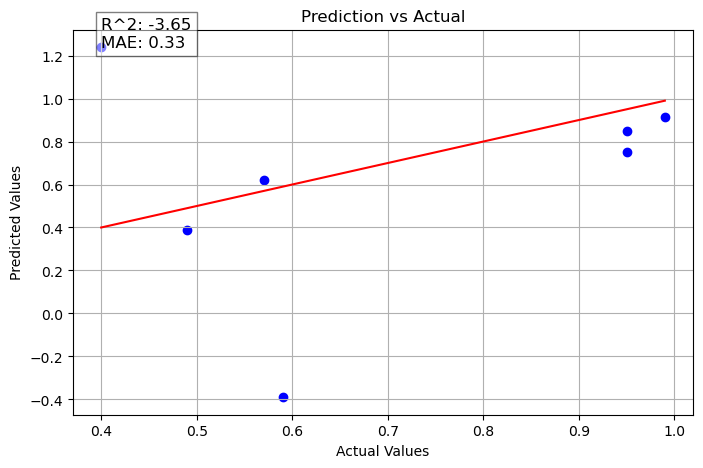

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, r2_score

# Assuming the predictions and y_test are already available
# Example data (substitute these with actual predictions and y_test values)

# Calculate R-squared and MAE
r_squared = r2_score(y_test, predictions)
mae = mean_absolute_error(y_test, predictions)

# Plotting
plt.figure(figsize=(8, 5))
plt.scatter(y_test, predictions, color='blue')  # Actual vs Predicted points
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'r')  # Line of best fit
plt.title('Prediction vs Actual')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.text(min(y_test), max(predictions), f'R^2: {r_squared:.2f}\nMAE: {mae:.2f}', fontsize=12,
         bbox=dict(facecolor='white', alpha=0.5))
plt.grid(True)
plt.show()


In [ ]:
predictions
y_test

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
# Data


# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(energy_array, Quantumyield, test_size=0.33, random_state=42)

# Model
model = LinearRegression()
model.fit(X_train, y_train)

# Evaluation
predictions = model.predict(X_test)
mae = mean_absolute_error(y_test, predictions)
print("Mean Absolute Error:", mae)
print("Predictions:", predictions)

Mean Absolute Error: 0.26359105083542156
Predictions: [0.92332704 1.07806703 0.76031249 0.85149304 0.42195914 0.32767933
 0.66439804 0.75973312 0.44052685 0.42941528 0.71089338]


In [ ]:
len(energy_array)

31

In [ ]:
len(Quantumyield)

31

In [ ]:

# Extract the "Chromophore" column
Quantumyield = data_filtered_sorted['Quantum yield']

# Display the extracted column
print(Quantumyield)

14683    0.00059
14687    0.01050
15043    0.04100
15042    0.26000
15041    0.41000
745      0.80000
751      0.62000
7176     0.37000
7175     0.57000
7174     0.49000
7172     0.52000
7165     0.71000
7162     0.28000
7159     0.19000
9889     0.57000
9891     0.59000
9894     0.43000
1116     0.99000
1106     0.98000
43       1.00000
1126     1.00000
208      0.70000
207      0.31000
1121     0.40000
1111     0.36000
1101     0.66000
1113     0.95000
1103     0.95000
1123     0.94000
34       0.95000
4461     0.22000
Name: Quantum yield, dtype: float64


In [ ]:
len(Quantumyield)

31

*Train CNN model*

In [ ]:
only_energies = []
# Extracting the energy values into a numpy array
only_energies = np.array([energy for _, energy in energies])
only_energies

array([ -985.21474145,  -985.21368848, -1596.76135517, -1596.96289355,
       -1095.63636584, -1095.70709941, -1095.70745509, -1095.70704159,
       -1095.70796829, -1485.21052343, -1484.93622924, -1485.21512896,
       -1485.21252295, -1484.93627748, -1214.45288411, -1214.448715  ,
       -1214.44990221, -1215.26054105, -1603.16141081, -1603.16274276,
       -1603.18006463, -1603.17683188, -1604.14202228, -1490.09698677,
       -1490.10187384, -1490.1022597 , -1260.32070519, -1611.73790609,
       -1659.48896009, -1040.01582449, -1430.14172919, -2087.49505558,
       -2085.93106397, -1702.17732284, -2087.75685708, -2087.19947867,
       -2090.99515339, -1698.37042652, -2321.8122469 , -2088.01509095,
       -2087.1948212 , -1698.37137187, -2321.80532812, -2085.87182909,
       -1698.37071227, -2087.99240184, -2085.96341923, -2090.9680353 ,
       -1698.3695318 ,  -102.52180711,  -161.7190174 ,  -102.52180711,
        -102.52180711,  -102.52180711,  -161.71901763,  -161.71901733,
      

In [ ]:
only_energies.size

99